In [1]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [2]:
listeners = []
strings = """[
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.00025 ,11],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.00025 ,21]
]"""

In [3]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.01,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.1,
    risk_tolerance_stdev = 0.1,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.1,
    herding_behavior_stdev = 0.1,
    allowed_restaurant_capacity = 0.25, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 40 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[8447, 6382, 6090, 6908, 1675, 7002, 7039, 4982, 7757, 8561, 5949, 3582, 8036, 3613, 6582, 3293, 8067, 2154, 3840, 9986]
log initialized
Average similarity between family members is 0.9728861500563913 at temperature -1
Average similarity between family and home is 0.9998589794025341 at temperature -1
Average similarity between students and their classroom is 0.9587568158603366 at temperature -1
Average classroom occupancy is 1.8484848484848484 and number classrooms is 165
Average similarity between workers is 0.9672319915475872 at temperature -1
Average office occupancy is 3.367021276595745 and number offices is 188
Average friend similarity for adults: 0.8500796431905197 for kids: 0.7464414401128278
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 

avg restaurant similarity 0.7181307322802516
avg restaurant similarity 0.9147807950565711
avg restaurant similarity 0.7975360004203083
avg restaurant similarity 0.5196807983423056
avg restaurant similarity 0.8405794608316223
avg restaurant similarity 0.5573282424320599
avg restaurant similarity 0.6635461741894788
avg restaurant similarity 0.652876067631124
avg restaurant similarity 0.8334146545129115
avg restaurant similarity 0.7859659227002869
avg restaurant similarity 0.6314270042685491
avg restaurant similarity 0.7353398158862336
avg restaurant similarity 0.6699486606318689
avg restaurant similarity 0.6416328537773978
avg restaurant similarity 0.7555551059561197
avg restaurant similarity 0.7200179842469647
avg restaurant similarity 0.6782674206706314
avg restaurant similarity 0.7218730493895253
avg restaurant similarity 0.5321509962731519
avg restaurant similarity 0.6625655107066875
avg restaurant similarity 0.5011600705144605
avg restaurant similarity 0.7227898934905772
avg restaur

avg restaurant similarity 0.6709255832121774
avg restaurant similarity 0.8221618855567174
avg restaurant similarity 0.7762789405346313
avg restaurant similarity 0.599437257823142
avg restaurant similarity 0.6288492626376299
avg restaurant similarity 0.8114269341492631
avg restaurant similarity 0.714075570953986
avg restaurant similarity 0.6650063075882064
avg restaurant similarity 0.684042301996933
avg restaurant similarity 0.7552376234424748
avg restaurant similarity 0.6334835363526592
avg restaurant similarity 0.7234269030221102
avg restaurant similarity 0.670726593207251
avg restaurant similarity 0.7343577089353762
avg restaurant similarity 0.7022747042636821
avg restaurant similarity 0.766823865487374
avg restaurant similarity 0.5639418884764881
avg restaurant similarity 0.724355874757246
avg restaurant similarity 0.8527385628959245
avg restaurant similarity 0.5649345004195971
avg restaurant similarity 0.5724805356488156
avg restaurant similarity 0.6992444149071315
avg restaurant s

Average friend similarity for adults: 0.8549798766218564 for kids: 0.7274996282371345
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 alloc

avg restaurant similarity 0.69917686343685
avg restaurant similarity 0.6453702334589151
avg restaurant similarity 0.6270806644111758
avg restaurant similarity 0.7106549050936135
avg restaurant similarity 0.6930797197076015
avg restaurant similarity 0.716771399585761
avg restaurant similarity 0.711181296447657
avg restaurant similarity 0.6064559580961124
avg restaurant similarity 0.6465466737059105
avg restaurant similarity 0.648442185122222
avg restaurant similarity 0.695260895564273
avg restaurant similarity 0.6804163348689489
avg restaurant similarity 0.6627235481820349
avg restaurant similarity 0.3705224008100406
avg restaurant similarity 0.586203233210712
avg restaurant similarity 0.6316277582619605
avg restaurant similarity 0.5694877363593547
avg restaurant similarity 0.584704176930262
avg restaurant similarity 0.58209868241169
avg restaurant similarity 0.6144098224907002
avg restaurant similarity 0.5716104178283443
avg restaurant similarity 0.7764272955319567
avg restaurant simil

avg restaurant similarity 0.5427371876258364
avg restaurant similarity 0.6147221957561227
avg restaurant similarity 0.6332051659396749
avg restaurant similarity 0.6958497806758187
avg restaurant similarity 0.7366149701841305
avg restaurant similarity 0.6191321803760386
avg restaurant similarity 0.6409816087920268
avg restaurant similarity 0.6793536346292779
avg restaurant similarity 0.6683125857321692
avg restaurant similarity 0.6349195151303078
avg restaurant similarity 0.671183260498643
avg restaurant similarity 0.7086795261081889
avg restaurant similarity 0.7462470932829177
avg restaurant similarity 0.7718189509341417
avg restaurant similarity 0.5576888718319317
avg restaurant similarity 0.6784340418858492
avg restaurant similarity 0.6301851367536988
avg restaurant similarity 0.6865312740361647
avg restaurant similarity 0.5595662143723538
avg restaurant similarity 0.43153879867659567
avg restaurant similarity 0.64684220980997
avg restaurant similarity 0.5186919706972811
avg restaura

Average friend similarity for adults: 0.8473887643203655 for kids: 0.747017485831184
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated 

avg restaurant similarity 0.8034928231115007
avg restaurant similarity 0.6153962622916683
avg restaurant similarity 0.6199400464151381
avg restaurant similarity 0.6412281441627546
avg restaurant similarity 0.7596867111690803
avg restaurant similarity 0.6593538785113179
avg restaurant similarity 0.7269876312243672
avg restaurant similarity 0.618342573994776
avg restaurant similarity 0.5916555604969628
avg restaurant similarity 0.8154139094131775
avg restaurant similarity 0.7504101019059636
avg restaurant similarity 0.5598345437820568
avg restaurant similarity 0.5873297918910985
avg restaurant similarity 0.7159643397605439
avg restaurant similarity 0.7052810818082648
avg restaurant similarity 0.6660959518879479
avg restaurant similarity 0.7998575190329384
avg restaurant similarity 0.6355340926822624
avg restaurant similarity 0.4698296899385586
avg restaurant similarity 0.8185078266143269
avg restaurant similarity 0.7135640782474805
avg restaurant similarity 0.693640167972227
avg restaura

avg restaurant similarity 0.6322485216487064
avg restaurant similarity 0.7564989921670836
avg restaurant similarity 0.6320723394888293
avg restaurant similarity 0.5662758352441826
avg restaurant similarity 0.758639016971703
avg restaurant similarity 0.6766038014556623
avg restaurant similarity 0.6023080013613544
avg restaurant similarity 0.5299105524852832
avg restaurant similarity 0.6605230901091492
avg restaurant similarity 0.7140008185671605
avg restaurant similarity 0.724439454700307
avg restaurant similarity 0.7365314159505493
avg restaurant similarity 0.4813783096328893
avg restaurant similarity 0.7550475259331173
avg restaurant similarity 0.5350985134771006
avg restaurant similarity 0.6085484963882559
avg restaurant similarity 0.6058679754125932
avg restaurant similarity 0.6824951933176774
avg restaurant similarity 0.8082676271161294
avg restaurant similarity 0.5482840336829728
avg restaurant similarity 0.7505296498749576
avg restaurant similarity 0.7749838825667541
avg restaura

avg restaurant similarity 0.7256905340939315
avg restaurant similarity 0.6558293917930581
avg restaurant similarity 0.6290993959138623
avg restaurant similarity 0.8055479774221734
avg restaurant similarity 0.6733846148052935
avg restaurant similarity 0.6212685967406445
avg restaurant similarity 0.6622524579732144
avg restaurant similarity 0.6116877311782604
avg restaurant similarity 0.6366421089841845
avg restaurant similarity 0.6251933632284119
avg restaurant similarity 0.4702444304273725
avg restaurant similarity 0.6248053814630455
avg restaurant similarity 0.6208750010490498
avg restaurant similarity 0.6095403873897757
avg restaurant similarity 0.6873537778833183
avg restaurant similarity 0.6748340096518604
avg restaurant similarity 0.6552021458040657
avg restaurant similarity 0.8001195912779054
avg restaurant similarity 0.8989366153605883
avg restaurant similarity 0.597402346608415
avg restaurant similarity 0.8303515562882647
avg restaurant similarity 0.6917247146308025
avg restaur

avg restaurant similarity 0.6352986037814644
avg restaurant similarity 0.5069479730374986
avg restaurant similarity 0.5499556140188784
avg restaurant similarity 0.8014077641627574
avg restaurant similarity 0.715801934132135
avg restaurant similarity 0.5181603198877296
avg restaurant similarity 0.6031448567522284
avg restaurant similarity 0.5612902112767445
avg restaurant similarity 0.7260599828354041
avg restaurant similarity 0.49798399353505884
avg restaurant similarity 0.7328014404755716
avg restaurant similarity 0.7781613305688629
avg restaurant similarity 0.5729816585957881
avg restaurant similarity 0.698734250438853
avg restaurant similarity 0.5077845609642514
avg restaurant similarity 0.7752767078878167
avg restaurant similarity 0.5705899863120228
avg restaurant similarity 0.5898683235227319
avg restaurant similarity 0.7227876506824981
avg restaurant similarity 0.4668534564530662
avg restaurant similarity 0.8510815705121203
avg restaurant similarity 0.5092069742571385
avg restaur

Average friend similarity for adults: 0.8436598140023489 for kids: 0.7378394143247662
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.5358506320468039
avg restaurant similarity 0.6145403240575378
avg restaurant similarity 0.5927663677321793
avg restaurant similarity 0.5653382376445277
avg restaurant similarity 0.6305363031586997
avg restaurant similarity 0.6701568539590719
avg restaurant similarity 0.6847428698023316
avg restaurant similarity 0.5043763227416012
avg restaurant similarity 0.6096212687435133
avg restaurant similarity 0.590654493624043
avg restaurant similarity 0.6293626867774285
avg restaurant similarity 0.43658060086669126
avg restaurant similarity 0.4882829683852166
avg restaurant similarity 0.6416114830958393
avg restaurant similarity 0.608695384235011
avg restaurant similarity 0.5912381164557144
avg restaurant similarity 0.7098972100684315
avg restaurant similarity 0.6860442759504869
avg restaurant similarity 0.4653998265197313
avg restaurant similarity 0.5140370493498796
avg restaurant similarity 0.4462721092811799
avg restaurant similarity 0.5599165917092656
avg restaur

avg restaurant similarity 0.5362829614173402
avg restaurant similarity 0.7219893572205014
avg restaurant similarity 0.5419102137031317
avg restaurant similarity 0.3777067099509454
avg restaurant similarity 0.5691320788271578
avg restaurant similarity 0.4706461970050128
avg restaurant similarity 0.7226526407192385
avg restaurant similarity 0.49847044067976154
avg restaurant similarity 0.5474769534154152
avg restaurant similarity 0.8311667315205002
avg restaurant similarity 0.6180388513649964
avg restaurant similarity 0.5230965743886526
avg restaurant similarity 0.526017698335598
avg restaurant similarity 0.6495642926955939
avg restaurant similarity 0.5850068971874609
avg restaurant similarity 0.7964477700165802
avg restaurant similarity 0.5831558489361749
avg restaurant similarity 0.49834783543320765
avg restaurant similarity 0.418664604382274
avg restaurant similarity 0.4109122961119075
avg restaurant similarity 0.4690709123251986
avg restaurant similarity 0.4820425821914151
avg restau

Average friend similarity for adults: 0.8628014786134932 for kids: 0.7436908185111101
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.6167651408942514
avg restaurant similarity 0.5767227774619472
avg restaurant similarity 0.699652594621387
avg restaurant similarity 0.8981126075166204
avg restaurant similarity 0.7707492256640428
avg restaurant similarity 0.6479092092766295
avg restaurant similarity 0.6666591142951483
avg restaurant similarity 0.5536641977525966
avg restaurant similarity 0.5773006241459151
avg restaurant similarity 0.508826226794355
avg restaurant similarity 0.5813171320682166
avg restaurant similarity 0.8152029348599226
avg restaurant similarity 0.7749569032989878
avg restaurant similarity 0.719758049912171
avg restaurant similarity 0.7198710062151904
avg restaurant similarity 0.7434722096714789
avg restaurant similarity 0.8113551585103652
avg restaurant similarity 0.6610886411705554
avg restaurant similarity 0.7550269868683269
avg restaurant similarity 0.6359489945013873
avg restaurant similarity 0.5388683316615961
avg restaurant similarity 0.5065469247774387
avg restauran

avg restaurant similarity 0.6201454623208802
avg restaurant similarity 0.7318709721731962
avg restaurant similarity 0.42391715384782935
avg restaurant similarity 0.8138238480085866
avg restaurant similarity 0.6969285318170586
avg restaurant similarity 0.42856485244590364
avg restaurant similarity 0.7639272117844707
avg restaurant similarity 0.8180456860861727
avg restaurant similarity 0.592959806973818
avg restaurant similarity 0.6420846881913123
avg restaurant similarity 0.595330624352904
avg restaurant similarity 0.5536095867653101
avg restaurant similarity 0.701938260085375
avg restaurant similarity 0.7480828714501838
avg restaurant similarity 0.644334863847685
avg restaurant similarity 0.6606952187786957
avg restaurant similarity 0.6495698326417573
avg restaurant similarity 0.6229712732997106
avg restaurant similarity 0.6642712356193257
avg restaurant similarity 0.8305044416273921
avg restaurant similarity 0.5171754971108522
avg restaurant similarity 0.6548508609367348
avg restaura

Average friend similarity for adults: 0.8586903062814379 for kids: 0.7339238714346681
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.6299093239609378
avg restaurant similarity 0.8850777422449069
avg restaurant similarity 0.7830548355876954
avg restaurant similarity 0.7608566052359613
avg restaurant similarity 0.6831627818825653
avg restaurant similarity 0.7164611635346251
avg restaurant similarity 0.6431946488852942
avg restaurant similarity 0.46405930101484205
avg restaurant similarity 0.726550376957144
avg restaurant similarity 0.6597207147240407
avg restaurant similarity 0.4473164933689669
avg restaurant similarity 0.6721209199321435
avg restaurant similarity 0.6630258153048662
avg restaurant similarity 0.7034181078086834
avg restaurant similarity 0.6192806523153139
avg restaurant similarity 0.623323514452088
avg restaurant similarity 0.5466735128779301
avg restaurant similarity 0.7764722466298962
avg restaurant similarity 0.6838996389671662
avg restaurant similarity 0.6789095152517117
avg restaurant similarity 0.5832525707586222
avg restaurant similarity 0.7276230118137594
avg restaur

avg restaurant similarity 0.7434278853733974
avg restaurant similarity 0.7467068041760655
avg restaurant similarity 0.6884660476981045
avg restaurant similarity 0.789671759825297
avg restaurant similarity 0.6635758680738261
avg restaurant similarity 0.7468877852743478
avg restaurant similarity 0.6888596273034583
avg restaurant similarity 0.6751563234744572
avg restaurant similarity 0.7153796169950315
avg restaurant similarity 0.8854368603417442
avg restaurant similarity 0.7453872897777231
avg restaurant similarity 0.674758504187888
avg restaurant similarity 0.6884505087223767
avg restaurant similarity 0.8527890738405283
avg restaurant similarity 0.880750793952526
avg restaurant similarity 0.6841001860166285
avg restaurant similarity 0.7658856382588336
avg restaurant similarity 0.45119483249550746
avg restaurant similarity 0.567262802607869
avg restaurant similarity 0.6576717127033705
avg restaurant similarity 0.7691052224213002
avg restaurant similarity 0.7320329887007997
avg restauran

Average friend similarity for adults: 0.8658810592324887 for kids: 0.7312058834750708
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocat

avg restaurant similarity 0.6260649602305388
avg restaurant similarity 0.5792324403520449
avg restaurant similarity 0.7377485109325858
avg restaurant similarity 0.4414008940313275
avg restaurant similarity 0.7497698811661268
avg restaurant similarity 0.7405501088384572
avg restaurant similarity 0.7341818066011717
avg restaurant similarity 0.6954505620765385
avg restaurant similarity 0.6955607014442676
avg restaurant similarity 0.6990155115829841
avg restaurant similarity 0.728598584387563
avg restaurant similarity 0.6297674450836614
avg restaurant similarity 0.6920559357455343
avg restaurant similarity 0.6410494076574434
avg restaurant similarity 0.6600016740472833
avg restaurant similarity 0.6517585643035133
avg restaurant similarity 0.6378301618939678
avg restaurant similarity 0.6846077338256565
avg restaurant similarity 0.5641174371392539
avg restaurant similarity 0.6303162082565301
avg restaurant similarity 0.7594641716260755
avg restaurant similarity 0.6247326499161412
avg restaur

avg restaurant similarity 0.6912805492292509
avg restaurant similarity 0.6298898884139669
avg restaurant similarity 0.5230797758721488
avg restaurant similarity 0.5969317563579742
avg restaurant similarity 0.7576976430616996
avg restaurant similarity 0.7913115111834399
avg restaurant similarity 0.7114396759596088
avg restaurant similarity 0.6594548938368164
avg restaurant similarity 0.685115946385343
avg restaurant similarity 0.6719623181828992
avg restaurant similarity 0.7211190007801704
avg restaurant similarity 0.6715681831800703
avg restaurant similarity 0.6993819438636942
avg restaurant similarity 0.7300960610664083
avg restaurant similarity 0.6552989886065267
avg restaurant similarity 0.7245270121947361
avg restaurant similarity 0.6405736065202164
avg restaurant similarity 0.6315662267616629
avg restaurant similarity 0.6561646528981099
avg restaurant similarity 0.648567244856866
avg restaurant similarity 0.5489716860748862
avg restaurant similarity 0.5106536127414959
avg restaura

Average similarity between workers is 0.9663398642304982 at temperature -1
Average office occupancy is 3.3794871794871795 and number offices is 195
Average friend similarity for adults: 0.8673292973251938 for kids: 0.736699918787913
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people

avg restaurant similarity 0.8059515540418295
avg restaurant similarity 0.5003392372156099
avg restaurant similarity 0.7461812726480108
avg restaurant similarity 0.6926244204383885
avg restaurant similarity 0.6953059309378153
avg restaurant similarity 0.5880650972448019
avg restaurant similarity 0.7278100271669833
avg restaurant similarity 0.6635429790398455
avg restaurant similarity 0.8158886856410557
avg restaurant similarity 0.621812122195147
avg restaurant similarity 0.48927824795363556
avg restaurant similarity 0.6997853346943218
avg restaurant similarity 0.72950048810734
avg restaurant similarity 0.8084746298485007
avg restaurant similarity 0.874103764229793
avg restaurant similarity 0.6312329267388807
avg restaurant similarity 0.5883968163244727
avg restaurant similarity 0.6875562656631133
avg restaurant similarity 0.5936613227682693
avg restaurant similarity 0.6449593310591507
avg restaurant similarity 0.7531165066164304
avg restaurant similarity 0.7501838110703855
avg restauran

avg restaurant similarity 0.6657130457030823
avg restaurant similarity 0.839445941314005
avg restaurant similarity 0.7511968391312345
avg restaurant similarity 0.6716183286588085
avg restaurant similarity 0.6627449786981267
avg restaurant similarity 0.658189626065163
avg restaurant similarity 0.7170175978255295
avg restaurant similarity 0.7377915258004591
avg restaurant similarity 0.7508893447496992
avg restaurant similarity 0.775411144978198
avg restaurant similarity 0.6028899612400228
avg restaurant similarity 0.7260946454016318
avg restaurant similarity 0.6505400640434853
avg restaurant similarity 0.6599457197821218
avg restaurant similarity 0.7363853600870311
avg restaurant similarity 0.641573949327065
avg restaurant similarity 0.663664847294167
avg restaurant similarity 0.6766303434026864
avg restaurant similarity 0.5775222336066576
avg restaurant similarity 0.6406861767831786
avg restaurant similarity 0.6907370374519503
avg restaurant similarity 0.7901692797857933
avg restaurant 

Average friend similarity for adults: 0.8598907802025705 for kids: 0.7437378299128299
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 alloc

avg restaurant similarity 0.6139612053812855
avg restaurant similarity 0.5393274681197778
avg restaurant similarity 0.518899481979729
avg restaurant similarity 0.3147384004744832
avg restaurant similarity 0.2715644255353869
avg restaurant similarity 0.2678421515541239
avg restaurant similarity 0.8286532163817548
avg restaurant similarity 0.5832706791500122
avg restaurant similarity 0.7998590471366165
avg restaurant similarity 0.7118702575737198
avg restaurant similarity 0.5751220547280126
avg restaurant similarity 0.5023282923346489
avg restaurant similarity 0.45081721278694475
avg restaurant similarity 0.7823553651793017
avg restaurant similarity 0.640169154418946
avg restaurant similarity 0.25069544357182816
avg restaurant similarity 0.7689125285683346
avg restaurant similarity 0.7646840988031814
avg restaurant similarity 0.5905975092207586
avg restaurant similarity 0.7552602273273527
avg restaurant similarity 0.7135350170326876
avg restaurant similarity 0.5216070101282047
avg restau

avg restaurant similarity 0.7202253078189274
avg restaurant similarity 0.397266595615486
avg restaurant similarity 0.48657210019347635
avg restaurant similarity 0.765671775886207
avg restaurant similarity 0.7252271621781371
avg restaurant similarity 0.9154288259027646
avg restaurant similarity 0.6561505175108637
avg restaurant similarity 0.9998614226009584
avg restaurant similarity 0.5305239724032585
avg restaurant similarity 0.9363696328429467
avg restaurant similarity 0.3618210452395492
avg restaurant similarity 0.43040295572937765
avg restaurant similarity 0.6777220991291725
avg restaurant similarity 0.6480991093228926
avg restaurant similarity 0.9646550405103724
avg restaurant similarity 0.9502582851750663
avg restaurant similarity 0.6038470005410348
avg restaurant similarity 0.4640396450033826
avg restaurant similarity 0.5484215025770068
avg restaurant similarity 0.9996862066496666
avg restaurant similarity 0.8375533628179692
avg restaurant similarity 0.4075046784311175
avg restau

avg restaurant similarity 0.8570825727838113
avg restaurant similarity 0.8069738120477944
avg restaurant similarity 0.6621624137483306
avg restaurant similarity 0.5798016379440658
avg restaurant similarity 0.6721328839849187
avg restaurant similarity 0.7701275579827298
avg restaurant similarity 0.7821339779359993
avg restaurant similarity 0.6996183726177455
avg restaurant similarity 0.7086277934286954
avg restaurant similarity 0.7264310415055261
avg restaurant similarity 0.6965990045325057
avg restaurant similarity 0.7957929974074757
avg restaurant similarity 0.30046335018111914
avg restaurant similarity 0.5608738559418224
avg restaurant similarity 0.7107555165706171
avg restaurant similarity 0.632541206215804
avg restaurant similarity 0.6905782313347019
avg restaurant similarity 0.632956274326753
avg restaurant similarity 0.7679055021273928
avg restaurant similarity 0.6814430915310664
avg restaurant similarity 0.6478337764470984
avg restaurant similarity 0.47784933528434376
avg restau

avg restaurant similarity 0.7301615381253299
avg restaurant similarity 0.5592114829060018
avg restaurant similarity 0.6757158781456126
avg restaurant similarity 0.9999200329048155
avg restaurant similarity 0.8291314305876125
avg restaurant similarity 0.7559812413447629
avg restaurant similarity 0.7095825650487725
avg restaurant similarity 0.48869649585840236
avg restaurant similarity 0.6180264621585416
avg restaurant similarity 0.47642197929637975
avg restaurant similarity 0.46780082273643975
avg restaurant similarity 0.6065116011218015
avg restaurant similarity 0.8851510820065265
avg restaurant similarity 0.5780166035792401
avg restaurant similarity 0.7403913287110674
avg restaurant similarity 0.9995247355277823
avg restaurant similarity 0.515438167233634
avg restaurant similarity 0.430015644597084
avg restaurant similarity 0.9999053223926633
avg restaurant similarity 0.7414395934804254
avg restaurant similarity 0.6144025298085175
avg restaurant similarity 0.7310145047925318
avg resta

avg restaurant similarity 0.7435037546679816
avg restaurant similarity 0.536025668778602
avg restaurant similarity 0.7201602173322053
avg restaurant similarity 0.6726098193297992
avg restaurant similarity 0.5528277255542712
avg restaurant similarity 0.6254412872726646
avg restaurant similarity 0.5305374785620688
avg restaurant similarity 0.6416905454019962
avg restaurant similarity 0.5830625282479173
avg restaurant similarity 0.523399727262986
avg restaurant similarity 0.5922445070809174
avg restaurant similarity 0.5325297200625481
avg restaurant similarity 0.510916911117103
avg restaurant similarity 0.538697670504006
avg restaurant similarity 0.5402322350658789
avg restaurant similarity 0.667583487882787
avg restaurant similarity 0.6540310123395245
avg restaurant similarity 0.6977315486877526
avg restaurant similarity 0.6587977764703521
avg restaurant similarity 0.5515590482260918
avg restaurant similarity 0.73843636178844
avg restaurant similarity 0.6135693553883024
avg restaurant si

avg restaurant similarity 0.7946531885050588
avg restaurant similarity 0.5044705134944316
avg restaurant similarity 0.5594484670666775
avg restaurant similarity 0.5553398011359543
avg restaurant similarity 0.6407624478027724
avg restaurant similarity 0.6232278650327546
avg restaurant similarity 0.5885990243481919
avg restaurant similarity 0.4967417397995523
avg restaurant similarity 0.6027071705418344
avg restaurant similarity 0.4236509112219097
avg restaurant similarity 0.8040799282504011
avg restaurant similarity 0.6705837749396225
avg restaurant similarity 0.6853243658081184
avg restaurant similarity 0.6186742501266269
avg restaurant similarity 0.784100972981139
avg restaurant similarity 0.4779588925112921
avg restaurant similarity 0.522527082798159
avg restaurant similarity 0.7195636532788559
avg restaurant similarity 0.7225614499028092
avg restaurant similarity 0.7395660575339034
avg restaurant similarity 0.5382998445605843
avg restaurant similarity 0.4357266765706774
avg restaura

Average friend similarity for adults: 0.8538304666360843 for kids: 0.7306867660776176
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.6233337394922975
avg restaurant similarity 0.5370648330501665
avg restaurant similarity 0.6591352860061026
avg restaurant similarity 0.7629610829344089
avg restaurant similarity 0.6319356893209297
avg restaurant similarity 0.5812386022890645
avg restaurant similarity 0.4709267427504936
avg restaurant similarity 0.5849388138592908
avg restaurant similarity 0.6124480798772084
avg restaurant similarity 0.5382997044440737
avg restaurant similarity 0.656982095092991
avg restaurant similarity 0.32203908834697376
avg restaurant similarity 0.734955488672581
avg restaurant similarity 0.5786428628694537
avg restaurant similarity 0.6547749550600124
avg restaurant similarity 0.8071990402557145
avg restaurant similarity 0.7611564853851993
avg restaurant similarity 0.7034096893092554
avg restaurant similarity 0.6462255185849869
avg restaurant similarity 0.477817470842945
avg restaurant similarity 0.6321713523004966
avg restaurant similarity 0.4466763347937718
avg restaura

avg restaurant similarity 0.7011565181492317
avg restaurant similarity 0.6682661708407255
avg restaurant similarity 0.587577039386427
avg restaurant similarity 0.602552644687392
avg restaurant similarity 0.6453980570349462
avg restaurant similarity 0.5665697465136785
avg restaurant similarity 0.4569904318231601
avg restaurant similarity 0.5097737622656143
avg restaurant similarity 0.6137259648240857
avg restaurant similarity 0.6897111613947423
avg restaurant similarity 0.5829817299857963
avg restaurant similarity 0.5667302769452766
avg restaurant similarity 0.6006246361270374
avg restaurant similarity 0.7764268241391465
avg restaurant similarity 0.6374105491400044
avg restaurant similarity 0.5996611236896663
avg restaurant similarity 0.6194243536267576
avg restaurant similarity 0.6399578945517944
avg restaurant similarity 0.5239447270920004
avg restaurant similarity 0.6380446824989107
avg restaurant similarity 0.6962184937686069
avg restaurant similarity 0.742727273630745
avg restauran

Average similarity between workers is 0.9727392346262405 at temperature -1
Average office occupancy is 3.319371727748691 and number offices is 191
Average friend similarity for adults: 0.8497971536916109 for kids: 0.7428300526352323
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 peop

avg restaurant similarity 0.5133680297412622
avg restaurant similarity 0.5597733388491765
avg restaurant similarity 0.5760196734642091
avg restaurant similarity 0.5310783725639441
avg restaurant similarity 0.5122958477554268
avg restaurant similarity 0.5319283337203485
avg restaurant similarity 0.5250709344765482
avg restaurant similarity 0.47672800010655847
avg restaurant similarity 0.653131004189282
avg restaurant similarity 0.5350192245499408
avg restaurant similarity 0.5457793092940314
avg restaurant similarity 0.41201834330375947
avg restaurant similarity 0.519132922076574
avg restaurant similarity 0.4892331542523033
avg restaurant similarity 0.45560578453756867
avg restaurant similarity 0.8066007374185681
avg restaurant similarity 0.5181895365024047
avg restaurant similarity 0.6291261298081834
avg restaurant similarity 0.6040069124611265
avg restaurant similarity 0.5859559013864466
avg restaurant similarity 0.5295579989123049
avg restaurant similarity 0.6116463607591549
avg resta

avg restaurant similarity 0.5762160371364118
avg restaurant similarity 0.5023438309645926
avg restaurant similarity 0.5064107044772663
avg restaurant similarity 0.5660675701092296
avg restaurant similarity 0.480352601732789
avg restaurant similarity 0.6232948999109686
avg restaurant similarity 0.5143918989130651
avg restaurant similarity 0.5074492746466632
avg restaurant similarity 0.5377766686824188
avg restaurant similarity 0.4362131428128763
avg restaurant similarity 0.6194126604964645
avg restaurant similarity 0.5674998704208736
avg restaurant similarity 0.770893500852449
avg restaurant similarity 0.789088477349811
avg restaurant similarity 0.6576456310326806
avg restaurant similarity 0.6264735625134918
avg restaurant similarity 0.8192940602935446
avg restaurant similarity 0.40439736930879067
avg restaurant similarity 0.5153893967826076
avg restaurant similarity 0.5668566596707865
avg restaurant similarity 0.5417634566870838
avg restaurant similarity 0.6377525745553911
avg restaura

avg restaurant similarity 0.4086165615317162
avg restaurant similarity 0.9998155085661843
avg restaurant similarity 0.4312927064429723
avg restaurant similarity 0.7245189010119555
avg restaurant similarity 0.8773259244251811
avg restaurant similarity 0.6502304917857
avg restaurant similarity 0.5883396847938722
avg restaurant similarity 0.850550898406
avg restaurant similarity 0.4492157760400424
avg restaurant similarity 0.6649636380382687
avg restaurant similarity 0.5055451950978455
avg restaurant similarity 0.7299990962280126
avg restaurant similarity 0.4462837827051464
avg restaurant similarity 0.6733520482391634
avg restaurant similarity 0.5439573596986453
avg restaurant similarity 0.8332338521507869
avg restaurant similarity 0.5622876721288992
avg restaurant similarity 0.5442480102505391
avg restaurant similarity 0.5845090393497396
avg restaurant similarity 0.6158387333183954
avg restaurant similarity 0.5673900253540046
avg restaurant similarity 0.6902951882104315
avg restaurant si

avg restaurant similarity 0.5788667695421128
avg restaurant similarity 0.6520185411826249
avg restaurant similarity 0.615470237960353
avg restaurant similarity 0.6457662744942777
avg restaurant similarity 0.2123775510392145
avg restaurant similarity 0.7293955352797538
avg restaurant similarity 0.5887095967710757
avg restaurant similarity 0.5137169000993882
avg restaurant similarity 0.49305464809215127
avg restaurant similarity 0.6166815314207799
avg restaurant similarity 0.5673766644975252
avg restaurant similarity 0.5166549966582018
avg restaurant similarity 0.6333600427807776
avg restaurant similarity 0.6863664282140335
avg restaurant similarity 0.5259327293429853
avg restaurant similarity 0.5269753208187772
avg restaurant similarity 0.5914481380608669
avg restaurant similarity 0.2675053101646365
avg restaurant similarity 0.5626792260238023
avg restaurant similarity 0.68541186546926
avg restaurant similarity 0.761143487753794
avg restaurant similarity 0.5782374539463887
avg restauran

avg restaurant similarity 0.31750866639468756
avg restaurant similarity 0.42737725771753476
avg restaurant similarity 0.5123197510851206
avg restaurant similarity 0.6785977203259782
avg restaurant similarity 0.6266313087191314
avg restaurant similarity 0.513977939856489
avg restaurant similarity 0.8616617473214165
avg restaurant similarity 0.5049052614642506
avg restaurant similarity 0.6019718232783842
avg restaurant similarity 0.6375406438436494
avg restaurant similarity 0.5908402858380094
avg restaurant similarity 0.5508647940560106
avg restaurant similarity 0.44629530697316716
avg restaurant similarity 0.5358751125682113
avg restaurant similarity 0.599754580981106
avg restaurant similarity 0.6014763507863127
avg restaurant similarity 0.7653556486557065
avg restaurant similarity 0.5971528765426019
avg restaurant similarity 0.6389501152951634
avg restaurant similarity 0.5611160808698605
avg restaurant similarity 0.5137995509980997
avg restaurant similarity 0.3679117818360268
avg resta

avg restaurant similarity 0.4763317918672635
avg restaurant similarity 0.592415685767879
avg restaurant similarity 0.7101679400272529
avg restaurant similarity 0.7175731899030526
avg restaurant similarity 0.6174281387663968
avg restaurant similarity 0.6148727725742552
avg restaurant similarity 0.6157299112323185
avg restaurant similarity 0.5922917011619107
avg restaurant similarity 0.8079736378003574
avg restaurant similarity 0.62201494714078
avg restaurant similarity 0.5321262329497156
avg restaurant similarity 0.7082417076088798
avg restaurant similarity 0.6477561814313216
avg restaurant similarity 0.5219792393533571
avg restaurant similarity 0.5428688772581796
avg restaurant similarity 0.4819115601067243
avg restaurant similarity 0.6308232725599666
avg restaurant similarity 0.5835420654232838
avg restaurant similarity 0.6236289603386804
avg restaurant similarity 0.6154296417232964
avg restaurant similarity 0.6846084279472491
avg restaurant similarity 0.5887238615547178
avg restauran

Average similarity between workers is 0.9627261637712521 at temperature -1
Average office occupancy is 3.642857142857143 and number offices is 182
Average friend similarity for adults: 0.8655502280355651 for kids: 0.7478311188024931
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 peop

avg restaurant similarity 0.7144014953462062
avg restaurant similarity 0.4519693213154076
avg restaurant similarity 0.6283004957944311
avg restaurant similarity 0.5506528284784881
avg restaurant similarity 0.6492593575428144
avg restaurant similarity 0.7644365355873289
avg restaurant similarity 0.7228408076819693
avg restaurant similarity 0.5336569403787697
avg restaurant similarity 0.5652148510291831
avg restaurant similarity 0.5027703806267239
avg restaurant similarity 0.4696486677248053
avg restaurant similarity 0.6169858833767269
avg restaurant similarity 0.623084132169873
avg restaurant similarity 0.5908734935045565
avg restaurant similarity 0.629384294864171
avg restaurant similarity 0.3945172859340725
avg restaurant similarity 0.6366052250051715
avg restaurant similarity 0.5716417529079064
avg restaurant similarity 0.5408310705964936
avg restaurant similarity 0.5865753083867986
avg restaurant similarity 0.6664148288542684
avg restaurant similarity 0.6497257742226151
avg restaura

avg restaurant similarity 0.7158418301940752
avg restaurant similarity 0.5546407246100505
avg restaurant similarity 0.6788931512988646
avg restaurant similarity 0.658817350478129
avg restaurant similarity 0.6525639730359564
avg restaurant similarity 0.6952965521958512
avg restaurant similarity 0.5752027724992773
avg restaurant similarity 0.414820517690785
avg restaurant similarity 0.595552416165253
avg restaurant similarity 0.5555371949329504
avg restaurant similarity 0.6569180872733884
avg restaurant similarity 0.6636711760569529
avg restaurant similarity 0.6324545366392645
avg restaurant similarity 0.7240648508965796
avg restaurant similarity 0.8082452727925881
avg restaurant similarity 0.5127662297393142
avg restaurant similarity 0.47252549621839623
avg restaurant similarity 0.9997999204061837
avg restaurant similarity 0.6836127179569355
avg restaurant similarity 0.724585703494182
avg restaurant similarity 0.559885559889739
avg restaurant similarity 0.6880972980371461
avg restaurant

Average similarity between workers is 0.9623593938896287 at temperature -1
Average office occupancy is 3.526595744680851 and number offices is 188
Average friend similarity for adults: 0.8642996560716452 for kids: 0.7324073972392968
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 peop

avg restaurant similarity 0.631700312714645
avg restaurant similarity 0.7199686390770357
avg restaurant similarity 0.7117399273119094
avg restaurant similarity 0.8495173641909919
avg restaurant similarity 0.49938985923567636
avg restaurant similarity 0.5923226401715629
avg restaurant similarity 0.5753427324718634
avg restaurant similarity 0.7292267484127725
avg restaurant similarity 0.7092074333216716
avg restaurant similarity 0.5666623987547145
avg restaurant similarity 0.6984174072109675
avg restaurant similarity 0.5253157122838505
avg restaurant similarity 0.6699404508208099
avg restaurant similarity 0.6693677764291474
avg restaurant similarity 0.6815293698364242
avg restaurant similarity 0.6545025247676117
avg restaurant similarity 0.8045799148680151
avg restaurant similarity 0.6862554952869755
avg restaurant similarity 0.8009878834276842
avg restaurant similarity 0.33977308954557645
avg restaurant similarity 0.6204730951255302
avg restaurant similarity 0.5823121941167121
avg resta

avg restaurant similarity 0.6855965311126636
avg restaurant similarity 0.6732811822631403
avg restaurant similarity 0.8136742133593081
avg restaurant similarity 0.6361228315811828
avg restaurant similarity 0.6140258461871332
avg restaurant similarity 0.574066885542251
avg restaurant similarity 0.7521956851679179
avg restaurant similarity 0.6970764050712945
avg restaurant similarity 0.5699996014990976
avg restaurant similarity 0.6693317657523062
avg restaurant similarity 0.840672525097643
avg restaurant similarity 0.6972935064753802
avg restaurant similarity 0.5747604147241427
avg restaurant similarity 0.7022045670192508
avg restaurant similarity 0.48346647388219555
avg restaurant similarity 0.5151633426576062
avg restaurant similarity 0.5855529928319669
avg restaurant similarity 0.6983803869187482
avg restaurant similarity 0.7058070791449949
avg restaurant similarity 0.7703832526433166
avg restaurant similarity 0.3277834026467369
avg restaurant similarity 0.8381460167255765
avg restaur

Average friend similarity for adults: 0.8569326418074129 for kids: 0.7283961733616541
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 alloc

avg restaurant similarity 0.6289687123159017
avg restaurant similarity 0.5845279415895076
avg restaurant similarity 0.6478534219961662
avg restaurant similarity 0.5905849067406486
avg restaurant similarity 0.5513577652967405
avg restaurant similarity 0.5185614873671472
avg restaurant similarity 0.5796958120314273
avg restaurant similarity 0.6251109565536568
avg restaurant similarity 0.45159896293859203
avg restaurant similarity 0.8139627093632398
avg restaurant similarity 0.8654392449511663
avg restaurant similarity 0.6792979704770998
avg restaurant similarity 0.5582877203468584
avg restaurant similarity 0.7026434343718603
avg restaurant similarity 0.7332385484364131
avg restaurant similarity 0.5109421974845575
avg restaurant similarity 0.5746333905207964
avg restaurant similarity 0.5556145162764777
avg restaurant similarity 0.6754849167477522
avg restaurant similarity 0.6986176097363427
avg restaurant similarity 0.6080515588238999
avg restaurant similarity 0.5275047191163995
avg resta

avg restaurant similarity 0.4922159012167659
avg restaurant similarity 0.6458487630792046
avg restaurant similarity 0.5371119439092422
avg restaurant similarity 0.5565550879412046
avg restaurant similarity 0.6792026028224812
avg restaurant similarity 0.5764490429162882
avg restaurant similarity 0.602720901966095
avg restaurant similarity 0.5964941713424429
avg restaurant similarity 0.6340215216326752
avg restaurant similarity 0.5687960341771442
avg restaurant similarity 0.7001571203467506
avg restaurant similarity 0.6004488592622539
avg restaurant similarity 0.6035356075890514
avg restaurant similarity 0.5474256820430865
avg restaurant similarity 0.6916401299089006
avg restaurant similarity 0.6957357415217381
avg restaurant similarity 0.855567945630175
avg restaurant similarity 0.5821187993195693
avg restaurant similarity 0.533024305056623
avg restaurant similarity 0.5876330212536371
avg restaurant similarity 0.5818932209907202
avg restaurant similarity 0.5192719074112964
avg restauran

avg restaurant similarity 0.546260178617332
avg restaurant similarity 0.7100081453457988
avg restaurant similarity 0.8855267376976348
avg restaurant similarity 0.6590332945103553
avg restaurant similarity 0.8327728536557782
avg restaurant similarity 0.6038444381163437
avg restaurant similarity 0.7619865479249202
avg restaurant similarity 0.6378492706406116
avg restaurant similarity 0.841787082012748
avg restaurant similarity 0.8195754425010747
avg restaurant similarity 0.7191948431282863
avg restaurant similarity 0.8099768350289053
avg restaurant similarity 0.6907645316603959
avg restaurant similarity 0.7520243004725521
avg restaurant similarity 0.6379641392730955
avg restaurant similarity 0.6403926407909019
avg restaurant similarity 0.6677572124618223
avg restaurant similarity 0.7022647660861067
avg restaurant similarity 0.5824363722543802
avg restaurant similarity 0.7382187018920425
avg restaurant similarity 0.7461674721923114
avg restaurant similarity 0.6120938174993494
avg restaura

avg restaurant similarity 0.5750390244563712
avg restaurant similarity 0.7230447259847828
avg restaurant similarity 0.727464619099393
avg restaurant similarity 0.7970884328370358
avg restaurant similarity 0.999662751223601
avg restaurant similarity 0.8050558664174767
avg restaurant similarity 0.6528442562517724
avg restaurant similarity 0.7393387139701152
avg restaurant similarity 0.6066883624914
avg restaurant similarity 0.8960718970328705
avg restaurant similarity 0.6282456185404446
avg restaurant similarity 0.5512577848847544
avg restaurant similarity 0.6747501995396347
avg restaurant similarity 0.9294831995891655
avg restaurant similarity 0.8699166085862912
avg restaurant similarity 0.7012697424284063
avg restaurant similarity 0.7686829235251476
avg restaurant similarity 0.6903769980134102
avg restaurant similarity 0.6105088215254236
avg restaurant similarity 0.47368918028558804
avg restaurant similarity 0.6616988583332996
avg restaurant similarity 0.72902947664819
avg restaurant s

(<function dict.items>, <function dict.items>, <function dict.items>)

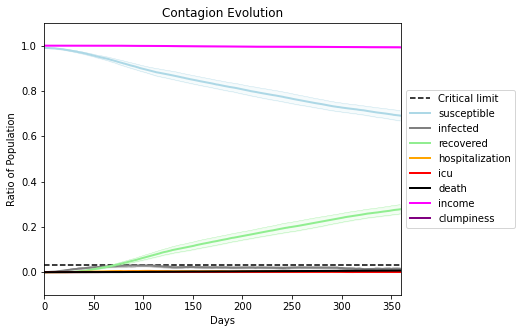

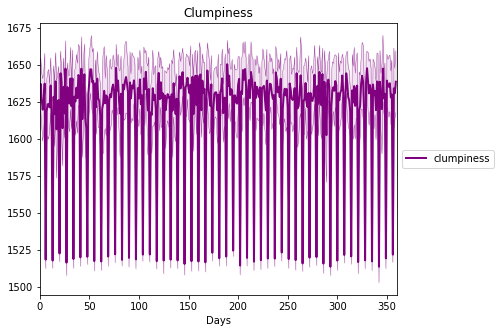

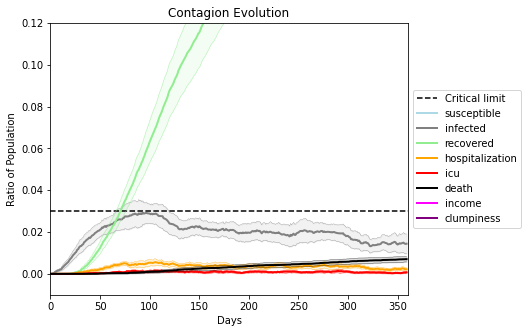

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3178, 9328, 1644, 5837, 3549, 2809, 6103, 6634, 9046, 1685, 922, 4661, 2994, 8677, 1826, 8093, 3066, 8963, 5780, 6143]
Average similarity between family members is 0.9710224630665671 at temperature -0.999
Average similarity between family and home is 0.9998671237689264 at temperature -1
Average similarity between students and their classroom is 0.9745996112967329 at temperature -0.999
Average classroom occupancy is 1.728813559322034 and number classrooms is 177
Average similarity between workers is 0.9554922945859478 at temperature -0.999
Average office occupancy is 3.425531914893617 and number offices is 188
Average friend similarity for adults: 0.8608357005000166 for kids: 0.7441864382293601
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.7108430033883145
avg restaurant similarity 0.75875437661629
avg restaurant similarity 0.6302411892967348
avg restaurant similarity 0.8419702835107978
avg restaurant similarity 0.7609142880188079
avg restaurant similarity 0.6815417005143471
avg restaurant similarity 0.8717348044777988
avg restaurant similarity 0.7757478253799209
avg restaurant similarity 0.6716367418215394
avg restaurant similarity 0.8248154652334787
avg restaurant similarity 0.8342362862108064
avg restaurant similarity 0.6749082729514466
avg restaurant similarity 0.5599621062064798
avg restaurant similarity 0.7168340585288416
avg restaurant similarity 0.5700530284398279
avg restaurant similarity 0.8099525469392057
avg restaurant similarity 0.7565230299827329
avg restaurant similarity 0.5291520159639078
avg restaurant similarity 0.6100730862966128
avg restaurant similarity 0.7417990799616389
avg restaurant similarity 0.7389332052002866
avg restaurant similarity 0.7412620706262959
avg restaura

avg restaurant similarity 0.6350356204331754
avg restaurant similarity 0.8095642793374246
avg restaurant similarity 0.7125439076244282
avg restaurant similarity 0.653320221245993
avg restaurant similarity 0.7118223260351958
avg restaurant similarity 0.8871416751359458
avg restaurant similarity 0.805188612333863
avg restaurant similarity 0.7411512298667292
avg restaurant similarity 0.7930579532523249
avg restaurant similarity 0.9125900692939816
avg restaurant similarity 0.7218459896744993
avg restaurant similarity 0.5823122888974883
avg restaurant similarity 0.8212709260478177
avg restaurant similarity 0.8171600518977279
avg restaurant similarity 0.841259191411912
avg restaurant similarity 0.7728891959866923
avg restaurant similarity 0.6120078908155615
avg restaurant similarity 0.6870269100413838
avg restaurant similarity 0.8239070569043833
avg restaurant similarity 0.7014954533442184
avg restaurant similarity 0.7143420532676776
avg restaurant similarity 0.5411317060272293
avg restauran

Average similarity between workers is 0.9606874692442211 at temperature -0.999
Average office occupancy is 3.553763440860215 and number offices is 186
Average friend similarity for adults: 0.8523980853325527 for kids: 0.7194565734905102
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.5669762955241605
avg restaurant similarity 0.5484838036033358
avg restaurant similarity 0.6794099580048538
avg restaurant similarity 0.5294057325250033
avg restaurant similarity 0.6394589770473114
avg restaurant similarity 0.6928644318882708
avg restaurant similarity 0.5244314297308663
avg restaurant similarity 0.5280854929177671
avg restaurant similarity 0.6814248250228937
avg restaurant similarity 0.4213753618249579
avg restaurant similarity 0.6042872275236293
avg restaurant similarity 0.6302196365281114
avg restaurant similarity 0.7031854557952677
avg restaurant similarity 0.6861373407077442
avg restaurant similarity 0.664713078409967
avg restaurant similarity 0.44770409904336755
avg restaurant similarity 0.6136795767224945
avg restaurant similarity 0.5271430409702549
avg restaurant similarity 0.5529936694650398
avg restaurant similarity 0.7478854158767553
avg restaurant similarity 0.45381801097983293
avg restaurant similarity 0.5628597521650368
avg resta

avg restaurant similarity 0.579583853274963
avg restaurant similarity 0.6192294087537559
avg restaurant similarity 0.5853838681797875
avg restaurant similarity 0.8838161288511148
avg restaurant similarity 0.5598948814112097
avg restaurant similarity 0.5104403349169592
avg restaurant similarity 0.9181135113514111
avg restaurant similarity 0.7219509691892122
avg restaurant similarity 0.5970197513731703
avg restaurant similarity 0.3514526285825399
avg restaurant similarity 0.5990245007165599
avg restaurant similarity 0.7138876287109853
avg restaurant similarity 0.600524469901233
avg restaurant similarity 0.6133345339174658
avg restaurant similarity 0.6995189991677901
avg restaurant similarity 0.4561355853632098
avg restaurant similarity 0.6272993762244692
avg restaurant similarity 0.8799761588236116
avg restaurant similarity 0.7411309966909532
avg restaurant similarity 0.5992968856070785
avg restaurant similarity 0.553305122761603
avg restaurant similarity 0.6219231345510369
avg restauran

avg restaurant similarity 0.6016504240620203
avg restaurant similarity 0.6461916850797825
avg restaurant similarity 0.6328330524497132
avg restaurant similarity 0.685758547247872
avg restaurant similarity 0.6060891275595064
avg restaurant similarity 0.5098282090151578
avg restaurant similarity 0.5592139106387358
avg restaurant similarity 0.5596632330554695
avg restaurant similarity 0.470664363129811
avg restaurant similarity 0.518221886146281
avg restaurant similarity 0.7541605062247186
avg restaurant similarity 0.5851751490902816
avg restaurant similarity 0.6980818575028025
avg restaurant similarity 0.6525561695168035
avg restaurant similarity 0.7322087711446071
avg restaurant similarity 0.6498184390192676
avg restaurant similarity 0.5786871503468218
avg restaurant similarity 0.5821550467556561
avg restaurant similarity 0.5820204546549725
avg restaurant similarity 0.4368327030269349
avg restaurant similarity 0.5766052467547014
avg restaurant similarity 0.6359718639912096
avg restauran

avg restaurant similarity 0.6621474239561227
avg restaurant similarity 0.6102775208096632
avg restaurant similarity 0.5887807752304993
avg restaurant similarity 0.49424138527330896
avg restaurant similarity 0.7825034684741929
avg restaurant similarity 0.6036710339404578
avg restaurant similarity 0.7355075516033502
avg restaurant similarity 0.6516045600069358
avg restaurant similarity 0.9998472968956147
avg restaurant similarity 0.5822629341041312
avg restaurant similarity 0.4962727405596292
avg restaurant similarity 0.724660895031697
avg restaurant similarity 0.6472031024972025
avg restaurant similarity 0.3730012989753496
avg restaurant similarity 0.6274658597701855
avg restaurant similarity 0.2941494819440923
avg restaurant similarity 0.5869951337544284
avg restaurant similarity 0.6584270360252568
avg restaurant similarity 0.527161585796236
avg restaurant similarity 0.6356738251247624
avg restaurant similarity 0.602835906032204
avg restaurant similarity 0.6109956494585083
avg restaura

Average friend similarity for adults: 0.8554160272526079 for kids: 0.7266755853042026
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.5220273792612387
avg restaurant similarity 0.8046937331542674
avg restaurant similarity 0.5857492730626349
avg restaurant similarity 0.7176525864727655
avg restaurant similarity 0.7589707531514587
avg restaurant similarity 0.7822458523550021
avg restaurant similarity 0.6768232688199395
avg restaurant similarity 0.4774870214375614
avg restaurant similarity 0.5372104433298253
avg restaurant similarity 0.7957138580491706
avg restaurant similarity 0.7103437684914123
avg restaurant similarity 0.5508627306794167
avg restaurant similarity 0.5710480058387472
avg restaurant similarity 0.6425150670895599
avg restaurant similarity 0.5720463148753069
avg restaurant similarity 0.6536565442587331
avg restaurant similarity 0.651255819368211
avg restaurant similarity 0.6721755084278002
avg restaurant similarity 0.6785356078004746
avg restaurant similarity 0.6036793845260493
avg restaurant similarity 0.6299253623248664
avg restaurant similarity 0.6567506639031256
avg restaur

avg restaurant similarity 0.7691949776088547
avg restaurant similarity 0.56779241526548
avg restaurant similarity 0.6132427218159269
avg restaurant similarity 0.7829966566862651
avg restaurant similarity 0.7407226635955731
avg restaurant similarity 0.5008379145896029
avg restaurant similarity 0.6477803729452138
avg restaurant similarity 0.7023039629705569
avg restaurant similarity 0.7637844816419229
avg restaurant similarity 0.7736291903236816
avg restaurant similarity 0.6959740859990533
avg restaurant similarity 0.7137565419477824
avg restaurant similarity 0.5455306974640933
avg restaurant similarity 0.6833042143114452
avg restaurant similarity 0.7660971227792067
avg restaurant similarity 0.3690014202704903
avg restaurant similarity 0.6041457622715014
avg restaurant similarity 0.6765989292127262
avg restaurant similarity 0.5730844363115118
avg restaurant similarity 0.5509180760743633
avg restaurant similarity 0.5126418244701284
avg restaurant similarity 0.6202310576820912
avg restaura

avg restaurant similarity 0.6824732264637874
avg restaurant similarity 0.7333778847560747
avg restaurant similarity 0.6748430745499713
avg restaurant similarity 0.6735137130418916
avg restaurant similarity 0.9538647563026521
avg restaurant similarity 0.5901474242617607
avg restaurant similarity 0.6762945961448465
avg restaurant similarity 0.5999058845626445
avg restaurant similarity 0.6666767765793749
avg restaurant similarity 0.6033935689618459
avg restaurant similarity 0.6767492672021088
avg restaurant similarity 0.5395882764253648
avg restaurant similarity 0.6186532738627264
avg restaurant similarity 0.33696912906845977
avg restaurant similarity 0.9995821359673598
avg restaurant similarity 0.599459906750895
avg restaurant similarity 0.7329415354520611
avg restaurant similarity 0.999690987858305
avg restaurant similarity 0.7424086647773323
avg restaurant similarity 0.5909304188236244
avg restaurant similarity 0.4510757946826264
avg restaurant similarity 0.8250352750612212
avg restaur

avg restaurant similarity 0.2998639192884957
avg restaurant similarity 0.56057421533185
avg restaurant similarity 0.7694141908648943
avg restaurant similarity 0.5983956726315026
avg restaurant similarity 0.6625542029978594
avg restaurant similarity 0.5755696435649977
avg restaurant similarity 0.6743190078836512
avg restaurant similarity 0.8031556148307054
avg restaurant similarity 0.4371126964313728
avg restaurant similarity 0.7083226557508767
avg restaurant similarity 0.660946899841804
avg restaurant similarity 0.7200120967812077
avg restaurant similarity 0.7283369370282847
avg restaurant similarity 0.7541761265455262
avg restaurant similarity 0.3577980889085153
avg restaurant similarity 0.6597239469623604
avg restaurant similarity 0.7970806521008494
avg restaurant similarity 0.7430336368455024
avg restaurant similarity 0.8289176990502822
avg restaurant similarity 0.5811623387631808
avg restaurant similarity 0.857312371779487
avg restaurant similarity 0.6141488663807831
avg restaurant

avg restaurant similarity 0.8095027045911285
avg restaurant similarity 0.8449949468960574
avg restaurant similarity 0.7918864257403614
avg restaurant similarity 0.6949792482453206
avg restaurant similarity 0.6536478221026076
avg restaurant similarity 0.5870314188385848
avg restaurant similarity 0.7044070243390337
avg restaurant similarity 0.7054168519188313
avg restaurant similarity 0.7603649785067829
avg restaurant similarity 0.9998984444180121
avg restaurant similarity 0.6107518910693507
avg restaurant similarity 0.6625632723501713
avg restaurant similarity 0.7983864042012936
avg restaurant similarity 0.758773088032783
avg restaurant similarity 0.8006802930804591
avg restaurant similarity 0.8498871485842217
avg restaurant similarity 0.9202094903920235
avg restaurant similarity 0.7466788669345422
avg restaurant similarity 0.8814987429860853
avg restaurant similarity 0.49316862745248224
avg restaurant similarity 0.8531401124032003
avg restaurant similarity 0.7215872301115739
avg restau

avg restaurant similarity 0.6660478895130336
avg restaurant similarity 0.6784328706659659
avg restaurant similarity 0.5240934530911919
avg restaurant similarity 0.6125033277636875
avg restaurant similarity 0.7937809787447385
avg restaurant similarity 0.7190621463525766
avg restaurant similarity 0.7713049772412035
avg restaurant similarity 0.8483813897020985
avg restaurant similarity 0.8583820902297294
avg restaurant similarity 0.9092193569898317
avg restaurant similarity 0.7591265091925997
avg restaurant similarity 0.7605365292787881
avg restaurant similarity 0.687251652815208
avg restaurant similarity 0.6921628480899479
avg restaurant similarity 0.5815377225993481
avg restaurant similarity 0.6466639021778984
avg restaurant similarity 0.5842687951194653
avg restaurant similarity 0.8545094804298958
avg restaurant similarity 0.2422154008060627
avg restaurant similarity 0.6603581788872042
avg restaurant similarity 0.6675968418043463
avg restaurant similarity 0.5320368036763969
avg restaur

avg restaurant similarity 0.6685860155080534
avg restaurant similarity 0.4877788773941407
avg restaurant similarity 0.5419656959233929
avg restaurant similarity 0.644079353983235
avg restaurant similarity 0.6191294043993152
avg restaurant similarity 0.5108484548885714
avg restaurant similarity 0.6372800846662917
avg restaurant similarity 0.8328493599357834
avg restaurant similarity 0.8540395883548401
avg restaurant similarity 0.6324797178595297
avg restaurant similarity 0.7863045769016969
avg restaurant similarity 0.7251889522627731
avg restaurant similarity 0.5453585172940711
avg restaurant similarity 0.5908355397845132
avg restaurant similarity 0.6488723343472385
avg restaurant similarity 0.6360286151542869
avg restaurant similarity 0.5456248751071364
avg restaurant similarity 0.7023376230899743
avg restaurant similarity 0.5017687894349646
avg restaurant similarity 0.6406143161275374
avg restaurant similarity 0.5765962800059513
avg restaurant similarity 0.8318936257317968
avg restaur

avg restaurant similarity 0.7465278394918333
avg restaurant similarity 0.6288781095403821
avg restaurant similarity 0.73864788082491
avg restaurant similarity 0.7090810100976684
avg restaurant similarity 0.9996103908887022
avg restaurant similarity 0.7097304698163901
avg restaurant similarity 0.5948160997694294
avg restaurant similarity 0.7685428777542775
avg restaurant similarity 0.5400442964599803
avg restaurant similarity 0.7017210811412611
avg restaurant similarity 0.6725863373089734
avg restaurant similarity 0.6159981204786796
avg restaurant similarity 0.6617520301013003
avg restaurant similarity 0.7932135202520558
avg restaurant similarity 0.6502174249704535
avg restaurant similarity 0.6185808543590738
avg restaurant similarity 0.8387007185075823
avg restaurant similarity 0.7442700337582667
avg restaurant similarity 0.5448374791857408
avg restaurant similarity 0.6821748535587562
avg restaurant similarity 0.5228813252573581
avg restaurant similarity 0.6029640071118552
avg restaura

Average friend similarity for adults: 0.8478160688706096 for kids: 0.7497602602408022
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 alloc

avg restaurant similarity 0.6136976784497469
avg restaurant similarity 0.5805152946399645
avg restaurant similarity 0.5855133533924278
avg restaurant similarity 0.7750853986962889
avg restaurant similarity 0.6883020677750844
avg restaurant similarity 0.5527627644451962
avg restaurant similarity 0.6024853144474328
avg restaurant similarity 0.6018464619429177
avg restaurant similarity 0.7088270761298334
avg restaurant similarity 0.553786731850365
avg restaurant similarity 0.6487001100534306
avg restaurant similarity 0.48188109789173394
avg restaurant similarity 0.6613527636399117
avg restaurant similarity 0.5844827184243686
avg restaurant similarity 0.5718140100463392
avg restaurant similarity 0.5463374387167832
avg restaurant similarity 0.6037619345192363
avg restaurant similarity 0.614109645695184
avg restaurant similarity 0.6679655401239798
avg restaurant similarity 0.6395074907808594
avg restaurant similarity 0.6835793404820547
avg restaurant similarity 0.5557857861164097
avg restaur

avg restaurant similarity 0.7206281581524715
avg restaurant similarity 0.5013336069618498
avg restaurant similarity 0.5182747104906014
avg restaurant similarity 0.6118922259329231
avg restaurant similarity 0.5662761173576211
avg restaurant similarity 0.5616113557937343
avg restaurant similarity 0.5708054694605182
avg restaurant similarity 0.5652570208865337
avg restaurant similarity 0.6181476175306727
avg restaurant similarity 0.64012663408822
avg restaurant similarity 0.536778379906041
avg restaurant similarity 0.6547852628022974
avg restaurant similarity 0.2802731278653029
avg restaurant similarity 0.6216301987547941
avg restaurant similarity 0.5823233748628059
avg restaurant similarity 0.5275250019402349
avg restaurant similarity 0.570725482462527
avg restaurant similarity 0.7284516300654406
avg restaurant similarity 0.6602841069076366
avg restaurant similarity 0.5925742762516951
avg restaurant similarity 0.5217044474334142
avg restaurant similarity 0.5673199448102879
avg restaurant

Average similarity between workers is 0.9680929045675941 at temperature -0.999
Average office occupancy is 3.6451612903225805 and number offices is 186
Average friend similarity for adults: 0.8553081108334603 for kids: 0.7201996533258533
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.5932262072841584
avg restaurant similarity 0.6827687841936454
avg restaurant similarity 0.45931795585561236
avg restaurant similarity 0.6051998731785293
avg restaurant similarity 0.5787588342389711
avg restaurant similarity 0.5798977963670704
avg restaurant similarity 0.64842968643739
avg restaurant similarity 0.6858775414925691
avg restaurant similarity 0.6111196904595224
avg restaurant similarity 0.5702609247997568
avg restaurant similarity 0.6715276465988339
avg restaurant similarity 0.6047366989494991
avg restaurant similarity 0.7212297932132476
avg restaurant similarity 0.6617484669431611
avg restaurant similarity 0.5562113803129721
avg restaurant similarity 0.6568586214875782
avg restaurant similarity 0.7357765346586119
avg restaurant similarity 0.6285735455792535
avg restaurant similarity 0.6859537812160124
avg restaurant similarity 0.6547589927413408
avg restaurant similarity 0.5870120004857768
avg restaurant similarity 0.49905367715174714
avg restau

avg restaurant similarity 0.5713293468838944
avg restaurant similarity 0.5337604161208628
avg restaurant similarity 0.6342668498665244
avg restaurant similarity 0.6337796800125802
avg restaurant similarity 0.5513511448650898
avg restaurant similarity 0.5529202242214604
avg restaurant similarity 0.6805507064007437
avg restaurant similarity 0.6296028838398405
avg restaurant similarity 0.5920447312926579
avg restaurant similarity 0.5519896176994745
avg restaurant similarity 0.5260348902975208
avg restaurant similarity 0.6353002854401185
avg restaurant similarity 0.6417635230122586
avg restaurant similarity 0.5420480664615805
avg restaurant similarity 0.6036605327130796
avg restaurant similarity 0.8114773925025024
avg restaurant similarity 0.7029807793987511
avg restaurant similarity 0.5951958400131858
avg restaurant similarity 0.6341534077279959
avg restaurant similarity 0.673241576614808
avg restaurant similarity 0.5722408856965389
avg restaurant similarity 0.5010892438441075
avg restaur

Average friend similarity for adults: 0.8531615378652021 for kids: 0.7293792803768093
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.5841425898545105
avg restaurant similarity 0.5824075461346498
avg restaurant similarity 0.6493775282945162
avg restaurant similarity 0.4950946880190377
avg restaurant similarity 0.5704314404891705
avg restaurant similarity 0.6322910516684246
avg restaurant similarity 0.640913928649825
avg restaurant similarity 0.7794571455113801
avg restaurant similarity 0.4427417602129891
avg restaurant similarity 0.5367324942471625
avg restaurant similarity 0.621862089274609
avg restaurant similarity 0.5731029708452472
avg restaurant similarity 0.7613760375382328
avg restaurant similarity 0.6641823572073599
avg restaurant similarity 0.581810211951721
avg restaurant similarity 0.657821259067539
avg restaurant similarity 0.6402005100154122
avg restaurant similarity 0.9017212306825486
avg restaurant similarity 0.62174813062249
avg restaurant similarity 0.896897160211695
avg restaurant similarity 0.6382906284974373
avg restaurant similarity 0.7765256455194307
avg restaurant si

avg restaurant similarity 0.6799227797999129
avg restaurant similarity 0.6500853262453068
avg restaurant similarity 0.9997988006611321
avg restaurant similarity 0.6245273820548706
avg restaurant similarity 0.5449754428288238
avg restaurant similarity 0.6993818913321446
avg restaurant similarity 0.6826815815377322
avg restaurant similarity 0.7119003678871023
avg restaurant similarity 0.5586630064515538
avg restaurant similarity 0.5824471692792901
avg restaurant similarity 0.49166950236181034
avg restaurant similarity 0.6674812251976071
avg restaurant similarity 0.5776117285441209
avg restaurant similarity 0.7470864382128677
avg restaurant similarity 0.6257902043946373
avg restaurant similarity 0.49895656249384435
avg restaurant similarity 0.6396511081614973
avg restaurant similarity 0.7470864382128677
avg restaurant similarity 0.5603704768161574
avg restaurant similarity 0.6635751323283129
avg restaurant similarity 0.5928067355896254
avg restaurant similarity 0.5790605438972511
avg rest

avg restaurant similarity 0.6682480559977844
avg restaurant similarity 0.8240653118116154
avg restaurant similarity 0.7366524004940329
avg restaurant similarity 0.6521934735701489
avg restaurant similarity 0.5849293158174033
avg restaurant similarity 0.5911164028049177
avg restaurant similarity 0.5538259796250201
avg restaurant similarity 0.6303837676728808
avg restaurant similarity 0.36887780229846634
avg restaurant similarity 0.6140470729160926
avg restaurant similarity 0.6890172081719523
avg restaurant similarity 0.7394066829121462
avg restaurant similarity 0.5753301204746478
avg restaurant similarity 0.6358107806386908
avg restaurant similarity 0.5505096530021129
avg restaurant similarity 0.5345701465724194
avg restaurant similarity 0.6624750419608231
avg restaurant similarity 0.5602016885569147
avg restaurant similarity 0.5875469384867481
avg restaurant similarity 0.6563047605640976
avg restaurant similarity 0.5344399908770139
avg restaurant similarity 0.5821196765965938
avg resta

avg restaurant similarity 0.6008443072334654
avg restaurant similarity 0.7463954656292253
avg restaurant similarity 0.5960413649091939
avg restaurant similarity 0.43669555921720477
avg restaurant similarity 0.5718367751275254
avg restaurant similarity 0.8208587437324747
avg restaurant similarity 0.6767277811998942
avg restaurant similarity 0.5468438513978987
avg restaurant similarity 0.5459233649755514
avg restaurant similarity 0.5457024611678866
avg restaurant similarity 0.5661636040252207
avg restaurant similarity 0.7086190710552674
avg restaurant similarity 0.49744406507264527
avg restaurant similarity 0.6340067111017975
avg restaurant similarity 0.7731460199694762
avg restaurant similarity 0.592094904709027
avg restaurant similarity 0.7449575193034428
avg restaurant similarity 0.777623011384946
avg restaurant similarity 0.6114333264293157
avg restaurant similarity 0.5293528141035735
avg restaurant similarity 0.503843722776776
avg restaurant similarity 0.7248688759361164
avg restaur

Average similarity between workers is 0.9627988831416001 at temperature -0.999
Average office occupancy is 3.5815217391304346 and number offices is 184
Average friend similarity for adults: 0.8536950832548874 for kids: 0.7313109088803033
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.6396270432083567
avg restaurant similarity 0.556914302084741
avg restaurant similarity 0.6932570173176695
avg restaurant similarity 0.6340994934176004
avg restaurant similarity 0.6037370109009625
avg restaurant similarity 0.7296709453226412
avg restaurant similarity 0.787366536708968
avg restaurant similarity 0.6366617212696668
avg restaurant similarity 0.6515933474794297
avg restaurant similarity 0.7056793242581416
avg restaurant similarity 0.8139088032587513
avg restaurant similarity 0.7448578499081395
avg restaurant similarity 0.5893288476553907
avg restaurant similarity 0.6305316858229614
avg restaurant similarity 0.5696203350402611
avg restaurant similarity 0.6417578420436401
avg restaurant similarity 0.6305379030044385
avg restaurant similarity 0.6393502653348575
avg restaurant similarity 0.6404213015332533
avg restaurant similarity 0.6429389540702388
avg restaurant similarity 0.5259197657839549
avg restaurant similarity 0.6625064872039084
avg restaura

avg restaurant similarity 0.6517022180137038
avg restaurant similarity 0.7636140741916133
avg restaurant similarity 0.660556995373094
avg restaurant similarity 0.6181695626905603
avg restaurant similarity 0.6019852555529968
avg restaurant similarity 0.7185006169680737
avg restaurant similarity 0.5735702871959906
avg restaurant similarity 0.6057411774848859
avg restaurant similarity 0.6330249009928146
avg restaurant similarity 0.8512131503602637
avg restaurant similarity 0.6128190461061939
avg restaurant similarity 0.5946002365769869
avg restaurant similarity 0.7453848335241176
avg restaurant similarity 0.7449989722744259
avg restaurant similarity 0.7224596758646612
avg restaurant similarity 0.635624861768762
avg restaurant similarity 0.8624409039566466
avg restaurant similarity 0.469597472781651
avg restaurant similarity 0.7204183355721573
avg restaurant similarity 0.6906605657136379
avg restaurant similarity 0.5562543221731419
avg restaurant similarity 0.6714530232401593
avg restauran

Average friend similarity for adults: 0.8575856601000253 for kids: 0.7460769862136647
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated

avg restaurant similarity 0.6261415795372024
avg restaurant similarity 0.6838089542256017
avg restaurant similarity 0.7585608894809188
avg restaurant similarity 0.7018926126372689
avg restaurant similarity 0.7716562040211679
avg restaurant similarity 0.8365387836275577
avg restaurant similarity 0.6117934801477429
avg restaurant similarity 0.7111720158683578
avg restaurant similarity 0.7757440353297005
avg restaurant similarity 0.6022519224380392
avg restaurant similarity 0.8071559212590843
avg restaurant similarity 0.6362456576713418
avg restaurant similarity 0.8016204930780936
avg restaurant similarity 0.6741374071713446
avg restaurant similarity 0.7616262174011013
avg restaurant similarity 0.7590608572170741
avg restaurant similarity 0.6902893673455759
avg restaurant similarity 0.7337947309107609
avg restaurant similarity 0.7732891215942429
avg restaurant similarity 0.7936039958906942
avg restaurant similarity 0.8847674027619508
avg restaurant similarity 0.7028193286337026
avg restau

avg restaurant similarity 0.5840452385096409
avg restaurant similarity 0.6558953145850641
avg restaurant similarity 0.6658936302615508
avg restaurant similarity 0.7734482170734595
avg restaurant similarity 0.831007983303444
avg restaurant similarity 0.5608032241993326
avg restaurant similarity 0.5848703393069989
avg restaurant similarity 0.6848347908409395
avg restaurant similarity 0.421693646029185
avg restaurant similarity 0.581312021312071
avg restaurant similarity 0.7953127991555524
avg restaurant similarity 0.7922092712818312
avg restaurant similarity 0.999866512328864
avg restaurant similarity 0.8743771072059114
avg restaurant similarity 0.903736723499187
avg restaurant similarity 0.7777118348801544
avg restaurant similarity 0.7185362499479491
avg restaurant similarity 0.8107086359578717
avg restaurant similarity 0.5343380980831188
avg restaurant similarity 0.6666424471542194
avg restaurant similarity 0.8847674027619508
avg restaurant similarity 0.6806149190286276
avg restaurant 

avg restaurant similarity 0.5600421421258908
avg restaurant similarity 0.69294514610232
avg restaurant similarity 0.6686475353296795
avg restaurant similarity 0.7606897253736248
avg restaurant similarity 0.6132087066296793
avg restaurant similarity 0.8184873005100863
avg restaurant similarity 0.8479642548343764
avg restaurant similarity 0.6898371957383099
avg restaurant similarity 0.5252227645617835
avg restaurant similarity 0.7008067537254694
avg restaurant similarity 0.5939099642495889
avg restaurant similarity 0.6220667787287404
avg restaurant similarity 0.7757399631996263
avg restaurant similarity 0.7664571269828384
avg restaurant similarity 0.6857457554968872
avg restaurant similarity 0.6160439390889156
avg restaurant similarity 0.6610248195978252
avg restaurant similarity 0.7967163788088595
avg restaurant similarity 0.7545203523610596
avg restaurant similarity 0.5491358674852819
avg restaurant similarity 0.6823655251386909
avg restaurant similarity 0.6888540653738174
avg restaura

avg restaurant similarity 0.6807318365799521
avg restaurant similarity 0.5902808622844048
avg restaurant similarity 0.64928399251754
avg restaurant similarity 0.6026012806426456
avg restaurant similarity 0.49038177832614244
avg restaurant similarity 0.5382565582709653
avg restaurant similarity 0.5918960215223905
avg restaurant similarity 0.6107682909239452
avg restaurant similarity 0.6423869022709494
avg restaurant similarity 0.5403454764190327
avg restaurant similarity 0.5560433784222429
avg restaurant similarity 0.4780317141701431
avg restaurant similarity 0.528138082466106
avg restaurant similarity 0.7231223334585146
avg restaurant similarity 0.8153578786180484
avg restaurant similarity 0.6350054806333445
avg restaurant similarity 0.4836980871263651
avg restaurant similarity 0.6098305058040527
avg restaurant similarity 0.5422433139837006
avg restaurant similarity 0.6555272871943413
avg restaurant similarity 0.5870264765647737
avg restaurant similarity 0.6694334631774461
avg restaura

Average similarity between workers is 0.971089587099353 at temperature -0.999
Average office occupancy is 3.516304347826087 and number offices is 184
Average friend similarity for adults: 0.8537747085732296 for kids: 0.7452942521508783
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.7163750984105806
avg restaurant similarity 0.6168178690087555
avg restaurant similarity 0.5795203667889598
avg restaurant similarity 0.677746538395842
avg restaurant similarity 0.5601653407639102
avg restaurant similarity 0.5882262392501766
avg restaurant similarity 0.7090786806563253
avg restaurant similarity 0.7110755381912371
avg restaurant similarity 0.4845610632121747
avg restaurant similarity 0.5520289407130567
avg restaurant similarity 0.5900782475123256
avg restaurant similarity 0.5374058169832908
avg restaurant similarity 0.6779961311021597
avg restaurant similarity 0.5467172770993644
avg restaurant similarity 0.6358953882599298
avg restaurant similarity 0.6690628700732905
avg restaurant similarity 0.6498209884701971
avg restaurant similarity 0.7449091143745094
avg restaurant similarity 0.6240403805594551
avg restaurant similarity 0.6378736329536092
avg restaurant similarity 0.6010780563176755
avg restaurant similarity 0.7258231722198873
avg restaur

avg restaurant similarity 0.713236668877405
avg restaurant similarity 0.6462931096623264
avg restaurant similarity 0.7126841322769036
avg restaurant similarity 0.7185412793104464
avg restaurant similarity 0.6275528703553926
avg restaurant similarity 0.6099173477515133
avg restaurant similarity 0.5835484705144642
avg restaurant similarity 0.6474323500600745
avg restaurant similarity 0.5440833451451491
avg restaurant similarity 0.6498163527849307
avg restaurant similarity 0.7211550788050409
avg restaurant similarity 0.8190599418827832
avg restaurant similarity 0.5489462054634431
avg restaurant similarity 0.6086953413198033
avg restaurant similarity 0.5126122676194952
avg restaurant similarity 0.611858942504213
avg restaurant similarity 0.672883440895158
avg restaurant similarity 0.5499231096743571
avg restaurant similarity 0.6120817708372495
avg restaurant similarity 0.529554363088918
avg restaurant similarity 0.7223961353081106
avg restaurant similarity 0.6042039430740426
avg restaurant

Average similarity between workers is 0.9638679161373073 at temperature -0.999
Average office occupancy is 3.7027027027027026 and number offices is 185
Average friend similarity for adults: 0.8690391283639647 for kids: 0.7327016915300404
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5513790822333856
avg restaurant similarity 0.7327504877844775
avg restaurant similarity 0.5651556391752601
avg restaurant similarity 0.7923299883688244
avg restaurant similarity 0.8031509007999743
avg restaurant similarity 0.7374915630534261
avg restaurant similarity 0.5634781518042901
avg restaurant similarity 0.6833276441549927
avg restaurant similarity 0.48162169227579066
avg restaurant similarity 0.7031568423541154
avg restaurant similarity 0.5082544929944498
avg restaurant similarity 0.6268004494185233
avg restaurant similarity 0.7131811886967067
avg restaurant similarity 0.3641502472076124
avg restaurant similarity 0.6931350116617002
avg restaurant similarity 0.6404846820677792
avg restaurant similarity 0.699191527043107
avg restaurant similarity 0.614874182059269
avg restaurant similarity 0.7360792602034504
avg restaurant similarity 0.6955419429466344
avg restaurant similarity 0.8560104218294275
avg restaurant similarity 0.4897675811985824
avg restaur

avg restaurant similarity 0.4649851249727641
avg restaurant similarity 0.5185767334318332
avg restaurant similarity 0.6112575243900928
avg restaurant similarity 0.6324948151997644
avg restaurant similarity 0.6061263375813238
avg restaurant similarity 0.6175786938744089
avg restaurant similarity 0.6495677840271523
avg restaurant similarity 0.5793164920778647
avg restaurant similarity 0.5018346990026155
avg restaurant similarity 0.9030135041382423
avg restaurant similarity 0.4754420949298922
avg restaurant similarity 0.5720873762912256
avg restaurant similarity 0.632369715734336
avg restaurant similarity 0.7013824919018306
avg restaurant similarity 0.6219407563963107
avg restaurant similarity 0.8500896879517988
avg restaurant similarity 0.7220345904890696
avg restaurant similarity 0.7762397725786819
avg restaurant similarity 0.6033063414090949
avg restaurant similarity 0.6563824268456971
avg restaurant similarity 0.6614040988223043
avg restaurant similarity 0.5503194125502269
avg restaur

avg restaurant similarity 0.9999076503932074
avg restaurant similarity 0.6139837265061274
avg restaurant similarity 0.7946865149298703
avg restaurant similarity 0.6380915413006729
avg restaurant similarity 0.5937045262860836
avg restaurant similarity 0.5321327751626581
avg restaurant similarity 0.5844327635157095
avg restaurant similarity 0.4014129639382184
avg restaurant similarity 0.29525317500557213
avg restaurant similarity 0.6223690662428988
avg restaurant similarity 0.8539921732534173
avg restaurant similarity 0.5500658567705882
avg restaurant similarity 0.6090311613307646
avg restaurant similarity 0.7868565089505731
avg restaurant similarity 0.6443309101395187
avg restaurant similarity 0.6459583530600671
avg restaurant similarity 0.6572640288588483
avg restaurant similarity 0.6217881309226246
avg restaurant similarity 0.203300003008972
avg restaurant similarity 0.44032185469741525
avg restaurant similarity 0.5829214246825782
avg restaurant similarity 0.41609157638758776
avg rest

avg restaurant similarity 0.6150539488003461
avg restaurant similarity 0.5655056183998473
avg restaurant similarity 0.5499465610092107
avg restaurant similarity 0.47823886250803294
avg restaurant similarity 0.9285312972298247
avg restaurant similarity 0.3633962196306895
avg restaurant similarity 0.7412046625879677
avg restaurant similarity 0.9242612268375278
avg restaurant similarity 0.5209757390191521
avg restaurant similarity 0.40481665403779854
avg restaurant similarity 0.5249851198139863
avg restaurant similarity 0.4453773476966716
avg restaurant similarity 0.8316446576696301
avg restaurant similarity 0.33479257438660937
avg restaurant similarity 0.5132090133915919
avg restaurant similarity 0.7231667008298956
avg restaurant similarity 0.7222052304272264
avg restaurant similarity 0.7852426022515786
avg restaurant similarity 0.5500348441171827
avg restaurant similarity 0.38933857787561166
avg restaurant similarity 0.523785248066932
avg restaurant similarity 0.8172162347750762
avg res

avg restaurant similarity 0.7674446556243182
avg restaurant similarity 0.6822424763007999
avg restaurant similarity 0.6839069854751529
avg restaurant similarity 0.6904541834140461
avg restaurant similarity 0.7803048850002462
avg restaurant similarity 0.6985214811531283
avg restaurant similarity 0.8468331696145823
avg restaurant similarity 0.7081826116705234
avg restaurant similarity 0.8069831624995175
avg restaurant similarity 0.9596879414129933
avg restaurant similarity 0.7144351632035602
avg restaurant similarity 0.772883889027312
avg restaurant similarity 0.547084124536996
avg restaurant similarity 0.627673272268247
avg restaurant similarity 0.7699471592017434
avg restaurant similarity 0.6177857046810701
avg restaurant similarity 0.672992385984031
avg restaurant similarity 0.652290483924157
avg restaurant similarity 0.7827239793423775
avg restaurant similarity 0.7796429599055901
avg restaurant similarity 0.6358733884111712
avg restaurant similarity 0.7842619596764882
avg restaurant 

avg restaurant similarity 0.7646638093082667
avg restaurant similarity 0.5964096611027572
avg restaurant similarity 0.6482175074996254
avg restaurant similarity 0.5800767806604412
avg restaurant similarity 0.709865666918422
avg restaurant similarity 0.7767195933517048
avg restaurant similarity 0.6768219957339593
avg restaurant similarity 0.6592329165429915
avg restaurant similarity 0.6632102125946423
avg restaurant similarity 0.7736493850860421
avg restaurant similarity 0.7933631256997166
avg restaurant similarity 0.6959385789251158
avg restaurant similarity 0.8021498643180872
avg restaurant similarity 0.7061106457596736
avg restaurant similarity 0.771965511359651
avg restaurant similarity 0.7864939831778437
avg restaurant similarity 0.5865553133016885
avg restaurant similarity 0.6773639309465274
avg restaurant similarity 0.7043708922042209
avg restaurant similarity 0.6984689098797128
avg restaurant similarity 0.6504165058801529
avg restaurant similarity 0.5564428220470561
avg restaura

Average similarity between workers is 0.9723227288493382 at temperature -0.999
Average office occupancy is 3.613756613756614 and number offices is 189
Average friend similarity for adults: 0.8604178222702149 for kids: 0.7364578756353619
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5690194223752589
avg restaurant similarity 0.688554213457345
avg restaurant similarity 0.735435612743793
avg restaurant similarity 0.6855361920929054
avg restaurant similarity 0.6883434307707982
avg restaurant similarity 0.6276827352419706
avg restaurant similarity 0.7186225801233925
avg restaurant similarity 0.6705036568406454
avg restaurant similarity 0.6144988290516782
avg restaurant similarity 0.6716111314624512
avg restaurant similarity 0.616862101052731
avg restaurant similarity 0.7934270521724781
avg restaurant similarity 0.6726901074644329
avg restaurant similarity 0.6517069905499084
avg restaurant similarity 0.4953543677968502
avg restaurant similarity 0.630113214168884
avg restaurant similarity 0.6235350261168038
avg restaurant similarity 0.5307451301416942
avg restaurant similarity 0.7056156835567232
avg restaurant similarity 0.6376538328375202
avg restaurant similarity 0.47540447030262944
avg restaurant similarity 0.6642017889758736
avg restauran

avg restaurant similarity 0.663418829253531
avg restaurant similarity 0.5936445412306605
avg restaurant similarity 0.643416330478977
avg restaurant similarity 0.7717946974535898
avg restaurant similarity 0.7741119387723691
avg restaurant similarity 0.739722124019367
avg restaurant similarity 0.7258018245996031
avg restaurant similarity 0.7892339544446508
avg restaurant similarity 0.7210582340445887
avg restaurant similarity 0.7111607732423192
avg restaurant similarity 0.6384645062801206
avg restaurant similarity 0.7082707606351992
avg restaurant similarity 0.6641508529831135
avg restaurant similarity 0.6849254612789901
avg restaurant similarity 0.7520176486614564
avg restaurant similarity 0.697350549789968
avg restaurant similarity 0.7547264580505313
avg restaurant similarity 0.739293793939694
avg restaurant similarity 0.5389548452773074
avg restaurant similarity 0.5730091525252189
avg restaurant similarity 0.6983970746408718
avg restaurant similarity 0.6610777685773316
avg restaurant 

Average similarity between workers is 0.9727467712175589 at temperature -0.999
Average office occupancy is 3.850828729281768 and number offices is 181
Average friend similarity for adults: 0.8718067991013467 for kids: 0.7217601644612097
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.7252530664161813
avg restaurant similarity 0.7722828451413665
avg restaurant similarity 0.7578418878622625
avg restaurant similarity 0.8778404918677972
avg restaurant similarity 0.6238301972380068
avg restaurant similarity 0.7625948898826352
avg restaurant similarity 0.526009772636007
avg restaurant similarity 0.750633152440976
avg restaurant similarity 0.7738557061482436
avg restaurant similarity 0.6647310841774479
avg restaurant similarity 0.7699120700016346
avg restaurant similarity 0.5422761910038454
avg restaurant similarity 0.8205873047313083
avg restaurant similarity 0.5899626920936849
avg restaurant similarity 0.6108122103882233
avg restaurant similarity 0.5624796027226271
avg restaurant similarity 0.8333887167971155
avg restaurant similarity 0.893773405715247
avg restaurant similarity 0.9188746031162852
avg restaurant similarity 0.8929457519294162
avg restaurant similarity 0.6595460497459411
avg restaurant similarity 0.6711457236928687
avg restauran

avg restaurant similarity 0.7457132435054543
avg restaurant similarity 0.8135783727498133
avg restaurant similarity 0.7161213590214243
avg restaurant similarity 0.885921110730152
avg restaurant similarity 0.8307845347426075
avg restaurant similarity 0.8179499059007286
avg restaurant similarity 0.8263662293725906
avg restaurant similarity 0.7909451689666728
avg restaurant similarity 0.9156675350432908
avg restaurant similarity 0.8430169549066675
avg restaurant similarity 0.876200594632925
avg restaurant similarity 0.7772298721545687
avg restaurant similarity 0.7709854410189645
avg restaurant similarity 0.6763686994116674
avg restaurant similarity 0.8204355470261049
avg restaurant similarity 0.5665493682458508
avg restaurant similarity 0.869089392360894
avg restaurant similarity 0.7633730003937352
avg restaurant similarity 0.7807620805292408
avg restaurant similarity 0.8014881500090678
avg restaurant similarity 0.7769991785253764
avg restaurant similarity 0.7956474772584304
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

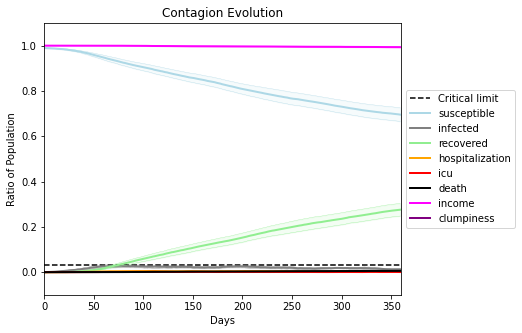

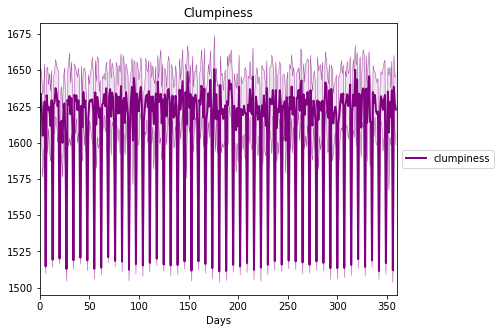

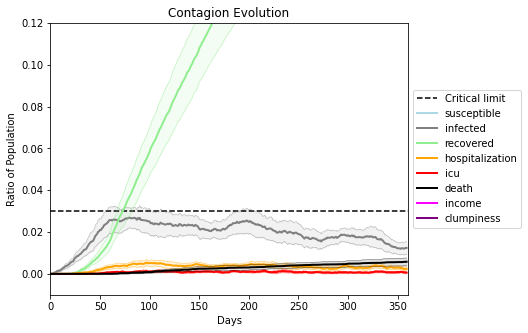

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[941, 405, 7838, 7041, 7355, 117, 9391, 5515, 9803, 7211, 2316, 71, 4263, 4731, 6356, 7127, 8210, 9719, 6127, 5594]
Average similarity between family members is 0.9704511110429613 at temperature -0.998
Average similarity between family and home is 0.999862494935506 at temperature -1
Average similarity between students and their classroom is 0.9745684494131885 at temperature -0.998
Average classroom occupancy is 1.648936170212766 and number classrooms is 188
Average similarity between workers is 0.9631311437284669 at temperature -0.998
Average office occupancy is 3.5054945054945055 and number offices is 182
Average friend similarity for adults: 0.8544717409937096 for kids: 0.7535361735618913
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.6136337843148407
avg restaurant similarity 0.5771999818774186
avg restaurant similarity 0.6745612120083488
avg restaurant similarity 0.6241220721925204
avg restaurant similarity 0.6291683813576682
avg restaurant similarity 0.6246968535336348
avg restaurant similarity 0.6615903280046899
avg restaurant similarity 0.7177567988455327
avg restaurant similarity 0.6095416898964034
avg restaurant similarity 0.5741186663480119
avg restaurant similarity 0.5553768076258253
avg restaurant similarity 0.5864769268952862
avg restaurant similarity 0.7048530136607315
avg restaurant similarity 0.6905931288104965
avg restaurant similarity 0.5725910091031949
avg restaurant similarity 0.5907564346494907
avg restaurant similarity 0.7287103133776762
avg restaurant similarity 0.6493580334122291
avg restaurant similarity 0.7098178471230803
avg restaurant similarity 0.7061754168351134
avg restaurant similarity 0.6243693913574039
avg restaurant similarity 0.5954398607637674
avg restau

avg restaurant similarity 0.5978363234237121
avg restaurant similarity 0.6830427857174325
avg restaurant similarity 0.6749407145903995
avg restaurant similarity 0.7856340423979494
avg restaurant similarity 0.6440446009788147
avg restaurant similarity 0.8312684164544423
avg restaurant similarity 0.5956046454819462
avg restaurant similarity 0.6236907442402433
avg restaurant similarity 0.60897987859252
avg restaurant similarity 0.7219491456019237
avg restaurant similarity 0.5660095588535132
avg restaurant similarity 0.6701415127382364
avg restaurant similarity 0.7462770463386489
avg restaurant similarity 0.7124506671877311
avg restaurant similarity 0.6965516188839518
avg restaurant similarity 0.4978788767612754
avg restaurant similarity 0.6036478783973168
avg restaurant similarity 0.8434971731586656
avg restaurant similarity 0.583662780173425
avg restaurant similarity 0.6423163701894737
avg restaurant similarity 0.6554726135060688
avg restaurant similarity 0.5686149867801069
avg restauran

Average similarity between workers is 0.9598264154372376 at temperature -0.998
Average office occupancy is 3.5828877005347595 and number offices is 187
Average friend similarity for adults: 0.8631514925821514 for kids: 0.7243343615317646
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5603711032646659
avg restaurant similarity 0.8077585035034399
avg restaurant similarity 0.6038366477188856
avg restaurant similarity 0.6188214693353206
avg restaurant similarity 0.5395740778457578
avg restaurant similarity 0.9050197324800702
avg restaurant similarity 0.759332470908718
avg restaurant similarity 0.4703077889635791
avg restaurant similarity 0.8985837411155891
avg restaurant similarity 0.5576349674907795
avg restaurant similarity 0.7369071871946687
avg restaurant similarity 0.6792218399453273
avg restaurant similarity 0.6363141829986191
avg restaurant similarity 0.7356843392680665
avg restaurant similarity 0.6757186171571592
avg restaurant similarity 0.7849657133448471
avg restaurant similarity 0.7698409268752191
avg restaurant similarity 0.6192524050137271
avg restaurant similarity 0.7245178768388326
avg restaurant similarity 0.6768513800470908
avg restaurant similarity 0.8227844966639453
avg restaurant similarity 0.537566732662282
avg restaura

avg restaurant similarity 0.7501355416039183
avg restaurant similarity 0.7296808747424154
avg restaurant similarity 0.6474353317929605
avg restaurant similarity 0.7190092514939395
avg restaurant similarity 0.7326458167478876
avg restaurant similarity 0.6715104127833432
avg restaurant similarity 0.6465841867821946
avg restaurant similarity 0.656617236664718
avg restaurant similarity 0.7956093297588448
avg restaurant similarity 0.616300516758435
avg restaurant similarity 0.8154116515721173
avg restaurant similarity 0.9622349786453425
avg restaurant similarity 0.7787503929200064
avg restaurant similarity 0.7247860244691534
avg restaurant similarity 0.7760613413796591
avg restaurant similarity 0.6943896683350478
avg restaurant similarity 0.5033292948122658
avg restaurant similarity 0.7002605744903442
avg restaurant similarity 0.7738359037543185
avg restaurant similarity 0.6724056164319807
avg restaurant similarity 0.8517075377167701
avg restaurant similarity 0.6611464277117679
avg restaura

Average similarity between workers is 0.9759891401702471 at temperature -0.998
Average office occupancy is 3.5268817204301075 and number offices is 186
Average friend similarity for adults: 0.862843995184584 for kids: 0.7466150084948775
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.47390587633467973
avg restaurant similarity 0.5072116862696315
avg restaurant similarity 0.4351986815494917
avg restaurant similarity 0.6452127118284046
avg restaurant similarity 0.9998573525737667
avg restaurant similarity 0.999788294120711
avg restaurant similarity 0.5532822180679755
avg restaurant similarity 0.6490153226695535
avg restaurant similarity 0.3232732026434529
avg restaurant similarity 0.5412475404303153
avg restaurant similarity 0.40879067182037115
avg restaurant similarity 0.732602196025068
avg restaurant similarity 0.7628400320012888
avg restaurant similarity 0.35771381352490383
avg restaurant similarity 0.7437855111657544
avg restaurant similarity 0.635228571361454
avg restaurant similarity 0.4217802750135352
avg restaurant similarity 0.5259694686385068
avg restaurant similarity 0.5361352366190351
avg restaurant similarity 0.456346558731346
avg restaurant similarity 0.4687121381751855
avg restaurant similarity 0.5252027533814987
avg restaur

avg restaurant similarity 0.5817990548030461
avg restaurant similarity 0.6154213943639274
avg restaurant similarity 0.787946892900143
avg restaurant similarity 0.31282681898089704
avg restaurant similarity 0.5425828713733984
avg restaurant similarity 0.6001836425280684
avg restaurant similarity 0.6999147247933927
avg restaurant similarity 0.5940445638024338
avg restaurant similarity 0.4246162038196233
avg restaurant similarity 0.5080780842163396
avg restaurant similarity 0.8151866908079467
avg restaurant similarity 0.36658628276952154
avg restaurant similarity 0.671928700717213
avg restaurant similarity 0.5851328723413982
avg restaurant similarity 0.5384228015871437
avg restaurant similarity 0.4530287141399856
avg restaurant similarity 0.4214564209011125
avg restaurant similarity 0.4944887816010868
avg restaurant similarity 0.3075538022590567
avg restaurant similarity 0.5131327017549623
avg restaurant similarity 0.44434243840761106
avg restaurant similarity 0.4253709438533507
avg resta

avg restaurant similarity 0.691942420262647
avg restaurant similarity 0.7269590595818851
avg restaurant similarity 0.713968728723205
avg restaurant similarity 0.5971461848768616
avg restaurant similarity 0.6558645482401698
avg restaurant similarity 0.6114013695207723
avg restaurant similarity 0.5899960533658706
avg restaurant similarity 0.6520213756620751
avg restaurant similarity 0.67560319722041
avg restaurant similarity 0.8754133762599142
avg restaurant similarity 0.7376325091208642
avg restaurant similarity 0.6660379468739928
avg restaurant similarity 0.7149155645618162
avg restaurant similarity 0.5491853494763312
avg restaurant similarity 0.7310503894196042
avg restaurant similarity 0.6335261100951691
avg restaurant similarity 0.49157042745618484
avg restaurant similarity 0.8654969541952888
avg restaurant similarity 0.8423222399646149
avg restaurant similarity 0.6725091231674561
avg restaurant similarity 0.6129856266097974
avg restaurant similarity 0.8418482276183262
avg restauran

avg restaurant similarity 0.7557001353096815
avg restaurant similarity 0.535878170543515
avg restaurant similarity 0.6315717380305489
avg restaurant similarity 0.8505283450896436
avg restaurant similarity 0.7321882839176846
avg restaurant similarity 0.44718931362502495
avg restaurant similarity 0.6504161093686525
avg restaurant similarity 0.6839306596413768
avg restaurant similarity 0.6278561031172932
avg restaurant similarity 0.40207426189114087
avg restaurant similarity 0.7793473180608053
avg restaurant similarity 0.6767387659465349
avg restaurant similarity 0.9998011210370497
avg restaurant similarity 0.7698328020196317
avg restaurant similarity 0.6139315572140318
avg restaurant similarity 0.6920335971807305
avg restaurant similarity 0.7040829158815364
avg restaurant similarity 0.6254486697562465
avg restaurant similarity 0.466609493202212
avg restaurant similarity 0.7151269091172527
avg restaurant similarity 0.6273076614849854
avg restaurant similarity 0.7078868267681973
avg restau

avg restaurant similarity 0.8165177426073201
avg restaurant similarity 0.8324358203000256
avg restaurant similarity 0.6748345684447925
avg restaurant similarity 0.4734355283060663
avg restaurant similarity 0.5913855206065209
avg restaurant similarity 0.5972206371995895
avg restaurant similarity 0.7124715273514516
avg restaurant similarity 0.4405752554923511
avg restaurant similarity 0.496310805634254
avg restaurant similarity 0.545768406569129
avg restaurant similarity 0.7015720059840117
avg restaurant similarity 0.6984983992991889
avg restaurant similarity 0.45069369297574413
avg restaurant similarity 0.6183263162557359
avg restaurant similarity 0.5265814835916615
avg restaurant similarity 0.4843109713387959
avg restaurant similarity 0.5841715391184362
avg restaurant similarity 0.6382288730535259
avg restaurant similarity 0.5552718054139623
avg restaurant similarity 0.7241871564289606
avg restaurant similarity 0.610364929791449
avg restaurant similarity 0.44036803660190366
avg restaur

avg restaurant similarity 0.5441956458757955
avg restaurant similarity 0.6572691954978093
avg restaurant similarity 0.5871291607892188
avg restaurant similarity 0.7837454431194534
avg restaurant similarity 0.5365370013339545
avg restaurant similarity 0.5754121842018557
avg restaurant similarity 0.49048415868919404
avg restaurant similarity 0.614640797763576
avg restaurant similarity 0.7537598355373336
avg restaurant similarity 0.49824625925783905
avg restaurant similarity 0.7520525684378844
avg restaurant similarity 0.5044487656901256
avg restaurant similarity 0.5395866723406074
avg restaurant similarity 0.9998353441271782
avg restaurant similarity 0.6431716117832921
avg restaurant similarity 0.6118460406396334
avg restaurant similarity 0.5950697296248543
avg restaurant similarity 0.611949322130729
avg restaurant similarity 0.46982778583793355
avg restaurant similarity 0.6203683995788756
avg restaurant similarity 0.4398202662755079
avg restaurant similarity 0.3565037834817711
avg resta

Average similarity between workers is 0.9677528280226595 at temperature -0.998
Average office occupancy is 3.466292134831461 and number offices is 178
Average friend similarity for adults: 0.8509211134121237 for kids: 0.7575041022319312
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.7120942463010755
avg restaurant similarity 0.6770440725204148
avg restaurant similarity 0.6098378385473617
avg restaurant similarity 0.9277835875055919
avg restaurant similarity 0.6165245939054974
avg restaurant similarity 0.7618282984594867
avg restaurant similarity 0.5863510877261527
avg restaurant similarity 0.7451136282351172
avg restaurant similarity 0.7348438683934074
avg restaurant similarity 0.791395066946693
avg restaurant similarity 0.6659352459592713
avg restaurant similarity 0.6760689058844082
avg restaurant similarity 0.7046877888510696
avg restaurant similarity 0.5419090008127779
avg restaurant similarity 0.7639770924148306
avg restaurant similarity 0.5705934311573388
avg restaurant similarity 0.7864990634689262
avg restaurant similarity 0.7619968249350513
avg restaurant similarity 0.9040311878567349
avg restaurant similarity 0.725212116358564
avg restaurant similarity 0.7792530583614901
avg restaurant similarity 0.6916252541932195
avg restaura

avg restaurant similarity 0.46537918342620754
avg restaurant similarity 0.9998628241522037
avg restaurant similarity 0.6600104138408562
avg restaurant similarity 0.7122703870889693
avg restaurant similarity 0.6385288701199575
avg restaurant similarity 0.605174651826439
avg restaurant similarity 0.7531730930968765
avg restaurant similarity 0.49248045588368033
avg restaurant similarity 0.7707693479817171
avg restaurant similarity 0.4538645487229047
avg restaurant similarity 0.7278174593762275
avg restaurant similarity 0.679409173822542
avg restaurant similarity 0.759856077239065
avg restaurant similarity 0.5288293255018797
avg restaurant similarity 0.6969446330152379
avg restaurant similarity 0.5681688163234784
avg restaurant similarity 0.6053307912498163
avg restaurant similarity 0.999622706996697
avg restaurant similarity 0.5623362217024905
avg restaurant similarity 0.9997994450701176
avg restaurant similarity 0.7362783648324874
avg restaurant similarity 0.8170862530425871
avg restaura

avg restaurant similarity 0.5839376168253142
avg restaurant similarity 0.6266752930928684
avg restaurant similarity 0.8773660568493487
avg restaurant similarity 0.6243874066395622
avg restaurant similarity 0.8102896824175779
avg restaurant similarity 0.5044890803415836
avg restaurant similarity 0.5777033064441309
avg restaurant similarity 0.47860338682682857
avg restaurant similarity 0.5522852396060786
avg restaurant similarity 0.6402639664311429
avg restaurant similarity 0.7127540957460137
avg restaurant similarity 0.9998133315359197
avg restaurant similarity 0.7703411708765491
avg restaurant similarity 0.8046322463254458
avg restaurant similarity 0.8198947498792769
avg restaurant similarity 0.7702553614462457
avg restaurant similarity 0.717692863377321
avg restaurant similarity 0.5728571028745937
avg restaurant similarity 0.5058043953310214
avg restaurant similarity 0.8126825842846301
avg restaurant similarity 0.4654143270286016
avg restaurant similarity 0.6123530532592921
avg restau

avg restaurant similarity 0.6091065666237461
avg restaurant similarity 0.9212992368028035
avg restaurant similarity 0.5901219368138994
avg restaurant similarity 0.7829577394285998
avg restaurant similarity 0.8820777004081898
avg restaurant similarity 0.5229859475874578
avg restaurant similarity 0.6284053319070247
avg restaurant similarity 0.6275646249422222
avg restaurant similarity 0.404886298322647
avg restaurant similarity 0.5335469761426528
avg restaurant similarity 0.8505775893248193
avg restaurant similarity 0.6617508364402256
avg restaurant similarity 0.9208473384345162
avg restaurant similarity 0.8108499296155794
avg restaurant similarity 0.6739631562996632
avg restaurant similarity 0.582827460866262
avg restaurant similarity 0.9421582186265339
avg restaurant similarity 0.7909371963763896
avg restaurant similarity 0.7095607377679455
avg restaurant similarity 0.6577314775117068
avg restaurant similarity 0.5833201383232758
avg restaurant similarity 0.7343304234310317
avg restaura

avg restaurant similarity 0.6460520847314608
avg restaurant similarity 0.8020303446363783
avg restaurant similarity 0.7285060063984526
avg restaurant similarity 0.630699071488843
avg restaurant similarity 0.683269739326945
avg restaurant similarity 0.7702032333577296
avg restaurant similarity 0.5663980466607442
avg restaurant similarity 0.5144730313593576
avg restaurant similarity 0.6580322337340051
avg restaurant similarity 0.6717187758956372
avg restaurant similarity 0.7013428428286057
avg restaurant similarity 0.6256155354636976
avg restaurant similarity 0.5644338338248083
avg restaurant similarity 0.7509818936561168
avg restaurant similarity 0.9282391735647875
avg restaurant similarity 0.6564543745760545
avg restaurant similarity 0.6530756580569195
avg restaurant similarity 0.7222471046451419
avg restaurant similarity 0.6354498965745582
avg restaurant similarity 0.6240634641407594
avg restaurant similarity 0.7117669706162378
avg restaurant similarity 0.46031174156663446
avg restaur

avg restaurant similarity 0.6598064504053676
avg restaurant similarity 0.6927223615626831
avg restaurant similarity 0.5012971125530654
avg restaurant similarity 0.4484467090395679
avg restaurant similarity 0.6270989920448364
avg restaurant similarity 0.8053013919165839
avg restaurant similarity 0.696220371783529
avg restaurant similarity 0.4315378296432902
avg restaurant similarity 0.5631738723481624
avg restaurant similarity 0.5998094044851221
avg restaurant similarity 0.694033601245442
avg restaurant similarity 0.7431546444619478
avg restaurant similarity 0.5694143059818018
avg restaurant similarity 0.5327851925465258
avg restaurant similarity 0.7652615398244258
avg restaurant similarity 0.5332444083626466
avg restaurant similarity 0.5988460844456295
avg restaurant similarity 0.46179678986533457
avg restaurant similarity 0.6551436869319756
avg restaurant similarity 0.7193365658759059
avg restaurant similarity 0.5455074316495805
avg restaurant similarity 0.8679008896927403
avg restaur

avg restaurant similarity 0.6210435929417184
avg restaurant similarity 0.7503322731689446
avg restaurant similarity 0.8150057366269057
avg restaurant similarity 0.5384543018561517
avg restaurant similarity 0.4353385613752408
avg restaurant similarity 0.6177799603023311
avg restaurant similarity 0.6826208857157329
avg restaurant similarity 0.7180919300762363
avg restaurant similarity 0.564252082498862
avg restaurant similarity 0.6227023886133665
avg restaurant similarity 0.5683650448392271
avg restaurant similarity 0.6784469493353578
avg restaurant similarity 0.6028140488614372
avg restaurant similarity 0.683946835125063
avg restaurant similarity 0.6595179170643641
avg restaurant similarity 0.5834568615372353
avg restaurant similarity 0.541361940292655
avg restaurant similarity 0.6055444041367545
avg restaurant similarity 0.8038043025366441
avg restaurant similarity 0.5197802686105544
avg restaurant similarity 0.8055318745062999
avg restaurant similarity 0.6108083779946695
avg restauran

avg restaurant similarity 0.640651908439463
avg restaurant similarity 0.6791726042958475
avg restaurant similarity 0.591484128695069
avg restaurant similarity 0.6324485481773799
avg restaurant similarity 0.5445573513241576
avg restaurant similarity 0.7774941353253031
avg restaurant similarity 0.5805013679446518
avg restaurant similarity 0.5023822292283224
avg restaurant similarity 0.4037972073030842
avg restaurant similarity 0.5284215496770501
avg restaurant similarity 0.5219996104755166
avg restaurant similarity 0.5668153492656953
avg restaurant similarity 0.5586420390785135
avg restaurant similarity 0.6037836358659616
avg restaurant similarity 0.7034569028264355
avg restaurant similarity 0.7029957138645583
avg restaurant similarity 0.8181561060664748
avg restaurant similarity 0.6048514291072029
avg restaurant similarity 0.6561746877600864
avg restaurant similarity 0.3327654972725515
avg restaurant similarity 0.5464628604745828
avg restaurant similarity 0.9990302297212554
avg restaura

avg restaurant similarity 0.6852884479485963
avg restaurant similarity 0.7331892794808604
avg restaurant similarity 0.6695596773140257
avg restaurant similarity 0.6923683401554563
avg restaurant similarity 0.6190601637615056
avg restaurant similarity 0.72204664507653
avg restaurant similarity 0.640085844313127
avg restaurant similarity 0.6321835053980194
avg restaurant similarity 0.5148392338153183
avg restaurant similarity 0.6637881468474846
avg restaurant similarity 0.5953699551282375
avg restaurant similarity 0.6181488004233007
avg restaurant similarity 0.6826558760566039
avg restaurant similarity 0.5358362535770653
avg restaurant similarity 0.5767107139496173
avg restaurant similarity 0.6669496868225381
avg restaurant similarity 0.5282824014585591
avg restaurant similarity 0.6376145851989533
avg restaurant similarity 0.6915900930541435
avg restaurant similarity 0.7449841261780805
avg restaurant similarity 0.6593421242037011
avg restaurant similarity 0.6291073439192566
avg restauran

avg restaurant similarity 0.6982974855205769
avg restaurant similarity 0.7440819517686965
avg restaurant similarity 0.6926164113129217
avg restaurant similarity 0.6925567131795237
avg restaurant similarity 0.5795996268407342
avg restaurant similarity 0.7096239830606882
avg restaurant similarity 0.6426508818398723
avg restaurant similarity 0.7109747458261094
avg restaurant similarity 0.5698718600401368
avg restaurant similarity 0.6671369615574573
avg restaurant similarity 0.7225604891719924
avg restaurant similarity 0.8072676908718981
avg restaurant similarity 0.7312662015054376
avg restaurant similarity 0.6924251947740386
avg restaurant similarity 0.44819530335932206
avg restaurant similarity 0.5505002639775356
avg restaurant similarity 0.61606434348497
avg restaurant similarity 0.604827753442484
avg restaurant similarity 0.648899872337646
avg restaurant similarity 0.4724921066600329
avg restaurant similarity 0.41349110843677095
avg restaurant similarity 0.5066339345195104
avg restaura

Average similarity between workers is 0.9756371201792933 at temperature -0.998
Average office occupancy is 3.5355191256830603 and number offices is 183
Average friend similarity for adults: 0.8604725421889715 for kids: 0.754976197627405
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.8499822171126677
avg restaurant similarity 0.8645775727644226
avg restaurant similarity 0.772607686216933
avg restaurant similarity 0.8276900482311151
avg restaurant similarity 0.6621605458514445
avg restaurant similarity 0.5865766495084109
avg restaurant similarity 0.809228767337045
avg restaurant similarity 0.7168737578717559
avg restaurant similarity 0.7024893022737396
avg restaurant similarity 0.5802167309727182
avg restaurant similarity 0.6830286710497934
avg restaurant similarity 0.4139887315881601
avg restaurant similarity 0.7566415536161919
avg restaurant similarity 0.6601016324259852
avg restaurant similarity 0.8235945136907733
avg restaurant similarity 0.9296007668549595
avg restaurant similarity 0.720880475389596
avg restaurant similarity 0.6562049156367495
avg restaurant similarity 0.9226829705587818
avg restaurant similarity 0.6992997802085089
avg restaurant similarity 0.6920914392299957
avg restaurant similarity 0.7036704613369544
avg restauran

avg restaurant similarity 0.5602082463634473
avg restaurant similarity 0.715870902503982
avg restaurant similarity 0.6940545387381327
avg restaurant similarity 0.6292093032984641
avg restaurant similarity 0.5935745424351208
avg restaurant similarity 0.7542755207096987
avg restaurant similarity 0.7375172943084168
avg restaurant similarity 0.7687031033952453
avg restaurant similarity 0.7319069019619667
avg restaurant similarity 0.6372837386080294
avg restaurant similarity 0.6214344015785073
avg restaurant similarity 0.8269475998432496
avg restaurant similarity 0.6286092844681966
avg restaurant similarity 0.7039118598143523
avg restaurant similarity 0.514802232523568
avg restaurant similarity 0.7109956418795434
avg restaurant similarity 0.7023621952925856
avg restaurant similarity 0.7568363509834678
avg restaurant similarity 0.7199750918492765
avg restaurant similarity 0.7728058379380957
avg restaurant similarity 0.5405918907268197
avg restaurant similarity 0.772820406747173
avg restauran

avg restaurant similarity 0.6790796766320323
avg restaurant similarity 0.7370906585747067
avg restaurant similarity 0.6793051402209178
avg restaurant similarity 0.5050377083370899
avg restaurant similarity 0.7002362122060884
avg restaurant similarity 0.6947226173717836
avg restaurant similarity 0.6354144578504541
avg restaurant similarity 0.7566389505235754
avg restaurant similarity 0.7488143624297521
avg restaurant similarity 0.38244599402627794
avg restaurant similarity 0.5986146184241814
avg restaurant similarity 0.413673730993661
avg restaurant similarity 0.8907034150639165
avg restaurant similarity 0.6554288032917968
avg restaurant similarity 0.6265376404943602
avg restaurant similarity 0.49045961086645673
avg restaurant similarity 0.7393137008907282
avg restaurant similarity 0.63619614558532
avg restaurant similarity 0.4804995910072177
avg restaurant similarity 0.42512882101007676
avg restaurant similarity 0.6431278956691044
avg restaurant similarity 0.7922907416139818
avg restau

avg restaurant similarity 0.5519303615991528
avg restaurant similarity 0.5992733827810941
avg restaurant similarity 0.5534949490929446
avg restaurant similarity 0.5449184306176763
avg restaurant similarity 0.539786140018035
avg restaurant similarity 0.4871252435737666
avg restaurant similarity 0.8112220732444252
avg restaurant similarity 0.6399404573684948
avg restaurant similarity 0.5964259818894843
avg restaurant similarity 0.7326462025774714
avg restaurant similarity 0.5040054142982476
avg restaurant similarity 0.6204963931219524
avg restaurant similarity 0.8330239442407936
avg restaurant similarity 0.5502638464781328
avg restaurant similarity 0.47913446256141656
avg restaurant similarity 0.4840380309719403
avg restaurant similarity 0.6008828161380421
avg restaurant similarity 0.6637787709523039
avg restaurant similarity 0.4795053178568205
avg restaurant similarity 0.5804338728087896
avg restaurant similarity 0.7022794790412019
avg restaurant similarity 0.9639487911902314
avg restau

avg restaurant similarity 0.6568672968419114
avg restaurant similarity 0.6936653362848327
avg restaurant similarity 0.612747783159574
avg restaurant similarity 0.6797882735415155
avg restaurant similarity 0.6778322672689905
avg restaurant similarity 0.7588244297454463
avg restaurant similarity 0.6842358708126978
avg restaurant similarity 0.64553233021321
avg restaurant similarity 0.5843732136384545
avg restaurant similarity 0.6987843107698908
avg restaurant similarity 0.7443477718865994
avg restaurant similarity 0.5400293787583281
avg restaurant similarity 0.6767840106209116
avg restaurant similarity 0.6790172674606911
avg restaurant similarity 0.5786383988729643
avg restaurant similarity 0.6889716183717415
avg restaurant similarity 0.6653769199933708
avg restaurant similarity 0.4348051026040718
avg restaurant similarity 0.48772951547306215
avg restaurant similarity 0.6865018935934929
avg restaurant similarity 0.6357895694882223
avg restaurant similarity 0.6319028388105589
avg restaura

avg restaurant similarity 0.7016279188263583
avg restaurant similarity 0.6074309782798046
avg restaurant similarity 0.42261797027395254
avg restaurant similarity 0.647326237148226
avg restaurant similarity 0.6209407666448118
avg restaurant similarity 0.7598278576602836
avg restaurant similarity 0.6796444088110664
avg restaurant similarity 0.6547875756105411
avg restaurant similarity 0.5420313224211218
avg restaurant similarity 0.6597900977004971
avg restaurant similarity 0.5637678515448455
avg restaurant similarity 0.7409051610316115
avg restaurant similarity 0.28897098946850563
avg restaurant similarity 0.8653999804683952
avg restaurant similarity 0.5152313833717244
avg restaurant similarity 0.5642664874456534
avg restaurant similarity 0.5068031302005758
avg restaurant similarity 0.8384022171897948
avg restaurant similarity 0.5906171859168085
avg restaurant similarity 0.9997444197754101
avg restaurant similarity 0.6932906947939624
avg restaurant similarity 0.637953661925757
avg restau

Average similarity between workers is 0.9578919776815888 at temperature -0.998
Average office occupancy is 3.60752688172043 and number offices is 186
Average friend similarity for adults: 0.8624376020987593 for kids: 0.7271041205426249
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 

avg restaurant similarity 0.6219441671589968
avg restaurant similarity 0.6998285685022692
avg restaurant similarity 0.6072098279123214
avg restaurant similarity 0.5714865225695779
avg restaurant similarity 0.7434370495055408
avg restaurant similarity 0.6752204952068648
avg restaurant similarity 0.7551027533197843
avg restaurant similarity 0.6352908895773214
avg restaurant similarity 0.6345969607394908
avg restaurant similarity 0.5891608646333149
avg restaurant similarity 0.5519056369204415
avg restaurant similarity 0.5360645572170439
avg restaurant similarity 0.6254824490259209
avg restaurant similarity 0.5191560539186428
avg restaurant similarity 0.5999201373040354
avg restaurant similarity 0.46520435873401006
avg restaurant similarity 0.7439953501886167
avg restaurant similarity 0.5918658815661111
avg restaurant similarity 0.6028389344994985
avg restaurant similarity 0.5679486101055503
avg restaurant similarity 0.5722096648471356
avg restaurant similarity 0.42698981850682494
avg rest

avg restaurant similarity 0.6467817266946709
avg restaurant similarity 0.48364877073350193
avg restaurant similarity 0.6809556677504879
avg restaurant similarity 0.4740435905124035
avg restaurant similarity 0.7958821621667014
avg restaurant similarity 0.5453817528942114
avg restaurant similarity 0.3687824733656711
avg restaurant similarity 0.653839334330399
avg restaurant similarity 0.566659640611253
avg restaurant similarity 0.7855609862831121
avg restaurant similarity 0.6107578567628813
avg restaurant similarity 0.5541407520252936
avg restaurant similarity 0.7463736530888352
avg restaurant similarity 0.5528277547567947
avg restaurant similarity 0.4921688298285794
avg restaurant similarity 0.5439522195230384
avg restaurant similarity 0.5915070524656526
avg restaurant similarity 0.5535260083465853
avg restaurant similarity 0.5360789858440387
avg restaurant similarity 0.5921337673127427
avg restaurant similarity 0.6141187624957154
avg restaurant similarity 0.6859227288126226
avg restaur

Average friend similarity for adults: 0.8657063914167973 for kids: 0.734684759055525
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.7028614927024243
avg restaurant similarity 0.7586563254403145
avg restaurant similarity 0.6437090722955345
avg restaurant similarity 0.5968551288256719
avg restaurant similarity 0.7344630284485005
avg restaurant similarity 0.75075963844887
avg restaurant similarity 0.7641029043061274
avg restaurant similarity 0.6168369185513138
avg restaurant similarity 0.7056422601052832
avg restaurant similarity 0.7682755801596388
avg restaurant similarity 0.780382413244243
avg restaurant similarity 0.7126151683357541
avg restaurant similarity 0.8077440326606932
avg restaurant similarity 0.6293627196227538
avg restaurant similarity 0.6843033076881726
avg restaurant similarity 0.6837188387328178
avg restaurant similarity 0.6842166087067773
avg restaurant similarity 0.7012839405087317
avg restaurant similarity 0.7809541568168037
avg restaurant similarity 0.8465252270894905
avg restaurant similarity 0.6610868802419044
avg restaurant similarity 0.8243673106004588
avg restauran

avg restaurant similarity 0.705363455403714
avg restaurant similarity 0.6491589949946851
avg restaurant similarity 0.8005618651621299
avg restaurant similarity 0.7365983342343178
avg restaurant similarity 0.7051270181115843
avg restaurant similarity 0.8505914079774096
avg restaurant similarity 0.8428859978575218
avg restaurant similarity 0.7204839581872345
avg restaurant similarity 0.860979959129827
avg restaurant similarity 0.7535613006253655
avg restaurant similarity 0.8226326885831504
avg restaurant similarity 0.6607935260083674
avg restaurant similarity 0.7002159939493702
avg restaurant similarity 0.8626971593579468
avg restaurant similarity 0.8189188968289588
avg restaurant similarity 0.7011764045897911
avg restaurant similarity 0.7658412257207832
avg restaurant similarity 0.8481268146510385
avg restaurant similarity 0.74305106572619
avg restaurant similarity 0.8332161443066988
avg restaurant similarity 0.5719197863426887
avg restaurant similarity 0.6416989517248074
avg restaurant

Average friend similarity for adults: 0.8624618170136439 for kids: 0.740197616789505
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocate

avg restaurant similarity 0.7207426205399571
avg restaurant similarity 0.677376034382265
avg restaurant similarity 0.5599267053885361
avg restaurant similarity 0.6480251250549474
avg restaurant similarity 0.6679277742901899
avg restaurant similarity 0.7195786918291833
avg restaurant similarity 0.7186212474155326
avg restaurant similarity 0.705577533043366
avg restaurant similarity 0.6673236991273684
avg restaurant similarity 0.6369983565004214
avg restaurant similarity 0.6636670688277453
avg restaurant similarity 0.7216345918428934
avg restaurant similarity 0.5596713226937483
avg restaurant similarity 0.6538435498041186
avg restaurant similarity 0.7943270617822944
avg restaurant similarity 0.8225005440111172
avg restaurant similarity 0.5349586464740018
avg restaurant similarity 0.5630789190858515
avg restaurant similarity 0.7652404992110775
avg restaurant similarity 0.8012398585527648
avg restaurant similarity 0.6921109711685927
avg restaurant similarity 0.6768425924609438
avg restaura

avg restaurant similarity 0.5667517276365205
avg restaurant similarity 0.7516047630716903
avg restaurant similarity 0.5724839282152988
avg restaurant similarity 0.6987435970763265
avg restaurant similarity 0.7006451110576123
avg restaurant similarity 0.6423763281683246
avg restaurant similarity 0.5869545264389049
avg restaurant similarity 0.7557971973205221
avg restaurant similarity 0.550951826288165
avg restaurant similarity 0.6483511702455359
avg restaurant similarity 0.8520835065761999
avg restaurant similarity 0.6836448749837677
avg restaurant similarity 0.6162460932865316
avg restaurant similarity 0.46024159112019775
avg restaurant similarity 0.6642652763298392
avg restaurant similarity 0.9280270541884155
avg restaurant similarity 0.8196413028624978
avg restaurant similarity 0.7704944388679866
avg restaurant similarity 0.7662248142477075
avg restaurant similarity 0.5263134484755125
avg restaurant similarity 0.4431404210288661
avg restaurant similarity 0.6582045939629562
avg restau

avg restaurant similarity 0.7924299932825863
avg restaurant similarity 0.758426507638408
avg restaurant similarity 0.6741386311545289
avg restaurant similarity 0.7502704345576756
avg restaurant similarity 0.7759085164105252
avg restaurant similarity 0.6739723131770612
avg restaurant similarity 0.7629797089425342
avg restaurant similarity 0.7441494512922555
avg restaurant similarity 0.690872359346024
avg restaurant similarity 0.7656173391872475
avg restaurant similarity 0.7444324260564631
avg restaurant similarity 0.6157347459518944
avg restaurant similarity 0.6324041884012186
avg restaurant similarity 0.6272686004407614
avg restaurant similarity 0.6382725505190855
avg restaurant similarity 0.646136018964659
avg restaurant similarity 0.572553594506254
avg restaurant similarity 0.7501216551167691
avg restaurant similarity 0.6589328380558862
avg restaurant similarity 0.7187637269538556
avg restaurant similarity 0.6002788032166156
avg restaurant similarity 0.6965848036857052
avg restaurant

avg restaurant similarity 0.7924750816942355
avg restaurant similarity 0.8765675237060779
avg restaurant similarity 0.7000020368472719
avg restaurant similarity 0.6974390440309054
avg restaurant similarity 0.6475072348345062
avg restaurant similarity 0.8399756575113861
avg restaurant similarity 0.7238348047603416
avg restaurant similarity 0.697689029471182
avg restaurant similarity 0.6851071574486209
avg restaurant similarity 0.7245073392393762
avg restaurant similarity 0.687593863730886
avg restaurant similarity 0.6548304220567371
avg restaurant similarity 0.6517798253837133
avg restaurant similarity 0.7969150797394591
avg restaurant similarity 0.7327253720639298
avg restaurant similarity 0.4508867308182319
avg restaurant similarity 0.6540505192712849
avg restaurant similarity 0.6720857009321589
avg restaurant similarity 0.7699001522037903
avg restaurant similarity 0.6456656655249933
avg restaurant similarity 0.7945297497975963
avg restaurant similarity 0.8304844103009652
avg restaura

Average similarity between workers is 0.9557770127646805 at temperature -0.998
Average office occupancy is 3.6236559139784945 and number offices is 186
Average friend similarity for adults: 0.8573475829982887 for kids: 0.753593159894577
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 pe

avg restaurant similarity 0.6660949045500122
avg restaurant similarity 0.7239334551061345
avg restaurant similarity 0.7122384344022888
avg restaurant similarity 0.5465296691495743
avg restaurant similarity 0.785786766669768
avg restaurant similarity 0.7841630196561988
avg restaurant similarity 0.7167904201420201
avg restaurant similarity 0.6435238795036129
avg restaurant similarity 0.745078542396822
avg restaurant similarity 0.4932758145147959
avg restaurant similarity 0.6325786972098183
avg restaurant similarity 0.5342427860241546
avg restaurant similarity 0.6698051805938343
avg restaurant similarity 0.5836762005805757
avg restaurant similarity 0.6313527293338428
avg restaurant similarity 0.6597559976741514
avg restaurant similarity 0.6349736892938784
avg restaurant similarity 0.6594302774774783
avg restaurant similarity 0.5252586599969681
avg restaurant similarity 0.6033874222777053
avg restaurant similarity 0.6313115805533462
avg restaurant similarity 0.9209634877603476
avg restaura

avg restaurant similarity 0.6094406620748455
avg restaurant similarity 0.5583598020294304
avg restaurant similarity 0.5836678002143567
avg restaurant similarity 0.7005103883071002
avg restaurant similarity 0.9996963322126882
avg restaurant similarity 0.8112883997546364
avg restaurant similarity 0.541373982960327
avg restaurant similarity 0.5753471346900438
avg restaurant similarity 0.46842552750359084
avg restaurant similarity 0.5537605288331675
avg restaurant similarity 0.6969799380129177
avg restaurant similarity 0.7489591464578867
avg restaurant similarity 0.7733068682652895
avg restaurant similarity 0.6371173266351368
avg restaurant similarity 0.5745231391867436
avg restaurant similarity 0.6245312907755785
avg restaurant similarity 0.5986252519064863
avg restaurant similarity 0.5733527040502546
avg restaurant similarity 0.6817468584699502
avg restaurant similarity 0.5656748485236098
avg restaurant similarity 0.5480922148287912
avg restaurant similarity 0.2810669088980894
avg restau

avg restaurant similarity 0.7619198763993558
avg restaurant similarity 0.7183231315828458
avg restaurant similarity 0.5581988213721175
avg restaurant similarity 0.5068880220400053
avg restaurant similarity 0.7246112635055322
avg restaurant similarity 0.559196709318367
avg restaurant similarity 0.5950711143377647
avg restaurant similarity 0.6126463051934719
avg restaurant similarity 0.49311841027096137
avg restaurant similarity 0.7217795200847044
avg restaurant similarity 0.5656381879000925
avg restaurant similarity 0.7064636462732298
avg restaurant similarity 0.5503148689193509
avg restaurant similarity 0.5621539615396589
avg restaurant similarity 0.7925988406056158
avg restaurant similarity 0.6763203623738441
avg restaurant similarity 0.49646213894648067
avg restaurant similarity 0.5762186103338259
avg restaurant similarity 0.5432354963106462
avg restaurant similarity 0.654372878078149
avg restaurant similarity 0.7449305981148304
avg restaurant similarity 0.7162156020536908
avg restau

avg restaurant similarity 0.41411741331704777
avg restaurant similarity 0.4078043599116153
avg restaurant similarity 0.6240686601172959
avg restaurant similarity 0.5596053796349076
avg restaurant similarity 0.5946236168308838
avg restaurant similarity 0.5307225471400981
avg restaurant similarity 0.5188201255047231
avg restaurant similarity 0.5359987616898834
avg restaurant similarity 0.5695708500117582
avg restaurant similarity 0.5332029237313911
avg restaurant similarity 0.7009570734270195
avg restaurant similarity 0.5662052251429421
avg restaurant similarity 0.6390676872307659
avg restaurant similarity 0.4892690216950284
avg restaurant similarity 0.6672803878599587
avg restaurant similarity 0.6593532093851532
avg restaurant similarity 0.709870710010983
avg restaurant similarity 0.7463996602870395
avg restaurant similarity 0.4961284492718664
avg restaurant similarity 0.5050968584121948
avg restaurant similarity 0.5453922244179152
avg restaurant similarity 0.574609521911543
avg restaur

Average similarity between workers is 0.9556169965546095 at temperature -0.998
Average office occupancy is 3.632978723404255 and number offices is 188
Average friend similarity for adults: 0.8667132328830269 for kids: 0.7145614396213524
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6437163600564262
avg restaurant similarity 0.5421134997062032
avg restaurant similarity 0.8128643322365021
avg restaurant similarity 0.8160185956521637
avg restaurant similarity 0.48941765150656136
avg restaurant similarity 0.759083180700682
avg restaurant similarity 0.569252370720116
avg restaurant similarity 0.5999874433086175
avg restaurant similarity 0.5772553075138048
avg restaurant similarity 0.535921512520662
avg restaurant similarity 0.7723129750041334
avg restaurant similarity 0.7414723569006618
avg restaurant similarity 0.4735075606875746
avg restaurant similarity 0.7425881826335681
avg restaurant similarity 0.6385221573312467
avg restaurant similarity 0.8224143386111777
avg restaurant similarity 0.7628670762428679
avg restaurant similarity 0.5198045439764243
avg restaurant similarity 0.4094749119507248
avg restaurant similarity 0.4432859298343122
avg restaurant similarity 0.2240077654533178
avg restaurant similarity 0.70846826074668
avg restaurant

avg restaurant similarity 0.7583265868263094
avg restaurant similarity 0.6478714435116422
avg restaurant similarity 0.5168330682989668
avg restaurant similarity 0.5414699756211964
avg restaurant similarity 0.6254421359666943
avg restaurant similarity 0.6327280402027367
avg restaurant similarity 0.6058628572637251
avg restaurant similarity 0.4548413778662161
avg restaurant similarity 0.7058621786303921
avg restaurant similarity 0.809952286331038
avg restaurant similarity 0.727724839168046
avg restaurant similarity 0.6952483156497871
avg restaurant similarity 0.7524228260712581
avg restaurant similarity 0.6417434280813705
avg restaurant similarity 0.6492437502844235
avg restaurant similarity 0.6156178186698685
avg restaurant similarity 0.5344627173914822
avg restaurant similarity 0.6875624486986449
avg restaurant similarity 0.7761956239111357
avg restaurant similarity 0.5534990423125918
avg restaurant similarity 0.5576890435182619
avg restaurant similarity 0.386613847008514
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

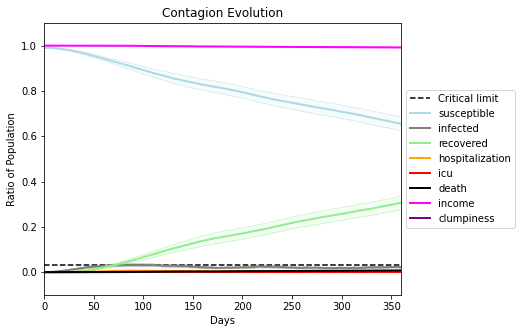

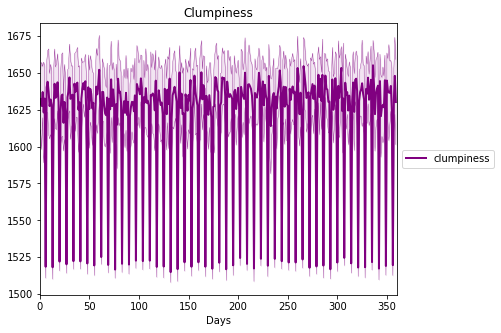

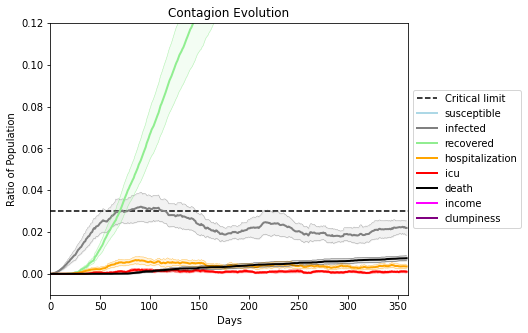

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2324, 3462, 6353, 559, 1167, 2926, 3097, 5737, 859, 2630, 2688, 5440, 8297, 6723, 2335, 9637, 5600, 9660, 8897, 4868]
Average similarity between family members is 0.9526340252892664 at temperature -0.9975
Average similarity between family and home is 0.9998609293037695 at temperature -1
Average similarity between students and their classroom is 0.9225572030527133 at temperature -0.9975
Average classroom occupancy is 1.6820809248554913 and number classrooms is 173
Average similarity between workers is 0.9331259031306107 at temperature -0.9975
Average office occupancy is 3.3743589743589744 and number offices is 195
Average friend similarity for adults: 0.8579405824169448 for kids: 0.7333455694862985
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Bu

avg restaurant similarity 0.7294169323931248
avg restaurant similarity 0.6974481879339312
avg restaurant similarity 0.6053250923125792
avg restaurant similarity 0.6689972958948913
avg restaurant similarity 0.842901998210596
avg restaurant similarity 0.6647856270799891
avg restaurant similarity 0.6617858592957648
avg restaurant similarity 0.6764706581456159
avg restaurant similarity 0.6096508116522472
avg restaurant similarity 0.6066126529433445
avg restaurant similarity 0.4850741899195162
avg restaurant similarity 0.6652428891648338
avg restaurant similarity 0.7229341467425486
avg restaurant similarity 0.669171378086934
avg restaurant similarity 0.6887930064067463
avg restaurant similarity 0.796477551887983
avg restaurant similarity 0.6861529043912965
avg restaurant similarity 0.7131021946407379
avg restaurant similarity 0.6436183270747933
avg restaurant similarity 0.6140894632658732
avg restaurant similarity 0.5983964881169819
avg restaurant similarity 0.7840990297209521
avg restauran

avg restaurant similarity 0.9995562922279423
avg restaurant similarity 0.7617878584627957
avg restaurant similarity 0.753640651905674
avg restaurant similarity 0.5428944251263773
avg restaurant similarity 0.7229527894544178
avg restaurant similarity 0.6793311028313078
avg restaurant similarity 0.6817032432484499
avg restaurant similarity 0.6993274394468101
avg restaurant similarity 0.6597666224156319
avg restaurant similarity 0.5735399763239637
avg restaurant similarity 0.8442723742910039
avg restaurant similarity 0.5748136402026103
avg restaurant similarity 0.7524540176831045
avg restaurant similarity 0.6772672860850576
avg restaurant similarity 0.7509271768031557
avg restaurant similarity 0.7085277330019178
avg restaurant similarity 0.7961749714802009
avg restaurant similarity 0.5412969955761492
avg restaurant similarity 0.45395946150802785
avg restaurant similarity 0.622345696011315
avg restaurant similarity 0.7112708118331141
avg restaurant similarity 0.4715400156941637
avg restaur

Average friend similarity for adults: 0.8653057336234258 for kids: 0.7404601182001757
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.5140029368294871
avg restaurant similarity 0.6497354698943762
avg restaurant similarity 0.5591895293055006
avg restaurant similarity 0.8471095821471353
avg restaurant similarity 0.5646969088815174
avg restaurant similarity 0.5462042468845225
avg restaurant similarity 0.5546395953993419
avg restaurant similarity 0.6210655313118358
avg restaurant similarity 0.7941230745034066
avg restaurant similarity 0.634072567029912
avg restaurant similarity 0.509355217407072
avg restaurant similarity 0.5761232828200163
avg restaurant similarity 0.6266817227900381
avg restaurant similarity 0.637434091261611
avg restaurant similarity 0.8161401184554123
avg restaurant similarity 0.6392172075589565
avg restaurant similarity 0.6793838835140411
avg restaurant similarity 0.7670622921085161
avg restaurant similarity 0.7010985577442529
avg restaurant similarity 0.6089912899409328
avg restaurant similarity 0.7430098945837134
avg restaurant similarity 0.6087108840094367
avg restauran

avg restaurant similarity 0.6964887134213209
avg restaurant similarity 0.5504634178512388
avg restaurant similarity 0.6508612773561961
avg restaurant similarity 0.5942731975493544
avg restaurant similarity 0.6923223527407135
avg restaurant similarity 0.42354304385269703
avg restaurant similarity 0.604268515189051
avg restaurant similarity 0.6896074399901414
avg restaurant similarity 0.38329479692323976
avg restaurant similarity 0.5456598527868497
avg restaurant similarity 0.6403163788295112
avg restaurant similarity 0.7441861786488483
avg restaurant similarity 0.7494861476699354
avg restaurant similarity 0.6526475532111002
avg restaurant similarity 0.6395029756584543
avg restaurant similarity 0.7188045737972908
avg restaurant similarity 0.6409461865742737
avg restaurant similarity 0.6119349151442849
avg restaurant similarity 0.792644225542836
avg restaurant similarity 0.5558747243419612
avg restaurant similarity 0.6812246618938014
avg restaurant similarity 0.6275106641290441
avg restau

Average similarity between workers is 0.9375943452356562 at temperature -0.9975
Average office occupancy is 3.324607329842932 and number offices is 191
Average friend similarity for adults: 0.8535121645495072 for kids: 0.7384217275185296
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.38199493843137927
avg restaurant similarity 0.7601734239969676
avg restaurant similarity 0.6514067579681447
avg restaurant similarity 0.6528744211495893
avg restaurant similarity 0.5254728963762529
avg restaurant similarity 0.6931831574010645
avg restaurant similarity 0.5558518546220208
avg restaurant similarity 0.7423706503135529
avg restaurant similarity 0.5889692042732875
avg restaurant similarity 0.49007418454247675
avg restaurant similarity 0.712164200309336
avg restaurant similarity 0.6337814144360477
avg restaurant similarity 0.5927547218552967
avg restaurant similarity 0.6818770278015424
avg restaurant similarity 0.44751305361243154
avg restaurant similarity 0.5722254492989205
avg restaurant similarity 0.6105770695955501
avg restaurant similarity 0.5899593584814137
avg restaurant similarity 0.505006447655044
avg restaurant similarity 0.4056289010162717
avg restaurant similarity 0.5043422323524117
avg restaurant similarity 0.6254730183881214
avg resta

avg restaurant similarity 0.6241145177147404
avg restaurant similarity 0.5045658886484764
avg restaurant similarity 0.5551016629173878
avg restaurant similarity 0.6172380280599935
avg restaurant similarity 0.6249728582318943
avg restaurant similarity 0.5801729219211587
avg restaurant similarity 0.6771041185087501
avg restaurant similarity 0.6107953842151396
avg restaurant similarity 0.4723232773410023
avg restaurant similarity 0.5891602103973173
avg restaurant similarity 0.5641727596665813
avg restaurant similarity 0.5376214806855819
avg restaurant similarity 0.5466593272089051
avg restaurant similarity 0.5784022205867289
avg restaurant similarity 0.6129002423603038
avg restaurant similarity 0.5339594621275413
avg restaurant similarity 0.879401418608859
avg restaurant similarity 0.5146328013491692
avg restaurant similarity 0.5754116597508455
avg restaurant similarity 0.6414509762575932
avg restaurant similarity 0.4408081482568903
avg restaurant similarity 0.6031744127532305
avg restaur

Average similarity between workers is 0.9375145307287175 at temperature -0.9975
Average office occupancy is 3.3333333333333335 and number offices is 192
Average friend similarity for adults: 0.8486194882831107 for kids: 0.7465147341185894
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.7332834966725953
avg restaurant similarity 0.5287955649203062
avg restaurant similarity 0.6630853240787785
avg restaurant similarity 0.44600562707898733
avg restaurant similarity 0.9997988452350581
avg restaurant similarity 0.6228091249224936
avg restaurant similarity 0.6688540392804678
avg restaurant similarity 0.6174211620557686
avg restaurant similarity 0.4538400014462031
avg restaurant similarity 0.43935800518820595
avg restaurant similarity 0.4632501917306966
avg restaurant similarity 0.6937776521812303
avg restaurant similarity 0.6838596558560461
avg restaurant similarity 0.5546153792520294
avg restaurant similarity 0.5586903412966656
avg restaurant similarity 0.6540700316505853
avg restaurant similarity 0.4515074588320372
avg restaurant similarity 0.6496001883660064
avg restaurant similarity 0.6607298836368751
avg restaurant similarity 0.6025760784407374
avg restaurant similarity 0.9994296943711642
avg restaurant similarity 0.8586835527452022
avg rest

avg restaurant similarity 0.8638367059366631
avg restaurant similarity 0.5141770951771844
avg restaurant similarity 0.5383977318336459
avg restaurant similarity 0.7903204065711106
avg restaurant similarity 0.436782315281403
avg restaurant similarity 0.48995236051690816
avg restaurant similarity 0.35160438255074444
avg restaurant similarity 0.487986767757161
avg restaurant similarity 0.5360276444624632
avg restaurant similarity 0.48419399472674624
avg restaurant similarity 0.55792967822282
avg restaurant similarity 0.46676814811013256
avg restaurant similarity 0.8860017922010505
avg restaurant similarity 0.5808620863643961
avg restaurant similarity 0.746599847447184
avg restaurant similarity 0.4975161487127108
avg restaurant similarity 0.7216075059750707
avg restaurant similarity 0.7294982194353716
avg restaurant similarity 0.5903052258860908
avg restaurant similarity 0.6201285112999348
avg restaurant similarity 0.5306286977990332
avg restaurant similarity 0.5668730954400975
avg restaur

avg restaurant similarity 0.46393825877304884
avg restaurant similarity 0.64877128705324
avg restaurant similarity 0.42431578153805954
avg restaurant similarity 0.5275127773948994
avg restaurant similarity 0.544082276586935
avg restaurant similarity 0.7020201446689016
avg restaurant similarity 0.6298597694484349
avg restaurant similarity 0.7578312845795977
avg restaurant similarity 0.6491376324530386
avg restaurant similarity 0.569312033821691
avg restaurant similarity 0.5953741479414897
avg restaurant similarity 0.6650642878782898
avg restaurant similarity 0.7520338811260865
avg restaurant similarity 0.5956618794131813
avg restaurant similarity 0.5830662222838108
avg restaurant similarity 0.6531900620480787
avg restaurant similarity 0.5293637769360856
avg restaurant similarity 0.6105506693432846
avg restaurant similarity 0.7463200650414834
avg restaurant similarity 0.6822733518154659
avg restaurant similarity 0.4486195798648335
avg restaurant similarity 0.6010266501803623
avg restaura

avg restaurant similarity 0.6911098519676341
avg restaurant similarity 0.8704676942764702
avg restaurant similarity 0.48847338378154304
avg restaurant similarity 0.6519302621830224
avg restaurant similarity 0.5677204671157119
avg restaurant similarity 0.6081357530321891
avg restaurant similarity 0.39407524733095955
avg restaurant similarity 0.44734073336084795
avg restaurant similarity 0.6778162715165222
avg restaurant similarity 0.6474544439956347
avg restaurant similarity 0.4280180524997908
avg restaurant similarity 0.6213383703082856
avg restaurant similarity 0.4140406597855437
avg restaurant similarity 0.5719435629765923
avg restaurant similarity 0.5931881386279575
avg restaurant similarity 0.6116547047544842
avg restaurant similarity 0.8319034444466146
avg restaurant similarity 0.9996764325641667
avg restaurant similarity 0.5880300350204397
avg restaurant similarity 0.584766117081945
avg restaurant similarity 0.6450991722274212
avg restaurant similarity 0.5869764361051479
avg rest

avg restaurant similarity 0.6042757666943377
avg restaurant similarity 0.5871927981798899
avg restaurant similarity 0.804777332739501
avg restaurant similarity 0.6809413084090604
avg restaurant similarity 0.46301845303891964
avg restaurant similarity 0.8427222125371951
avg restaurant similarity 0.9659335782098651
avg restaurant similarity 0.49767469192936165
avg restaurant similarity 0.48745966425944076
avg restaurant similarity 0.7975804780331781
avg restaurant similarity 0.568486958561681
avg restaurant similarity 0.5817445473898092
avg restaurant similarity 0.7490191804298874
avg restaurant similarity 0.5207234676151071
avg restaurant similarity 0.6422935778650821
avg restaurant similarity 0.5154126052385216
avg restaurant similarity 0.734168448845847
avg restaurant similarity 0.7369846241585583
avg restaurant similarity 0.7513561908416934
avg restaurant similarity 0.7749145582878734
avg restaurant similarity 0.8541047948823917
avg restaurant similarity 0.7614265934970826
avg restau

avg restaurant similarity 0.9997425067374415
avg restaurant similarity 0.6087898674992738
avg restaurant similarity 0.5937518000291281
avg restaurant similarity 0.7301594892378261
avg restaurant similarity 0.827137305115736
avg restaurant similarity 0.5960422155554712
avg restaurant similarity 0.560553802728607
avg restaurant similarity 0.6628688166185627
avg restaurant similarity 0.9315100741122325
avg restaurant similarity 0.5868100105220295
avg restaurant similarity 0.7633515841516185
avg restaurant similarity 0.5376976949969379
avg restaurant similarity 0.7798437425611292
avg restaurant similarity 0.5849630188905174
avg restaurant similarity 0.6999511170835642
avg restaurant similarity 0.8804123680295488
avg restaurant similarity 0.8482544582599956
avg restaurant similarity 0.7161788017882851
avg restaurant similarity 0.6085762162745932
avg restaurant similarity 0.7424138423114252
avg restaurant similarity 0.7436178074871042
avg restaurant similarity 0.47643080147568784
avg restaur

Average similarity between workers is 0.9378153327308264 at temperature -0.9975
Average office occupancy is 3.5 and number offices is 190
Average friend similarity for adults: 0.8643075941865559 for kids: 0.7453777354382816
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 10 people.
Total of 10 people allo

avg restaurant similarity 0.5295727291329394
avg restaurant similarity 0.687122490155283
avg restaurant similarity 0.5490739720444646
avg restaurant similarity 0.5613929943483552
avg restaurant similarity 0.9996898602195605
avg restaurant similarity 0.6917113250252538
avg restaurant similarity 0.6148547217376666
avg restaurant similarity 0.5193007439123304
avg restaurant similarity 0.5401323433985672
avg restaurant similarity 0.6000063941548665
avg restaurant similarity 0.5927600168323541
avg restaurant similarity 0.5868266515082018
avg restaurant similarity 0.7669302945324021
avg restaurant similarity 0.6426659421320193
avg restaurant similarity 0.5819449065288609
avg restaurant similarity 0.7211232831569682
avg restaurant similarity 0.6235258138085155
avg restaurant similarity 0.6031950064322423
avg restaurant similarity 0.6863080138925088
avg restaurant similarity 0.5235867848796681
avg restaurant similarity 0.5475808010024151
avg restaurant similarity 0.5311581140500301
avg restaur

avg restaurant similarity 0.6619915058148163
avg restaurant similarity 0.5171355689986948
avg restaurant similarity 0.6140696870847726
avg restaurant similarity 0.5521416823278918
avg restaurant similarity 0.6226777425821852
avg restaurant similarity 0.6256568360419594
avg restaurant similarity 0.6260182717362704
avg restaurant similarity 0.9995266099108835
avg restaurant similarity 0.47044477523862704
avg restaurant similarity 0.6659612034157671
avg restaurant similarity 0.6674862590151257
avg restaurant similarity 0.7719757249025704
avg restaurant similarity 0.46107098666882346
avg restaurant similarity 0.711480881204503
avg restaurant similarity 0.5927692890562368
avg restaurant similarity 0.5203216138644405
avg restaurant similarity 0.6246152865309708
avg restaurant similarity 0.6379838589792008
avg restaurant similarity 0.4156658501708615
avg restaurant similarity 0.5851094688959358
avg restaurant similarity 0.5310130996295973
avg restaurant similarity 0.5237639940258055
avg resta

Average similarity between workers is 0.9243279967429718 at temperature -0.9975
Average office occupancy is 3.4410256410256412 and number offices is 195
Average friend similarity for adults: 0.853223673457165 for kids: 0.7234826012987672
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 p

avg restaurant similarity 0.6565544293068569
avg restaurant similarity 0.5394429456215729
avg restaurant similarity 0.5915017293377122
avg restaurant similarity 0.5536328217951287
avg restaurant similarity 0.6650034414914155
avg restaurant similarity 0.6577275679721293
avg restaurant similarity 0.6876984143084105
avg restaurant similarity 0.5890697608767197
avg restaurant similarity 0.6201562150047741
avg restaurant similarity 0.5452102849436598
avg restaurant similarity 0.7816600479596311
avg restaurant similarity 0.6885448515273832
avg restaurant similarity 0.6692582305729462
avg restaurant similarity 0.6103953212148543
avg restaurant similarity 0.6918693206349684
avg restaurant similarity 0.5110864654596828
avg restaurant similarity 0.5616044503074887
avg restaurant similarity 0.715806624227645
avg restaurant similarity 0.7263178114746255
avg restaurant similarity 0.7120484229627002
avg restaurant similarity 0.5263194335559798
avg restaurant similarity 0.5471638003309047
avg restaur

avg restaurant similarity 0.518982925111513
avg restaurant similarity 0.8746277449663806
avg restaurant similarity 0.5364191067686749
avg restaurant similarity 0.874796176062369
avg restaurant similarity 0.6005142729624595
avg restaurant similarity 0.6912307444307317
avg restaurant similarity 0.6437484391929186
avg restaurant similarity 0.506523343221383
avg restaurant similarity 0.5394728372527559
avg restaurant similarity 0.686028568874455
avg restaurant similarity 0.7256932598667389
avg restaurant similarity 0.533785091669526
avg restaurant similarity 0.6969222738909369
avg restaurant similarity 0.7513358248077481
avg restaurant similarity 0.40015280246270724
avg restaurant similarity 0.9995762361082321
avg restaurant similarity 0.7769544866607387
avg restaurant similarity 0.8367960033352695
avg restaurant similarity 0.7544379071753541
avg restaurant similarity 0.9496223565147286
avg restaurant similarity 0.2939217902904372
avg restaurant similarity 0.7116414064549037
avg restaurant

avg restaurant similarity 0.8391341301712659
avg restaurant similarity 0.46322588413162036
avg restaurant similarity 0.6604832638578795
avg restaurant similarity 0.5604264684527557
avg restaurant similarity 0.6381281373531952
avg restaurant similarity 0.33379402702892563
avg restaurant similarity 0.5858941059850209
avg restaurant similarity 0.5549019972791116
avg restaurant similarity 0.652087769986382
avg restaurant similarity 0.5495842239480869
avg restaurant similarity 0.4998578009446344
avg restaurant similarity 0.5451266737327908
avg restaurant similarity 0.49322632104872866
avg restaurant similarity 0.6222561222551567
avg restaurant similarity 0.5273490573067551
avg restaurant similarity 0.7193702852055659
avg restaurant similarity 0.742334924173956
avg restaurant similarity 0.7036559471257291
avg restaurant similarity 0.812296947581006
avg restaurant similarity 0.5429295205063293
avg restaurant similarity 0.5052821172397024
avg restaurant similarity 0.474241286650967
avg restaur

avg restaurant similarity 0.8008585474563211
avg restaurant similarity 0.5045332000249529
avg restaurant similarity 0.5130782204750518
avg restaurant similarity 0.595404161718992
avg restaurant similarity 0.4932675757443045
avg restaurant similarity 0.6615708751217124
avg restaurant similarity 0.7396927980637636
avg restaurant similarity 0.4141955076811583
avg restaurant similarity 0.6095092919921834
avg restaurant similarity 0.5459887796424654
avg restaurant similarity 0.6989526986181807
avg restaurant similarity 0.4110525412692094
avg restaurant similarity 0.4967602674407767
avg restaurant similarity 0.5183508671878667
avg restaurant similarity 0.6424923949321018
avg restaurant similarity 0.5654233182607468
avg restaurant similarity 0.49300671747162
avg restaurant similarity 0.5829486461420865
avg restaurant similarity 0.5530713163206761
avg restaurant similarity 0.6694547445392154
avg restaurant similarity 0.6882219200569641
avg restaurant similarity 0.6751249785317699
avg restauran

Average friend similarity for adults: 0.854156153393676 for kids: 0.7127632911059534
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated 

avg restaurant similarity 0.803485188682242
avg restaurant similarity 0.5650180196415396
avg restaurant similarity 0.5204981954021604
avg restaurant similarity 0.6303280686007431
avg restaurant similarity 0.48384421272874045
avg restaurant similarity 0.6762661956878121
avg restaurant similarity 0.5573765912073297
avg restaurant similarity 0.4146733610992478
avg restaurant similarity 0.6828900870319945
avg restaurant similarity 0.630191894011054
avg restaurant similarity 0.6972113837649315
avg restaurant similarity 0.5529653485356364
avg restaurant similarity 0.4850491713077154
avg restaurant similarity 0.8705529482670845
avg restaurant similarity 0.5141979786851554
avg restaurant similarity 0.7268758073812361
avg restaurant similarity 0.4261175060074669
avg restaurant similarity 0.6411226920226009
avg restaurant similarity 0.5958484936825311
avg restaurant similarity 0.5465321089874693
avg restaurant similarity 0.5712783691012249
avg restaurant similarity 0.6428067230960542
avg restaur

avg restaurant similarity 0.6959511162288258
avg restaurant similarity 0.5848062631652592
avg restaurant similarity 0.4670314344284532
avg restaurant similarity 0.6285236074218963
avg restaurant similarity 0.5179730691075756
avg restaurant similarity 0.6752608367588695
avg restaurant similarity 0.563480869910597
avg restaurant similarity 0.5652868841959333
avg restaurant similarity 0.5346506994840845
avg restaurant similarity 0.4139417743700635
avg restaurant similarity 0.5900971318410854
avg restaurant similarity 0.4943287103759202
avg restaurant similarity 0.5230187139609273
avg restaurant similarity 0.4146733610992478
avg restaurant similarity 0.6244351370772423
avg restaurant similarity 0.7604033945966259
avg restaurant similarity 0.6477156316616512
avg restaurant similarity 0.8258310772190298
avg restaurant similarity 0.5200155888174676
avg restaurant similarity 0.5844947362536008
avg restaurant similarity 0.564147017487407
avg restaurant similarity 0.462155557511077
avg restauran

Average friend similarity for adults: 0.8598037639545536 for kids: 0.7457836521749363
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.41461589825149675
avg restaurant similarity 0.5406061302631898
avg restaurant similarity 0.47092687076557915
avg restaurant similarity 0.536646538084982
avg restaurant similarity 0.5111265869618156
avg restaurant similarity 0.46203565515159506
avg restaurant similarity 0.5675789524550957
avg restaurant similarity 0.5417335347138417
avg restaurant similarity 0.662932800889945
avg restaurant similarity 0.6843652427532556
avg restaurant similarity 0.5927555199650048
avg restaurant similarity 0.5548327430626523
avg restaurant similarity 0.4659886242147902
avg restaurant similarity 0.6888450130773823
avg restaurant similarity 0.5641153041598854
avg restaurant similarity 0.6123422148230772
avg restaurant similarity 0.5010934015707521
avg restaurant similarity 0.45103151341363995
avg restaurant similarity 0.5215771109897926
avg restaurant similarity 0.628077500224802
avg restaurant similarity 0.5273407997616708
avg restaurant similarity 0.5948205646631031
avg resta

avg restaurant similarity 0.5903059862841602
avg restaurant similarity 0.4921076309289476
avg restaurant similarity 0.632492979702115
avg restaurant similarity 0.6157530226714044
avg restaurant similarity 0.5821322299568766
avg restaurant similarity 0.6138047778084099
avg restaurant similarity 0.6838936544503967
avg restaurant similarity 0.5419893992891608
avg restaurant similarity 0.6583732324582999
avg restaurant similarity 0.5796801477877807
avg restaurant similarity 0.569068430127458
avg restaurant similarity 0.3826525077266719
avg restaurant similarity 0.708170614464751
avg restaurant similarity 0.5438776316479902
avg restaurant similarity 0.48482411433486766
avg restaurant similarity 0.4868339407326251
avg restaurant similarity 0.49886950278677333
avg restaurant similarity 0.478052337754332
avg restaurant similarity 0.6293861680874654
avg restaurant similarity 0.4960241457546853
avg restaurant similarity 0.5643716829590775
avg restaurant similarity 0.4666631278641117
avg restaura

Average similarity between workers is 0.9272036360919226 at temperature -0.9975
Average office occupancy is 3.4157894736842107 and number offices is 190
Average friend similarity for adults: 0.8602722104048458 for kids: 0.7422110043605218
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 

avg restaurant similarity 0.6700217177170323
avg restaurant similarity 0.7674948600761693
avg restaurant similarity 0.6849933091997504
avg restaurant similarity 0.503864450818397
avg restaurant similarity 0.5009759666018528
avg restaurant similarity 0.45225202473224735
avg restaurant similarity 0.5171934734266744
avg restaurant similarity 0.5722499018824504
avg restaurant similarity 0.44236188640772633
avg restaurant similarity 0.6766569089997228
avg restaurant similarity 0.7723480530265877
avg restaurant similarity 0.4968779581000568
avg restaurant similarity 0.5077087791717146
avg restaurant similarity 0.6017523361086267
avg restaurant similarity 0.3743389795648047
avg restaurant similarity 0.737775695426841
avg restaurant similarity 0.5446990111077613
avg restaurant similarity 0.7019322427082488
avg restaurant similarity 0.6374377107699903
avg restaurant similarity 0.6748186600442567
avg restaurant similarity 0.5670984511178787
avg restaurant similarity 0.717493326721532
avg restaur

avg restaurant similarity 0.6159385912031727
avg restaurant similarity 0.35583690198341433
avg restaurant similarity 0.5312779801506269
avg restaurant similarity 0.7455271050958294
avg restaurant similarity 0.6727648860496677
avg restaurant similarity 0.7619839680458451
avg restaurant similarity 0.5125708014304627
avg restaurant similarity 0.6897357846374985
avg restaurant similarity 0.8403541791170581
avg restaurant similarity 0.4573180004056535
avg restaurant similarity 0.7236553401255171
avg restaurant similarity 0.5639336752282944
avg restaurant similarity 0.6405102479420489
avg restaurant similarity 0.7821369059783616
avg restaurant similarity 0.5609594018314397
avg restaurant similarity 0.6820463807338586
avg restaurant similarity 0.6054910878060604
avg restaurant similarity 0.6925180977910859
avg restaurant similarity 0.7193207043691782
avg restaurant similarity 0.5818020660211846
avg restaurant similarity 0.6322025128362245
avg restaurant similarity 0.5566776724637266
avg resta

avg restaurant similarity 0.37357701784283914
avg restaurant similarity 0.5641284261082238
avg restaurant similarity 0.6746796526298072
avg restaurant similarity 0.47428112839369196
avg restaurant similarity 0.6231032243302831
avg restaurant similarity 0.5815875275624453
avg restaurant similarity 0.7225403417291684
avg restaurant similarity 0.5299976134558704
avg restaurant similarity 0.5177489362815921
avg restaurant similarity 0.5584147805069511
avg restaurant similarity 0.5362630053978418
avg restaurant similarity 0.5365948743899975
avg restaurant similarity 0.559546888685911
avg restaurant similarity 0.6769376300097587
avg restaurant similarity 0.5344057347130781
avg restaurant similarity 0.5964897166389014
avg restaurant similarity 0.7356669284108208
avg restaurant similarity 0.6628396078031789
avg restaurant similarity 0.7273166992025878
avg restaurant similarity 0.526142532848506
avg restaurant similarity 0.6533830155569343
avg restaurant similarity 0.7023917414848353
avg restau

avg restaurant similarity 0.35235953855791285
avg restaurant similarity 0.4634705290615898
avg restaurant similarity 0.6420700856601211
avg restaurant similarity 0.8356447480478565
avg restaurant similarity 0.6475604602445743
avg restaurant similarity 0.5145269187304318
avg restaurant similarity 0.3744094112906348
avg restaurant similarity 0.49762536433444604
avg restaurant similarity 0.6008296604313578
avg restaurant similarity 0.8777145546771163
avg restaurant similarity 0.5806062811387763
avg restaurant similarity 0.6494570367285637
avg restaurant similarity 0.551288082281372
avg restaurant similarity 0.47673709841265627
avg restaurant similarity 0.333319333485391
avg restaurant similarity 0.66390368571315
avg restaurant similarity 0.7271529804337326
avg restaurant similarity 0.6213394584289392
avg restaurant similarity 0.7241611943226941
avg restaurant similarity 0.6320421853812381
avg restaurant similarity 0.9998940227900205
avg restaurant similarity 0.33280517586866637
avg restau

avg restaurant similarity 0.5644133567536458
avg restaurant similarity 0.5648579898546646
avg restaurant similarity 0.6034035012517712
avg restaurant similarity 0.5911859503513194
avg restaurant similarity 0.5209951428982736
avg restaurant similarity 0.5902313265402959
avg restaurant similarity 0.5397856417832294
avg restaurant similarity 0.6139423819172889
avg restaurant similarity 0.5784575929186804
avg restaurant similarity 0.5363023121092813
avg restaurant similarity 0.6366817306853525
avg restaurant similarity 0.5130028263195596
avg restaurant similarity 0.5218532117343161
avg restaurant similarity 0.7121626545714861
avg restaurant similarity 0.5201839715699614
avg restaurant similarity 0.5437337504094734
avg restaurant similarity 0.7342626763684932
avg restaurant similarity 0.5881613529711865
avg restaurant similarity 0.5374222974244466
avg restaurant similarity 0.4728228734222173
avg restaurant similarity 0.6030881952188627
avg restaurant similarity 0.6118209881238068
avg restau

avg restaurant similarity 0.44155061044909316
avg restaurant similarity 0.4044257311270545
avg restaurant similarity 0.6832778024481214
avg restaurant similarity 0.47369534600040036
avg restaurant similarity 0.6277351436561365
avg restaurant similarity 0.6294647813134535
avg restaurant similarity 0.5922953691863404
avg restaurant similarity 0.7294005743253769
avg restaurant similarity 0.45063374608953266
avg restaurant similarity 0.6278113191094578
avg restaurant similarity 0.7311475558120881
avg restaurant similarity 0.6044506219999505
avg restaurant similarity 0.5128120198846859
avg restaurant similarity 0.43964011834659616
avg restaurant similarity 0.5288622842038685
avg restaurant similarity 0.8746218317445921
avg restaurant similarity 0.5205289270643636
avg restaurant similarity 0.5836393227700944
avg restaurant similarity 0.7317919638358182
avg restaurant similarity 0.5835045592331426
avg restaurant similarity 0.5303462892728292
avg restaurant similarity 0.5673309815572628
avg re

Average friend similarity for adults: 0.8548288070543244 for kids: 0.7305510687475127
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.5280273751212496
avg restaurant similarity 0.568962106515932
avg restaurant similarity 0.7171023897807054
avg restaurant similarity 0.5482808050870018
avg restaurant similarity 0.6558548192208336
avg restaurant similarity 0.549657691316295
avg restaurant similarity 0.4852641727565617
avg restaurant similarity 0.49975148255205193
avg restaurant similarity 0.6506308618111122
avg restaurant similarity 0.6343817651397147
avg restaurant similarity 0.6197259504034541
avg restaurant similarity 0.47389821632547713
avg restaurant similarity 0.5454667848925884
avg restaurant similarity 0.7283864176998015
avg restaurant similarity 0.4252190072062447
avg restaurant similarity 0.5745392028946488
avg restaurant similarity 0.5257257324356787
avg restaurant similarity 0.8154731898694149
avg restaurant similarity 0.7032809737915433
avg restaurant similarity 0.5307493926348208
avg restaurant similarity 0.628296311129426
avg restaurant similarity 0.5847219477855703
avg restaur

avg restaurant similarity 0.460348713771102
avg restaurant similarity 0.6452600349497913
avg restaurant similarity 0.5611963755371895
avg restaurant similarity 0.5957931550253305
avg restaurant similarity 0.4230224572981351
avg restaurant similarity 0.4989993758380191
avg restaurant similarity 0.7003069177261324
avg restaurant similarity 0.381584931149236
avg restaurant similarity 0.6514823021969784
avg restaurant similarity 0.5679014880698313
avg restaurant similarity 0.5055652272342103
avg restaurant similarity 0.610078714262848
avg restaurant similarity 0.8577857783422704
avg restaurant similarity 0.6722432570148398
avg restaurant similarity 0.7040567515662558
avg restaurant similarity 0.613547613273252
avg restaurant similarity 0.47406663094762536
avg restaurant similarity 0.634344205039926
avg restaurant similarity 0.6820027347642759
avg restaurant similarity 0.5557822468437129
avg restaurant similarity 0.3858320942315669
avg restaurant similarity 0.5954476801290205
avg restaurant

avg restaurant similarity 0.75199183967531
avg restaurant similarity 0.6191563797174725
avg restaurant similarity 0.7455002104045401
avg restaurant similarity 0.6479860037236425
avg restaurant similarity 0.6817218505677244
avg restaurant similarity 0.5675653931068855
avg restaurant similarity 0.7122012510418544
avg restaurant similarity 0.6680159813797979
avg restaurant similarity 0.4795102311401957
avg restaurant similarity 0.7448803022890546
avg restaurant similarity 0.7827672645158977
avg restaurant similarity 0.7907615589255093
avg restaurant similarity 0.5938912028282095
avg restaurant similarity 0.5995948991465361
avg restaurant similarity 0.655782597563272
avg restaurant similarity 0.6148544984725418
avg restaurant similarity 0.6154507674300044
avg restaurant similarity 0.6954906117448851
avg restaurant similarity 0.6810147010870111
avg restaurant similarity 0.5503571586001338
avg restaurant similarity 0.49810443579913766
avg restaurant similarity 0.707080727529735
avg restauran

avg restaurant similarity 0.7922219223787652
avg restaurant similarity 0.47187301282186195
avg restaurant similarity 0.6716564078091248
avg restaurant similarity 0.6180053198058316
avg restaurant similarity 0.605030727039293
avg restaurant similarity 0.6423698934685796
avg restaurant similarity 0.7155684494968345
avg restaurant similarity 0.6628406555933879
avg restaurant similarity 0.6190239002120467
avg restaurant similarity 0.7645321829226097
avg restaurant similarity 0.7736904783100543
avg restaurant similarity 0.7336561098510075
avg restaurant similarity 0.5371804645855688
avg restaurant similarity 0.8259720406919463
avg restaurant similarity 0.605631573115643
avg restaurant similarity 0.6515874228080406
avg restaurant similarity 0.7453137531060315
avg restaurant similarity 0.5936020123221218
avg restaurant similarity 0.5394456021510184
avg restaurant similarity 0.6106097314849985
avg restaurant similarity 0.575176798347528
avg restaurant similarity 0.6764326249359754
avg restaura

Average similarity between workers is 0.9426434612518267 at temperature -0.9975
Average office occupancy is 3.3469387755102042 and number offices is 196
Average friend similarity for adults: 0.8499527407293084 for kids: 0.7377176095640479
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6220949408926787
avg restaurant similarity 0.500750837861493
avg restaurant similarity 0.6254448246078996
avg restaurant similarity 0.6675330901446883
avg restaurant similarity 0.7246636270115874
avg restaurant similarity 0.522569937419833
avg restaurant similarity 0.6893293549826655
avg restaurant similarity 0.77080242208424
avg restaurant similarity 0.5717210188010268
avg restaurant similarity 0.9150168704815048
avg restaurant similarity 0.5101638328946366
avg restaurant similarity 0.6204711708700713
avg restaurant similarity 0.5667877407313784
avg restaurant similarity 0.6771035583487137
avg restaurant similarity 0.6201654063853705
avg restaurant similarity 0.7863212354008765
avg restaurant similarity 0.7114637457725762
avg restaurant similarity 0.8717127306653158
avg restaurant similarity 0.6111151499472792
avg restaurant similarity 0.5319404480114697
avg restaurant similarity 0.6847523344966394
avg restaurant similarity 0.7148319590449327
avg restaurant

avg restaurant similarity 0.649149418303729
avg restaurant similarity 0.7480666059150404
avg restaurant similarity 0.9996106560903698
avg restaurant similarity 0.6325508717059186
avg restaurant similarity 0.7687413964500642
avg restaurant similarity 0.66734611094004
avg restaurant similarity 0.45620130511642754
avg restaurant similarity 0.627172840287573
avg restaurant similarity 0.58044056468424
avg restaurant similarity 0.7110293415725301
avg restaurant similarity 0.380383474138249
avg restaurant similarity 0.5645990116128743
avg restaurant similarity 0.7549403140244395
avg restaurant similarity 0.4280199379964662
avg restaurant similarity 0.6848304230364668
avg restaurant similarity 0.8873592675579112
avg restaurant similarity 0.726778419204604
avg restaurant similarity 0.758381187292742
avg restaurant similarity 0.7944920806217426
avg restaurant similarity 0.7337044238565481
avg restaurant similarity 0.6713645859178032
avg restaurant similarity 0.45188793010696104
avg restaurant si

avg restaurant similarity 0.6159542044164701
avg restaurant similarity 0.6226357435431369
avg restaurant similarity 0.5720272938936926
avg restaurant similarity 0.6367371087981912
avg restaurant similarity 0.8083935031777706
avg restaurant similarity 0.5597558858361347
avg restaurant similarity 0.7478668315661903
avg restaurant similarity 0.5605015964441913
avg restaurant similarity 0.5177642791170062
avg restaurant similarity 0.6375591779524935
avg restaurant similarity 0.599945967718049
avg restaurant similarity 0.7358929363486064
avg restaurant similarity 0.4801111263228617
avg restaurant similarity 0.5264771556631108
avg restaurant similarity 0.6885930317225436
avg restaurant similarity 0.4756191779017581
avg restaurant similarity 0.5215611059898754
avg restaurant similarity 0.5400809314324465
avg restaurant similarity 0.48105641732865106
avg restaurant similarity 0.42167255504550116
avg restaurant similarity 0.604917333504889
avg restaurant similarity 0.3761043765602018
avg restau

avg restaurant similarity 0.5883353798745488
avg restaurant similarity 0.486020586280416
avg restaurant similarity 0.6822253933715524
avg restaurant similarity 0.5333824267917535
avg restaurant similarity 0.5324797843783609
avg restaurant similarity 0.5217126656801364
avg restaurant similarity 0.5632753078174698
avg restaurant similarity 0.44500621522786976
avg restaurant similarity 0.5062464112576013
avg restaurant similarity 0.7098872438495685
avg restaurant similarity 0.5980070050865158
avg restaurant similarity 0.6264183530715602
avg restaurant similarity 0.5412418956306536
avg restaurant similarity 0.6606072912410842
avg restaurant similarity 0.7106310681444151
avg restaurant similarity 0.7388152154163654
avg restaurant similarity 0.5918593498057483
avg restaurant similarity 0.5537057534730859
avg restaurant similarity 0.49923184112875696
avg restaurant similarity 0.3242089900659458
avg restaurant similarity 0.6324802293042325
avg restaurant similarity 0.6077943718237888
avg resta

Average similarity between workers is 0.9324451894514734 at temperature -0.9975
Average office occupancy is 3.3689839572192515 and number offices is 187
Average friend similarity for adults: 0.8505262377045539 for kids: 0.745226684164669
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of

avg restaurant similarity 0.6986436484725685
avg restaurant similarity 0.6949482347306585
avg restaurant similarity 0.6678281452535973
avg restaurant similarity 0.6426548084251694
avg restaurant similarity 0.7246606343310715
avg restaurant similarity 0.6864403702855785
avg restaurant similarity 0.6281698672548172
avg restaurant similarity 0.6082009095908967
avg restaurant similarity 0.6792762474735343
avg restaurant similarity 0.6858660675447217
avg restaurant similarity 0.6280880606479101
avg restaurant similarity 0.573643832960015
avg restaurant similarity 0.6048806228772612
avg restaurant similarity 0.6536887061014502
avg restaurant similarity 0.75132373401419
avg restaurant similarity 0.6747607583204945
avg restaurant similarity 0.6621913799214866
avg restaurant similarity 0.5642221448373457
avg restaurant similarity 0.5282117608421589
avg restaurant similarity 0.5850961703824639
avg restaurant similarity 0.6870453082525277
avg restaurant similarity 0.8212871149706574
avg restauran

avg restaurant similarity 0.3361291448184979
avg restaurant similarity 0.5997675629298721
avg restaurant similarity 0.7161633742218121
avg restaurant similarity 0.6503315373246475
avg restaurant similarity 0.9084770950393165
avg restaurant similarity 0.7056596285449479
avg restaurant similarity 0.6547889944559476
avg restaurant similarity 0.49461457565414024
avg restaurant similarity 0.7654942671597967
avg restaurant similarity 0.757560103272923
avg restaurant similarity 0.5743923328099263
avg restaurant similarity 0.7045892606604234
avg restaurant similarity 0.5628729841709887
avg restaurant similarity 0.6087906616050119
avg restaurant similarity 0.6610005216123936
avg restaurant similarity 0.6732669312451656
avg restaurant similarity 0.6956019338788153
avg restaurant similarity 0.5451461186444287
avg restaurant similarity 0.6530560259239035
avg restaurant similarity 0.5765154364250651
avg restaurant similarity 0.732256242292954
avg restaurant similarity 0.7667563888708968
avg restaur

avg restaurant similarity 0.668710781994494
avg restaurant similarity 0.4500939872206885
avg restaurant similarity 0.41618387901336357
avg restaurant similarity 0.4403838986416329
avg restaurant similarity 0.7136439237749532
avg restaurant similarity 0.5737249762650827
avg restaurant similarity 0.907451091806211
avg restaurant similarity 0.6052514544200495
avg restaurant similarity 0.46256183962702674
avg restaurant similarity 0.6673482958783772
avg restaurant similarity 0.7300987764226192
avg restaurant similarity 0.6377721139519014
avg restaurant similarity 0.5473617260881897
avg restaurant similarity 0.4923027970075352
avg restaurant similarity 0.6007446315407297
avg restaurant similarity 0.4862918992401423
avg restaurant similarity 0.5498258289469127
avg restaurant similarity 0.8971019484439189
avg restaurant similarity 0.6232842350412658
avg restaurant similarity 0.7788516255893508
avg restaurant similarity 0.8784846228069361
avg restaurant similarity 0.682163390769214
avg restaur

avg restaurant similarity 0.5329652155325253
avg restaurant similarity 0.6997788491012246
avg restaurant similarity 0.3560528697057005
avg restaurant similarity 0.6670265495764006
avg restaurant similarity 0.5615082040066788
avg restaurant similarity 0.693634141164415
avg restaurant similarity 0.9997268849040006
avg restaurant similarity 0.6109811582401734
avg restaurant similarity 0.4409066633632587
avg restaurant similarity 0.6607712976485196
avg restaurant similarity 0.6907508767914899
avg restaurant similarity 0.45005439115165524
avg restaurant similarity 0.756877324365317
avg restaurant similarity 0.6960979492654941
avg restaurant similarity 0.4916049912341571
avg restaurant similarity 0.716426819499143
avg restaurant similarity 0.6722259705123692
avg restaurant similarity 0.6300690147423263
avg restaurant similarity 0.7676255712627884
avg restaurant similarity 0.48597688999485966
avg restaurant similarity 0.8765094110620512
avg restaurant similarity 0.48490055529544007
avg restau

0.00698254537783854
95% confidence interval for the mean:
(0.005485254121766344,0.00810895964193477)
using last of time series:
stats on income:
data: [0.993920972644377, 0.9924357034795764, 0.9921259842519685, 0.9953125, 0.990909090909091, 0.9911373707533235, 0.9819548872180451, 0.9880774962742176, 0.9970282317979198, 0.9970845481049563, 0.9984732824427481, 0.9953775038520801, 0.9942196531791907, 0.9940029985007496, 0.993920972644377, 0.9954268292682927, 0.989329268292683, 0.9894259818731118, 0.9841269841269841, 0.993920972644377]
min:
0.9819548872180451
max:
0.9984732824427481
std:
0.00411080001555993
mean:
0.9924105616129035
median:
0.993920972644377
95% confidence interval for the mean:
(0.9904366678780697,0.9943844553477373)
using last of time series:
stats on clumpiness:
data: [1017.97, 1483.06, 811.76, 1267.3, 1426.33, 1440.56, 1325.57, 1390.83, 1185.23, 1155.44, 1546.46, 717.71, 1319.21, 1571.85, 1395.42, 1498.17, 1077.9, 1271.35, 1443.0, 584.05]
min:
584.05
max:
1571.85
std:
2

(<function dict.items>, <function dict.items>, <function dict.items>)

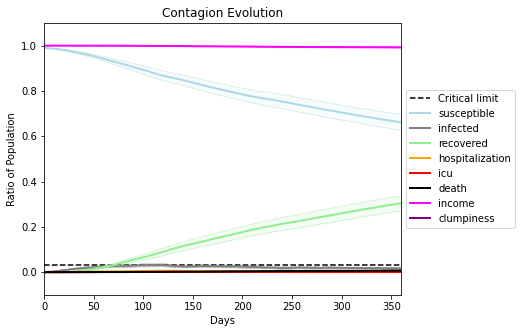

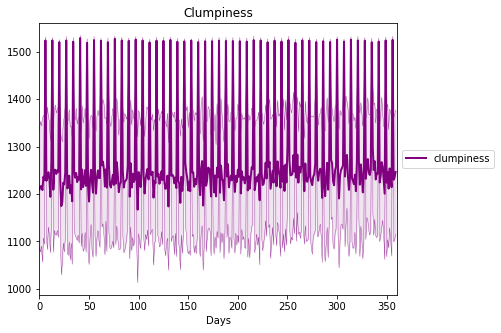

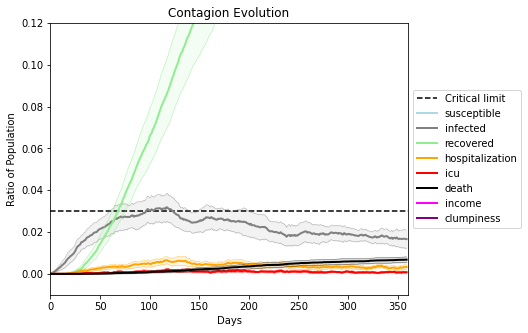

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3972, 9018, 367, 3439, 35, 1399, 9575, 5720, 7437, 9893, 1685, 5929, 9360, 311, 1265, 2544, 1046, 2388, 3662, 6699]
Average similarity between family members is 0.9565159669308585 at temperature -0.997
Average similarity between family and home is 0.999851335974244 at temperature -1
Average similarity between students and their classroom is 0.9272819898711775 at temperature -0.997
Average classroom occupancy is 1.680473372781065 and number classrooms is 169
Average similarity between workers is 0.921590484079287 at temperature -0.997
Average office occupancy is 3.417525773195876 and number offices is 194
Average friend similarity for adults: 0.8617040267244335 for kids: 0.7380895981220661
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.5283367967483656
avg restaurant similarity 0.40910734933705206
avg restaurant similarity 0.5713489582510152
avg restaurant similarity 0.48153571287247804
avg restaurant similarity 0.4788668618867033
avg restaurant similarity 0.6657068017742389
avg restaurant similarity 0.4535556894623387
avg restaurant similarity 0.5129566303373772
avg restaurant similarity 0.6065637596262247
avg restaurant similarity 0.5024904385663356
avg restaurant similarity 0.38931371664469494
avg restaurant similarity 0.5604942026009698
avg restaurant similarity 0.6888927599406338
avg restaurant similarity 0.8268278680619816
avg restaurant similarity 0.610100320468131
avg restaurant similarity 0.4965416003027845
avg restaurant similarity 0.5461359044813732
avg restaurant similarity 0.5369302609104343
avg restaurant similarity 0.3499530222764149
avg restaurant similarity 0.6232491790182189
avg restaurant similarity 0.5820991707938807
avg restaurant similarity 0.47951639892448356
avg res

avg restaurant similarity 0.4240378513932265
avg restaurant similarity 0.4698315029774753
avg restaurant similarity 0.37322318845106794
avg restaurant similarity 0.33649064228648395
avg restaurant similarity 0.43980080033291963
avg restaurant similarity 0.3887703496265859
avg restaurant similarity 0.65174667341191
avg restaurant similarity 0.5160949336102716
avg restaurant similarity 0.5091519826157916
avg restaurant similarity 0.5854184235997721
avg restaurant similarity 0.44300008296461446
avg restaurant similarity 0.676933584703672
avg restaurant similarity 0.5671602904026285
avg restaurant similarity 0.5105138788734028
avg restaurant similarity 0.26075555440803533
avg restaurant similarity 0.39260858099810836
avg restaurant similarity 0.5554856109713442
avg restaurant similarity 0.4379660916283526
avg restaurant similarity 0.6626989208941996
avg restaurant similarity 0.6382054208053666
avg restaurant similarity 0.5884170813438843
avg restaurant similarity 0.7003318875573896
avg res

Average similarity between workers is 0.9424198869138231 at temperature -0.997
Average office occupancy is 3.364102564102564 and number offices is 195
Average friend similarity for adults: 0.8615039576475194 for kids: 0.7460581981190885
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.6286368624779772
avg restaurant similarity 0.7077089604049485
avg restaurant similarity 0.7388157115058493
avg restaurant similarity 0.8306863705836282
avg restaurant similarity 0.7369381459082796
avg restaurant similarity 0.6755728880984896
avg restaurant similarity 0.7435554071141064
avg restaurant similarity 0.8493961512072209
avg restaurant similarity 0.6520998571404769
avg restaurant similarity 0.6491722773025241
avg restaurant similarity 0.5519205735609184
avg restaurant similarity 0.6372394533499527
avg restaurant similarity 0.6683453415096084
avg restaurant similarity 0.6598418322648347
avg restaurant similarity 0.5669992200224117
avg restaurant similarity 0.6128958524079289
avg restaurant similarity 0.5379492894151889
avg restaurant similarity 0.5877488385491851
avg restaurant similarity 0.7310548216753469
avg restaurant similarity 0.5678308527971677
avg restaurant similarity 0.6530027616523331
avg restaurant similarity 0.7992335392933377
avg restau

avg restaurant similarity 0.6803689968548605
avg restaurant similarity 0.7661149024373061
avg restaurant similarity 0.6814986031724902
avg restaurant similarity 0.6210783569941106
avg restaurant similarity 0.5300272929732455
avg restaurant similarity 0.6491498228041561
avg restaurant similarity 0.6619009800958399
avg restaurant similarity 0.6305443684865261
avg restaurant similarity 0.5399955737152146
avg restaurant similarity 0.6885917061028836
avg restaurant similarity 0.7920289480588933
avg restaurant similarity 0.8318116806636688
avg restaurant similarity 0.6975942413223308
avg restaurant similarity 0.6583113798035227
avg restaurant similarity 0.6782832432170863
avg restaurant similarity 0.6124329958018547
avg restaurant similarity 0.8612242149806564
avg restaurant similarity 0.6704875223041511
avg restaurant similarity 0.5604430858527419
avg restaurant similarity 0.8188585859530523
avg restaurant similarity 0.9027838177833575
avg restaurant similarity 0.597846251238338
avg restaur

Average friend similarity for adults: 0.8490432986443421 for kids: 0.7379404243455596
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.6266197305047013
avg restaurant similarity 0.7740331443311967
avg restaurant similarity 0.7276897414852624
avg restaurant similarity 0.5946463262476236
avg restaurant similarity 0.6218548222187645
avg restaurant similarity 0.6155576383385254
avg restaurant similarity 0.6719485312519554
avg restaurant similarity 0.524568753906298
avg restaurant similarity 0.6177712775075855
avg restaurant similarity 0.5388965797365644
avg restaurant similarity 0.6477613176861374
avg restaurant similarity 0.5781664560514429
avg restaurant similarity 0.6485330551314423
avg restaurant similarity 0.7239604803196301
avg restaurant similarity 0.6797585482683257
avg restaurant similarity 0.47758879939692156
avg restaurant similarity 0.6814992981263513
avg restaurant similarity 0.6633154706424608
avg restaurant similarity 0.6067405219704878
avg restaurant similarity 0.6469532880443769
avg restaurant similarity 0.5068074319802108
avg restaurant similarity 0.6355173929426058
avg restau

avg restaurant similarity 0.6861733032936941
avg restaurant similarity 0.5712614608586315
avg restaurant similarity 0.584327700838342
avg restaurant similarity 0.761098103041031
avg restaurant similarity 0.49534782975596275
avg restaurant similarity 0.733492500183292
avg restaurant similarity 0.5842698035679921
avg restaurant similarity 0.5929249896713369
avg restaurant similarity 0.7018753121296566
avg restaurant similarity 0.6761294290537901
avg restaurant similarity 0.44643830163416937
avg restaurant similarity 0.5945405132479367
avg restaurant similarity 0.7979831434632001
avg restaurant similarity 0.685463642019159
avg restaurant similarity 0.6399926048821281
avg restaurant similarity 0.42613156912176187
avg restaurant similarity 0.650639824959018
avg restaurant similarity 0.6294647804606397
avg restaurant similarity 0.7170439849036789
avg restaurant similarity 0.7001584076185398
avg restaurant similarity 0.4683423677925846
avg restaurant similarity 0.6953388413721396
avg restaura

Average similarity between workers is 0.929434908845927 at temperature -0.997
Average office occupancy is 3.5555555555555554 and number offices is 189
Average friend similarity for adults: 0.8637996899955124 for kids: 0.73006751810326
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.702921439348653
avg restaurant similarity 0.703072938266446
avg restaurant similarity 0.46429133597858474
avg restaurant similarity 0.5206747393174088
avg restaurant similarity 0.5501456521925686
avg restaurant similarity 0.7026917295706939
avg restaurant similarity 0.612605742138804
avg restaurant similarity 0.5635037470404224
avg restaurant similarity 0.4916285492420431
avg restaurant similarity 0.35058658211973914
avg restaurant similarity 0.4894335751005814
avg restaurant similarity 0.5901251006330346
avg restaurant similarity 0.4129398887296074
avg restaurant similarity 0.4959600207439167
avg restaurant similarity 0.6164088548225962
avg restaurant similarity 0.529212599995696
avg restaurant similarity 0.6194161750981272
avg restaurant similarity 0.4871181356415947
avg restaurant similarity 0.744424699611434
avg restaurant similarity 0.5375733552023265
avg restaurant similarity 0.46180436080376597
avg restaurant similarity 0.644883108956024
avg restauran

avg restaurant similarity 0.5377260580595745
avg restaurant similarity 0.4900586602281565
avg restaurant similarity 0.5581616948530155
avg restaurant similarity 0.9136207846303566
avg restaurant similarity 0.6054340321743177
avg restaurant similarity 0.5804897183868891
avg restaurant similarity 0.6313089084808252
avg restaurant similarity 0.6634094710540518
avg restaurant similarity 0.6855164866630998
avg restaurant similarity 0.6745116977695809
avg restaurant similarity 0.8156070955348849
avg restaurant similarity 0.7138438028771037
avg restaurant similarity 0.6800540341631492
avg restaurant similarity 0.3717307106107626
avg restaurant similarity 0.529448095991153
avg restaurant similarity 0.6596373298943669
avg restaurant similarity 0.463198461013635
avg restaurant similarity 0.5628883825260437
avg restaurant similarity 0.5397841379038194
avg restaurant similarity 0.6535877456030665
avg restaurant similarity 0.5136397578188148
avg restaurant similarity 0.6798860959087685
avg restaura

Average friend similarity for adults: 0.8479083863878191 for kids: 0.7383029010522962
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.4330095683320733
avg restaurant similarity 0.6887537453778088
avg restaurant similarity 0.6506554695792439
avg restaurant similarity 0.6664742511414592
avg restaurant similarity 0.649608321864464
avg restaurant similarity 0.57405887340373
avg restaurant similarity 0.515278683502069
avg restaurant similarity 0.5653320902020953
avg restaurant similarity 0.8043235948168393
avg restaurant similarity 0.6931956141784477
avg restaurant similarity 0.6866991031149807
avg restaurant similarity 0.6654149462314706
avg restaurant similarity 0.6604600058119728
avg restaurant similarity 0.6702311838739441
avg restaurant similarity 0.7139390106354961
avg restaurant similarity 0.866284021712627
avg restaurant similarity 0.7226639310554698
avg restaurant similarity 0.6236568947178761
avg restaurant similarity 0.6952086967418677
avg restaurant similarity 0.8252723799587501
avg restaurant similarity 0.6851668592531656
avg restaurant similarity 0.7431862387393122
avg restaurant 

avg restaurant similarity 0.5456984684962614
avg restaurant similarity 0.5822303492482346
avg restaurant similarity 0.5714124799232649
avg restaurant similarity 0.8604706980641976
avg restaurant similarity 0.7755137738138298
avg restaurant similarity 0.5823090431111679
avg restaurant similarity 0.46566251020060967
avg restaurant similarity 0.570694611143298
avg restaurant similarity 0.43420712430229536
avg restaurant similarity 0.6557907385554527
avg restaurant similarity 0.6371708908388587
avg restaurant similarity 0.6182799285445745
avg restaurant similarity 0.6643490842615035
avg restaurant similarity 0.37267750863112514
avg restaurant similarity 0.6078485135422207
avg restaurant similarity 0.6154362431124126
avg restaurant similarity 0.9997575007319637
avg restaurant similarity 0.7265529787150643
avg restaurant similarity 0.5984503542206902
avg restaurant similarity 0.7209445902006244
avg restaurant similarity 0.720249754428087
avg restaurant similarity 0.6479309752794884
avg resta

avg restaurant similarity 0.6385713897222091
avg restaurant similarity 0.6528896961580993
avg restaurant similarity 0.7469387169698365
avg restaurant similarity 0.7236355236853331
avg restaurant similarity 0.5778255755004447
avg restaurant similarity 0.7153915415920525
avg restaurant similarity 0.6685634621648097
avg restaurant similarity 0.6921219367642045
avg restaurant similarity 0.7312283722148627
avg restaurant similarity 0.7123246811863825
avg restaurant similarity 0.5952713466944483
avg restaurant similarity 0.4919642643249213
avg restaurant similarity 0.598955063542955
avg restaurant similarity 0.7111297241831509
avg restaurant similarity 0.7158513840527908
avg restaurant similarity 0.5559967329425662
avg restaurant similarity 0.6365428037664187
avg restaurant similarity 0.6923955021046113
avg restaurant similarity 0.5761317536914833
avg restaurant similarity 0.6205333215286392
avg restaurant similarity 0.4573598224181243
avg restaurant similarity 0.47363236388732716
avg restau

avg restaurant similarity 0.6566005230810504
avg restaurant similarity 0.6915299093565666
avg restaurant similarity 0.5224601898006705
avg restaurant similarity 0.6928128975626587
avg restaurant similarity 0.5804572411399163
avg restaurant similarity 0.9998353185257438
avg restaurant similarity 0.5476556679799929
avg restaurant similarity 0.4868251049692285
avg restaurant similarity 0.7092025332310304
avg restaurant similarity 0.6621918923752194
avg restaurant similarity 0.6202881451753399
avg restaurant similarity 0.7554243131106887
avg restaurant similarity 0.5523817874507482
avg restaurant similarity 0.48593643078665394
avg restaurant similarity 0.6605479007245942
avg restaurant similarity 0.5288837284112586
avg restaurant similarity 0.6198080763196688
avg restaurant similarity 0.7264528111082974
avg restaurant similarity 0.5777745621303639
avg restaurant similarity 0.5850131390286778
avg restaurant similarity 0.8351310991022098
avg restaurant similarity 0.9995866414126614
avg resta

Average similarity between workers is 0.9282755985487765 at temperature -0.997
Average office occupancy is 3.4322916666666665 and number offices is 192
Average friend similarity for adults: 0.8595764404884374 for kids: 0.7419435531892341
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.5909620685978701
avg restaurant similarity 0.4077619339880778
avg restaurant similarity 0.5198629355152143
avg restaurant similarity 0.4583545900169871
avg restaurant similarity 0.42994108680776016
avg restaurant similarity 0.8012098602395819
avg restaurant similarity 0.6844094559477232
avg restaurant similarity 0.6251833479041128
avg restaurant similarity 0.7926440878198184
avg restaurant similarity 0.5971199109721671
avg restaurant similarity 0.6741627357973015
avg restaurant similarity 0.6317973297830753
avg restaurant similarity 0.6887429468468299
avg restaurant similarity 0.7830189617844421
avg restaurant similarity 0.45032723118460505
avg restaurant similarity 0.48432362566990866
avg restaurant similarity 0.6543761900503499
avg restaurant similarity 0.5824445733854311
avg restaurant similarity 0.5948457055296745
avg restaurant similarity 0.6269520161848499
avg restaurant similarity 0.6651167894454098
avg restaurant similarity 0.6170507133544474
avg res

avg restaurant similarity 0.4491387024597112
avg restaurant similarity 0.5222702998024984
avg restaurant similarity 0.6525428235434996
avg restaurant similarity 0.6090414518825772
avg restaurant similarity 0.4802674816122023
avg restaurant similarity 0.40733929419046244
avg restaurant similarity 0.6481694937579862
avg restaurant similarity 0.6483693503028729
avg restaurant similarity 0.7301231616706969
avg restaurant similarity 0.6494758290347641
avg restaurant similarity 0.7993584644189546
avg restaurant similarity 0.700265020647874
avg restaurant similarity 0.5786457813401816
avg restaurant similarity 0.619426675866531
avg restaurant similarity 0.6408949924532259
avg restaurant similarity 0.6292979005470221
avg restaurant similarity 0.7146972522252105
avg restaurant similarity 0.6290014680146826
avg restaurant similarity 0.6586694904488464
avg restaurant similarity 0.5791929286011558
avg restaurant similarity 0.42130442808722246
avg restaurant similarity 0.4723799616503855
avg restau

Average similarity between workers is 0.9235711847618375 at temperature -0.997
Average office occupancy is 3.435233160621762 and number offices is 193
Average friend similarity for adults: 0.8576989648065885 for kids: 0.7195883285065889
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.509028987430317
avg restaurant similarity 0.5548741207069976
avg restaurant similarity 0.6509434263233974
avg restaurant similarity 0.4385305725527718
avg restaurant similarity 0.5302302129474095
avg restaurant similarity 0.6544549757354752
avg restaurant similarity 0.3883556955449894
avg restaurant similarity 0.48283021742714527
avg restaurant similarity 0.23888016595302838
avg restaurant similarity 0.5957657723712778
avg restaurant similarity 0.611572501543875
avg restaurant similarity 0.5781958794799893
avg restaurant similarity 0.5868077207488217
avg restaurant similarity 0.41224004885383414
avg restaurant similarity 0.6172596117460422
avg restaurant similarity 0.5982481128898602
avg restaurant similarity 0.37402367682823445
avg restaurant similarity 0.5067577151549301
avg restaurant similarity 0.6463873415229887
avg restaurant similarity 0.5024426756076971
avg restaurant similarity 0.54475440772792
avg restaurant similarity 0.5254169786941771
avg restau

avg restaurant similarity 0.4754246675996649
avg restaurant similarity 0.5531023864254693
avg restaurant similarity 0.9583811462425903
avg restaurant similarity 0.5969348710776033
avg restaurant similarity 0.5235839218427569
avg restaurant similarity 0.5494564037479728
avg restaurant similarity 0.7992507000570066
avg restaurant similarity 0.6213302652506826
avg restaurant similarity 0.512185597014535
avg restaurant similarity 0.5351015746897123
avg restaurant similarity 0.5796897113472257
avg restaurant similarity 0.528425029423572
avg restaurant similarity 0.5105565340507252
avg restaurant similarity 0.4559548027890238
avg restaurant similarity 0.6954910613881928
avg restaurant similarity 0.5443852128635497
avg restaurant similarity 0.4663108593134686
avg restaurant similarity 0.7537244570271089
avg restaurant similarity 0.5680919112257226
avg restaurant similarity 0.56745450479995
avg restaurant similarity 0.5857610904995045
avg restaurant similarity 0.8063293305100114
avg restaurant

avg restaurant similarity 0.5875458504979321
avg restaurant similarity 0.5618985913929646
avg restaurant similarity 0.6285940074515772
avg restaurant similarity 0.6233926673672138
avg restaurant similarity 0.7268218802368798
avg restaurant similarity 0.5601056459306705
avg restaurant similarity 0.5987248756987897
avg restaurant similarity 0.608956057001245
avg restaurant similarity 0.7061805730459427
avg restaurant similarity 0.6342297687409029
avg restaurant similarity 0.6761932952483394
avg restaurant similarity 0.5696583103938161
avg restaurant similarity 0.6337248909594928
avg restaurant similarity 0.3664971416796385
avg restaurant similarity 0.6968686185706513
avg restaurant similarity 0.5099622688989341
avg restaurant similarity 0.5990079043071603
avg restaurant similarity 0.5624054125138309
avg restaurant similarity 0.6010059199676336
avg restaurant similarity 0.6392782680879376
avg restaurant similarity 0.6463427929901872
avg restaurant similarity 0.7450611946676143
avg restaur

avg restaurant similarity 0.6259534715217241
avg restaurant similarity 0.7597444559850439
avg restaurant similarity 0.5897937817549009
avg restaurant similarity 0.5359338219089838
avg restaurant similarity 0.5776042017878998
avg restaurant similarity 0.6924586488154425
avg restaurant similarity 0.6417796391602443
avg restaurant similarity 0.4940816758362681
avg restaurant similarity 0.6708513547070758
avg restaurant similarity 0.6380165340164318
avg restaurant similarity 0.647278174771586
avg restaurant similarity 0.6066431660298325
avg restaurant similarity 0.3582287569955583
avg restaurant similarity 0.5984546141624437
avg restaurant similarity 0.39016824854860493
avg restaurant similarity 0.6462313658472536
avg restaurant similarity 0.5424637496879495
avg restaurant similarity 0.6168204409207341
avg restaurant similarity 0.601127891265775
avg restaurant similarity 0.5885212561350003
avg restaurant similarity 0.5216383356551191
avg restaurant similarity 0.6430699654166732
avg restaur

Average friend similarity for adults: 0.85746044355715 for kids: 0.7173223567875623
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.5461077099095835
avg restaurant similarity 0.5283973130787787
avg restaurant similarity 0.5903556438843361
avg restaurant similarity 0.6645949587800497
avg restaurant similarity 0.6470790791436069
avg restaurant similarity 0.5942732805885481
avg restaurant similarity 0.5202592326798124
avg restaurant similarity 0.6798513764605854
avg restaurant similarity 0.4234407392220234
avg restaurant similarity 0.47086227309149614
avg restaurant similarity 0.5402183099202691
avg restaurant similarity 0.5445676671231512
avg restaurant similarity 0.718972839159065
avg restaurant similarity 0.7621420047322828
avg restaurant similarity 0.6932819340497726
avg restaurant similarity 0.5115155093199767
avg restaurant similarity 0.5209984966883171
avg restaurant similarity 0.7112708622393479
avg restaurant similarity 0.6493940858175903
avg restaurant similarity 0.45381388025409114
avg restaurant similarity 0.6242113971815264
avg restaurant similarity 0.5177709144770907
avg resta

avg restaurant similarity 0.7918154641085541
avg restaurant similarity 0.6551141422149456
avg restaurant similarity 0.6230557791227992
avg restaurant similarity 0.6239160436259711
avg restaurant similarity 0.5519843936633712
avg restaurant similarity 0.7089903753618076
avg restaurant similarity 0.8164301723080264
avg restaurant similarity 0.7018576718426074
avg restaurant similarity 0.7289612722969306
avg restaurant similarity 0.7603741617832497
avg restaurant similarity 0.7247498359047605
avg restaurant similarity 0.5734104248438798
avg restaurant similarity 0.716465696534759
avg restaurant similarity 0.8837344641063692
avg restaurant similarity 0.6121820299098817
avg restaurant similarity 0.6268118376680509
avg restaurant similarity 0.6144248057972417
avg restaurant similarity 0.6543736567221846
avg restaurant similarity 0.5535319573822883
avg restaurant similarity 0.49666362943433456
avg restaurant similarity 0.7498022893846155
avg restaurant similarity 0.7097323096742797
avg restau

Average similarity between workers is 0.9276767864455167 at temperature -0.997
Average office occupancy is 3.596685082872928 and number offices is 181
Average friend similarity for adults: 0.849665742802452 for kids: 0.7268841701353941
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.6400117975746841
avg restaurant similarity 0.5565639152922919
avg restaurant similarity 0.6546169249869256
avg restaurant similarity 0.602820626582027
avg restaurant similarity 0.545945857263875
avg restaurant similarity 0.7387261511573956
avg restaurant similarity 0.4282532176380529
avg restaurant similarity 0.5787925088789212
avg restaurant similarity 0.7206292997622854
avg restaurant similarity 0.6697910220161388
avg restaurant similarity 0.522871950177727
avg restaurant similarity 0.5585154077649018
avg restaurant similarity 0.656628590579888
avg restaurant similarity 0.6187998825920288
avg restaurant similarity 0.5900065429443366
avg restaurant similarity 0.7639417593912717
avg restaurant similarity 0.5938299080707012
avg restaurant similarity 0.625212149333691
avg restaurant similarity 0.57950987973368
avg restaurant similarity 0.576339382872453
avg restaurant similarity 0.6562086729413962
avg restaurant similarity 0.5875620027867332
avg restaurant sim

avg restaurant similarity 0.5731187401600546
avg restaurant similarity 0.6900319923673187
avg restaurant similarity 0.3699254663894679
avg restaurant similarity 0.6641873087479828
avg restaurant similarity 0.7768050652379329
avg restaurant similarity 0.6916683633468197
avg restaurant similarity 0.9997224754262992
avg restaurant similarity 0.5805243805581289
avg restaurant similarity 0.5947320440447238
avg restaurant similarity 0.4727191180802969
avg restaurant similarity 0.5869474041572575
avg restaurant similarity 0.4942491349952454
avg restaurant similarity 0.6755420902882232
avg restaurant similarity 0.5401347280004136
avg restaurant similarity 0.6429145484065063
avg restaurant similarity 0.7326768759579027
avg restaurant similarity 0.5879459233574735
avg restaurant similarity 0.6971220597479671
avg restaurant similarity 0.6542587164064934
avg restaurant similarity 0.6636200505151245
avg restaurant similarity 0.673332068078259
avg restaurant similarity 0.573607294391634
avg restaura

avg restaurant similarity 0.5339437261371344
avg restaurant similarity 0.5988954919449149
avg restaurant similarity 0.4712185618429345
avg restaurant similarity 0.6788502201439682
avg restaurant similarity 0.5265090555836389
avg restaurant similarity 0.6017657741164758
avg restaurant similarity 0.5951627962695176
avg restaurant similarity 0.6707817955931096
avg restaurant similarity 0.43334099880639143
avg restaurant similarity 0.7042145501208523
avg restaurant similarity 0.6416434684118029
avg restaurant similarity 0.771364088073234
avg restaurant similarity 0.4705719054539983
avg restaurant similarity 0.5873161727582089
avg restaurant similarity 0.6839773449565695
avg restaurant similarity 0.4411541723999022
avg restaurant similarity 0.6595063546866865
avg restaurant similarity 0.7986981000228015
avg restaurant similarity 0.5169428168981757
avg restaurant similarity 0.5959126820182419
avg restaurant similarity 0.6852552387740001
avg restaurant similarity 0.6499255791754641
avg restau

avg restaurant similarity 0.5870656730723807
avg restaurant similarity 0.5918264288348248
avg restaurant similarity 0.5979864809900066
avg restaurant similarity 0.5083311074785539
avg restaurant similarity 0.5530503748710883
avg restaurant similarity 0.6758092132577553
avg restaurant similarity 0.5275715433725517
avg restaurant similarity 0.5268964908771576
avg restaurant similarity 0.5758835518480612
avg restaurant similarity 0.6922460054248774
avg restaurant similarity 0.5952955431160508
avg restaurant similarity 0.5479919303750262
avg restaurant similarity 0.6643678492887851
avg restaurant similarity 0.6203997730595833
avg restaurant similarity 0.5869016264285053
avg restaurant similarity 0.47420100702036566
avg restaurant similarity 0.5676620822603429
avg restaurant similarity 0.5916736651484295
avg restaurant similarity 0.5480208948461254
avg restaurant similarity 0.5938816904406414
avg restaurant similarity 0.7610201687951427
avg restaurant similarity 0.5912781811760057
avg resta

avg restaurant similarity 0.42711242733809834
avg restaurant similarity 0.5313019091818887
avg restaurant similarity 0.5981042782945093
avg restaurant similarity 0.7120337145029147
avg restaurant similarity 0.6418899769532618
avg restaurant similarity 0.5304853306134351
avg restaurant similarity 0.592491445568119
avg restaurant similarity 0.4562008984110101
avg restaurant similarity 0.47488251385635527
avg restaurant similarity 0.5238212827878989
avg restaurant similarity 0.5063691962514524
avg restaurant similarity 0.5230299439628529
avg restaurant similarity 0.5466621528974993
avg restaurant similarity 0.4895382206470257
avg restaurant similarity 0.5090168796646636
avg restaurant similarity 0.49102292287740246
avg restaurant similarity 0.5875508346819678
avg restaurant similarity 0.5352925684185357
avg restaurant similarity 0.4869976003347597
avg restaurant similarity 0.7022265960382191
avg restaurant similarity 0.5777137425841619
avg restaurant similarity 0.6293601244826579
avg rest

avg restaurant similarity 0.47139830536385363
avg restaurant similarity 0.44413581604216584
avg restaurant similarity 0.39914317095646706
avg restaurant similarity 0.4850227868283006
avg restaurant similarity 0.5007883069772503
avg restaurant similarity 0.4377090531600434
avg restaurant similarity 0.42913035497854707
avg restaurant similarity 0.6532918822782533
avg restaurant similarity 0.45013129087086534
avg restaurant similarity 0.44612145448625046
avg restaurant similarity 0.5693814291922066
avg restaurant similarity 0.2726359915644548
avg restaurant similarity 0.6161107151049824
avg restaurant similarity 0.5527719854783478
avg restaurant similarity 0.5162079921877044
avg restaurant similarity 0.4870248319575114
avg restaurant similarity 0.3736806568826611
avg restaurant similarity 0.36303850471972865
avg restaurant similarity 0.5458971420453363
avg restaurant similarity 0.46581005072059173
avg restaurant similarity 0.4889839019723974
avg restaurant similarity 0.8300966514017002
av

Average similarity between workers is 0.9287412548122923 at temperature -0.997
Average office occupancy is 3.3556701030927836 and number offices is 194
Average friend similarity for adults: 0.8549181299247252 for kids: 0.7470987363955358
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6507976200676983
avg restaurant similarity 0.6384072692166094
avg restaurant similarity 0.6815927084668788
avg restaurant similarity 0.5084719774226977
avg restaurant similarity 0.6561704453625032
avg restaurant similarity 0.7204290434868242
avg restaurant similarity 0.5998382236507148
avg restaurant similarity 0.4813114180092037
avg restaurant similarity 0.6338587584266318
avg restaurant similarity 0.7536642423394198
avg restaurant similarity 0.5686346311407073
avg restaurant similarity 0.47231026932175724
avg restaurant similarity 0.5880019872237564
avg restaurant similarity 0.5105337143966178
avg restaurant similarity 0.5680292537343172
avg restaurant similarity 0.6423836826207725
avg restaurant similarity 0.661272096131018
avg restaurant similarity 0.7499129756030782
avg restaurant similarity 0.5122385078924377
avg restaurant similarity 0.6295319973115313
avg restaurant similarity 0.45769172165181243
avg restaurant similarity 0.48912064954682705
avg rest

avg restaurant similarity 0.5155305720365511
avg restaurant similarity 0.5263714941501568
avg restaurant similarity 0.6675843416341289
avg restaurant similarity 0.46499628045030467
avg restaurant similarity 0.5359258837336286
avg restaurant similarity 0.6259878321874588
avg restaurant similarity 0.7123932825367858
avg restaurant similarity 0.6184181809531153
avg restaurant similarity 0.4739615799046187
avg restaurant similarity 0.7460790954481151
avg restaurant similarity 0.6595465890498191
avg restaurant similarity 0.6249274492164046
avg restaurant similarity 0.6628316002836224
avg restaurant similarity 0.52286896003836
avg restaurant similarity 0.5945801846682848
avg restaurant similarity 0.44382774413448833
avg restaurant similarity 0.6521603811320376
avg restaurant similarity 0.5528628732592152
avg restaurant similarity 0.565398386583831
avg restaurant similarity 0.5642999387052406
avg restaurant similarity 0.5536208379059773
avg restaurant similarity 0.6487033023437834
avg restaur

Average similarity between workers is 0.9342201562283523 at temperature -0.997
Average office occupancy is 3.4947368421052634 and number offices is 190
Average friend similarity for adults: 0.8522417441710518 for kids: 0.726876685193143
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.4964566938978528
avg restaurant similarity 0.5684540847377005
avg restaurant similarity 0.5391389790280742
avg restaurant similarity 0.49321479307404753
avg restaurant similarity 0.5911864695832708
avg restaurant similarity 0.525311821481952
avg restaurant similarity 0.5420927852255395
avg restaurant similarity 0.6957286883009364
avg restaurant similarity 0.5697514769047813
avg restaurant similarity 0.6782730216697723
avg restaurant similarity 0.5075524408790986
avg restaurant similarity 0.5173754389779796
avg restaurant similarity 0.705698715918447
avg restaurant similarity 0.6058700065607733
avg restaurant similarity 0.687078305815148
avg restaurant similarity 0.6411391493080824
avg restaurant similarity 0.5553896434545857
avg restaurant similarity 0.5342280599839401
avg restaurant similarity 0.6995559513439026
avg restaurant similarity 0.6377124537503225
avg restaurant similarity 0.6183553269319088
avg restaurant similarity 0.5834887081047916
avg restaura

avg restaurant similarity 0.6002043375541342
avg restaurant similarity 0.5497185057662658
avg restaurant similarity 0.5735215555451708
avg restaurant similarity 0.4955638978154349
avg restaurant similarity 0.5827358616539399
avg restaurant similarity 0.4190552629670361
avg restaurant similarity 0.5950742514232126
avg restaurant similarity 0.5462542346168013
avg restaurant similarity 0.4149121711908733
avg restaurant similarity 0.7634226798877973
avg restaurant similarity 0.44647949664341724
avg restaurant similarity 0.6506908139966208
avg restaurant similarity 0.5535586978101121
avg restaurant similarity 0.6223396133472059
avg restaurant similarity 0.34441586200755736
avg restaurant similarity 0.5156076795976315
avg restaurant similarity 0.5828897793002633
avg restaurant similarity 0.5115705891416362
avg restaurant similarity 0.5914297813009229
avg restaurant similarity 0.5610917756051355
avg restaurant similarity 0.5856429792696759
avg restaurant similarity 0.6172705048259776
avg rest

Average similarity between workers is 0.9208210222085521 at temperature -0.997
Average office occupancy is 3.375 and number offices is 192
Average friend similarity for adults: 0.8529819492008166 for kids: 0.7365386892175281
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people alloc

avg restaurant similarity 0.4249244376938666
avg restaurant similarity 0.45015425947780724
avg restaurant similarity 0.5545454652799429
avg restaurant similarity 0.6920686446942449
avg restaurant similarity 0.5550964246604705
avg restaurant similarity 0.6357660594534408
avg restaurant similarity 0.5484443670925361
avg restaurant similarity 0.5790758295051653
avg restaurant similarity 0.5589287989373463
avg restaurant similarity 0.5705481074686852
avg restaurant similarity 0.8481496774483498
avg restaurant similarity 0.44219514570209795
avg restaurant similarity 0.6924689708771642
avg restaurant similarity 0.6763818701917116
avg restaurant similarity 0.5967958424669646
avg restaurant similarity 0.702731310523686
avg restaurant similarity 0.4648246475810957
avg restaurant similarity 0.4378103374701056
avg restaurant similarity 0.43199608280608
avg restaurant similarity 0.6523051584100493
avg restaurant similarity 0.7268257419567971
avg restaurant similarity 0.647991991625029
avg restaura

avg restaurant similarity 0.33545387108584845
avg restaurant similarity 0.5660340022066812
avg restaurant similarity 0.7340638355498658
avg restaurant similarity 0.39453058185315176
avg restaurant similarity 0.6804938923940025
avg restaurant similarity 0.40999877721212385
avg restaurant similarity 0.8193720441375061
avg restaurant similarity 0.5963027190629535
avg restaurant similarity 0.46061449654012493
avg restaurant similarity 0.36484105330132793
avg restaurant similarity 0.45394335962735693
avg restaurant similarity 0.48748616088880353
avg restaurant similarity 0.7936698432340057
avg restaurant similarity 0.3900681225731733
avg restaurant similarity 0.4573174102836628
avg restaurant similarity 0.5119185782100244
avg restaurant similarity 0.6321208010977359
avg restaurant similarity 0.5246150551778865
avg restaurant similarity 0.48459018014817695
avg restaurant similarity 0.5310724954797351
avg restaurant similarity 0.47700179143000926
avg restaurant similarity 0.6035119751996946
a

avg restaurant similarity 0.6089268625873037
avg restaurant similarity 0.5414394106594483
avg restaurant similarity 0.7530369468956445
avg restaurant similarity 0.5553300235695326
avg restaurant similarity 0.7497739124732209
avg restaurant similarity 0.5694171034762767
avg restaurant similarity 0.766872510974917
avg restaurant similarity 0.5915643865612915
avg restaurant similarity 0.5190798327428522
avg restaurant similarity 0.6305238890376155
avg restaurant similarity 0.754876140549432
avg restaurant similarity 0.6876967815771036
avg restaurant similarity 0.6800964935411342
avg restaurant similarity 0.6816359001526461
avg restaurant similarity 0.6993671180468467
avg restaurant similarity 0.6417889816081997
avg restaurant similarity 0.5485105983201811
avg restaurant similarity 0.6704760671743799
avg restaurant similarity 0.5703406199585558
avg restaurant similarity 0.49583212720393366
avg restaurant similarity 0.4573463941792874
avg restaurant similarity 0.672266038684192
avg restaura

avg restaurant similarity 0.38822092316042256
avg restaurant similarity 0.4495233672813709
avg restaurant similarity 0.7130251627540543
avg restaurant similarity 0.41992756278081206
avg restaurant similarity 0.5991271527695798
avg restaurant similarity 0.5137744817194176
avg restaurant similarity 0.531433428039224
avg restaurant similarity 0.7850774909127325
avg restaurant similarity 0.5850143004331414
avg restaurant similarity 0.61826511493957
avg restaurant similarity 0.9998323542722438
avg restaurant similarity 0.4792755429753791
avg restaurant similarity 0.6592024332121973
avg restaurant similarity 0.6691686681582597
avg restaurant similarity 0.6439235592896514
avg restaurant similarity 0.6632063836165653
avg restaurant similarity 0.6600569600146031
avg restaurant similarity 0.48950166576425974
avg restaurant similarity 0.6798957557158135
avg restaurant similarity 0.540108345726824
avg restaurant similarity 0.6124829462737825
avg restaurant similarity 0.8374011213099599
avg restaur

avg restaurant similarity 0.6767336174560494
avg restaurant similarity 0.73216976930558
avg restaurant similarity 0.6025323554176351
avg restaurant similarity 0.6546321535562208
avg restaurant similarity 0.6399351673621909
avg restaurant similarity 0.49131050751192684
avg restaurant similarity 0.6453745875174431
avg restaurant similarity 0.5461595777487895
avg restaurant similarity 0.6360242678576669
avg restaurant similarity 0.597451593961386
avg restaurant similarity 0.6146035554207565
avg restaurant similarity 0.7386264224570538
avg restaurant similarity 0.5421963125464326
avg restaurant similarity 0.545920828548522
avg restaurant similarity 0.733094356130497
avg restaurant similarity 0.819879484922998
avg restaurant similarity 0.6500611230764048
avg restaurant similarity 0.6890523780794496
avg restaurant similarity 0.5727396456537331
avg restaurant similarity 0.6511948676640202
avg restaurant similarity 0.5600086393612306
avg restaurant similarity 0.6626104072203584
avg restaurant 

avg restaurant similarity 0.787845782506206
avg restaurant similarity 0.7664138419132768
avg restaurant similarity 0.6093956507072065
avg restaurant similarity 0.5956891841926596
avg restaurant similarity 0.5860183916958891
avg restaurant similarity 0.7238004589198217
avg restaurant similarity 0.7720914165798208
avg restaurant similarity 0.6909165195492067
avg restaurant similarity 0.4781381741447739
avg restaurant similarity 0.4907278887629911
avg restaurant similarity 0.6310447300917841
avg restaurant similarity 0.6309207619191619
avg restaurant similarity 0.7903127055036565
avg restaurant similarity 0.7215920698938263
avg restaurant similarity 0.6505656930952569
avg restaurant similarity 0.8179469195882084
avg restaurant similarity 0.8095735137414843
avg restaurant similarity 0.5008077544671161
avg restaurant similarity 0.6182599756195931
avg restaurant similarity 0.5909451595201017
avg restaurant similarity 0.6713252769878734
avg restaurant similarity 0.6040876937267728
avg restaur

Average friend similarity for adults: 0.853149179763317 for kids: 0.7371735725697619
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 alloca

avg restaurant similarity 0.5397918737152904
avg restaurant similarity 0.4933838350661314
avg restaurant similarity 0.39161132180351066
avg restaurant similarity 0.5009332821494255
avg restaurant similarity 0.48808845923375566
avg restaurant similarity 0.7060604448110086
avg restaurant similarity 0.679259459512641
avg restaurant similarity 0.4699992350808869
avg restaurant similarity 0.530111672779359
avg restaurant similarity 0.5324957685999413
avg restaurant similarity 0.523361846262067
avg restaurant similarity 0.566690717737773
avg restaurant similarity 0.5544532171979158
avg restaurant similarity 0.715140560574018
avg restaurant similarity 0.7339291635070658
avg restaurant similarity 0.8812766763942024
avg restaurant similarity 0.6480271451102928
avg restaurant similarity 0.49942720564710785
avg restaurant similarity 0.6796117908345003
avg restaurant similarity 0.5977172123422282
avg restaurant similarity 0.6103191444588888
avg restaurant similarity 0.5632806576402615
avg restaura

avg restaurant similarity 0.5104154170723847
avg restaurant similarity 0.7993592896089282
avg restaurant similarity 0.6512022941857679
avg restaurant similarity 0.5518819631638162
avg restaurant similarity 0.5824208295450641
avg restaurant similarity 0.636968795973631
avg restaurant similarity 0.6870378220353277
avg restaurant similarity 0.5309159931414688
avg restaurant similarity 0.6069011777814447
avg restaurant similarity 0.37096395356254885
avg restaurant similarity 0.5545478787633289
avg restaurant similarity 0.7169772616999642
avg restaurant similarity 0.7610000141026818
avg restaurant similarity 0.6561455066233044
avg restaurant similarity 0.4424379207882573
avg restaurant similarity 0.42224727719369654
avg restaurant similarity 0.7562724513122461
avg restaurant similarity 0.4854719088738949
avg restaurant similarity 0.7056838321656911
avg restaurant similarity 0.5383658296413142
avg restaurant similarity 0.4854996925016212
avg restaurant similarity 0.5711247080038315
avg resta

avg restaurant similarity 0.5509566869060739
avg restaurant similarity 0.59090002557292
avg restaurant similarity 0.5955408135314396
avg restaurant similarity 0.6391249957894678
avg restaurant similarity 0.7070444028205615
avg restaurant similarity 0.8674673471632528
avg restaurant similarity 0.7803325223525738
avg restaurant similarity 0.6633751164665028
avg restaurant similarity 0.6192406640263288
avg restaurant similarity 0.6358999609224949
avg restaurant similarity 0.7421553570239282
avg restaurant similarity 0.6779923951108895
avg restaurant similarity 0.6560563788082358
avg restaurant similarity 0.6395706758107568
avg restaurant similarity 0.5720737853164776
avg restaurant similarity 0.6452112021451032
avg restaurant similarity 0.6333255952884843
avg restaurant similarity 0.7232212034212255
avg restaurant similarity 0.9505353847096584
avg restaurant similarity 0.5939333719222101
avg restaurant similarity 0.7702934302469646
avg restaurant similarity 0.6604515507698961
avg restaura

avg restaurant similarity 0.7060439845383494
avg restaurant similarity 0.5801012381237655
avg restaurant similarity 0.7058439722941947
avg restaurant similarity 0.5952791987696612
avg restaurant similarity 0.7775392454583405
avg restaurant similarity 0.5480052634131874
avg restaurant similarity 0.6860039906091276
avg restaurant similarity 0.689790954591165
avg restaurant similarity 0.4950722656867467
avg restaurant similarity 0.34028737133258136
avg restaurant similarity 0.5245243421627493
avg restaurant similarity 0.6835162787128343
avg restaurant similarity 0.7759842499191568
avg restaurant similarity 0.7433114261788991
avg restaurant similarity 0.5583425552263558
avg restaurant similarity 0.5260863820519567
avg restaurant similarity 0.9997806246355099
avg restaurant similarity 0.6140985122504781
avg restaurant similarity 0.5499052187147876
avg restaurant similarity 0.7840589217868457
avg restaurant similarity 0.7480451096225834
avg restaurant similarity 0.7214325020653894
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

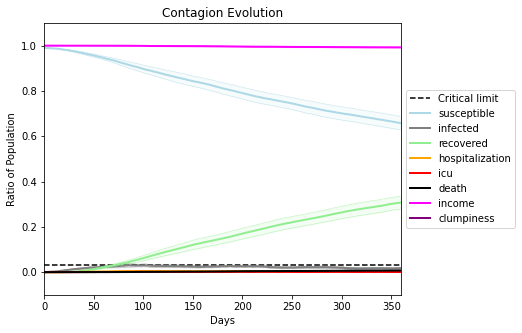

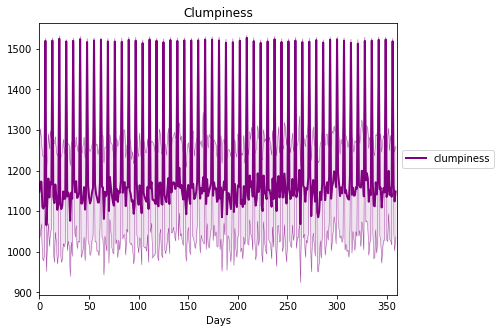

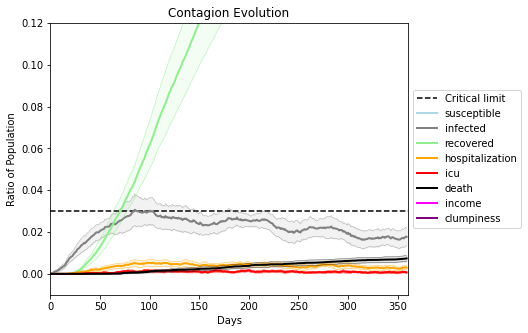

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[698, 9345, 6290, 8603, 2134, 9011, 782, 4361, 6944, 4909, 5237, 40, 6198, 1764, 7306, 2000, 1852, 6054, 3013, 7847]
Average similarity between family members is 0.9585057031140405 at temperature -0.996
Average similarity between family and home is 0.9998471375775367 at temperature -1
Average similarity between students and their classroom is 0.9218640995433085 at temperature -0.996
Average classroom occupancy is 1.6201117318435754 and number classrooms is 179
Average similarity between workers is 0.927796841077088 at temperature -0.996
Average office occupancy is 3.543010752688172 and number offices is 186
Average friend similarity for adults: 0.8487248444150461 for kids: 0.7396972374893739
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.6743298130387707
avg restaurant similarity 0.7358568562211071
avg restaurant similarity 0.4937145953771194
avg restaurant similarity 0.7829904251464023
avg restaurant similarity 0.5534128164347524
avg restaurant similarity 0.5935466255888102
avg restaurant similarity 0.6485834767797405
avg restaurant similarity 0.7389792878297481
avg restaurant similarity 0.7017323354991075
avg restaurant similarity 0.5216001923820999
avg restaurant similarity 0.7802263233253284
avg restaurant similarity 0.6419798724455619
avg restaurant similarity 0.6113854367660689
avg restaurant similarity 0.6128468423161709
avg restaurant similarity 0.5657502738751162
avg restaurant similarity 0.5787686096935701
avg restaurant similarity 0.7118845210538772
avg restaurant similarity 0.675329176477456
avg restaurant similarity 0.4753802851733301
avg restaurant similarity 0.8685604192304136
avg restaurant similarity 0.5435211049876792
avg restaurant similarity 0.9106072666723222
avg restaur

avg restaurant similarity 0.8307170028777509
avg restaurant similarity 0.681162266986789
avg restaurant similarity 0.6021322645171344
avg restaurant similarity 0.3125816683780306
avg restaurant similarity 0.7903386318756929
avg restaurant similarity 0.6454603202715348
avg restaurant similarity 0.6969043298207285
avg restaurant similarity 0.9518563015051398
avg restaurant similarity 0.8600969875760376
avg restaurant similarity 0.7281721028425433
avg restaurant similarity 0.6860083539741597
avg restaurant similarity 0.49595476220632073
avg restaurant similarity 0.8046217277573081
avg restaurant similarity 0.724923266171934
avg restaurant similarity 0.5806515603872906
avg restaurant similarity 0.6509293853141218
avg restaurant similarity 0.6373043720676027
avg restaurant similarity 0.5499609920831197
avg restaurant similarity 0.5970699732121597
avg restaurant similarity 0.7892554158337765
avg restaurant similarity 0.9997567151444269
avg restaurant similarity 0.7899575846184039
avg restaur

avg restaurant similarity 0.4976778980685535
avg restaurant similarity 0.6088033097208573
avg restaurant similarity 0.6326503771515345
avg restaurant similarity 0.5335927853837312
avg restaurant similarity 0.615139209977195
avg restaurant similarity 0.6328752840561871
avg restaurant similarity 0.45964997193786544
avg restaurant similarity 0.7124527443930321
avg restaurant similarity 0.6461718098559482
avg restaurant similarity 0.6429087563233288
avg restaurant similarity 0.6776501099183209
avg restaurant similarity 0.8639663361057688
avg restaurant similarity 0.5947718564700026
avg restaurant similarity 0.886387448404682
avg restaurant similarity 0.5411785970482981
avg restaurant similarity 0.7134119204816913
avg restaurant similarity 0.690476772237913
avg restaurant similarity 0.5681591342548741
avg restaurant similarity 0.5599967782981458
avg restaurant similarity 0.7610098021520353
avg restaurant similarity 0.6517809698068788
avg restaurant similarity 0.7001288749039999
avg restaura

avg restaurant similarity 0.9173609549263719
avg restaurant similarity 0.6885433185513312
avg restaurant similarity 0.6034814248987902
avg restaurant similarity 0.6480150158820158
avg restaurant similarity 0.6665183285468408
avg restaurant similarity 0.7136119068840223
avg restaurant similarity 0.5424009102930738
avg restaurant similarity 0.4318069312226954
avg restaurant similarity 0.5410903577803613
avg restaurant similarity 0.7770411522939575
avg restaurant similarity 0.8267903096597327
avg restaurant similarity 0.8396671967161604
avg restaurant similarity 0.4920051273385435
avg restaurant similarity 0.6912862478839142
avg restaurant similarity 0.6242706341082239
avg restaurant similarity 0.43758484492724414
avg restaurant similarity 0.6694214919902046
avg restaurant similarity 0.5021254873347206
avg restaurant similarity 0.6940786968450374
avg restaurant similarity 0.30159056345742763
avg restaurant similarity 0.6661602617204376
avg restaurant similarity 0.8424543676823816
avg rest

avg restaurant similarity 0.9996478775296029
avg restaurant similarity 0.6287129396362809
avg restaurant similarity 0.5697537218667974
avg restaurant similarity 0.5070115338593145
avg restaurant similarity 0.5293866528600677
avg restaurant similarity 0.7723591691620031
avg restaurant similarity 0.6876450085072179
avg restaurant similarity 0.7795364587323709
avg restaurant similarity 0.6861687675085575
avg restaurant similarity 0.6833829430331564
avg restaurant similarity 0.5917024438248757
avg restaurant similarity 0.5599576887493618
avg restaurant similarity 0.5725549302674054
avg restaurant similarity 0.5972942182127962
avg restaurant similarity 0.44068187525133373
avg restaurant similarity 0.6740721040321481
avg restaurant similarity 0.4013746885582889
avg restaurant similarity 0.6456064634444958
avg restaurant similarity 0.8238630137300577
avg restaurant similarity 0.6335406059259889
avg restaurant similarity 0.656481515292426
avg restaurant similarity 0.7932625963736731
avg restau

avg restaurant similarity 0.6205766009228785
avg restaurant similarity 0.6841205765955074
avg restaurant similarity 0.9997233866083023
avg restaurant similarity 0.3465479689719409
avg restaurant similarity 0.6619275158521213
avg restaurant similarity 0.688548951892402
avg restaurant similarity 0.6637878900005665
avg restaurant similarity 0.4976441402159327
avg restaurant similarity 0.5329866543300743
avg restaurant similarity 0.656481515292426
avg restaurant similarity 0.6552772939763987
avg restaurant similarity 0.5648857785914617
avg restaurant similarity 0.6866163642237404
avg restaurant similarity 0.5972970504922528
avg restaurant similarity 0.5091250228356051
avg restaurant similarity 0.656481515292426
avg restaurant similarity 0.5801709851119351
avg restaurant similarity 0.48030062835408877
avg restaurant similarity 0.6365128306482072
avg restaurant similarity 0.3148151881915006
avg restaurant similarity 0.6954850119382826
avg restaurant similarity 0.7140572131318146
avg restaura

avg restaurant similarity 0.5805220274018702
avg restaurant similarity 0.5178579261983222
avg restaurant similarity 0.6299203731026399
avg restaurant similarity 0.6548993570630133
avg restaurant similarity 0.414832437861504
avg restaurant similarity 0.509765748653502
avg restaurant similarity 0.6271338305935179
avg restaurant similarity 0.7022141443210859
avg restaurant similarity 0.6845209648800138
avg restaurant similarity 0.6589971362462107
avg restaurant similarity 0.7271134868516455
avg restaurant similarity 0.6141934699819056
avg restaurant similarity 0.5505900684625026
avg restaurant similarity 0.7536385617686664
avg restaurant similarity 0.7957192865261202
avg restaurant similarity 0.7028589992292436
avg restaurant similarity 0.622424145705667
avg restaurant similarity 0.6234229493955808
avg restaurant similarity 0.60094389836577
avg restaurant similarity 0.6076245925207272
avg restaurant similarity 0.7135056589850121
avg restaurant similarity 0.5173862510875497
avg restaurant 

avg restaurant similarity 0.7241137350250227
avg restaurant similarity 0.5332316325495765
avg restaurant similarity 0.5576527416809867
avg restaurant similarity 0.6751487516770499
avg restaurant similarity 0.7500666254738726
avg restaurant similarity 0.6946908454843396
avg restaurant similarity 0.7541021254653169
avg restaurant similarity 0.6633497904461645
avg restaurant similarity 0.691427635999341
avg restaurant similarity 0.7105024498766576
avg restaurant similarity 0.5511694177203299
avg restaurant similarity 0.8264316312386906
avg restaurant similarity 0.8068976889675898
avg restaurant similarity 0.6435471613160602
avg restaurant similarity 0.6496419614837933
avg restaurant similarity 0.7250998862798065
avg restaurant similarity 0.6150041488503666
avg restaurant similarity 0.6262015299031914
avg restaurant similarity 0.6405669647739327
avg restaurant similarity 0.7093547285513965
avg restaurant similarity 0.772607409041371
avg restaurant similarity 0.6487650097853899
avg restaura

Average similarity between workers is 0.9321017218423445 at temperature -0.996
Average office occupancy is 3.3684210526315788 and number offices is 190
Average friend similarity for adults: 0.8531670670225435 for kids: 0.7447175418190835
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.5298909106694878
avg restaurant similarity 0.7152936607528566
avg restaurant similarity 0.4632871255709131
avg restaurant similarity 0.6855079387198589
avg restaurant similarity 0.7162262184381913
avg restaurant similarity 0.7042164146836244
avg restaurant similarity 0.5973169238289924
avg restaurant similarity 0.6457339753826127
avg restaurant similarity 0.6346874868910611
avg restaurant similarity 0.5571947077180442
avg restaurant similarity 0.7546628693420153
avg restaurant similarity 0.4759965339839567
avg restaurant similarity 0.6154693036093157
avg restaurant similarity 0.6175235215699318
avg restaurant similarity 0.5583341006735344
avg restaurant similarity 0.6842059288863611
avg restaurant similarity 0.8483446860290264
avg restaurant similarity 0.6265124589739717
avg restaurant similarity 0.6014806071361737
avg restaurant similarity 0.5540283967448333
avg restaurant similarity 0.4852633187469268
avg restaurant similarity 0.6400963505693711
avg restau

avg restaurant similarity 0.6402085672608177
avg restaurant similarity 0.6343310506660838
avg restaurant similarity 0.482575326338586
avg restaurant similarity 0.5855872186340638
avg restaurant similarity 0.6904924259216387
avg restaurant similarity 0.6070381197109943
avg restaurant similarity 0.5656741473607788
avg restaurant similarity 0.5656960254545468
avg restaurant similarity 0.6279453721239087
avg restaurant similarity 0.671245355218014
avg restaurant similarity 0.6833931494527758
avg restaurant similarity 0.609940316125073
avg restaurant similarity 0.6782954953935498
avg restaurant similarity 0.5746300296770984
avg restaurant similarity 0.5179628150509743
avg restaurant similarity 0.6286877101007926
avg restaurant similarity 0.5896227429825004
avg restaurant similarity 0.5499126954751289
avg restaurant similarity 0.4166491952323368
avg restaurant similarity 0.6037545888917099
avg restaurant similarity 0.5306130424940849
avg restaurant similarity 0.6089920135039557
avg restauran

Average friend similarity for adults: 0.8627125186604457 for kids: 0.7314739104269838
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated

avg restaurant similarity 0.7003187446928373
avg restaurant similarity 0.5593879149837518
avg restaurant similarity 0.7547503057463931
avg restaurant similarity 0.5773103563651807
avg restaurant similarity 0.6217399071639667
avg restaurant similarity 0.5128000455316438
avg restaurant similarity 0.544883818454431
avg restaurant similarity 0.776957192708506
avg restaurant similarity 0.6910725114067839
avg restaurant similarity 0.7376648793361933
avg restaurant similarity 0.5880642227516835
avg restaurant similarity 0.4900942952536579
avg restaurant similarity 0.4705132243030536
avg restaurant similarity 0.4317892559874257
avg restaurant similarity 0.40096373733742746
avg restaurant similarity 0.6672595491122052
avg restaurant similarity 0.4243344548579355
avg restaurant similarity 0.6006044537692502
avg restaurant similarity 0.5056456635548545
avg restaurant similarity 0.5866282129405721
avg restaurant similarity 0.4380237122961448
avg restaurant similarity 0.6243537790876699
avg restaur

avg restaurant similarity 0.5490291457592933
avg restaurant similarity 0.6138889332884075
avg restaurant similarity 0.491168068846088
avg restaurant similarity 0.7082845704797266
avg restaurant similarity 0.6061138986940795
avg restaurant similarity 0.4165630156124709
avg restaurant similarity 0.553409039552835
avg restaurant similarity 0.534883132355484
avg restaurant similarity 0.5025461652807417
avg restaurant similarity 0.7446399702079617
avg restaurant similarity 0.6038355315245939
avg restaurant similarity 0.5933403583559881
avg restaurant similarity 0.28252972835834195
avg restaurant similarity 0.6432459881849517
avg restaurant similarity 0.531294855547342
avg restaurant similarity 0.7912681443193669
avg restaurant similarity 0.4997119569826376
avg restaurant similarity 0.7460294805822559
avg restaurant similarity 0.6705787853659595
avg restaurant similarity 0.6245861895044358
avg restaurant similarity 0.7303492555833411
avg restaurant similarity 0.394861792646755
avg restaurant

avg restaurant similarity 0.5153483961132334
avg restaurant similarity 0.581537231563855
avg restaurant similarity 0.6401339869600028
avg restaurant similarity 0.5136309437667893
avg restaurant similarity 0.4769121978589777
avg restaurant similarity 0.6440835126947563
avg restaurant similarity 0.6788486082626809
avg restaurant similarity 0.5206284921785285
avg restaurant similarity 0.6463627180889149
avg restaurant similarity 0.5803448380228011
avg restaurant similarity 0.4457222426538679
avg restaurant similarity 0.6092269798111204
avg restaurant similarity 0.8447441768904227
avg restaurant similarity 0.7805934188416441
avg restaurant similarity 0.5774315643812081
avg restaurant similarity 0.6002471475895487
avg restaurant similarity 0.47248683598009356
avg restaurant similarity 0.7456154548937203
avg restaurant similarity 0.5774822820941619
avg restaurant similarity 0.6193510617006232
avg restaurant similarity 0.8331155093098309
avg restaurant similarity 0.48868560586940846
avg resta

avg restaurant similarity 0.6331168494084933
avg restaurant similarity 0.7608533935123115
avg restaurant similarity 0.5331306907217532
avg restaurant similarity 0.8110157421328147
avg restaurant similarity 0.5513377110497539
avg restaurant similarity 0.6549890300224651
avg restaurant similarity 0.5958015370036139
avg restaurant similarity 0.4488285081129487
avg restaurant similarity 0.6741114389222062
avg restaurant similarity 0.6749631679019642
avg restaurant similarity 0.5697709526731038
avg restaurant similarity 0.5399401777774916
avg restaurant similarity 0.710266683181963
avg restaurant similarity 0.5397150601854737
avg restaurant similarity 0.6799626133410898
avg restaurant similarity 0.7958532778664033
avg restaurant similarity 0.7482931991470371
avg restaurant similarity 0.5969180685551276
avg restaurant similarity 0.699396840501689
avg restaurant similarity 0.557136864503728
avg restaurant similarity 0.999801122889044
avg restaurant similarity 0.5825286313044444
avg restaurant

avg restaurant similarity 0.6618356470176955
avg restaurant similarity 0.6858690786517159
avg restaurant similarity 0.7354560470371864
avg restaurant similarity 0.5567009964480976
avg restaurant similarity 0.7306673486939386
avg restaurant similarity 0.43339099165852174
avg restaurant similarity 0.6894641772562498
avg restaurant similarity 0.8909631760106238
avg restaurant similarity 0.7229712508122564
avg restaurant similarity 0.9998803541039181
avg restaurant similarity 0.688878457272941
avg restaurant similarity 0.6394557465816131
avg restaurant similarity 0.8569140674297943
avg restaurant similarity 0.6202078652312197
avg restaurant similarity 0.5626072775855547
avg restaurant similarity 0.6255050343962978
avg restaurant similarity 0.5940310011086081
avg restaurant similarity 0.621834748527274
avg restaurant similarity 0.7900674382057008
avg restaurant similarity 0.704308677899322
avg restaurant similarity 0.6132581333966521
avg restaurant similarity 0.7818195586223652
avg restaura

avg restaurant similarity 0.9995296942359713
avg restaurant similarity 0.6958288761533201
avg restaurant similarity 0.6233260299645277
avg restaurant similarity 0.6788714333104309
avg restaurant similarity 0.58626331104572
avg restaurant similarity 0.7069717950415148
avg restaurant similarity 0.9069528728189091
avg restaurant similarity 0.7210258577293677
avg restaurant similarity 0.596494635368501
avg restaurant similarity 0.7480443337314222
avg restaurant similarity 0.6797074438932343
avg restaurant similarity 0.6592456773296459
avg restaurant similarity 0.8820635696779782
avg restaurant similarity 0.6536001618502224
avg restaurant similarity 0.6656275481034422
avg restaurant similarity 0.778199731964475
avg restaurant similarity 0.5836463196107342
avg restaurant similarity 0.654696386478615
avg restaurant similarity 0.8581276040639132
avg restaurant similarity 0.7164160020479137
avg restaurant similarity 0.6531040123893918
avg restaurant similarity 0.4437588840724725
avg restaurant 

Average friend similarity for adults: 0.8695646415225755 for kids: 0.730567283966233
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocate

avg restaurant similarity 0.722111283149974
avg restaurant similarity 0.6342740006061686
avg restaurant similarity 0.763236170658301
avg restaurant similarity 0.6656963275332461
avg restaurant similarity 0.6493547023755466
avg restaurant similarity 0.7871266068019702
avg restaurant similarity 0.6461675757274215
avg restaurant similarity 0.8209313296174829
avg restaurant similarity 0.6696270357499979
avg restaurant similarity 0.6209754837428393
avg restaurant similarity 0.5327483457322355
avg restaurant similarity 0.6148194225487562
avg restaurant similarity 0.6891638776037664
avg restaurant similarity 0.6211991494747423
avg restaurant similarity 0.8066790144674854
avg restaurant similarity 0.688659352628387
avg restaurant similarity 0.570585036993331
avg restaurant similarity 0.8316216999287305
avg restaurant similarity 0.49418496826225883
avg restaurant similarity 0.7591886981290131
avg restaurant similarity 0.6463716189720663
avg restaurant similarity 0.721100098655641
avg restaurant

avg restaurant similarity 0.706928793916271
avg restaurant similarity 0.6932913478154877
avg restaurant similarity 0.9996119317289164
avg restaurant similarity 0.5780601495797162
avg restaurant similarity 0.4399471444452088
avg restaurant similarity 0.6914641886781837
avg restaurant similarity 0.6391713680535608
avg restaurant similarity 0.7972624616082583
avg restaurant similarity 0.6273220017050198
avg restaurant similarity 0.47860776500140306
avg restaurant similarity 0.538758467129702
avg restaurant similarity 0.7345087421392981
avg restaurant similarity 0.6987392011523836
avg restaurant similarity 0.5339844436822383
avg restaurant similarity 0.9755558444680335
avg restaurant similarity 0.49063908740413203
avg restaurant similarity 0.8195214033218216
avg restaurant similarity 0.49941873756227295
avg restaurant similarity 0.7611424998209777
avg restaurant similarity 0.4249854495987304
avg restaurant similarity 0.6430087826993554
avg restaurant similarity 0.6508750565451693
avg resta

Average friend similarity for adults: 0.8441793879618454 for kids: 0.7271945805406481
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated

avg restaurant similarity 0.7276492442414473
avg restaurant similarity 0.6627521120651542
avg restaurant similarity 0.8586797180651304
avg restaurant similarity 0.736193685254441
avg restaurant similarity 0.44195225620706174
avg restaurant similarity 0.9026055303550637
avg restaurant similarity 0.7338052259610751
avg restaurant similarity 0.6328999988880167
avg restaurant similarity 0.509775318376752
avg restaurant similarity 0.6020269636483977
avg restaurant similarity 0.7348656135247689
avg restaurant similarity 0.6071974638463781
avg restaurant similarity 0.7041742893798495
avg restaurant similarity 0.5595687656159023
avg restaurant similarity 0.7006823372021286
avg restaurant similarity 0.7329758749837141
avg restaurant similarity 0.9500320955850463
avg restaurant similarity 0.6197162705476978
avg restaurant similarity 0.6673834494006354
avg restaurant similarity 0.5908007871480934
avg restaurant similarity 0.6756151792842627
avg restaurant similarity 0.5167858655833777
avg restaur

avg restaurant similarity 0.9995580809726607
avg restaurant similarity 0.6504158028677803
avg restaurant similarity 0.61100831104314
avg restaurant similarity 0.6985265493709422
avg restaurant similarity 0.7497988278868895
avg restaurant similarity 0.7593139595773224
avg restaurant similarity 0.49354911353549574
avg restaurant similarity 0.6678635308477094
avg restaurant similarity 0.6746369773191948
avg restaurant similarity 0.4730193495922579
avg restaurant similarity 0.758625194394927
avg restaurant similarity 0.6790340806102895
avg restaurant similarity 0.8724715238536883
avg restaurant similarity 0.9179854673347903
avg restaurant similarity 0.7830050350984074
avg restaurant similarity 0.7085319136637579
avg restaurant similarity 0.8981173985479662
avg restaurant similarity 0.7065970840271155
avg restaurant similarity 0.7024983175433039
avg restaurant similarity 0.5711562638267235
avg restaurant similarity 0.6257579525350606
avg restaurant similarity 0.6876619729399898
avg restaura

avg restaurant similarity 0.6397749212540297
avg restaurant similarity 0.6404524449253755
avg restaurant similarity 0.7257025772323712
avg restaurant similarity 0.6220710742464398
avg restaurant similarity 0.658073626294648
avg restaurant similarity 0.46594832822732196
avg restaurant similarity 0.656624361841783
avg restaurant similarity 0.7161174266515636
avg restaurant similarity 0.5069434249709908
avg restaurant similarity 0.5531548866439452
avg restaurant similarity 0.6228298416326808
avg restaurant similarity 0.6555072078712865
avg restaurant similarity 0.6741143629289279
avg restaurant similarity 0.5560692103356641
avg restaurant similarity 0.6621798221328298
avg restaurant similarity 0.6132858965350635
avg restaurant similarity 0.6973688041451177
avg restaurant similarity 0.5222396105102862
avg restaurant similarity 0.471349514199257
avg restaurant similarity 0.7740527429834315
avg restaurant similarity 0.6126097881786272
avg restaurant similarity 0.619366941149426
avg restauran

avg restaurant similarity 0.8047549401771985
avg restaurant similarity 0.41967697689106137
avg restaurant similarity 0.6117949100960971
avg restaurant similarity 0.6566614336489512
avg restaurant similarity 0.6907877965339505
avg restaurant similarity 0.568376802790382
avg restaurant similarity 0.5558863837055097
avg restaurant similarity 0.5377845596805806
avg restaurant similarity 0.6768382343820241
avg restaurant similarity 0.6647265886517639
avg restaurant similarity 0.7015489258763367
avg restaurant similarity 0.5492189619766633
avg restaurant similarity 0.5555032592192447
avg restaurant similarity 0.7731616582339064
avg restaurant similarity 0.5997735322791155
avg restaurant similarity 0.594162252804402
avg restaurant similarity 0.49926572170336747
avg restaurant similarity 0.6946719218901666
avg restaurant similarity 0.5581821563525903
avg restaurant similarity 0.4663574596335785
avg restaurant similarity 0.7274009923272368
avg restaurant similarity 0.49938020465472427
avg resta

Average similarity between workers is 0.9301378177194533 at temperature -0.996
Average office occupancy is 3.4145077720207255 and number offices is 193
Average friend similarity for adults: 0.8481430571968459 for kids: 0.7165326439406363
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.6836187463399523
avg restaurant similarity 0.47703576022711913
avg restaurant similarity 0.6815328793393203
avg restaurant similarity 0.5558473537395776
avg restaurant similarity 0.5989017537039991
avg restaurant similarity 0.4002367721573467
avg restaurant similarity 0.6884691647439276
avg restaurant similarity 0.5162833877922266
avg restaurant similarity 0.7966123186583232
avg restaurant similarity 0.46757230546248263
avg restaurant similarity 0.5442855798785801
avg restaurant similarity 0.5077008943575129
avg restaurant similarity 0.4685876450271452
avg restaurant similarity 0.5151986651272356
avg restaurant similarity 0.7272031726060445
avg restaurant similarity 0.7717657924606871
avg restaurant similarity 0.595965170013686
avg restaurant similarity 0.9612111931448081
avg restaurant similarity 0.5902103326615087
avg restaurant similarity 0.7394152964399372
avg restaurant similarity 0.5817175453815323
avg restaurant similarity 0.6611181855623653
avg resta

avg restaurant similarity 0.5052831844796588
avg restaurant similarity 0.8413772785040136
avg restaurant similarity 0.3476913353067994
avg restaurant similarity 0.6484664852705209
avg restaurant similarity 0.6241403633736274
avg restaurant similarity 0.5909905563239228
avg restaurant similarity 0.8037086439548097
avg restaurant similarity 0.6281808619742633
avg restaurant similarity 0.5238239071243629
avg restaurant similarity 0.515869932875724
avg restaurant similarity 0.7889680327406473
avg restaurant similarity 0.5727301330417873
avg restaurant similarity 0.2500990236249919
avg restaurant similarity 0.6949411132379493
avg restaurant similarity 0.5018001986778203
avg restaurant similarity 0.6891521597233679
avg restaurant similarity 0.54895240898269
avg restaurant similarity 0.5126683220678664
avg restaurant similarity 0.5587666686103758
avg restaurant similarity 0.7076733912542288
avg restaurant similarity 0.5871397758669312
avg restaurant similarity 0.6512386231226117
avg restauran

avg restaurant similarity 0.6975430016682167
avg restaurant similarity 0.4551865292346043
avg restaurant similarity 0.5529421091129639
avg restaurant similarity 0.6955094239723476
avg restaurant similarity 0.640977751590716
avg restaurant similarity 0.7691804122253973
avg restaurant similarity 0.6387989359281185
avg restaurant similarity 0.5044309296583662
avg restaurant similarity 0.8289705466277026
avg restaurant similarity 0.6136445410498941
avg restaurant similarity 0.818662736911107
avg restaurant similarity 0.7415851266897762
avg restaurant similarity 0.5310031022927589
avg restaurant similarity 0.576758672600683
avg restaurant similarity 0.5539531152729775
avg restaurant similarity 0.6675563582957839
avg restaurant similarity 0.9997519592788207
avg restaurant similarity 0.6128926918921989
avg restaurant similarity 0.7473759475702872
avg restaurant similarity 0.6694021110715447
avg restaurant similarity 0.7297930877730421
avg restaurant similarity 0.7067009284457172
avg restauran

avg restaurant similarity 0.5176264406962492
avg restaurant similarity 0.5751949563358253
avg restaurant similarity 0.6160664122591228
avg restaurant similarity 0.7096815317894579
avg restaurant similarity 0.6544607542222952
avg restaurant similarity 0.5536359494952725
avg restaurant similarity 0.4735437617660746
avg restaurant similarity 0.5941822379868771
avg restaurant similarity 0.6341339794946192
avg restaurant similarity 0.6222046117456508
avg restaurant similarity 0.7024883388528852
avg restaurant similarity 0.5409421522160336
avg restaurant similarity 0.516836331180776
avg restaurant similarity 0.7154108259647926
avg restaurant similarity 0.47856448818695196
avg restaurant similarity 0.6282591042145649
avg restaurant similarity 0.7387185810457809
avg restaurant similarity 0.5754607813460502
avg restaurant similarity 0.570388683250262
avg restaurant similarity 0.5785540398774359
avg restaurant similarity 0.5586041978996359
avg restaurant similarity 0.7292521709259145
avg restaur

Average friend similarity for adults: 0.8602788270161985 for kids: 0.7325328965874995
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.7509243971397722
avg restaurant similarity 0.8509260955695257
avg restaurant similarity 0.8589442551508188
avg restaurant similarity 0.9992311583827475
avg restaurant similarity 0.6225345494993411
avg restaurant similarity 0.461943961689955
avg restaurant similarity 0.5822849480416288
avg restaurant similarity 0.5439300270155683
avg restaurant similarity 0.6359914096383779
avg restaurant similarity 0.6025365124412215
avg restaurant similarity 0.6005172831667736
avg restaurant similarity 0.9998258706493621
avg restaurant similarity 0.6684882150164695
avg restaurant similarity 0.43891728774253824
avg restaurant similarity 0.6470153728319442
avg restaurant similarity 0.6520294160801473
avg restaurant similarity 0.40393178138029573
avg restaurant similarity 0.497545748947512
avg restaurant similarity 0.5352238712910096
avg restaurant similarity 0.42076641678460014
avg restaurant similarity 0.8215292919973624
avg restaurant similarity 0.6518622678887905
avg resta

avg restaurant similarity 0.7648302614803217
avg restaurant similarity 0.6615724247356759
avg restaurant similarity 0.6124135511023555
avg restaurant similarity 0.613688547905838
avg restaurant similarity 0.4873524051551144
avg restaurant similarity 0.5423148498304463
avg restaurant similarity 0.6120998550505388
avg restaurant similarity 0.6754981720607045
avg restaurant similarity 0.7312722773436614
avg restaurant similarity 0.5018071647107653
avg restaurant similarity 0.5740462518291616
avg restaurant similarity 0.47914592287019436
avg restaurant similarity 0.5728785692662111
avg restaurant similarity 0.5383262292663232
avg restaurant similarity 0.7208781665870664
avg restaurant similarity 0.5022697537796048
avg restaurant similarity 0.30396239212851217
avg restaurant similarity 0.8659148272634729
avg restaurant similarity 0.5445826671908467
avg restaurant similarity 0.5033693204730331
avg restaurant similarity 0.9106705471230278
avg restaurant similarity 0.8189580270597172
avg resta

avg restaurant similarity 0.7412292789043401
avg restaurant similarity 0.5327501633037933
avg restaurant similarity 0.6444601188689302
avg restaurant similarity 0.49709299338269464
avg restaurant similarity 0.5541917580219531
avg restaurant similarity 0.5798090958889905
avg restaurant similarity 0.6325164454987241
avg restaurant similarity 0.6132696107073226
avg restaurant similarity 0.5596887283009919
avg restaurant similarity 0.7501127282999442
avg restaurant similarity 0.5119243552195684
avg restaurant similarity 0.582841342768008
avg restaurant similarity 0.5430647376782396
avg restaurant similarity 0.5602746470648428
avg restaurant similarity 0.5341667867298939
avg restaurant similarity 0.5799685107686711
avg restaurant similarity 0.5688208899611652
avg restaurant similarity 0.6188617848424729
avg restaurant similarity 0.7559779513481621
avg restaurant similarity 0.49065434298509836
avg restaurant similarity 0.607855892440415
avg restaurant similarity 0.4553825443009972
avg restau

avg restaurant similarity 0.5701688986467943
avg restaurant similarity 0.679045221379813
avg restaurant similarity 0.5581468768386095
avg restaurant similarity 0.5129184311872714
avg restaurant similarity 0.42777550588665897
avg restaurant similarity 0.5066589191767097
avg restaurant similarity 0.7322090627244303
avg restaurant similarity 0.5691383718829639
avg restaurant similarity 0.49709299338269464
avg restaurant similarity 0.775213782057159
avg restaurant similarity 0.6247050233737212
avg restaurant similarity 0.8345132698695119
avg restaurant similarity 0.5722288516277001
avg restaurant similarity 0.8117902212956221
avg restaurant similarity 0.5068956151586275
avg restaurant similarity 0.519295613799999
avg restaurant similarity 0.8484052840197011
avg restaurant similarity 0.5758430205677727
avg restaurant similarity 0.6050054526058903
avg restaurant similarity 0.6293059045321789
avg restaurant similarity 0.5699948982818195
avg restaurant similarity 0.5179709960546078
avg restaur

avg restaurant similarity 0.4693970866448122
avg restaurant similarity 0.48321387541977734
avg restaurant similarity 0.5246071834756839
avg restaurant similarity 0.5204476927368583
avg restaurant similarity 0.5090733019192134
avg restaurant similarity 0.6915367828462349
avg restaurant similarity 0.5872767810612728
avg restaurant similarity 0.5932384102471088
avg restaurant similarity 0.691722203543527
avg restaurant similarity 0.711303300234774
avg restaurant similarity 0.5958417581853164
avg restaurant similarity 0.6160446888877626
avg restaurant similarity 0.7062486457135813
avg restaurant similarity 0.5601879432134904
avg restaurant similarity 0.5135454255365479
avg restaurant similarity 0.5470756195884143
avg restaurant similarity 0.749287747543883
avg restaurant similarity 0.7112826777564317
avg restaurant similarity 0.7129148107934961
avg restaurant similarity 0.5977055087832082
avg restaurant similarity 0.5590641600643703
avg restaurant similarity 0.6837719018040724
avg restaura

avg restaurant similarity 0.5953474838083463
avg restaurant similarity 0.6230787478956027
avg restaurant similarity 0.6167122229387657
avg restaurant similarity 0.4877653948236324
avg restaurant similarity 0.5802867565848806
avg restaurant similarity 0.5454744423503181
avg restaurant similarity 0.5987382445041101
avg restaurant similarity 0.6269022490333467
avg restaurant similarity 0.6297708636667583
avg restaurant similarity 0.5433387558675087
avg restaurant similarity 0.5461305441542829
avg restaurant similarity 0.7080229008229074
avg restaurant similarity 0.5946362508196948
avg restaurant similarity 0.6690738915259713
avg restaurant similarity 0.5196621322905367
avg restaurant similarity 0.7234018395562537
avg restaurant similarity 0.4898696066187829
avg restaurant similarity 0.5537594808342021
avg restaurant similarity 0.555572382748631
avg restaurant similarity 0.7175282468703964
avg restaurant similarity 0.6177296476532829
avg restaurant similarity 0.562556248130357
avg restaura

Average similarity between workers is 0.9211537299383037 at temperature -0.996
Average office occupancy is 3.357142857142857 and number offices is 196
Average friend similarity for adults: 0.8493120588809622 for kids: 0.7412039007084784
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.6439732926666061
avg restaurant similarity 0.5763152860556683
avg restaurant similarity 0.7270486760830877
avg restaurant similarity 0.5892116377764149
avg restaurant similarity 0.5800648897466443
avg restaurant similarity 0.5816255417330313
avg restaurant similarity 0.5644388341919868
avg restaurant similarity 0.6620170667097208
avg restaurant similarity 0.6770725532976823
avg restaurant similarity 0.4582204218132311
avg restaurant similarity 0.8889241585229108
avg restaurant similarity 0.49953486634141525
avg restaurant similarity 0.6272858757226447
avg restaurant similarity 0.6704678551987437
avg restaurant similarity 0.6141489996527509
avg restaurant similarity 0.6281318473108347
avg restaurant similarity 0.6423286621925071
avg restaurant similarity 0.5884950265795822
avg restaurant similarity 0.5650374397266019
avg restaurant similarity 0.730878990752897
avg restaurant similarity 0.5602278537605307
avg restaurant similarity 0.5015908730424901
avg restau

avg restaurant similarity 0.6310146391845294
avg restaurant similarity 0.526715691208554
avg restaurant similarity 0.6056392898691407
avg restaurant similarity 0.7410204302514192
avg restaurant similarity 0.4942698021598543
avg restaurant similarity 0.6873464760216877
avg restaurant similarity 0.6045686977158233
avg restaurant similarity 0.5782719895218631
avg restaurant similarity 0.6160424064237995
avg restaurant similarity 0.46830602817577704
avg restaurant similarity 0.6242352896931509
avg restaurant similarity 0.5185264861345837
avg restaurant similarity 0.5421571122728078
avg restaurant similarity 0.6569009562862085
avg restaurant similarity 0.4920837308678026
avg restaurant similarity 0.6229194511436471
avg restaurant similarity 0.4741674306631316
avg restaurant similarity 0.566226631411816
avg restaurant similarity 0.4627485016465276
avg restaurant similarity 0.48442226024532803
avg restaurant similarity 0.5951046440588756
avg restaurant similarity 0.7689350298788232
avg restau

Average similarity between workers is 0.9208291995943687 at temperature -0.996
Average office occupancy is 3.476683937823834 and number offices is 193
Average friend similarity for adults: 0.8583060469742498 for kids: 0.7335791632880554
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.485950860771965
avg restaurant similarity 0.6491789823423947
avg restaurant similarity 0.6946763851367197
avg restaurant similarity 0.6821754373652741
avg restaurant similarity 0.4485191701668576
avg restaurant similarity 0.6340817439700227
avg restaurant similarity 0.6382907128647249
avg restaurant similarity 0.5529689959041005
avg restaurant similarity 0.647812888942222
avg restaurant similarity 0.6656715136969175
avg restaurant similarity 0.6729174969075723
avg restaurant similarity 0.5744391073005397
avg restaurant similarity 0.5198347238191754
avg restaurant similarity 0.6860908389145285
avg restaurant similarity 0.6403215302211478
avg restaurant similarity 0.659937784300167
avg restaurant similarity 0.7174311447976215
avg restaurant similarity 0.8065260150274475
avg restaurant similarity 0.6083850987397932
avg restaurant similarity 0.6242452650502404
avg restaurant similarity 0.6450756135396869
avg restaurant similarity 0.691769237399259
avg restaurant

avg restaurant similarity 0.3761686038970855
avg restaurant similarity 0.46354552355997514
avg restaurant similarity 0.81358349540028
avg restaurant similarity 0.6191032060348254
avg restaurant similarity 0.7185395149634236
avg restaurant similarity 0.6864431063146662
avg restaurant similarity 0.5811070837651454
avg restaurant similarity 0.6535701985502531
avg restaurant similarity 0.6666494054006316
avg restaurant similarity 0.6562513998800855
avg restaurant similarity 0.531193798658636
avg restaurant similarity 0.526089507301227
avg restaurant similarity 0.5448348490518351
avg restaurant similarity 0.8183473998194938
avg restaurant similarity 0.45365525497783227
avg restaurant similarity 0.5807415018323933
avg restaurant similarity 0.4005873054706424
avg restaurant similarity 0.5167013189744396
avg restaurant similarity 0.60875115618658
avg restaurant similarity 0.8294625231039449
avg restaurant similarity 0.5481004364343762
avg restaurant similarity 0.6652542210154617
avg restaurant

avg restaurant similarity 0.5800964722163345
avg restaurant similarity 0.44122706900445374
avg restaurant similarity 0.6497723757297259
avg restaurant similarity 0.22989744320428993
avg restaurant similarity 0.4339190479981847
avg restaurant similarity 0.6310106767713672
avg restaurant similarity 0.6592570099428998
avg restaurant similarity 0.462834944255585
avg restaurant similarity 0.6284455021041873
avg restaurant similarity 0.5885624858605788
avg restaurant similarity 0.706416541774057
avg restaurant similarity 0.4938751011293909
avg restaurant similarity 0.4412284346522924
avg restaurant similarity 0.5582069116321968
avg restaurant similarity 0.7183301229659881
avg restaurant similarity 0.4729929858676614
avg restaurant similarity 0.5990404960143603
avg restaurant similarity 0.5141356251238738
avg restaurant similarity 0.771915657542458
avg restaurant similarity 0.5669684600547019
avg restaurant similarity 0.5650339011520724
avg restaurant similarity 0.6290369490442129
avg restaur

avg restaurant similarity 0.4765250768974052
avg restaurant similarity 0.532407280738209
avg restaurant similarity 0.4547966671452891
avg restaurant similarity 0.7690018508083811
avg restaurant similarity 0.5143024975124134
avg restaurant similarity 0.4800801615964042
avg restaurant similarity 0.5362198699532977
avg restaurant similarity 0.5110744004438522
avg restaurant similarity 0.5036256239299859
avg restaurant similarity 0.69418357224381
avg restaurant similarity 0.5112375178267264
avg restaurant similarity 0.6862184656590585
avg restaurant similarity 0.6421688898288099
avg restaurant similarity 0.5680724661524573
avg restaurant similarity 0.5729008357928898
avg restaurant similarity 0.5361770377236277
avg restaurant similarity 0.5201039366908292
avg restaurant similarity 0.5166235621469308
avg restaurant similarity 0.5428672480311819
avg restaurant similarity 0.6824887074276221
avg restaurant similarity 0.5561807551097576
avg restaurant similarity 0.6933811220701486
avg restauran

Average friend similarity for adults: 0.8485500011191343 for kids: 0.7167459397873865
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 alloc

avg restaurant similarity 0.5451347123401333
avg restaurant similarity 0.43357533387074687
avg restaurant similarity 0.550993012159293
avg restaurant similarity 0.5478691452031643
avg restaurant similarity 0.5805112422158263
avg restaurant similarity 0.4697633738260239
avg restaurant similarity 0.6085316693594914
avg restaurant similarity 0.5742843937249411
avg restaurant similarity 0.3723136483650688
avg restaurant similarity 0.464230375576618
avg restaurant similarity 0.6124155629747501
avg restaurant similarity 0.6712398270594181
avg restaurant similarity 0.6292505290749743
avg restaurant similarity 0.6090746488358793
avg restaurant similarity 0.5148916204268489
avg restaurant similarity 0.46995352967494936
avg restaurant similarity 0.6053524201502382
avg restaurant similarity 0.46947211685846435
avg restaurant similarity 0.4512610769596188
avg restaurant similarity 0.5772093502249186
avg restaurant similarity 0.6115134508531404
avg restaurant similarity 0.5311317005736949
avg resta

avg restaurant similarity 0.5055408083067681
avg restaurant similarity 0.5266483176806911
avg restaurant similarity 0.5668733920039761
avg restaurant similarity 0.5763869829039635
avg restaurant similarity 0.5272244662609014
avg restaurant similarity 0.6092272424575178
avg restaurant similarity 0.6915927697227173
avg restaurant similarity 0.9998868839059547
avg restaurant similarity 0.5845551807159866
avg restaurant similarity 0.4611572193735097
avg restaurant similarity 0.6290048167154256
avg restaurant similarity 0.44059012046543217
avg restaurant similarity 0.44093816433019484
avg restaurant similarity 0.5033928558063083
avg restaurant similarity 0.6237716164527324
avg restaurant similarity 0.6209244903114317
avg restaurant similarity 0.576381493345082
avg restaurant similarity 0.6105221194791812
avg restaurant similarity 0.5091231722397171
avg restaurant similarity 0.7156835610736594
avg restaurant similarity 0.7118549767388502
avg restaurant similarity 0.6070508109763936
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

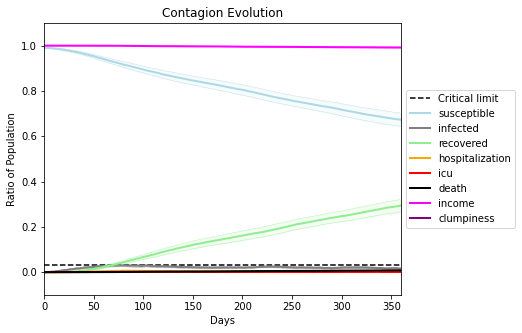

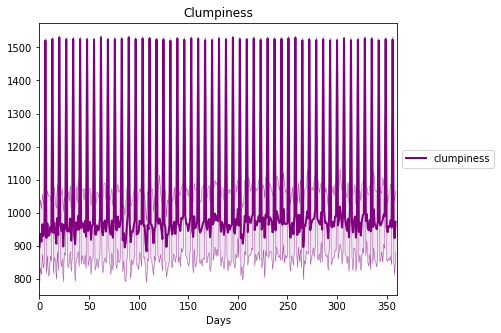

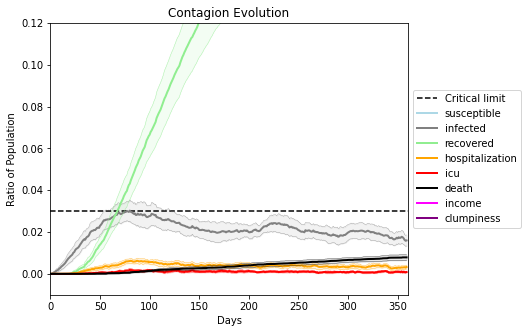

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2647, 2869, 3624, 7254, 1252, 9667, 3277, 6413, 2211, 406, 1310, 9624, 3205, 2223, 2665, 6861, 5912, 800, 7541, 8004]
Average similarity between family members is 0.9272014858454313 at temperature -0.995
Average similarity between family and home is 0.9998537893956044 at temperature -1
Average similarity between students and their classroom is 0.8634929747940465 at temperature -0.995
Average classroom occupancy is 1.5783783783783785 and number classrooms is 185
Average similarity between workers is 0.8744995050529927 at temperature -0.995
Average office occupancy is 3.4072164948453607 and number offices is 194
Average friend similarity for adults: 0.8416997279343705 for kids: 0.7197716710458316
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.7031307511100828
avg restaurant similarity 0.44838726936954787
avg restaurant similarity 0.4623779195599117
avg restaurant similarity 0.6603434952343612
avg restaurant similarity 0.66621300241188
avg restaurant similarity 0.5910459968459586
avg restaurant similarity 0.5380403789370187
avg restaurant similarity 0.5116029667940405
avg restaurant similarity 0.49645079510328854
avg restaurant similarity 0.7313169903610582
avg restaurant similarity 0.47875683450461565
avg restaurant similarity 0.5468057029946796
avg restaurant similarity 0.7216462627026929
avg restaurant similarity 0.5463843580492749
avg restaurant similarity 0.6332167436778213
avg restaurant similarity 0.6544443792895076
avg restaurant similarity 0.714472417320205
avg restaurant similarity 0.6752447635628362
avg restaurant similarity 0.6673858605552064
avg restaurant similarity 0.6009290190526619
avg restaurant similarity 0.4682579316682351
avg restaurant similarity 0.6824208901969783
avg restau

avg restaurant similarity 0.5098195450481247
avg restaurant similarity 0.5707088816180377
avg restaurant similarity 0.6083740098087848
avg restaurant similarity 0.44809143371003257
avg restaurant similarity 0.5605680648813156
avg restaurant similarity 0.4566598286258273
avg restaurant similarity 0.53469555419095
avg restaurant similarity 0.7149672171590087
avg restaurant similarity 0.5646498789668886
avg restaurant similarity 0.4416682541117622
avg restaurant similarity 0.6842381559179085
avg restaurant similarity 0.5037493898593158
avg restaurant similarity 0.38876363629032373
avg restaurant similarity 0.4845460259112883
avg restaurant similarity 0.6825158994491041
avg restaurant similarity 0.70373616462961
avg restaurant similarity 0.5615142475769794
avg restaurant similarity 0.6140610047083872
avg restaurant similarity 0.4678685625598066
avg restaurant similarity 0.5293797679618131
avg restaurant similarity 0.49079919842790987
avg restaurant similarity 0.6318801540692756
avg restaur

Average similarity between workers is 0.9020215060580211 at temperature -0.995
Average office occupancy is 3.3969849246231156 and number offices is 199
Average friend similarity for adults: 0.8564385950143861 for kids: 0.7335950381612093
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13

avg restaurant similarity 0.5383298511660753
avg restaurant similarity 0.5405376853229904
avg restaurant similarity 0.5510465529203682
avg restaurant similarity 0.6065074782296117
avg restaurant similarity 0.7037014930480855
avg restaurant similarity 0.8676440717738773
avg restaurant similarity 0.6553660044948783
avg restaurant similarity 0.7104158184201087
avg restaurant similarity 0.6656415247947797
avg restaurant similarity 0.8686063660358773
avg restaurant similarity 0.5451912447287325
avg restaurant similarity 0.44084960319748046
avg restaurant similarity 0.5400815342928268
avg restaurant similarity 0.6854914215698213
avg restaurant similarity 0.5732917837350741
avg restaurant similarity 0.544480226636419
avg restaurant similarity 0.6050310423656445
avg restaurant similarity 0.6608201190025278
avg restaurant similarity 0.6827233530431489
avg restaurant similarity 0.5860462353296115
avg restaurant similarity 0.6881523762514443
avg restaurant similarity 0.7253975640541764
avg restau

avg restaurant similarity 0.5655385529354319
avg restaurant similarity 0.554240907103785
avg restaurant similarity 0.6383576215316022
avg restaurant similarity 0.5232113464686905
avg restaurant similarity 0.5783273440717561
avg restaurant similarity 0.616630326110326
avg restaurant similarity 0.5634664575854539
avg restaurant similarity 0.4700382815951305
avg restaurant similarity 0.6821159932441221
avg restaurant similarity 0.6429287652027059
avg restaurant similarity 0.513749719340878
avg restaurant similarity 0.5045190236825994
avg restaurant similarity 0.4712445196156057
avg restaurant similarity 0.6020354769942091
avg restaurant similarity 0.8364234888288057
avg restaurant similarity 0.612372795244327
avg restaurant similarity 0.5549664686933854
avg restaurant similarity 0.704501938401052
avg restaurant similarity 0.5391344883629724
avg restaurant similarity 0.7459458096863745
avg restaurant similarity 0.6612033061935255
avg restaurant similarity 0.480803025848745
avg restaurant s

Average friend similarity for adults: 0.8423415633946152 for kids: 0.7168679923857878
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 alloc

avg restaurant similarity 0.5505731820276091
avg restaurant similarity 0.48824134218157306
avg restaurant similarity 0.4865778462547237
avg restaurant similarity 0.6934020179277907
avg restaurant similarity 0.4716217961393906
avg restaurant similarity 0.503675362906426
avg restaurant similarity 0.5862448726741016
avg restaurant similarity 0.5504378313127372
avg restaurant similarity 0.6269123453531471
avg restaurant similarity 0.646323852621858
avg restaurant similarity 0.6021821535840778
avg restaurant similarity 0.630910615840876
avg restaurant similarity 0.5171944216401329
avg restaurant similarity 0.587815397940858
avg restaurant similarity 0.45632716022140474
avg restaurant similarity 0.42336794866590466
avg restaurant similarity 0.533532819703148
avg restaurant similarity 0.514514572874408
avg restaurant similarity 0.46712579899983836
avg restaurant similarity 0.5503292879445489
avg restaurant similarity 0.5310412530305013
avg restaurant similarity 0.5248551719837291
avg restaura

avg restaurant similarity 0.4600481709969027
avg restaurant similarity 0.5933259114800076
avg restaurant similarity 0.2911946788999755
avg restaurant similarity 0.4658611912901584
avg restaurant similarity 0.5205096837041008
avg restaurant similarity 0.6537275797103371
avg restaurant similarity 0.6646448854067258
avg restaurant similarity 0.5660290290089126
avg restaurant similarity 0.643717085836076
avg restaurant similarity 0.4442677448373463
avg restaurant similarity 0.5238237051770339
avg restaurant similarity 0.5493843533501813
avg restaurant similarity 0.6193295391913547
avg restaurant similarity 0.5275801144210518
avg restaurant similarity 0.20879172420187314
avg restaurant similarity 0.6657952445820144
avg restaurant similarity 0.6359968751891302
avg restaurant similarity 0.5279675524595763
avg restaurant similarity 0.47962596532242474
avg restaurant similarity 0.6266254291124599
avg restaurant similarity 0.5136304928026795
avg restaurant similarity 0.37194738493646634
avg rest

avg restaurant similarity 0.5969385022587553
avg restaurant similarity 0.476770445369642
avg restaurant similarity 0.4029903333330162
avg restaurant similarity 0.5796557742801411
avg restaurant similarity 0.5898225263140382
avg restaurant similarity 0.5819548486866162
avg restaurant similarity 0.49696498573713865
avg restaurant similarity 0.6477457396330093
avg restaurant similarity 0.5912104959015063
avg restaurant similarity 0.5388428268378771
avg restaurant similarity 0.5266855872260452
avg restaurant similarity 0.8001195251768047
avg restaurant similarity 0.44190142067916177
avg restaurant similarity 0.815704102728505
avg restaurant similarity 0.6176664064276625
avg restaurant similarity 0.39167766720289726
avg restaurant similarity 0.4370655491683066
avg restaurant similarity 0.7045801847552062
avg restaurant similarity 0.8008047875827574
avg restaurant similarity 0.6236220134336161
avg restaurant similarity 0.49642435160729326
avg restaurant similarity 0.6469807779622995
avg rest

avg restaurant similarity 0.3278863765608174
avg restaurant similarity 0.7020346755750704
avg restaurant similarity 0.9995649894160465
avg restaurant similarity 0.5121693351115632
avg restaurant similarity 0.5804272945212963
avg restaurant similarity 0.42215095028640093
avg restaurant similarity 0.429169794127197
avg restaurant similarity 0.4750231482048461
avg restaurant similarity 0.602324446733792
avg restaurant similarity 0.41044942651171074
avg restaurant similarity 0.4885295522946294
avg restaurant similarity 0.5578706031784723
avg restaurant similarity 0.5461494725231024
avg restaurant similarity 0.576027450116283
avg restaurant similarity 0.5483122716117547
avg restaurant similarity 0.515868823269152
avg restaurant similarity 0.4516042571432866
avg restaurant similarity 0.33660204875845334
avg restaurant similarity 0.5416673457487824
avg restaurant similarity 0.5606545112989024
avg restaurant similarity 0.6143957660027686
avg restaurant similarity 0.5492634852386956
avg restaur

avg restaurant similarity 0.43904431585655984
avg restaurant similarity 0.5094472086562644
avg restaurant similarity 0.5075283862395426
avg restaurant similarity 0.49556441776576204
avg restaurant similarity 0.6344525183140673
avg restaurant similarity 0.4171749624384094
avg restaurant similarity 0.48089309565218313
avg restaurant similarity 0.28622770990697133
avg restaurant similarity 0.5269269004205115
avg restaurant similarity 0.9999000694547282
avg restaurant similarity 0.5065536134389466
avg restaurant similarity 0.5800476411275814
avg restaurant similarity 0.29775444053978056
avg restaurant similarity 0.6061883519237394
avg restaurant similarity 0.7458390323117243
avg restaurant similarity 0.4779762158777507
avg restaurant similarity 0.5711348308570142
avg restaurant similarity 0.8861462928404821
avg restaurant similarity 0.673446959003273
avg restaurant similarity 0.40722547962196687
avg restaurant similarity 0.5419906324158296
avg restaurant similarity 0.4517277544810182
avg r

avg restaurant similarity 0.5525986142922188
avg restaurant similarity 0.5423846851574966
avg restaurant similarity 0.6955494743712738
avg restaurant similarity 0.8290151067244642
avg restaurant similarity 0.6092300312676275
avg restaurant similarity 0.7642649406287911
avg restaurant similarity 0.6361738721559437
avg restaurant similarity 0.50201349431667
avg restaurant similarity 0.5958957982610832
avg restaurant similarity 0.5709657973395287
avg restaurant similarity 0.5939347548845195
avg restaurant similarity 0.5354751639318215
avg restaurant similarity 0.4861561440472045
avg restaurant similarity 0.5890088717913191
avg restaurant similarity 0.789214756126489
avg restaurant similarity 0.46326346685158454
avg restaurant similarity 0.9003561246720277
avg restaurant similarity 0.7092947313440778
avg restaurant similarity 0.628718069755279
avg restaurant similarity 0.33863308531452785
avg restaurant similarity 0.5399450304602307
avg restaurant similarity 0.6466643427136152
avg restaura

avg restaurant similarity 0.6063015373054348
avg restaurant similarity 0.5277660077215076
avg restaurant similarity 0.5129479022420257
avg restaurant similarity 0.49800371659993503
avg restaurant similarity 0.8173574509067615
avg restaurant similarity 0.6926475925894239
avg restaurant similarity 0.5240452803147744
avg restaurant similarity 0.5635940401610869
avg restaurant similarity 0.6333473446647488
avg restaurant similarity 0.5778637505894825
avg restaurant similarity 0.6987515283936433
avg restaurant similarity 0.5494109001572149
avg restaurant similarity 0.549145694846218
avg restaurant similarity 0.6215723601992992
avg restaurant similarity 0.6657826947996608
avg restaurant similarity 0.4987876877995016
avg restaurant similarity 0.43594550826686773
avg restaurant similarity 0.43267865924995985
avg restaurant similarity 0.768224736449959
avg restaurant similarity 0.44624188792954406
avg restaurant similarity 0.8938817880731704
avg restaurant similarity 0.5993317369922625
avg rest

avg restaurant similarity 0.6306780566422755
avg restaurant similarity 0.5895712782482674
avg restaurant similarity 0.4493275698994829
avg restaurant similarity 0.5719979715004817
avg restaurant similarity 0.6093398377605129
avg restaurant similarity 0.5244677313919067
avg restaurant similarity 0.674603477059432
avg restaurant similarity 0.4583188005320397
avg restaurant similarity 0.4738868535772808
avg restaurant similarity 0.5415977752924261
avg restaurant similarity 0.5968687721320921
avg restaurant similarity 0.5300208338474571
avg restaurant similarity 0.6866353997520132
avg restaurant similarity 0.5458022682649809
avg restaurant similarity 0.615465602676503
avg restaurant similarity 0.6303779262509971
avg restaurant similarity 0.5366641149369696
avg restaurant similarity 0.6090719002386059
avg restaurant similarity 0.5872020098467233
avg restaurant similarity 0.5515327866372921
avg restaurant similarity 0.5679863573764611
avg restaurant similarity 0.5600709551952728
avg restaura

Average friend similarity for adults: 0.855838236340615 for kids: 0.7204050606337356
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocate

avg restaurant similarity 0.5711106740172364
avg restaurant similarity 0.6147048208834373
avg restaurant similarity 0.7103413758733191
avg restaurant similarity 0.5757820788350955
avg restaurant similarity 0.9997502768898163
avg restaurant similarity 0.6599183137796224
avg restaurant similarity 0.5166229779192493
avg restaurant similarity 0.5371170232352918
avg restaurant similarity 0.8316709420120456
avg restaurant similarity 0.7181496527693406
avg restaurant similarity 0.9996246788122647
avg restaurant similarity 0.4430299725640357
avg restaurant similarity 0.6839075769440933
avg restaurant similarity 0.5779967075597976
avg restaurant similarity 0.6497741202446674
avg restaurant similarity 0.8999701973982033
avg restaurant similarity 0.5542538478666719
avg restaurant similarity 0.6171887756864404
avg restaurant similarity 0.5757724303343744
avg restaurant similarity 0.8514631580694179
avg restaurant similarity 0.6085262341183376
avg restaurant similarity 0.8514631580694179
avg restau

avg restaurant similarity 0.4573689288091313
avg restaurant similarity 0.911427465374198
avg restaurant similarity 0.633570759807506
avg restaurant similarity 0.4781434552366195
avg restaurant similarity 0.5732447166409399
avg restaurant similarity 0.9565180607054808
avg restaurant similarity 0.3544041108188273
avg restaurant similarity 0.9998224529456821
avg restaurant similarity 0.5576609124732907
avg restaurant similarity 0.8251876325361143
avg restaurant similarity 0.7868205363632875
avg restaurant similarity 0.7640270677166914
avg restaurant similarity 0.6461676367803298
avg restaurant similarity 0.6197380640376764
avg restaurant similarity 0.527147600278763
avg restaurant similarity 0.6269862707807277
avg restaurant similarity 0.744847157564116
avg restaurant similarity 0.6632212366845609
avg restaurant similarity 0.719314384773814
avg restaurant similarity 0.5775241136704155
avg restaurant similarity 0.5383171374090403
avg restaurant similarity 0.5522050216552395
avg restaurant 

avg restaurant similarity 0.8465178775271974
avg restaurant similarity 0.7955854579319819
avg restaurant similarity 0.6659740698434816
avg restaurant similarity 0.8264148714000056
avg restaurant similarity 0.5503471453233906
avg restaurant similarity 0.5892733155054757
avg restaurant similarity 0.6203803312929356
avg restaurant similarity 0.5711744422377865
avg restaurant similarity 0.5905051241306749
avg restaurant similarity 0.534046097155683
avg restaurant similarity 0.7368257605201198
avg restaurant similarity 0.7311104695121848
avg restaurant similarity 0.6589837899281218
avg restaurant similarity 0.5863045026985221
avg restaurant similarity 0.6613643505083033
avg restaurant similarity 0.6980111327588935
avg restaurant similarity 0.4661635921587593
avg restaurant similarity 0.5512750790046337
avg restaurant similarity 0.60094607617148
avg restaurant similarity 0.5597693453546314
avg restaurant similarity 0.5824289478057182
avg restaurant similarity 0.679254050795813
avg restaurant

avg restaurant similarity 0.7046650044396559
avg restaurant similarity 0.904074113396982
avg restaurant similarity 0.40341057207359776
avg restaurant similarity 0.6544849880191437
avg restaurant similarity 0.6305176385002462
avg restaurant similarity 0.9228690993063039
avg restaurant similarity 0.49005791039233365
avg restaurant similarity 0.5476972811732778
avg restaurant similarity 0.6414005472288531
avg restaurant similarity 0.6800862992183218
avg restaurant similarity 0.6313740730272335
avg restaurant similarity 0.5923466759764385
avg restaurant similarity 0.6881350919456951
avg restaurant similarity 0.8781089369047497
avg restaurant similarity 0.9995023299283778
avg restaurant similarity 0.5428372897395577
avg restaurant similarity 0.7149341511781936
avg restaurant similarity 0.42730179113879635
avg restaurant similarity 0.7067089596587082
avg restaurant similarity 0.753842497596599
avg restaurant similarity 0.7229618595293693
avg restaurant similarity 0.7570126888214214
avg resta

avg restaurant similarity 0.6486033944025347
avg restaurant similarity 0.42293547682646376
avg restaurant similarity 0.6072512584616916
avg restaurant similarity 0.8200344907732493
avg restaurant similarity 0.6326110835810227
avg restaurant similarity 0.7155034458549271
avg restaurant similarity 0.6178369302089325
avg restaurant similarity 0.46773955964461905
avg restaurant similarity 0.5671465798459
avg restaurant similarity 0.6539067844900267
avg restaurant similarity 0.438984403955463
avg restaurant similarity 0.8323747440098667
avg restaurant similarity 0.4352327770883581
avg restaurant similarity 0.5960165812817949
avg restaurant similarity 0.46161931239858733
avg restaurant similarity 0.4882491168961947
avg restaurant similarity 0.6100656310264991
avg restaurant similarity 0.7734065727232711
avg restaurant similarity 0.30703497649037353
avg restaurant similarity 0.5226670539034256
avg restaurant similarity 0.6199498638555274
avg restaurant similarity 0.7497229439042441
avg restau

avg restaurant similarity 0.6084471696627509
avg restaurant similarity 0.7452505371888193
avg restaurant similarity 0.5575996537303775
avg restaurant similarity 0.5639846093528587
avg restaurant similarity 0.7197815653449432
avg restaurant similarity 0.5021573891647702
avg restaurant similarity 0.5072090104695944
avg restaurant similarity 0.6556639852571124
avg restaurant similarity 0.5570704474747538
avg restaurant similarity 0.5895738393707632
avg restaurant similarity 0.6233002115260502
avg restaurant similarity 0.6726691650137324
avg restaurant similarity 0.5645002762839488
avg restaurant similarity 0.7749865143736493
avg restaurant similarity 0.640410893790962
avg restaurant similarity 0.5755855828743288
avg restaurant similarity 0.5705866243348882
avg restaurant similarity 0.49323292756197
avg restaurant similarity 0.5303102752090136
avg restaurant similarity 0.43909323902690156
avg restaurant similarity 0.44850213878123646
avg restaurant similarity 0.6277525897406329
avg restaur

avg restaurant similarity 0.46377111411817795
avg restaurant similarity 0.5454670784524743
avg restaurant similarity 0.6061817688213291
avg restaurant similarity 0.6226359025036016
avg restaurant similarity 0.6587452754440846
avg restaurant similarity 0.7889139776378976
avg restaurant similarity 0.5251004959900218
avg restaurant similarity 0.5459272715059128
avg restaurant similarity 0.7114500794886797
avg restaurant similarity 0.49948450512007914
avg restaurant similarity 0.6542826583464251
avg restaurant similarity 0.5526270616254414
avg restaurant similarity 0.5256413323789717
avg restaurant similarity 0.5015516447907167
avg restaurant similarity 0.5421658211676181
avg restaurant similarity 0.5638453738861435
avg restaurant similarity 0.5034595376315234
avg restaurant similarity 0.5284088253150493
avg restaurant similarity 0.5080167299591795
avg restaurant similarity 0.4943526239979131
avg restaurant similarity 0.4240383287341878
avg restaurant similarity 0.5599872805146705
avg rest

avg restaurant similarity 0.6456789438378809
avg restaurant similarity 0.4572444512798446
avg restaurant similarity 0.42728318975498697
avg restaurant similarity 0.5846917533165557
avg restaurant similarity 0.7283847302338105
avg restaurant similarity 0.69893050093712
avg restaurant similarity 0.5164140208307193
avg restaurant similarity 0.5426773879415107
avg restaurant similarity 0.5155652984121822
avg restaurant similarity 0.5642276972769915
avg restaurant similarity 0.6170552176900556
avg restaurant similarity 0.5476614004312688
avg restaurant similarity 0.5416032501161981
avg restaurant similarity 0.45763729016326715
avg restaurant similarity 0.4509955313191939
avg restaurant similarity 0.5567487607007562
avg restaurant similarity 0.5633783968071775
avg restaurant similarity 0.5059348403316616
avg restaurant similarity 0.5826580495796817
avg restaurant similarity 0.457059085039498
avg restaurant similarity 0.43179013551854833
avg restaurant similarity 0.4645675319171141
avg restau

Average friend similarity for adults: 0.8511644754282017 for kids: 0.742422186682406
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated 

avg restaurant similarity 0.7193286936670438
avg restaurant similarity 0.6960551950184741
avg restaurant similarity 0.8023784261861276
avg restaurant similarity 0.40793072735582986
avg restaurant similarity 0.5378570517703283
avg restaurant similarity 0.5362464758401415
avg restaurant similarity 0.565226980731713
avg restaurant similarity 0.6823257829241807
avg restaurant similarity 0.5039169595478604
avg restaurant similarity 0.5100240079204214
avg restaurant similarity 0.38672302102593387
avg restaurant similarity 0.9996005313984916
avg restaurant similarity 0.640000804736301
avg restaurant similarity 0.42092679046723386
avg restaurant similarity 0.4547454514182476
avg restaurant similarity 0.6016964410933958
avg restaurant similarity 0.45109567436281
avg restaurant similarity 0.5281383950473779
avg restaurant similarity 0.7424376653580294
avg restaurant similarity 0.7459490788303998
avg restaurant similarity 0.9525839383394701
avg restaurant similarity 0.5690659463381055
avg restaur

avg restaurant similarity 0.4392990146062301
avg restaurant similarity 0.7461679513161651
avg restaurant similarity 0.42439039813719914
avg restaurant similarity 0.7879897098465505
avg restaurant similarity 0.2606583545908724
avg restaurant similarity 0.551679456741702
avg restaurant similarity 0.5702877169437839
avg restaurant similarity 0.4505832777112137
avg restaurant similarity 0.699837570857726
avg restaurant similarity 0.5680633857013234
avg restaurant similarity 0.4505934415653019
avg restaurant similarity 0.5919637451955975
avg restaurant similarity 0.723299831869423
avg restaurant similarity 0.5823004318856249
avg restaurant similarity 0.5545872930053647
avg restaurant similarity 0.5455257797948713
avg restaurant similarity 0.9997584313171979
avg restaurant similarity 0.7481840098749826
avg restaurant similarity 0.5390520780591562
avg restaurant similarity 0.5608270120130902
avg restaurant similarity 0.5205632627463578
avg restaurant similarity 0.5356736754738817
avg restaura

avg restaurant similarity 0.6138600379796146
avg restaurant similarity 0.6625529674414372
avg restaurant similarity 0.5144996612578054
avg restaurant similarity 0.5957018822815316
avg restaurant similarity 0.5811279265997319
avg restaurant similarity 0.537562849374544
avg restaurant similarity 0.5563770010770278
avg restaurant similarity 0.7074058006607954
avg restaurant similarity 0.6584160748199751
avg restaurant similarity 0.5541860260045925
avg restaurant similarity 0.5728974002978307
avg restaurant similarity 0.48468338511752207
avg restaurant similarity 0.680379295376542
avg restaurant similarity 0.6551495926532072
avg restaurant similarity 0.6715309425595158
avg restaurant similarity 0.6038051634928965
avg restaurant similarity 0.4925602750673476
avg restaurant similarity 0.695332388868208
avg restaurant similarity 0.6264615363470227
avg restaurant similarity 0.4629530476272714
avg restaurant similarity 0.6209910920314624
avg restaurant similarity 0.4890834318579323
avg restaura

avg restaurant similarity 0.5352831715108431
avg restaurant similarity 0.5746591107539101
avg restaurant similarity 0.4398686633223815
avg restaurant similarity 0.549402913869131
avg restaurant similarity 0.6985207012545136
avg restaurant similarity 0.5365209980377584
avg restaurant similarity 0.6608264350413724
avg restaurant similarity 0.5157142217308659
avg restaurant similarity 0.5809043826265465
avg restaurant similarity 0.6609643865364305
avg restaurant similarity 0.5892043202356342
avg restaurant similarity 0.6380954617705632
avg restaurant similarity 0.5681097664947536
avg restaurant similarity 0.5765769037266518
avg restaurant similarity 0.5177433978145329
avg restaurant similarity 0.6262649162979443
avg restaurant similarity 0.520733648152292
avg restaurant similarity 0.687855549496857
avg restaurant similarity 0.466081199709763
avg restaurant similarity 0.5233538560370665
avg restaurant similarity 0.48476442660193886
avg restaurant similarity 0.5710050793042456
avg restauran

Average similarity between workers is 0.8881240293893242 at temperature -0.995
Average office occupancy is 3.3959390862944163 and number offices is 197
Average friend similarity for adults: 0.8554311031141663 for kids: 0.7297993684688064
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of

avg restaurant similarity 0.5305333817874677
avg restaurant similarity 0.614742071925417
avg restaurant similarity 0.6199295943300978
avg restaurant similarity 0.5490150401913977
avg restaurant similarity 0.37086006153631595
avg restaurant similarity 0.6809930350164971
avg restaurant similarity 0.6096189390530411
avg restaurant similarity 0.6811273294910969
avg restaurant similarity 0.6155465926917778
avg restaurant similarity 0.5679055822473779
avg restaurant similarity 0.4818964328928412
avg restaurant similarity 0.5360725372734377
avg restaurant similarity 0.8164186417681079
avg restaurant similarity 0.335550063948498
avg restaurant similarity 0.45761002018877117
avg restaurant similarity 0.5311334267359709
avg restaurant similarity 0.5580808128947157
avg restaurant similarity 0.4740039462527607
avg restaurant similarity 0.8038914103739656
avg restaurant similarity 0.7871622710529743
avg restaurant similarity 0.5466684098224204
avg restaurant similarity 0.701092023368264
avg restaur

avg restaurant similarity 0.5361017040613519
avg restaurant similarity 0.4467406133371274
avg restaurant similarity 0.6957533966034182
avg restaurant similarity 0.521242766304548
avg restaurant similarity 0.351230385162535
avg restaurant similarity 0.6880946235030756
avg restaurant similarity 0.5208759591337309
avg restaurant similarity 0.3439832323031806
avg restaurant similarity 0.8235738840034074
avg restaurant similarity 0.480836831451818
avg restaurant similarity 0.5434040511970648
avg restaurant similarity 0.668838864370047
avg restaurant similarity 0.5916320573413262
avg restaurant similarity 0.3271297867975353
avg restaurant similarity 0.44517386553946825
avg restaurant similarity 0.520813699507777
avg restaurant similarity 0.4951168441460072
avg restaurant similarity 0.6291449970090758
avg restaurant similarity 0.5910818669259117
avg restaurant similarity 0.5061639669061205
avg restaurant similarity 0.48343661989601455
avg restaurant similarity 0.6064541259950119
avg restauran

avg restaurant similarity 0.7303206970609633
avg restaurant similarity 0.6032292231273442
avg restaurant similarity 0.7841306723589554
avg restaurant similarity 0.6999232565958643
avg restaurant similarity 0.669227940349509
avg restaurant similarity 0.5689647177170667
avg restaurant similarity 0.6960665544269993
avg restaurant similarity 0.6943785052652369
avg restaurant similarity 0.5925886742276497
avg restaurant similarity 0.648612363688349
avg restaurant similarity 0.6608840099522167
avg restaurant similarity 0.6597466985272705
avg restaurant similarity 0.4566889700047202
avg restaurant similarity 0.6976489972072855
avg restaurant similarity 0.5835064342524249
avg restaurant similarity 0.6972522434360002
avg restaurant similarity 0.7085941262392298
avg restaurant similarity 0.6537255179382082
avg restaurant similarity 0.7307305398962902
avg restaurant similarity 0.738793436306811
avg restaurant similarity 0.7036140902156869
avg restaurant similarity 0.6751036191042177
avg restauran

avg restaurant similarity 0.6431690175697391
avg restaurant similarity 0.7195345450527707
avg restaurant similarity 0.6968655469999407
avg restaurant similarity 0.781387769966691
avg restaurant similarity 0.6714293079332684
avg restaurant similarity 0.701586026992549
avg restaurant similarity 0.5801140608452027
avg restaurant similarity 0.6424246634367896
avg restaurant similarity 0.580289236909327
avg restaurant similarity 0.6479813341986917
avg restaurant similarity 0.6871634354353899
avg restaurant similarity 0.4392400663948571
avg restaurant similarity 0.6221042303221785
avg restaurant similarity 0.4889452424285669
avg restaurant similarity 0.7038222183125483
avg restaurant similarity 0.6806303889211779
avg restaurant similarity 0.7241724089513764
avg restaurant similarity 0.509099662328804
avg restaurant similarity 0.764485961210705
avg restaurant similarity 0.4572968788627927
avg restaurant similarity 0.8434379159918067
avg restaurant similarity 0.6410400560925266
avg restaurant 

Average similarity between workers is 0.8991746789526804 at temperature -0.995
Average office occupancy is 3.5729166666666665 and number offices is 192
Average friend similarity for adults: 0.8644551668794904 for kids: 0.7297293765339191
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 p

avg restaurant similarity 0.6222739091106462
avg restaurant similarity 0.6723647618325154
avg restaurant similarity 0.7088590289231979
avg restaurant similarity 0.6798179969783865
avg restaurant similarity 0.665669639331175
avg restaurant similarity 0.5443492447592768
avg restaurant similarity 0.5688699015438884
avg restaurant similarity 0.7478930409903083
avg restaurant similarity 0.6650895045691372
avg restaurant similarity 0.6024176946525098
avg restaurant similarity 0.4114366729451877
avg restaurant similarity 0.6616772146896325
avg restaurant similarity 0.6350234779388753
avg restaurant similarity 0.6022516783842851
avg restaurant similarity 0.586267538943463
avg restaurant similarity 0.5362377374632448
avg restaurant similarity 0.6598651162983966
avg restaurant similarity 0.6151474601095184
avg restaurant similarity 0.45697828079159175
avg restaurant similarity 0.614933574570224
avg restaurant similarity 0.6924988840142594
avg restaurant similarity 0.7441570741795787
avg restaura

avg restaurant similarity 0.7859936316787537
avg restaurant similarity 0.643683194021891
avg restaurant similarity 0.3857471873417994
avg restaurant similarity 0.6536694529214722
avg restaurant similarity 0.6453629229715905
avg restaurant similarity 0.6135257644404044
avg restaurant similarity 0.5406456348810695
avg restaurant similarity 0.5367311741541906
avg restaurant similarity 0.6428438505293004
avg restaurant similarity 0.5584184607767189
avg restaurant similarity 0.7323132863574879
avg restaurant similarity 0.7055630682377384
avg restaurant similarity 0.7091867779679845
avg restaurant similarity 0.690270755195835
avg restaurant similarity 0.44216799282298574
avg restaurant similarity 0.5519370001102073
avg restaurant similarity 0.5791720524253177
avg restaurant similarity 0.7838260070376357
avg restaurant similarity 0.4493902631698335
avg restaurant similarity 0.6827721858030736
avg restaurant similarity 0.5581493332482119
avg restaurant similarity 0.5693693154686967
avg restaur

Average similarity between workers is 0.8898265032178688 at temperature -0.995
Average office occupancy is 3.3604060913705585 and number offices is 197
Average friend similarity for adults: 0.8506855429184316 for kids: 0.734910343413135
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.544931585491047
avg restaurant similarity 0.4735757728843109
avg restaurant similarity 0.5176851067904262
avg restaurant similarity 0.9998352649746106
avg restaurant similarity 0.6105249731242178
avg restaurant similarity 0.7089704168563907
avg restaurant similarity 0.6208826029903796
avg restaurant similarity 0.5555483956427294
avg restaurant similarity 0.4428003262185206
avg restaurant similarity 0.46233058703081653
avg restaurant similarity 0.5878345737241101
avg restaurant similarity 0.5558608460537141
avg restaurant similarity 0.3736424687552595
avg restaurant similarity 0.6682262265478918
avg restaurant similarity 0.6072661525107717
avg restaurant similarity 0.4291927795633271
avg restaurant similarity 0.34615747740292946
avg restaurant similarity 0.5048830007264017
avg restaurant similarity 0.4695142477210986
avg restaurant similarity 0.6583847238402851
avg restaurant similarity 0.6747941560273745
avg restaurant similarity 0.5890437050108837
avg resta

avg restaurant similarity 0.5343601987980554
avg restaurant similarity 0.6252896831495379
avg restaurant similarity 0.4552504842454997
avg restaurant similarity 0.484614921592617
avg restaurant similarity 0.5689378560024241
avg restaurant similarity 0.8907135134094031
avg restaurant similarity 0.7251364088919193
avg restaurant similarity 0.6975351079256167
avg restaurant similarity 0.38857690425518354
avg restaurant similarity 0.5873256605495619
avg restaurant similarity 0.6704099371081393
avg restaurant similarity 0.49039360998125625
avg restaurant similarity 0.5203991023905804
avg restaurant similarity 0.3015420219534248
avg restaurant similarity 0.5741921175659167
avg restaurant similarity 0.5659037016020062
avg restaurant similarity 0.5190691564080347
avg restaurant similarity 0.6030008181012645
avg restaurant similarity 0.5941819145012567
avg restaurant similarity 0.39571710163283286
avg restaurant similarity 0.5584821764658416
avg restaurant similarity 0.465261735326954
avg resta

avg restaurant similarity 0.4929582716464325
avg restaurant similarity 0.497891074065331
avg restaurant similarity 0.542073166642462
avg restaurant similarity 0.6647154533890122
avg restaurant similarity 0.7891598794687347
avg restaurant similarity 0.6181764987245246
avg restaurant similarity 0.47262895064002575
avg restaurant similarity 0.5567249836859103
avg restaurant similarity 0.6316976546503225
avg restaurant similarity 0.5983277101273079
avg restaurant similarity 0.46446217498161685
avg restaurant similarity 0.7880726813082066
avg restaurant similarity 0.37169817011679446
avg restaurant similarity 0.7002747923862203
avg restaurant similarity 0.7284196265021055
avg restaurant similarity 0.6795095907540856
avg restaurant similarity 0.4882017877958936
avg restaurant similarity 0.6251447474032124
avg restaurant similarity 0.8068561189844989
avg restaurant similarity 0.5271523730347702
avg restaurant similarity 0.37655931294962897
avg restaurant similarity 0.8531463545027993
avg rest

avg restaurant similarity 0.5705954448723247
avg restaurant similarity 0.5669453839189712
avg restaurant similarity 0.37939528007805723
avg restaurant similarity 0.6532497558443281
avg restaurant similarity 0.6080799959604066
avg restaurant similarity 0.4258411248506005
avg restaurant similarity 0.6453252376700268
avg restaurant similarity 0.49341303543498405
avg restaurant similarity 0.6449470678218613
avg restaurant similarity 0.46625996675782755
avg restaurant similarity 0.629839429559335
avg restaurant similarity 0.3605400964351367
avg restaurant similarity 0.5572539300430052
avg restaurant similarity 0.5804877849260347
avg restaurant similarity 0.4945490307751979
avg restaurant similarity 0.5973336044890972
avg restaurant similarity 0.6414416278943899
avg restaurant similarity 0.6129211808366859
avg restaurant similarity 0.48388769843971247
avg restaurant similarity 0.7000043529763408
avg restaurant similarity 0.523386913849617
avg restaurant similarity 0.6155824844071975
avg rest

avg restaurant similarity 0.5233044934903384
avg restaurant similarity 0.5152461207909395
avg restaurant similarity 0.4920296242752621
avg restaurant similarity 0.5106031016659736
avg restaurant similarity 0.6383943604825286
avg restaurant similarity 0.48690951081783546
avg restaurant similarity 0.562696290133236
avg restaurant similarity 0.6039043900311357
avg restaurant similarity 0.6189666405464425
avg restaurant similarity 0.5682207591676889
avg restaurant similarity 0.601953519305651
avg restaurant similarity 0.6098940022661012
avg restaurant similarity 0.5593074396862048
avg restaurant similarity 0.573588233895186
avg restaurant similarity 0.5565758689203073
avg restaurant similarity 0.48247970467766005
avg restaurant similarity 0.6473496302838792
avg restaurant similarity 0.5679829979513469
avg restaurant similarity 0.5712422976576935
avg restaurant similarity 0.43780642896530386
avg restaurant similarity 0.5199529400289912
avg restaurant similarity 0.5750100032894212
avg restau

avg restaurant similarity 0.5751014037787829
avg restaurant similarity 0.6332110003142474
avg restaurant similarity 0.6329407993774944
avg restaurant similarity 0.6856369962829273
avg restaurant similarity 0.5346512652359869
avg restaurant similarity 0.5100663753492737
avg restaurant similarity 0.5325819208620726
avg restaurant similarity 0.6734656360926118
avg restaurant similarity 0.4655131865657043
avg restaurant similarity 0.5294505435615012
avg restaurant similarity 0.5828377146961254
avg restaurant similarity 0.5654417291940129
avg restaurant similarity 0.6255470088852664
avg restaurant similarity 0.6290835681439962
avg restaurant similarity 0.5317211425367275
avg restaurant similarity 0.9996983709574869
avg restaurant similarity 0.5157594462115207
avg restaurant similarity 0.5360794046096585
avg restaurant similarity 0.6781550910968135
avg restaurant similarity 0.5878585578669303
avg restaurant similarity 0.5880715580051521
avg restaurant similarity 0.5122184669990011
avg restau

Average similarity between workers is 0.894861390925821 at temperature -0.995
Average office occupancy is 3.405263157894737 and number offices is 190
Average friend similarity for adults: 0.8465429811203805 for kids: 0.7316063877506324
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6236812159426302
avg restaurant similarity 0.5051853715703858
avg restaurant similarity 0.7733065058663962
avg restaurant similarity 0.6495121573709746
avg restaurant similarity 0.5046762018799901
avg restaurant similarity 0.5742016555425369
avg restaurant similarity 0.5695261612361043
avg restaurant similarity 0.5874385521579943
avg restaurant similarity 0.5330802402044402
avg restaurant similarity 0.654916521428061
avg restaurant similarity 0.5090538682847898
avg restaurant similarity 0.5933974139001562
avg restaurant similarity 0.467275613354507
avg restaurant similarity 0.4993833603405187
avg restaurant similarity 0.9998106842426142
avg restaurant similarity 0.44948459468783164
avg restaurant similarity 0.5689001812304885
avg restaurant similarity 0.5695171599440267
avg restaurant similarity 0.6187619026799132
avg restaurant similarity 0.47642399560722026
avg restaurant similarity 0.6323882945593885
avg restaurant similarity 0.6285403819402607
avg restau

avg restaurant similarity 0.6725392878140236
avg restaurant similarity 0.7004181344102605
avg restaurant similarity 0.4930549181319291
avg restaurant similarity 0.48090033280189587
avg restaurant similarity 0.638702873891709
avg restaurant similarity 0.6176181531218832
avg restaurant similarity 0.6038470492581582
avg restaurant similarity 0.4882727941491269
avg restaurant similarity 0.5404057687039567
avg restaurant similarity 0.5791249573887715
avg restaurant similarity 0.6106776552524075
avg restaurant similarity 0.5569171896845696
avg restaurant similarity 0.6320128728432203
avg restaurant similarity 0.571208676609008
avg restaurant similarity 0.3477417862274678
avg restaurant similarity 0.6036931977519921
avg restaurant similarity 0.6358283970693462
avg restaurant similarity 0.5670901609704522
avg restaurant similarity 0.6624798700131638
avg restaurant similarity 0.5010281572393998
avg restaurant similarity 0.4795570010747936
avg restaurant similarity 0.4870784949829121
avg restaur

Average friend similarity for adults: 0.865946176557571 for kids: 0.7272844607147554
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated 

avg restaurant similarity 0.8139902752040701
avg restaurant similarity 0.6123812075118844
avg restaurant similarity 0.6086126783082835
avg restaurant similarity 0.6112322556163866
avg restaurant similarity 0.5321690542974241
avg restaurant similarity 0.4791272058886988
avg restaurant similarity 0.6632439700978806
avg restaurant similarity 0.4730955152363008
avg restaurant similarity 0.42749507477370224
avg restaurant similarity 0.8034893064161365
avg restaurant similarity 0.4663870227536028
avg restaurant similarity 0.5095243945137462
avg restaurant similarity 0.49182896377466107
avg restaurant similarity 0.6250303077014099
avg restaurant similarity 0.6779023691570806
avg restaurant similarity 0.9996270327539327
avg restaurant similarity 0.4600140561009914
avg restaurant similarity 0.34532000674399477
avg restaurant similarity 0.49823940017166785
avg restaurant similarity 0.6063823940184487
avg restaurant similarity 0.747028698111422
avg restaurant similarity 0.4786250310685711
avg res

avg restaurant similarity 0.5721219782615433
avg restaurant similarity 0.2947375250737977
avg restaurant similarity 0.533249615572009
avg restaurant similarity 0.5824557869596164
avg restaurant similarity 0.5907641962211372
avg restaurant similarity 0.5202088590348664
avg restaurant similarity 0.5431384802091815
avg restaurant similarity 0.5856348852124846
avg restaurant similarity 0.6461268028468039
avg restaurant similarity 0.46967765039642667
avg restaurant similarity 0.6207161332918606
avg restaurant similarity 0.5742335349651124
avg restaurant similarity 0.9179961673545993
avg restaurant similarity 0.5798432795861361
avg restaurant similarity 0.4478428884710013
avg restaurant similarity 0.5714230606517623
avg restaurant similarity 0.5986864314770352
avg restaurant similarity 0.6381449951052023
avg restaurant similarity 0.5825252546606556
avg restaurant similarity 0.3567450377052575
avg restaurant similarity 0.5178149759171261
avg restaurant similarity 0.5154109109508668
avg restau

data: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
min:
1.0
max:
1.0
std:
0.0
mean:
1.0
median:
1.0
95% confidence interval for the mean:
(1.0,1.0)
using peak of time series:
stats on clumpiness:
data: [1552.0, 1533.0, 1534.0, 1537.0, 1537.0, 1522.0, 1553.0, 1529.0, 1535.0, 1531.0, 1539.0, 1546.0, 1530.0, 1540.0, 1546.0, 1559.0, 1546.0, 1544.0, 1526.0, 1537.0]
min:
1522.0
max:
1559.0
std:
9.298386956886661
mean:
1538.8
median:
1537.0
95% confidence interval for the mean:
(1534.3351688992927,1543.2648311007072)


(<function dict.items>, <function dict.items>, <function dict.items>)

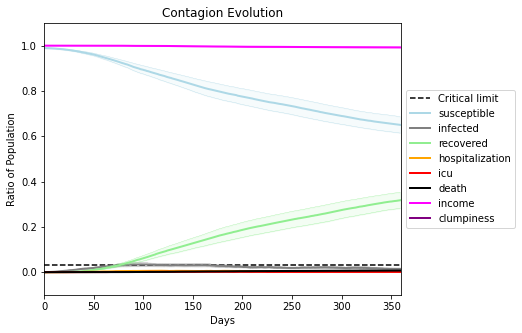

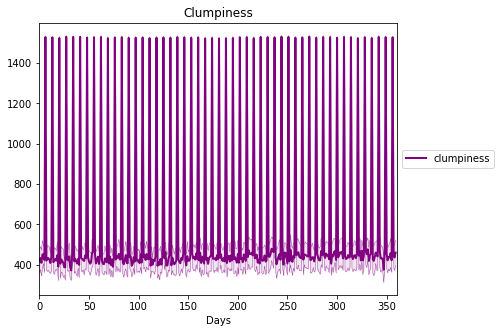

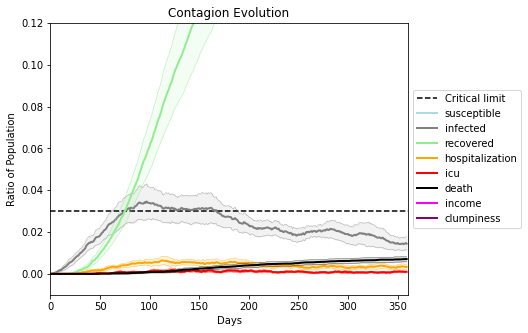

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3241, 9138, 1169, 5885, 3231, 1868, 1858, 874, 4280, 9999, 236, 9980, 7800, 9759, 7564, 5780, 7327, 4450, 5645, 3919]
Average similarity between family members is 0.9398269428444898 at temperature -0.994
Average similarity between family and home is 0.999840769548088 at temperature -1
Average similarity between students and their classroom is 0.8686509566537823 at temperature -0.994
Average classroom occupancy is 1.4739884393063585 and number classrooms is 173
Average similarity between workers is 0.8783617874035204 at temperature -0.994
Average office occupancy is 3.568421052631579 and number offices is 190
Average friend similarity for adults: 0.8458216930710231 for kids: 0.7042604888115509
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.4249381515705694
avg restaurant similarity 0.3457640927090785
avg restaurant similarity 0.4653603740478595
avg restaurant similarity 0.6509995743356755
avg restaurant similarity 0.7313743640403378
avg restaurant similarity 0.5731921099544094
avg restaurant similarity 0.7298910902673098
avg restaurant similarity 0.5369760148684651
avg restaurant similarity 0.5363583871576721
avg restaurant similarity 0.6642163084947679
avg restaurant similarity 0.6367098300198747
avg restaurant similarity 0.5995366773380115
avg restaurant similarity 0.5064902918503148
avg restaurant similarity 0.43197534919669134
avg restaurant similarity 0.9042516987288748
avg restaurant similarity 0.5593086693232966
avg restaurant similarity 0.5653791596389047
avg restaurant similarity 0.6485886863140375
avg restaurant similarity 0.5450295495439363
avg restaurant similarity 0.7529156757807555
avg restaurant similarity 0.6263859831524184
avg restaurant similarity 0.23836751522756355
avg rest

avg restaurant similarity 0.6877088998522385
avg restaurant similarity 0.5173039790245979
avg restaurant similarity 0.7252989824036398
avg restaurant similarity 0.5632389007732402
avg restaurant similarity 0.5756028468987144
avg restaurant similarity 0.5559760543318027
avg restaurant similarity 0.4120942117063365
avg restaurant similarity 0.5307813595404033
avg restaurant similarity 0.6544510678340092
avg restaurant similarity 0.5809803884414547
avg restaurant similarity 0.4233917096994647
avg restaurant similarity 0.42275556535866543
avg restaurant similarity 0.6405662072656342
avg restaurant similarity 0.5927468734416107
avg restaurant similarity 0.7141133394224144
avg restaurant similarity 0.617469235962003
avg restaurant similarity 0.6587163041091779
avg restaurant similarity 0.560792430070031
avg restaurant similarity 0.5185030677264842
avg restaurant similarity 0.5219483099639535
avg restaurant similarity 0.39106914626925415
avg restaurant similarity 0.5759391297155941
avg restau

Average friend similarity for adults: 0.8444989332442933 for kids: 0.7368155377289591
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.45974544209626633
avg restaurant similarity 0.6181733499438935
avg restaurant similarity 0.5852652131784786
avg restaurant similarity 0.5869374249155581
avg restaurant similarity 0.5931947550601587
avg restaurant similarity 0.4636092838257915
avg restaurant similarity 0.570693957662174
avg restaurant similarity 0.44109832884591227
avg restaurant similarity 0.4779801540990887
avg restaurant similarity 0.4727180462914634
avg restaurant similarity 0.6285328713252938
avg restaurant similarity 0.6795595732568933
avg restaurant similarity 0.42537999760676254
avg restaurant similarity 0.5928764498660715
avg restaurant similarity 0.4719623815126316
avg restaurant similarity 0.4809647346693056
avg restaurant similarity 0.6348453223132647
avg restaurant similarity 0.4006341395613915
avg restaurant similarity 0.4714502575150455
avg restaurant similarity 0.502811399218975
avg restaurant similarity 0.5654592745809088
avg restaurant similarity 0.7191056889577543
avg resta

avg restaurant similarity 0.45680187121936894
avg restaurant similarity 0.44080655117649375
avg restaurant similarity 0.5900747081759997
avg restaurant similarity 0.486146886940945
avg restaurant similarity 0.540961390810597
avg restaurant similarity 0.32732220582826765
avg restaurant similarity 0.6353919480111981
avg restaurant similarity 0.4989617595906232
avg restaurant similarity 0.44885012829038623
avg restaurant similarity 0.6950346333364742
avg restaurant similarity 0.7504223703527076
avg restaurant similarity 0.46418168807819127
avg restaurant similarity 0.5081703483357398
avg restaurant similarity 0.3638482256100639
avg restaurant similarity 0.5387402526187157
avg restaurant similarity 0.4728465904661325
avg restaurant similarity 0.38708987789553795
avg restaurant similarity 0.6896269553919706
avg restaurant similarity 0.35611032288313693
avg restaurant similarity 0.28766857466550716
avg restaurant similarity 0.45180032350114296
avg restaurant similarity 0.4435683427827848
avg

Average friend similarity for adults: 0.8558692161769015 for kids: 0.7367263622644578
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.6202595397027926
avg restaurant similarity 0.5874296002639162
avg restaurant similarity 0.6695774363650648
avg restaurant similarity 0.5370979249351403
avg restaurant similarity 0.7205026860942154
avg restaurant similarity 0.7190537034641481
avg restaurant similarity 0.5757925353404146
avg restaurant similarity 0.6733431385772342
avg restaurant similarity 0.7510208022000833
avg restaurant similarity 0.6186585529572863
avg restaurant similarity 0.6587732743488074
avg restaurant similarity 0.5587846760887962
avg restaurant similarity 0.7243225597233338
avg restaurant similarity 0.6086143885656976
avg restaurant similarity 0.7507487901595006
avg restaurant similarity 0.5631422651976996
avg restaurant similarity 0.6611604109761295
avg restaurant similarity 0.7657482177453219
avg restaurant similarity 0.5747901037315715
avg restaurant similarity 0.5622352843018263
avg restaurant similarity 0.4156571671235488
avg restaurant similarity 0.7104143848700915
avg restau

avg restaurant similarity 0.6248129493483101
avg restaurant similarity 0.6288497515721541
avg restaurant similarity 0.7868874654946464
avg restaurant similarity 0.5915900537358653
avg restaurant similarity 0.7229718809704031
avg restaurant similarity 0.7268912937337557
avg restaurant similarity 0.8120936252965958
avg restaurant similarity 0.6765985788218617
avg restaurant similarity 0.6093747274759755
avg restaurant similarity 0.784341304007621
avg restaurant similarity 0.723561222473717
avg restaurant similarity 0.5110298594013333
avg restaurant similarity 0.6020096709986252
avg restaurant similarity 0.5906056557105677
avg restaurant similarity 0.6203745328616052
avg restaurant similarity 0.7114747224052522
avg restaurant similarity 0.5069666740757216
avg restaurant similarity 0.5409980753581074
avg restaurant similarity 0.5689599546525392
avg restaurant similarity 0.4660377583402038
avg restaurant similarity 0.616533835479986
avg restaurant similarity 0.5986504892720697
avg restauran

Average friend similarity for adults: 0.8497218204547339 for kids: 0.7331176600732121
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.7297954703602333
avg restaurant similarity 0.5254800739003921
avg restaurant similarity 0.6365896115836426
avg restaurant similarity 0.5894791693258052
avg restaurant similarity 0.7351836161842902
avg restaurant similarity 0.601516425611385
avg restaurant similarity 0.6013819640109012
avg restaurant similarity 0.5309630089760571
avg restaurant similarity 0.6166939991100702
avg restaurant similarity 0.6106863412846351
avg restaurant similarity 0.6608965722827376
avg restaurant similarity 0.5304918094697775
avg restaurant similarity 0.5060686705960518
avg restaurant similarity 0.5647120907442336
avg restaurant similarity 0.5287148103112075
avg restaurant similarity 0.4946804051402651
avg restaurant similarity 0.48671174041794346
avg restaurant similarity 0.5119471630697382
avg restaurant similarity 0.6202863338365121
avg restaurant similarity 0.564267842376642
avg restaurant similarity 0.574128637304545
avg restaurant similarity 0.7031936689511378
avg restaura

avg restaurant similarity 0.5690227663621379
avg restaurant similarity 0.5652521452686347
avg restaurant similarity 0.5863527334823406
avg restaurant similarity 0.5990789894057968
avg restaurant similarity 0.4860573269458872
avg restaurant similarity 0.6263866737068512
avg restaurant similarity 0.6543318354684711
avg restaurant similarity 0.5270753916524584
avg restaurant similarity 0.5318789006170793
avg restaurant similarity 0.6442240193799484
avg restaurant similarity 0.7853209184564331
avg restaurant similarity 0.5022645170664475
avg restaurant similarity 0.6295380595190119
avg restaurant similarity 0.36528575613646946
avg restaurant similarity 0.6195094342902393
avg restaurant similarity 0.723402633390328
avg restaurant similarity 0.5423063442369592
avg restaurant similarity 0.6031653036159933
avg restaurant similarity 0.6320986881487596
avg restaurant similarity 0.5294022166033375
avg restaurant similarity 0.45475064019767486
avg restaurant similarity 0.5530118536762516
avg resta

Average similarity between workers is 0.8947413735759355 at temperature -0.994
Average office occupancy is 3.4923076923076923 and number offices is 195
Average friend similarity for adults: 0.8592528859674451 for kids: 0.7284973371710788
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.5509277065132402
avg restaurant similarity 0.5785862673918175
avg restaurant similarity 0.6610793536810988
avg restaurant similarity 0.644639054889885
avg restaurant similarity 0.6722202787446827
avg restaurant similarity 0.8269812843501153
avg restaurant similarity 0.5508892337153918
avg restaurant similarity 0.5575430125925138
avg restaurant similarity 0.6884112713310705
avg restaurant similarity 0.6089623602185571
avg restaurant similarity 0.6222110193000204
avg restaurant similarity 0.742443505405423
avg restaurant similarity 0.6395049056875252
avg restaurant similarity 0.7063589692604318
avg restaurant similarity 0.5302943129850807
avg restaurant similarity 0.760501029721829
avg restaurant similarity 0.457524354829864
avg restaurant similarity 0.5959331765670266
avg restaurant similarity 0.6358882967967374
avg restaurant similarity 0.5127038673772767
avg restaurant similarity 0.571412640290384
avg restaurant similarity 0.6643751439534241
avg restaurant 

avg restaurant similarity 0.5454247607652172
avg restaurant similarity 0.569698255604993
avg restaurant similarity 0.5646817040861525
avg restaurant similarity 0.9040783855436638
avg restaurant similarity 0.6316170842415421
avg restaurant similarity 0.81654967425889
avg restaurant similarity 0.5664559249531447
avg restaurant similarity 0.4995841037407651
avg restaurant similarity 0.5207331881860255
avg restaurant similarity 0.6083174136159023
avg restaurant similarity 0.5249577544059744
avg restaurant similarity 0.46605574539773637
avg restaurant similarity 0.711596244245245
avg restaurant similarity 0.564419596901066
avg restaurant similarity 0.6331024891036608
avg restaurant similarity 0.7171097457357065
avg restaurant similarity 0.6562215391228652
avg restaurant similarity 0.6211483180614105
avg restaurant similarity 0.57531035607018
avg restaurant similarity 0.5333382849877543
avg restaurant similarity 0.5511971152738254
avg restaurant similarity 0.5453452609026257
avg restaurant s

avg restaurant similarity 0.41622275726318886
avg restaurant similarity 0.336724361841575
avg restaurant similarity 0.4187630248969264
avg restaurant similarity 0.3734519089266551
avg restaurant similarity 0.6021606340377852
avg restaurant similarity 0.29467245969344946
avg restaurant similarity 0.5787550590741201
avg restaurant similarity 0.546855912034938
avg restaurant similarity 0.47118789640521075
avg restaurant similarity 0.5942356626441997
avg restaurant similarity 0.5219334719981511
avg restaurant similarity 0.5799777783404592
avg restaurant similarity 0.6075262716989501
avg restaurant similarity 0.4997282166338385
avg restaurant similarity 0.5971701055643577
avg restaurant similarity 0.43126222465644987
avg restaurant similarity 0.4842765886985327
avg restaurant similarity 0.5976308787796666
avg restaurant similarity 0.4806786560674189
avg restaurant similarity 0.47318368097091484
avg restaurant similarity 0.4345015379646071
avg restaurant similarity 0.5420634729703118
avg res

avg restaurant similarity 0.5760337333305348
avg restaurant similarity 0.5874141387705802
avg restaurant similarity 0.3794377221121627
avg restaurant similarity 0.48194823804731585
avg restaurant similarity 0.3999951455021022
avg restaurant similarity 0.534009649906959
avg restaurant similarity 0.5452452578775069
avg restaurant similarity 0.47595819705397785
avg restaurant similarity 0.32072188660277023
avg restaurant similarity 0.6183174678001657
avg restaurant similarity 0.5578665446037535
avg restaurant similarity 0.55107820613946
avg restaurant similarity 0.5281848328258028
avg restaurant similarity 0.4971657086600606
avg restaurant similarity 0.5982140739298472
avg restaurant similarity 0.44348562407416664
avg restaurant similarity 0.5846447648426966
avg restaurant similarity 0.4932040322693551
avg restaurant similarity 0.3856356937702613
avg restaurant similarity 0.49962134260654145
avg restaurant similarity 0.44947408764834734
avg restaurant similarity 0.53241472946042
avg resta

Average friend similarity for adults: 0.8567757260306428 for kids: 0.7128458323889053
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated

avg restaurant similarity 0.5188154109403114
avg restaurant similarity 0.5071424248845625
avg restaurant similarity 0.4323929075095214
avg restaurant similarity 0.5863992793113245
avg restaurant similarity 0.4956949640981287
avg restaurant similarity 0.5939903273476753
avg restaurant similarity 0.666449522575064
avg restaurant similarity 0.5769439615309542
avg restaurant similarity 0.6285810770612827
avg restaurant similarity 0.6127396112449841
avg restaurant similarity 0.5588119968078212
avg restaurant similarity 0.39054069722170254
avg restaurant similarity 0.6268507054026826
avg restaurant similarity 0.5319194595944384
avg restaurant similarity 0.4936613434832058
avg restaurant similarity 0.48795099518801077
avg restaurant similarity 0.7233509669027234
avg restaurant similarity 0.45462411215675724
avg restaurant similarity 0.5637678161552476
avg restaurant similarity 0.5288310753817284
avg restaurant similarity 0.6597934042962049
avg restaurant similarity 0.6639187124834902
avg rest

avg restaurant similarity 0.577912691257337
avg restaurant similarity 0.5711700544880279
avg restaurant similarity 0.5586377546448059
avg restaurant similarity 0.6201709667903487
avg restaurant similarity 0.6073240214099622
avg restaurant similarity 0.5876602587137553
avg restaurant similarity 0.40163206481510755
avg restaurant similarity 0.6870046672665362
avg restaurant similarity 0.35814290603315274
avg restaurant similarity 0.5977612220439485
avg restaurant similarity 0.7511341289331603
avg restaurant similarity 0.5614695987436726
avg restaurant similarity 0.6150703406552963
avg restaurant similarity 0.6777767260442987
avg restaurant similarity 0.5168508378027473
avg restaurant similarity 0.34301811922576275
avg restaurant similarity 0.5773814162848743
avg restaurant similarity 0.7033083819933053
avg restaurant similarity 0.6813507201545704
avg restaurant similarity 0.6450311480304413
avg restaurant similarity 0.5923363361216311
avg restaurant similarity 0.5785147387390788
avg rest

Average similarity between workers is 0.888372029691015 at temperature -0.994
Average office occupancy is 3.4170854271356785 and number offices is 199
Average friend similarity for adults: 0.8568776245969612 for kids: 0.7226534726104467
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 

avg restaurant similarity 0.4683938351681875
avg restaurant similarity 0.6765542340011718
avg restaurant similarity 0.6751390569829612
avg restaurant similarity 0.5294604643389929
avg restaurant similarity 0.5403710128250501
avg restaurant similarity 0.5747378756847489
avg restaurant similarity 0.49892673502166074
avg restaurant similarity 0.4603688923756073
avg restaurant similarity 0.5749683578541228
avg restaurant similarity 0.7287060094500706
avg restaurant similarity 0.5361214130203051
avg restaurant similarity 0.548971887172173
avg restaurant similarity 0.28607731873166264
avg restaurant similarity 0.5761695333700706
avg restaurant similarity 0.6027804535632493
avg restaurant similarity 0.573429582479819
avg restaurant similarity 0.5580766057695651
avg restaurant similarity 0.6649899848122465
avg restaurant similarity 0.45295898040133337
avg restaurant similarity 0.7714580033978775
avg restaurant similarity 0.5019405103107881
avg restaurant similarity 0.5935227051031021
avg resta

avg restaurant similarity 0.6040304481349938
avg restaurant similarity 0.5717068049799268
avg restaurant similarity 0.5178175552630404
avg restaurant similarity 0.5334054174722154
avg restaurant similarity 0.4440937112750969
avg restaurant similarity 0.6343895595042918
avg restaurant similarity 0.616159013178226
avg restaurant similarity 0.9997305032573206
avg restaurant similarity 0.6407999385816581
avg restaurant similarity 0.6297431854802511
avg restaurant similarity 0.5193083861772239
avg restaurant similarity 0.6951682294550583
avg restaurant similarity 0.467084715182323
avg restaurant similarity 0.6859797676358024
avg restaurant similarity 0.9216575582230457
avg restaurant similarity 0.4439897189587983
avg restaurant similarity 0.6596805312970793
avg restaurant similarity 0.47712080058765854
avg restaurant similarity 0.48294110859380135
avg restaurant similarity 0.63985157144681
avg restaurant similarity 0.5339735424702305
avg restaurant similarity 0.5728820726093339
avg restaura

avg restaurant similarity 0.5030997662434505
avg restaurant similarity 0.5163410324160531
avg restaurant similarity 0.6163627182825973
avg restaurant similarity 0.5754848661881239
avg restaurant similarity 0.5578752349428912
avg restaurant similarity 0.4898789415904172
avg restaurant similarity 0.6139952559666365
avg restaurant similarity 0.32522909990617277
avg restaurant similarity 0.4914677041905654
avg restaurant similarity 0.41202990668564315
avg restaurant similarity 0.5121810578343676
avg restaurant similarity 0.3877122492511666
avg restaurant similarity 0.47096738916767367
avg restaurant similarity 0.6762148270522521
avg restaurant similarity 0.7947532951914361
avg restaurant similarity 0.36432817018700225
avg restaurant similarity 0.5815684041225255
avg restaurant similarity 0.4780078245129864
avg restaurant similarity 0.4927532350497669
avg restaurant similarity 0.5401937572291526
avg restaurant similarity 0.3832077010487549
avg restaurant similarity 0.5211330543936882
avg re

avg restaurant similarity 0.5976522035142919
avg restaurant similarity 0.8070973961343159
avg restaurant similarity 0.158124036597969
avg restaurant similarity 0.6434360184248203
avg restaurant similarity 0.44885791819261617
avg restaurant similarity 0.5369884186242195
avg restaurant similarity 0.6819306854399318
avg restaurant similarity 0.38358011592022445
avg restaurant similarity 0.5160308750223048
avg restaurant similarity 0.5101068554369866
avg restaurant similarity 0.7433715046577622
avg restaurant similarity 0.5072070928653509
avg restaurant similarity 0.4907698178240318
avg restaurant similarity 0.5309974812058393
avg restaurant similarity 0.547301594578864
avg restaurant similarity 0.849891588494121
avg restaurant similarity 0.7920668015389304
avg restaurant similarity 0.6079768349613028
avg restaurant similarity 0.42723302253970974
avg restaurant similarity 0.5657640253635748
avg restaurant similarity 0.7018410570762568
avg restaurant similarity 0.5721846881064409
avg restau

avg restaurant similarity 0.5298000633667739
avg restaurant similarity 0.5641303083330933
avg restaurant similarity 0.5361295073687106
avg restaurant similarity 0.5802656905497044
avg restaurant similarity 0.581784508052502
avg restaurant similarity 0.45257881499657354
avg restaurant similarity 0.61579970380693
avg restaurant similarity 0.5562141111882828
avg restaurant similarity 0.46441514745083284
avg restaurant similarity 0.47200433757520655
avg restaurant similarity 0.6825006720335972
avg restaurant similarity 0.5592328844025233
avg restaurant similarity 0.659418113439163
avg restaurant similarity 0.6776582627606229
avg restaurant similarity 0.6656509872824232
avg restaurant similarity 0.5378832358366641
avg restaurant similarity 0.3874855540018691
avg restaurant similarity 0.4509785872193545
avg restaurant similarity 0.7257442126082065
avg restaurant similarity 0.5122290756109007
avg restaurant similarity 0.5395953126684881
avg restaurant similarity 0.5706492894543089
avg restaur

avg restaurant similarity 0.6325345776088122
avg restaurant similarity 0.5599695584697033
avg restaurant similarity 0.6757282319064093
avg restaurant similarity 0.45724109831387333
avg restaurant similarity 0.45426109608666837
avg restaurant similarity 0.5014585289809286
avg restaurant similarity 0.44411272138364294
avg restaurant similarity 0.5057370849369035
avg restaurant similarity 0.4584260106833626
avg restaurant similarity 0.4884747604410352
avg restaurant similarity 0.723140273528822
avg restaurant similarity 0.6687061004139067
avg restaurant similarity 0.6551122426738121
avg restaurant similarity 0.4964080713551768
avg restaurant similarity 0.56462716651634
avg restaurant similarity 0.680690521841919
avg restaurant similarity 0.4250015472079638
avg restaurant similarity 0.37608701199646205
avg restaurant similarity 0.7711706184081893
avg restaurant similarity 0.7272044745698817
avg restaurant similarity 0.5609814905274877
avg restaurant similarity 0.5537228678844083
avg restau

Average similarity between workers is 0.8963664493206542 at temperature -0.994
Average office occupancy is 3.392857142857143 and number offices is 196
Average friend similarity for adults: 0.8509354842343181 for kids: 0.7268268170588266
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.537467080693846
avg restaurant similarity 0.3804680807594402
avg restaurant similarity 0.4928750304478883
avg restaurant similarity 0.5534704151613388
avg restaurant similarity 0.6052059819514785
avg restaurant similarity 0.39165925538212526
avg restaurant similarity 0.7235804736249176
avg restaurant similarity 0.3638230078772772
avg restaurant similarity 0.6825364954346709
avg restaurant similarity 0.5144432828826888
avg restaurant similarity 0.2949638907764511
avg restaurant similarity 0.5541439250587987
avg restaurant similarity 0.6168204325485259
avg restaurant similarity 0.5249749476479867
avg restaurant similarity 0.3885708656497371
avg restaurant similarity 0.6823457056591704
avg restaurant similarity 0.701441613946291
avg restaurant similarity 0.3331557682866115
avg restaurant similarity 0.5639749118824023
avg restaurant similarity 0.694704716893535
avg restaurant similarity 0.3644631264943801
avg restaurant similarity 0.38688367278037655
avg restaur

avg restaurant similarity 0.5007046278948212
avg restaurant similarity 0.7027573579401072
avg restaurant similarity 0.5974140137014202
avg restaurant similarity 0.40696515504022196
avg restaurant similarity 0.5579762106185325
avg restaurant similarity 0.47494248282040546
avg restaurant similarity 0.5085816111183664
avg restaurant similarity 0.49051794568406626
avg restaurant similarity 0.46144323311066954
avg restaurant similarity 0.5068954545120743
avg restaurant similarity 0.7335039823814492
avg restaurant similarity 0.5968097052449433
avg restaurant similarity 0.6758009054317783
avg restaurant similarity 0.5466387266573475
avg restaurant similarity 0.5230600552633972
avg restaurant similarity 0.4869163045009814
avg restaurant similarity 0.526731948256268
avg restaurant similarity 0.5732504505688222
avg restaurant similarity 0.6414865277422169
avg restaurant similarity 0.8533594686614888
avg restaurant similarity 0.5816432065532033
avg restaurant similarity 0.5203926690835833
avg res

avg restaurant similarity 0.6147751842922552
avg restaurant similarity 0.6645861394197127
avg restaurant similarity 0.5453615832113665
avg restaurant similarity 0.6977721578485718
avg restaurant similarity 0.6468333701958199
avg restaurant similarity 0.5615870790739057
avg restaurant similarity 0.6679921774173171
avg restaurant similarity 0.6558830436455853
avg restaurant similarity 0.5697593964549109
avg restaurant similarity 0.6174960524865704
avg restaurant similarity 0.6020056261538275
avg restaurant similarity 0.6590489228842813
avg restaurant similarity 0.6623563509195659
avg restaurant similarity 0.6690905104486198
avg restaurant similarity 0.57720494849331
avg restaurant similarity 0.7092054519435771
avg restaurant similarity 0.5983937738462606
avg restaurant similarity 0.5656434501685219
avg restaurant similarity 0.5836766766557162
avg restaurant similarity 0.6842533672525877
avg restaurant similarity 0.6082713691808128
avg restaurant similarity 0.6596724584219795
avg restaura

avg restaurant similarity 0.5588215117048765
avg restaurant similarity 0.3804946015172417
avg restaurant similarity 0.5869357718260312
avg restaurant similarity 0.6976606218590206
avg restaurant similarity 0.5639679841615405
avg restaurant similarity 0.7280210941814458
avg restaurant similarity 0.5633970685799229
avg restaurant similarity 0.6324385839450739
avg restaurant similarity 0.64915329337245
avg restaurant similarity 0.4278363941885362
avg restaurant similarity 0.6876646756610285
avg restaurant similarity 0.6203609268660546
avg restaurant similarity 0.7508756239804731
avg restaurant similarity 0.570826759262061
avg restaurant similarity 0.6615385347262367
avg restaurant similarity 0.5248975966641578
avg restaurant similarity 0.514042210515466
avg restaurant similarity 0.6020595222652614
avg restaurant similarity 0.5382444452227317
avg restaurant similarity 0.6185304521286734
avg restaurant similarity 0.5939754170584269
avg restaurant similarity 0.6476638474434169
avg restaurant

Average similarity between workers is 0.8896044329988297 at temperature -0.994
Average office occupancy is 3.4461538461538463 and number offices is 195
Average friend similarity for adults: 0.8512001430373571 for kids: 0.7194584929988297
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.6506134921252417
avg restaurant similarity 0.539372132210424
avg restaurant similarity 0.6168358762796584
avg restaurant similarity 0.5239997504440647
avg restaurant similarity 0.47315698221397273
avg restaurant similarity 0.5302441154210824
avg restaurant similarity 0.5405588767356705
avg restaurant similarity 0.719248999861225
avg restaurant similarity 0.5315738626456474
avg restaurant similarity 0.5699818365004414
avg restaurant similarity 0.5650357946545068
avg restaurant similarity 0.5662849700508229
avg restaurant similarity 0.5702393924852333
avg restaurant similarity 0.5595690022123478
avg restaurant similarity 0.5577491954600321
avg restaurant similarity 0.5801713287481978
avg restaurant similarity 0.5769219519382264
avg restaurant similarity 0.5581796787517339
avg restaurant similarity 0.5904540236968405
avg restaurant similarity 0.47664792725151733
avg restaurant similarity 0.6137117568290708
avg restaurant similarity 0.634926657063391
avg restaur

avg restaurant similarity 0.4334636527417696
avg restaurant similarity 0.5761193750780749
avg restaurant similarity 0.5593586251863597
avg restaurant similarity 0.523995929859603
avg restaurant similarity 0.45391346902245366
avg restaurant similarity 0.7004899476626911
avg restaurant similarity 0.6294087360572559
avg restaurant similarity 0.6123761402829873
avg restaurant similarity 0.6091973822033321
avg restaurant similarity 0.9369070889303778
avg restaurant similarity 0.6085417801276932
avg restaurant similarity 0.566906776372418
avg restaurant similarity 0.4897502184280443
avg restaurant similarity 0.6824056263762921
avg restaurant similarity 0.7379108443132326
avg restaurant similarity 0.4093076782936605
avg restaurant similarity 0.675229228712819
avg restaurant similarity 0.5530532232844854
avg restaurant similarity 0.5670156450539895
avg restaurant similarity 0.579386068563011
avg restaurant similarity 0.34579723824156144
avg restaurant similarity 0.6213655116812004
avg restaura

Average friend similarity for adults: 0.856361572649594 for kids: 0.7288721143951944
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocate

avg restaurant similarity 0.5342902204424521
avg restaurant similarity 0.6606586190761105
avg restaurant similarity 0.551231789707621
avg restaurant similarity 0.5301448793069395
avg restaurant similarity 0.5453874058431997
avg restaurant similarity 0.6277881213218265
avg restaurant similarity 0.6032615397387489
avg restaurant similarity 0.5911376935424548
avg restaurant similarity 0.6939163311611706
avg restaurant similarity 0.6040813534476059
avg restaurant similarity 0.5548272946833044
avg restaurant similarity 0.5932872908658303
avg restaurant similarity 0.6562488862783079
avg restaurant similarity 0.5752801566789116
avg restaurant similarity 0.5412154098838459
avg restaurant similarity 0.5405254370843482
avg restaurant similarity 0.9052253734972067
avg restaurant similarity 0.5826035996521681
avg restaurant similarity 0.6316505899315966
avg restaurant similarity 0.5440579990713108
avg restaurant similarity 0.579095520015192
avg restaurant similarity 0.6420208732766796
avg restaura

avg restaurant similarity 0.5162630337430187
avg restaurant similarity 0.5619613073049661
avg restaurant similarity 0.4688951301964363
avg restaurant similarity 0.7192391719655147
avg restaurant similarity 0.5808010865364678
avg restaurant similarity 0.6151259278306171
avg restaurant similarity 0.6980827573819319
avg restaurant similarity 0.48316236046352623
avg restaurant similarity 0.6468673206955355
avg restaurant similarity 0.5374258328687519
avg restaurant similarity 0.596698555594142
avg restaurant similarity 0.4368101859265255
avg restaurant similarity 0.6019791252387791
avg restaurant similarity 0.4826495329283791
avg restaurant similarity 0.569366647875045
avg restaurant similarity 0.6644572646795582
avg restaurant similarity 0.3671272122522467
avg restaurant similarity 0.5434863490619504
avg restaurant similarity 0.6264483324635988
avg restaurant similarity 0.6327261851607484
avg restaurant similarity 0.6265424747340256
avg restaurant similarity 0.5920084051464783
avg restaur

Average friend similarity for adults: 0.8589913991508489 for kids: 0.7265332539631113
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.6055097860856483
avg restaurant similarity 0.5068526641821042
avg restaurant similarity 0.7700469909411265
avg restaurant similarity 0.609327484894131
avg restaurant similarity 0.459424897892198
avg restaurant similarity 0.5844392263526424
avg restaurant similarity 0.7600663051619928
avg restaurant similarity 0.7192534659939019
avg restaurant similarity 0.4524974442672497
avg restaurant similarity 0.6684205907116744
avg restaurant similarity 0.47224339902777057
avg restaurant similarity 0.6837519551340286
avg restaurant similarity 0.6346593409450005
avg restaurant similarity 0.698649322112185
avg restaurant similarity 0.67408691917671
avg restaurant similarity 0.6197122167518893
avg restaurant similarity 0.6573364592967563
avg restaurant similarity 0.5475999481953681
avg restaurant similarity 0.5001405219403909
avg restaurant similarity 0.9999381532644107
avg restaurant similarity 0.9998525049097764
avg restaurant similarity 0.5278774758765209
avg restaurant

avg restaurant similarity 0.6661500313817279
avg restaurant similarity 0.5941938924395939
avg restaurant similarity 0.5553340376606642
avg restaurant similarity 0.41113390585529286
avg restaurant similarity 0.7214141073433346
avg restaurant similarity 0.6684750388689807
avg restaurant similarity 0.4507097142334065
avg restaurant similarity 0.38137299507384204
avg restaurant similarity 0.6744827948855351
avg restaurant similarity 0.6871458603343827
avg restaurant similarity 0.5947874519697446
avg restaurant similarity 0.6378267565630396
avg restaurant similarity 0.8563972168451592
avg restaurant similarity 0.5675728628407098
avg restaurant similarity 0.6341498617171645
avg restaurant similarity 0.5118640796536763
avg restaurant similarity 0.7987673586239733
avg restaurant similarity 0.5173929017949576
avg restaurant similarity 0.5607027163058984
avg restaurant similarity 0.540639360308253
avg restaurant similarity 0.672100182725193
avg restaurant similarity 0.4975896817354263
avg restau

avg restaurant similarity 0.7063856512032027
avg restaurant similarity 0.5459055843490863
avg restaurant similarity 0.515020921070755
avg restaurant similarity 0.6214019796000904
avg restaurant similarity 0.6668307412679029
avg restaurant similarity 0.7482167566256771
avg restaurant similarity 0.7126858725752441
avg restaurant similarity 0.5803729834880208
avg restaurant similarity 0.6064921506348204
avg restaurant similarity 0.657941886631926
avg restaurant similarity 0.5051828459094444
avg restaurant similarity 0.596179296133732
avg restaurant similarity 0.6213564902670349
avg restaurant similarity 0.6952692835298716
avg restaurant similarity 0.7672658107502893
avg restaurant similarity 0.705874955072025
avg restaurant similarity 0.6068589806644858
avg restaurant similarity 0.5742289817978752
avg restaurant similarity 0.5171587925893208
avg restaurant similarity 0.5924355447288494
avg restaurant similarity 0.7372438541434061
avg restaurant similarity 0.7347083337695283
avg restaurant

avg restaurant similarity 0.6231432788875184
avg restaurant similarity 0.6196601844313472
avg restaurant similarity 0.8094911068560524
avg restaurant similarity 0.5214379912432779
avg restaurant similarity 0.7283837670142089
avg restaurant similarity 0.7494251959671743
avg restaurant similarity 0.5810575920908344
avg restaurant similarity 0.7067868342804099
avg restaurant similarity 0.5611920223753176
avg restaurant similarity 0.7769982626801378
avg restaurant similarity 0.6460703548738747
avg restaurant similarity 0.610135606589153
avg restaurant similarity 0.543115644081245
avg restaurant similarity 0.8310104890977744
avg restaurant similarity 0.5374676726073276
avg restaurant similarity 0.7105295764848143
avg restaurant similarity 0.8477828774847656
avg restaurant similarity 0.5798551561506622
avg restaurant similarity 0.5243849543251062
avg restaurant similarity 0.6813813302626796
avg restaurant similarity 0.4998963737621115
avg restaurant similarity 0.4649308965731365
avg restaura

Average similarity between workers is 0.8988256295503163 at temperature -0.994
Average office occupancy is 3.4615384615384617 and number offices is 195
Average friend similarity for adults: 0.8639449852002961 for kids: 0.7412461854160451
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.6028711755039688
avg restaurant similarity 0.5681830605272669
avg restaurant similarity 0.8015133658852226
avg restaurant similarity 0.7008528465107098
avg restaurant similarity 0.5652509119050289
avg restaurant similarity 0.5602564442848085
avg restaurant similarity 0.9996771637082409
avg restaurant similarity 0.5239208532327749
avg restaurant similarity 0.6543387708513596
avg restaurant similarity 0.4743204233537721
avg restaurant similarity 0.5121646038447039
avg restaurant similarity 0.6237156076315938
avg restaurant similarity 0.5535561876662562
avg restaurant similarity 0.4861005148592079
avg restaurant similarity 0.6226602868059463
avg restaurant similarity 0.4981399805189635
avg restaurant similarity 0.5573081396559261
avg restaurant similarity 0.5836644008575965
avg restaurant similarity 0.5750278680346612
avg restaurant similarity 0.5437074140953398
avg restaurant similarity 0.7139581231286596
avg restaurant similarity 0.7697392849790509
avg restau

avg restaurant similarity 0.5913682217836685
avg restaurant similarity 0.5133545463740384
avg restaurant similarity 0.794861219611696
avg restaurant similarity 0.509993036531134
avg restaurant similarity 0.5480773460495333
avg restaurant similarity 0.5418069914118646
avg restaurant similarity 0.7754726664713184
avg restaurant similarity 0.6256248110340364
avg restaurant similarity 0.47228814807432445
avg restaurant similarity 0.6214430897320151
avg restaurant similarity 0.5431064791756559
avg restaurant similarity 0.5075742675228648
avg restaurant similarity 0.6820960140117825
avg restaurant similarity 0.755398667746157
avg restaurant similarity 0.6489393193345271
avg restaurant similarity 0.7732416117489378
avg restaurant similarity 0.5966777357935049
avg restaurant similarity 0.5186203992315744
avg restaurant similarity 0.6185018341795475
avg restaurant similarity 0.6237332237028874
avg restaurant similarity 0.40557108351388577
avg restaurant similarity 0.6425635987562245
avg restaur

Average similarity between workers is 0.8865337639109472 at temperature -0.994
Average office occupancy is 3.28643216080402 and number offices is 199
Average friend similarity for adults: 0.8570539099926155 for kids: 0.7356350178263323
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5490349188429776
avg restaurant similarity 0.5154307273253276
avg restaurant similarity 0.4580186371756897
avg restaurant similarity 0.5606026687719035
avg restaurant similarity 0.5463806928428265
avg restaurant similarity 0.616227847385397
avg restaurant similarity 0.5324592886209628
avg restaurant similarity 0.46366436770752867
avg restaurant similarity 0.4985767238559729
avg restaurant similarity 0.7062467877301704
avg restaurant similarity 0.5618588830542751
avg restaurant similarity 0.5924861084865188
avg restaurant similarity 0.5884549824152872
avg restaurant similarity 0.543222912932223
avg restaurant similarity 0.5104597222465458
avg restaurant similarity 0.6364044183640077
avg restaurant similarity 0.6145643087310169
avg restaurant similarity 0.5139144150236794
avg restaurant similarity 0.4696915015267491
avg restaurant similarity 0.6094991517343697
avg restaurant similarity 0.5508049054245602
avg restaurant similarity 0.5700865764669549
avg restaur

avg restaurant similarity 0.6330337050459357
avg restaurant similarity 0.5030607968097517
avg restaurant similarity 0.7191647912092524
avg restaurant similarity 0.6163358768477141
avg restaurant similarity 0.45100334772878564
avg restaurant similarity 0.470890492535756
avg restaurant similarity 0.4788848975897489
avg restaurant similarity 0.582171093425458
avg restaurant similarity 0.4999316438717753
avg restaurant similarity 0.6145300490653057
avg restaurant similarity 0.6360682716025448
avg restaurant similarity 0.5706793269357383
avg restaurant similarity 0.5921969595897121
avg restaurant similarity 0.5626975979409377
avg restaurant similarity 0.5703722880589288
avg restaurant similarity 0.58224757507096
avg restaurant similarity 0.381663381126549
avg restaurant similarity 0.5443013333614514
avg restaurant similarity 0.585084875362741
avg restaurant similarity 0.5141105566675913
avg restaurant similarity 0.6272946815254671
avg restaurant similarity 0.4210342027951431
avg restaurant 

Average similarity between workers is 0.8729229657932221 at temperature -0.994
Average office occupancy is 3.241206030150754 and number offices is 199
Average friend similarity for adults: 0.8450000730365322 for kids: 0.7201090394639017
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.5876811295463598
avg restaurant similarity 0.5277361569464702
avg restaurant similarity 0.43543277275769743
avg restaurant similarity 0.60742008245706
avg restaurant similarity 0.5118488421338948
avg restaurant similarity 0.6165868220735982
avg restaurant similarity 0.4604200137482216
avg restaurant similarity 0.5209430589122535
avg restaurant similarity 0.8369326606939407
avg restaurant similarity 0.5624687730956027
avg restaurant similarity 0.6836157451110276
avg restaurant similarity 0.35880934594887
avg restaurant similarity 0.544602141151248
avg restaurant similarity 0.5085239441170851
avg restaurant similarity 0.47229344981075255
avg restaurant similarity 0.38643838309856254
avg restaurant similarity 0.46208563792477314
avg restaurant similarity 0.5722534720432175
avg restaurant similarity 0.40243787307373297
avg restaurant similarity 0.4261005015394756
avg restaurant similarity 0.3681790845721003
avg restaurant similarity 0.5206860965917675
avg restau

avg restaurant similarity 0.298414762878037
avg restaurant similarity 0.496189550676138
avg restaurant similarity 0.6384168251961562
avg restaurant similarity 0.6062268325705099
avg restaurant similarity 0.6161885311815597
avg restaurant similarity 0.4819828520560851
avg restaurant similarity 0.484332614237865
avg restaurant similarity 0.4159668328795161
avg restaurant similarity 0.5231998107445814
avg restaurant similarity 0.5392683415493915
avg restaurant similarity 0.571507893270884
avg restaurant similarity 0.45467052486839027
avg restaurant similarity 0.2916075787967683
avg restaurant similarity 0.35266392448723743
avg restaurant similarity 0.4010817181254006
avg restaurant similarity 0.3400145819954247
avg restaurant similarity 0.533111747934653
avg restaurant similarity 0.43223318150419576
avg restaurant similarity 0.4792374342234697
avg restaurant similarity 0.4134779039571841
avg restaurant similarity 0.49840806844267493
avg restaurant similarity 0.5822355423775701
avg restaur

Average friend similarity for adults: 0.8552637154753145 for kids: 0.7515880792185503
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.4555112881941973
avg restaurant similarity 0.6785394045561987
avg restaurant similarity 0.6108451519063526
avg restaurant similarity 0.5988451518681728
avg restaurant similarity 0.6171538817190045
avg restaurant similarity 0.6242588187780457
avg restaurant similarity 0.6718086057572881
avg restaurant similarity 0.6398628159070056
avg restaurant similarity 0.6554368769274617
avg restaurant similarity 0.4473608324295725
avg restaurant similarity 0.7960528281797423
avg restaurant similarity 0.789834315613875
avg restaurant similarity 0.5272950401941283
avg restaurant similarity 0.5334142559401699
avg restaurant similarity 0.6274431945325347
avg restaurant similarity 0.6898194200573792
avg restaurant similarity 0.6243353633792769
avg restaurant similarity 0.49849246077633375
avg restaurant similarity 0.5582670272206793
avg restaurant similarity 0.6941351067496333
avg restaurant similarity 0.5363228754731338
avg restaurant similarity 0.576480108515106
avg restaur

avg restaurant similarity 0.6953262963851297
avg restaurant similarity 0.2976230831282333
avg restaurant similarity 0.5915244528296278
avg restaurant similarity 0.5738028695801245
avg restaurant similarity 0.5349321300604046
avg restaurant similarity 0.6970914538111448
avg restaurant similarity 0.3511079283510186
avg restaurant similarity 0.49551153350118393
avg restaurant similarity 0.5601322167430228
avg restaurant similarity 0.3698161268251058
avg restaurant similarity 0.4884991054708076
avg restaurant similarity 0.7172092762505793
avg restaurant similarity 0.46861545666601284
avg restaurant similarity 0.542908373804885
avg restaurant similarity 0.7385663891121528
avg restaurant similarity 0.5987985174798555
avg restaurant similarity 0.5553667292605188
avg restaurant similarity 0.5151454066525238
avg restaurant similarity 0.6739515312476283
avg restaurant similarity 0.5898881955779528
avg restaurant similarity 0.632831960315376
avg restaurant similarity 0.5613467466389436
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

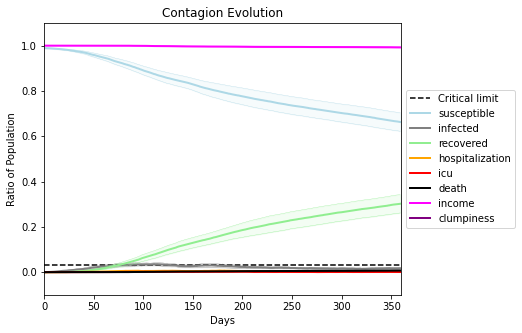

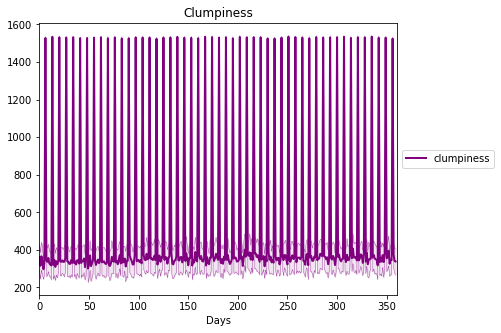

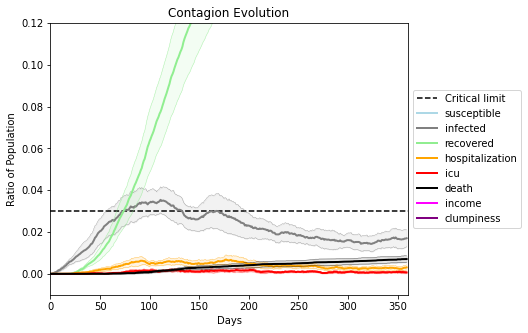

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6450, 4291, 6401, 6211, 8673, 315, 7317, 9520, 2138, 2304, 3256, 6628, 7100, 3277, 9497, 5188, 331, 4293, 2094, 2056]
Average similarity between family members is 0.9346724009864628 at temperature -0.993
Average similarity between family and home is 0.9998402365735958 at temperature -1
Average similarity between students and their classroom is 0.8682554297814634 at temperature -0.993
Average classroom occupancy is 1.5351351351351352 and number classrooms is 185
Average similarity between workers is 0.8681745732304377 at temperature -0.993
Average office occupancy is 3.3383838383838382 and number offices is 198
Average friend similarity for adults: 0.8491662982655522 for kids: 0.7100867131734878
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.446261180559589
avg restaurant similarity 0.7331731743981521
avg restaurant similarity 0.27035189415943217
avg restaurant similarity 0.5556853742753101
avg restaurant similarity 0.5580452239373228
avg restaurant similarity 0.5823041086560203
avg restaurant similarity 0.5367703730970368
avg restaurant similarity 0.7093371663732344
avg restaurant similarity 0.49131390330805236
avg restaurant similarity 0.565625957910896
avg restaurant similarity 0.5694116411743859
avg restaurant similarity 0.6272658197946948
avg restaurant similarity 0.4423419524658292
avg restaurant similarity 0.5909003783149022
avg restaurant similarity 0.6691586973159761
avg restaurant similarity 0.6339911464008802
avg restaurant similarity 0.6360503125515719
avg restaurant similarity 0.6016367702943175
avg restaurant similarity 0.6465546228704308
avg restaurant similarity 0.33353432428167046
avg restaurant similarity 0.6018439928757524
avg restaurant similarity 0.6145397210481732
avg resta

avg restaurant similarity 0.62495695830744
avg restaurant similarity 0.6535165431716599
avg restaurant similarity 0.5851890391182671
avg restaurant similarity 0.5132611353573558
avg restaurant similarity 0.46788189687343484
avg restaurant similarity 0.7295267560135801
avg restaurant similarity 0.5160932117841834
avg restaurant similarity 0.7141816398189127
avg restaurant similarity 0.5641763334702452
avg restaurant similarity 0.46625914456641726
avg restaurant similarity 0.8623426888194123
avg restaurant similarity 0.699205677717543
avg restaurant similarity 0.6931070776614578
avg restaurant similarity 0.4412240111993883
avg restaurant similarity 0.6872212937488433
avg restaurant similarity 0.5509772882752322
avg restaurant similarity 0.4368935540506306
avg restaurant similarity 0.6589365812551331
avg restaurant similarity 0.27284268562933234
avg restaurant similarity 0.5147368367711255
avg restaurant similarity 0.5030795141184152
avg restaurant similarity 0.6986305635113712
avg restau

avg restaurant similarity 0.6766009129892375
avg restaurant similarity 0.5235167302592958
avg restaurant similarity 0.5236924960452338
avg restaurant similarity 0.6045081409102498
avg restaurant similarity 0.6115520420128345
avg restaurant similarity 0.7696800876577864
avg restaurant similarity 0.3735410007820956
avg restaurant similarity 0.3601655286305652
avg restaurant similarity 0.4690139099250955
avg restaurant similarity 0.708713120380155
avg restaurant similarity 0.5983073852839332
avg restaurant similarity 0.7706810387100588
avg restaurant similarity 0.38398870753353365
avg restaurant similarity 0.5488103041597777
avg restaurant similarity 0.37175879879579954
avg restaurant similarity 0.42377124375667097
avg restaurant similarity 0.6297909620907389
avg restaurant similarity 0.5243703933254779
avg restaurant similarity 0.4789620665811505
avg restaurant similarity 0.6111630792392576
avg restaurant similarity 0.6533547586988498
avg restaurant similarity 0.5365193368843111
avg rest

avg restaurant similarity 0.33568562065356167
avg restaurant similarity 0.48281098254268834
avg restaurant similarity 0.5155779150519052
avg restaurant similarity 0.5305781079912492
avg restaurant similarity 0.5089827896309519
avg restaurant similarity 0.5790528957830053
avg restaurant similarity 0.3125332693149183
avg restaurant similarity 0.7907715124651733
avg restaurant similarity 0.5577480199139668
avg restaurant similarity 0.4343249452782739
avg restaurant similarity 0.39279511695827357
avg restaurant similarity 0.4819317453060781
avg restaurant similarity 0.327814514511938
avg restaurant similarity 0.41260530967056375
avg restaurant similarity 0.5291087337203549
avg restaurant similarity 0.3178713529004851
avg restaurant similarity 0.37325332865001687
avg restaurant similarity 0.48538988532794797
avg restaurant similarity 0.4073359204931293
avg restaurant similarity 0.40889857723237416
avg restaurant similarity 0.4564649058528059
avg restaurant similarity 0.6903420092652666
avg 

Average similarity between workers is 0.8643418842027694 at temperature -0.993
Average office occupancy is 3.4512820512820515 and number offices is 195
Average friend similarity for adults: 0.841206495993247 for kids: 0.7203903883576619
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 peop

avg restaurant similarity 0.841030214399296
avg restaurant similarity 0.39570470547565023
avg restaurant similarity 0.5970660682042106
avg restaurant similarity 0.5737508833453977
avg restaurant similarity 0.49414448816724205
avg restaurant similarity 0.6516164699898341
avg restaurant similarity 0.5723917228610318
avg restaurant similarity 0.7019198620556649
avg restaurant similarity 0.5296528851214125
avg restaurant similarity 0.7436365980265285
avg restaurant similarity 0.57349772077269
avg restaurant similarity 0.6652186811349605
avg restaurant similarity 0.6301958294951927
avg restaurant similarity 0.5119184294883826
avg restaurant similarity 0.3657591074283035
avg restaurant similarity 0.472432387738334
avg restaurant similarity 0.4429652261224856
avg restaurant similarity 0.5757752947911129
avg restaurant similarity 0.5063182563719172
avg restaurant similarity 0.5506649255232537
avg restaurant similarity 0.4603384235388455
avg restaurant similarity 0.37607216827521883
avg restaur

avg restaurant similarity 0.5605382960003201
avg restaurant similarity 0.4579582585456434
avg restaurant similarity 0.4526972447873455
avg restaurant similarity 0.4658607783277574
avg restaurant similarity 0.31343958678678246
avg restaurant similarity 0.40381477950949674
avg restaurant similarity 0.49031029550412064
avg restaurant similarity 0.6803755842210718
avg restaurant similarity 0.4796180975144399
avg restaurant similarity 0.5986356523599745
avg restaurant similarity 0.5584749399201394
avg restaurant similarity 0.38047748666907744
avg restaurant similarity 0.4949656954534573
avg restaurant similarity 0.6118915010590078
avg restaurant similarity 0.6142388888830795
avg restaurant similarity 0.39676387057755996
avg restaurant similarity 0.4776684657765098
avg restaurant similarity 0.4901862527464288
avg restaurant similarity 0.4796426601905006
avg restaurant similarity 0.3068069271858353
avg restaurant similarity 0.5333153263272207
avg restaurant similarity 0.6334864475124485
avg r

Average friend similarity for adults: 0.8338315468717824 for kids: 0.705685189976133
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated 

avg restaurant similarity 0.39606532734388283
avg restaurant similarity 0.4687534662400026
avg restaurant similarity 0.5343505251262183
avg restaurant similarity 0.5885164544697699
avg restaurant similarity 0.47656683961567786
avg restaurant similarity 0.6106329197283659
avg restaurant similarity 0.29033823600039294
avg restaurant similarity 0.3522092320355063
avg restaurant similarity 0.46950379500846284
avg restaurant similarity 0.5403880882122837
avg restaurant similarity 0.4740169356557394
avg restaurant similarity 0.4042762394009202
avg restaurant similarity 0.36448831605427595
avg restaurant similarity 0.5501550670728599
avg restaurant similarity 0.40874534624405345
avg restaurant similarity 0.5724506194481026
avg restaurant similarity 0.999875860305459
avg restaurant similarity 0.43901124234202554
avg restaurant similarity 0.4868098329898084
avg restaurant similarity 0.5066170555335694
avg restaurant similarity 0.6136797784954235
avg restaurant similarity 0.581425662339722
avg r

avg restaurant similarity 0.6257188050515101
avg restaurant similarity 0.5050089646833877
avg restaurant similarity 0.8119307911369564
avg restaurant similarity 0.4274762224079489
avg restaurant similarity 0.48822567597140243
avg restaurant similarity 0.757963208211309
avg restaurant similarity 0.5076450268618286
avg restaurant similarity 0.489849413977294
avg restaurant similarity 0.45891651770174396
avg restaurant similarity 0.2684455522988996
avg restaurant similarity 0.47458110458232944
avg restaurant similarity 0.5731170094559278
avg restaurant similarity 0.5565620231532755
avg restaurant similarity 0.4782917055657377
avg restaurant similarity 0.46416830705132145
avg restaurant similarity 0.46238654524892375
avg restaurant similarity 0.3916913521939907
avg restaurant similarity 0.5550089909884913
avg restaurant similarity 0.4789663330184785
avg restaurant similarity 0.5253867447499261
avg restaurant similarity 0.5431674183787499
avg restaurant similarity 0.5717112553125202
avg res

Average similarity between workers is 0.8649359544976688 at temperature -0.993
Average office occupancy is 3.3897435897435897 and number offices is 195
Average friend similarity for adults: 0.8466208478241573 for kids: 0.7206354425178869
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.6396354188733452
avg restaurant similarity 0.4731246941739799
avg restaurant similarity 0.612129496820225
avg restaurant similarity 0.7795500674052808
avg restaurant similarity 0.630049714213555
avg restaurant similarity 0.4363009797195834
avg restaurant similarity 0.5452047675521821
avg restaurant similarity 0.5843897307469279
avg restaurant similarity 0.6375951864843079
avg restaurant similarity 0.5111257874992965
avg restaurant similarity 0.3604551689436843
avg restaurant similarity 0.49125043338777474
avg restaurant similarity 0.8837299920552005
avg restaurant similarity 0.37751293752341053
avg restaurant similarity 0.5517226341216681
avg restaurant similarity 0.5052439154039183
avg restaurant similarity 0.6319016746667054
avg restaurant similarity 0.7685021371941563
avg restaurant similarity 0.5757809189306955
avg restaurant similarity 0.7152947183661859
avg restaurant similarity 0.5702147111440337
avg restaurant similarity 0.559456115390401
avg restaur

avg restaurant similarity 0.5614006581504895
avg restaurant similarity 0.5205504506496774
avg restaurant similarity 0.5897367659827455
avg restaurant similarity 0.4735535991132669
avg restaurant similarity 0.6447154082431149
avg restaurant similarity 0.6342494447945923
avg restaurant similarity 0.682492676862897
avg restaurant similarity 0.9110621275966071
avg restaurant similarity 0.5995147661111829
avg restaurant similarity 0.6114031382225275
avg restaurant similarity 0.5411136326088085
avg restaurant similarity 0.5881131768162706
avg restaurant similarity 0.5362959756060925
avg restaurant similarity 0.5638242335388062
avg restaurant similarity 0.5884199002727356
avg restaurant similarity 0.5354983787464587
avg restaurant similarity 0.5506061716345847
avg restaurant similarity 0.3338678230100075
avg restaurant similarity 0.6675523835112575
avg restaurant similarity 0.630832399870613
avg restaurant similarity 0.5297146304937916
avg restaurant similarity 0.5057622660734995
avg restaura

avg restaurant similarity 0.5718349597490741
avg restaurant similarity 0.4760885557465381
avg restaurant similarity 0.5014133697427795
avg restaurant similarity 0.610125511816409
avg restaurant similarity 0.6493287558401878
avg restaurant similarity 0.7713472235731963
avg restaurant similarity 0.6156274221899619
avg restaurant similarity 0.6055122490370247
avg restaurant similarity 0.566373355183407
avg restaurant similarity 0.5536279149963061
avg restaurant similarity 0.7353995958054608
avg restaurant similarity 0.4529247735578163
avg restaurant similarity 0.48688432143076643
avg restaurant similarity 0.45353148837966706
avg restaurant similarity 0.5784958821870231
avg restaurant similarity 0.4409662856286926
avg restaurant similarity 0.7945977221159424
avg restaurant similarity 0.4952803785014236
avg restaurant similarity 0.4649536083360182
avg restaurant similarity 0.5385845503158541
avg restaurant similarity 0.5467768969554285
avg restaurant similarity 0.4991774175705725
avg restau

avg restaurant similarity 0.6106899808984695
avg restaurant similarity 0.8352793645255876
avg restaurant similarity 0.5512005207180373
avg restaurant similarity 0.5375908299790456
avg restaurant similarity 0.6395155825677667
avg restaurant similarity 0.6052158972069597
avg restaurant similarity 0.5601534148152925
avg restaurant similarity 0.5814709488494589
avg restaurant similarity 0.4995664411845676
avg restaurant similarity 0.5281297468274962
avg restaurant similarity 0.7123117882033347
avg restaurant similarity 0.7117049702996128
avg restaurant similarity 0.6863647227569828
avg restaurant similarity 0.7115785487794304
avg restaurant similarity 0.7048215679335492
avg restaurant similarity 0.6657057709002915
avg restaurant similarity 0.6626291791616393
avg restaurant similarity 0.6109360952014972
avg restaurant similarity 0.6814357282936363
avg restaurant similarity 0.5623717869881465
avg restaurant similarity 0.5384015894896458
avg restaurant similarity 0.48297770393303796
avg resta

Average similarity between workers is 0.8763186656054601 at temperature -0.993
Average office occupancy is 3.4742268041237114 and number offices is 194
Average friend similarity for adults: 0.8554128548249416 for kids: 0.7216669472353102
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.5148373486646528
avg restaurant similarity 0.7389759900196066
avg restaurant similarity 0.8413622877060932
avg restaurant similarity 0.8189524266181228
avg restaurant similarity 0.6878953844901238
avg restaurant similarity 0.7806137892466499
avg restaurant similarity 0.731841961367792
avg restaurant similarity 0.616412498987295
avg restaurant similarity 0.7741820845320966
avg restaurant similarity 0.6373523826795843
avg restaurant similarity 0.6504832194046128
avg restaurant similarity 0.6659217853149032
avg restaurant similarity 0.7104405079250404
avg restaurant similarity 0.7155454848195152
avg restaurant similarity 0.6653436818413302
avg restaurant similarity 0.5575293389937191
avg restaurant similarity 0.6834085441542826
avg restaurant similarity 0.6438789456800234
avg restaurant similarity 0.6647760716732442
avg restaurant similarity 0.6096683416124633
avg restaurant similarity 0.7396986429737957
avg restaurant similarity 0.7182136140022013
avg restaura

avg restaurant similarity 0.7461271441997112
avg restaurant similarity 0.723906292611475
avg restaurant similarity 0.6448982613005116
avg restaurant similarity 0.7056946732602097
avg restaurant similarity 0.766317596570312
avg restaurant similarity 0.6480921577285386
avg restaurant similarity 0.8626253030591631
avg restaurant similarity 0.6058999999125935
avg restaurant similarity 0.6675435418066454
avg restaurant similarity 0.6910561276295368
avg restaurant similarity 0.6017154090158773
avg restaurant similarity 0.5598718112368293
avg restaurant similarity 0.6809069156481882
avg restaurant similarity 0.6180424194499039
avg restaurant similarity 0.7706305029588585
avg restaurant similarity 0.6545169415218283
avg restaurant similarity 0.7075039103078901
avg restaurant similarity 0.520630683245201
avg restaurant similarity 0.6836367392499535
avg restaurant similarity 0.5600946186553151
avg restaurant similarity 0.6489221901903196
avg restaurant similarity 0.7435834672215491
avg restauran

avg restaurant similarity 0.5232145728380645
avg restaurant similarity 0.4863200511103969
avg restaurant similarity 0.5407400704924745
avg restaurant similarity 0.660830118981622
avg restaurant similarity 0.5002228196436104
avg restaurant similarity 0.5373827002665429
avg restaurant similarity 0.6443491403797762
avg restaurant similarity 0.40842174457683844
avg restaurant similarity 0.5533082042936395
avg restaurant similarity 0.6401024818791232
avg restaurant similarity 0.5020160922281883
avg restaurant similarity 0.5337197826247786
avg restaurant similarity 0.43502589209128306
avg restaurant similarity 0.40532080026742207
avg restaurant similarity 0.4942987179635178
avg restaurant similarity 0.3946475281262065
avg restaurant similarity 0.4222308241039409
avg restaurant similarity 0.44045091105206524
avg restaurant similarity 0.4183350491024652
avg restaurant similarity 0.7292075924667265
avg restaurant similarity 0.3389098659854529
avg restaurant similarity 0.6701204065763434
avg res

avg restaurant similarity 0.4036196711693509
avg restaurant similarity 0.5786931283141048
avg restaurant similarity 0.40919194730809466
avg restaurant similarity 0.37035512236836743
avg restaurant similarity 0.47196102031512843
avg restaurant similarity 0.47675662669050994
avg restaurant similarity 0.5224590685845935
avg restaurant similarity 0.6000061684200797
avg restaurant similarity 0.5699913078626048
avg restaurant similarity 0.7022914788361818
avg restaurant similarity 0.7353872316831433
avg restaurant similarity 0.4300846723968107
avg restaurant similarity 0.6145717988364724
avg restaurant similarity 0.9371206957552558
avg restaurant similarity 0.4508551035906919
avg restaurant similarity 0.6669963977708196
avg restaurant similarity 0.43179563581315517
avg restaurant similarity 0.3350563866538245
avg restaurant similarity 0.5686252175285076
avg restaurant similarity 0.5516961743284694
avg restaurant similarity 0.7593326885427494
avg restaurant similarity 0.8844562781298375
avg r

Average similarity between workers is 0.8657105141644624 at temperature -0.993
Average office occupancy is 3.4473684210526314 and number offices is 190
Average friend similarity for adults: 0.8480289255365979 for kids: 0.7343913146575435
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.7746683024024531
avg restaurant similarity 0.6300394598048966
avg restaurant similarity 0.49175791647177397
avg restaurant similarity 0.603612605957569
avg restaurant similarity 0.3774571362891524
avg restaurant similarity 0.5367664413509164
avg restaurant similarity 0.5649874271938737
avg restaurant similarity 0.49579359503990916
avg restaurant similarity 0.5118773799194569
avg restaurant similarity 0.5435324500230406
avg restaurant similarity 0.5814036900417691
avg restaurant similarity 0.5636317799436774
avg restaurant similarity 0.4587865282219581
avg restaurant similarity 0.46645767554194484
avg restaurant similarity 0.4377320446882988
avg restaurant similarity 0.5895791746172924
avg restaurant similarity 0.5980272298429217
avg restaurant similarity 0.5340811286718623
avg restaurant similarity 0.5355209997329756
avg restaurant similarity 0.680581479789843
avg restaurant similarity 0.4939235576996386
avg restaurant similarity 0.632084468283788
avg restau

avg restaurant similarity 0.4679539593770581
avg restaurant similarity 0.40653551838946894
avg restaurant similarity 0.43118416034451773
avg restaurant similarity 0.4751070327681217
avg restaurant similarity 0.6243110164176183
avg restaurant similarity 0.4754040447673158
avg restaurant similarity 0.5556340488617668
avg restaurant similarity 0.4095445257984157
avg restaurant similarity 0.5824231985777977
avg restaurant similarity 0.5473449471002726
avg restaurant similarity 0.514390164222368
avg restaurant similarity 0.5616964290776577
avg restaurant similarity 0.649637597894792
avg restaurant similarity 0.8225773389454594
avg restaurant similarity 0.4868187787083998
avg restaurant similarity 0.53875822230198
avg restaurant similarity 0.4841448974086763
avg restaurant similarity 0.5641980763789343
avg restaurant similarity 0.46001894443862645
avg restaurant similarity 0.5488534399500409
avg restaurant similarity 0.5425832105930554
avg restaurant similarity 0.5373210646496516
avg restaur

Average friend similarity for adults: 0.8336145336465971 for kids: 0.7163506312155966
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.3346655982708303
avg restaurant similarity 0.5940024608895852
avg restaurant similarity 0.3323119685105492
avg restaurant similarity 0.46679508358251154
avg restaurant similarity 0.5712614150860538
avg restaurant similarity 0.5982786153432238
avg restaurant similarity 0.4764577610841831
avg restaurant similarity 0.502629371672199
avg restaurant similarity 0.48628682472897666
avg restaurant similarity 0.498527345399455
avg restaurant similarity 0.3781633160208349
avg restaurant similarity 0.5836696801667645
avg restaurant similarity 0.5271931096590321
avg restaurant similarity 0.4433061166809343
avg restaurant similarity 0.5814400394908736
avg restaurant similarity 0.39617119320281563
avg restaurant similarity 0.4312990188413698
avg restaurant similarity 0.3686303035090253
avg restaurant similarity 0.565257845023871
avg restaurant similarity 0.44131189282848066
avg restaurant similarity 0.5850732211629717
avg restaurant similarity 0.4987526656751641
avg resta

avg restaurant similarity 0.42667605818870746
avg restaurant similarity 0.6578659537114935
avg restaurant similarity 0.5453350489115939
avg restaurant similarity 0.5255547983136934
avg restaurant similarity 0.37873855299620407
avg restaurant similarity 0.5524491331267435
avg restaurant similarity 0.4485576346188277
avg restaurant similarity 0.4653940177666933
avg restaurant similarity 0.4350043270986212
avg restaurant similarity 0.4386841252369259
avg restaurant similarity 0.5750704805096231
avg restaurant similarity 0.47443143932406806
avg restaurant similarity 0.6236902427313662
avg restaurant similarity 0.48357342623172783
avg restaurant similarity 0.44405956786094725
avg restaurant similarity 0.7709316146153881
avg restaurant similarity 0.46656149086390275
avg restaurant similarity 0.5991348364294599
avg restaurant similarity 0.5787336884678291
avg restaurant similarity 0.5248317676300782
avg restaurant similarity 0.41717540600219094
avg restaurant similarity 0.3270931150428145
avg

Average similarity between workers is 0.8797955725955778 at temperature -0.993
Average office occupancy is 3.5103092783505154 and number offices is 194
Average friend similarity for adults: 0.8526842918034362 for kids: 0.7125787765273354
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.7594934280012503
avg restaurant similarity 0.7223818193759167
avg restaurant similarity 0.6546074538522564
avg restaurant similarity 0.5978449389193241
avg restaurant similarity 0.5932501873246228
avg restaurant similarity 0.6195329749534738
avg restaurant similarity 0.6271797662639371
avg restaurant similarity 0.757896076439803
avg restaurant similarity 0.9997716428492307
avg restaurant similarity 0.6817505990637932
avg restaurant similarity 0.6619719809319847
avg restaurant similarity 0.6600488645719834
avg restaurant similarity 0.5411871206122822
avg restaurant similarity 0.4769238101668771
avg restaurant similarity 0.5509529959020223
avg restaurant similarity 0.5914732224833434
avg restaurant similarity 0.6230322898026553
avg restaurant similarity 0.7704258018555764
avg restaurant similarity 0.5944051730009032
avg restaurant similarity 0.6387356768984925
avg restaurant similarity 0.6522900717215767
avg restaurant similarity 0.5898440118109975
avg restaur

avg restaurant similarity 0.48932139823158405
avg restaurant similarity 0.9298502232114829
avg restaurant similarity 0.7389067596571044
avg restaurant similarity 0.6908730304932316
avg restaurant similarity 0.42166121189185896
avg restaurant similarity 0.630577008005338
avg restaurant similarity 0.899898052928414
avg restaurant similarity 0.46875383957840777
avg restaurant similarity 0.5239718367652421
avg restaurant similarity 0.7462602930047781
avg restaurant similarity 0.6223268613365579
avg restaurant similarity 0.7035579036864281
avg restaurant similarity 0.6303719244471253
avg restaurant similarity 0.7748398460087738
avg restaurant similarity 0.6012387503317365
avg restaurant similarity 0.6907567765646974
avg restaurant similarity 0.679164586019351
avg restaurant similarity 0.5834308142874737
avg restaurant similarity 0.356767774994432
avg restaurant similarity 0.5999806480899671
avg restaurant similarity 0.6359322415227238
avg restaurant similarity 0.5210246979841613
avg restaur

Average friend similarity for adults: 0.8501272297103931 for kids: 0.7210957247926408
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated uni

avg restaurant similarity 0.47645283441003944
avg restaurant similarity 0.7934511367893375
avg restaurant similarity 0.8029399968593521
avg restaurant similarity 0.4507462239468351
avg restaurant similarity 0.6987768673191219
avg restaurant similarity 0.644344274492404
avg restaurant similarity 0.7637480226775138
avg restaurant similarity 0.6851509891082584
avg restaurant similarity 0.4004184810866209
avg restaurant similarity 0.43922839997052
avg restaurant similarity 0.5728815670465134
avg restaurant similarity 0.48773355396993
avg restaurant similarity 0.4429519487140056
avg restaurant similarity 0.28564161074155614
avg restaurant similarity 0.5293013884303602
avg restaurant similarity 0.4559699786861007
avg restaurant similarity 0.5650383598439707
avg restaurant similarity 0.46999953987855164
avg restaurant similarity 0.5877619271574175
avg restaurant similarity 0.5221146912580441
avg restaurant similarity 0.5633028839724562
avg restaurant similarity 0.5295700784679993
avg restaura

avg restaurant similarity 0.9998211113991702
avg restaurant similarity 0.5242389296918989
avg restaurant similarity 0.37931084039591556
avg restaurant similarity 0.45432982957690937
avg restaurant similarity 0.43919124411657895
avg restaurant similarity 0.4871283008427836
avg restaurant similarity 0.695149204421758
avg restaurant similarity 0.4261814578508578
avg restaurant similarity 0.4752099857891667
avg restaurant similarity 0.5250529195627907
avg restaurant similarity 0.6552964062990031
avg restaurant similarity 0.6425886941127588
avg restaurant similarity 0.47656331366748406
avg restaurant similarity 0.423080473593459
avg restaurant similarity 0.610550367439177
avg restaurant similarity 0.5483293469622641
avg restaurant similarity 0.38075171582107814
avg restaurant similarity 0.567614410307094
avg restaurant similarity 0.508849729600689
avg restaurant similarity 0.5417568687893703
avg restaurant similarity 0.32284115159700616
avg restaurant similarity 0.593285903848056
avg restau

avg restaurant similarity 0.507171502933063
avg restaurant similarity 0.6010628777836615
avg restaurant similarity 0.5518908069101149
avg restaurant similarity 0.5723116675504241
avg restaurant similarity 0.5801512678686634
avg restaurant similarity 0.4380236458408632
avg restaurant similarity 0.5848040943208987
avg restaurant similarity 0.6133259275222244
avg restaurant similarity 0.5319711315838175
avg restaurant similarity 0.6883053940530637
avg restaurant similarity 0.5295396012436275
avg restaurant similarity 0.4358352360441569
avg restaurant similarity 0.6284890611170248
avg restaurant similarity 0.5086494866476595
avg restaurant similarity 0.5673789817299877
avg restaurant similarity 0.49648652800220816
avg restaurant similarity 0.6284362956770113
avg restaurant similarity 0.5090640870110759
avg restaurant similarity 0.3757757718884304
avg restaurant similarity 0.42909617794322835
avg restaurant similarity 0.621344122232302
avg restaurant similarity 0.8934266456397729
avg restau

avg restaurant similarity 0.5133187686334393
avg restaurant similarity 0.28731842179425243
avg restaurant similarity 0.5151534540697201
avg restaurant similarity 0.5833376364808431
avg restaurant similarity 0.6227745157399132
avg restaurant similarity 0.5638275867974809
avg restaurant similarity 0.33449413639938824
avg restaurant similarity 0.4702701683967385
avg restaurant similarity 0.6180004321337212
avg restaurant similarity 0.5250883198576177
avg restaurant similarity 0.5411369909035546
avg restaurant similarity 0.416352361218612
avg restaurant similarity 0.4422685236552038
avg restaurant similarity 0.52212332068525
avg restaurant similarity 0.655224797762143
avg restaurant similarity 0.33684962560502485
avg restaurant similarity 0.5453453847115891
avg restaurant similarity 0.5524770795982199
avg restaurant similarity 0.6978043496717127
avg restaurant similarity 0.3743121529255461
avg restaurant similarity 0.4503020069021557
avg restaurant similarity 0.5384699644254678
avg restaur

avg restaurant similarity 0.7582857740500069
avg restaurant similarity 0.5311565764232965
avg restaurant similarity 0.4691656085952739
avg restaurant similarity 0.5617784277941089
avg restaurant similarity 0.5473720971354268
avg restaurant similarity 0.5841562937382437
avg restaurant similarity 0.6084761952026156
avg restaurant similarity 0.31727615419250127
avg restaurant similarity 0.6496544027874431
avg restaurant similarity 0.6254639743498795
avg restaurant similarity 0.5458233558522473
avg restaurant similarity 0.5812323917180973
avg restaurant similarity 0.474963992027367
avg restaurant similarity 0.7072103357358313
avg restaurant similarity 0.5240511325535021
avg restaurant similarity 0.4857367127726852
avg restaurant similarity 0.5369621596819782
avg restaurant similarity 0.9034492500590741
avg restaurant similarity 0.6498925181648094
avg restaurant similarity 0.662199627151798
avg restaurant similarity 0.6502497926931712
avg restaurant similarity 0.5110799652642356
avg restaur

avg restaurant similarity 0.37288577257825595
avg restaurant similarity 0.5628321403876544
avg restaurant similarity 0.44416358060293515
avg restaurant similarity 0.6045354525676032
avg restaurant similarity 0.7520351939845411
avg restaurant similarity 0.45448090798681146
avg restaurant similarity 0.5437443501010236
avg restaurant similarity 0.3265029169802647
avg restaurant similarity 0.5035979597220325
avg restaurant similarity 0.35048383902399594
avg restaurant similarity 0.6549684698193146
avg restaurant similarity 0.8063344475591288
avg restaurant similarity 0.8527795992713374
avg restaurant similarity 0.6477486963335883
avg restaurant similarity 0.45658680716604927
avg restaurant similarity 0.434988855642936
avg restaurant similarity 0.5823029188259091
avg restaurant similarity 0.7519675110620627
avg restaurant similarity 0.4249059258163261
avg restaurant similarity 0.9996820133079567
avg restaurant similarity 0.7711415324669461
avg restaurant similarity 0.6255721296331129
avg re

avg restaurant similarity 0.5536510595541108
avg restaurant similarity 0.5982493037551055
avg restaurant similarity 0.5630099558682289
avg restaurant similarity 0.6975485798281601
avg restaurant similarity 0.6923922359814724
avg restaurant similarity 0.5474118721391016
avg restaurant similarity 0.45001121607993677
avg restaurant similarity 0.5201597412042805
avg restaurant similarity 0.7201244036088266
avg restaurant similarity 0.6636491401507719
avg restaurant similarity 0.7834505395868024
avg restaurant similarity 0.5640625513495021
avg restaurant similarity 0.5934887812548931
avg restaurant similarity 0.5246165493232602
avg restaurant similarity 0.49964865894969684
avg restaurant similarity 0.6305074360105476
avg restaurant similarity 0.6111791201006956
avg restaurant similarity 0.5766656928465398
avg restaurant similarity 0.7170597516744246
avg restaurant similarity 0.6135857049262526
avg restaurant similarity 0.7481952670133448
avg restaurant similarity 0.6720248366797772
avg rest

avg restaurant similarity 0.604997844891122
avg restaurant similarity 0.6542178274433583
avg restaurant similarity 0.8374572151663034
avg restaurant similarity 0.5689123796896592
avg restaurant similarity 0.6469566175357404
avg restaurant similarity 0.6462034582561001
avg restaurant similarity 0.706764131011688
avg restaurant similarity 0.786758028235236
avg restaurant similarity 0.4873038323275383
avg restaurant similarity 0.45835232505968937
avg restaurant similarity 0.5668119607240494
avg restaurant similarity 0.6911072320764765
avg restaurant similarity 0.5139572558713795
avg restaurant similarity 0.5344529369278144
avg restaurant similarity 0.730140174742468
avg restaurant similarity 0.551573061681401
avg restaurant similarity 0.6069943000057494
avg restaurant similarity 0.6578688543382222
avg restaurant similarity 0.566510029259681
avg restaurant similarity 0.46870776456295765
avg restaurant similarity 0.1819348502599571
avg restaurant similarity 0.5818657457057449
avg restaurant

avg restaurant similarity 0.7693270801638347
avg restaurant similarity 0.45900513553480354
avg restaurant similarity 0.3751146349405168
avg restaurant similarity 0.64415082364389
avg restaurant similarity 0.5050241337743765
avg restaurant similarity 0.49030544623091005
avg restaurant similarity 0.4708694845299699
avg restaurant similarity 0.40357925068038214
avg restaurant similarity 0.4969621226271076
avg restaurant similarity 0.5368335696032491
avg restaurant similarity 0.5193620091227926
avg restaurant similarity 0.4694362748497445
avg restaurant similarity 0.5043028745277017
avg restaurant similarity 0.4949750725082602
avg restaurant similarity 0.39545696163952726
avg restaurant similarity 0.540594101863638
avg restaurant similarity 0.6306145312696473
avg restaurant similarity 0.5900548843958674
avg restaurant similarity 0.4653908221007866
avg restaurant similarity 0.5882556252038095
avg restaurant similarity 0.3822421705858368
avg restaurant similarity 0.5063757517932498
avg resta

avg restaurant similarity 0.5016118228012957
avg restaurant similarity 0.5312772574986504
avg restaurant similarity 0.5483674017472941
avg restaurant similarity 0.6428856704067493
avg restaurant similarity 0.4928142434204525
avg restaurant similarity 0.42004853875578363
avg restaurant similarity 0.460284259046354
avg restaurant similarity 0.5566618675600051
avg restaurant similarity 0.460202269468776
avg restaurant similarity 0.534443470956866
avg restaurant similarity 0.5100980003653319
avg restaurant similarity 0.5965368995388368
avg restaurant similarity 0.5068409376751067
avg restaurant similarity 0.41057119420146765
avg restaurant similarity 0.5635737463071895
avg restaurant similarity 0.487644292674273
avg restaurant similarity 0.46006009478618415
avg restaurant similarity 0.5171615740656219
avg restaurant similarity 0.535768333062694
avg restaurant similarity 0.6714667484930761
avg restaurant similarity 0.6101389715946509
avg restaurant similarity 0.4697509108307619
avg restaura

Average similarity between workers is 0.8670760004974614 at temperature -0.993
Average office occupancy is 3.3181818181818183 and number offices is 198
Average friend similarity for adults: 0.8520707578589518 for kids: 0.7171702717350755
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 

avg restaurant similarity 0.6249033890425622
avg restaurant similarity 0.45026811019355345
avg restaurant similarity 0.49377497858155156
avg restaurant similarity 0.5844572109109285
avg restaurant similarity 0.6434302864368172
avg restaurant similarity 0.45578733009496114
avg restaurant similarity 0.45286174643477156
avg restaurant similarity 0.49112153661599606
avg restaurant similarity 0.6900635534105791
avg restaurant similarity 0.8414139265961067
avg restaurant similarity 0.5377265858957831
avg restaurant similarity 0.5028743854422763
avg restaurant similarity 0.5886740611850826
avg restaurant similarity 0.5397072157695936
avg restaurant similarity 0.4896565562877505
avg restaurant similarity 0.5574568752748205
avg restaurant similarity 0.49545264154596425
avg restaurant similarity 0.3824005660819538
avg restaurant similarity 0.5311586939165677
avg restaurant similarity 0.5741247176782753
avg restaurant similarity 0.6667248695634299
avg restaurant similarity 0.49633822199356653
avg

avg restaurant similarity 0.4976953233794695
avg restaurant similarity 0.7702427151671258
avg restaurant similarity 0.47712728165968205
avg restaurant similarity 0.44340929462348955
avg restaurant similarity 0.42595666153486583
avg restaurant similarity 0.56859890369545
avg restaurant similarity 0.5783617832943275
avg restaurant similarity 0.6699556265929566
avg restaurant similarity 0.791434375744035
avg restaurant similarity 0.5625420702856843
avg restaurant similarity 0.6094594193892106
avg restaurant similarity 0.4754755239032547
avg restaurant similarity 0.37726480262548096
avg restaurant similarity 0.7826111714581248
avg restaurant similarity 0.4933255309536807
avg restaurant similarity 0.5874258502063484
avg restaurant similarity 0.4809310038022648
avg restaurant similarity 0.43960175037805516
avg restaurant similarity 0.4428449747005096
avg restaurant similarity 0.8469659535376901
avg restaurant similarity 0.7563151270307753
avg restaurant similarity 0.7433937613781612
avg rest

Average friend similarity for adults: 0.8379106350812893 for kids: 0.7120995627452255
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocat

avg restaurant similarity 0.31208348972513233
avg restaurant similarity 0.39606715673601667
avg restaurant similarity 0.5148848148247857
avg restaurant similarity 0.4976903033200158
avg restaurant similarity 0.4697047692382819
avg restaurant similarity 0.4714517421839652
avg restaurant similarity 0.5094380838472201
avg restaurant similarity 0.4723700529828686
avg restaurant similarity 0.7250564018897535
avg restaurant similarity 0.3725792346995434
avg restaurant similarity 0.48860276690362614
avg restaurant similarity 0.5179314654395998
avg restaurant similarity 0.4199594874817683
avg restaurant similarity 0.350814717903988
avg restaurant similarity 0.5134444836525832
avg restaurant similarity 0.39512032592196045
avg restaurant similarity 0.36413622247904115
avg restaurant similarity 0.4165920706374425
avg restaurant similarity 0.52336268521262
avg restaurant similarity 0.4751083936601312
avg restaurant similarity 0.650025304235822
avg restaurant similarity 0.4136442688598196
avg resta

avg restaurant similarity 0.5719837010054712
avg restaurant similarity 0.44458700863370804
avg restaurant similarity 0.5660886933741816
avg restaurant similarity 0.4372294265243728
avg restaurant similarity 0.5177971504436379
avg restaurant similarity 0.378896050571948
avg restaurant similarity 0.45173460486490935
avg restaurant similarity 0.5137006077357099
avg restaurant similarity 0.5374924295420405
avg restaurant similarity 0.3604354489914321
avg restaurant similarity 0.5728634455167227
avg restaurant similarity 0.5846732367626909
avg restaurant similarity 0.47020080788770896
avg restaurant similarity 0.5173323983055919
avg restaurant similarity 0.5063043357323493
avg restaurant similarity 0.26117510958245665
avg restaurant similarity 0.45276462425523106
avg restaurant similarity 0.5257669714388602
avg restaurant similarity 0.49185820171123673
avg restaurant similarity 0.5036734608354312
avg restaurant similarity 0.5259195051567984
avg restaurant similarity 0.8361879275606913
avg r

Average similarity between workers is 0.8557067307273174 at temperature -0.993
Average office occupancy is 3.4659685863874348 and number offices is 191
Average friend similarity for adults: 0.8416057170857942 for kids: 0.7261293865754567
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.5530026301894305
avg restaurant similarity 0.5100451678081094
avg restaurant similarity 0.40934630850346376
avg restaurant similarity 0.4850944059463389
avg restaurant similarity 0.4211917304809065
avg restaurant similarity 0.5941285119950825
avg restaurant similarity 0.6272238062299592
avg restaurant similarity 0.5048669385922256
avg restaurant similarity 0.5685535018907536
avg restaurant similarity 0.6907784088982366
avg restaurant similarity 0.5073013623225984
avg restaurant similarity 0.4411272350017845
avg restaurant similarity 0.5456431270606183
avg restaurant similarity 0.4786973377426273
avg restaurant similarity 0.5465093869125797
avg restaurant similarity 0.6874041608647641
avg restaurant similarity 0.8176094548962737
avg restaurant similarity 0.5212774697363346
avg restaurant similarity 0.5073256874384668
avg restaurant similarity 0.744862014008453
avg restaurant similarity 0.39369044729712976
avg restaurant similarity 0.5485921535891434
avg resta

avg restaurant similarity 0.41088820153354644
avg restaurant similarity 0.8602391519152415
avg restaurant similarity 0.5001044310210669
avg restaurant similarity 0.5636953356133851
avg restaurant similarity 0.4112890602843773
avg restaurant similarity 0.5518811121139761
avg restaurant similarity 0.5918553931923731
avg restaurant similarity 0.43457484104786515
avg restaurant similarity 0.6233650803720187
avg restaurant similarity 0.48823510527100067
avg restaurant similarity 0.5599607867201921
avg restaurant similarity 0.46613429327564004
avg restaurant similarity 0.43570583836819177
avg restaurant similarity 0.5216715648825943
avg restaurant similarity 0.7509776154800575
avg restaurant similarity 0.44394713877512126
avg restaurant similarity 0.6734892150832236
avg restaurant similarity 0.2907157810498662
avg restaurant similarity 0.6123942397089632
avg restaurant similarity 0.6285439659617935
avg restaurant similarity 0.4205601320636159
avg restaurant similarity 0.44535013312751676
avg

Average friend similarity for adults: 0.8385238494717879 for kids: 0.7271307892823721
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity 0.6836641746856088
avg restaurant similarity 0.672713903828392
avg restaurant similarity 0.5383294106666964
avg restaurant similarity 0.7050951790203165
avg restaurant similarity 0.6940773181880875
avg restaurant similarity 0.5223286330605879
avg restaurant similarity 0.6114241241636245
avg restaurant similarity 0.5338228462459307
avg restaurant similarity 0.49757673656953844
avg restaurant similarity 0.6008481093798135
avg restaurant similarity 0.5882687939779399
avg restaurant similarity 0.5144911852539511
avg restaurant similarity 0.4384188290289169
avg restaurant similarity 0.7063922674627658
avg restaurant similarity 0.7313074573771599
avg restaurant similarity 0.5930010668103977
avg restaurant similarity 0.625041676065407
avg restaurant similarity 0.6221116360277501
avg restaurant similarity 0.6231727087023051
avg restaurant similarity 0.5755637991074728
avg restaurant similarity 0.5176150362400558
avg restaurant similarity 0.4818634311351152
avg restaur

avg restaurant similarity 0.6102533363936942
avg restaurant similarity 0.7444675600245494
avg restaurant similarity 0.9998250092097993
avg restaurant similarity 0.6495706238802121
avg restaurant similarity 0.7214129450224849
avg restaurant similarity 0.5176286732978165
avg restaurant similarity 0.5832191575747593
avg restaurant similarity 0.5936756912740375
avg restaurant similarity 0.5473304749143361
avg restaurant similarity 0.608604063441366
avg restaurant similarity 0.6382906702822021
avg restaurant similarity 0.604929582493335
avg restaurant similarity 0.4907407750783201
avg restaurant similarity 0.5464843171334038
avg restaurant similarity 0.6720234272097567
avg restaurant similarity 0.5525179028375236
avg restaurant similarity 0.5464859668858231
avg restaurant similarity 0.48100017793657607
avg restaurant similarity 0.45690411961620686
avg restaurant similarity 0.6974045334312969
avg restaurant similarity 0.45855538935506884
avg restaurant similarity 0.5842011592557209
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

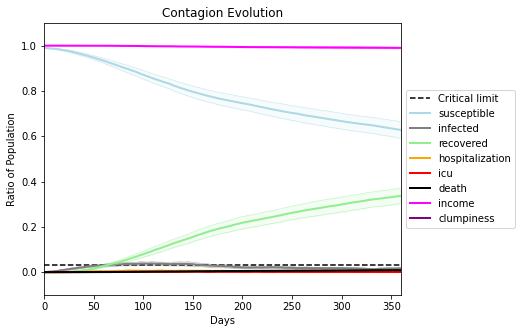

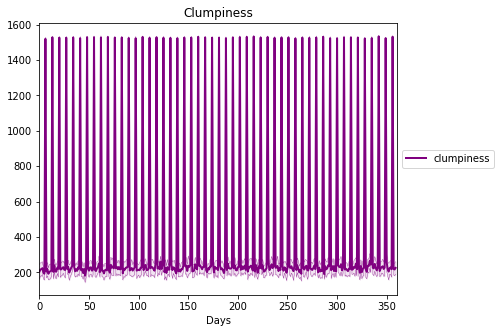

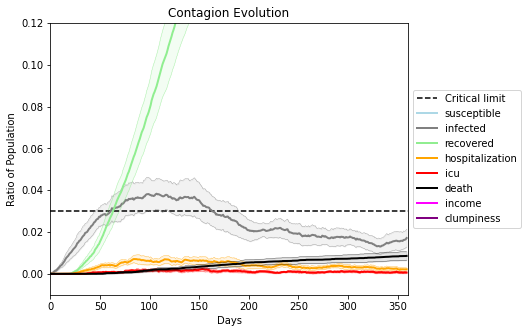

In [12]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8629, 1611, 5126, 664, 967, 2741, 9081, 2403, 7160, 6976, 936, 2580, 4962, 9653, 1812, 5806, 8482, 335, 7295, 217]
Average similarity between family members is 0.926409973314122 at temperature -0.992
Average similarity between family and home is 0.9998520428173423 at temperature -1
Average similarity between students and their classroom is 0.8211525890964793 at temperature -0.992
Average classroom occupancy is 1.6615384615384616 and number classrooms is 195
Average similarity between workers is 0.8482969842425913 at temperature -0.992
Average office occupancy is 3.2722513089005236 and number offices is 191
Average friend similarity for adults: 0.8356520343477226 for kids: 0.7421983927282508
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.5693615393664984
avg restaurant similarity 0.44329285737188473
avg restaurant similarity 0.30736400065410185
avg restaurant similarity 0.6023320810830546
avg restaurant similarity 0.3381341921645441
avg restaurant similarity 0.4392565632779228
avg restaurant similarity 0.5567455030104955
avg restaurant similarity 0.5162445537252159
avg restaurant similarity 0.4973714322796505
avg restaurant similarity 0.46335812863372994
avg restaurant similarity 0.5458282057040593
avg restaurant similarity 0.6130098471612939
avg restaurant similarity 0.47592506315781685
avg restaurant similarity 0.6498739660329784
avg restaurant similarity 0.5550646641243598
avg restaurant similarity 0.539939046265451
avg restaurant similarity 0.6588343303377542
avg restaurant similarity 0.5286591229213129
avg restaurant similarity 0.5241053627280351
avg restaurant similarity 0.37827094853126486
avg restaurant similarity 0.2932731419477892
avg restaurant similarity 0.4872730837670148
avg re

avg restaurant similarity 0.5272463806110153
avg restaurant similarity 0.3568405257032325
avg restaurant similarity 0.4113778862327696
avg restaurant similarity 0.7080678822645404
avg restaurant similarity 0.4453583436438178
avg restaurant similarity 0.6294934318281824
avg restaurant similarity 0.6085080165663751
avg restaurant similarity 0.5108341557845277
avg restaurant similarity 0.3583046551254483
avg restaurant similarity 0.6195837235272188
avg restaurant similarity 0.8312027218758224
avg restaurant similarity 0.44133754441212225
avg restaurant similarity 0.5214401844020871
avg restaurant similarity 0.35596217792029394
avg restaurant similarity 0.6254202626718565
avg restaurant similarity 0.44909186142168944
avg restaurant similarity 0.4755356976516063
avg restaurant similarity 0.36030999134817565
avg restaurant similarity 0.42048578559357663
avg restaurant similarity 0.5758832154778855
avg restaurant similarity 0.5435175935437269
avg restaurant similarity 0.3878547617647117
avg r

avg restaurant similarity 0.44580029182488395
avg restaurant similarity 0.5307998759033863
avg restaurant similarity 0.8305325929006749
avg restaurant similarity 0.45170019333992206
avg restaurant similarity 0.43140717171769366
avg restaurant similarity 0.4978656706218015
avg restaurant similarity 0.4535568060220381
avg restaurant similarity 0.5153784152072213
avg restaurant similarity 0.4359495438902803
avg restaurant similarity 0.5427131245643395
avg restaurant similarity 0.515388241886754
avg restaurant similarity 0.44414803424889754
avg restaurant similarity 0.5743579485378899
avg restaurant similarity 0.3830761283763912
avg restaurant similarity 0.601590402752463
avg restaurant similarity 0.6267046481281598
avg restaurant similarity 0.5042247664818794
avg restaurant similarity 0.44245572729334226
avg restaurant similarity 0.5807694797671841
avg restaurant similarity 0.43450304659760075
avg restaurant similarity 0.5388382476508862
avg restaurant similarity 0.49871479951731684
avg r

avg restaurant similarity 0.44126489874036445
avg restaurant similarity 0.5785903483929299
avg restaurant similarity 0.5224074336557345
avg restaurant similarity 0.7603045778063169
avg restaurant similarity 0.5094517786178274
avg restaurant similarity 0.5364846454110763
avg restaurant similarity 0.5396442128479799
avg restaurant similarity 0.5114052715011439
avg restaurant similarity 0.79500500592565
avg restaurant similarity 0.47577882330108784
avg restaurant similarity 0.5029325156644444
avg restaurant similarity 0.44477888145799493
avg restaurant similarity 0.7986070600092747
avg restaurant similarity 0.40009854561343294
avg restaurant similarity 0.4678794846162642
avg restaurant similarity 0.5048252013833563
avg restaurant similarity 0.32007059895242274
avg restaurant similarity 0.6046980494252634
avg restaurant similarity 0.3527713354078262
avg restaurant similarity 0.6008095260034766
avg restaurant similarity 0.5189142036443667
avg restaurant similarity 0.5110720170489291
avg res

Average similarity between workers is 0.8483091536995737 at temperature -0.992
Average office occupancy is 3.4559585492227978 and number offices is 193
Average friend similarity for adults: 0.8500090547305397 for kids: 0.7212390926619753
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6238601611153572
avg restaurant similarity 0.5872682596444709
avg restaurant similarity 0.7450916537114901
avg restaurant similarity 0.5872685419173794
avg restaurant similarity 0.5924005887609528
avg restaurant similarity 0.5110783373232523
avg restaurant similarity 0.6398061313762475
avg restaurant similarity 0.544695968740418
avg restaurant similarity 0.562986189313661
avg restaurant similarity 0.48321624709401206
avg restaurant similarity 0.6982656167864059
avg restaurant similarity 0.7475487525119588
avg restaurant similarity 0.3717078975455754
avg restaurant similarity 0.6918247580531334
avg restaurant similarity 0.5670706400279903
avg restaurant similarity 0.5807467609551175
avg restaurant similarity 0.5095842844016343
avg restaurant similarity 0.5368448276171576
avg restaurant similarity 0.6582197697480904
avg restaurant similarity 0.4823935269461408
avg restaurant similarity 0.42429690600565695
avg restaurant similarity 0.5318789515459842
avg restau

avg restaurant similarity 0.5736761160161383
avg restaurant similarity 0.6428640218708096
avg restaurant similarity 0.6473574457259448
avg restaurant similarity 0.5402089896773364
avg restaurant similarity 0.5785323429237882
avg restaurant similarity 0.1854022518356183
avg restaurant similarity 0.6913232249178087
avg restaurant similarity 0.5891199786011702
avg restaurant similarity 0.7204664989255187
avg restaurant similarity 0.5236988730723173
avg restaurant similarity 0.9346433329052704
avg restaurant similarity 0.5312271896215198
avg restaurant similarity 0.5393888242200141
avg restaurant similarity 0.6886386720731796
avg restaurant similarity 0.4450353509299414
avg restaurant similarity 0.5905377449000659
avg restaurant similarity 0.9030185309149145
avg restaurant similarity 0.6285830318415571
avg restaurant similarity 0.5407049753631082
avg restaurant similarity 0.5186166143958462
avg restaurant similarity 0.7202463123229039
avg restaurant similarity 0.5558805402457144
avg restau

avg restaurant similarity 0.5534819012185835
avg restaurant similarity 0.6257581093807545
avg restaurant similarity 0.36164026726333104
avg restaurant similarity 0.24876351230284416
avg restaurant similarity 0.5180304328851774
avg restaurant similarity 0.6088587237154722
avg restaurant similarity 0.5182824609152525
avg restaurant similarity 0.44598994988654295
avg restaurant similarity 0.5698400130468291
avg restaurant similarity 0.5127095037312787
avg restaurant similarity 0.5638042617266674
avg restaurant similarity 0.51232945542889
avg restaurant similarity 0.4539149070350513
avg restaurant similarity 0.6392034183701774
avg restaurant similarity 0.5964401578178228
avg restaurant similarity 0.5939596348825918
avg restaurant similarity 0.5214574006921413
avg restaurant similarity 0.5431550964834306
avg restaurant similarity 0.495562546711448
avg restaurant similarity 0.5244302011111378
avg restaurant similarity 0.5582485954652595
avg restaurant similarity 0.5920708780489624
avg restau

avg restaurant similarity 0.4910938176939431
avg restaurant similarity 0.5650532723255013
avg restaurant similarity 0.549630274388748
avg restaurant similarity 0.45126923552430986
avg restaurant similarity 0.4581443296316665
avg restaurant similarity 0.5519343252979565
avg restaurant similarity 0.6251077327189998
avg restaurant similarity 0.4463602769584209
avg restaurant similarity 0.6569056162499146
avg restaurant similarity 0.5395235546595425
avg restaurant similarity 0.7085533567775976
avg restaurant similarity 0.5578291591054587
avg restaurant similarity 0.5724858922328379
avg restaurant similarity 0.6170790551280994
avg restaurant similarity 0.47602553934580083
avg restaurant similarity 0.6439626695489472
avg restaurant similarity 0.5935884790709499
avg restaurant similarity 0.7123498755613478
avg restaurant similarity 0.4841856430569645
avg restaurant similarity 0.6196619371932753
avg restaurant similarity 0.3857552444394593
avg restaurant similarity 0.5101505667806326
avg resta

Average similarity between workers is 0.8524343590360803 at temperature -0.992
Average office occupancy is 3.528497409326425 and number offices is 193
Average friend similarity for adults: 0.8433550723143066 for kids: 0.7149454934907907
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.5725953882716077
avg restaurant similarity 0.4648963675786273
avg restaurant similarity 0.5501716089071084
avg restaurant similarity 0.5519445245402951
avg restaurant similarity 0.491448980459972
avg restaurant similarity 0.4459538975298955
avg restaurant similarity 0.575208061765817
avg restaurant similarity 0.4440969771302939
avg restaurant similarity 0.46807313950431256
avg restaurant similarity 0.6663841758927506
avg restaurant similarity 0.5793490273620966
avg restaurant similarity 0.5725427704782475
avg restaurant similarity 0.5290238432351444
avg restaurant similarity 0.48910281341731027
avg restaurant similarity 0.4894899305135544
avg restaurant similarity 0.5684858363023806
avg restaurant similarity 0.5790155651720338
avg restaurant similarity 0.6464172346542257
avg restaurant similarity 0.6096475962763717
avg restaurant similarity 0.5846469129984989
avg restaurant similarity 0.5001658514850168
avg restaurant similarity 0.5463456148513055
avg restau

avg restaurant similarity 0.4735505436429889
avg restaurant similarity 0.6906460631855571
avg restaurant similarity 0.4520785139440667
avg restaurant similarity 0.5271792579211625
avg restaurant similarity 0.4954377366462938
avg restaurant similarity 0.3921095183831311
avg restaurant similarity 0.6533750568878669
avg restaurant similarity 0.4244314108299106
avg restaurant similarity 0.6668861200597096
avg restaurant similarity 0.6642078083927724
avg restaurant similarity 0.5241479925519203
avg restaurant similarity 0.6429255661885835
avg restaurant similarity 0.596767429106749
avg restaurant similarity 0.6378180684379088
avg restaurant similarity 0.41060236270459516
avg restaurant similarity 0.5013545587305999
avg restaurant similarity 0.5591956754023545
avg restaurant similarity 0.43888562953651655
avg restaurant similarity 0.4353617400184031
avg restaurant similarity 0.6616937502036075
avg restaurant similarity 0.42520208118243585
avg restaurant similarity 0.6315396647358672
avg rest

Average friend similarity for adults: 0.8340449086176723 for kids: 0.7061594995392724
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 alloc

avg restaurant similarity 0.5471270705871224
avg restaurant similarity 0.5203299145292309
avg restaurant similarity 0.5277046273970335
avg restaurant similarity 0.4323430594541433
avg restaurant similarity 0.46615073535636753
avg restaurant similarity 0.38540679934219335
avg restaurant similarity 0.49203006900048807
avg restaurant similarity 0.5946234023677897
avg restaurant similarity 0.5224457178611194
avg restaurant similarity 0.46536881099800625
avg restaurant similarity 0.509821095813197
avg restaurant similarity 0.6696990054770336
avg restaurant similarity 0.3600655483864705
avg restaurant similarity 0.45291534027082764
avg restaurant similarity 0.5371392822942399
avg restaurant similarity 0.38627390338585843
avg restaurant similarity 0.4409428982587057
avg restaurant similarity 0.6176321026755118
avg restaurant similarity 0.542512750344217
avg restaurant similarity 0.38016537950152224
avg restaurant similarity 0.4110717445034179
avg restaurant similarity 0.4944823662875375
avg r

avg restaurant similarity 0.5290416068998922
avg restaurant similarity 0.537406026268432
avg restaurant similarity 0.6425466158001839
avg restaurant similarity 0.34684689321603357
avg restaurant similarity 0.21459780758824742
avg restaurant similarity 0.5384577029840094
avg restaurant similarity 0.2756656628649789
avg restaurant similarity 0.36160828813640034
avg restaurant similarity 0.43380876994406753
avg restaurant similarity 0.3822928700679992
avg restaurant similarity 0.3660949311506536
avg restaurant similarity 0.4339890311962892
avg restaurant similarity 0.422895347951728
avg restaurant similarity 0.4386070587093493
avg restaurant similarity 0.4480394172125629
avg restaurant similarity 0.4449885621311173
avg restaurant similarity 0.5303957220930919
avg restaurant similarity 0.7949334299082719
avg restaurant similarity 0.6421533234043173
avg restaurant similarity 0.45461767382202284
avg restaurant similarity 0.48555737653039244
avg restaurant similarity 0.586862663551045
avg res

Average similarity between workers is 0.8300436855383585 at temperature -0.992
Average office occupancy is 3.2525252525252526 and number offices is 198
Average friend similarity for adults: 0.8235875566498959 for kids: 0.7185159341187544
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.7761686365451927
avg restaurant similarity 0.6184706322487513
avg restaurant similarity 0.6477093503863517
avg restaurant similarity 0.4891838364230081
avg restaurant similarity 0.6552781189841752
avg restaurant similarity 0.4592809178659471
avg restaurant similarity 0.5273259381663723
avg restaurant similarity 0.46953427836918377
avg restaurant similarity 0.5101535204448782
avg restaurant similarity 0.6484831775500807
avg restaurant similarity 0.4439538421475277
avg restaurant similarity 0.5528011901290028
avg restaurant similarity 0.585425918410518
avg restaurant similarity 0.6581468042016948
avg restaurant similarity 0.5128172420734115
avg restaurant similarity 0.4986848333119184
avg restaurant similarity 0.4960723652009126
avg restaurant similarity 0.5694964974607856
avg restaurant similarity 0.5540623774305692
avg restaurant similarity 0.6669977991585772
avg restaurant similarity 0.5760182080129534
avg restaurant similarity 0.8679811129128363
avg restau

avg restaurant similarity 0.5254048898670142
avg restaurant similarity 0.45436694126759747
avg restaurant similarity 0.5739891122158648
avg restaurant similarity 0.5612313068821698
avg restaurant similarity 0.5091397981626877
avg restaurant similarity 0.5731004694817778
avg restaurant similarity 0.4551920604105044
avg restaurant similarity 0.4933688991906308
avg restaurant similarity 0.5812553987847326
avg restaurant similarity 0.5820703202341152
avg restaurant similarity 0.4397370683714439
avg restaurant similarity 0.631241134618333
avg restaurant similarity 0.6582061673065152
avg restaurant similarity 0.5494499847272356
avg restaurant similarity 0.3973605033122528
avg restaurant similarity 0.2775984843030466
avg restaurant similarity 0.4911009298618018
avg restaurant similarity 0.8110686550539479
avg restaurant similarity 0.6941794252292177
avg restaurant similarity 0.5086114346407734
avg restaurant similarity 0.5789495215480506
avg restaurant similarity 0.5184418886049686
avg restau

Average friend similarity for adults: 0.8422710069901022 for kids: 0.7219659089944733
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.5270180221126634
avg restaurant similarity 0.5251588642431532
avg restaurant similarity 0.6203824403983863
avg restaurant similarity 0.7741547044966332
avg restaurant similarity 0.6410400497498778
avg restaurant similarity 0.7229898211463752
avg restaurant similarity 0.5005914375439653
avg restaurant similarity 0.3358181833775253
avg restaurant similarity 0.7220600109150946
avg restaurant similarity 0.5075100157191416
avg restaurant similarity 0.5891732743242358
avg restaurant similarity 0.5684719734638157
avg restaurant similarity 0.7457768590478919
avg restaurant similarity 0.6082138848631974
avg restaurant similarity 0.4565748773887666
avg restaurant similarity 0.5198021663136662
avg restaurant similarity 0.5297327316886857
avg restaurant similarity 0.5802586110405722
avg restaurant similarity 0.640065816903268
avg restaurant similarity 0.725076388258445
avg restaurant similarity 0.6847589132220567
avg restaurant similarity 0.53880577825854
avg restaurant

avg restaurant similarity 0.64929985671565
avg restaurant similarity 0.6213373894166532
avg restaurant similarity 0.5088328655569206
avg restaurant similarity 0.4507419533341954
avg restaurant similarity 0.4656169112486614
avg restaurant similarity 0.4582150534401276
avg restaurant similarity 0.6421170638376228
avg restaurant similarity 0.5023683646486646
avg restaurant similarity 0.7243704954863872
avg restaurant similarity 0.6314512919166226
avg restaurant similarity 0.41472745081321943
avg restaurant similarity 0.5046540748354189
avg restaurant similarity 0.5200689419644763
avg restaurant similarity 0.5430951380311129
avg restaurant similarity 0.6784811954607293
avg restaurant similarity 0.4842014891166784
avg restaurant similarity 0.6830525842440844
avg restaurant similarity 0.7459738389546096
avg restaurant similarity 0.5929371132964899
avg restaurant similarity 0.4247973852549548
avg restaurant similarity 0.5501513273047248
avg restaurant similarity 0.7077926026787825
avg restaur

avg restaurant similarity 0.6511613176017933
avg restaurant similarity 0.8117777566706382
avg restaurant similarity 0.5711836915538493
avg restaurant similarity 0.5983231446434126
avg restaurant similarity 0.6522441824746107
avg restaurant similarity 0.38794008622244275
avg restaurant similarity 0.6043170670114683
avg restaurant similarity 0.45304308800313176
avg restaurant similarity 0.6872171740709876
avg restaurant similarity 0.5383521463039121
avg restaurant similarity 0.36456634918893516
avg restaurant similarity 0.6296585341710638
avg restaurant similarity 0.5404301340301477
avg restaurant similarity 0.4579811277682718
avg restaurant similarity 0.5596248198126477
avg restaurant similarity 0.32258927074150134
avg restaurant similarity 0.44362121862103754
avg restaurant similarity 0.6077570494860184
avg restaurant similarity 0.37248079201533624
avg restaurant similarity 0.636061670305498
avg restaurant similarity 0.50550519534159
avg restaurant similarity 0.8646081173401166
avg res

avg restaurant similarity 0.5111315716682718
avg restaurant similarity 0.7868843228830289
avg restaurant similarity 0.6963924093180378
avg restaurant similarity 0.5054806643826482
avg restaurant similarity 0.8297897042408775
avg restaurant similarity 0.05520453613442559
avg restaurant similarity 0.359266685759636
avg restaurant similarity 0.557950129111217
avg restaurant similarity 0.5459833719425525
avg restaurant similarity 0.566971762433932
avg restaurant similarity 0.6729509654173516
avg restaurant similarity 0.57762401276539
avg restaurant similarity 0.5232427716289747
avg restaurant similarity 0.7572233292263448
avg restaurant similarity 0.5827905940136373
avg restaurant similarity 0.5204320409201268
avg restaurant similarity 0.5576705516495929
avg restaurant similarity 0.39173114154878946
avg restaurant similarity 0.540844424642915
avg restaurant similarity 0.49185264372621174
avg restaurant similarity 0.7193927710675307
avg restaurant similarity 0.4945639703877887
avg restauran

avg restaurant similarity 0.6397166035691529
avg restaurant similarity 0.5052683601498427
avg restaurant similarity 0.5102045596440613
avg restaurant similarity 0.4513688123054514
avg restaurant similarity 0.594365267891986
avg restaurant similarity 0.5120153997725864
avg restaurant similarity 0.5883826801085051
avg restaurant similarity 0.7433012564672391
avg restaurant similarity 0.5355517576071956
avg restaurant similarity 0.577601580151336
avg restaurant similarity 0.6260024756857667
avg restaurant similarity 0.7639879953824948
avg restaurant similarity 0.5738064518061142
avg restaurant similarity 0.4192053098079371
avg restaurant similarity 0.60904234664191
avg restaurant similarity 0.4204281895448081
avg restaurant similarity 0.5483800870547235
avg restaurant similarity 0.3550683866910824
avg restaurant similarity 0.46697209088807135
avg restaurant similarity 0.38379977639949203
avg restaurant similarity 0.3966155006534691
avg restaurant similarity 0.5246650492077661
avg restaura

avg restaurant similarity 0.5327800115927752
avg restaurant similarity 0.5521569313099566
avg restaurant similarity 0.5912053081136858
avg restaurant similarity 0.6538509171855899
avg restaurant similarity 0.5240145028857041
avg restaurant similarity 0.6674186034486063
avg restaurant similarity 0.5973142176113426
avg restaurant similarity 0.43362609719589396
avg restaurant similarity 0.6364266720659879
avg restaurant similarity 0.7056632129795078
avg restaurant similarity 0.44649101810708847
avg restaurant similarity 0.5729903126419413
avg restaurant similarity 0.6072012783168357
avg restaurant similarity 0.52952858064414
avg restaurant similarity 0.38408457824203757
avg restaurant similarity 0.5970786878942749
avg restaurant similarity 0.48791594753131867
avg restaurant similarity 0.3664125883016649
avg restaurant similarity 0.5935842656768726
avg restaurant similarity 0.4438882438410178
avg restaurant similarity 0.38882821675068796
avg restaurant similarity 0.40812160062344527
avg re

Average friend similarity for adults: 0.8419365639333114 for kids: 0.7266720882992184
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated uni

avg restaurant similarity 0.4909128336728906
avg restaurant similarity 0.462893506387371
avg restaurant similarity 0.5488881310442087
avg restaurant similarity 0.4289532148775039
avg restaurant similarity 0.4558310751783937
avg restaurant similarity 0.5671205165991345
avg restaurant similarity 0.5236303684290532
avg restaurant similarity 0.9619332781255552
avg restaurant similarity 0.6502415720914737
avg restaurant similarity 0.5705704689009866
avg restaurant similarity 0.4734433904061035
avg restaurant similarity 0.42333180901954487
avg restaurant similarity 0.4466051193272791
avg restaurant similarity 0.46079363895735603
avg restaurant similarity 0.46741183267388564
avg restaurant similarity 0.6818542862102799
avg restaurant similarity 0.4738522110521505
avg restaurant similarity 0.5481925215316329
avg restaurant similarity 0.448002568554444
avg restaurant similarity 0.5369261530777829
avg restaurant similarity 0.6777861851414904
avg restaurant similarity 0.6086072805707003
avg resta

avg restaurant similarity 0.46315204454684855
avg restaurant similarity 0.6402593761766053
avg restaurant similarity 0.6284325485594899
avg restaurant similarity 0.560015195758611
avg restaurant similarity 0.43143085145383636
avg restaurant similarity 0.6124227756206253
avg restaurant similarity 0.6296619457193693
avg restaurant similarity 0.5553444957757676
avg restaurant similarity 0.4760386858148224
avg restaurant similarity 0.4827120098879321
avg restaurant similarity 0.44553458655534084
avg restaurant similarity 0.6255069429220343
avg restaurant similarity 0.44015053681259925
avg restaurant similarity 0.6192703369152592
avg restaurant similarity 0.4542153519525833
avg restaurant similarity 0.568438455604883
avg restaurant similarity 0.434169937719588
avg restaurant similarity 0.4945542811730203
avg restaurant similarity 0.6966378728327058
avg restaurant similarity 0.6434241488153557
avg restaurant similarity 0.6089662181170604
avg restaurant similarity 0.5770463292058138
avg resta

Average similarity between workers is 0.8312372337501122 at temperature -0.992
Average office occupancy is 3.6298342541436464 and number offices is 181
Average friend similarity for adults: 0.8257802570557733 for kids: 0.7117133996938
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 1

avg restaurant similarity 0.41395392520227986
avg restaurant similarity 0.4120454197981344
avg restaurant similarity 0.33551028782783376
avg restaurant similarity 0.5994632884621816
avg restaurant similarity 0.4747961864962426
avg restaurant similarity 0.4893959303007541
avg restaurant similarity 0.40859464749696517
avg restaurant similarity 0.5852104347676867
avg restaurant similarity 0.40992437428109263
avg restaurant similarity 0.4965125989461465
avg restaurant similarity 0.34713390177748565
avg restaurant similarity 0.49944397987975436
avg restaurant similarity 0.5489472156702435
avg restaurant similarity 0.3872479812685422
avg restaurant similarity 0.36263907634035003
avg restaurant similarity 0.5821324084134624
avg restaurant similarity 0.5244210316737263
avg restaurant similarity 0.5100163916244362
avg restaurant similarity 0.4653934639984416
avg restaurant similarity 0.5544359870549568
avg restaurant similarity 0.45246902457039984
avg restaurant similarity 0.5783445765842159
av

avg restaurant similarity 0.4391576721075257
avg restaurant similarity 0.6465684007567037
avg restaurant similarity 0.4954574017405366
avg restaurant similarity 0.5648183106446852
avg restaurant similarity 0.3964345493901254
avg restaurant similarity 0.6561250505416233
avg restaurant similarity 0.6368603202823084
avg restaurant similarity 0.5924431127876829
avg restaurant similarity 0.5190072835631223
avg restaurant similarity 0.4491061549310277
avg restaurant similarity 0.4416042289109572
avg restaurant similarity 0.6502130570265652
avg restaurant similarity 0.5310002266778103
avg restaurant similarity 0.5820144628707077
avg restaurant similarity 0.37485913669444487
avg restaurant similarity 0.4795916438922952
avg restaurant similarity 0.5385751142728061
avg restaurant similarity 0.5399739934877761
avg restaurant similarity 0.6273200713107807
avg restaurant similarity 0.36452908940371564
avg restaurant similarity 0.5117447056203484
avg restaurant similarity 0.4421255358071831
avg rest

avg restaurant similarity 0.35846543474980586
avg restaurant similarity 0.5251719913344708
avg restaurant similarity 0.6343542633894339
avg restaurant similarity 0.6189000567358117
avg restaurant similarity 0.5790871436007713
avg restaurant similarity 0.36029333716288303
avg restaurant similarity 0.5728704745502198
avg restaurant similarity 0.45446198104687135
avg restaurant similarity 0.42204992828463855
avg restaurant similarity 0.6803114263950366
avg restaurant similarity 0.5542721202855483
avg restaurant similarity 0.7591324228351374
avg restaurant similarity 0.4962247958112635
avg restaurant similarity 0.5160121468070825
avg restaurant similarity 0.5301478780154917
avg restaurant similarity 0.4998869679986374
avg restaurant similarity 0.5395590859567898
avg restaurant similarity 0.6615547203498355
avg restaurant similarity 0.5460154845592119
avg restaurant similarity 0.39919088462178093
avg restaurant similarity 0.5754010145882803
avg restaurant similarity 0.6318832246473239
avg r

avg restaurant similarity 0.4887364046537977
avg restaurant similarity 0.3980617031801991
avg restaurant similarity 0.91341005185277
avg restaurant similarity 0.4229028007267887
avg restaurant similarity 0.42602858537440574
avg restaurant similarity 0.5400340465460796
avg restaurant similarity 0.6454635933570504
avg restaurant similarity 0.564979650464194
avg restaurant similarity 0.3209295245667543
avg restaurant similarity 0.6197454357350569
avg restaurant similarity 0.5187499252840797
avg restaurant similarity 0.39558648414401176
avg restaurant similarity 0.6222256887251402
avg restaurant similarity 0.48170374310960934
avg restaurant similarity 0.5780742742429569
avg restaurant similarity 0.5157887541244253
avg restaurant similarity 0.5718828985051215
avg restaurant similarity 0.2907348716754637
avg restaurant similarity 0.6179123179246776
avg restaurant similarity 0.5470880001478343
avg restaurant similarity 0.5885511051862542
avg restaurant similarity 0.6291848707847759
avg restau

Average friend similarity for adults: 0.8256161084398852 for kids: 0.7092725066114675
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.3710112763011425
avg restaurant similarity 0.42892950759391124
avg restaurant similarity 0.4502067302780646
avg restaurant similarity 0.39326512884903103
avg restaurant similarity 0.4631362307226187
avg restaurant similarity 0.6144877566160266
avg restaurant similarity 0.4684058062971673
avg restaurant similarity 0.5106276520192088
avg restaurant similarity 0.46905234241967303
avg restaurant similarity 0.5219440024238311
avg restaurant similarity 0.5202649274058238
avg restaurant similarity 0.4749216333650381
avg restaurant similarity 0.5991287732753735
avg restaurant similarity 0.38107511062118016
avg restaurant similarity 0.5072115205184162
avg restaurant similarity 0.3651246303165749
avg restaurant similarity 0.5366250027893946
avg restaurant similarity 0.5280228968299173
avg restaurant similarity 0.34778543125483063
avg restaurant similarity 0.47489354510650017
avg restaurant similarity 0.50685028822009
avg restaurant similarity 0.31077165950318186
avg r

avg restaurant similarity 0.3969451242497017
avg restaurant similarity 0.4876265423865065
avg restaurant similarity 0.419615382497467
avg restaurant similarity 0.4483687119812534
avg restaurant similarity 0.3316739064000026
avg restaurant similarity 0.6513230574039546
avg restaurant similarity 0.5239890342618113
avg restaurant similarity 0.440769050945336
avg restaurant similarity 0.6456296177047253
avg restaurant similarity 0.4809573629110083
avg restaurant similarity 0.3940462334989052
avg restaurant similarity 0.4236501440605807
avg restaurant similarity 0.520007829932371
avg restaurant similarity 0.4722603359890651
avg restaurant similarity 0.38797638816837626
avg restaurant similarity 0.36962609740962754
avg restaurant similarity 0.8692507867015609
avg restaurant similarity 0.38452922384115956
avg restaurant similarity 0.6232763279019256
avg restaurant similarity 0.5280722501751025
avg restaurant similarity 0.6198751017699137
avg restaurant similarity 0.449314555218162
avg restaur

avg restaurant similarity 0.6070581593698986
avg restaurant similarity 0.8077008738164311
avg restaurant similarity 0.5474443114094852
avg restaurant similarity 0.41836972040173526
avg restaurant similarity 0.7126547016685493
avg restaurant similarity 0.41579676137209
avg restaurant similarity 0.4483018881279044
avg restaurant similarity 0.21991130646947854
avg restaurant similarity 0.6083401159288645
avg restaurant similarity 0.6211478256124366
avg restaurant similarity 0.4239310555601339
avg restaurant similarity 0.5465297156271041
avg restaurant similarity 0.5940617178674332
avg restaurant similarity 0.49811994409515226
avg restaurant similarity 0.49317862183894895
avg restaurant similarity 0.5862984367102886
avg restaurant similarity 0.3243098295698938
avg restaurant similarity 0.51108204152622
avg restaurant similarity 0.6149496225907229
avg restaurant similarity 0.6493054565232927
avg restaurant similarity 0.6225169643847922
avg restaurant similarity 0.7024739761650454
avg restau

avg restaurant similarity 0.7621006420285396
avg restaurant similarity 0.5159600001704521
avg restaurant similarity 0.437396301860392
avg restaurant similarity 0.5705055892038349
avg restaurant similarity 0.3961673587330263
avg restaurant similarity 0.5448836786251348
avg restaurant similarity 0.6465894419406901
avg restaurant similarity 0.5993876181844717
avg restaurant similarity 0.37851096178285454
avg restaurant similarity 0.5789911092515119
avg restaurant similarity 0.3078820069494698
avg restaurant similarity 0.5527459346145209
avg restaurant similarity 0.6156869507908821
avg restaurant similarity 0.4018496768699772
avg restaurant similarity 0.5239436016841589
avg restaurant similarity 0.44668742852419757
avg restaurant similarity 0.30450438989259376
avg restaurant similarity 0.42598298806303014
avg restaurant similarity 0.5835694103082062
avg restaurant similarity 0.6448411969874865
avg restaurant similarity 0.6163640878824587
avg restaurant similarity 0.5800416803263757
avg res

avg restaurant similarity 0.7352252483507702
avg restaurant similarity 0.487005270569062
avg restaurant similarity 0.5248526583219243
avg restaurant similarity 0.6793966640436645
avg restaurant similarity 0.9055404615768397
avg restaurant similarity 0.754300195874806
avg restaurant similarity 0.6867900291998488
avg restaurant similarity 0.5425648377450037
avg restaurant similarity 0.6082607142068821
avg restaurant similarity 0.6480553195671495
avg restaurant similarity 0.7063164406273057
avg restaurant similarity 0.640205968816515
avg restaurant similarity 0.47558840770516836
avg restaurant similarity 0.5678655406487412
avg restaurant similarity 0.5913582025707779
avg restaurant similarity 0.41107262874770734
avg restaurant similarity 0.3720706686921799
avg restaurant similarity 0.5191295814392143
avg restaurant similarity 0.5501090365385881
avg restaurant similarity 0.5333194479724462
avg restaurant similarity 0.5858623722472394
avg restaurant similarity 0.4033961845151814
avg restaur

avg restaurant similarity 0.8950172945390832
avg restaurant similarity 0.5909338498732947
avg restaurant similarity 0.5580611948598824
avg restaurant similarity 0.742855380506162
avg restaurant similarity 0.7990124946448658
avg restaurant similarity 0.8044669472716549
avg restaurant similarity 0.590515161453327
avg restaurant similarity 0.4806314649429201
avg restaurant similarity 0.32826231772849984
avg restaurant similarity 0.652521579100173
avg restaurant similarity 0.6740236726208252
avg restaurant similarity 0.5282274168987919
avg restaurant similarity 0.416889248325932
avg restaurant similarity 0.6455285767212967
avg restaurant similarity 0.7022535537248116
avg restaurant similarity 0.5971179987899606
avg restaurant similarity 0.35305494898295914
avg restaurant similarity 0.7535347326096736
avg restaurant similarity 0.5003446569141798
avg restaurant similarity 0.5472147368808864
avg restaurant similarity 0.40549272614329007
avg restaurant similarity 0.48247419393307966
avg restau

Average friend similarity for adults: 0.8355172212136256 for kids: 0.7272044816419682
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.47663473241873966
avg restaurant similarity 0.5541536337473804
avg restaurant similarity 0.4006333349601333
avg restaurant similarity 0.4761675476548164
avg restaurant similarity 0.6107795531241885
avg restaurant similarity 0.4635171387794787
avg restaurant similarity 0.8625366673382372
avg restaurant similarity 0.4448373204769423
avg restaurant similarity 0.37784834761537206
avg restaurant similarity 0.5100516648045964
avg restaurant similarity 0.5095383630393009
avg restaurant similarity 0.5262519795564624
avg restaurant similarity 0.4633193752857462
avg restaurant similarity 0.46930972440750973
avg restaurant similarity 0.5924707312967455
avg restaurant similarity 0.4499039223936209
avg restaurant similarity 0.5916924550113645
avg restaurant similarity 0.5811225937328148
avg restaurant similarity 0.6039102978008074
avg restaurant similarity 0.5226632397895971
avg restaurant similarity 0.5014615157937085
avg restaurant similarity 0.39921672974002576
avg re

avg restaurant similarity 0.5656282390008406
avg restaurant similarity 0.44500444997300503
avg restaurant similarity 0.541439497125412
avg restaurant similarity 0.4648194421992863
avg restaurant similarity 0.390690328534947
avg restaurant similarity 0.6078651892678869
avg restaurant similarity 0.3537962639579371
avg restaurant similarity 0.44292036669484885
avg restaurant similarity 0.5480753404532954
avg restaurant similarity 0.7171699197424436
avg restaurant similarity 0.496949060143712
avg restaurant similarity 0.5416140959558766
avg restaurant similarity 0.5318684833417214
avg restaurant similarity 0.6803143885102976
avg restaurant similarity 0.6064848654108115
avg restaurant similarity 0.6217390372552044
avg restaurant similarity 0.5801749047273617
avg restaurant similarity 0.5628012822361769
avg restaurant similarity 0.6189853928264724
avg restaurant similarity 0.4137442783187361
avg restaurant similarity 0.3495493121552514
avg restaurant similarity 0.5169052370604681
avg restaur

avg restaurant similarity 0.5930960034088881
avg restaurant similarity 0.4164406801304758
avg restaurant similarity 0.5902489630022916
avg restaurant similarity 0.4855486127623121
avg restaurant similarity 0.4421223039158447
avg restaurant similarity 0.5157526407777036
avg restaurant similarity 0.7759531068982044
avg restaurant similarity 0.46184054306844735
avg restaurant similarity 0.5413193109058387
avg restaurant similarity 0.5739263128038425
avg restaurant similarity 0.8322165806826968
avg restaurant similarity 0.7482418942801188
avg restaurant similarity 0.38935275323624385
avg restaurant similarity 0.47228355301561104
avg restaurant similarity 0.475464020386413
avg restaurant similarity 0.473910967781388
avg restaurant similarity 0.41310708693689824
avg restaurant similarity 0.42463458718497493
avg restaurant similarity 0.5412383185318592
avg restaurant similarity 0.39135534746780776
avg restaurant similarity 0.6222392180807971
avg restaurant similarity 0.3260854199862331
avg re

avg restaurant similarity 0.3546542032203992
avg restaurant similarity 0.447768914801295
avg restaurant similarity 0.3836025603288158
avg restaurant similarity 0.5261239779394234
avg restaurant similarity 0.43538896393931487
avg restaurant similarity 0.6568620608627975
avg restaurant similarity 0.9998181503288194
avg restaurant similarity 0.4488685980466799
avg restaurant similarity 0.5665091363525265
avg restaurant similarity 0.56731207786402
avg restaurant similarity 0.3561989499953656
avg restaurant similarity 0.46584989319384273
avg restaurant similarity 0.5256124460788755
avg restaurant similarity 0.5430726108429034
avg restaurant similarity 0.4484378877281279
avg restaurant similarity 0.4799546480295528
avg restaurant similarity 0.5882374921881273
avg restaurant similarity 0.5509591631884132
avg restaurant similarity 0.4545652758118747
avg restaurant similarity 0.5836704056917561
avg restaurant similarity 0.4426553094456444
avg restaurant similarity 0.7763555209541634
avg restaur

avg restaurant similarity 0.43804209583760156
avg restaurant similarity 0.7209365658451916
avg restaurant similarity 0.45472913373930407
avg restaurant similarity 0.5322693980244988
avg restaurant similarity 0.630860042501819
avg restaurant similarity 0.5387051704258726
avg restaurant similarity 0.5760139006694321
avg restaurant similarity 0.4414274956183197
avg restaurant similarity 0.4075446623194009
avg restaurant similarity 0.5389832684173856
avg restaurant similarity 0.5538471904704539
avg restaurant similarity 0.45944699283897195
avg restaurant similarity 0.5321315527125946
avg restaurant similarity 0.5121777483043356
avg restaurant similarity 0.7864409351802863
avg restaurant similarity 0.5277203834788623
avg restaurant similarity 0.44175004334244594
avg restaurant similarity 0.43481760826042687
avg restaurant similarity 0.4846738958391784
avg restaurant similarity 0.5853861784406618
avg restaurant similarity 0.7700168201573913
avg restaurant similarity 0.48711350877174175
avg r

avg restaurant similarity 0.561884779857266
avg restaurant similarity 0.609396699970806
avg restaurant similarity 0.5479088126006935
avg restaurant similarity 0.41404434456249045
avg restaurant similarity 0.5315636827223764
avg restaurant similarity 0.6357317024465291
avg restaurant similarity 0.6704162608423915
avg restaurant similarity 0.5061110875243228
avg restaurant similarity 0.6476450142264321
avg restaurant similarity 0.5892981083430424
avg restaurant similarity 0.7503302196489765
avg restaurant similarity 0.7011479706378207
avg restaurant similarity 0.48525018042816304
avg restaurant similarity 0.5692302463360223
avg restaurant similarity 0.2888096506730072
avg restaurant similarity 0.629399539170442
avg restaurant similarity 0.49149293807307987
avg restaurant similarity 0.4505464594290072
avg restaurant similarity 0.5111552333473759
avg restaurant similarity 0.4074180214029495
avg restaurant similarity 0.6146013630144461
avg restaurant similarity 0.5681935710621709
avg restau

Average similarity between workers is 0.8656714753469256 at temperature -0.992
Average office occupancy is 3.306532663316583 and number offices is 199
Average friend similarity for adults: 0.8511782432169096 for kids: 0.7298326435134421
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.6359895882954075
avg restaurant similarity 0.38248785089624326
avg restaurant similarity 0.6255260367018058
avg restaurant similarity 0.4970079645563415
avg restaurant similarity 0.5134451582089606
avg restaurant similarity 0.4603884308151523
avg restaurant similarity 0.6319271121307308
avg restaurant similarity 0.5444934293150354
avg restaurant similarity 0.49021084653405467
avg restaurant similarity 0.4668611927208278
avg restaurant similarity 0.43971122961920617
avg restaurant similarity 0.4762235712843767
avg restaurant similarity 0.5453151689110899
avg restaurant similarity 0.6839183336108918
avg restaurant similarity 0.7402665842868543
avg restaurant similarity 0.6043747676061276
avg restaurant similarity 0.4951004318919473
avg restaurant similarity 0.41843654272861047
avg restaurant similarity 0.6768669008677329
avg restaurant similarity 0.6448568726701576
avg restaurant similarity 0.40665411034574545
avg restaurant similarity 0.637065052002532
avg re

avg restaurant similarity 0.5491964908942945
avg restaurant similarity 0.3495786445497861
avg restaurant similarity 0.46382177114148226
avg restaurant similarity 0.4641761152963541
avg restaurant similarity 0.4313239935679404
avg restaurant similarity 0.36866965347136493
avg restaurant similarity 0.6370601877120828
avg restaurant similarity 0.40876134204107545
avg restaurant similarity 0.6068533498759537
avg restaurant similarity 0.7265396960999403
avg restaurant similarity 0.6129307806590861
avg restaurant similarity 0.43280965927256376
avg restaurant similarity 0.4085949383095772
avg restaurant similarity 0.498743682552791
avg restaurant similarity 0.5202552881199378
avg restaurant similarity 0.5546786466753714
avg restaurant similarity 0.5820003908985266
avg restaurant similarity 0.7628189216756629
avg restaurant similarity 0.6231560162954655
avg restaurant similarity 0.5490671668885186
avg restaurant similarity 0.6472244306901245
avg restaurant similarity 0.4024767454655489
avg res

(<function dict.items>, <function dict.items>, <function dict.items>)

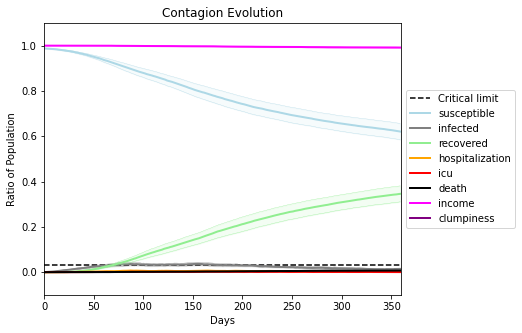

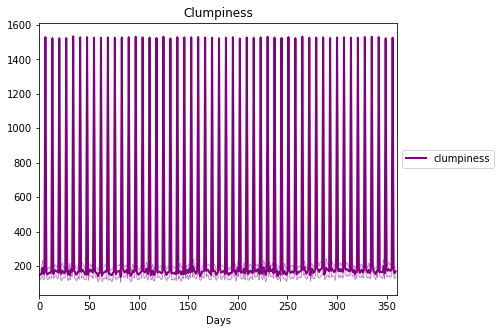

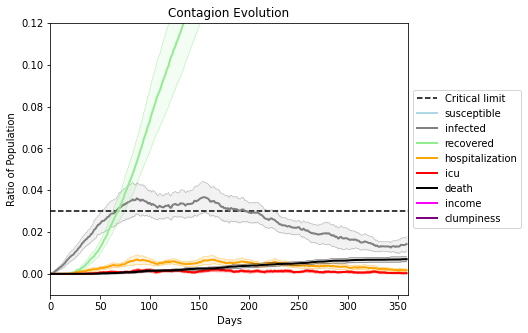

In [13]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5349, 2253, 870, 8027, 8868, 8812, 4252, 3985, 9103, 9183, 2915, 2494, 4900, 5582, 3625, 1639, 269, 6381, 8430, 5822]
Average similarity between family members is 0.9192339313944775 at temperature -0.991
Average similarity between family and home is 0.9998578286128667 at temperature -1
Average similarity between students and their classroom is 0.7978780539669588 at temperature -0.991
Average classroom occupancy is 1.5976331360946745 and number classrooms is 169
Average similarity between workers is 0.8450186547804056 at temperature -0.991
Average office occupancy is 3.5105263157894737 and number offices is 190
Average friend similarity for adults: 0.8449830041685784 for kids: 0.703174433169965
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.5889493743442531
avg restaurant similarity 0.5676810452351267
avg restaurant similarity 0.3979476817035549
avg restaurant similarity 0.36043247599858885
avg restaurant similarity 0.5423253832981918
avg restaurant similarity 0.4320873015797327
avg restaurant similarity 0.5634311577297659
avg restaurant similarity 0.38198636517013834
avg restaurant similarity 0.4850252654519046
avg restaurant similarity 0.7530453149887388
avg restaurant similarity 0.4675158039064264
avg restaurant similarity 0.43430270690206363
avg restaurant similarity 0.3326314200383761
avg restaurant similarity 0.44979203623382036
avg restaurant similarity 0.5724311150037085
avg restaurant similarity 0.6903376121620992
avg restaurant similarity 0.4413931233132651
avg restaurant similarity 0.4066589959025871
avg restaurant similarity 0.5579765238703482
avg restaurant similarity 0.5426607679758293
avg restaurant similarity 0.546088933286951
avg restaurant similarity 0.4851723171055043
avg res

avg restaurant similarity 0.5155653286433317
avg restaurant similarity 0.5234966553674696
avg restaurant similarity 0.6225708594282007
avg restaurant similarity 0.6429062353147665
avg restaurant similarity 0.434662095076909
avg restaurant similarity 0.5800109808000838
avg restaurant similarity 0.5838141286921583
avg restaurant similarity 0.6112610098224158
avg restaurant similarity 0.5860349768045927
avg restaurant similarity 0.5570022857837764
avg restaurant similarity 0.4768512692326212
avg restaurant similarity 0.5260643453538149
avg restaurant similarity 0.4889304877186185
avg restaurant similarity 0.6447887522030193
avg restaurant similarity 0.34284628495384
avg restaurant similarity 0.5495351040219336
avg restaurant similarity 0.41527287899091886
avg restaurant similarity 0.5209366723572678
avg restaurant similarity 0.3567250892257276
avg restaurant similarity 0.6451877415834065
avg restaurant similarity 0.631765744828457
avg restaurant similarity 0.4530438051882203
avg restauran

Average friend similarity for adults: 0.8348997772904704 for kids: 0.7340513586219746
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.5961062464016903
avg restaurant similarity 0.46552262936728267
avg restaurant similarity 0.37177606716021366
avg restaurant similarity 0.515414027741458
avg restaurant similarity 0.5772619896674743
avg restaurant similarity 0.5691887376950876
avg restaurant similarity 0.4947070799815199
avg restaurant similarity 0.2112674576121569
avg restaurant similarity 0.6109030360333938
avg restaurant similarity 0.599487110437605
avg restaurant similarity 0.48961753281523696
avg restaurant similarity 0.3810930473196386
avg restaurant similarity 0.5027715664594928
avg restaurant similarity 0.6373578221410493
avg restaurant similarity 0.6224692199541207
avg restaurant similarity 0.6520443131257471
avg restaurant similarity 0.45638812430305414
avg restaurant similarity 0.7043967857441005
avg restaurant similarity 0.49625455233441257
avg restaurant similarity 0.31216989804188644
avg restaurant similarity 0.6511671744234586
avg restaurant similarity 0.5862793452193348
avg re

avg restaurant similarity 0.635502321985685
avg restaurant similarity 0.5826649135395442
avg restaurant similarity 0.6518914840303004
avg restaurant similarity 0.4762226829915872
avg restaurant similarity 0.600971782733923
avg restaurant similarity 0.5504650794923008
avg restaurant similarity 0.4791489315585049
avg restaurant similarity 0.4985738031021208
avg restaurant similarity 0.5212464214871521
avg restaurant similarity 0.7459521317522585
avg restaurant similarity 0.5804557653667438
avg restaurant similarity 0.5369047545355984
avg restaurant similarity 0.5334500326052771
avg restaurant similarity 0.5498057252077501
avg restaurant similarity 0.45253321833604576
avg restaurant similarity 0.6643775943201944
avg restaurant similarity 0.46118361478201864
avg restaurant similarity 0.4671751557993864
avg restaurant similarity 0.8067266917058543
avg restaurant similarity 0.49277795376530026
avg restaurant similarity 0.5137674909150747
avg restaurant similarity 0.6898930564431708
avg resta

avg restaurant similarity 0.392447886184431
avg restaurant similarity 0.3710445671423369
avg restaurant similarity 0.4410439186948935
avg restaurant similarity 0.5939438518476413
avg restaurant similarity 0.4832286199475724
avg restaurant similarity 0.8196733248732138
avg restaurant similarity 0.5404455024198215
avg restaurant similarity 0.6796446660731497
avg restaurant similarity 0.6294128791578101
avg restaurant similarity 0.39229640187766884
avg restaurant similarity 0.4041119152538908
avg restaurant similarity 0.4973906553740633
avg restaurant similarity 0.36854093956538814
avg restaurant similarity 0.6360110038603869
avg restaurant similarity 0.5405782635352601
avg restaurant similarity 0.48126591331540314
avg restaurant similarity 0.5563124253393112
avg restaurant similarity 0.47973451256925925
avg restaurant similarity 0.34540021105536045
avg restaurant similarity 0.4917963401202806
avg restaurant similarity 0.448382753781441
avg restaurant similarity 0.6589371424013454
avg res

avg restaurant similarity 0.4066571138984823
avg restaurant similarity 0.5332300880906282
avg restaurant similarity 0.46850064154398063
avg restaurant similarity 0.4837187041329936
avg restaurant similarity 0.9996042517239944
avg restaurant similarity 0.36702989935342384
avg restaurant similarity 0.5209158575035256
avg restaurant similarity 0.30626238705849956
avg restaurant similarity 0.5698652781327379
avg restaurant similarity 0.41059599902650057
avg restaurant similarity 0.4948178919538091
avg restaurant similarity 0.30906344544736597
avg restaurant similarity 0.45166596835135947
avg restaurant similarity 0.4089155590846072
avg restaurant similarity 0.6095386333439875
avg restaurant similarity 0.43051369630581177
avg restaurant similarity 0.5092304994338318
avg restaurant similarity 0.48965578133504073
avg restaurant similarity 0.4605235314563269
avg restaurant similarity 0.4886950908587965
avg restaurant similarity 0.5450909927582474
avg restaurant similarity 0.6634551407674203
av

Average friend similarity for adults: 0.8453701345689861 for kids: 0.7206897808904852
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated u

avg restaurant similarity 0.39756881713157605
avg restaurant similarity 0.5173406139692276
avg restaurant similarity 0.45122786384751656
avg restaurant similarity 0.4630015426416176
avg restaurant similarity 0.6170803256859915
avg restaurant similarity 0.45068461209343674
avg restaurant similarity 0.5192156688604008
avg restaurant similarity 0.5809099430501599
avg restaurant similarity 0.4511953505040271
avg restaurant similarity 0.6115255197317975
avg restaurant similarity 0.2836681321486377
avg restaurant similarity 0.5306027755745304
avg restaurant similarity 0.6180268974395364
avg restaurant similarity 0.5107021863339772
avg restaurant similarity 0.46990166111279313
avg restaurant similarity 0.6878200060552582
avg restaurant similarity 0.5179556064659878
avg restaurant similarity 0.4939816076235132
avg restaurant similarity 0.5249597852243886
avg restaurant similarity 0.3891951442739628
avg restaurant similarity 0.7333202273249668
avg restaurant similarity 0.31725718989948065
avg r

avg restaurant similarity 0.48795093787256383
avg restaurant similarity 0.46494510809315975
avg restaurant similarity 0.42212130595289155
avg restaurant similarity 0.481009169785836
avg restaurant similarity 0.3949482237448194
avg restaurant similarity 0.48557966539664316
avg restaurant similarity 0.456295823308865
avg restaurant similarity 0.44194181581896497
avg restaurant similarity 0.4909525197737961
avg restaurant similarity 0.6306599030759488
avg restaurant similarity 0.6216841449314754
avg restaurant similarity 0.4339675742968964
avg restaurant similarity 0.4929535965928536
avg restaurant similarity 0.5776349823800351
avg restaurant similarity 0.467446283489848
avg restaurant similarity 0.47466246062148204
avg restaurant similarity 0.5236235498743891
avg restaurant similarity 0.5159999897940688
avg restaurant similarity 0.5806421323012068
avg restaurant similarity 0.30767661216513914
avg restaurant similarity 0.5084301546710674
avg restaurant similarity 0.3982456572945288
avg re

Average similarity between workers is 0.8390377488645372 at temperature -0.991
Average office occupancy is 3.3917525773195876 and number offices is 194
Average friend similarity for adults: 0.8433466515266591 for kids: 0.7414905759965418
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.411671908032728
avg restaurant similarity 0.4859396376430236
avg restaurant similarity 0.3635450410190057
avg restaurant similarity 0.41369365619720844
avg restaurant similarity 0.5658899265849967
avg restaurant similarity 0.5244068364690962
avg restaurant similarity 0.3636068468150843
avg restaurant similarity 0.559601857230417
avg restaurant similarity 0.5826970224753165
avg restaurant similarity 0.5154111111406565
avg restaurant similarity 0.4793905068928021
avg restaurant similarity 0.6061994158424859
avg restaurant similarity 0.47669930870855587
avg restaurant similarity 0.4934645472371506
avg restaurant similarity 0.6102132058988572
avg restaurant similarity 0.477666122587043
avg restaurant similarity 0.6165060403029584
avg restaurant similarity 0.5224029163415669
avg restaurant similarity 0.4513835847013588
avg restaurant similarity 0.3512577334348157
avg restaurant similarity 0.4357564290201373
avg restaurant similarity 0.6810965564229138
avg restaur

avg restaurant similarity 0.4601478194078415
avg restaurant similarity 0.49238158671359084
avg restaurant similarity 0.6959424455198014
avg restaurant similarity 0.45548121099123184
avg restaurant similarity 0.6788020117565234
avg restaurant similarity 0.3651085993363443
avg restaurant similarity 0.6903495952390885
avg restaurant similarity 0.45077643322405714
avg restaurant similarity 0.4389096512674969
avg restaurant similarity 0.500526523463997
avg restaurant similarity 0.44182053090325263
avg restaurant similarity 0.42930231136913605
avg restaurant similarity 0.7452844438434615
avg restaurant similarity 0.5786919889235053
avg restaurant similarity 0.6958706648089146
avg restaurant similarity 0.5952724732375608
avg restaurant similarity 0.4461817372147193
avg restaurant similarity 0.5306861953832832
avg restaurant similarity 0.5109471915428224
avg restaurant similarity 0.9997570162836711
avg restaurant similarity 0.5223370071948488
avg restaurant similarity 0.6660930101745277
avg re

avg restaurant similarity 0.47522437176905646
avg restaurant similarity 0.5761974992725621
avg restaurant similarity 0.6544875692733564
avg restaurant similarity 0.6686556694824044
avg restaurant similarity 0.48597953562666046
avg restaurant similarity 0.5741969410471988
avg restaurant similarity 0.519586943961138
avg restaurant similarity 0.4877851224942254
avg restaurant similarity 0.49178572006541277
avg restaurant similarity 0.3820144783144207
avg restaurant similarity 0.46515472100576427
avg restaurant similarity 0.5747582744677596
avg restaurant similarity 0.5649011640208766
avg restaurant similarity 0.5896041368193005
avg restaurant similarity 0.3602034044656768
avg restaurant similarity 0.4214471943583078
avg restaurant similarity 0.46523198412460526
avg restaurant similarity 0.46597471230226073
avg restaurant similarity 0.387772168378792
avg restaurant similarity 0.689945720083534
avg restaurant similarity 0.6823872601331572
avg restaurant similarity 0.4417885635465581
avg res

avg restaurant similarity 0.6882866087736726
avg restaurant similarity 0.6318113263476508
avg restaurant similarity 0.48692686489692627
avg restaurant similarity 0.696109343866625
avg restaurant similarity 0.4238770646706902
avg restaurant similarity 0.51288887935651
avg restaurant similarity 0.5785593791856096
avg restaurant similarity 0.48141421860371586
avg restaurant similarity 0.5289462572990387
avg restaurant similarity 0.4937726310974665
avg restaurant similarity 0.5091165941028325
avg restaurant similarity 0.5798692181273191
avg restaurant similarity 0.48522666583479684
avg restaurant similarity 0.5481053921765395
avg restaurant similarity 0.5038593464089396
avg restaurant similarity 0.4183734041013064
avg restaurant similarity 0.48623538202560895
avg restaurant similarity 0.4802288342041761
avg restaurant similarity 0.8924291107411527
avg restaurant similarity 0.44015184005786323
avg restaurant similarity 0.4462568007540413
avg restaurant similarity 0.4918897442702643
avg rest

Average friend similarity for adults: 0.8369940119841435 for kids: 0.7233466155567729
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated u

avg restaurant similarity 0.6617373020817744
avg restaurant similarity 0.7536533454215048
avg restaurant similarity 0.29258917708523
avg restaurant similarity 0.5521357030547407
avg restaurant similarity 0.5277347064375647
avg restaurant similarity 0.5529175376752608
avg restaurant similarity 0.7255565195273562
avg restaurant similarity 0.5362172379439828
avg restaurant similarity 0.5391567325631111
avg restaurant similarity 0.3991775151909324
avg restaurant similarity 0.5291562625636188
avg restaurant similarity 0.4458064658538527
avg restaurant similarity 0.47762543214304254
avg restaurant similarity 0.56356129075661
avg restaurant similarity 0.596595896171446
avg restaurant similarity 0.9997245121644323
avg restaurant similarity 0.6725753982308157
avg restaurant similarity 0.35136920230053525
avg restaurant similarity 0.4501748611045535
avg restaurant similarity 0.7086640687443967
avg restaurant similarity 0.5131034920526797
avg restaurant similarity 0.5638010770674163
avg restauran

avg restaurant similarity 0.5820727587197565
avg restaurant similarity 0.5304714388146855
avg restaurant similarity 0.46738643086713977
avg restaurant similarity 0.7350663947760531
avg restaurant similarity 0.5142278157452081
avg restaurant similarity 0.6186984591990887
avg restaurant similarity 0.5698944720002364
avg restaurant similarity 0.6405870500014426
avg restaurant similarity 0.44463334009037203
avg restaurant similarity 0.49112313436521327
avg restaurant similarity 0.29460605122632566
avg restaurant similarity 0.8342203118177549
avg restaurant similarity 0.738210186611013
avg restaurant similarity 0.5259078941698887
avg restaurant similarity 0.5391978964356885
avg restaurant similarity 0.5551812733613447
avg restaurant similarity 0.5615135329933285
avg restaurant similarity 0.4117499082159129
avg restaurant similarity 0.4464200837344417
avg restaurant similarity 0.45268655255392504
avg restaurant similarity 0.5821520113681544
avg restaurant similarity 0.5370349937676864
avg re

Average similarity between workers is 0.8431203274450033 at temperature -0.991
Average office occupancy is 3.3846153846153846 and number offices is 195
Average friend similarity for adults: 0.8448058152915328 for kids: 0.70479104434917
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.5008636183530977
avg restaurant similarity 0.5882171204303589
avg restaurant similarity 0.5439715425324497
avg restaurant similarity 0.48993662975583624
avg restaurant similarity 0.5690297483689071
avg restaurant similarity 0.3716103809971816
avg restaurant similarity 0.5462765988534081
avg restaurant similarity 0.49131498924304257
avg restaurant similarity 0.47883723923592286
avg restaurant similarity 0.7472068870179625
avg restaurant similarity 0.6210903154442132
avg restaurant similarity 0.5561961327589572
avg restaurant similarity 0.601017577264636
avg restaurant similarity 0.48888965795017647
avg restaurant similarity 0.4967741608830636
avg restaurant similarity 0.5967005683786305
avg restaurant similarity 0.7431218408075067
avg restaurant similarity 0.5342565531364162
avg restaurant similarity 0.6616251706334882
avg restaurant similarity 0.5467817346932271
avg restaurant similarity 0.4989128709348532
avg restaurant similarity 0.6647905867699919
avg res

avg restaurant similarity 0.39126468230486766
avg restaurant similarity 0.5455561303214924
avg restaurant similarity 0.6956496767682474
avg restaurant similarity 0.6354939085016463
avg restaurant similarity 0.7211047062558354
avg restaurant similarity 0.4564850145063908
avg restaurant similarity 0.5634678741867529
avg restaurant similarity 0.5495644264501128
avg restaurant similarity 0.49391117357112874
avg restaurant similarity 0.4526592256262678
avg restaurant similarity 0.8353423556523241
avg restaurant similarity 0.4278366136360679
avg restaurant similarity 0.42094366387663384
avg restaurant similarity 0.527471046718852
avg restaurant similarity 0.6451766652474941
avg restaurant similarity 0.46929142236600674
avg restaurant similarity 0.4964627745727498
avg restaurant similarity 0.5408411797880414
avg restaurant similarity 0.45027731834571666
avg restaurant similarity 0.6164052719168698
avg restaurant similarity 0.6017901010501985
avg restaurant similarity 0.5892306083395422
avg re

Average similarity between workers is 0.8422443481762149 at temperature -0.991
Average office occupancy is 3.3096446700507616 and number offices is 197
Average friend similarity for adults: 0.8432056576730022 for kids: 0.7171273019785879
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.495304947295142
avg restaurant similarity 0.5259617434976083
avg restaurant similarity 0.5665157413560187
avg restaurant similarity 0.6204914322044227
avg restaurant similarity 0.6667328581343163
avg restaurant similarity 0.565715911357098
avg restaurant similarity 0.506898243368133
avg restaurant similarity 0.5254558762730328
avg restaurant similarity 0.58802558697915
avg restaurant similarity 0.6367791951488272
avg restaurant similarity 0.5023685466656871
avg restaurant similarity 0.6239554042327793
avg restaurant similarity 0.5574646753989133
avg restaurant similarity 0.5444516052504081
avg restaurant similarity 0.6025458598262404
avg restaurant similarity 0.6184926711936727
avg restaurant similarity 0.9286378096786364
avg restaurant similarity 0.4489924641889431
avg restaurant similarity 0.5336729682971224
avg restaurant similarity 0.5042060669209761
avg restaurant similarity 0.585427551416312
avg restaurant similarity 0.60212348028365
avg restaurant sim

avg restaurant similarity 0.5159867243033373
avg restaurant similarity 0.6357689785586914
avg restaurant similarity 0.48874847702654745
avg restaurant similarity 0.5680329265977485
avg restaurant similarity 0.46425407874963026
avg restaurant similarity 0.40137466878297734
avg restaurant similarity 0.8441675419156284
avg restaurant similarity 0.41443081303512114
avg restaurant similarity 0.6135953500901964
avg restaurant similarity 0.6207013918827052
avg restaurant similarity 0.7267675524319749
avg restaurant similarity 0.7226624261049592
avg restaurant similarity 0.7312853265869955
avg restaurant similarity 0.5974153245624854
avg restaurant similarity 0.5550187119971012
avg restaurant similarity 0.4434891329349678
avg restaurant similarity 0.5777312934232339
avg restaurant similarity 0.3858266377816316
avg restaurant similarity 0.7169137813049576
avg restaurant similarity 0.5169266339965877
avg restaurant similarity 0.4379934276810877
avg restaurant similarity 0.622856890575224
avg res

avg restaurant similarity 0.26555025496368856
avg restaurant similarity 0.34475457359515305
avg restaurant similarity 0.7552222107792383
avg restaurant similarity 0.4422740557554117
avg restaurant similarity 0.544846290898219
avg restaurant similarity 0.6429066514846894
avg restaurant similarity 0.533528066806136
avg restaurant similarity 0.43016593001562803
avg restaurant similarity 0.40591793092741535
avg restaurant similarity 0.4881530600259506
avg restaurant similarity 0.372807219696947
avg restaurant similarity 0.5359486081299307
avg restaurant similarity 0.40149819725219416
avg restaurant similarity 0.4421905270480848
avg restaurant similarity 0.5911834706352732
avg restaurant similarity 0.7202939493954577
avg restaurant similarity 0.4509919151632787
avg restaurant similarity 0.39542905389177907
avg restaurant similarity 0.28974197574317134
avg restaurant similarity 0.5226666026206676
avg restaurant similarity 0.5356933223281313
avg restaurant similarity 0.47324968552088686
avg r

avg restaurant similarity 0.5121149979311267
avg restaurant similarity 0.5801820571751427
avg restaurant similarity 0.8031091882090946
avg restaurant similarity 0.5962263061414813
avg restaurant similarity 0.3298981515222088
avg restaurant similarity 0.8023609477829159
avg restaurant similarity 0.23039281851027676
avg restaurant similarity 0.5138696393825016
avg restaurant similarity 0.4127677802437178
avg restaurant similarity 0.6218694925471291
avg restaurant similarity 0.5817177037815318
avg restaurant similarity 0.540302634606623
avg restaurant similarity 0.7281746181917402
avg restaurant similarity 0.8667627117072935
avg restaurant similarity 0.8077855914445751
avg restaurant similarity 0.33536385710786554
avg restaurant similarity 0.5030546758307393
avg restaurant similarity 0.6566449775781444
avg restaurant similarity 0.6201404049774119
avg restaurant similarity 0.3528145678913961
avg restaurant similarity 0.4772213967588669
avg restaurant similarity 0.3853221670956613
avg resta

avg restaurant similarity 0.6000645326721066
avg restaurant similarity 0.4248540940131701
avg restaurant similarity 0.6122370407583794
avg restaurant similarity 0.4828946746550303
avg restaurant similarity 0.5350053567447016
avg restaurant similarity 0.42095150231789047
avg restaurant similarity 0.46928934926935517
avg restaurant similarity 0.5744999902813704
avg restaurant similarity 0.5474590673201579
avg restaurant similarity 0.5846736188794001
avg restaurant similarity 0.5294965701304691
avg restaurant similarity 0.4574400045716576
avg restaurant similarity 0.6300478176861903
avg restaurant similarity 0.9528583918658288
avg restaurant similarity 0.5514510592741915
avg restaurant similarity 0.4584873061492899
avg restaurant similarity 0.4311590760212624
avg restaurant similarity 0.41929003064328046
avg restaurant similarity 0.6194819693333494
avg restaurant similarity 0.4938026228860586
avg restaurant similarity 0.579503511255462
avg restaurant similarity 0.5009419849715762
avg rest

avg restaurant similarity 0.49849747278679934
avg restaurant similarity 0.4602122739520275
avg restaurant similarity 0.6324832521144301
avg restaurant similarity 0.4290135437453033
avg restaurant similarity 0.8122626528241774
avg restaurant similarity 0.5224337395634683
avg restaurant similarity 0.7084589071255608
avg restaurant similarity 0.6626571119464097
avg restaurant similarity 0.4150515971567996
avg restaurant similarity 0.37757273450711304
avg restaurant similarity 0.5547117825919299
avg restaurant similarity 0.6280745673256466
avg restaurant similarity 0.6086986782986521
avg restaurant similarity 0.5085142949009186
avg restaurant similarity 0.6108652634803724
avg restaurant similarity 0.7080124660269848
avg restaurant similarity 0.48194993100515665
avg restaurant similarity 0.6220559536153435
avg restaurant similarity 0.3385750027818807
avg restaurant similarity 0.5441701114563231
avg restaurant similarity 0.6040736516174225
avg restaurant similarity 0.7245032749753026
avg res

Average friend similarity for adults: 0.83169328427558 for kids: 0.7258171588429201
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units

avg restaurant similarity 0.564009344068278
avg restaurant similarity 0.5378440913162993
avg restaurant similarity 0.4051951305037624
avg restaurant similarity 0.43481270303373987
avg restaurant similarity 0.49175487429980985
avg restaurant similarity 0.6416351151549409
avg restaurant similarity 0.5545616081293485
avg restaurant similarity 0.4157957628415534
avg restaurant similarity 0.5116689473946231
avg restaurant similarity 0.6583997146131121
avg restaurant similarity 0.3917710936114879
avg restaurant similarity 0.4774071031335678
avg restaurant similarity 0.4658975476989573
avg restaurant similarity 0.45824914583037035
avg restaurant similarity 0.541163645703978
avg restaurant similarity 0.534349688210588
avg restaurant similarity 0.728398253391245
avg restaurant similarity 0.5247727832354743
avg restaurant similarity 0.23370999812978463
avg restaurant similarity 0.4341696769124466
avg restaurant similarity 0.5279269987817437
avg restaurant similarity 0.6184002942633295
avg restau

avg restaurant similarity 0.1918270047959083
avg restaurant similarity 0.3076168430909334
avg restaurant similarity 0.4014651965976707
avg restaurant similarity 0.4877112285930236
avg restaurant similarity 0.39672319573628617
avg restaurant similarity 0.4980389398564772
avg restaurant similarity 0.30276704117038755
avg restaurant similarity 0.4784350802268478
avg restaurant similarity 0.36390973968427714
avg restaurant similarity 0.3938073230823121
avg restaurant similarity 0.4623865536650953
avg restaurant similarity 0.41899465704322575
avg restaurant similarity 0.4648718709484806
avg restaurant similarity 0.5175022155399259
avg restaurant similarity 0.522337809815452
avg restaurant similarity 0.4891830257869305
avg restaurant similarity 0.3705954886583278
avg restaurant similarity 0.524787387499463
avg restaurant similarity 0.49482608508688086
avg restaurant similarity 0.7130681479197208
avg restaurant similarity 0.5110359706640758
avg restaurant similarity 0.46371147645246313
avg re

Average similarity between workers is 0.8333308764090368 at temperature -0.991
Average office occupancy is 3.3418367346938775 and number offices is 196
Average friend similarity for adults: 0.8360334163157769 for kids: 0.7173517837995461
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.41145142312444144
avg restaurant similarity 0.4246670233444553
avg restaurant similarity 0.4123328259751139
avg restaurant similarity 0.6949127772257461
avg restaurant similarity 0.37749493028052217
avg restaurant similarity 0.502894240018859
avg restaurant similarity 0.5523898746926568
avg restaurant similarity 0.5221120391815036
avg restaurant similarity 0.4779832390834191
avg restaurant similarity 0.5533862908193579
avg restaurant similarity 0.5600525927641161
avg restaurant similarity 0.6249878876516288
avg restaurant similarity 0.41134479878391234
avg restaurant similarity 0.47118932170590433
avg restaurant similarity 0.5467912462634571
avg restaurant similarity 0.561508732193144
avg restaurant similarity 0.4073520276669736
avg restaurant similarity 0.6188417327840271
avg restaurant similarity 0.7014641310797838
avg restaurant similarity 0.6000272923963801
avg restaurant similarity 0.37926713863926664
avg restaurant similarity 0.6674894714062733
avg res

avg restaurant similarity 0.5488394757680782
avg restaurant similarity 0.46114078890247046
avg restaurant similarity 0.3262426457526863
avg restaurant similarity 0.3430197871425936
avg restaurant similarity 0.4333644376202958
avg restaurant similarity 0.46554317626047054
avg restaurant similarity 0.3885754482374602
avg restaurant similarity 0.4578719212706252
avg restaurant similarity 0.6463055203434044
avg restaurant similarity 0.5420472681981007
avg restaurant similarity 0.42651210572882314
avg restaurant similarity 0.266562710718839
avg restaurant similarity 0.5066649432330738
avg restaurant similarity 0.4437439680285796
avg restaurant similarity 0.334366190144182
avg restaurant similarity 0.3468853816193618
avg restaurant similarity 0.36838169212521377
avg restaurant similarity 0.4567700027107852
avg restaurant similarity 0.6607060458131184
avg restaurant similarity 0.6060512007882458
avg restaurant similarity 0.7514836976586945
avg restaurant similarity 0.5499238246724508
avg rest

Average friend similarity for adults: 0.8407486433192527 for kids: 0.7156108511656606
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated u

avg restaurant similarity 0.5367042775886146
avg restaurant similarity 0.623319764225505
avg restaurant similarity 0.7145471645620312
avg restaurant similarity 0.4522351669017907
avg restaurant similarity 0.5823099297459816
avg restaurant similarity 0.516495751298867
avg restaurant similarity 0.651600183425975
avg restaurant similarity 0.5557035629012167
avg restaurant similarity 0.5022565497227742
avg restaurant similarity 0.48826284730730707
avg restaurant similarity 0.6243456984615967
avg restaurant similarity 0.662652573076145
avg restaurant similarity 0.5443581054804669
avg restaurant similarity 0.6005621393508433
avg restaurant similarity 0.5263378594993655
avg restaurant similarity 0.5381102687261657
avg restaurant similarity 0.6485017539977821
avg restaurant similarity 0.6098090013175446
avg restaurant similarity 0.4865287672163
avg restaurant similarity 0.5323751086007497
avg restaurant similarity 0.5720527243690513
avg restaurant similarity 0.5966686881438302
avg restaurant s

avg restaurant similarity 0.575020521655516
avg restaurant similarity 0.5078064152795619
avg restaurant similarity 0.641877829561542
avg restaurant similarity 0.6820861870766541
avg restaurant similarity 0.5412413659736328
avg restaurant similarity 0.610693144141094
avg restaurant similarity 0.5086932611004037
avg restaurant similarity 0.5850384634691643
avg restaurant similarity 0.6787061503604269
avg restaurant similarity 0.5474095708306438
avg restaurant similarity 0.5443971742684653
avg restaurant similarity 0.6380748824436427
avg restaurant similarity 0.46595029410968497
avg restaurant similarity 0.6324626820737058
avg restaurant similarity 0.7055740499078378
avg restaurant similarity 0.530681822582981
avg restaurant similarity 0.6466900640512824
avg restaurant similarity 0.612058724044455
avg restaurant similarity 0.5307633046665133
avg restaurant similarity 0.4742804734092525
avg restaurant similarity 0.5465448187775868
avg restaurant similarity 0.6530755156974563
avg restaurant

Average similarity between workers is 0.834270704452046 at temperature -0.991
Average office occupancy is 3.6041666666666665 and number offices is 192
Average friend similarity for adults: 0.8494987968261661 for kids: 0.7237827129783699
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.8021479419072882
avg restaurant similarity 0.6027240263431991
avg restaurant similarity 0.4980370759482952
avg restaurant similarity 0.7753960346741495
avg restaurant similarity 0.4872182588350192
avg restaurant similarity 0.4546389821839633
avg restaurant similarity 0.469982779417088
avg restaurant similarity 0.5693679168996507
avg restaurant similarity 0.5780072376018002
avg restaurant similarity 0.5799741137188079
avg restaurant similarity 0.5150168320041791
avg restaurant similarity 0.5342759587332374
avg restaurant similarity 0.5311777691878384
avg restaurant similarity 0.48035835671265453
avg restaurant similarity 0.36957227289050865
avg restaurant similarity 0.5709562482672159
avg restaurant similarity 0.6521714438518267
avg restaurant similarity 0.6202723927954847
avg restaurant similarity 0.6539152539030445
avg restaurant similarity 0.4844963736785445
avg restaurant similarity 0.6004822296474928
avg restaurant similarity 0.636154761363271
avg restau

avg restaurant similarity 0.5680668451263928
avg restaurant similarity 0.5475444038814512
avg restaurant similarity 0.517562592345381
avg restaurant similarity 0.45007200734611036
avg restaurant similarity 0.49524942132702143
avg restaurant similarity 0.5765035481803135
avg restaurant similarity 0.42720048218726814
avg restaurant similarity 0.5283705607194111
avg restaurant similarity 0.47454070189779757
avg restaurant similarity 0.5353134147237247
avg restaurant similarity 0.4756074749404074
avg restaurant similarity 0.5366943014144575
avg restaurant similarity 0.5034431673295189
avg restaurant similarity 0.6079288447322732
avg restaurant similarity 0.6091825469412733
avg restaurant similarity 0.5904369880661076
avg restaurant similarity 0.4366265199604058
avg restaurant similarity 0.6344800400632796
avg restaurant similarity 0.532807770570793
avg restaurant similarity 0.4571371824345387
avg restaurant similarity 0.4806058552411231
avg restaurant similarity 0.6550549299518202
avg rest

Average similarity between workers is 0.8475855796118191 at temperature -0.991
Average office occupancy is 3.107317073170732 and number offices is 205
Average friend similarity for adults: 0.8331303676818808 for kids: 0.7306993338495265
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 pe

avg restaurant similarity 0.5365397968427339
avg restaurant similarity 0.46366402409055374
avg restaurant similarity 0.5249230863813842
avg restaurant similarity 0.28977743133584655
avg restaurant similarity 0.8534813747538009
avg restaurant similarity 0.30218334944930914
avg restaurant similarity 0.3753056498193137
avg restaurant similarity 0.36583685862643667
avg restaurant similarity 0.4357354037746387
avg restaurant similarity 0.4060502582723231
avg restaurant similarity 0.33810029376456646
avg restaurant similarity 0.47686838629163464
avg restaurant similarity 0.6964295936300162
avg restaurant similarity 0.531943977810821
avg restaurant similarity 0.5088093769974966
avg restaurant similarity 0.4920467412758947
avg restaurant similarity 0.5043148286594593
avg restaurant similarity 0.46319818302516097
avg restaurant similarity 0.6112284433200746
avg restaurant similarity 0.46940264437061785
avg restaurant similarity 0.5234679886848068
avg restaurant similarity 0.4593542344224712
avg

avg restaurant similarity 0.37464711407418677
avg restaurant similarity 0.8404712877037461
avg restaurant similarity 0.47385078145218484
avg restaurant similarity 0.47245609631516783
avg restaurant similarity 0.5973017877457681
avg restaurant similarity 0.3634768654757128
avg restaurant similarity 0.3798286249817853
avg restaurant similarity 0.298210279307922
avg restaurant similarity 0.5017960030527936
avg restaurant similarity 0.7099159044214023
avg restaurant similarity 0.48183505979679975
avg restaurant similarity 0.5323735092671764
avg restaurant similarity 0.5554072574582416
avg restaurant similarity 0.4666376684898347
avg restaurant similarity 0.5299411129133854
avg restaurant similarity 0.46665765313101387
avg restaurant similarity 0.7429945421837237
avg restaurant similarity 0.4065327690168884
avg restaurant similarity 0.5520382264646627
avg restaurant similarity 0.46787864929963846
avg restaurant similarity 0.7247217188111357
avg restaurant similarity 0.6406554875974115
avg r

avg restaurant similarity 0.5189029263353545
avg restaurant similarity 0.4658859965239882
avg restaurant similarity 0.5103530372710099
avg restaurant similarity 0.60147439616561
avg restaurant similarity 0.6367316121188582
avg restaurant similarity 0.5477470583953897
avg restaurant similarity 0.4902852740414516
avg restaurant similarity 0.6082417183672497
avg restaurant similarity 0.5664588311648064
avg restaurant similarity 0.6014755281827331
avg restaurant similarity 0.5008782115719246
avg restaurant similarity 0.5146768950093343
avg restaurant similarity 0.6607409760148835
avg restaurant similarity 0.648984492876151
avg restaurant similarity 0.5392810490892143
avg restaurant similarity 0.5224583206912832
avg restaurant similarity 0.5096389156941294
avg restaurant similarity 0.429179735099664
avg restaurant similarity 0.5026976827033842
avg restaurant similarity 0.4956530839124534
avg restaurant similarity 0.6221930056354325
avg restaurant similarity 0.6859555880328599
avg restaurant

avg restaurant similarity 0.7217305481753199
avg restaurant similarity 0.4518426380177313
avg restaurant similarity 0.4630379231163873
avg restaurant similarity 0.5844139453203687
avg restaurant similarity 0.5752690746617729
avg restaurant similarity 0.6032670951863331
avg restaurant similarity 0.5878034348501002
avg restaurant similarity 0.5786444087118359
avg restaurant similarity 0.5782636952543181
avg restaurant similarity 0.4629143834185427
avg restaurant similarity 0.4067610424138118
avg restaurant similarity 0.3410279347583989
avg restaurant similarity 0.4828328988492432
avg restaurant similarity 0.6846856810596597
avg restaurant similarity 0.5494023662666869
avg restaurant similarity 0.5825776578459648
avg restaurant similarity 0.5304114202262125
avg restaurant similarity 0.5143508449834332
avg restaurant similarity 0.45690127345212267
avg restaurant similarity 0.5494687655013091
avg restaurant similarity 0.5548827444581561
avg restaurant similarity 0.5528114943930844
avg resta

Average similarity between workers is 0.8413403081889514 at temperature -0.991
Average office occupancy is 3.2666666666666666 and number offices is 195
Average friend similarity for adults: 0.8358927545651124 for kids: 0.7320662512237753
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.5686829198058583
avg restaurant similarity 0.4058286877036996
avg restaurant similarity 0.4790729969019185
avg restaurant similarity 0.47241210123429345
avg restaurant similarity 0.5154358680508851
avg restaurant similarity 0.6038198140661307
avg restaurant similarity 0.4875460322873375
avg restaurant similarity 0.4620544996302751
avg restaurant similarity 0.6785581255959438
avg restaurant similarity 0.46647814251338926
avg restaurant similarity 0.5103615248279074
avg restaurant similarity 0.6423662886355901
avg restaurant similarity 0.497224494820523
avg restaurant similarity 0.4901610792838359
avg restaurant similarity 0.6062709772719063
avg restaurant similarity 0.40682179583286465
avg restaurant similarity 0.6342001480575779
avg restaurant similarity 0.5175285448864206
avg restaurant similarity 0.6040204676875369
avg restaurant similarity 0.6440034124977835
avg restaurant similarity 0.4843690914299894
avg restaurant similarity 0.4983471289062081
avg rest

avg restaurant similarity 0.3929430127768088
avg restaurant similarity 0.6421358375174997
avg restaurant similarity 0.5679392361664156
avg restaurant similarity 0.6030663737575227
avg restaurant similarity 0.4781328611075358
avg restaurant similarity 0.5120081999161703
avg restaurant similarity 0.6577665223063351
avg restaurant similarity 0.48380937993212525
avg restaurant similarity 0.5756613058037973
avg restaurant similarity 0.478378418192334
avg restaurant similarity 0.45305375847245455
avg restaurant similarity 0.48053412041700017
avg restaurant similarity 0.5541085071383801
avg restaurant similarity 0.5795450675434487
avg restaurant similarity 0.8319347090751191
avg restaurant similarity 0.5770104544587458
avg restaurant similarity 0.5772998079162753
avg restaurant similarity 0.6990376746031094
avg restaurant similarity 0.5419220063370156
avg restaurant similarity 0.5765086912122935
avg restaurant similarity 0.5190879824110508
avg restaurant similarity 0.5093069281650755
avg rest

Average similarity between workers is 0.8403967040664148 at temperature -0.991
Average office occupancy is 3.378238341968912 and number offices is 193
Average friend similarity for adults: 0.837380751022658 for kids: 0.7274339320846411
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13

avg restaurant similarity 0.5088343776378316
avg restaurant similarity 0.5256155153668767
avg restaurant similarity 0.5335231978474345
avg restaurant similarity 0.3120095019974266
avg restaurant similarity 0.20922686660910883
avg restaurant similarity 0.4239024983871731
avg restaurant similarity 0.5187239523291193
avg restaurant similarity 0.5851744052108876
avg restaurant similarity 0.5057807414476285
avg restaurant similarity 0.50000378923336
avg restaurant similarity 0.5335707918223452
avg restaurant similarity 0.4206203626098188
avg restaurant similarity 0.607481167664256
avg restaurant similarity 0.48543913849828924
avg restaurant similarity 0.9131089572040886
avg restaurant similarity 0.37873492055396807
avg restaurant similarity 0.35189427013835095
avg restaurant similarity 0.5437383151546187
avg restaurant similarity 0.6221044811778838
avg restaurant similarity 0.4032376466205124
avg restaurant similarity 0.4294492431260894
avg restaurant similarity 0.4672251134105771
avg resta

avg restaurant similarity 0.5900592938335465
avg restaurant similarity 0.5578580956988503
avg restaurant similarity 0.5294540948003942
avg restaurant similarity 0.331924022958909
avg restaurant similarity 0.3777175010216801
avg restaurant similarity 0.4646904026088626
avg restaurant similarity 0.5382648998647601
avg restaurant similarity 0.7996263921928856
avg restaurant similarity 0.41344010688820526
avg restaurant similarity 0.6119775162131118
avg restaurant similarity 0.5419302779461576
avg restaurant similarity 0.5587881849747043
avg restaurant similarity 0.39878342660642296
avg restaurant similarity 0.47136275563893304
avg restaurant similarity 0.47206224217232323
avg restaurant similarity 0.4430914154928992
avg restaurant similarity 0.4158049483124407
avg restaurant similarity 0.6237482804207769
avg restaurant similarity 0.5585348619095337
avg restaurant similarity 0.4515778408315917
avg restaurant similarity 0.5242601866659307
avg restaurant similarity 0.6507599024826735
avg res

avg restaurant similarity 0.47312400010336236
avg restaurant similarity 0.4799269608211871
avg restaurant similarity 0.49491975100307456
avg restaurant similarity 0.5009011433579207
avg restaurant similarity 0.49545750840860336
avg restaurant similarity 0.44092706343865207
avg restaurant similarity 0.5706842169123277
avg restaurant similarity 0.5982514111210954
avg restaurant similarity 0.4668752076726882
avg restaurant similarity 0.4855601763490904
avg restaurant similarity 0.5403988813450878
avg restaurant similarity 0.5359341256637105
avg restaurant similarity 0.5122092681703507
avg restaurant similarity 0.5122858121965863
avg restaurant similarity 0.5649216421400716
avg restaurant similarity 0.6900351846653152
avg restaurant similarity 0.3401944978782576
avg restaurant similarity 0.5730714651075762
avg restaurant similarity 0.49609746626764967
avg restaurant similarity 0.6204077314090696
avg restaurant similarity 0.502157779215945
avg restaurant similarity 0.5093045567470879
avg re

avg restaurant similarity 0.6150284477448572
avg restaurant similarity 0.5525925573077811
avg restaurant similarity 0.44746560582982664
avg restaurant similarity 0.6217947197388504
avg restaurant similarity 0.3768807256746795
avg restaurant similarity 0.5745741549254527
avg restaurant similarity 0.513585378614531
avg restaurant similarity 0.5125062840515104
avg restaurant similarity 0.23937537021542524
avg restaurant similarity 0.7780752433188272
avg restaurant similarity 0.35555411412284493
avg restaurant similarity 0.6432583003424268
avg restaurant similarity 0.5496410671289337
avg restaurant similarity 0.625383693205793
avg restaurant similarity 0.5026391794205812
avg restaurant similarity 0.4352075072532184
avg restaurant similarity 0.6147005711726065
avg restaurant similarity 0.4055560394376461
avg restaurant similarity 0.4019638352146487
avg restaurant similarity 0.4451536781830656
avg restaurant similarity 0.423475599787864
avg restaurant similarity 0.7724501007576886
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

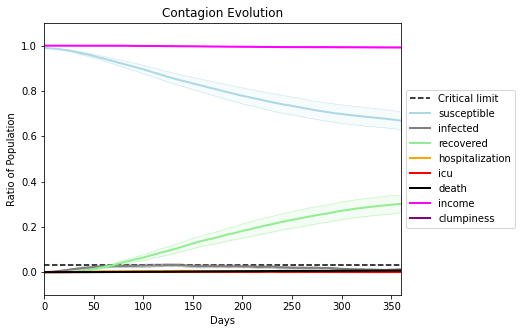

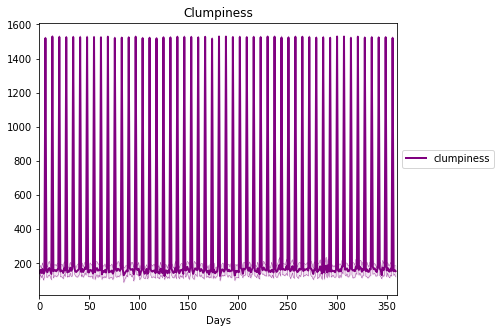

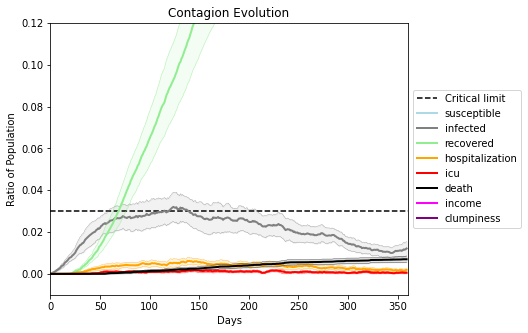

In [14]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7565, 4693, 4997, 7952, 4493, 5911, 9917, 5545, 9054, 6597, 4236, 6286, 6244, 4239, 8326, 3427, 6349, 9505, 3980, 7748]
Average similarity between family members is 0.9085137363501191 at temperature -0.99
Average similarity between family and home is 0.9998579998269868 at temperature -1
Average similarity between students and their classroom is 0.760616897121822 at temperature -0.99
Average classroom occupancy is 1.5977653631284916 and number classrooms is 179
Average similarity between workers is 0.8223678930554645 at temperature -0.99
Average office occupancy is 3.2587064676616917 and number offices is 201
Average friend similarity for adults: 0.8306423508104387 for kids: 0.7116845299226208
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.7193476989789104
avg restaurant similarity 0.64901095715551
avg restaurant similarity 0.6197484758363107
avg restaurant similarity 0.5328474904951069
avg restaurant similarity 0.2988048932415018
avg restaurant similarity 0.6337472930551201
avg restaurant similarity 0.526873442263665
avg restaurant similarity 0.6263057937210781
avg restaurant similarity 0.49981468457417216
avg restaurant similarity 0.45894615911572045
avg restaurant similarity 0.41769943482665106
avg restaurant similarity 0.519459188341335
avg restaurant similarity 0.6503024297101355
avg restaurant similarity 0.483436206033071
avg restaurant similarity 0.746169272139085
avg restaurant similarity 0.5253415207556537
avg restaurant similarity 0.6532792224691816
avg restaurant similarity 0.7041229925236222
avg restaurant similarity 0.640010070348381
avg restaurant similarity 0.4833593850358571
avg restaurant similarity 0.3946677962677302
avg restaurant similarity 0.5797800351392368
avg restaurant

avg restaurant similarity 0.6030189874269365
avg restaurant similarity 0.5989845749715275
avg restaurant similarity 0.5636917214502053
avg restaurant similarity 0.5414951904455092
avg restaurant similarity 0.41756659713495564
avg restaurant similarity 0.6267092567009876
avg restaurant similarity 0.7347214414083832
avg restaurant similarity 0.7276702384660763
avg restaurant similarity 0.41569020839051174
avg restaurant similarity 0.45211813674518336
avg restaurant similarity 0.33819049941708335
avg restaurant similarity 0.4871555380240446
avg restaurant similarity 0.629583412048905
avg restaurant similarity 0.4609797305144661
avg restaurant similarity 0.6231632329017602
avg restaurant similarity 0.7701724908085398
avg restaurant similarity 0.6185698810662924
avg restaurant similarity 0.3381974177915721
avg restaurant similarity 0.7351557548284673
avg restaurant similarity 0.7322734503427522
avg restaurant similarity 0.46859766304696604
avg restaurant similarity 0.5599210685595027
avg re

avg restaurant similarity 0.49018900431934814
avg restaurant similarity 0.5773519563381629
avg restaurant similarity 0.3607912758147107
avg restaurant similarity 0.6585450395578563
avg restaurant similarity 0.4193600294423512
avg restaurant similarity 0.5646471451575455
avg restaurant similarity 0.8192220037411815
avg restaurant similarity 0.43306273725399824
avg restaurant similarity 0.5092949796022991
avg restaurant similarity 0.5283254138558781
avg restaurant similarity 0.5069167026560277
avg restaurant similarity 0.49662617353608446
avg restaurant similarity 0.3970541132459229
avg restaurant similarity 0.6748041596957751
avg restaurant similarity 0.30948319645227657
avg restaurant similarity 0.4239711214163475
avg restaurant similarity 0.44288874666224454
avg restaurant similarity 0.5187132463806244
avg restaurant similarity 0.36544151203328434
avg restaurant similarity 0.42264912360573226
avg restaurant similarity 0.3582721318041903
avg restaurant similarity 0.5032374147741101
avg

avg restaurant similarity 0.49019116411609404
avg restaurant similarity 0.3620303264590403
avg restaurant similarity 0.6212843521894394
avg restaurant similarity 0.5169654067017422
avg restaurant similarity 0.5155006534608609
avg restaurant similarity 0.463572237343628
avg restaurant similarity 0.43548674201253496
avg restaurant similarity 0.6345386963424936
avg restaurant similarity 0.47243524581002255
avg restaurant similarity 0.6022199420103402
avg restaurant similarity 0.6369297791500613
avg restaurant similarity 0.3738696821243573
avg restaurant similarity 0.5808348439942994
avg restaurant similarity 0.5130357558333315
avg restaurant similarity 0.44107359415095004
avg restaurant similarity 0.6460654660362527
avg restaurant similarity 0.6866273953875297
avg restaurant similarity 0.5162737309690497
avg restaurant similarity 0.5229981915887488
avg restaurant similarity 0.910281080177449
avg restaurant similarity 0.25709427103109245
avg restaurant similarity 0.5926631135221038
avg res

avg restaurant similarity 0.5873010088180457
avg restaurant similarity 0.5493866429273171
avg restaurant similarity 0.4440598809650348
avg restaurant similarity 0.6257142008798294
avg restaurant similarity 0.4284832043794189
avg restaurant similarity 0.5785459313123559
avg restaurant similarity 0.6445020423230069
avg restaurant similarity 0.4785270220141261
avg restaurant similarity 0.4825846151060409
avg restaurant similarity 0.6188778408393197
avg restaurant similarity 0.3279012517191398
avg restaurant similarity 0.5445307627312598
avg restaurant similarity 0.39562413447782574
avg restaurant similarity 0.6511025996492497
avg restaurant similarity 0.5130751088074752
avg restaurant similarity 0.6443658781214552
avg restaurant similarity 0.49598742612692187
avg restaurant similarity 0.6022700870325474
avg restaurant similarity 0.42382326912536095
avg restaurant similarity 0.8336644561482738
avg restaurant similarity 0.8467311374959645
avg restaurant similarity 0.6871391698490753
avg res

avg restaurant similarity 0.6339221667563949
avg restaurant similarity 0.6869067172849823
avg restaurant similarity 0.38974671281095413
avg restaurant similarity 0.6237651248491233
avg restaurant similarity 0.5883908454391968
avg restaurant similarity 0.913884353535623
avg restaurant similarity 0.48402333927200913
avg restaurant similarity 0.6745709037537415
avg restaurant similarity 0.42247267763210883
avg restaurant similarity 0.6548706684155291
avg restaurant similarity 0.5139444157917797
avg restaurant similarity 0.5617083726260275
avg restaurant similarity 0.7158326213001537
avg restaurant similarity 0.5136211349172844
avg restaurant similarity 0.4096196447719666
avg restaurant similarity 0.5342498713647437
avg restaurant similarity 0.48082533775203185
avg restaurant similarity 0.5686020710869149
avg restaurant similarity 0.5178332367994509
avg restaurant similarity 0.5001663802198247
avg restaurant similarity 0.4913153941649621
avg restaurant similarity 0.48499520097061666
avg re

Average friend similarity for adults: 0.8471880500960014 for kids: 0.7145214403026221
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocat

avg restaurant similarity 0.38765901853935086
avg restaurant similarity 0.5683086199456011
avg restaurant similarity 0.5556838255070635
avg restaurant similarity 0.5702971756006684
avg restaurant similarity 0.4657518590653113
avg restaurant similarity 0.7356742521747356
avg restaurant similarity 0.4233534348985106
avg restaurant similarity 0.7230318745835498
avg restaurant similarity 0.42544624984586316
avg restaurant similarity 0.4433420844786288
avg restaurant similarity 0.49860905775486547
avg restaurant similarity 0.4122490438633202
avg restaurant similarity 0.47273135940167993
avg restaurant similarity 0.6677840124951523
avg restaurant similarity 0.6739412073786895
avg restaurant similarity 0.42229423351234807
avg restaurant similarity 0.6213348284292443
avg restaurant similarity 0.5604363672949816
avg restaurant similarity 0.48174612499837044
avg restaurant similarity 0.7536212287654902
avg restaurant similarity 0.6036044279911164
avg restaurant similarity 0.5517636017858617
avg 

avg restaurant similarity 0.5922455308873595
avg restaurant similarity 0.5447130307361067
avg restaurant similarity 0.6147824736759909
avg restaurant similarity 0.5172758665349317
avg restaurant similarity 0.6940879217136168
avg restaurant similarity 0.8340848134225566
avg restaurant similarity 0.5057100132057446
avg restaurant similarity 0.6826256681287912
avg restaurant similarity 0.5632926250091919
avg restaurant similarity 0.5626228302539659
avg restaurant similarity 0.44256296158483077
avg restaurant similarity 0.4743486327317406
avg restaurant similarity 0.5518250358260486
avg restaurant similarity 0.482609637099987
avg restaurant similarity 0.471588855578174
avg restaurant similarity 0.8086671105967698
avg restaurant similarity 0.44513883037450014
avg restaurant similarity 0.5678896106114034
avg restaurant similarity 0.5817101955963998
avg restaurant similarity 0.4811555749715761
avg restaurant similarity 0.5360737572132575
avg restaurant similarity 0.39697079326137463
avg resta

avg restaurant similarity 0.5465119777736451
avg restaurant similarity 0.4348404923429283
avg restaurant similarity 0.49092632985931917
avg restaurant similarity 0.4939101326822653
avg restaurant similarity 0.5526515010762354
avg restaurant similarity 0.4471407090437805
avg restaurant similarity 0.4212295398931812
avg restaurant similarity 0.7010952821882653
avg restaurant similarity 0.6034471981108187
avg restaurant similarity 0.6140289271332839
avg restaurant similarity 0.5012939194914198
avg restaurant similarity 0.5275708669474013
avg restaurant similarity 0.47152509360854844
avg restaurant similarity 0.51138964101656
avg restaurant similarity 0.3807692390962233
avg restaurant similarity 0.43126754949577495
avg restaurant similarity 0.5723877143501357
avg restaurant similarity 0.5096917204002824
avg restaurant similarity 0.19864472933950297
avg restaurant similarity 0.4158876964329493
avg restaurant similarity 0.5926196350272118
avg restaurant similarity 0.5053003190877761
avg rest

avg restaurant similarity 0.4142834255743818
avg restaurant similarity 0.49945654965803066
avg restaurant similarity 0.5714950395589632
avg restaurant similarity 0.6525793514206865
avg restaurant similarity 0.32592540256111835
avg restaurant similarity 0.6051400391909056
avg restaurant similarity 0.9403486627065403
avg restaurant similarity 0.44284333061904396
avg restaurant similarity 0.2896988140490554
avg restaurant similarity 0.35358602092632646
avg restaurant similarity 0.3695609878247854
avg restaurant similarity 0.4542285103125507
avg restaurant similarity 0.5030832622168147
avg restaurant similarity 0.4524302527755882
avg restaurant similarity 0.26575077818465276
avg restaurant similarity 0.5598584651136955
avg restaurant similarity 0.6077936057025175
avg restaurant similarity 0.5896349428628395
avg restaurant similarity 0.5872563331821119
avg restaurant similarity 0.38203486393643876
avg restaurant similarity 0.5139739931689197
avg restaurant similarity 0.3890457194870216
avg 

Average friend similarity for adults: 0.8369567207585594 for kids: 0.7042440511454381
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.5449644805281822
avg restaurant similarity 0.4497826966541186
avg restaurant similarity 0.419214056592914
avg restaurant similarity 0.6124391008447154
avg restaurant similarity 0.4179560652198389
avg restaurant similarity 0.48186857170009056
avg restaurant similarity 0.48918439268290537
avg restaurant similarity 0.37876977965343356
avg restaurant similarity 0.7030497248050207
avg restaurant similarity 0.6397306574911389
avg restaurant similarity 0.45547364338592516
avg restaurant similarity 0.661682507399361
avg restaurant similarity 0.4205785652908552
avg restaurant similarity 0.5293098375774533
avg restaurant similarity 0.6317451029122259
avg restaurant similarity 0.5719356852030205
avg restaurant similarity 0.5037075179366259
avg restaurant similarity 0.6593154004405315
avg restaurant similarity 0.7728106302615984
avg restaurant similarity 0.4662455307894402
avg restaurant similarity 0.7084797593647488
avg restaurant similarity 0.47059649330824
avg restau

avg restaurant similarity 0.5035516572504252
avg restaurant similarity 0.5075970515477306
avg restaurant similarity 0.5135832110807367
avg restaurant similarity 0.6648250800061813
avg restaurant similarity 0.4248606873788478
avg restaurant similarity 0.39287619012248776
avg restaurant similarity 0.5507513896000666
avg restaurant similarity 0.6455298899569945
avg restaurant similarity 0.4092155184046812
avg restaurant similarity 0.5055135811965187
avg restaurant similarity -0.021897401486712126
avg restaurant similarity 0.47777066916303157
avg restaurant similarity 0.37413333296727125
avg restaurant similarity 0.6154848929495108
avg restaurant similarity 0.39713582893239324
avg restaurant similarity 0.523347500182419
avg restaurant similarity 0.5424675061557064
avg restaurant similarity 0.6058191759780085
avg restaurant similarity 0.39906807586986326
avg restaurant similarity 0.4783431140213228
avg restaurant similarity 0.4970465649474873
avg restaurant similarity 0.4224719393521687
avg

avg restaurant similarity 0.5439032608613452
avg restaurant similarity 0.5037540435531955
avg restaurant similarity 0.5631288727482733
avg restaurant similarity 0.4743462733653864
avg restaurant similarity 0.4173029170022101
avg restaurant similarity 0.4688624747627232
avg restaurant similarity 0.29558628937611886
avg restaurant similarity 0.4672703780864148
avg restaurant similarity 0.4384175192645003
avg restaurant similarity 0.7159365806651529
avg restaurant similarity 0.6942507977984148
avg restaurant similarity 0.5027819501531258
avg restaurant similarity 0.5026213829806397
avg restaurant similarity 0.38022143550377047
avg restaurant similarity 0.5099420073845996
avg restaurant similarity 0.4079505692141985
avg restaurant similarity 0.6017815588264259
avg restaurant similarity 0.5322802140232538
avg restaurant similarity 0.373729469760141
avg restaurant similarity 0.29501630979473786
avg restaurant similarity 0.4642255402265282
avg restaurant similarity 0.49707087431615476
avg res

avg restaurant similarity 0.41484034484117127
avg restaurant similarity 0.41269140308913305
avg restaurant similarity 0.4601014260659646
avg restaurant similarity 0.3054859327619046
avg restaurant similarity 0.3714393095715336
avg restaurant similarity 0.5223152365627228
avg restaurant similarity 0.4158404602857549
avg restaurant similarity 0.4487876291206194
avg restaurant similarity 0.5307240524993225
avg restaurant similarity 0.5877748501090163
avg restaurant similarity 0.403216511333733
avg restaurant similarity 0.4550873760966488
avg restaurant similarity 0.3765994683198472
avg restaurant similarity 0.5045688112829098
avg restaurant similarity 0.5610553532700115
avg restaurant similarity 0.4921363273657845
avg restaurant similarity 0.5214060826411105
avg restaurant similarity 0.582718120516952
avg restaurant similarity 0.5979971375311669
avg restaurant similarity 0.46175031342965306
avg restaurant similarity 0.33956411961341815
avg restaurant similarity 0.5376481469750992
avg rest

Average friend similarity for adults: 0.8303690503141915 for kids: 0.7138654965928913
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 alloc

avg restaurant similarity 0.6370654284424757
avg restaurant similarity 0.49557971411559587
avg restaurant similarity 0.35527245041071814
avg restaurant similarity 0.5520038678373924
avg restaurant similarity 0.20773600305642778
avg restaurant similarity 0.6227765302307938
avg restaurant similarity 0.37237015249132416
avg restaurant similarity 0.47456122687663427
avg restaurant similarity 0.5513058231006474
avg restaurant similarity 0.3899480434066187
avg restaurant similarity 0.567163358015766
avg restaurant similarity 0.6740879650847966
avg restaurant similarity 0.4247763611699459
avg restaurant similarity 0.32315268355596144
avg restaurant similarity 0.6429589316787154
avg restaurant similarity 0.4739678798184734
avg restaurant similarity 0.4425829826417548
avg restaurant similarity 0.34948881616415717
avg restaurant similarity 0.45771894878515124
avg restaurant similarity 0.5868533959703274
avg restaurant similarity 0.4290827361029331
avg restaurant similarity 0.5172269316264633
avg

avg restaurant similarity 0.34646332322417817
avg restaurant similarity 0.47805661154682155
avg restaurant similarity 0.44692914902631325
avg restaurant similarity 0.3746896438505174
avg restaurant similarity 0.4057981551710131
avg restaurant similarity 0.4524174421441524
avg restaurant similarity 0.4677732264707674
avg restaurant similarity 0.5124231958400827
avg restaurant similarity 0.5995205780798537
avg restaurant similarity 0.5556554708782572
avg restaurant similarity 0.4839819706467065
avg restaurant similarity 0.6412817441939906
avg restaurant similarity 0.5277076925783996
avg restaurant similarity 0.5621455011745232
avg restaurant similarity 0.6831385638139587
avg restaurant similarity 0.4424460584535995
avg restaurant similarity 0.43504372146444653
avg restaurant similarity 0.536279493118543
avg restaurant similarity 0.6515153018464906
avg restaurant similarity 0.4623839763262013
avg restaurant similarity 0.8652223411911455
avg restaurant similarity 0.3148957428028552
avg res

Average friend similarity for adults: 0.8256907665617388 for kids: 0.7016856635505674
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.38227314169405485
avg restaurant similarity 0.34399990868752184
avg restaurant similarity 0.4960451378383386
avg restaurant similarity 0.5417479544834185
avg restaurant similarity 0.5249737830483353
avg restaurant similarity 0.4789795666371171
avg restaurant similarity 0.5341068129456973
avg restaurant similarity 0.6003230092159068
avg restaurant similarity 0.40009431868215517
avg restaurant similarity 0.5043172010035267
avg restaurant similarity 0.4124512312616308
avg restaurant similarity 0.4364639220315585
avg restaurant similarity 0.5833671622691168
avg restaurant similarity 0.4482143703786477
avg restaurant similarity 0.42760844469072823
avg restaurant similarity 0.44360400762445173
avg restaurant similarity 0.5057483776940392
avg restaurant similarity 0.45206402525370565
avg restaurant similarity 0.4334954764526164
avg restaurant similarity 0.45759356731666756
avg restaurant similarity 0.5571738639711854
avg restaurant similarity 0.37067882839202987
av

avg restaurant similarity 0.34917300079123614
avg restaurant similarity 0.658165378979103
avg restaurant similarity 0.533661964968411
avg restaurant similarity 0.5097026037749015
avg restaurant similarity 0.3725299223081944
avg restaurant similarity 0.5718667145986462
avg restaurant similarity 0.5894643461282607
avg restaurant similarity 0.49875305682108717
avg restaurant similarity 0.4802483859492916
avg restaurant similarity 0.5417605539917137
avg restaurant similarity 0.5988541303104986
avg restaurant similarity 0.4730395924943452
avg restaurant similarity 0.41103376903085276
avg restaurant similarity 0.45696058434409087
avg restaurant similarity 0.45686556280167895
avg restaurant similarity 0.49044904347660745
avg restaurant similarity 0.3046785809905338
avg restaurant similarity 0.4130503800295431
avg restaurant similarity 0.4846348069401065
avg restaurant similarity 0.5288900252179404
avg restaurant similarity 0.44373588998544616
avg restaurant similarity 0.3702144441228108
avg r

Average similarity between workers is 0.8298343194682297 at temperature -0.99
Average office occupancy is 3.321243523316062 and number offices is 193
Average friend similarity for adults: 0.8336976922095319 for kids: 0.715532573863338
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.4815666899682057
avg restaurant similarity 0.5972944721176843
avg restaurant similarity 0.4821279808898064
avg restaurant similarity 0.5626066373396729
avg restaurant similarity 0.4014179962055615
avg restaurant similarity 0.3167840325263821
avg restaurant similarity 0.5680320182025494
avg restaurant similarity 0.4628360200460889
avg restaurant similarity 0.48390855978908665
avg restaurant similarity 0.52145609635467
avg restaurant similarity 0.6704835984182943
avg restaurant similarity 0.34910446621909125
avg restaurant similarity 0.45457324793951237
avg restaurant similarity 0.5457127665837231
avg restaurant similarity 0.42755557442895203
avg restaurant similarity 0.4628455002014951
avg restaurant similarity 0.3720185215863134
avg restaurant similarity 0.4605506793540508
avg restaurant similarity 0.4563845636700065
avg restaurant similarity 0.5076211089357879
avg restaurant similarity 0.7994933600237816
avg restaurant similarity 0.4754403652287532
avg rest

avg restaurant similarity 0.4342631549783939
avg restaurant similarity 0.4770608143439383
avg restaurant similarity 0.3450678132952676
avg restaurant similarity 0.5078935309900756
avg restaurant similarity 0.5749513556616442
avg restaurant similarity 0.46442121940033537
avg restaurant similarity 0.6154918511779539
avg restaurant similarity 0.5736029932653397
avg restaurant similarity 0.6157471457465372
avg restaurant similarity 0.4700634874910548
avg restaurant similarity 0.35221341846109555
avg restaurant similarity 0.29151421190603594
avg restaurant similarity 0.4631414804619648
avg restaurant similarity 0.5970182465606495
avg restaurant similarity 0.5423540153048377
avg restaurant similarity 0.5027229710030073
avg restaurant similarity 0.5538633494671243
avg restaurant similarity 0.6629567544265242
avg restaurant similarity 0.4110091481694887
avg restaurant similarity 0.56083287190344
avg restaurant similarity 0.43349971987228886
avg restaurant similarity 0.2905654503526109
avg rest

Average similarity between workers is 0.8145775334039694 at temperature -0.99
Average office occupancy is 3.4607329842931938 and number offices is 191
Average friend similarity for adults: 0.8319293047198968 for kids: 0.7115082746193547
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.5309500666712942
avg restaurant similarity 0.4943181699646206
avg restaurant similarity 0.37981092148314777
avg restaurant similarity 0.6010937078673639
avg restaurant similarity 0.6119785030172996
avg restaurant similarity 0.5076601022112728
avg restaurant similarity 0.5474647472950778
avg restaurant similarity 0.549403675738738
avg restaurant similarity 0.47961682225443625
avg restaurant similarity 0.6042742366204961
avg restaurant similarity 0.5692843278312361
avg restaurant similarity 0.41476319910958476
avg restaurant similarity 0.5520569617100106
avg restaurant similarity 0.5315495163261664
avg restaurant similarity 0.48732776356633356
avg restaurant similarity 0.475276966242006
avg restaurant similarity 0.544498949619964
avg restaurant similarity 0.8280434048939408
avg restaurant similarity 0.5514262341598722
avg restaurant similarity 0.6177902657180392
avg restaurant similarity 0.44576016658619616
avg restaurant similarity 0.6499940417201919
avg rest

avg restaurant similarity 0.5328019273466136
avg restaurant similarity 0.6260247191974995
avg restaurant similarity 0.49822557607756934
avg restaurant similarity 0.39119340620934956
avg restaurant similarity 0.5539539922188568
avg restaurant similarity 0.611819556215146
avg restaurant similarity 0.5079629417550418
avg restaurant similarity 0.6312249154448898
avg restaurant similarity 0.46960579827766114
avg restaurant similarity 0.44384054496257397
avg restaurant similarity 0.45241887244591145
avg restaurant similarity 0.47914442685365655
avg restaurant similarity 0.41368419642852994
avg restaurant similarity 0.4624727905722854
avg restaurant similarity 0.444485579760436
avg restaurant similarity 0.5086292118555142
avg restaurant similarity 0.633009602802337
avg restaurant similarity 0.4515721536748647
avg restaurant similarity 0.6440250188146959
avg restaurant similarity 0.5183714185906578
avg restaurant similarity 0.6794972889511628
avg restaurant similarity 0.6256407827600878
avg re

Average similarity between workers is 0.8276483529322952 at temperature -0.99
Average office occupancy is 3.257575757575758 and number offices is 198
Average friend similarity for adults: 0.8328917085392459 for kids: 0.7210830313370525
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14

avg restaurant similarity 0.622709543943796
avg restaurant similarity 0.49203011397181384
avg restaurant similarity 0.6769156172088331
avg restaurant similarity 0.527646189416455
avg restaurant similarity 0.5065440535606303
avg restaurant similarity 0.6738270664467708
avg restaurant similarity 0.46310918068530554
avg restaurant similarity 0.6381487624177562
avg restaurant similarity 0.5562942884206591
avg restaurant similarity 0.6681542076807254
avg restaurant similarity 0.5838895580164428
avg restaurant similarity 0.5297761708117079
avg restaurant similarity 0.44079558709444294
avg restaurant similarity 0.688652513521654
avg restaurant similarity 0.5486285599203728
avg restaurant similarity 0.5304491176245653
avg restaurant similarity 0.4919325873605022
avg restaurant similarity 0.7073292300528029
avg restaurant similarity 0.5299011362078301
avg restaurant similarity 0.5972280524991213
avg restaurant similarity 0.7701750309109551
avg restaurant similarity 0.5681310229186648
avg restau

avg restaurant similarity 0.4538719134482984
avg restaurant similarity 0.5917881401066267
avg restaurant similarity 0.4799856633149879
avg restaurant similarity 0.6277258405046682
avg restaurant similarity 0.6483295111559163
avg restaurant similarity 0.11367302695591514
avg restaurant similarity 0.702738047213763
avg restaurant similarity 0.5707448666748673
avg restaurant similarity 0.42130068254635616
avg restaurant similarity 0.5604902972980375
avg restaurant similarity 0.5536462851716263
avg restaurant similarity 0.6138371911434379
avg restaurant similarity 0.6713342174356552
avg restaurant similarity 0.38429993590872863
avg restaurant similarity 0.3839703402293367
avg restaurant similarity 0.7194562441539595
avg restaurant similarity 0.5753590012419093
avg restaurant similarity 0.40631753111885516
avg restaurant similarity 0.6722781172713826
avg restaurant similarity 0.501230309391627
avg restaurant similarity 0.5665540555787397
avg restaurant similarity 0.6078861421531339
avg rest

Average friend similarity for adults: 0.8334639608730066 for kids: 0.7252257899271856
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 alloc

avg restaurant similarity 0.39353147821958184
avg restaurant similarity 0.41766017852227516
avg restaurant similarity 0.3209187723215948
avg restaurant similarity 0.38412377640684986
avg restaurant similarity 0.4151634217907684
avg restaurant similarity 0.4280449976910698
avg restaurant similarity 0.3598822643144925
avg restaurant similarity 0.44637999119289784
avg restaurant similarity 0.3339203422445087
avg restaurant similarity 0.45739112820390276
avg restaurant similarity 0.5239241563264322
avg restaurant similarity 0.4735413741190455
avg restaurant similarity 0.44509980733928056
avg restaurant similarity 0.4650135182856299
avg restaurant similarity 0.3867216654594378
avg restaurant similarity 0.3691875470032882
avg restaurant similarity 0.45005471530375063
avg restaurant similarity 0.501475659775088
avg restaurant similarity 0.4805744797196517
avg restaurant similarity 0.39665457770457835
avg restaurant similarity 0.31062597956403687
avg restaurant similarity 0.3989954181783332
av

avg restaurant similarity 0.4438071455605509
avg restaurant similarity 0.5852973625336931
avg restaurant similarity 0.3399570111651481
avg restaurant similarity 0.3956322338519219
avg restaurant similarity 0.35095197393441996
avg restaurant similarity 0.44175782056564156
avg restaurant similarity 0.39254460961990645
avg restaurant similarity 0.4599414895379616
avg restaurant similarity 0.36939262089298425
avg restaurant similarity 0.40950425233708404
avg restaurant similarity 0.4477428484148245
avg restaurant similarity 0.46030814865925995
avg restaurant similarity 0.4907231627377683
avg restaurant similarity 0.37942215210447755
avg restaurant similarity 0.4196944081961605
avg restaurant similarity 0.29706646276045434
avg restaurant similarity 0.48675665164804865
avg restaurant similarity 0.5641914482553487
avg restaurant similarity 0.4597448890319922
avg restaurant similarity 0.46651262570474517
avg restaurant similarity 0.6060078406592744
avg restaurant similarity 0.38991113781327014

Average similarity between workers is 0.823110379670609 at temperature -0.99
Average office occupancy is 3.3877551020408165 and number offices is 196
Average friend similarity for adults: 0.828696852788604 for kids: 0.7038374505424737
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 pe

avg restaurant similarity 0.6358463554257685
avg restaurant similarity 0.6403227701108639
avg restaurant similarity 0.4061132238135385
avg restaurant similarity 0.4878091937872811
avg restaurant similarity 0.4535819048665373
avg restaurant similarity 0.3718367518663301
avg restaurant similarity 0.4914645915052303
avg restaurant similarity 0.5531039235596139
avg restaurant similarity 0.4725405139204725
avg restaurant similarity 0.5410632171622777
avg restaurant similarity 0.5705824631497657
avg restaurant similarity 0.5813731500922117
avg restaurant similarity 0.5331167185614785
avg restaurant similarity 0.36464168200440217
avg restaurant similarity 0.5711811934276408
avg restaurant similarity 0.6170891559729972
avg restaurant similarity 0.5432973683701402
avg restaurant similarity 0.6991983416654447
avg restaurant similarity 0.440105169314893
avg restaurant similarity 0.6024060442203341
avg restaurant similarity 0.5088322285595793
avg restaurant similarity 0.5987202166973886
avg restau

avg restaurant similarity 0.45205955178861096
avg restaurant similarity 0.5021119460680865
avg restaurant similarity 0.5514524672783209
avg restaurant similarity 0.5843021021035903
avg restaurant similarity 0.48298484129087255
avg restaurant similarity 0.6196182108707861
avg restaurant similarity 0.5885599995463108
avg restaurant similarity 0.45323104235850065
avg restaurant similarity 0.4323103735638469
avg restaurant similarity 0.6226852120025002
avg restaurant similarity 0.31927701155584787
avg restaurant similarity 0.5599620523082885
avg restaurant similarity 0.5380831849914363
avg restaurant similarity 0.4046712849380946
avg restaurant similarity 0.4381189273886462
avg restaurant similarity 0.304320155127065
avg restaurant similarity 0.9996295339661558
avg restaurant similarity 0.43241097034815157
avg restaurant similarity 0.5912975342409456
avg restaurant similarity 0.7299245206513056
avg restaurant similarity 0.5621086245154058
avg restaurant similarity 0.5812009553953589
avg re

avg restaurant similarity 0.4631352260489372
avg restaurant similarity 0.574224220905367
avg restaurant similarity 0.4998996498530017
avg restaurant similarity 0.6830944131345292
avg restaurant similarity 0.5749453443007113
avg restaurant similarity 0.4916298839868566
avg restaurant similarity 0.5483170780910898
avg restaurant similarity 0.4880069554819459
avg restaurant similarity 0.57199009212307
avg restaurant similarity 0.49932463179889774
avg restaurant similarity 0.5316881623106682
avg restaurant similarity 0.6073540528590256
avg restaurant similarity 0.43804028856165106
avg restaurant similarity 0.573735804593888
avg restaurant similarity 0.5195497631365014
avg restaurant similarity 0.607814005486465
avg restaurant similarity 0.7314609600439149
avg restaurant similarity 0.8173036850723359
avg restaurant similarity 0.8044252334852324
avg restaurant similarity 0.613201851599097
avg restaurant similarity 0.440412387771243
avg restaurant similarity 0.44592837992672735
avg restaurant

avg restaurant similarity 0.7048649386791159
avg restaurant similarity 0.6310835163724111
avg restaurant similarity 0.5674985566642493
avg restaurant similarity 0.48297382971207126
avg restaurant similarity 0.4279671360716655
avg restaurant similarity 0.5115550895886131
avg restaurant similarity 0.29491737977533333
avg restaurant similarity 0.3106496004243071
avg restaurant similarity 0.43799060941910817
avg restaurant similarity 0.589760361319615
avg restaurant similarity 0.5917634097873741
avg restaurant similarity 0.5375705828737879
avg restaurant similarity 0.678350184601412
avg restaurant similarity 0.4402246319321567
avg restaurant similarity 0.7210843376175509
avg restaurant similarity 0.6620667422745774
avg restaurant similarity 0.43608827947428797
avg restaurant similarity 0.5478866117730797
avg restaurant similarity 0.5228525837999636
avg restaurant similarity 0.42224502558143967
avg restaurant similarity 0.6938022970803078
avg restaurant similarity 0.3598604195731508
avg res

avg restaurant similarity 0.5559803425330562
avg restaurant similarity 0.3558406283374811
avg restaurant similarity 0.46017698231471604
avg restaurant similarity 0.4908383721093756
avg restaurant similarity 0.5950025048061499
avg restaurant similarity 0.3731196675413011
avg restaurant similarity 0.577408154313833
avg restaurant similarity 0.5203396462110743
avg restaurant similarity 0.42740777208722736
avg restaurant similarity 0.4036089295175116
avg restaurant similarity 0.5541878681572074
avg restaurant similarity 0.4948879846851082
avg restaurant similarity 0.415440473842422
avg restaurant similarity 0.36658704273127884
avg restaurant similarity 0.47693590193554714
avg restaurant similarity 0.3997511085327402
avg restaurant similarity 0.5563488859641575
avg restaurant similarity 0.3101247876808384
avg restaurant similarity 0.4795764140688027
avg restaurant similarity 0.43609448083990804
avg restaurant similarity 0.39848615518455865
avg restaurant similarity 0.47469489471370674
avg r

avg restaurant similarity 0.47224370276443184
avg restaurant similarity 0.5368958848215819
avg restaurant similarity 0.6547067089237962
avg restaurant similarity 0.3114858082882875
avg restaurant similarity 0.5695318296701777
avg restaurant similarity 0.3876354580986178
avg restaurant similarity 0.5510847958038771
avg restaurant similarity 0.5881012479598193
avg restaurant similarity 0.5376300784362091
avg restaurant similarity 0.6266411185893184
avg restaurant similarity 0.42271110958671065
avg restaurant similarity 0.4285580087887211
avg restaurant similarity 0.4252928432688182
avg restaurant similarity 0.4638632764763476
avg restaurant similarity 0.6045038247163683
avg restaurant similarity 0.49576457356326337
avg restaurant similarity 0.440117435506694
avg restaurant similarity 0.39153527713612923
avg restaurant similarity 0.5074308033185041
avg restaurant similarity 0.5161577802083275
avg restaurant similarity 0.3915673414412569
avg restaurant similarity 0.4716410779173684
avg res

avg restaurant similarity 0.4525114397283315
avg restaurant similarity 0.5244809907366039
avg restaurant similarity 0.6577079511014795
avg restaurant similarity 0.6222990125065759
avg restaurant similarity 0.586958124073409
avg restaurant similarity 0.6334265021313928
avg restaurant similarity 0.54147453837312
avg restaurant similarity 0.35727676678493553
avg restaurant similarity 0.6145426195641738
avg restaurant similarity 0.48921438929282635
avg restaurant similarity 0.5859675231222681
avg restaurant similarity 0.4173835480832255
avg restaurant similarity 0.5070486219870858
avg restaurant similarity 0.5500079578877025
avg restaurant similarity 0.4381659030622206
avg restaurant similarity 0.4367068040491695
avg restaurant similarity 0.8033400932280604
avg restaurant similarity 0.6141870088817474
avg restaurant similarity 0.4859640768897755
avg restaurant similarity 0.4854806077084706
avg restaurant similarity 0.4873454206263038
avg restaurant similarity 0.9997005875061086
avg restaur

avg restaurant similarity 0.5887500659665383
avg restaurant similarity 0.3766341018078161
avg restaurant similarity 0.5596306376652807
avg restaurant similarity 0.5436653357753983
avg restaurant similarity 0.46607836464754876
avg restaurant similarity 0.2935823189539978
avg restaurant similarity 0.4954576641696522
avg restaurant similarity 0.41981027502923524
avg restaurant similarity 0.5734791565683174
avg restaurant similarity 0.4647540259005897
avg restaurant similarity 0.38447807096406683
avg restaurant similarity 0.5569003204509592
avg restaurant similarity 0.3459958041937563
avg restaurant similarity 0.5291893043926374
avg restaurant similarity 0.48795040874510276
avg restaurant similarity 0.41033265985293027
avg restaurant similarity 0.485183039363299
avg restaurant similarity 0.4310898007945441
avg restaurant similarity 0.34896034346004606
avg restaurant similarity 0.6248793085235681
avg restaurant similarity 0.4926577332072751
avg restaurant similarity 0.34047246592432256
avg 

Average friend similarity for adults: 0.8378231179776509 for kids: 0.7190353381411572
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.3429151010707959
avg restaurant similarity 0.6717578941140399
avg restaurant similarity 0.4642768679200599
avg restaurant similarity 0.5234344760013732
avg restaurant similarity 0.5817593452815089
avg restaurant similarity 0.5960493351338931
avg restaurant similarity 0.43600601060465216
avg restaurant similarity 0.6822534132740666
avg restaurant similarity 0.5593287802707663
avg restaurant similarity 0.49858139928039397
avg restaurant similarity 0.5011689618197259
avg restaurant similarity 0.38463555394431637
avg restaurant similarity 0.6377424485112441
avg restaurant similarity 0.5263143507200598
avg restaurant similarity 0.5892639908346127
avg restaurant similarity 0.5441579309025686
avg restaurant similarity 0.5790549584154138
avg restaurant similarity 0.4816279558432502
avg restaurant similarity 0.476339962270705
avg restaurant similarity 0.503996871998528
avg restaurant similarity 0.6031796896202205
avg restaurant similarity 0.6101186762148544
avg resta

avg restaurant similarity 0.5117522978879425
avg restaurant similarity 0.5892714849451086
avg restaurant similarity 0.7273790315854195
avg restaurant similarity 0.4223569899544773
avg restaurant similarity 0.536600412647855
avg restaurant similarity 0.4713794075854837
avg restaurant similarity 0.5561793403388529
avg restaurant similarity 0.5516146653289249
avg restaurant similarity 0.512295490772289
avg restaurant similarity 0.5400442191307845
avg restaurant similarity 0.5208035317099762
avg restaurant similarity 0.6351072600599795
avg restaurant similarity 0.39226222132717586
avg restaurant similarity 0.5198152804159331
avg restaurant similarity 0.6362009168058115
avg restaurant similarity 0.5486612389718499
avg restaurant similarity 0.7586082992579437
avg restaurant similarity 0.5833054966554971
avg restaurant similarity 0.5605919667570586
avg restaurant similarity 0.4086868659716103
avg restaurant similarity 0.5587084729787809
avg restaurant similarity 0.4845284357202079
avg restaur

Average similarity between workers is 0.8241208707459048 at temperature -0.99
Average office occupancy is 3.180904522613065 and number offices is 199
Average friend similarity for adults: 0.8176764337768814 for kids: 0.7154513613211408
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.4156396929398412
avg restaurant similarity 0.434270481680443
avg restaurant similarity 0.5587746845469888
avg restaurant similarity 0.4948490848357835
avg restaurant similarity 0.7473438187679322
avg restaurant similarity 0.4279701739521397
avg restaurant similarity 0.4977063998055545
avg restaurant similarity 0.4895239326444609
avg restaurant similarity 0.48388285073260123
avg restaurant similarity 0.42705336937787025
avg restaurant similarity 0.4446363233122982
avg restaurant similarity 0.36062187818973057
avg restaurant similarity 0.49301243210110957
avg restaurant similarity 0.33141869985924693
avg restaurant similarity 0.48213561891501877
avg restaurant similarity 0.4866330454089354
avg restaurant similarity 0.4242019008975254
avg restaurant similarity 0.4360528644078901
avg restaurant similarity 0.5509709378538091
avg restaurant similarity 0.3360559775078358
avg restaurant similarity 0.6606542209492574
avg restaurant similarity 0.40802243990860965
avg 

avg restaurant similarity 0.45619610312590053
avg restaurant similarity 0.4104197686683301
avg restaurant similarity 0.49278670991862894
avg restaurant similarity 0.5147439353601766
avg restaurant similarity 0.47834886639679414
avg restaurant similarity 0.49175858936850414
avg restaurant similarity 0.38596029832891476
avg restaurant similarity 0.3559000420089915
avg restaurant similarity 0.5780475112800484
avg restaurant similarity 0.453860222567317
avg restaurant similarity 0.42826418167580066
avg restaurant similarity 0.43511402341883654
avg restaurant similarity 0.4903110582434869
avg restaurant similarity 0.4090613598031678
avg restaurant similarity 0.5597285803993124
avg restaurant similarity 0.46101608010295225
avg restaurant similarity 0.4485403026518525
avg restaurant similarity 0.5105315062819746
avg restaurant similarity 0.36155960369735973
avg restaurant similarity 0.5024641919729627
avg restaurant similarity 0.3942329644821391
avg restaurant similarity 0.5924598035469772
av

avg restaurant similarity 0.6210147205545947
avg restaurant similarity 0.4941107818297511
avg restaurant similarity 0.4815701580457889
avg restaurant similarity 0.39235002283498244
avg restaurant similarity 0.43566644116935743
avg restaurant similarity 0.4795359335407914
avg restaurant similarity 0.5171988382803321
avg restaurant similarity 0.4206131579027244
avg restaurant similarity 0.4994546794292891
avg restaurant similarity 0.4115630572499153
avg restaurant similarity 0.7641361931793824
avg restaurant similarity 0.5672399707711083
avg restaurant similarity 0.4810572841675537
avg restaurant similarity 0.708049754555486
avg restaurant similarity 0.5378948475677078
avg restaurant similarity 0.5376567091534005
avg restaurant similarity 0.5020632891037947
avg restaurant similarity 0.4598638962487679
avg restaurant similarity 0.7767528325288443
avg restaurant similarity 0.39372935234303447
avg restaurant similarity 0.41558994950908046
avg restaurant similarity 0.36506913303501515
avg re

avg restaurant similarity 0.35637099448205545
avg restaurant similarity 0.6977384332394735
avg restaurant similarity 0.6376167358496749
avg restaurant similarity 0.507018718403569
avg restaurant similarity 0.5652018650187212
avg restaurant similarity 0.31609043419970045
avg restaurant similarity 0.4823122867921721
avg restaurant similarity 0.3755140031597963
avg restaurant similarity 0.5233403832185677
avg restaurant similarity 0.5151378990906291
avg restaurant similarity 0.4451877945391773
avg restaurant similarity 0.5052217196019557
avg restaurant similarity 0.595051036207276
avg restaurant similarity 0.5206628440218117
avg restaurant similarity 0.4842266743615205
avg restaurant similarity 0.5509775229283136
avg restaurant similarity 0.554902406425222
avg restaurant similarity 0.5123568970992419
avg restaurant similarity 0.34303911497110384
avg restaurant similarity 0.41294843073990567
avg restaurant similarity 0.4119007449561505
avg restaurant similarity 0.6214690211778912
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

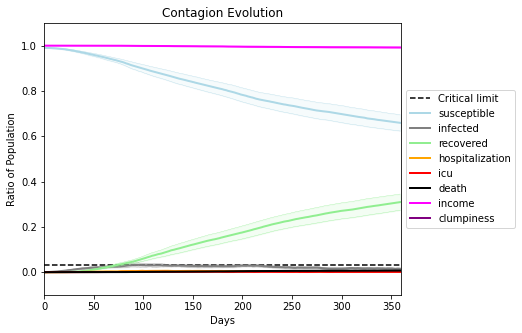

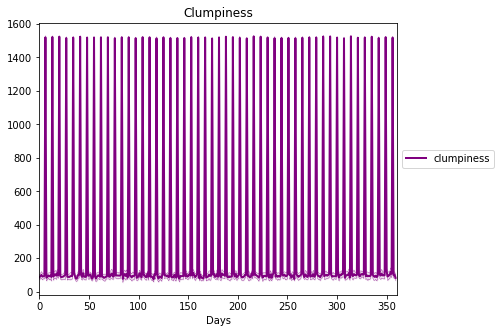

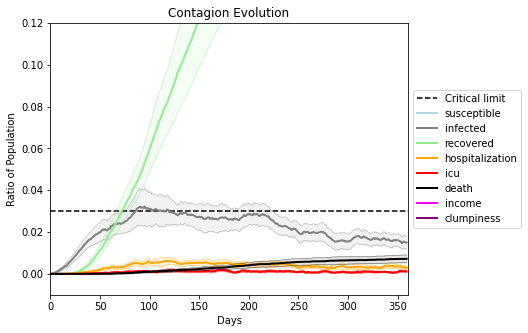

In [15]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], work_home_list = [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[5024, 707, 3842, 5951, 7069, 6719, 1326, 6175, 9603, 7264, 3929, 1534, 7550, 9857, 810, 4254, 69, 9776, 6411, 2719]
Average similarity between family members is 0.5653997500296288 at temperature -0.9
Average similarity between family and home is 0.9998628259932753 at temperature -1
Average similarity between students and their classroom is 0.23419673224226747 at temperature -0.9
Average classroom occupancy is 1.6057142857142856 and number classrooms is 175
Average similarity between workers is 0.45125620507892245 at temperature -0.9
Average office occupancy is 3.251231527093596 and number offices is 203
Average friend similarity for adults: 0.6028809305648926 for kids: 0.5015162285071091
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity 0.060678932834102826
avg restaurant similarity 0.2793681660307923
avg restaurant similarity 0.31999522162071864
avg restaurant similarity 0.1274632607761086
avg restaurant similarity 0.23508768575476133
avg restaurant similarity 0.10044819757995305
avg restaurant similarity 0.25161891984887014
avg restaurant similarity 0.15901127706448628
avg restaurant similarity 0.3996530542686329
avg restaurant similarity 0.2679861597074036
avg restaurant similarity 0.02154606600997239
avg restaurant similarity 0.1048074848862242
avg restaurant similarity 0.20520731690747143
avg restaurant similarity -0.021534857318524423
avg restaurant similarity -0.04882249323500953
avg restaurant similarity 0.03289624148416167
avg restaurant similarity -0.08808503845487874
avg restaurant similarity 0.18671251862499857
avg restaurant similarity 0.31646723759296097
avg restaurant similarity -0.1154611786442424
avg restaurant similarity 0.2331664564894498
avg restaurant similarity 0.0989953

avg restaurant similarity 0.31511059355749904
avg restaurant similarity 0.23515957185565683
avg restaurant similarity 0.23317457647109055
avg restaurant similarity 0.14017429303195258
avg restaurant similarity 0.005193488421473678
avg restaurant similarity 0.22753447652988507
avg restaurant similarity 0.14079352202275666
avg restaurant similarity -0.06007039749320574
avg restaurant similarity 0.029660278125397583
avg restaurant similarity -0.09545776288376073
avg restaurant similarity 0.2513427654557111
avg restaurant similarity 0.18169033036194857
avg restaurant similarity -0.026970011600249987
avg restaurant similarity -0.04800808415658672
avg restaurant similarity 0.3124360764044873
avg restaurant similarity 0.27820835142711137
avg restaurant similarity 0.11114819421750767
avg restaurant similarity 0.24242690802835534
avg restaurant similarity 0.06704989564245081
avg restaurant similarity -0.03879454500111322
avg restaurant similarity -0.011469800838888744
avg restaurant similarity 

Average similarity between family members is 0.5592282185480512 at temperature -0.9
Average similarity between family and home is 0.9998542349633086 at temperature -1
Average similarity between students and their classroom is 0.24141159770565707 at temperature -0.9
Average classroom occupancy is 1.502857142857143 and number classrooms is 175
Average similarity between workers is 0.456705730398493 at temperature -0.9
Average office occupancy is 3.4646464646464645 and number offices is 198
Average friend similarity for adults: 0.6069826540160732 for kids: 0.5109565946454695
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) d

avg restaurant similarity 0.41313825733865556
avg restaurant similarity 0.19634119925732815
avg restaurant similarity 0.12480600863107971
avg restaurant similarity -0.2753376611091937
avg restaurant similarity 0.13318798440901405
avg restaurant similarity 0.1838368974476186
avg restaurant similarity 0.16971509389574915
avg restaurant similarity 0.24913375124098724
avg restaurant similarity 0.24536542996912852
avg restaurant similarity 0.19690681767465626
avg restaurant similarity 0.34512269913468835
avg restaurant similarity 0.16156952586314643
avg restaurant similarity 0.2715018412736514
avg restaurant similarity 0.2262398186181156
avg restaurant similarity 0.3108712272048695
avg restaurant similarity 0.1451642810430901
avg restaurant similarity 0.30185548201923174
avg restaurant similarity 0.06653758738209795
avg restaurant similarity 0.06544955388505186
avg restaurant similarity 0.11188616247720949
avg restaurant similarity 0.22797994332148433
avg restaurant similarity -0.0087898642

avg restaurant similarity 0.1612492660750702
avg restaurant similarity 0.3353458262324263
avg restaurant similarity 0.2019743546667079
avg restaurant similarity -0.20524715958788242
avg restaurant similarity 0.07000625194125155
avg restaurant similarity 0.054476174634204275
avg restaurant similarity 0.01052595196052664
avg restaurant similarity 0.388707321008157
avg restaurant similarity 0.11776261647043933
avg restaurant similarity 0.15292053101064704
avg restaurant similarity 0.15178204006366336
avg restaurant similarity 0.09019434369417205
avg restaurant similarity 0.09282563360582269
avg restaurant similarity -0.03942328120636756
avg restaurant similarity 0.14297237116507314
avg restaurant similarity 0.186009678392632
avg restaurant similarity 0.056305434258942834
avg restaurant similarity -0.06301276120800191
avg restaurant similarity -0.03578327003501632
avg restaurant similarity 0.24495880990997698
avg restaurant similarity 0.013738848828555436
avg restaurant similarity 0.242837

Average similarity between family members is 0.5645032524797005 at temperature -0.9
Average similarity between family and home is 0.9998533733131721 at temperature -1
Average similarity between students and their classroom is 0.21647525563813766 at temperature -0.9
Average classroom occupancy is 1.5921787709497206 and number classrooms is 179
Average similarity between workers is 0.4605120911972728 at temperature -0.9
Average office occupancy is 3.3520408163265305 and number offices is 196
Average friend similarity for adults: 0.598334154868592 for kids: 0.49905460222094067
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0)

avg restaurant similarity 0.09112829956975713
avg restaurant similarity 0.12101592731449366
avg restaurant similarity 0.03392983410810724
avg restaurant similarity 0.12709412017546873
avg restaurant similarity 0.19578241811491925
avg restaurant similarity -0.0014298752903804113
avg restaurant similarity 0.1318694917783796
avg restaurant similarity -0.09733358856864244
avg restaurant similarity 0.09837802798235333
avg restaurant similarity -0.09487812752355938
avg restaurant similarity -0.1038498989163874
avg restaurant similarity -0.011076567004528762
avg restaurant similarity 0.20981028851910813
avg restaurant similarity 0.2917031290114636
avg restaurant similarity -0.06232179617289141
avg restaurant similarity 0.3292151344581464
avg restaurant similarity 0.11841107750189073
avg restaurant similarity -0.05047732821838068
avg restaurant similarity -0.0923748353579435
avg restaurant similarity 0.0035084138958839826
avg restaurant similarity 0.0026161878249661126
avg restaurant similarit

avg restaurant similarity -0.12172772430578399
avg restaurant similarity 0.5221536556662465
avg restaurant similarity -0.17087989764998965
avg restaurant similarity 0.12628601736698689
avg restaurant similarity -0.0358355443050407
avg restaurant similarity 0.2444021703032994
avg restaurant similarity 0.05545798469118086
avg restaurant similarity 0.3243595183932102
avg restaurant similarity 0.14353215446938303
avg restaurant similarity 0.25260800361809405
avg restaurant similarity 0.23696351256106749
avg restaurant similarity 0.0642511814506689
avg restaurant similarity 0.11666411346121348
avg restaurant similarity 0.3388797042016709
avg restaurant similarity 0.1271246207463626
avg restaurant similarity -2.888338836348296e-05
avg restaurant similarity -0.020359065803885013
avg restaurant similarity -0.03866039392478127
avg restaurant similarity -0.009242346131135039
avg restaurant similarity 0.346874057831938
avg restaurant similarity 0.1330342820739769
avg restaurant similarity -0.0094

avg restaurant similarity 0.38959222950703765
avg restaurant similarity 0.08696673416986644
avg restaurant similarity 0.17554958982235752
avg restaurant similarity 0.17482392431823804
avg restaurant similarity 0.25560984987611723
avg restaurant similarity 0.4065529137314224
avg restaurant similarity -0.06518397997401337
avg restaurant similarity 0.10326100338009181
avg restaurant similarity 0.20320438461516557
avg restaurant similarity 0.08378118274646423
avg restaurant similarity 0.432459484414234
avg restaurant similarity 0.1432044062439498
avg restaurant similarity 0.023171440713250356
avg restaurant similarity 0.041859802628852714
avg restaurant similarity 0.22785120474086917
avg restaurant similarity 0.13352144761500517
avg restaurant similarity 0.1057481411810772
avg restaurant similarity 0.06036257541814094
avg restaurant similarity -0.057129106407665144
avg restaurant similarity 0.36031790153567544
avg restaurant similarity 0.25854627687657583
avg restaurant similarity 0.123219

avg restaurant similarity 0.1498651129821899
avg restaurant similarity 0.12492973825934163
avg restaurant similarity 0.1034991420661551
avg restaurant similarity -0.27160301788132907
avg restaurant similarity 0.2578464002595962
avg restaurant similarity 0.08429486736235703
avg restaurant similarity -0.08587034418711478
avg restaurant similarity 0.25672590332124046
avg restaurant similarity 0.016073264462680106
avg restaurant similarity 0.7061119458741991
avg restaurant similarity 0.038752804001602435
avg restaurant similarity 0.5264186148436162
avg restaurant similarity 0.22769756061195465
avg restaurant similarity 0.47185842169424547
avg restaurant similarity 0.25905145063662993
avg restaurant similarity 0.0646725719441062
avg restaurant similarity 0.08249349187683941
avg restaurant similarity -0.02436341489479082
avg restaurant similarity 0.24717753079752194
avg restaurant similarity -0.13705576946888445
avg restaurant similarity 0.308226681168031
avg restaurant similarity 0.42885929

Average similarity between family and home is 0.9998607823080332 at temperature -1
Average similarity between students and their classroom is 0.23080988397327468 at temperature -0.9
Average classroom occupancy is 1.6524064171122994 and number classrooms is 187
Average similarity between workers is 0.45297594140594294 at temperature -0.9
Average office occupancy is 3.1878172588832485 and number offices is 197
Average friend similarity for adults: 0.5923098863241593 for kids: 0.5176958117426061
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 pe

avg restaurant similarity 0.1739377320176834
avg restaurant similarity 0.1930093676944111
avg restaurant similarity -0.0881188077887837
avg restaurant similarity 0.09685716339069393
avg restaurant similarity 0.1312272156476993
avg restaurant similarity 0.3013024194938303
avg restaurant similarity 0.2151098798322445
avg restaurant similarity 0.11275329032931787
avg restaurant similarity 0.14009785704340633
avg restaurant similarity 0.01764820214598771
avg restaurant similarity 0.16486012125329483
avg restaurant similarity 0.2368733693576987
avg restaurant similarity -0.05087084453283076
avg restaurant similarity -0.0028247556370938343
avg restaurant similarity 0.007616772399948304
avg restaurant similarity 0.20435279659182773
avg restaurant similarity -0.0935177843118708
avg restaurant similarity 0.2378601046519216
avg restaurant similarity -0.18811908552276616
avg restaurant similarity 0.3542872821251283
avg restaurant similarity 0.3274660572853432
avg restaurant similarity 0.041621173

avg restaurant similarity 0.13214829199452177
avg restaurant similarity 0.32025395506435017
avg restaurant similarity 0.17063514944644126
avg restaurant similarity 0.017490435919303594
avg restaurant similarity 0.0694077097812611
avg restaurant similarity -0.07405957583126652
avg restaurant similarity -0.03191422220348605
avg restaurant similarity 0.21583495521110718
avg restaurant similarity 0.22840491845634725
avg restaurant similarity 0.16536288858129697
avg restaurant similarity 0.1267816217861692
avg restaurant similarity 0.049097230437971685
avg restaurant similarity -0.08187399211906837
avg restaurant similarity 0.11484355860089016
avg restaurant similarity 0.19496814254469547
avg restaurant similarity 0.24720867717636566
avg restaurant similarity 0.11536310703744418
avg restaurant similarity 0.06346544326668219
avg restaurant similarity 0.3397140265727681
avg restaurant similarity -0.10203211517033169
avg restaurant similarity 0.1172746020347799
avg restaurant similarity -0.213

Average similarity between family and home is 0.999852197518337 at temperature -1
Average similarity between students and their classroom is 0.22218245312159 at temperature -0.9
Average classroom occupancy is 1.536723163841808 and number classrooms is 177
Average similarity between workers is 0.45768836426839404 at temperature -0.9
Average office occupancy is 3.3233830845771144 and number offices is 201
Average friend similarity for adults: 0.6072434118281885 for kids: 0.49541529472724816
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 peop

avg restaurant similarity 0.1870114869658162
avg restaurant similarity 0.2421317288376589
avg restaurant similarity 0.24777204301992042
avg restaurant similarity 0.3212285187811095
avg restaurant similarity 0.2558128593083454
avg restaurant similarity -0.028323641626302316
avg restaurant similarity 0.013359551776100771
avg restaurant similarity 0.036890749420155106
avg restaurant similarity 0.21125601627476412
avg restaurant similarity 0.0959025571297111
avg restaurant similarity 0.050634538337090085
avg restaurant similarity -0.013289635435166966
avg restaurant similarity 0.10859126631432146
avg restaurant similarity -0.018327598164282706
avg restaurant similarity 0.052489628528762114
avg restaurant similarity -0.044477689705191586
avg restaurant similarity 0.041266327818429246
avg restaurant similarity 0.07102357347697708
avg restaurant similarity -0.005944960928625762
avg restaurant similarity 0.004440513420360004
avg restaurant similarity 0.07564603822831248
avg restaurant similari

avg restaurant similarity -0.014439187944142173
avg restaurant similarity 0.08954209455343969
avg restaurant similarity 0.05581454002287131
avg restaurant similarity 0.16873228689688036
avg restaurant similarity -0.17789979173454418
avg restaurant similarity 0.2757309235883243
avg restaurant similarity 0.20557390255843655
avg restaurant similarity 0.12570036272614263
avg restaurant similarity 0.17671550033571123
avg restaurant similarity 0.06553226727422841
avg restaurant similarity 0.11293205904153414
avg restaurant similarity -0.20210941887259387
avg restaurant similarity 0.10454433553445538
avg restaurant similarity 0.11813709072634257
avg restaurant similarity -0.008781181401266255
avg restaurant similarity 0.037670352650617724
avg restaurant similarity 0.16444867473419908
avg restaurant similarity 0.02742794644743181
avg restaurant similarity -0.09826151506091664
avg restaurant similarity 0.2712900766786601
avg restaurant similarity 0.2562612530235262
avg restaurant similarity 0.1

Average similarity between students and their classroom is 0.22599982826383225 at temperature -0.9
Average classroom occupancy is 1.7391304347826086 and number classrooms is 161
Average similarity between workers is 0.46230826823732485 at temperature -0.9
Average office occupancy is 3.315 and number offices is 200
Average friend similarity for adults: 0.6019561330271012 for kids: 0.48828964417950155
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this dist

avg restaurant similarity 0.007226363992401549
avg restaurant similarity 0.03279526445168128
avg restaurant similarity 0.35279226471609143
avg restaurant similarity 0.12656671611227882
avg restaurant similarity 0.4658701675863209
avg restaurant similarity 0.045689552721616754
avg restaurant similarity -0.0025777553024788624
avg restaurant similarity 0.2844382725881555
avg restaurant similarity 0.08572472158242388
avg restaurant similarity 0.32099305593034994
avg restaurant similarity 0.3415235163489092
avg restaurant similarity -0.005279490559980852
avg restaurant similarity 0.12422877688712679
avg restaurant similarity 0.01945956391057875
avg restaurant similarity 0.3518772912258699
avg restaurant similarity -0.0761012626476412
avg restaurant similarity 0.16060986295125737
avg restaurant similarity 0.11358759441461401
avg restaurant similarity 0.045887746674283525
avg restaurant similarity -0.03929359871813864
avg restaurant similarity -0.0736517384433442
avg restaurant similarity 0.1

avg restaurant similarity -0.005987865375606749
avg restaurant similarity 0.09101314683701857
avg restaurant similarity -0.03335728679851753
avg restaurant similarity -0.11367123760951255
avg restaurant similarity 0.4908169572291195
avg restaurant similarity 0.3636579203684992
avg restaurant similarity 0.2450684793103715
avg restaurant similarity 0.10904815528524246
avg restaurant similarity 0.16809963835532027
avg restaurant similarity 0.3138080621164243
avg restaurant similarity 0.03293550457956218
avg restaurant similarity 0.07001852624919615
avg restaurant similarity 0.02405686799622377
avg restaurant similarity 0.31355160763136236
avg restaurant similarity 0.3426452903767139
avg restaurant similarity 0.1909430366858598
avg restaurant similarity -0.07448573985962798
avg restaurant similarity 0.10277690306536519
avg restaurant similarity 0.07107569211851142
avg restaurant similarity -0.06879422855325622
avg restaurant similarity 0.15738427080079434
avg restaurant similarity 0.352364

Average similarity between workers is 0.4577545256700872 at temperature -0.9
Average office occupancy is 3.386934673366834 and number offices is 199
Average friend similarity for adults: 0.6097652748399783 for kids: 0.5045751906747505
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 6 people.
Total of 6 pe

avg restaurant similarity 0.3313132413867091
avg restaurant similarity 0.247841077443453
avg restaurant similarity 0.16227049906378882
avg restaurant similarity 0.059464050819847986
avg restaurant similarity 0.3080505787347664
avg restaurant similarity 0.14494758348656925
avg restaurant similarity 0.08738212275903721
avg restaurant similarity 0.19138240853673077
avg restaurant similarity 0.1680473640001869
avg restaurant similarity 0.21043844659594774
avg restaurant similarity 0.28476674557411824
avg restaurant similarity 0.10246578036484931
avg restaurant similarity 0.19363832362478184
avg restaurant similarity 0.21008991124017073
avg restaurant similarity 0.1770070062207526
avg restaurant similarity 0.15615624787504426
avg restaurant similarity 0.47013201461587684
avg restaurant similarity 0.18652564383191514
avg restaurant similarity -0.021526499520228122
avg restaurant similarity 0.1723833449979005
avg restaurant similarity -0.008175228257141546
avg restaurant similarity 0.26490868

avg restaurant similarity 0.2704729601989287
avg restaurant similarity 0.4299341175738165
avg restaurant similarity 0.5754672298773694
avg restaurant similarity 0.30365033940396313
avg restaurant similarity 0.3566427087434768
avg restaurant similarity 0.2955200153757624
avg restaurant similarity 0.20644979926040818
avg restaurant similarity 0.08865200571615506
avg restaurant similarity -0.1879670640076671
avg restaurant similarity 0.29854546400656506
avg restaurant similarity 0.2735688511874526
avg restaurant similarity 0.03547659214134083
avg restaurant similarity -0.15169724680350208
avg restaurant similarity 0.07629220946334407
avg restaurant similarity 0.17954419930360407
avg restaurant similarity 0.38916390436958687
avg restaurant similarity 0.23593511372038242
avg restaurant similarity 0.13998018184115477
avg restaurant similarity 0.044820037180427985
avg restaurant similarity 0.036315829155983824
avg restaurant similarity 0.4265689419299015
avg restaurant similarity -0.143121611

Average similarity between workers is 0.46162448013557716 at temperature -0.9
Average office occupancy is 3.3636363636363638 and number offices is 198
Average friend similarity for adults: 0.607523137680053 for kids: 0.497477606634098
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 peop

avg restaurant similarity 0.23575062256230417
avg restaurant similarity 0.09914085066514937
avg restaurant similarity 0.051797091795772285
avg restaurant similarity 0.06021825518369269
avg restaurant similarity -0.04083001234786682
avg restaurant similarity 0.23579530585801245
avg restaurant similarity 0.017548343101056737
avg restaurant similarity -0.05474010557455095
avg restaurant similarity 0.07810781201032238
avg restaurant similarity 0.07695187723284923
avg restaurant similarity 0.21229928977595225
avg restaurant similarity 0.01652267146531358
avg restaurant similarity -0.058186789793111024
avg restaurant similarity 0.24217969927402078
avg restaurant similarity 0.15052097040725287
avg restaurant similarity -0.10666846719505267
avg restaurant similarity 0.034245481152498695
avg restaurant similarity 0.2409845431623944
avg restaurant similarity 0.06991991011346163
avg restaurant similarity 0.011500066595160072
avg restaurant similarity 0.3753987820524878
avg restaurant similarity 0

avg restaurant similarity 0.07165285993768053
avg restaurant similarity 0.10188291599338524
avg restaurant similarity 0.15983319021291637
avg restaurant similarity 0.04082221869738659
avg restaurant similarity 0.33920670599101505
avg restaurant similarity 0.11902091704023128
avg restaurant similarity 0.0670689294964122
avg restaurant similarity -0.12115941339785889
avg restaurant similarity 0.08333695571958492
avg restaurant similarity 0.12434989475644653
avg restaurant similarity 0.1814636528919523
avg restaurant similarity 0.08342978648766736
avg restaurant similarity 0.14552769648953467
avg restaurant similarity 0.03573950928400164
avg restaurant similarity -0.07897783034250694
avg restaurant similarity 0.1733007987345174
avg restaurant similarity 0.05039728573164951
avg restaurant similarity -0.012940568067696615
avg restaurant similarity 0.031892605159114996
avg restaurant similarity 0.2663311761956141
avg restaurant similarity 0.1008114176804431
avg restaurant similarity 0.054063

Average similarity between family and home is 0.999848710148548 at temperature -1
Average similarity between students and their classroom is 0.22301596024244597 at temperature -0.9
Average classroom occupancy is 1.560693641618497 and number classrooms is 173
Average similarity between workers is 0.4580053448435645 at temperature -0.9
Average office occupancy is 3.2634146341463413 and number offices is 205
Average friend similarity for adults: 0.6043984807814916 for kids: 0.48999639476185847
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 pe

avg restaurant similarity 0.11204532219500493
avg restaurant similarity 0.33205449539506665
avg restaurant similarity 0.22602995684057348
avg restaurant similarity 0.03239082833536829
avg restaurant similarity 0.1903386352758329
avg restaurant similarity 0.15125451454491917
avg restaurant similarity 0.05452216444285851
avg restaurant similarity 0.23490466475708452
avg restaurant similarity 0.17962076399201693
avg restaurant similarity 0.21067321165447822
avg restaurant similarity 0.19029730973646583
avg restaurant similarity 0.10165934144503512
avg restaurant similarity 0.12536810557722236
avg restaurant similarity -0.09367707815783535
avg restaurant similarity 0.09854948512425676
avg restaurant similarity 0.08010140526868487
avg restaurant similarity -0.1989236423785436
avg restaurant similarity 0.6187100349569385
avg restaurant similarity 0.09977544199515424
avg restaurant similarity 0.1803936930290535
avg restaurant similarity 0.4390800776174478
avg restaurant similarity 0.025370570

avg restaurant similarity 0.07716637842608648
avg restaurant similarity 0.011747012422563919
avg restaurant similarity -0.11665320943174247
avg restaurant similarity 0.18584750620245652
avg restaurant similarity 0.15692490714034804
avg restaurant similarity 0.2957265468387112
avg restaurant similarity 0.12925548321262414
avg restaurant similarity 0.16551569507619351
avg restaurant similarity -0.023815639657337573
avg restaurant similarity 0.2116609268497991
avg restaurant similarity 0.16403927768030707
avg restaurant similarity 0.1850930996926136
avg restaurant similarity 0.18508344785382227
avg restaurant similarity 0.240775437112335
avg restaurant similarity -0.013171548276707613
avg restaurant similarity 0.13554603026084133
avg restaurant similarity 0.3103343910725065
avg restaurant similarity 0.07546672843073815
avg restaurant similarity -0.07259741392185305
avg restaurant similarity 0.1451660335459677
avg restaurant similarity -0.1984760619432182
avg restaurant similarity -0.23346

avg restaurant similarity 0.31478267113856334
avg restaurant similarity 0.3723321915063296
avg restaurant similarity 0.18632448850161382
avg restaurant similarity 0.21774102054267486
avg restaurant similarity -0.024871397735059135
avg restaurant similarity 0.15913771852797712
avg restaurant similarity -0.000938435252887157
avg restaurant similarity -0.019433193799759486
avg restaurant similarity 0.22277552266243272
avg restaurant similarity -0.013020942490841297
avg restaurant similarity 0.002039416511982403
avg restaurant similarity 0.18423997809754927
avg restaurant similarity 0.1521627050052832
avg restaurant similarity 0.11160121782755782
avg restaurant similarity 0.3165513823627495
avg restaurant similarity -0.0725204034318038
avg restaurant similarity 0.17560518155872143
avg restaurant similarity 0.1854415782268407
avg restaurant similarity 0.12514764750732105
avg restaurant similarity -0.10713146957962333
avg restaurant similarity 0.005267479964858046
avg restaurant similarity 0

avg restaurant similarity 0.16051962925277174
avg restaurant similarity 0.004825540666474051
avg restaurant similarity 0.07103094021817237
avg restaurant similarity -0.08056907656332978
avg restaurant similarity 0.2326578004472098
avg restaurant similarity 0.22466233664234275
avg restaurant similarity -0.10409267559396009
avg restaurant similarity 0.274000508607491
avg restaurant similarity 0.1318899410909343
avg restaurant similarity 0.25723179917849265
avg restaurant similarity 0.02379387599983154
avg restaurant similarity 0.17836159113471428
avg restaurant similarity 0.2882445266495069
avg restaurant similarity -0.043432619514366055
avg restaurant similarity 0.31596069073797567
avg restaurant similarity 0.03446571634286458
avg restaurant similarity 0.15572658962990632
avg restaurant similarity -0.015602577710950118
avg restaurant similarity -0.10062167853770038
avg restaurant similarity 0.07484665777918637
avg restaurant similarity 0.13494327987647847
avg restaurant similarity 0.027

Average similarity between students and their classroom is 0.22787904423537242 at temperature -0.9
Average classroom occupancy is 1.6054054054054054 and number classrooms is 185
Average similarity between workers is 0.4608088282388793 at temperature -0.9
Average office occupancy is 3.198019801980198 and number offices is 202
Average friend similarity for adults: 0.6084176140161114 for kids: 0.5164039700452767
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in

avg restaurant similarity 0.10452741824016698
avg restaurant similarity 0.11042453827986154
avg restaurant similarity 0.17758207328896353
avg restaurant similarity 0.17082602601667785
avg restaurant similarity 0.14818044439939843
avg restaurant similarity -0.019026925180497235
avg restaurant similarity 0.07936244718627371
avg restaurant similarity 0.09228761498267611
avg restaurant similarity 0.06597413403904327
avg restaurant similarity 0.2594236191063963
avg restaurant similarity 0.4079323425607889
avg restaurant similarity 0.28548197044311335
avg restaurant similarity 0.06568249829650427
avg restaurant similarity 0.26870806683478576
avg restaurant similarity 0.06119292483368592
avg restaurant similarity 0.02727289420496293
avg restaurant similarity 0.09170254977376069
avg restaurant similarity 0.015114492594898006
avg restaurant similarity 0.05917987169181782
avg restaurant similarity -0.03802368216234065
avg restaurant similarity 0.06256587030271628
avg restaurant similarity 0.1561

avg restaurant similarity -0.05804981932356063
avg restaurant similarity 0.12868023312177249
avg restaurant similarity 0.25124446505787706
avg restaurant similarity -0.05747871283471426
avg restaurant similarity 0.060940808331048264
avg restaurant similarity 0.11722918308185357
avg restaurant similarity 0.08457498388964646
avg restaurant similarity 0.024234832536735706
avg restaurant similarity 0.09692819221232955
avg restaurant similarity 0.4408049981172381
avg restaurant similarity 0.15920199017076056
avg restaurant similarity 0.18236001103221952
avg restaurant similarity 0.0026140740282219617
avg restaurant similarity 0.20749471759170135
avg restaurant similarity 0.1451440500110195
avg restaurant similarity -0.009191960354414637
avg restaurant similarity 0.3161830714840275
avg restaurant similarity 0.11265809552472926
avg restaurant similarity 0.15922653145675822
avg restaurant similarity -0.06461491331190661
avg restaurant similarity 0.09643632893507754
avg restaurant similarity -0

avg restaurant similarity -0.0874847564547134
avg restaurant similarity 0.13333750707285422
avg restaurant similarity 0.227031558922832
Average similarity between family members is 0.5791624746246822 at temperature -0.9
Average similarity between family and home is 0.9998547417101235 at temperature -1
Average similarity between students and their classroom is 0.2576440109765797 at temperature -0.9
Average classroom occupancy is 1.543956043956044 and number classrooms is 182
Average similarity between workers is 0.4683686082254029 at temperature -0.9
Average office occupancy is 3.2814070351758793 and number offices is 199
Average friend similarity for adults: 0.6123799153938883 for kids: 0.5122152769366962
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each 

avg restaurant similarity 0.1746157720127603
avg restaurant similarity 0.1653109836086067
avg restaurant similarity -0.03217076549637391
avg restaurant similarity 0.10871824260895947
avg restaurant similarity 0.13547980520213723
avg restaurant similarity -0.045224100998307266
avg restaurant similarity 0.3142593596849801
avg restaurant similarity 0.3686353443288436
avg restaurant similarity 0.15509587741326694
avg restaurant similarity 0.15480835006824173
avg restaurant similarity -0.25018583464791083
avg restaurant similarity 0.2443394086542927
avg restaurant similarity 0.2537362728293954
avg restaurant similarity 0.021416498829448714
avg restaurant similarity 0.1343083115015674
avg restaurant similarity 0.2928255629201557
avg restaurant similarity 0.4655029219807187
avg restaurant similarity 0.30958183628304825
avg restaurant similarity 0.27680336372116426
avg restaurant similarity 0.19508829600802235
avg restaurant similarity 0.3828886686025173
avg restaurant similarity 0.06667405728

avg restaurant similarity 0.2545312324208043
avg restaurant similarity 0.08598222791074296
avg restaurant similarity 0.256988923436317
avg restaurant similarity 0.06620492194587053
avg restaurant similarity 0.03514289278062437
avg restaurant similarity 0.33886864985421844
avg restaurant similarity 0.11102284447152964
avg restaurant similarity -0.04864096555519622
avg restaurant similarity 0.2353248825875438
avg restaurant similarity 0.09561673004374632
avg restaurant similarity 0.20934653425215843
avg restaurant similarity 0.22371781037120042
avg restaurant similarity 0.08649221010600294
avg restaurant similarity 0.255313393489424
avg restaurant similarity 7.995260621317807e-05
avg restaurant similarity 0.20502855114111557
avg restaurant similarity 0.06831166355796604
avg restaurant similarity -0.12996962264758502
avg restaurant similarity 0.0708486408665841
avg restaurant similarity 0.17317948758849688
avg restaurant similarity 0.28336139957548323
avg restaurant similarity 0.298102385

Average friend similarity for adults: 0.6044534971795689 for kids: 0.5149624460460456
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 alloc

avg restaurant similarity 0.148903394399627
avg restaurant similarity 0.17366874070571486
avg restaurant similarity 0.006002750254432868
avg restaurant similarity -0.0070429529683474715
avg restaurant similarity 0.0937595156221237
avg restaurant similarity 0.11344835280328043
avg restaurant similarity 0.06233013852056964
avg restaurant similarity 0.17611693196320752
avg restaurant similarity 0.13986145173225858
avg restaurant similarity 0.22464120538209112
avg restaurant similarity -0.009350219075971907
avg restaurant similarity 0.2867488436691734
avg restaurant similarity 0.16913618534945585
avg restaurant similarity 0.22583016749021936
avg restaurant similarity 0.17190551835935913
avg restaurant similarity 0.04178156237731945
avg restaurant similarity 0.13487616847195705
avg restaurant similarity 0.07415019608899366
avg restaurant similarity 0.09974775549680437
avg restaurant similarity 0.09836256812422073
avg restaurant similarity 0.26671169870283984
avg restaurant similarity 0.0750

avg restaurant similarity 0.023486082651468582
avg restaurant similarity 0.08538340457552367
avg restaurant similarity 0.13051379435086902
avg restaurant similarity 0.2248896316803316
avg restaurant similarity 0.1939041182985215
avg restaurant similarity 0.11430877452350707
avg restaurant similarity 0.15525736803782883
avg restaurant similarity 0.06540297491321784
avg restaurant similarity 0.10214932145076601
avg restaurant similarity -0.04393563236553271
avg restaurant similarity 0.08786776805997612
avg restaurant similarity 0.22630250276271682
avg restaurant similarity -0.005134077224927869
avg restaurant similarity 0.09682098063056956
avg restaurant similarity 0.14944367168424483
avg restaurant similarity 0.006427806849217601
avg restaurant similarity 0.08107585617162606
avg restaurant similarity 0.08863502114809164
avg restaurant similarity 0.05849016583130307
avg restaurant similarity 0.2498138368463694
avg restaurant similarity 0.11069977110176285
avg restaurant similarity 0.3600

avg restaurant similarity 0.24259443333727415
avg restaurant similarity -0.15169638008002742
Average similarity between family members is 0.5542099369247894 at temperature -0.9
Average similarity between family and home is 0.9998595196510833 at temperature -1
Average similarity between students and their classroom is 0.21403103549897723 at temperature -0.9
Average classroom occupancy is 1.5806451612903225 and number classrooms is 186
Average similarity between workers is 0.44972480068704174 at temperature -0.9
Average office occupancy is 3.3197969543147208 and number offices is 197
Average friend similarity for adults: 0.6008757248890212 for kids: 0.4989148000408397
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.12846192205655507
avg restaurant similarity 0.05928463288107271
avg restaurant similarity -0.012715182195935933
avg restaurant similarity 0.14587827353003452
avg restaurant similarity -0.03190361903712892
avg restaurant similarity -0.022789594978840533
avg restaurant similarity 0.261939337581976
avg restaurant similarity 0.2594937779827179
avg restaurant similarity -0.08605834105690821
avg restaurant similarity 0.16219884059830417
avg restaurant similarity 0.1861865494978544
avg restaurant similarity -0.018394930505066524
avg restaurant similarity 0.15063590919392517
avg restaurant similarity 0.31427271679039037
avg restaurant similarity 0.3285210288083178
avg restaurant similarity 0.13187124742925724
avg restaurant similarity 0.0820411531138195
avg restaurant similarity 0.07932962243583924
avg restaurant similarity 0.10357986485814288
avg restaurant similarity 0.030002421565815344
avg restaurant similarity 0.18839092277166208
avg restaurant similarity 0.155

avg restaurant similarity 0.0689877542170505
avg restaurant similarity 0.06971498829725269
avg restaurant similarity 0.19678308527940533
avg restaurant similarity -0.03896974446141227
avg restaurant similarity 0.06952229501797083
avg restaurant similarity 0.3554061788291454
avg restaurant similarity 0.3305884966837559
avg restaurant similarity -0.09166439119200698
avg restaurant similarity 0.12856872211526008
avg restaurant similarity -0.07803257025654013
avg restaurant similarity 0.1531615649268293
avg restaurant similarity 0.3288649870453504
avg restaurant similarity 0.02299162038497534
avg restaurant similarity 0.23983712937424875
avg restaurant similarity 0.23599193928986253
avg restaurant similarity -0.1318848992369564
avg restaurant similarity 0.33179615491562275
avg restaurant similarity -0.43597899706189425
avg restaurant similarity -0.29337568002830544
avg restaurant similarity 0.3720391322196979
avg restaurant similarity 0.11753934063576313
avg restaurant similarity 0.0589299

Average similarity between workers is 0.4670925727617784 at temperature -0.9
Average office occupancy is 3.183673469387755 and number offices is 196
Average friend similarity for adults: 0.607065126425452 for kids: 0.5172366548783895
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 peo

avg restaurant similarity 0.019074507565672538
avg restaurant similarity 0.058370175695099696
avg restaurant similarity -0.13045203312382755
avg restaurant similarity 0.09146536968889801
avg restaurant similarity 0.5317695538301189
avg restaurant similarity 0.15621854362393495
avg restaurant similarity -0.2041030610902565
avg restaurant similarity -0.10678266035538642
avg restaurant similarity 0.1521362520942315
avg restaurant similarity 0.08435006577758399
avg restaurant similarity -0.3809495186776428
avg restaurant similarity 0.17071143562668445
avg restaurant similarity 0.023125950617024684
avg restaurant similarity 0.021642382258067028
avg restaurant similarity 0.14491866882283638
avg restaurant similarity 0.016502249587304722
avg restaurant similarity 0.4075575386412396
avg restaurant similarity 0.29587776338178556
avg restaurant similarity 0.2007273440225765
avg restaurant similarity 0.18448694072971247
avg restaurant similarity 0.012655339337990781
avg restaurant similarity 0.18

avg restaurant similarity -0.11494604833328798
avg restaurant similarity -0.034623346030682504
avg restaurant similarity 0.5019420984318766
avg restaurant similarity 0.282242132927581
avg restaurant similarity 0.3104475052926124
avg restaurant similarity -0.06471695828527219
avg restaurant similarity -0.07508315821555647
avg restaurant similarity 0.2394539677441891
avg restaurant similarity -0.020880711510457128
avg restaurant similarity 0.04915760635469651
avg restaurant similarity 0.3069254282271974
avg restaurant similarity 0.4463722829254883
avg restaurant similarity 0.24550866371312888
avg restaurant similarity 0.26249458291341726
avg restaurant similarity -0.08296662957162364
avg restaurant similarity 0.2634386320738073
avg restaurant similarity 0.2215939682852602
avg restaurant similarity -0.10121576420933864
avg restaurant similarity 0.27694757154278193
avg restaurant similarity -0.11015932524755946
avg restaurant similarity 0.22622971088400695
avg restaurant similarity 0.34658

avg restaurant similarity -0.1337947914015651
avg restaurant similarity 0.005245396489296719
avg restaurant similarity 0.11687128339778166
avg restaurant similarity 0.24024388011578268
avg restaurant similarity 0.2180422759100365
avg restaurant similarity 0.03820937347298986
avg restaurant similarity 0.2138239720134041
avg restaurant similarity 0.2498052539910901
avg restaurant similarity 0.3958773572661439
avg restaurant similarity 0.26958664226153295
avg restaurant similarity 0.27142339366020074
avg restaurant similarity 0.0810933058497069
avg restaurant similarity 0.2646660668491231
avg restaurant similarity 0.0728970939928877
avg restaurant similarity -0.10792273769786331
avg restaurant similarity 0.2785634257739535
avg restaurant similarity 0.3993908352888399
avg restaurant similarity 0.15966323091931184
avg restaurant similarity 0.24841457072248121
avg restaurant similarity 0.21580929925131254
avg restaurant similarity 0.03078113280358443
avg restaurant similarity 0.0600733337325

avg restaurant similarity 0.3371681302124451
avg restaurant similarity 0.03464689641165909
avg restaurant similarity 0.05324710073470104
avg restaurant similarity 0.31289830186569834
avg restaurant similarity -0.30465171024754956
avg restaurant similarity 0.3646816093883708
avg restaurant similarity -0.3624307919053949
avg restaurant similarity 0.03496813003531873
avg restaurant similarity 0.055717170686904495
avg restaurant similarity -0.20368892910926326
avg restaurant similarity 0.35813992205461287
avg restaurant similarity 0.1656567369313443
avg restaurant similarity 0.11260151194073342
avg restaurant similarity 0.2874408770561692
avg restaurant similarity -0.0017088145401345373
avg restaurant similarity 0.019702978873996795
avg restaurant similarity 0.3253686303812927
avg restaurant similarity 0.07599192404650322
avg restaurant similarity -0.08478515598431907
avg restaurant similarity -0.07256526982052129
avg restaurant similarity 0.3102153247781535
avg restaurant similarity 0.025

avg restaurant similarity 0.08494595036785492
avg restaurant similarity -0.025634659822611348
avg restaurant similarity 0.3057873728044669
avg restaurant similarity 0.07644354090336482
avg restaurant similarity 0.11658544860749691
avg restaurant similarity 0.31628521019738565
avg restaurant similarity 0.3111196942090988
avg restaurant similarity 0.2679502491130157
avg restaurant similarity 0.1487082144745175
avg restaurant similarity 0.18669328481658748
avg restaurant similarity 0.254566477559284
avg restaurant similarity 0.14703474356837634
avg restaurant similarity 0.025836493808162074
avg restaurant similarity 0.21511908836970925
avg restaurant similarity 0.200191974222505
avg restaurant similarity 0.159861842926665
avg restaurant similarity -0.01899542166573863
avg restaurant similarity 0.0043034792710918745
avg restaurant similarity 0.3464391966555943
avg restaurant similarity 0.21990198895647056
avg restaurant similarity -0.012578904249937817
avg restaurant similarity 0.007932959

avg restaurant similarity 0.08984965865263522
avg restaurant similarity 0.3440043775986127
avg restaurant similarity -0.024497882772065535
avg restaurant similarity 0.08685427575755121
avg restaurant similarity 0.14878284774170503
avg restaurant similarity 0.004205220978048679
avg restaurant similarity 0.10861057126556589
avg restaurant similarity 0.11184981367082915
avg restaurant similarity 0.17521731449356537
avg restaurant similarity -0.2700551627639493
avg restaurant similarity 0.05143562740255708
avg restaurant similarity 0.1586541903722966
avg restaurant similarity 0.15227594463294092
avg restaurant similarity -0.001498947508566642
avg restaurant similarity 0.19045179090681294
avg restaurant similarity 0.18358865284253792
avg restaurant similarity 0.07418353401800991
avg restaurant similarity 0.2674814674364648
avg restaurant similarity 0.17351686474574718
avg restaurant similarity 0.38016471670527224
avg restaurant similarity 0.14463536350245274
avg restaurant similarity 0.0132

avg restaurant similarity -0.16843123910362656
avg restaurant similarity 0.11987380028480772
Average similarity between family members is 0.5554756774398271 at temperature -0.9
Average similarity between family and home is 0.9998402914012331 at temperature -1
Average similarity between students and their classroom is 0.2642885710055264 at temperature -0.9
Average classroom occupancy is 1.563953488372093 and number classrooms is 172
Average similarity between workers is 0.44994898519116167 at temperature -0.9
Average office occupancy is 3.3251231527093594 and number offices is 203
Average friend similarity for adults: 0.6054551125215499 for kids: 0.49383962391598785
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.04564607589286627
avg restaurant similarity 0.10984872933668807
avg restaurant similarity 0.007362933425108474
avg restaurant similarity 0.12183218190279267
avg restaurant similarity 0.014850075947534895
avg restaurant similarity -0.1254814581069356
avg restaurant similarity 0.15985734014602027
avg restaurant similarity -0.063969156214225
avg restaurant similarity 0.19182817301506205
avg restaurant similarity 0.12376657090352679
avg restaurant similarity 0.05942977417240675
avg restaurant similarity 0.07038600885855516
avg restaurant similarity 0.12049511554627927
avg restaurant similarity 0.12932837580583292
avg restaurant similarity -0.07332506070056694
avg restaurant similarity -0.0387003533293157
avg restaurant similarity -0.050950020914312034
avg restaurant similarity 0.19925307526913766
avg restaurant similarity 0.25163822558656396
avg restaurant similarity 0.0051582654281465915
avg restaurant similarity 0.09617990588325455
avg restaurant similarity 0.

avg restaurant similarity 0.24921132749062713
avg restaurant similarity -0.005677858545232999
avg restaurant similarity -0.11264756347042396
avg restaurant similarity -0.0411604808067094
avg restaurant similarity -0.1330707931812007
avg restaurant similarity 0.1510377882189396
avg restaurant similarity 0.027845711288068578
avg restaurant similarity 0.14044239308344006
avg restaurant similarity 0.11017029895754284
avg restaurant similarity 0.26604284689236796
avg restaurant similarity 0.09898008271835393
avg restaurant similarity 0.19419674411880672
avg restaurant similarity 0.05059980632495794
avg restaurant similarity 0.43663558608751013
avg restaurant similarity 0.37858391237313566
avg restaurant similarity 0.05463665547952518
avg restaurant similarity 0.1745609157876372
avg restaurant similarity 0.16338101702794933
avg restaurant similarity 0.023388791143329923
avg restaurant similarity -0.07578173112017147
avg restaurant similarity 0.17945830489715853
avg restaurant similarity 0.05

avg restaurant similarity 0.03663815010127698
avg restaurant similarity 0.06922056096881385
Average similarity between family members is 0.5602146859253456 at temperature -0.9
Average similarity between family and home is 0.9998592823243473 at temperature -1
Average similarity between students and their classroom is 0.24883612273725653 at temperature -0.9
Average classroom occupancy is 1.5797872340425532 and number classrooms is 188
Average similarity between workers is 0.45417231272455344 at temperature -0.9
Average office occupancy is 3.306122448979592 and number offices is 196
Average friend similarity for adults: 0.6052161005465678 for kids: 0.506263384502297
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated 

avg restaurant similarity 0.12336961849023205
avg restaurant similarity 0.11072342311685278
avg restaurant similarity 0.009144176589711287
avg restaurant similarity -0.052400265640115316
avg restaurant similarity 0.12028208201270552
avg restaurant similarity 0.2186299460280734
avg restaurant similarity 0.39183961343540835
avg restaurant similarity -0.13741866627198532
avg restaurant similarity 0.11243233177746752
avg restaurant similarity -0.007684982783388097
avg restaurant similarity 0.011852422612647975
avg restaurant similarity 0.01534727720014132
avg restaurant similarity 0.13677580004509152
avg restaurant similarity 0.1354641493480731
avg restaurant similarity 0.12147184138772694
avg restaurant similarity 0.012659720193166598
avg restaurant similarity -0.10698044008070073
avg restaurant similarity 0.03453555846069586
avg restaurant similarity 0.13461753277082578
avg restaurant similarity 0.06281712072692516
avg restaurant similarity 0.09473095753899947
avg restaurant similarity 0

avg restaurant similarity 0.3560289316526275
avg restaurant similarity -0.12632747026745156
avg restaurant similarity 0.04766199265602079
avg restaurant similarity 0.024350975415107216
avg restaurant similarity 0.23658313689402855
avg restaurant similarity 0.06546410409994227
avg restaurant similarity 0.08557363573864386
avg restaurant similarity 0.13292260785863796
avg restaurant similarity 0.22073806812104452
avg restaurant similarity -0.053992949190762904
avg restaurant similarity 0.025918607060801714
avg restaurant similarity 0.1960073900231627
avg restaurant similarity 0.26765383817186433
avg restaurant similarity 0.26005524909268607
avg restaurant similarity 0.01575923890424013
avg restaurant similarity 0.050852538909800966
avg restaurant similarity 0.028357574554687813
avg restaurant similarity 0.03523738590956946
avg restaurant similarity 0.12747145435926513
avg restaurant similarity -0.2285657818187556
avg restaurant similarity 0.1779658361289853
avg restaurant similarity -0.1

avg restaurant similarity 0.10717030868274639
using average of time series:
stats on susceptible:
data: [0.7065119760479041, 0.8144000000000001, 0.7525472222222223, 0.8710527777777778, 0.886636111111111, 0.8145249999999999, 0.7011527777777778, 0.72135, 0.7655472222222222, 0.7465583333333332, 0.7612222222222221, 0.8512694444444444, 0.8786527777777777, 0.7250972222222222, 0.7634638888888888, 0.7892024642024642, 0.7726472222222223, 0.8390000000000001, 0.8180555555555555, 0.8299955644267022]
min:
0.7011527777777778
max:
0.886636111111111
std:
0.05613072955431614
mean:
0.7904443891227425
median:
0.7809248432123432
95% confidence interval for the mean:
(0.7634919479970397,0.8173968302484453)
using average of time series:
stats on infected:
data: [0.028296185406963846, 0.018811111111111115, 0.02741666666666667, 0.013038888888888888, 0.013336111111111111, 0.019330555555555556, 0.033175, 0.030602777777777777, 0.025416666666666667, 0.02738611111111111, 0.02250277777777778, 0.019133333333333332, 

(<function dict.items>, <function dict.items>, <function dict.items>)

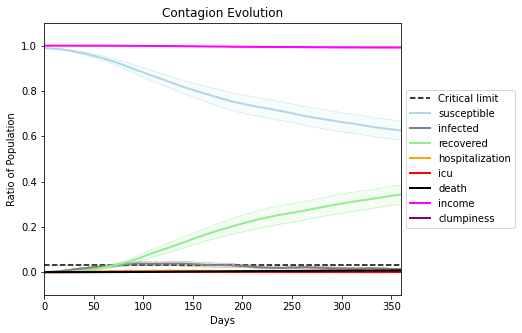

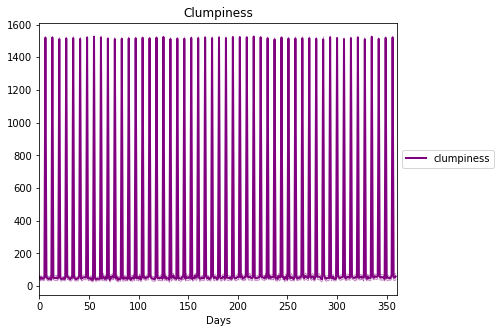

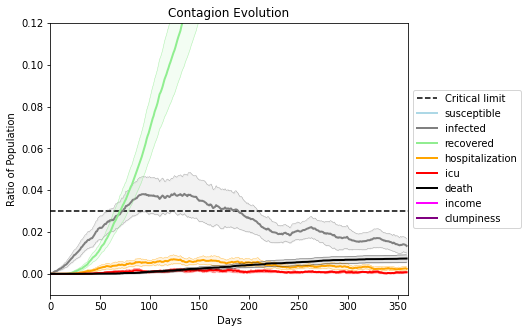

In [16]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9
params.params['num_communities'] = 100
seeds = [2252]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs=20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],
              work_home_list = 
            
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9886, 3638, 7408, 4634, 4046, 3642, 3801, 4849, 2593, 3072, 8409, 8467, 6046, 5538, 7031, 465, 6118, 7423, 3586, 6234]
Average similarity between family members is 0.4315837962468869 at temperature -0.8
Average similarity between family and home is 0.9998591896900436 at temperature -1
Average similarity between students and their classroom is 0.1643713116000279 at temperature -0.8
Average classroom occupancy is 1.6263736263736264 and number classrooms is 182
Average similarity between workers is 0.2998226402909865 at temperature -0.8
Average office occupancy is 3.28643216080402 and number offices is 199
Average friend similarity for adults: 0.4976748080219999 for kids: 0.3856407871100941
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.17827680623416228
avg restaurant similarity 0.08585674544617322
avg restaurant similarity 0.04859159051947534
avg restaurant similarity 0.05855835848784324
avg restaurant similarity 0.09879480611554708
avg restaurant similarity 0.43370308491292947
avg restaurant similarity 0.03848019798285517
avg restaurant similarity 0.09103142082953448
avg restaurant similarity 0.03470652835465245
avg restaurant similarity -0.16655976760802574
avg restaurant similarity 0.20838010184544267
avg restaurant similarity -0.03379887953950522
avg restaurant similarity 0.09957535614661314
avg restaurant similarity 0.00930638223182205
avg restaurant similarity 0.10512092234721862
avg restaurant similarity 0.019907695839497988
avg restaurant similarity 0.08215671276720668
avg restaurant similarity 0.026853325076298132
avg restaurant similarity 0.014483560550604244
avg restaurant similarity 0.17841545158835748
avg restaurant similarity 0.1039712509238472
avg restaurant similarity 0.07

avg restaurant similarity -0.043253388344071206
avg restaurant similarity -0.3019945323141745
avg restaurant similarity 0.0513458501899233
avg restaurant similarity -0.06185364678823604
avg restaurant similarity 0.0904713405693126
avg restaurant similarity 0.20619377023473487
avg restaurant similarity -0.17594646121641833
avg restaurant similarity -0.07380746853478741
avg restaurant similarity 0.13683475456172714
avg restaurant similarity 0.16376133657309636
avg restaurant similarity 0.1055118856437201
avg restaurant similarity 0.065396828930093
avg restaurant similarity -0.12976828112038952
avg restaurant similarity 0.04345564431213125
avg restaurant similarity 0.02552816684082645
avg restaurant similarity 0.18310811866530918
avg restaurant similarity 0.08436565097718979
avg restaurant similarity 0.07564370700747879
avg restaurant similarity 0.030095262761524147
avg restaurant similarity 0.3362960390004467
avg restaurant similarity -0.0685397500645606
avg restaurant similarity -0.3088

Average similarity between family and home is 0.9998615630518678 at temperature -1
Average similarity between students and their classroom is 0.21061858744855047 at temperature -0.8
Average classroom occupancy is 1.715846994535519 and number classrooms is 183
Average similarity between workers is 0.28317464272839793 at temperature -0.8
Average office occupancy is 3.0935960591133007 and number offices is 203
Average friend similarity for adults: 0.49328984139203214 for kids: 0.3968120630304886
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 

avg restaurant similarity 0.009410640770548295
avg restaurant similarity -0.17018805510430765
avg restaurant similarity 0.3476936633434991
avg restaurant similarity 0.24791688684593458
avg restaurant similarity 0.07844169282311361
avg restaurant similarity 0.11350183203497996
avg restaurant similarity -0.03363588793907455
avg restaurant similarity -0.06618768631332887
avg restaurant similarity -0.01734088579442803
avg restaurant similarity 0.10460635372903039
avg restaurant similarity 0.12693223428029302
avg restaurant similarity 0.46281525517352795
avg restaurant similarity -0.02916749289853022
avg restaurant similarity 0.14390448777719766
avg restaurant similarity 0.21584534766080632
avg restaurant similarity 0.2657265841315733
avg restaurant similarity 0.06496223776681417
avg restaurant similarity -0.1694303266632244
avg restaurant similarity -0.017853164452738574
avg restaurant similarity 0.25022802193774973
avg restaurant similarity 0.05327397907265537
avg restaurant similarity 0.

avg restaurant similarity -0.12580236404223805
avg restaurant similarity 0.22791657582567476
avg restaurant similarity 0.16630307310346754
avg restaurant similarity -0.052873565546949594
avg restaurant similarity 0.3037039248722825
avg restaurant similarity 0.5733808311725298
avg restaurant similarity 0.2389290681556455
avg restaurant similarity 0.14457929690495908
avg restaurant similarity -0.11767325595317452
avg restaurant similarity -0.0742838205269299
avg restaurant similarity -0.024000283316099297
avg restaurant similarity 0.055061615938536215
avg restaurant similarity 0.06339569215109354
avg restaurant similarity 0.1824410873847063
avg restaurant similarity 0.03782542390576466
avg restaurant similarity 0.054176892133230556
avg restaurant similarity -0.07255459367047301
avg restaurant similarity 0.1723173742776618
avg restaurant similarity -0.49779180144981233
avg restaurant similarity 0.31155180533532506
avg restaurant similarity -0.016627303830161103
avg restaurant similarity 0

Average friend similarity for adults: 0.5008838117727422 for kids: 0.3745114874284392
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated uni

avg restaurant similarity -0.17430543959654046
avg restaurant similarity 0.16441781697997723
avg restaurant similarity 0.1226784176576205
avg restaurant similarity 0.04350232766922055
avg restaurant similarity 0.04385314086038958
avg restaurant similarity 0.32670689923481394
avg restaurant similarity 0.0881522201803489
avg restaurant similarity 0.13221355972634125
avg restaurant similarity 0.012242204796628775
avg restaurant similarity 0.24842601862486044
avg restaurant similarity 0.20649605383275443
avg restaurant similarity 0.22478272484035952
avg restaurant similarity 0.040712861133267705
avg restaurant similarity 0.07889303088301683
avg restaurant similarity 0.2126485079780731
avg restaurant similarity 0.010161190860469349
avg restaurant similarity 0.039522429157625875
avg restaurant similarity 0.12123745370424599
avg restaurant similarity 0.1498653048967523
avg restaurant similarity 0.04920751015492331
avg restaurant similarity 0.04229471530183787
avg restaurant similarity 0.11685

avg restaurant similarity -0.1786935729285725
avg restaurant similarity 0.1818586873782979
avg restaurant similarity 0.1510360610816613
avg restaurant similarity 0.31498284190789405
avg restaurant similarity 0.15382195532358856
avg restaurant similarity 0.022337683222252838
avg restaurant similarity 0.2813109059312104
avg restaurant similarity 0.030946228079048798
avg restaurant similarity 0.0925539248750486
avg restaurant similarity 0.21939961059266347
avg restaurant similarity 0.21784851117544096
avg restaurant similarity 0.09912616820056988
avg restaurant similarity 0.2828059740686218
avg restaurant similarity 0.1917833719780681
avg restaurant similarity 0.022325377825074388
avg restaurant similarity 0.01974419265823114
avg restaurant similarity 0.026139175752645745
avg restaurant similarity 0.16392853454321443
avg restaurant similarity 0.30999961903309875
avg restaurant similarity 0.04902815890030863
avg restaurant similarity 0.2721872003616513
avg restaurant similarity 0.105266726

Average similarity between family members is 0.42452974524794895 at temperature -0.8
Average similarity between family and home is 0.9998639228923801 at temperature -1
Average similarity between students and their classroom is 0.17613301794317368 at temperature -0.8
Average classroom occupancy is 1.6407185628742516 and number classrooms is 167
Average similarity between workers is 0.30213024044042286 at temperature -0.8
Average office occupancy is 3.3514851485148514 and number offices is 202
Average friend similarity for adults: 0.5099346727422156 for kids: 0.37855728002035904
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home 

avg restaurant similarity 0.33455314484777693
avg restaurant similarity 0.07370555547601523
avg restaurant similarity 0.19342452157134754
avg restaurant similarity 0.1428798415907574
avg restaurant similarity -0.08246208675101077
avg restaurant similarity -0.003731278385314481
avg restaurant similarity 0.19533592422839702
avg restaurant similarity -0.21620328395097407
avg restaurant similarity 0.15054916760591977
avg restaurant similarity 0.030248714127766977
avg restaurant similarity -0.017774494290058535
avg restaurant similarity -0.0896865778091429
avg restaurant similarity 0.10338109839255519
avg restaurant similarity 0.025810763838785344
avg restaurant similarity -0.152163466659119
avg restaurant similarity -0.09095948037144301
avg restaurant similarity 0.3406095129316979
avg restaurant similarity 0.19116831008029617
avg restaurant similarity 0.054687895796208405
avg restaurant similarity 0.04909366238871437
avg restaurant similarity 0.09162000330669633
avg restaurant similarity 0

avg restaurant similarity 0.08799933149151475
avg restaurant similarity 0.1237185627317284
avg restaurant similarity -0.20592863511436046
avg restaurant similarity 0.09610151903330649
avg restaurant similarity -0.04198832655975298
avg restaurant similarity 0.03215579391115836
avg restaurant similarity 0.04538142400284323
avg restaurant similarity -0.26435530860264334
avg restaurant similarity -0.01093272114114575
avg restaurant similarity 0.27528666215681513
avg restaurant similarity 0.14545300025028848
avg restaurant similarity 0.09949212490090707
avg restaurant similarity -0.04222052454323255
avg restaurant similarity 0.2897267520361872
avg restaurant similarity -0.15382661593596167
avg restaurant similarity 0.09845228737283587
avg restaurant similarity 0.21147957163523093
avg restaurant similarity 0.18734409542147468
avg restaurant similarity 0.09580528982011331
avg restaurant similarity 0.018468624155747838
avg restaurant similarity -0.05042437132865052
avg restaurant similarity 0.

avg restaurant similarity 0.18566764405307498
Average similarity between family members is 0.42029520988955715 at temperature -0.8
Average similarity between family and home is 0.9998531401945552 at temperature -1
Average similarity between students and their classroom is 0.1826764756205961 at temperature -0.8
Average classroom occupancy is 1.5 and number classrooms is 182
Average similarity between workers is 0.2941410335047998 at temperature -0.8
Average office occupancy is 3.3316831683168315 and number offices is 202
Average friend similarity for adults: 0.4992330268007388 for kids: 0.3796417576790656
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocate

avg restaurant similarity 0.03305566826425712
avg restaurant similarity -0.21681200745376583
avg restaurant similarity 0.13788839463416366
avg restaurant similarity 0.01211724179069917
avg restaurant similarity 0.016400059087212655
avg restaurant similarity 0.31388948729774563
avg restaurant similarity 0.17094118181669007
avg restaurant similarity 0.14609728539752512
avg restaurant similarity 0.26618221248683677
avg restaurant similarity 0.14917246937451412
avg restaurant similarity -0.03283794891439308
avg restaurant similarity 0.1775383155800561
avg restaurant similarity 0.05859670051303857
avg restaurant similarity 0.06006203561361003
avg restaurant similarity 0.13760703714106642
avg restaurant similarity 0.34094148402450664
avg restaurant similarity 0.12643209516004736
avg restaurant similarity 0.13935205470303944
avg restaurant similarity 0.19056222815689122
avg restaurant similarity 0.25030383510628096
avg restaurant similarity 0.17368776101961342
avg restaurant similarity 0.0196

avg restaurant similarity 0.17961465134074933
avg restaurant similarity 0.2050574825346272
avg restaurant similarity 0.07826594114418124
avg restaurant similarity 0.18477594979249906
avg restaurant similarity 0.11565419572281488
avg restaurant similarity -0.12834954728229558
avg restaurant similarity 0.05322676578252608
avg restaurant similarity 0.044447749104825775
avg restaurant similarity 0.02395706164597887
avg restaurant similarity -0.0011549484815005114
avg restaurant similarity -0.16526697014650218
avg restaurant similarity 0.22460837482353607
avg restaurant similarity 0.0684191016777528
avg restaurant similarity 0.11692601273413046
avg restaurant similarity 0.2529761101451242
avg restaurant similarity 0.055438619586159615
avg restaurant similarity -0.2500044122150742
avg restaurant similarity -0.06408724174042515
avg restaurant similarity 0.0648652795848524
avg restaurant similarity -0.0024817298413254336
avg restaurant similarity 0.03586225510250587
avg restaurant similarity -

avg restaurant similarity 0.034032392877190815
Average similarity between family members is 0.4245781665983914 at temperature -0.8
Average similarity between family and home is 0.9998405012822955 at temperature -1
Average similarity between students and their classroom is 0.21159580332544395 at temperature -0.8
Average classroom occupancy is 1.5635359116022098 and number classrooms is 181
Average similarity between workers is 0.2785767259615964 at temperature -0.8
Average office occupancy is 3.308080808080808 and number offices is 198
Average friend similarity for adults: 0.4948741722895522 for kids: 0.3856839033064551
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 pe

avg restaurant similarity -0.007690798450769217
avg restaurant similarity 0.06631920609757794
avg restaurant similarity 0.22578638923436797
avg restaurant similarity 0.026247935413645996
avg restaurant similarity 0.2592212725290096
avg restaurant similarity 0.2637372208647797
avg restaurant similarity -0.0021569264067898865
avg restaurant similarity 0.03594868823270379
avg restaurant similarity 0.16718830293869483
avg restaurant similarity 0.14367402431582363
avg restaurant similarity 0.10434118488531756
avg restaurant similarity 0.3459901725070501
avg restaurant similarity 0.05374613672082243
avg restaurant similarity -0.10536209496057464
avg restaurant similarity 0.08027524965503795
avg restaurant similarity 0.0514713567827515
avg restaurant similarity 0.1378560915859921
avg restaurant similarity 0.021853473754558473
avg restaurant similarity 0.05030518999721234
avg restaurant similarity 0.1627470399051297
avg restaurant similarity -0.00483958526479103
avg restaurant similarity 0.007

avg restaurant similarity 0.16841989413623384
avg restaurant similarity 0.08194879605278807
avg restaurant similarity 0.04326936017377383
avg restaurant similarity -0.018334150658983635
avg restaurant similarity -0.11052695371644095
avg restaurant similarity -0.038642922500636015
avg restaurant similarity 0.4363275653616183
avg restaurant similarity 0.15019700176090123
avg restaurant similarity 0.29971601243203333
avg restaurant similarity 0.11544288022328276
avg restaurant similarity 0.1443704404733625
avg restaurant similarity -0.0147640528562017
avg restaurant similarity 0.0993682092327899
avg restaurant similarity 0.24541131877287567
avg restaurant similarity 0.20795441677097856
avg restaurant similarity 0.12157948895678204
avg restaurant similarity 0.13891909251240595
avg restaurant similarity 0.09442231004536493
avg restaurant similarity 0.03637717015848161
avg restaurant similarity 0.008993096559891164
avg restaurant similarity 0.1351061192138141
avg restaurant similarity -0.160

avg restaurant similarity 0.16495182198356834
avg restaurant similarity -0.01110122191800702
avg restaurant similarity -0.04594404323788546
avg restaurant similarity 0.1229143941166874
Average similarity between family members is 0.4393012205230793 at temperature -0.8
Average similarity between family and home is 0.9998536076113801 at temperature -1
Average similarity between students and their classroom is 0.18982213748963536 at temperature -0.8
Average classroom occupancy is 1.5454545454545454 and number classrooms is 176
Average similarity between workers is 0.2896044679561679 at temperature -0.8
Average office occupancy is 3.3316831683168315 and number offices is 202
Average friend similarity for adults: 0.49680084256905754 for kids: 0.3718604767001265
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.0072044580822988175
avg restaurant similarity 0.12386566451966004
avg restaurant similarity 0.1891121521996638
avg restaurant similarity 0.13358190992265948
avg restaurant similarity 0.20679115767487857
avg restaurant similarity 0.2579263581406463
avg restaurant similarity 0.34064100000047054
avg restaurant similarity 0.138074233625846
avg restaurant similarity 0.24247967021144706
avg restaurant similarity 0.15260533671146342
avg restaurant similarity 0.01132892101726369
avg restaurant similarity 0.17069033362765798
avg restaurant similarity 0.21888767383261773
avg restaurant similarity 0.2179939153201624
avg restaurant similarity 0.24280515270636807
avg restaurant similarity 0.17873351529774856
avg restaurant similarity 0.027721239428216422
avg restaurant similarity 0.2567072630236796
avg restaurant similarity 0.12147827843855499
avg restaurant similarity 0.006492559062004138
avg restaurant similarity 0.07546259615503335
avg restaurant similarity 0.34380532

avg restaurant similarity 0.2596562186791802
avg restaurant similarity 0.2147122593330221
avg restaurant similarity 0.08672643845930599
avg restaurant similarity 0.13328756878379824
avg restaurant similarity 0.09836736474178198
avg restaurant similarity 0.17023382337956255
avg restaurant similarity 0.11570487412976482
avg restaurant similarity 0.16277402218935957
avg restaurant similarity 0.1623852411993735
avg restaurant similarity 0.1977207101330192
avg restaurant similarity 0.39025883679874845
avg restaurant similarity 0.2331395607180741
avg restaurant similarity 0.29494246779071054
avg restaurant similarity 0.1923059221803935
avg restaurant similarity 0.2581355980881095
avg restaurant similarity 0.11874208068902382
avg restaurant similarity 0.24546169777724763
avg restaurant similarity 0.12091873339375618
avg restaurant similarity 0.216299472255359
avg restaurant similarity 0.22096569179013525
avg restaurant similarity 0.2727852985412291
avg restaurant similarity 0.0831875987919888

avg restaurant similarity 0.0587961942833178
Average similarity between family members is 0.4237865534636435 at temperature -0.8
Average similarity between family and home is 0.9998606441984821 at temperature -1
Average similarity between students and their classroom is 0.1836311713752726 at temperature -0.8
Average classroom occupancy is 1.6214689265536724 and number classrooms is 177
Average similarity between workers is 0.30987753036910665 at temperature -0.8
Average office occupancy is 3.314720812182741 and number offices is 197
Average friend similarity for adults: 0.49404416078984026 for kids: 0.3804295803566309
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 peo

avg restaurant similarity 0.15043923313613186
avg restaurant similarity -0.051862183050373344
avg restaurant similarity 0.3108193511281197
avg restaurant similarity -0.02335637360359495
avg restaurant similarity -0.05385687461091049
avg restaurant similarity 0.19531193904231364
avg restaurant similarity 0.06363252036375842
avg restaurant similarity 0.3401943019151111
avg restaurant similarity 0.22852880216381832
avg restaurant similarity 0.14540051810255228
avg restaurant similarity 0.1338972639667539
avg restaurant similarity 0.16452548156980049
avg restaurant similarity 0.16547177673106533
avg restaurant similarity 0.0010578108209391885
avg restaurant similarity 0.216705940035127
avg restaurant similarity 0.15909042902357343
avg restaurant similarity 0.37074347792267454
avg restaurant similarity 0.10529721040133017
avg restaurant similarity 0.011111646077761834
avg restaurant similarity -0.15313776368280685
avg restaurant similarity 0.09698211739852698
avg restaurant similarity -0.05

avg restaurant similarity 0.09402205848320232
avg restaurant similarity -0.059742689848864376
avg restaurant similarity 0.1890434504918708
avg restaurant similarity 0.10938972381905475
avg restaurant similarity 0.25038498216633587
avg restaurant similarity 0.08899910685604144
avg restaurant similarity 0.12117040955562733
avg restaurant similarity 0.2397959179777987
avg restaurant similarity 0.2639690426695756
avg restaurant similarity 0.14352202528935973
avg restaurant similarity -0.10684237205765497
avg restaurant similarity -0.11464738433022549
avg restaurant similarity 0.06151212428579986
avg restaurant similarity 0.10988867512354729
avg restaurant similarity 0.004944936260772072
avg restaurant similarity 0.10353558210447228
avg restaurant similarity 0.12261745034478429
avg restaurant similarity 0.18180122469692567
avg restaurant similarity 0.1282512209607754
avg restaurant similarity 0.06546258953763791
avg restaurant similarity 0.1655695759720318
avg restaurant similarity 0.234060

Average similarity between family members is 0.44847209018834666 at temperature -0.8
Average similarity between family and home is 0.9998376174249792 at temperature -1
Average similarity between students and their classroom is 0.1927342464217234 at temperature -0.8
Average classroom occupancy is 1.627906976744186 and number classrooms is 172
Average similarity between workers is 0.3026541031628914 at temperature -0.8
Average office occupancy is 3.301980198019802 and number offices is 202
Average friend similarity for adults: 0.5056226897461151 for kids: 0.37711546645227617
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) 

avg restaurant similarity 0.03199143690439607
avg restaurant similarity 0.1656814965743296
avg restaurant similarity 0.037511410432530166
avg restaurant similarity -0.011268315874899727
avg restaurant similarity 0.1160925917380497
avg restaurant similarity 0.29361758717359976
avg restaurant similarity 0.13028980254238756
avg restaurant similarity 0.013553169515665325
avg restaurant similarity 0.16559078312557882
avg restaurant similarity 0.2344841920420799
avg restaurant similarity 0.07354989708394061
avg restaurant similarity 0.16717813613058752
avg restaurant similarity 0.03439698520510394
avg restaurant similarity 0.1546365405086427
avg restaurant similarity 0.1356266170721512
avg restaurant similarity 0.21776014944485103
avg restaurant similarity 0.1993573501645915
avg restaurant similarity 0.09909611123764657
avg restaurant similarity 0.0657041596781969
avg restaurant similarity 0.0856875148093257
avg restaurant similarity 0.1864694781477461
avg restaurant similarity 0.12465088345

avg restaurant similarity 0.07649650598205518
avg restaurant similarity 0.23096179506646314
avg restaurant similarity -0.048097523694779494
avg restaurant similarity 0.06972031976678629
avg restaurant similarity 0.15901415709130043
avg restaurant similarity 0.048854311565918816
avg restaurant similarity 0.09939746462638231
avg restaurant similarity 0.04955476072937696
avg restaurant similarity 0.21862856698240604
avg restaurant similarity 0.19970304956540927
avg restaurant similarity -0.001618461117400418
avg restaurant similarity 0.00807823336930117
avg restaurant similarity 0.056243957332907546
avg restaurant similarity 0.18684762596718882
avg restaurant similarity 0.14837821214793664
avg restaurant similarity 0.23269825048800594
avg restaurant similarity -0.11219425793662939
avg restaurant similarity 0.02079029640477838
avg restaurant similarity -0.2182074983521063
avg restaurant similarity -0.000695719927622367
avg restaurant similarity 0.03681591425352735
avg restaurant similarity

avg restaurant similarity 0.1041617681941498
avg restaurant similarity 0.04465895079965873
avg restaurant similarity 0.15067900936752746
avg restaurant similarity 0.03217830288123218
Average similarity between family members is 0.4387095962441319 at temperature -0.8
Average similarity between family and home is 0.9998511397102691 at temperature -1
Average similarity between students and their classroom is 0.18822584309214047 at temperature -0.8
Average classroom occupancy is 1.5923913043478262 and number classrooms is 184
Average similarity between workers is 0.2885473473951475 at temperature -0.8
Average office occupancy is 3.187192118226601 and number offices is 203
Average friend similarity for adults: 0.4923106281823934 for kids: 0.37245553915971086
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with

avg restaurant similarity 0.14842536230252926
avg restaurant similarity 0.3024261028663625
avg restaurant similarity 0.06344411364801507
avg restaurant similarity 0.03410368142387244
avg restaurant similarity 0.01770426952396876
avg restaurant similarity -0.08727931195619128
avg restaurant similarity 0.12442640224041225
avg restaurant similarity 0.1158074386042474
avg restaurant similarity 0.25191004398467126
avg restaurant similarity 0.04636471188453211
avg restaurant similarity 0.2073623310857753
avg restaurant similarity 0.13908720597324106
avg restaurant similarity 0.18283555837446072
avg restaurant similarity 0.2639576824447139
avg restaurant similarity 0.06307199113169104
avg restaurant similarity 0.07519433462478403
avg restaurant similarity 0.22454763727697213
avg restaurant similarity 0.21722731031520537
avg restaurant similarity 0.3169454591586869
avg restaurant similarity -0.20829239540910274
avg restaurant similarity 0.0812931873775605
avg restaurant similarity 0.0667455024

avg restaurant similarity 0.36290317618604734
avg restaurant similarity 0.1479009155372758
avg restaurant similarity 0.18405306562156315
avg restaurant similarity 0.09751598238983382
avg restaurant similarity 0.1093982028773566
avg restaurant similarity -0.1310328312806886
avg restaurant similarity 0.05591951697235657
avg restaurant similarity -0.03071268394923502
avg restaurant similarity 0.13495854479628266
avg restaurant similarity 0.027532903635253302
avg restaurant similarity 0.38819672540958666
avg restaurant similarity 0.016661021968965878
avg restaurant similarity 0.3855038839780411
avg restaurant similarity 0.1292240861554342
avg restaurant similarity 0.19835612635238858
avg restaurant similarity 0.23038769954895053
avg restaurant similarity 0.05744848001752702
avg restaurant similarity 0.28033964171984216
avg restaurant similarity 0.09205590866944169
avg restaurant similarity -0.034228901663419284
avg restaurant similarity -0.04138432696475434
avg restaurant similarity 0.1383

avg restaurant similarity 0.2553352646456146
avg restaurant similarity -0.08367439614906953
Average similarity between family members is 0.42505345871672806 at temperature -0.8
Average similarity between family and home is 0.9998579312883348 at temperature -1
Average similarity between students and their classroom is 0.18896663483763934 at temperature -0.8
Average classroom occupancy is 1.6573033707865168 and number classrooms is 178
Average similarity between workers is 0.3108688759652898 at temperature -0.8
Average office occupancy is 3.2373737373737375 and number offices is 198
Average friend similarity for adults: 0.49321474909262125 for kids: 0.3833269989985321
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.27130411682942573
avg restaurant similarity 0.18902880942070469
avg restaurant similarity 0.04473527648251284
avg restaurant similarity 0.29862978080969593
avg restaurant similarity 0.12996381470670584
avg restaurant similarity 0.17519106035675097
avg restaurant similarity -0.007629072455938367
avg restaurant similarity 0.09770744707540799
avg restaurant similarity 0.031593920170221744
avg restaurant similarity 0.22284072261603727
avg restaurant similarity 0.20629847044171415
avg restaurant similarity 0.007470152768801116
avg restaurant similarity 0.10794675715974006
avg restaurant similarity 0.4025275677827811
avg restaurant similarity -0.028614963483871426
avg restaurant similarity -0.014442785743361787
avg restaurant similarity 0.2501604745780595
avg restaurant similarity -0.012305621516770109
avg restaurant similarity 0.150612837136045
avg restaurant similarity 0.2175038868171827
avg restaurant similarity 0.04551189423538264
avg restaurant similarity 0.3

avg restaurant similarity 0.17464256296753036
avg restaurant similarity 0.258086350830358
avg restaurant similarity 0.12108046752564243
avg restaurant similarity 0.008550293728555904
avg restaurant similarity 0.13092087040443218
avg restaurant similarity -0.03449707319408795
avg restaurant similarity 0.052398657179163664
avg restaurant similarity 0.019528043315993716
avg restaurant similarity 0.016253119739226742
avg restaurant similarity 0.1905052658096699
avg restaurant similarity 0.1965683947799599
avg restaurant similarity 0.14666479551963946
avg restaurant similarity -0.014593917524011579
avg restaurant similarity 0.12859848770377033
avg restaurant similarity 0.18871891996583107
avg restaurant similarity 0.018390173362874927
avg restaurant similarity -0.07100292267835012
avg restaurant similarity 0.301540099653075
avg restaurant similarity 0.0034642418972655096
avg restaurant similarity 0.06577858819350864
avg restaurant similarity -0.013225596472856522
avg restaurant similarity -

Average similarity between family and home is 0.9998495163484118 at temperature -1
Average similarity between students and their classroom is 0.17442856056229153 at temperature -0.8
Average classroom occupancy is 1.6277777777777778 and number classrooms is 180
Average similarity between workers is 0.2932892205513606 at temperature -0.8
Average office occupancy is 3.3115577889447234 and number offices is 199
Average friend similarity for adults: 0.49528166974533516 for kids: 0.38427152931875735
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5

avg restaurant similarity 0.09398796652604133
avg restaurant similarity 0.16155456853833286
avg restaurant similarity 0.0721397430883925
avg restaurant similarity 0.004610797930735905
avg restaurant similarity 0.12531773456485232
avg restaurant similarity 0.08734694009443597
avg restaurant similarity 0.1180075784394421
avg restaurant similarity 0.2076601374906468
avg restaurant similarity 0.13467306395178408
avg restaurant similarity 0.06585522510057867
avg restaurant similarity 0.02423330281891317
avg restaurant similarity 0.07160302781555272
avg restaurant similarity 0.15806065331532645
avg restaurant similarity 0.17548649095673127
avg restaurant similarity 0.011706858537657603
avg restaurant similarity 0.22842675246015265
avg restaurant similarity 0.2085890337766075
avg restaurant similarity 0.18583021239330624
avg restaurant similarity 0.200298062290386
avg restaurant similarity 0.1841982415315859
avg restaurant similarity 0.16007223188999667
avg restaurant similarity 0.11119628108

avg restaurant similarity 0.11014463657183104
avg restaurant similarity 0.17304013113639838
avg restaurant similarity 0.029728565216928578
avg restaurant similarity 0.03600269888223508
avg restaurant similarity 0.14027449121505853
avg restaurant similarity 0.0273742728329547
avg restaurant similarity -0.006828444090798389
avg restaurant similarity 0.09519857072176484
avg restaurant similarity -0.12212280737483633
avg restaurant similarity 0.13149317461396878
avg restaurant similarity 0.34995210153335043
avg restaurant similarity 0.17560208456351462
avg restaurant similarity 0.059094247509037474
avg restaurant similarity 0.04266439380313662
avg restaurant similarity 0.02146110327224906
avg restaurant similarity 0.27550517530284513
avg restaurant similarity 0.11289198729343232
avg restaurant similarity 0.08158699171532124
avg restaurant similarity 0.2425162594586772
avg restaurant similarity 0.12775260421405857
avg restaurant similarity 0.26433882558665
avg restaurant similarity 0.373598

avg restaurant similarity 0.2423950297458339
avg restaurant similarity 0.12283287918328198
Average similarity between family members is 0.40822749946725756 at temperature -0.8
Average similarity between family and home is 0.9998450844641028 at temperature -1
Average similarity between students and their classroom is 0.17701033259381269 at temperature -0.8
Average classroom occupancy is 1.553191489361702 and number classrooms is 188
Average similarity between workers is 0.27177823358586894 at temperature -0.8
Average office occupancy is 3.265 and number offices is 200
Average friend similarity for adults: 0.49058619669189313 for kids: 0.3892864499997183
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a 

avg restaurant similarity 0.052311508902241545
avg restaurant similarity 0.15443517181945884
avg restaurant similarity 0.27355714964591793
avg restaurant similarity -0.13787697468549795
avg restaurant similarity 0.15162835752468937
avg restaurant similarity 0.3879460149704568
avg restaurant similarity 0.061423153785029855
avg restaurant similarity 0.044243713317539665
avg restaurant similarity 0.06664399953842637
avg restaurant similarity 0.1311084557451597
avg restaurant similarity 0.13425509736246438
avg restaurant similarity 0.19593020562962135
avg restaurant similarity 0.19891400794901207
avg restaurant similarity 0.03372709167124066
avg restaurant similarity 0.08828351718158678
avg restaurant similarity 0.08978369823491476
avg restaurant similarity 0.08697940624864045
avg restaurant similarity 0.21599281751870117
avg restaurant similarity -0.05917274389883305
avg restaurant similarity 0.10295846051814772
avg restaurant similarity 0.28379627685187064
avg restaurant similarity -0.12

avg restaurant similarity 0.11561152294502222
avg restaurant similarity 0.22061471692579673
avg restaurant similarity 0.04014581646643654
avg restaurant similarity -0.05647915045265136
avg restaurant similarity 0.15083552960319546
avg restaurant similarity 0.1469945019092131
avg restaurant similarity 0.1206164611306186
avg restaurant similarity 0.034533038945990024
avg restaurant similarity 0.05905502688932154
avg restaurant similarity 0.06919175819027693
avg restaurant similarity -0.11842293845302694
avg restaurant similarity 0.20639930883306926
avg restaurant similarity 0.4449086171890921
avg restaurant similarity 0.03069824624382523
avg restaurant similarity 0.3875209515739853
avg restaurant similarity 0.1835612912211655
avg restaurant similarity -0.06991487565816558
avg restaurant similarity 0.3818186082449821
avg restaurant similarity 0.1604897131091845
avg restaurant similarity 0.10819974656410396
avg restaurant similarity 0.024499920393341836
avg restaurant similarity -0.0983046

Average similarity between students and their classroom is 0.1701587421137406 at temperature -0.8
Average classroom occupancy is 1.5287958115183247 and number classrooms is 191
Average similarity between workers is 0.28594695654598934 at temperature -0.8
Average office occupancy is 3.28 and number offices is 200
Average friend similarity for adults: 0.4992839834851837 for kids: 0.3996068595513302
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this distric

avg restaurant similarity 0.11547627021159206
avg restaurant similarity 0.18399413974980755
avg restaurant similarity 0.15370583959519715
avg restaurant similarity 0.21885866078039773
avg restaurant similarity 0.12344292477437
avg restaurant similarity 0.1795509746474201
avg restaurant similarity 0.22447384214952956
avg restaurant similarity 0.11995726309065197
avg restaurant similarity 0.1096389180684983
avg restaurant similarity 0.10833496790966556
avg restaurant similarity 0.18407315260919507
avg restaurant similarity 0.06721208977636624
avg restaurant similarity 0.31701622269573476
avg restaurant similarity 0.03104552907834234
avg restaurant similarity -0.12145708116281655
avg restaurant similarity -0.0187322668847973
avg restaurant similarity 0.20070056645350665
avg restaurant similarity 0.0902065062903194
avg restaurant similarity 0.23813939246799723
avg restaurant similarity 0.23409493260005518
avg restaurant similarity 0.04534864085239024
avg restaurant similarity 0.23618013143

avg restaurant similarity 0.14389214296299394
avg restaurant similarity 0.11712242266819402
avg restaurant similarity 0.05166581374528514
avg restaurant similarity 0.275951331611888
avg restaurant similarity 0.22657510362364527
avg restaurant similarity 0.21873056992946566
avg restaurant similarity 0.1615568127420986
avg restaurant similarity 0.2297228010211258
avg restaurant similarity 0.17057363999803563
avg restaurant similarity 0.22828529459639854
avg restaurant similarity 0.06431701211508921
avg restaurant similarity 0.16205725883304206
avg restaurant similarity 0.3171650006179779
avg restaurant similarity 0.16078209363124749
avg restaurant similarity 0.015129065287206879
avg restaurant similarity -0.22276606792014497
avg restaurant similarity -0.023342444303248656
avg restaurant similarity 0.1031565945704498
avg restaurant similarity 0.11434894978882318
avg restaurant similarity -0.019029727924368772
avg restaurant similarity 0.1538922157237276
avg restaurant similarity 0.2371604

Average similarity between family and home is 0.9998517150856211 at temperature -1
Average similarity between students and their classroom is 0.20497950794568412 at temperature -0.8
Average classroom occupancy is 1.7151162790697674 and number classrooms is 172
Average similarity between workers is 0.3080678929551526 at temperature -0.8
Average office occupancy is 3.1601941747572817 and number offices is 206
Average friend similarity for adults: 0.49824111720116165 for kids: 0.39245103159346095
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for

avg restaurant similarity 0.3146283505682788
avg restaurant similarity 0.22343996894712218
avg restaurant similarity 0.14043659934503827
avg restaurant similarity 0.15167792796232304
avg restaurant similarity 0.14359147684741969
avg restaurant similarity 0.2955180530157962
avg restaurant similarity 0.1618614707448936
avg restaurant similarity 0.25383044463949694
avg restaurant similarity 0.07202848639719951
avg restaurant similarity 0.1186235369003773
avg restaurant similarity 0.2453586190024871
avg restaurant similarity 0.21924129540720474
avg restaurant similarity 0.03332921938582331
avg restaurant similarity 0.026856484924281446
avg restaurant similarity 0.10124214842442215
avg restaurant similarity 0.25994443775343923
avg restaurant similarity 0.08647230858595703
avg restaurant similarity 0.19878506980728475
avg restaurant similarity 0.3075121179234576
avg restaurant similarity 0.17075903333909545
avg restaurant similarity 0.16191993101130284
avg restaurant similarity 0.27082542790

avg restaurant similarity 0.12733712115422358
avg restaurant similarity 0.28531124148772147
avg restaurant similarity 0.10303652856507856
avg restaurant similarity 0.008340707246529097
avg restaurant similarity -0.031740561330784275
avg restaurant similarity 0.2942544318181878
avg restaurant similarity 0.0889479701365028
avg restaurant similarity 0.2973092539269951
avg restaurant similarity 0.02410225055176137
avg restaurant similarity 0.26229610697074857
avg restaurant similarity 0.25949620734834883
avg restaurant similarity 0.10104307215776834
avg restaurant similarity 0.09643667715953559
avg restaurant similarity 0.18745925545744022
avg restaurant similarity 0.15180106102751662
avg restaurant similarity 0.30718654244205884
avg restaurant similarity 0.140531832759842
avg restaurant similarity 0.17633592012744556
avg restaurant similarity -0.14154400790778424
avg restaurant similarity 0.055402962948986
avg restaurant similarity 0.1578834531789068
avg restaurant similarity 0.0975792152

avg restaurant similarity 0.23609435120981886
avg restaurant similarity 0.22645678510660971
Average similarity between family members is 0.43785105117385614 at temperature -0.8
Average similarity between family and home is 0.9998561622521999 at temperature -1
Average similarity between students and their classroom is 0.15856731014699363 at temperature -0.8
Average classroom occupancy is 1.6424581005586592 and number classrooms is 179
Average similarity between workers is 0.29327425361179865 at temperature -0.8
Average office occupancy is 3.2964824120603016 and number offices is 199
Average friend similarity for adults: 0.49618315536542096 for kids: 0.38693488922360797
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocat

avg restaurant similarity 0.2055876866424753
avg restaurant similarity 0.4485490682233347
avg restaurant similarity 0.6591993607087632
avg restaurant similarity 0.04832410483804236
avg restaurant similarity 0.13066412333101077
avg restaurant similarity 0.14960772798119754
avg restaurant similarity 0.1361924246538746
avg restaurant similarity 0.2014387362457376
avg restaurant similarity 0.08670683783938045
avg restaurant similarity 0.10676988689304136
avg restaurant similarity 0.21971526870388083
avg restaurant similarity 0.3383199654601913
avg restaurant similarity 0.27253412834612584
avg restaurant similarity 0.1427815523298377
avg restaurant similarity 0.16490207894385572
avg restaurant similarity 0.16349960226630997
avg restaurant similarity -0.16504110406613953
avg restaurant similarity 0.20300903889430133
avg restaurant similarity 0.1876968477350866
avg restaurant similarity 0.45635308340736347
avg restaurant similarity 0.3584769013703825
avg restaurant similarity 0.11792398988882

avg restaurant similarity 0.3407527587897698
avg restaurant similarity 0.14202350070795827
avg restaurant similarity -0.010776277068554012
avg restaurant similarity -0.04729885211615213
avg restaurant similarity 0.045937653756252535
avg restaurant similarity 0.19798347415064
avg restaurant similarity 0.2688445504976626
avg restaurant similarity 0.25133615443519214
avg restaurant similarity 0.4015323526887501
avg restaurant similarity 0.27564523629069526
avg restaurant similarity 0.14033288242864525
avg restaurant similarity 0.46955044908611104
avg restaurant similarity 0.24489604220918584
avg restaurant similarity 0.2430595997890995
avg restaurant similarity 0.20832392385853848
avg restaurant similarity 0.1691504133811066
avg restaurant similarity -0.2191332634096798
avg restaurant similarity 0.6644301843304745
avg restaurant similarity 0.0747909534399632
avg restaurant similarity -0.016007880531155923
avg restaurant similarity 0.08398942681295173
avg restaurant similarity 0.3007706831

avg restaurant similarity -0.07526739715329259
avg restaurant similarity 0.06002150668732246
avg restaurant similarity 0.09373601206673277
avg restaurant similarity 0.0011288883186346234
avg restaurant similarity -0.10039340692158218
avg restaurant similarity 0.18407862985620335
avg restaurant similarity 0.11810614263983696
avg restaurant similarity -0.17169246435300237
avg restaurant similarity 0.06165696322245582
avg restaurant similarity 0.11953010854514876
avg restaurant similarity 0.04212647195396129
avg restaurant similarity 0.00966392025358201
avg restaurant similarity 0.29273038626801295
avg restaurant similarity 0.10724644555010401
avg restaurant similarity 0.07658124213109033
avg restaurant similarity 0.12194113365621673
avg restaurant similarity -0.013675741700371967
avg restaurant similarity 0.05419891938906431
avg restaurant similarity 0.08118406339418319
avg restaurant similarity -0.04518191914828504
avg restaurant similarity 0.206459574832128
avg restaurant similarity 0.

avg restaurant similarity 0.5496715456818466
avg restaurant similarity -0.13102983228190476
avg restaurant similarity 0.11004298639448873
avg restaurant similarity -0.015094196333516323
avg restaurant similarity 0.15692941828334042
avg restaurant similarity -0.15405423845763216
avg restaurant similarity 0.11068333278555535
avg restaurant similarity 0.5458929076656017
avg restaurant similarity 0.06650992051360155
avg restaurant similarity 0.10961085836435591
avg restaurant similarity 0.030771770544171052
avg restaurant similarity -0.014171206648581494
avg restaurant similarity -0.007044398243041793
avg restaurant similarity -0.12769171478116087
avg restaurant similarity -0.04008795720483101
avg restaurant similarity -0.07474444982381226
avg restaurant similarity 0.0807458375356128
avg restaurant similarity 0.18946115942414393
avg restaurant similarity -0.0973636106951477
avg restaurant similarity 0.1949315938331225
avg restaurant similarity 0.10843318745156515
avg restaurant similarity 

Average similarity between family members is 0.44555238970770417 at temperature -0.8
Average similarity between family and home is 0.9998419497231067 at temperature -1
Average similarity between students and their classroom is 0.15617413948100886 at temperature -0.8
Average classroom occupancy is 1.5989304812834224 and number classrooms is 187
Average similarity between workers is 0.3067641338445252 at temperature -0.8
Average office occupancy is 3.306122448979592 and number offices is 196
Average friend similarity for adults: 0.5020421554982264 for kids: 0.40329923059211553
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2

avg restaurant similarity 0.08171315749184628
avg restaurant similarity 0.08407906152310217
avg restaurant similarity 0.24582803765800348
avg restaurant similarity 0.17346671306195663
avg restaurant similarity -0.02946770980464953
avg restaurant similarity 0.1280454587183855
avg restaurant similarity 0.18389460783174724
avg restaurant similarity 0.1119164105164449
avg restaurant similarity 0.327257523168107
avg restaurant similarity 0.09368768319711038
avg restaurant similarity 0.1294892638552188
avg restaurant similarity 0.02602851747684496
avg restaurant similarity -0.04932534669211529
avg restaurant similarity 0.10436508127632985
avg restaurant similarity 0.031122070255583122
avg restaurant similarity 0.00963097389281338
avg restaurant similarity 0.11803699233750686
avg restaurant similarity -0.11708128914161473
avg restaurant similarity 0.18152079718310685
avg restaurant similarity 0.251262493072124
avg restaurant similarity 0.39891261090339475
avg restaurant similarity 0.350640389

avg restaurant similarity 0.17729527868778724
avg restaurant similarity 0.10886646079960562
avg restaurant similarity 0.31397194327299677
avg restaurant similarity 0.20489288794041202
avg restaurant similarity 0.10679518487840427
avg restaurant similarity 0.0536296411686753
avg restaurant similarity -0.028732712563134404
avg restaurant similarity 0.05987680656500668
avg restaurant similarity 0.20282522501951306
avg restaurant similarity 0.27446642637261326
avg restaurant similarity -0.08733449456591846
avg restaurant similarity 0.16619466234799926
avg restaurant similarity 0.1394151988143848
avg restaurant similarity 0.10866333521679357
avg restaurant similarity -0.022990795511146276
avg restaurant similarity 0.2451142575200436
avg restaurant similarity 0.17322549689215355
avg restaurant similarity 0.15764283399918189
avg restaurant similarity 0.27021901946550153
avg restaurant similarity 0.04557507505876823
avg restaurant similarity 0.13966261898233442
avg restaurant similarity -0.059

Average similarity between family members is 0.4398969932318707 at temperature -0.8
Average similarity between family and home is 0.99984364483564 at temperature -1
Average similarity between students and their classroom is 0.19546678494729056 at temperature -0.8
Average classroom occupancy is 1.6144578313253013 and number classrooms is 166
Average similarity between workers is 0.30614433846257666 at temperature -0.8
Average office occupancy is 3.3333333333333335 and number offices is 204
Average friend similarity for adults: 0.5021370717445289 for kids: 0.37275437484812035
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) d

avg restaurant similarity 0.15504600826504591
avg restaurant similarity 0.20572051213033596
avg restaurant similarity 0.06032949002459722
avg restaurant similarity 0.15797093437601786
avg restaurant similarity 0.014996169590143937
avg restaurant similarity 0.05507764367785793
avg restaurant similarity -0.044824644132842914
avg restaurant similarity 0.00927828532653801
avg restaurant similarity -0.05015649880617528
avg restaurant similarity 0.0583882914492407
avg restaurant similarity 0.23750650223699626
avg restaurant similarity 0.17435704346820946
avg restaurant similarity -0.06537291930964031
avg restaurant similarity 0.24954675104714413
avg restaurant similarity 0.1464235282586192
avg restaurant similarity 0.2660519641057561
avg restaurant similarity 0.08264276868445955
avg restaurant similarity 0.144357442158172
avg restaurant similarity 0.06818916503245803
avg restaurant similarity 0.10514318170254237
avg restaurant similarity -0.012848564011116967
avg restaurant similarity 0.4143

avg restaurant similarity 0.12151484150848682
avg restaurant similarity 0.3704326353244382
avg restaurant similarity -0.08932795107467742
avg restaurant similarity -0.04044318467511696
avg restaurant similarity 0.17193273805760662
avg restaurant similarity 0.15651931420755247
avg restaurant similarity -0.06838477969413323
avg restaurant similarity -0.08131165436677967
avg restaurant similarity 0.40617466463010005
avg restaurant similarity 0.14130414162773947
avg restaurant similarity 0.2789800172228094
avg restaurant similarity 0.14302251782660627
avg restaurant similarity 0.21886924541036343
avg restaurant similarity 0.03932750542555205
avg restaurant similarity -0.047568022207354586
avg restaurant similarity 0.35613372623347467
avg restaurant similarity 0.3581676389259361
avg restaurant similarity 0.2631239760664524
avg restaurant similarity 0.17214812889644907
avg restaurant similarity 0.12506447254531913
avg restaurant similarity 0.09125918534131044
avg restaurant similarity 0.2778

Average similarity between students and their classroom is 0.1877502823862788 at temperature -0.8
Average classroom occupancy is 1.6132596685082874 and number classrooms is 181
Average similarity between workers is 0.304136884897165 at temperature -0.8
Average office occupancy is 3.2160804020100504 and number offices is 199
Average friend similarity for adults: 0.49030624196615247 for kids: 0.37676998909115267
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in 

avg restaurant similarity 0.12958580632978084
avg restaurant similarity 0.1244780521754343
avg restaurant similarity -0.027558623280697345
avg restaurant similarity 0.35430962657476905
avg restaurant similarity 0.06273060478555861
avg restaurant similarity 0.35100648497575326
avg restaurant similarity -0.0027872062393184084
avg restaurant similarity 0.07270105758612298
avg restaurant similarity 0.2073157111518829
avg restaurant similarity 0.09282250300975077
avg restaurant similarity 0.1645498312962635
avg restaurant similarity 0.16190943674872577
avg restaurant similarity 0.2622003682114133
avg restaurant similarity 0.03167395413253088
avg restaurant similarity 0.25655620192246104
avg restaurant similarity -0.053106076371843135
avg restaurant similarity 0.2498061048018379
avg restaurant similarity 0.14847668200088762
avg restaurant similarity 0.2277363784876017
avg restaurant similarity 0.1824874634234502
avg restaurant similarity 0.2886107595425212
avg restaurant similarity 0.1073366

avg restaurant similarity 0.34328673190681075
avg restaurant similarity 0.28885031899859415
avg restaurant similarity 0.36513812364037623
avg restaurant similarity -0.02469992277683039
avg restaurant similarity 0.21594200294172947
avg restaurant similarity 0.2249932280376655
avg restaurant similarity 0.1231186453437096
avg restaurant similarity 0.14062100490425816
avg restaurant similarity -0.04277970258595222
avg restaurant similarity 0.21136823662260432
avg restaurant similarity 0.2991399016740832
avg restaurant similarity 0.2949868605089888
avg restaurant similarity -0.07590105727270934
avg restaurant similarity 0.134464453337981
avg restaurant similarity 0.33751777469759453
avg restaurant similarity 0.15426267068190047
avg restaurant similarity -0.1229971331471824
avg restaurant similarity 0.10604479632864276
avg restaurant similarity 0.08508986363539933
avg restaurant similarity 0.10218718859889839
avg restaurant similarity 0.0802788227973661
avg restaurant similarity 0.1674700179

(<function dict.items>, <function dict.items>, <function dict.items>)

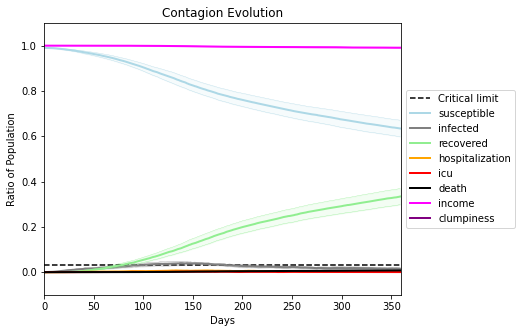

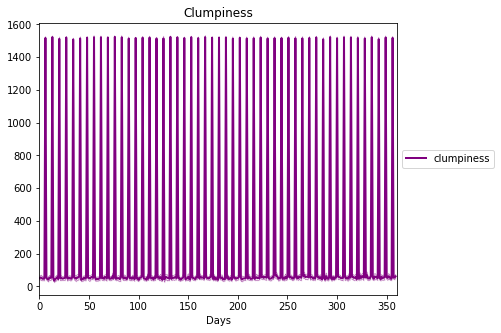

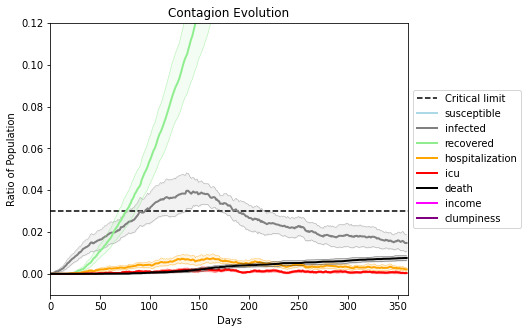

In [17]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.8
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1544, 4083, 5352, 851, 2936, 6917, 7823, 4781, 6961, 5007, 2425, 9714, 1709, 7950, 6835, 134, 8800, 9576, 4066, 1675]
Average similarity between family members is 0.34649202573709176 at temperature -0.7
Average similarity between family and home is 0.9998610908030139 at temperature -1
Average similarity between students and their classroom is 0.14373039519481903 at temperature -0.7
Average classroom occupancy is 1.6497175141242937 and number classrooms is 177
Average similarity between workers is 0.1745301713606762 at temperature -0.7
Average office occupancy is 3.1911764705882355 and number offices is 204
Average friend similarity for adults: 0.42503692727850606 for kids: 0.2928159183632067
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.09714705325371191
avg restaurant similarity 0.10127697992963006
avg restaurant similarity 0.1080309654356775
avg restaurant similarity 0.21598849728906377
avg restaurant similarity 0.22056584957763323
avg restaurant similarity 0.3703990318267704
avg restaurant similarity -0.0014394121904216018
avg restaurant similarity -0.10169144725130419
avg restaurant similarity 0.10421051099278432
avg restaurant similarity -0.1292070186194513
avg restaurant similarity 0.006461691304364858
avg restaurant similarity -0.18713234239059368
avg restaurant similarity 0.12110566705769604
avg restaurant similarity 0.06769765694752049
avg restaurant similarity -0.022122219817070306
avg restaurant similarity -0.006708220744959914
avg restaurant similarity 0.33441431163815216
avg restaurant similarity 0.004969228361450392
avg restaurant similarity -0.1441605744083269
avg restaurant similarity -0.0033298600120009875
avg restaurant similarity 0.2235063307488051
avg restaurant similari

avg restaurant similarity 0.2791658894691335
avg restaurant similarity 0.12429661279675423
avg restaurant similarity 0.028550930787823368
avg restaurant similarity -0.13586245644650194
avg restaurant similarity 0.042897012545272825
avg restaurant similarity 0.2815086006512857
avg restaurant similarity 0.007069457690028783
avg restaurant similarity 0.11665488619457487
avg restaurant similarity 0.10436735314854328
avg restaurant similarity 0.1764679795381574
avg restaurant similarity -0.007428897932686852
avg restaurant similarity 0.0700444564219273
avg restaurant similarity -0.033156423581081784
avg restaurant similarity 0.21911573073592633
avg restaurant similarity -0.08263279185684529
avg restaurant similarity 0.0348054896805226
avg restaurant similarity 0.0956278011993803
avg restaurant similarity 0.24571778089906898
avg restaurant similarity 0.09055909028461671
avg restaurant similarity 0.04124498809145903
avg restaurant similarity 0.1246113523106698
avg restaurant similarity 0.0985

Average similarity between family and home is 0.9998535126831402 at temperature -1
Average similarity between students and their classroom is 0.21268821380011152 at temperature -0.7
Average classroom occupancy is 1.6235294117647059 and number classrooms is 170
Average similarity between workers is 0.18729160956215865 at temperature -0.7
Average office occupancy is 3.3333333333333335 and number offices is 201
Average friend similarity for adults: 0.4311810953563714 for kids: 0.28767411243935037
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5

avg restaurant similarity 0.0019975900777653164
avg restaurant similarity 0.4738523708043148
avg restaurant similarity 0.11626178670886259
avg restaurant similarity 0.19771257751212548
avg restaurant similarity 0.09588524172050629
avg restaurant similarity 0.1803733555282738
avg restaurant similarity 0.2686916756841648
avg restaurant similarity 0.22211677842829128
avg restaurant similarity 0.13967592716048619
avg restaurant similarity 0.24415775147872218
avg restaurant similarity 0.13389164084973787
avg restaurant similarity 0.34432228754848965
avg restaurant similarity -0.1176810815738599
avg restaurant similarity 0.011141627708588763
avg restaurant similarity -0.023683028860220612
avg restaurant similarity 0.0004392547575510833
avg restaurant similarity 0.13191589166354853
avg restaurant similarity 0.060620532475264416
avg restaurant similarity 0.08105865419659693
avg restaurant similarity 0.05422206574446813
avg restaurant similarity 0.23826664680272763
avg restaurant similarity -0.

avg restaurant similarity 0.13339462934234933
avg restaurant similarity 0.1947802213635753
avg restaurant similarity -0.03937009041656577
avg restaurant similarity -0.184864315608052
avg restaurant similarity -0.04742555508345966
avg restaurant similarity 0.09772377604236225
avg restaurant similarity 0.255083279716663
avg restaurant similarity 0.3450335651270507
avg restaurant similarity -0.0027175646245089224
avg restaurant similarity 0.3062849852922468
avg restaurant similarity -0.024142479686944412
avg restaurant similarity -0.05527820718756451
avg restaurant similarity 0.09324060043752849
avg restaurant similarity 0.029439605916807905
avg restaurant similarity 0.0031423641163935145
avg restaurant similarity 0.13571372392906889
avg restaurant similarity 0.19039093179073124
avg restaurant similarity 0.2386053977682748
avg restaurant similarity 0.27438128981472
avg restaurant similarity 0.30444565132774165
avg restaurant similarity 0.06058359175379805
avg restaurant similarity 0.26067

Average similarity between family and home is 0.9998634146852015 at temperature -1
Average similarity between students and their classroom is 0.16671406425061513 at temperature -0.7
Average classroom occupancy is 1.6839080459770115 and number classrooms is 174
Average similarity between workers is 0.178474276191335 at temperature -0.7
Average office occupancy is 3.353846153846154 and number offices is 195
Average friend similarity for adults: 0.42898777669791005 for kids: 0.30498115515992547
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 peo

avg restaurant similarity 0.06647296108421545
avg restaurant similarity 0.2009711877495533
avg restaurant similarity 0.16764506989243233
avg restaurant similarity -0.27341253944790966
avg restaurant similarity 0.12500095109886378
avg restaurant similarity 0.14544472714051168
avg restaurant similarity 0.1427517124860823
avg restaurant similarity -0.2056159551594901
avg restaurant similarity 0.2388429744144032
avg restaurant similarity 0.23826813809606512
avg restaurant similarity 0.2058569185059798
avg restaurant similarity -0.09148221891918178
avg restaurant similarity 0.2469650776983102
avg restaurant similarity -0.0441281437201478
avg restaurant similarity 0.28721030356547045
avg restaurant similarity -0.1868711388976727
avg restaurant similarity -0.07349319481111372
avg restaurant similarity 0.29032843668697284
avg restaurant similarity 0.07540262922808798
avg restaurant similarity -0.03437492643362766
avg restaurant similarity 0.03392101005518147
avg restaurant similarity 0.1960446

avg restaurant similarity 0.41106331764421566
avg restaurant similarity 0.22982304506522264
avg restaurant similarity 0.276962616375199
avg restaurant similarity -0.01591154125499163
avg restaurant similarity 0.32841349368454836
avg restaurant similarity 0.12021534964323331
avg restaurant similarity 0.3287411931624362
avg restaurant similarity 0.051866364820105246
avg restaurant similarity 0.11084082553186957
avg restaurant similarity 0.025506780048485334
avg restaurant similarity -0.07492664651937027
avg restaurant similarity 0.020879460289587457
avg restaurant similarity 0.24545143061794428
avg restaurant similarity 0.22131475623978503
avg restaurant similarity 0.15564155607512029
avg restaurant similarity 0.03742124713932794
avg restaurant similarity 0.16856930705841341
avg restaurant similarity 0.18320598241359906
avg restaurant similarity 0.020188913131970826
avg restaurant similarity 0.1700651146153006
avg restaurant similarity 0.43047462644837453
avg restaurant similarity 0.2938

Average similarity between family and home is 0.9998497669683349 at temperature -1
Average similarity between students and their classroom is 0.2039785917324715 at temperature -0.7
Average classroom occupancy is 1.5251396648044693 and number classrooms is 179
Average similarity between workers is 0.1908629746058388 at temperature -0.7
Average office occupancy is 3.3024390243902437 and number offices is 205
Average friend similarity for adults: 0.4287735340690801 for kids: 0.28268003998139213
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 p

avg restaurant similarity -0.02431446777281403
avg restaurant similarity 0.23533235028293087
avg restaurant similarity 0.264155010413581
avg restaurant similarity 0.16962960628893411
avg restaurant similarity 0.1391488379050319
avg restaurant similarity 0.12106927327349651
avg restaurant similarity -0.1749140104716733
avg restaurant similarity 0.1690831267972496
avg restaurant similarity -0.019215642573205627
avg restaurant similarity 0.1167565014695403
avg restaurant similarity 0.10631362492549522
avg restaurant similarity 0.19875697711400214
avg restaurant similarity 0.2652149281840417
avg restaurant similarity 0.15057570097895637
avg restaurant similarity -0.04453873356475925
avg restaurant similarity 0.03319169613092445
avg restaurant similarity 0.17805015835244986
avg restaurant similarity 0.22908344065083475
avg restaurant similarity 0.12753823820435312
avg restaurant similarity 0.1232996498657199
avg restaurant similarity 0.2032794036733308
avg restaurant similarity 0.1204902814

avg restaurant similarity 0.16295363595160403
avg restaurant similarity 0.12303575486042757
avg restaurant similarity 0.06384796239503912
avg restaurant similarity 0.2402836498526683
avg restaurant similarity 0.054785890982840826
avg restaurant similarity 0.147831910390768
avg restaurant similarity 0.1477676300848994
avg restaurant similarity -0.06361658193227543
avg restaurant similarity 0.1215781599508569
avg restaurant similarity 0.18025436109914755
avg restaurant similarity 0.05338093576133651
avg restaurant similarity 0.16398902954050182
avg restaurant similarity 0.25975962110799894
avg restaurant similarity 0.1513634376050885
avg restaurant similarity 0.17835931096603885
avg restaurant similarity 0.2528493607622926
avg restaurant similarity 0.19090237595007703
avg restaurant similarity 0.21802790683687845
avg restaurant similarity 0.33245383186825805
avg restaurant similarity 0.13615738993686785
avg restaurant similarity 0.25312718113010774
avg restaurant similarity 0.22165729385

Average similarity between workers is 0.17263087609283356 at temperature -0.7
Average office occupancy is 3.21256038647343 and number offices is 207
Average friend similarity for adults: 0.4293347333541282 for kids: 0.2884091826220637
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 pe

avg restaurant similarity 0.2316532810186011
avg restaurant similarity -0.08707086921272522
avg restaurant similarity 0.12014808335944423
avg restaurant similarity 0.17272330588387974
avg restaurant similarity 0.2359277153201083
avg restaurant similarity 0.28069646479909766
avg restaurant similarity 0.14864547918541318
avg restaurant similarity 0.002387080776001465
avg restaurant similarity 0.21772923023927257
avg restaurant similarity 0.014463273044946429
avg restaurant similarity 0.0005890213413867911
avg restaurant similarity 0.3665345729009693
avg restaurant similarity 0.16584188719269244
avg restaurant similarity -0.05843645175118896
avg restaurant similarity 0.11045823231160401
avg restaurant similarity 0.15846447344966466
avg restaurant similarity 0.24736625162650674
avg restaurant similarity 0.10632242605478018
avg restaurant similarity 0.16526057347324466
avg restaurant similarity 0.16703307367460968
avg restaurant similarity 0.140554220514337
avg restaurant similarity 0.20768

avg restaurant similarity 0.18823314142907108
avg restaurant similarity 0.17804751202251415
avg restaurant similarity 0.24296021234213716
avg restaurant similarity 0.058367187772600936
avg restaurant similarity 0.19515635001154477
avg restaurant similarity 0.10210573430223269
avg restaurant similarity -0.01836487609350974
avg restaurant similarity 0.14004486815028278
avg restaurant similarity 0.3006425412047369
avg restaurant similarity 0.2101221630480881
avg restaurant similarity 0.1625198094649587
avg restaurant similarity 0.07690422409668397
avg restaurant similarity 0.11394468969807128
avg restaurant similarity 0.1298153111949036
avg restaurant similarity -0.04547972235095366
avg restaurant similarity 0.19289386953492588
avg restaurant similarity 0.16752202920843598
avg restaurant similarity 0.13621189214441445
avg restaurant similarity 0.19681733977445035
avg restaurant similarity 0.21487936894258078
avg restaurant similarity -0.019568562448509158
avg restaurant similarity 0.09110

Average similarity between family members is 0.3441066162118232 at temperature -0.7
Average similarity between family and home is 0.9998592130645337 at temperature -1
Average similarity between students and their classroom is 0.1846177550131399 at temperature -0.7
Average classroom occupancy is 1.6497175141242937 and number classrooms is 177
Average similarity between workers is 0.18098521926515343 at temperature -0.7
Average office occupancy is 3.2676767676767677 and number offices is 198
Average friend similarity for adults: 0.42489832928207283 for kids: 0.2933803624125043
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (2,0

avg restaurant similarity 0.12162552275093552
avg restaurant similarity 0.1553894516849518
avg restaurant similarity 0.04821894957840723
avg restaurant similarity 0.20139526062299784
avg restaurant similarity 0.13728059236383647
avg restaurant similarity 0.1524428711641316
avg restaurant similarity 0.18481646473986213
avg restaurant similarity 0.015780869191853116
avg restaurant similarity 0.0202150411775313
avg restaurant similarity -0.00982698498419296
avg restaurant similarity 0.1542674908401245
avg restaurant similarity -0.04535384778364222
avg restaurant similarity 0.19124798587354894
avg restaurant similarity 0.17065471344614866
avg restaurant similarity 0.04240050842303146
avg restaurant similarity 0.08845636871604602
avg restaurant similarity 0.17933478281935636
avg restaurant similarity 0.1929304692780516
avg restaurant similarity 0.019327251626701132
avg restaurant similarity -0.13160874685986193
avg restaurant similarity 0.12661154626044058
avg restaurant similarity 0.112871

avg restaurant similarity 0.1911501200991266
avg restaurant similarity 0.06613320885145772
avg restaurant similarity 0.04190424478048521
avg restaurant similarity 0.11530646711600472
avg restaurant similarity 0.22955703818527998
avg restaurant similarity 0.15634308030972097
avg restaurant similarity 0.15485372017302607
avg restaurant similarity 0.07026750186391907
avg restaurant similarity 0.1023257307387234
avg restaurant similarity 0.023826720466427066
avg restaurant similarity 0.14742031607243078
avg restaurant similarity 0.30708440482834354
avg restaurant similarity 0.02121393295516216
avg restaurant similarity 0.13107380392221338
avg restaurant similarity 0.05424795784470987
avg restaurant similarity 0.07113920609170588
avg restaurant similarity 0.2444368441278094
avg restaurant similarity 0.09005320348588679
avg restaurant similarity 0.012481262662833531
avg restaurant similarity 0.0668272026652917
avg restaurant similarity 0.2577006807931504
avg restaurant similarity 0.110922545

avg restaurant similarity 0.15336832249979265
Average similarity between family members is 0.36131722467380906 at temperature -0.7
Average similarity between family and home is 0.9998528712598579 at temperature -1
Average similarity between students and their classroom is 0.16494840204740113 at temperature -0.7
Average classroom occupancy is 1.622093023255814 and number classrooms is 172
Average similarity between workers is 0.17319455440453804 at temperature -0.7
Average office occupancy is 3.2935323383084576 and number offices is 201
Average friend similarity for adults: 0.4224932335449121 for kids: 0.28820850838588025
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 pe

avg restaurant similarity 0.4514365482313816
avg restaurant similarity 0.13394091715652867
avg restaurant similarity 0.10370223665406275
avg restaurant similarity 0.10825710261147013
avg restaurant similarity 0.2613903699852927
avg restaurant similarity 0.18537817641272442
avg restaurant similarity -0.14825245528603104
avg restaurant similarity 0.17690530376577543
avg restaurant similarity 0.27434228368375796
avg restaurant similarity 0.18436430585983232
avg restaurant similarity 0.2233279876575137
avg restaurant similarity -0.1172515080013461
avg restaurant similarity 0.32294074210913365
avg restaurant similarity -0.1238560444637995
avg restaurant similarity 0.14943819114603044
avg restaurant similarity 0.22184311689685887
avg restaurant similarity 0.2254614106555275
avg restaurant similarity 0.37727001034658275
avg restaurant similarity 0.05527009884357743
avg restaurant similarity 0.23511358538422253
avg restaurant similarity 0.13212471865417125
avg restaurant similarity 0.216689269

avg restaurant similarity 0.3246473647938427
avg restaurant similarity 0.17069361274150527
avg restaurant similarity -0.034669928270703365
avg restaurant similarity 0.19726811063475713
avg restaurant similarity 0.05659493266439878
avg restaurant similarity 0.18353321081233773
avg restaurant similarity 0.34375434842602093
avg restaurant similarity 0.13484127175377428
avg restaurant similarity 0.11940856675860842
avg restaurant similarity 0.14174683029703444
avg restaurant similarity -0.03519984149018383
avg restaurant similarity 0.1945864563353165
avg restaurant similarity 0.23606497667083065
avg restaurant similarity 0.25991421964598904
avg restaurant similarity 0.0613993028066497
avg restaurant similarity 0.3175912183910553
avg restaurant similarity 0.2553705285526214
avg restaurant similarity 0.2514714293370639
avg restaurant similarity 0.21214016536726563
avg restaurant similarity 0.25479689935221983
avg restaurant similarity 0.19960511921630686
avg restaurant similarity 0.211179200

Average similarity between family members is 0.33257247830351566 at temperature -0.7
Average similarity between family and home is 0.9998461001690243 at temperature -1
Average similarity between students and their classroom is 0.17741643426057926 at temperature -0.7
Average classroom occupancy is 1.6844919786096257 and number classrooms is 187
Average similarity between workers is 0.14488577932545119 at temperature -0.7
Average office occupancy is 3.185 and number offices is 200
Average friend similarity for adults: 0.41105301877149747 for kids: 0.3053430853343515
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district 

avg restaurant similarity 0.7666649827250187
avg restaurant similarity 0.03230279180993095
avg restaurant similarity 0.21966910096838854
avg restaurant similarity 0.20753315100353883
avg restaurant similarity 0.19015555788051514
avg restaurant similarity 0.45699940393486044
avg restaurant similarity 0.1436505015858987
avg restaurant similarity -0.011891480908670721
avg restaurant similarity -0.019147798342001494
avg restaurant similarity 0.24183415100510708
avg restaurant similarity 0.0020787863324720976
avg restaurant similarity 0.17726091051909118
avg restaurant similarity 0.3925055670406379
avg restaurant similarity 0.16798723755070125
avg restaurant similarity -0.12731528117146326
avg restaurant similarity 0.12610524212765245
avg restaurant similarity 0.07159522814702463
avg restaurant similarity -0.07423682622336547
avg restaurant similarity 0.18920556082932546
avg restaurant similarity 0.04955530394285776
avg restaurant similarity 0.30504956737808564
avg restaurant similarity 0.0

avg restaurant similarity -0.07291256009096374
avg restaurant similarity 0.2241846469962257
avg restaurant similarity 0.504672275453621
avg restaurant similarity 0.23966191312507243
avg restaurant similarity 0.20275409155759902
avg restaurant similarity 0.10206766998894444
avg restaurant similarity 0.04066193427389714
avg restaurant similarity -0.021973376573027985
avg restaurant similarity 0.1350527208980343
avg restaurant similarity 0.1161166013312359
avg restaurant similarity 0.059532712701837284
avg restaurant similarity -0.02642668228103877
avg restaurant similarity 0.056854302981089885
avg restaurant similarity 0.10890654583461871
avg restaurant similarity -0.0758387672857804
avg restaurant similarity -0.014445915110187259
avg restaurant similarity -0.004094394252047014
avg restaurant similarity -0.03756431281267703
avg restaurant similarity -0.24647326634261857
avg restaurant similarity 0.10381206889249314
avg restaurant similarity 0.23974287174029196
avg restaurant similarity 0

avg restaurant similarity 0.05675105294636427
avg restaurant similarity 0.13282941597366643
avg restaurant similarity 0.3377704257868845
avg restaurant similarity 0.30518336902885984
avg restaurant similarity -0.11164621672954379
avg restaurant similarity 0.34382295864699886
avg restaurant similarity 0.015685507206027613
avg restaurant similarity 0.15581831894531803
avg restaurant similarity 0.185222060773642
avg restaurant similarity 0.217939835820105
avg restaurant similarity 0.09382402031264186
avg restaurant similarity 0.23807246919354555
avg restaurant similarity 0.01847397726657635
avg restaurant similarity 0.184279796897321
avg restaurant similarity 0.017501291375866822
avg restaurant similarity 0.2885207630989681
avg restaurant similarity 0.002787443413292683
avg restaurant similarity -0.050871623023446444
avg restaurant similarity 0.08637800293153705
avg restaurant similarity 0.09442784453192482
avg restaurant similarity 0.2732540566618614
avg restaurant similarity 0.087824996

avg restaurant similarity -0.09798061577918674
avg restaurant similarity 0.1538729537112229
avg restaurant similarity 0.37780624225345755
avg restaurant similarity 0.2185795998877936
avg restaurant similarity 0.36414239979607915
avg restaurant similarity 0.21639022839579472
avg restaurant similarity 0.07893177062455062
avg restaurant similarity 0.1974204600055768
avg restaurant similarity 0.4543415145582092
avg restaurant similarity 0.0609993325466483
avg restaurant similarity 0.34120078905027523
avg restaurant similarity -0.29134793661838676
avg restaurant similarity 0.31414376215335005
avg restaurant similarity 0.3554007724018259
avg restaurant similarity 0.03282304101276195
avg restaurant similarity -0.07571787540346207
avg restaurant similarity 0.2898088211911283
avg restaurant similarity -0.08376254101351334
avg restaurant similarity 0.46357105732876813
avg restaurant similarity -0.23754231372590653
avg restaurant similarity 0.050030620237595164
avg restaurant similarity -0.131722

Average similarity between workers is 0.18093368048855304 at temperature -0.7
Average office occupancy is 3.2613065326633164 and number offices is 199
Average friend similarity for adults: 0.4366839550735097 for kids: 0.310621353465289
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 1 people.
Total of 1 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 p

avg restaurant similarity 0.06653795997516092
avg restaurant similarity -0.09824868953146336
avg restaurant similarity -0.11004296119683121
avg restaurant similarity 0.15910507568735469
avg restaurant similarity 0.12889542085319192
avg restaurant similarity 0.17601095446062973
avg restaurant similarity 0.04220378924357521
avg restaurant similarity 0.059306535744945
avg restaurant similarity 0.2692713430655377
avg restaurant similarity -0.12970389365118556
avg restaurant similarity 0.26852267061865215
avg restaurant similarity 0.00782826285885394
avg restaurant similarity 0.26430167752391714
avg restaurant similarity 0.19259638314383137
avg restaurant similarity 0.20205945003043968
avg restaurant similarity 0.35492640263946584
avg restaurant similarity 0.16744934241831774
avg restaurant similarity 0.041366700156905765
avg restaurant similarity 0.25192414656859663
avg restaurant similarity 0.04214664014403713
avg restaurant similarity 0.32487431094409935
avg restaurant similarity 0.06287

avg restaurant similarity 0.38196336542002257
avg restaurant similarity 0.06287434884568614
avg restaurant similarity -0.40550890463906253
avg restaurant similarity 0.059948047404986944
avg restaurant similarity 0.2738080072159104
avg restaurant similarity 0.07499368151499201
avg restaurant similarity 0.25814446828558285
avg restaurant similarity 0.022657118848636443
avg restaurant similarity 0.23289863113683554
avg restaurant similarity -0.04536079578412253
avg restaurant similarity 0.045451340378245504
avg restaurant similarity 0.0576226765069103
avg restaurant similarity 0.2024727117059401
avg restaurant similarity 0.15737392370467562
avg restaurant similarity 0.13452721769465423
avg restaurant similarity 0.31046731536225636
avg restaurant similarity 0.029022372255690917
avg restaurant similarity 0.021902141357771097
avg restaurant similarity 0.35504389106576
avg restaurant similarity -0.10600870127556049
avg restaurant similarity 0.11331457698712233
avg restaurant similarity 0.1173

avg restaurant similarity 0.10746440696576548
avg restaurant similarity 0.12782947688239946
avg restaurant similarity 0.10372660272037268
avg restaurant similarity 0.1989608659149775
avg restaurant similarity 0.15979430724095256
avg restaurant similarity 0.18967582240942432
avg restaurant similarity 0.16574616869821993
avg restaurant similarity 0.33626347092929043
avg restaurant similarity 0.04422392915856147
avg restaurant similarity 0.1630137050572203
avg restaurant similarity 0.05267736678305257
avg restaurant similarity 0.41388108049614736
avg restaurant similarity -0.005365522009258991
avg restaurant similarity 0.15892819825298032
avg restaurant similarity 0.19838604147912844
avg restaurant similarity 0.15505497426284137
avg restaurant similarity 0.27602036108554595
avg restaurant similarity -0.0574519342809861
avg restaurant similarity -0.0261495546652166
avg restaurant similarity 0.1520902859476626
avg restaurant similarity 0.11686394924203625
avg restaurant similarity 0.3893691

avg restaurant similarity 0.06553853331717698
avg restaurant similarity 0.23174693407406824
avg restaurant similarity 0.2894974007080327
avg restaurant similarity 0.4348604417408103
avg restaurant similarity 0.24570114255932876
avg restaurant similarity 0.15477690384144238
avg restaurant similarity 0.40913930251480196
avg restaurant similarity 0.11553921634720891
avg restaurant similarity 0.3582487497954934
avg restaurant similarity 0.06135242238404052
avg restaurant similarity 0.37455543865507773
avg restaurant similarity 0.01744144578523475
avg restaurant similarity 0.19934964494753
avg restaurant similarity 0.11828704510229408
avg restaurant similarity -0.04881416623103282
avg restaurant similarity 0.1735003706246721
avg restaurant similarity 0.13641374647129284
avg restaurant similarity 0.06886539487491916
avg restaurant similarity 0.26157462933621384
avg restaurant similarity 0.04663654148677747
avg restaurant similarity 0.1289416025867546
avg restaurant similarity 0.2946301584207

Average similarity between family members is 0.3399695767294073 at temperature -0.7
Average similarity between family and home is 0.9998617099001716 at temperature -1
Average similarity between students and their classroom is 0.15248997426193273 at temperature -0.7
Average classroom occupancy is 1.4917127071823204 and number classrooms is 181
Average similarity between workers is 0.16510033957675865 at temperature -0.7
Average office occupancy is 3.2634146341463413 and number offices is 205
Average friend similarity for adults: 0.4319750513372554 for kids: 0.2818399278509728
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2

avg restaurant similarity -0.10272730617277387
avg restaurant similarity 0.012994157731407876
avg restaurant similarity 0.018594313919422515
avg restaurant similarity 0.006197882921018494
avg restaurant similarity 0.09907486349532355
avg restaurant similarity -0.005884655658701637
avg restaurant similarity -0.13339511318329264
avg restaurant similarity -0.0696604057056123
avg restaurant similarity 0.08667134791406322
avg restaurant similarity 0.02593345978393553
avg restaurant similarity 0.12198786494372282
avg restaurant similarity 0.14101425317425734
avg restaurant similarity 0.28186268979314505
avg restaurant similarity -0.1087228452731821
avg restaurant similarity 0.20467620369921005
avg restaurant similarity 0.2000310977405643
avg restaurant similarity 0.10687863093284404
avg restaurant similarity 0.10685519075005438
avg restaurant similarity 0.21900626809279367
avg restaurant similarity 0.25223847251849507
avg restaurant similarity 0.16748953883170353
avg restaurant similarity 0.

avg restaurant similarity 0.06944498605091057
avg restaurant similarity -0.16312320880804734
avg restaurant similarity -0.06701504509127729
avg restaurant similarity -0.02338945091156872
avg restaurant similarity 0.15393874157648274
avg restaurant similarity 0.0564880802911477
avg restaurant similarity -0.02397598216956484
avg restaurant similarity 0.13490848341327133
avg restaurant similarity 0.13187886002683097
avg restaurant similarity 0.22234662550613757
avg restaurant similarity 0.22088710367560552
avg restaurant similarity 0.10771629921833092
avg restaurant similarity 0.1299519938211774
avg restaurant similarity 0.15368935955558055
avg restaurant similarity 0.06317072944971526
avg restaurant similarity 0.12148640364352625
avg restaurant similarity 0.0027411789372480976
avg restaurant similarity 0.1372458348497552
avg restaurant similarity -0.009603949068633592
avg restaurant similarity 0.24191194418280218
avg restaurant similarity -0.009450477306694646
avg restaurant similarity -

avg restaurant similarity -0.0954745977750334
avg restaurant similarity 0.13449548268428227
avg restaurant similarity -0.0744527510059519
Average similarity between family members is 0.34118596206846286 at temperature -0.7
Average similarity between family and home is 0.9998502699665718 at temperature -1
Average similarity between students and their classroom is 0.16690828862339988 at temperature -0.7
Average classroom occupancy is 1.651685393258427 and number classrooms is 178
Average similarity between workers is 0.1764271167280927 at temperature -0.7
Average office occupancy is 3.2561576354679804 and number offices is 203
Average friend similarity for adults: 0.4242835738494712 for kids: 0.3070597174585103
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (e

avg restaurant similarity 0.30379316825534397
avg restaurant similarity 0.24494856546296725
avg restaurant similarity 0.1075029801663644
avg restaurant similarity 0.03436991303225371
avg restaurant similarity 0.14984107540993852
avg restaurant similarity 0.1124306801546801
avg restaurant similarity 0.08957645098118813
avg restaurant similarity 0.0047832078820208125
avg restaurant similarity 0.011831121604974262
avg restaurant similarity 0.25042063212502885
avg restaurant similarity 0.06751678309922864
avg restaurant similarity 0.17776470849730058
avg restaurant similarity 0.15495147040828885
avg restaurant similarity 0.001079415124365635
avg restaurant similarity 0.14535469922290045
avg restaurant similarity 0.16553624174670561
avg restaurant similarity 0.12924742244101148
avg restaurant similarity 0.05652442280697619
avg restaurant similarity 0.09200220805075503
avg restaurant similarity 0.11938917947047739
avg restaurant similarity 0.21242962560576362
avg restaurant similarity -0.017

avg restaurant similarity 0.011975864589613281
avg restaurant similarity 0.0754587688194586
avg restaurant similarity 0.23203277068181993
avg restaurant similarity 0.03166699747150894
avg restaurant similarity 0.031128429788443743
avg restaurant similarity 0.0032391636813386194
avg restaurant similarity 0.08034672252368083
avg restaurant similarity 0.3671471078074913
avg restaurant similarity 0.06797258627184258
avg restaurant similarity -0.026677937760914407
avg restaurant similarity 0.2542172955404104
avg restaurant similarity 0.21039498234726384
avg restaurant similarity 0.12964919675019135
avg restaurant similarity 0.04569347723870984
avg restaurant similarity 0.13210903848954392
avg restaurant similarity -0.09643873041513597
avg restaurant similarity 0.025843986434195023
avg restaurant similarity 0.14892057506700954
avg restaurant similarity 0.08386422847927442
avg restaurant similarity 0.18125049053801576
avg restaurant similarity 0.15091396349991235
avg restaurant similarity -0.

avg restaurant similarity 0.05896836819579537
avg restaurant similarity 0.23893446558836534
Average similarity between family members is 0.3521645213522823 at temperature -0.7
Average similarity between family and home is 0.9998462763151337 at temperature -1
Average similarity between students and their classroom is 0.17888518152901156 at temperature -0.7
Average classroom occupancy is 1.6162162162162161 and number classrooms is 185
Average similarity between workers is 0.18440287947969006 at temperature -0.7
Average office occupancy is 3.198019801980198 and number offices is 202
Average friend similarity for adults: 0.4259065614980512 for kids: 0.30527594483304854
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated 

avg restaurant similarity 0.0896382704784581
avg restaurant similarity 0.10809627568818951
avg restaurant similarity 0.16939908551349647
avg restaurant similarity 0.11729801539978725
avg restaurant similarity 0.2441801556866961
avg restaurant similarity 0.14319293999082278
avg restaurant similarity 0.056901542389757385
avg restaurant similarity 0.03821906885516859
avg restaurant similarity 0.15898390346776095
avg restaurant similarity -0.01457648619713145
avg restaurant similarity 0.055544413216712954
avg restaurant similarity -0.11674661056796021
avg restaurant similarity 0.08547147934113235
avg restaurant similarity 0.04145955023804291
avg restaurant similarity 0.1136377943678272
avg restaurant similarity 0.09674982630782611
avg restaurant similarity 0.3669737838123355
avg restaurant similarity 0.037269826598637895
avg restaurant similarity -0.003663756204769903
avg restaurant similarity -0.006396081885236771
avg restaurant similarity 0.14635369967757644
avg restaurant similarity 0.1

avg restaurant similarity 0.05986206274772324
avg restaurant similarity 0.1359558895709222
avg restaurant similarity 0.14920362843704665
avg restaurant similarity 0.2950749250362408
avg restaurant similarity -0.022128984659280843
avg restaurant similarity 0.2245245622547044
avg restaurant similarity 0.12374382904958033
avg restaurant similarity -0.07251429143480419
avg restaurant similarity 0.09987074946112473
avg restaurant similarity 0.34579883610355017
avg restaurant similarity -0.08450268699750452
avg restaurant similarity 0.21326894397963533
avg restaurant similarity -0.1097714282649814
avg restaurant similarity 0.05502059705196514
avg restaurant similarity 0.22761176386324444
avg restaurant similarity 0.33912153850313
avg restaurant similarity 0.16862118155236994
avg restaurant similarity 0.14491834997221015
avg restaurant similarity 0.3060375932416621
avg restaurant similarity 0.08391899087448311
avg restaurant similarity 0.21184746106138977
avg restaurant similarity 0.221534817

avg restaurant similarity 0.1475928240744294
avg restaurant similarity 0.07956848296942307
Average similarity between family members is 0.3548125785375605 at temperature -0.7
Average similarity between family and home is 0.9998622024602469 at temperature -1
Average similarity between students and their classroom is 0.1797273800441239 at temperature -0.7
Average classroom occupancy is 1.6184971098265897 and number classrooms is 173
Average similarity between workers is 0.16213260047519143 at temperature -0.7
Average office occupancy is 3.3654822335025383 and number offices is 197
Average friend similarity for adults: 0.41863099230261286 for kids: 0.2854056304059854
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated

avg restaurant similarity -0.09839123466748503
avg restaurant similarity 0.09278312504787968
avg restaurant similarity 0.19006266021725357
avg restaurant similarity 0.21719896975327577
avg restaurant similarity -0.029228094330908578
avg restaurant similarity 0.1319841784478551
avg restaurant similarity 0.12205813148079962
avg restaurant similarity 0.21567480943894718
avg restaurant similarity 0.1111780994943024
avg restaurant similarity 0.03968035388516605
avg restaurant similarity 0.15172383520403956
avg restaurant similarity 0.10215221397573111
avg restaurant similarity -0.01983575453556239
avg restaurant similarity -0.026653888299507007
avg restaurant similarity -0.12270393407938518
avg restaurant similarity -0.02704724507478083
avg restaurant similarity 0.11495116321550666
avg restaurant similarity -0.001714564499555149
avg restaurant similarity 0.3079029075683335
avg restaurant similarity 0.423922037199048
avg restaurant similarity -0.15444725481489574
avg restaurant similarity 0.

avg restaurant similarity 0.37039457988277413
avg restaurant similarity 0.20646323916076006
avg restaurant similarity 0.15084451278542627
avg restaurant similarity 0.15901671638984147
avg restaurant similarity -0.07273874953863063
avg restaurant similarity 0.006834541553718332
avg restaurant similarity -0.16907392705336005
avg restaurant similarity 0.20961193705280387
avg restaurant similarity 0.12729468392412482
avg restaurant similarity 0.13191283355653718
avg restaurant similarity -0.0539142340051559
avg restaurant similarity 0.24060509724174634
avg restaurant similarity 0.19337328914081633
avg restaurant similarity 0.29119072414081903
avg restaurant similarity 0.04742196977748315
avg restaurant similarity -0.04107157001054571
avg restaurant similarity 0.08081163275703554
avg restaurant similarity -0.11557970647982323
avg restaurant similarity 0.13627819570074887
avg restaurant similarity 0.06853087840070392
avg restaurant similarity 0.07815671762939969
avg restaurant similarity -0.

avg restaurant similarity 0.027990195922793736
Average similarity between family members is 0.35458015014027067 at temperature -0.7
Average similarity between family and home is 0.9998514969398562 at temperature -1
Average similarity between students and their classroom is 0.16757830089733453 at temperature -0.7
Average classroom occupancy is 1.5714285714285714 and number classrooms is 175
Average similarity between workers is 0.18728419190670784 at temperature -0.7
Average office occupancy is 3.334975369458128 and number offices is 203
Average friend similarity for adults: 0.4369498751343942 for kids: 0.2853311158485365
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 

avg restaurant similarity 0.19741217251931176
avg restaurant similarity 0.011414354172995408
avg restaurant similarity 0.09041667320680298
avg restaurant similarity 0.05716024297009577
avg restaurant similarity 0.3465103051852982
avg restaurant similarity 0.11909523768240042
avg restaurant similarity 0.15526629357495678
avg restaurant similarity 0.05403026588698504
avg restaurant similarity 0.08082118125488755
avg restaurant similarity 0.1583844212338691
avg restaurant similarity 0.17570243280175393
avg restaurant similarity 0.06580585753167079
avg restaurant similarity 0.12100341101636575
avg restaurant similarity 0.16384967360310984
avg restaurant similarity 0.0029905891803765614
avg restaurant similarity 0.00043874141325464083
avg restaurant similarity 0.16817094327783175
avg restaurant similarity 0.10646833860691769
avg restaurant similarity 0.2210081393240571
avg restaurant similarity 0.21757836960004398
avg restaurant similarity 0.31279012929411165
avg restaurant similarity 0.314

avg restaurant similarity 0.30930081615499966
avg restaurant similarity 0.1494684604330209
avg restaurant similarity 0.08161451726246138
avg restaurant similarity 0.09845958229870663
avg restaurant similarity 0.05736450697886732
avg restaurant similarity 0.08951871353127265
avg restaurant similarity 0.3046012240182693
avg restaurant similarity 0.09678977712540443
avg restaurant similarity 0.22724548868366445
avg restaurant similarity 0.14034103331087033
avg restaurant similarity 0.1471122957902598
avg restaurant similarity 0.10293129320073649
avg restaurant similarity 0.0969330560304671
avg restaurant similarity -0.05644481850008193
avg restaurant similarity 0.33224100673484164
avg restaurant similarity 0.025550291293144962
avg restaurant similarity 0.08167059186280058
avg restaurant similarity 0.2843252957847994
avg restaurant similarity 0.06749848540552775
avg restaurant similarity 6.437673162636622e-05
avg restaurant similarity 0.07998618263138482
avg restaurant similarity -0.006806

Average similarity between family and home is 0.999856969445619 at temperature -1
Average similarity between students and their classroom is 0.1841717688706246 at temperature -0.7
Average classroom occupancy is 1.502857142857143 and number classrooms is 175
Average similarity between workers is 0.18395802706427072 at temperature -0.7
Average office occupancy is 3.321951219512195 and number offices is 205
Average friend similarity for adults: 0.4405278311180529 for kids: 0.2769920362557393
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 peop

avg restaurant similarity 0.1392536626264425
avg restaurant similarity 0.10958278111794743
avg restaurant similarity 0.27448033803978983
avg restaurant similarity 0.32729856492924114
avg restaurant similarity 0.028499132885617756
avg restaurant similarity 0.2211166297865612
avg restaurant similarity 0.01582152356150147
avg restaurant similarity 0.16207152400853483
avg restaurant similarity 0.045225648751373866
avg restaurant similarity -0.28549729600229157
avg restaurant similarity 0.09638761079898299
avg restaurant similarity 0.3106970639998626
avg restaurant similarity 0.11881812337189028
avg restaurant similarity 0.07134435736841398
avg restaurant similarity 0.0988355832211541
avg restaurant similarity 0.20004010195641753
avg restaurant similarity 0.037440835605491656
avg restaurant similarity 0.030310196344940976
avg restaurant similarity -0.05807340275953053
avg restaurant similarity 0.1195644689884305
avg restaurant similarity 0.0484930321900075
avg restaurant similarity -0.14109

avg restaurant similarity 0.0031323055810966866
avg restaurant similarity 0.12953683777105945
avg restaurant similarity -0.11491750161163541
avg restaurant similarity 0.22986785599584084
avg restaurant similarity 0.5683894392978982
avg restaurant similarity 0.043918823918490654
avg restaurant similarity 0.15982960192868703
avg restaurant similarity 0.16640840600535428
avg restaurant similarity 0.2676698009291354
avg restaurant similarity 0.25374573520900995
avg restaurant similarity 0.35509535891750926
avg restaurant similarity -0.014334195994701357
avg restaurant similarity 0.028975220430454154
avg restaurant similarity 0.020625767242307122
avg restaurant similarity 0.04111274530468003
avg restaurant similarity 0.10054340182126201
avg restaurant similarity -0.0018132160655645823
avg restaurant similarity 0.2952725727281884
avg restaurant similarity 0.019370002892868332
avg restaurant similarity 0.1329600604873319
avg restaurant similarity -0.0666177575215774
avg restaurant similarity 

avg restaurant similarity 0.05561916897733345
Average similarity between family members is 0.34395401558705263 at temperature -0.7
Average similarity between family and home is 0.9998558009670447 at temperature -1
Average similarity between students and their classroom is 0.15883227758666763 at temperature -0.7
Average classroom occupancy is 1.6170212765957446 and number classrooms is 188
Average similarity between workers is 0.17562424151241357 at temperature -0.7
Average office occupancy is 3.1386138613861387 and number offices is 202
Average friend similarity for adults: 0.41402445964101153 for kids: 0.2938764872784124
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity -0.007439570413226727
avg restaurant similarity 0.0452384685242873
avg restaurant similarity -0.03516315313014345
avg restaurant similarity 0.27332571628794067
avg restaurant similarity 0.151034501546052
avg restaurant similarity -0.11132930706404938
avg restaurant similarity 0.24879482049579316
avg restaurant similarity -0.003292833009273563
avg restaurant similarity 0.1236753213173871
avg restaurant similarity 0.08707234499410332
avg restaurant similarity 0.17220863510794318
avg restaurant similarity 0.09500695258659966
avg restaurant similarity 0.03676019324226593
avg restaurant similarity 0.17680750071440035
avg restaurant similarity -0.0026900215093221083
avg restaurant similarity 0.12910566875783935
avg restaurant similarity 0.019187840052385833
avg restaurant similarity 0.1682067705084178
avg restaurant similarity 0.06581991095331292
avg restaurant similarity 0.16322757784397843
avg restaurant similarity 0.17737027841107375
avg restaurant similarity -0.

avg restaurant similarity -0.0938503887093056
avg restaurant similarity -0.06959083593292756
avg restaurant similarity 0.24049909449616363
avg restaurant similarity 0.21972796949423382
avg restaurant similarity 0.07860682548252142
avg restaurant similarity 0.09482689805227185
avg restaurant similarity 0.11618710736116655
avg restaurant similarity 0.08494223008281457
avg restaurant similarity -0.007003032010334971
avg restaurant similarity -0.1157203772375113
avg restaurant similarity -0.007507694187167457
avg restaurant similarity -0.05612801988484115
avg restaurant similarity 0.1047699648387686
avg restaurant similarity 0.041040774716398026
avg restaurant similarity 0.21518604563370203
avg restaurant similarity 0.03908235442460788
avg restaurant similarity 0.16446525869852985
avg restaurant similarity -0.037645437994301575
avg restaurant similarity 0.2588374552032215
avg restaurant similarity 0.209435775960342
avg restaurant similarity 0.08962215877762418
avg restaurant similarity 0.3

avg restaurant similarity 0.1979309754192293
avg restaurant similarity 0.3457082809102108
Average similarity between family members is 0.34624297473592247 at temperature -0.7
Average similarity between family and home is 0.9998639379857832 at temperature -1
Average similarity between students and their classroom is 0.15936532973388265 at temperature -0.7
Average classroom occupancy is 1.5862068965517242 and number classrooms is 174
Average similarity between workers is 0.17883936728780728 at temperature -0.7
Average office occupancy is 3.27 and number offices is 200
Average friend similarity for adults: 0.43046014729992205 for kids: 0.299462704878555
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a to

avg restaurant similarity 0.07441137717531464
avg restaurant similarity 0.18634638112235144
avg restaurant similarity 0.0402245317323644
avg restaurant similarity 0.1954886985645333
avg restaurant similarity 0.20018794839610343
avg restaurant similarity 0.18895913419295152
avg restaurant similarity 0.14026552942052248
avg restaurant similarity 0.0625898376800111
avg restaurant similarity 0.14909962995408296
avg restaurant similarity 0.048956784995022797
avg restaurant similarity -0.0072603450957271585
avg restaurant similarity 0.1147830091294735
avg restaurant similarity 0.19134686575640011
avg restaurant similarity -0.11138734633294517
avg restaurant similarity 0.013267933102108118
avg restaurant similarity 0.19109448891441438
avg restaurant similarity 0.14390572179131447
avg restaurant similarity 0.12307924466056522
avg restaurant similarity 0.3140931940735359
avg restaurant similarity 0.021445527880775334
avg restaurant similarity 0.1660169878673571
avg restaurant similarity 0.04439

avg restaurant similarity -0.007832943925848709
avg restaurant similarity 0.21494271712919558
avg restaurant similarity 0.20472573124634935
avg restaurant similarity 0.037655470278385526
avg restaurant similarity 0.015230842033834591
avg restaurant similarity 0.167052233082041
avg restaurant similarity 0.20074303974231028
avg restaurant similarity 0.058058398447088246
avg restaurant similarity 0.22408433955595541
avg restaurant similarity 0.29997015916826164
avg restaurant similarity 0.04446507019538043
avg restaurant similarity 0.29331672565238387
avg restaurant similarity 0.188907694438703
avg restaurant similarity 0.031182979181311923
avg restaurant similarity -0.05481692486350628
avg restaurant similarity 0.015368584323674194
avg restaurant similarity 0.18573496727816813
avg restaurant similarity 0.16802818541550615
avg restaurant similarity 0.0642600301908851
avg restaurant similarity 0.1489340993350591
avg restaurant similarity 0.17237019499331974
avg restaurant similarity 0.0163

avg restaurant similarity 0.10115566202854977
avg restaurant similarity 0.3630790963561986
Average similarity between family members is 0.3419104456878938 at temperature -0.7
Average similarity between family and home is 0.9998588116694644 at temperature -1
Average similarity between students and their classroom is 0.1388673651393399 at temperature -0.7
Average classroom occupancy is 1.6243093922651934 and number classrooms is 181
Average similarity between workers is 0.1920531504081134 at temperature -0.7
Average office occupancy is 3.189054726368159 and number offices is 201
Average friend similarity for adults: 0.42324761540489714 for kids: 0.30811706782597614
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated 

avg restaurant similarity 0.22048952279667627
avg restaurant similarity 0.12980792127119203
avg restaurant similarity 0.17238697576185236
avg restaurant similarity 0.39309732076959575
avg restaurant similarity 0.20281960565692794
avg restaurant similarity 0.12546178373001549
avg restaurant similarity 0.14800489815186468
avg restaurant similarity 0.19551447756855725
avg restaurant similarity 0.35664293418504417
avg restaurant similarity 0.08346742778134636
avg restaurant similarity -0.00530892517338119
avg restaurant similarity 0.1952392763649046
avg restaurant similarity 0.12041740100860852
avg restaurant similarity 0.12968151136217168
avg restaurant similarity 0.2596314591009415
avg restaurant similarity 0.21678126954396118
avg restaurant similarity 0.23384261524806937
avg restaurant similarity 0.36598399910400753
avg restaurant similarity -0.025262155723177943
avg restaurant similarity 0.2177843822853216
avg restaurant similarity 0.2926879965308605
avg restaurant similarity -0.036661

avg restaurant similarity 0.11610104099671677
avg restaurant similarity 0.20519445882812026
avg restaurant similarity 0.29254765742087296
avg restaurant similarity 0.28920940720370003
avg restaurant similarity 0.16064473499987428
avg restaurant similarity -0.2966149970163349
avg restaurant similarity 0.05800431855859163
avg restaurant similarity 0.16955030906381707
avg restaurant similarity -0.3230819058952039
avg restaurant similarity 0.14770705982634394
avg restaurant similarity 0.2843442013739513
avg restaurant similarity 0.1767568728228563
avg restaurant similarity 0.1637675512061223
avg restaurant similarity -0.061896576221422306
avg restaurant similarity -0.10158045756057736
avg restaurant similarity -0.13386005636803922
avg restaurant similarity 0.18195540850297848
avg restaurant similarity 0.3121620605623568
avg restaurant similarity -0.0014513411148074779
avg restaurant similarity -0.21762795755006414
avg restaurant similarity 0.1565035615631743
avg restaurant similarity 0.092

(<function dict.items>, <function dict.items>, <function dict.items>)

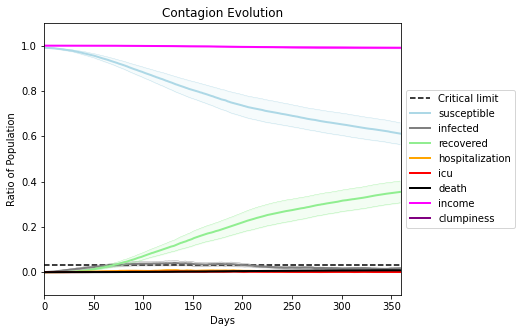

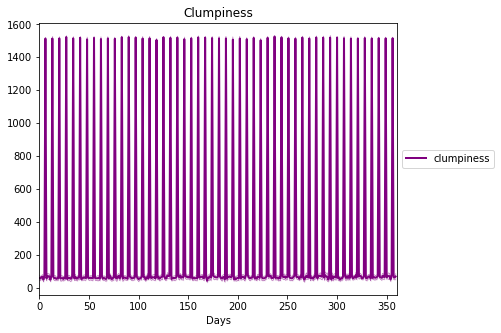

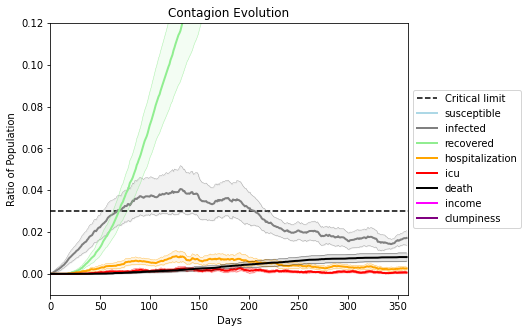

In [18]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.7
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[2741, 6231, 464, 9671, 3640, 9834, 637, 2565, 2797, 6208, 3019, 222, 8901, 6679, 6040, 3127, 3829, 6271, 5951, 6685]
Average similarity between family members is 0.30408509601470174 at temperature -0.6
Average similarity between family and home is 0.9998529629330869 at temperature -1
Average similarity between students and their classroom is 0.17645038664166027 at temperature -0.6
Average classroom occupancy is 1.6568047337278107 and number classrooms is 169
Average similarity between workers is 0.18111849018793244 at temperature -0.6
Average office occupancy is 3.2561576354679804 and number offices is 203
Average friend similarity for adults: 0.374016427915097 for kids: 0.2140820099984242
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.1629272366037847
avg restaurant similarity 0.10106347682721825
avg restaurant similarity 0.0959685855578326
avg restaurant similarity 0.3500125078170982
avg restaurant similarity -0.3451033967049883
avg restaurant similarity 0.08450270767056203
avg restaurant similarity 0.046066348305426726
avg restaurant similarity -0.015178436722760947
avg restaurant similarity 0.14786216320445963
avg restaurant similarity 0.08896312289570732
avg restaurant similarity 0.026197368888588465
avg restaurant similarity 0.0018026108528976514
avg restaurant similarity 0.06377917642841384
avg restaurant similarity 0.09196762515816095
avg restaurant similarity 0.0138243721479262
avg restaurant similarity 0.09975491302954888
avg restaurant similarity 0.126827527566496
avg restaurant similarity 0.07887483663826386
avg restaurant similarity 0.11764062340256527
avg restaurant similarity 0.2001837202842857
avg restaurant similarity 0.22031194462646506
avg restaurant similarity 0.0014399

avg restaurant similarity 0.11915327894428966
avg restaurant similarity 0.07667543433572317
avg restaurant similarity 0.1636569936181268
avg restaurant similarity -0.056315864058157826
avg restaurant similarity -0.07666116849549556
avg restaurant similarity -0.06142040850598025
avg restaurant similarity 0.07782772866408601
avg restaurant similarity -0.06277971513667158
avg restaurant similarity -0.034318879545724344
avg restaurant similarity 0.09251317541081734
avg restaurant similarity 0.29459798676004195
avg restaurant similarity 0.006497074939388856
avg restaurant similarity -0.05161189210926091
avg restaurant similarity 0.17241167687139947
avg restaurant similarity 0.055459685171674065
avg restaurant similarity -0.006024926352105782
avg restaurant similarity 0.16201452186183182
avg restaurant similarity 0.4237434043363379
avg restaurant similarity 0.24479788094887056
avg restaurant similarity 0.1276478689667475
avg restaurant similarity 0.10085687835856948
avg restaurant similarity

avg restaurant similarity 0.06485879336589372
avg restaurant similarity 0.1589298310063214
Average similarity between family members is 0.28726038986960456 at temperature -0.6
Average similarity between family and home is 0.9998554355947353 at temperature -1
Average similarity between students and their classroom is 0.19238708245370065 at temperature -0.6
Average classroom occupancy is 1.6162790697674418 and number classrooms is 172
Average similarity between workers is 0.15427328318170444 at temperature -0.6
Average office occupancy is 3.2758620689655173 and number offices is 203
Average friend similarity for adults: 0.37154822680535854 for kids: 0.2131437563740202
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.30121832103319107
avg restaurant similarity 0.07033009676644267
avg restaurant similarity 0.3266560884203086
avg restaurant similarity 0.5013226637675148
avg restaurant similarity 0.042320621882495926
avg restaurant similarity 0.239275222379025
avg restaurant similarity 0.29809932642891873
avg restaurant similarity -0.036438215089162916
avg restaurant similarity 0.24653507969881638
avg restaurant similarity 0.1286650591281433
avg restaurant similarity 0.1699689314239521
avg restaurant similarity 0.12363308748720207
avg restaurant similarity 0.3570690272821596
avg restaurant similarity -0.2962956385920874
avg restaurant similarity 0.12930540068133875
avg restaurant similarity 0.03536420336121937
avg restaurant similarity -0.0738787435285995
avg restaurant similarity 0.20661089068139205
avg restaurant similarity 0.1781864606210014
avg restaurant similarity -0.024835034195897467
avg restaurant similarity 0.22710676545731795
avg restaurant similarity -0.06610893

avg restaurant similarity 0.13699731358110742
avg restaurant similarity 0.02510111648677097
avg restaurant similarity 0.2074128299878168
avg restaurant similarity 0.17407495536396325
avg restaurant similarity 0.09725809099319067
avg restaurant similarity 0.02699940527583255
avg restaurant similarity 0.0482641521438699
avg restaurant similarity -0.025723345398955808
avg restaurant similarity -0.01326229269688527
avg restaurant similarity 0.3140514606553368
avg restaurant similarity 0.3615695934963917
avg restaurant similarity 0.15703970137860604
avg restaurant similarity -0.00020242114821720066
avg restaurant similarity 0.19434948795023332
avg restaurant similarity 0.14478533878355485
avg restaurant similarity 0.26132565586009393
avg restaurant similarity 0.24945254516973267
avg restaurant similarity 0.3585599973663532
avg restaurant similarity 0.12813160465592882
avg restaurant similarity 0.11626708493616482
avg restaurant similarity 0.089356542890987
avg restaurant similarity 0.038571

Average similarity between workers is 0.13938469695267242 at temperature -0.6
Average office occupancy is 3.282178217821782 and number offices is 202
Average friend similarity for adults: 0.3710155944588998 for kids: 0.22784362485930118
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 1 people.
Total of 1 

avg restaurant similarity 0.11778831062512407
avg restaurant similarity 0.14858192083092045
avg restaurant similarity 0.1783472325415003
avg restaurant similarity -0.04978012057739965
avg restaurant similarity -0.059939162343239163
avg restaurant similarity 0.06596629701856653
avg restaurant similarity 0.20474113892578444
avg restaurant similarity -0.13430910448200456
avg restaurant similarity -0.006142681744867794
avg restaurant similarity 0.00949197718039733
avg restaurant similarity 0.09370701739906105
avg restaurant similarity 0.19779533483035533
avg restaurant similarity 0.17681078465739697
avg restaurant similarity 0.13895605142200032
avg restaurant similarity 0.0018000617737894964
avg restaurant similarity 0.0831125066447828
avg restaurant similarity -0.019777415194204468
avg restaurant similarity -0.15142674212425336
avg restaurant similarity 0.28390707722141384
avg restaurant similarity 0.05216663139129968
avg restaurant similarity 0.06868639907338225
avg restaurant similarity

avg restaurant similarity 0.07315298042700437
avg restaurant similarity 0.23919754577818464
avg restaurant similarity -0.00703697248980815
avg restaurant similarity 0.16790934379927266
avg restaurant similarity 0.12033267763649047
avg restaurant similarity 0.2101865152835325
avg restaurant similarity 0.22216811876663917
avg restaurant similarity 0.39432134691097864
avg restaurant similarity 0.019664622650150787
avg restaurant similarity 0.049165411412373544
avg restaurant similarity 0.07322687724415355
avg restaurant similarity -0.04607610524159543
avg restaurant similarity 0.47353661167873173
avg restaurant similarity 0.2789079637029708
avg restaurant similarity -0.01564741359337817
avg restaurant similarity -0.11601702545505121
avg restaurant similarity 0.18690425617403264
avg restaurant similarity 0.10185764145660683
avg restaurant similarity 0.04219536191991574
avg restaurant similarity 0.16845333876837765
avg restaurant similarity 0.08103088421936694
avg restaurant similarity 0.07

Average similarity between family members is 0.2979724704658678 at temperature -0.6
Average similarity between family and home is 0.9998586734395762 at temperature -1
Average similarity between students and their classroom is 0.17257181749413356 at temperature -0.6
Average classroom occupancy is 1.7352941176470589 and number classrooms is 170
Average similarity between workers is 0.16868855205610106 at temperature -0.6
Average office occupancy is 3.1940298507462686 and number offices is 201
Average friend similarity for adults: 0.37144233562381285 for kids: 0.23220545580820157
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2

avg restaurant similarity 0.11970797371519054
avg restaurant similarity 0.10896850907227577
avg restaurant similarity 0.15985496735719415
avg restaurant similarity -0.04652201681379683
avg restaurant similarity -0.0027856797295564522
avg restaurant similarity 0.06801257204986187
avg restaurant similarity 0.14974615960872967
avg restaurant similarity 0.14094566248455642
avg restaurant similarity 0.026261222424626446
avg restaurant similarity 0.14471604274248168
avg restaurant similarity 0.1923802464666762
avg restaurant similarity 0.13363801290067295
avg restaurant similarity 0.0925406909379904
avg restaurant similarity -0.2021661180802556
avg restaurant similarity 0.00631484355799581
avg restaurant similarity -0.20467234800484357
avg restaurant similarity 0.14672340229180197
avg restaurant similarity -0.05807427620775054
avg restaurant similarity -0.12893556309659365
avg restaurant similarity 0.07866073619169696
avg restaurant similarity -0.16197524413001163
avg restaurant similarity 0

avg restaurant similarity 0.052949829811086396
avg restaurant similarity -0.014885343841626238
avg restaurant similarity -0.14187877246969033
avg restaurant similarity -0.034036006126644425
avg restaurant similarity -0.020396547888456407
avg restaurant similarity -0.022664216022912985
avg restaurant similarity 0.04043048130946502
avg restaurant similarity 0.10140927012113818
avg restaurant similarity -0.5200758398323865
avg restaurant similarity 0.1042649792420124
avg restaurant similarity 0.11519741818030034
avg restaurant similarity 0.11809312004781695
avg restaurant similarity 0.049788491944118794
avg restaurant similarity -0.024009547237076198
avg restaurant similarity 0.06779894743716743
avg restaurant similarity 0.009420147019202234
avg restaurant similarity 0.338424479125126
avg restaurant similarity 0.06180356177473686
avg restaurant similarity 0.2560387116860435
avg restaurant similarity 0.01027404796261198
avg restaurant similarity 0.0828278035829457
avg restaurant similarity

avg restaurant similarity -0.11885819761923039
avg restaurant similarity 0.06118098732384966
avg restaurant similarity 0.09850250249051105
avg restaurant similarity 0.008123231982014553
avg restaurant similarity 0.2657034004956815
avg restaurant similarity 0.15146265514129428
Average similarity between family members is 0.2837612647939444 at temperature -0.6
Average similarity between family and home is 0.9998548642241488 at temperature -1
Average similarity between students and their classroom is 0.16839984272303507 at temperature -0.6
Average classroom occupancy is 1.6222222222222222 and number classrooms is 180
Average similarity between workers is 0.15399635160521866 at temperature -0.6
Average office occupancy is 3.3333333333333335 and number offices is 195
Average friend similarity for adults: 0.3716153540178005 for kids: 0.2314204606406604
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with

avg restaurant similarity -0.41304508789497724
avg restaurant similarity -0.2541863018034807
avg restaurant similarity -0.03624860455111753
avg restaurant similarity 0.2566500187608906
avg restaurant similarity -0.039795176257669394
avg restaurant similarity 0.6148445966714454
avg restaurant similarity -0.005725295532275786
avg restaurant similarity 0.03988054722462494
avg restaurant similarity 0.15660603301435935
avg restaurant similarity 0.20764284636942915
avg restaurant similarity 0.0199148759227861
avg restaurant similarity 0.06637888354338495
avg restaurant similarity -0.033073576857489684
avg restaurant similarity 0.0051359740730480795
avg restaurant similarity 0.06587322581092243
avg restaurant similarity 0.21103497216437267
avg restaurant similarity -0.1276747145156732
avg restaurant similarity -0.014793955261052483
avg restaurant similarity -0.16133563702046863
avg restaurant similarity 0.5030710087796119
avg restaurant similarity -0.05304753298921569
avg restaurant similarit

avg restaurant similarity 0.08404077541221129
avg restaurant similarity -0.0004196642408110268
avg restaurant similarity 0.2101582492754655
avg restaurant similarity 0.06076036135789498
avg restaurant similarity 0.18942129230273516
avg restaurant similarity 0.0728362108050235
avg restaurant similarity 0.04021193171084857
avg restaurant similarity -0.05735503264210155
avg restaurant similarity -0.028421097514666475
avg restaurant similarity 0.0699231827721864
avg restaurant similarity -0.030685373878794203
avg restaurant similarity -0.11551742239717722
avg restaurant similarity 0.14443856140156006
avg restaurant similarity -0.07950857313987851
avg restaurant similarity 0.03741321694681994
avg restaurant similarity -0.10689558440818707
avg restaurant similarity -0.02259945180648243
avg restaurant similarity -0.17153097957437347
avg restaurant similarity -0.055379227597595136
avg restaurant similarity 0.07529644739868907
avg restaurant similarity 0.13167493345458148
avg restaurant similar

Average similarity between workers is 0.16252402516968553 at temperature -0.6
Average office occupancy is 3.3004926108374386 and number offices is 203
Average friend similarity for adults: 0.37203601998262886 for kids: 0.22305253615470372
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 

avg restaurant similarity 0.1543727598664024
avg restaurant similarity 0.07110484597088468
avg restaurant similarity 0.16791927198967044
avg restaurant similarity 0.10101265677590703
avg restaurant similarity 0.16252705868870626
avg restaurant similarity -0.00933869842925428
avg restaurant similarity -0.0037427675417532457
avg restaurant similarity 0.17258691465128465
avg restaurant similarity 0.336959953694901
avg restaurant similarity 0.006258296326258896
avg restaurant similarity -0.13690279865227067
avg restaurant similarity 0.08525977484707001
avg restaurant similarity 0.11119171543679818
avg restaurant similarity 0.11697608436355622
avg restaurant similarity -0.1646780355659525
avg restaurant similarity 0.007290690423059828
avg restaurant similarity 0.11003013385386394
avg restaurant similarity 0.13180527699100375
avg restaurant similarity 0.028427249267798303
avg restaurant similarity 0.0646206726377426
avg restaurant similarity 0.0654093895386756
avg restaurant similarity 0.109

avg restaurant similarity 0.11724686839319483
avg restaurant similarity 0.13924540222730733
avg restaurant similarity 0.1501586104138138
avg restaurant similarity 0.053118340557806294
avg restaurant similarity 0.17670928459905563
avg restaurant similarity 0.051924234401706466
avg restaurant similarity 0.049719212703424706
avg restaurant similarity -0.13444006291891
avg restaurant similarity 0.21095195619062462
avg restaurant similarity -0.03187685528878258
avg restaurant similarity 0.00736106756352468
avg restaurant similarity 0.1939230119786311
avg restaurant similarity 0.010107666046400487
avg restaurant similarity 0.01885198176609391
avg restaurant similarity -0.02809409674307713
avg restaurant similarity -0.16139932376020286
avg restaurant similarity 0.2058868865606336
avg restaurant similarity 0.012778835536118829
avg restaurant similarity -0.009641821644457788
avg restaurant similarity 0.4029136414507723
avg restaurant similarity 0.12741707501823174
avg restaurant similarity 0.02

avg restaurant similarity -0.059666730948933266
avg restaurant similarity 0.2847945784782671
avg restaurant similarity 0.1976052222308813
avg restaurant similarity 0.1375924801242924
Average similarity between family members is 0.29561411212266553 at temperature -0.6
Average similarity between family and home is 0.9998465490804238 at temperature -1
Average similarity between students and their classroom is 0.1546962357053821 at temperature -0.6
Average classroom occupancy is 1.608433734939759 and number classrooms is 166
Average similarity between workers is 0.16218771525043194 at temperature -0.6
Average office occupancy is 3.376237623762376 and number offices is 202
Average friend similarity for adults: 0.38150401815968366 for kids: 0.2149285239142163
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.08275252173647206
avg restaurant similarity 0.12374542786096168
avg restaurant similarity 0.15331463834934353
avg restaurant similarity -0.05448026850235045
avg restaurant similarity 0.18135686595314743
avg restaurant similarity -0.07549986588727683
avg restaurant similarity 0.1087874101208454
avg restaurant similarity 0.06127617573691193
avg restaurant similarity 0.011450942740698355
avg restaurant similarity 0.16593198505575585
avg restaurant similarity 0.08418004713714229
avg restaurant similarity 0.1844982263879341
avg restaurant similarity 0.06939097223072306
avg restaurant similarity 0.09445422815833082
avg restaurant similarity -0.16488331493535247
avg restaurant similarity 0.15317081014790382
avg restaurant similarity 0.07495637647590143
avg restaurant similarity 0.07482634253484906
avg restaurant similarity -0.28082031206899155
avg restaurant similarity 0.18402601239410266
avg restaurant similarity 0.061346365054464114
avg restaurant similarity -0.2

avg restaurant similarity 0.4032594656269526
avg restaurant similarity 0.09596714458498783
avg restaurant similarity 0.20618134784792544
avg restaurant similarity -0.06891635358824928
avg restaurant similarity 0.1302781978755173
avg restaurant similarity -0.05091391910983108
avg restaurant similarity -0.06397899416046493
avg restaurant similarity 0.10776028133777732
avg restaurant similarity 0.30602885745196795
avg restaurant similarity -0.04433557168488538
avg restaurant similarity 0.11884691611089099
avg restaurant similarity 0.00888556202557914
avg restaurant similarity 0.22299075315188416
avg restaurant similarity 0.15769259704765512
avg restaurant similarity 0.03801285795109531
avg restaurant similarity 0.05688355430013214
avg restaurant similarity 0.04285157314331909
avg restaurant similarity 0.23812531194817002
avg restaurant similarity 0.01930767900327901
avg restaurant similarity -0.014071872707287436
avg restaurant similarity -0.009548782834060535
avg restaurant similarity -0

avg restaurant similarity -0.021677297551748947
avg restaurant similarity 0.17277513538768466
avg restaurant similarity -0.019778723909168978
avg restaurant similarity 0.06824285805806747
avg restaurant similarity 0.02120979089768645
Average similarity between family members is 0.30825355316160874 at temperature -0.6
Average similarity between family and home is 0.9998329705975553 at temperature -1
Average similarity between students and their classroom is 0.16522050252637666 at temperature -0.6
Average classroom occupancy is 1.572289156626506 and number classrooms is 166
Average similarity between workers is 0.14857980573623905 at temperature -0.6
Average office occupancy is 3.374384236453202 and number offices is 203
Average friend similarity for adults: 0.3866938362611452 for kids: 0.21889954127435654
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people a

avg restaurant similarity 0.1902413426700523
avg restaurant similarity -0.049555632820335815
avg restaurant similarity 0.18494234841613122
avg restaurant similarity 0.2088720211176552
avg restaurant similarity 0.17192271252823416
avg restaurant similarity 0.15603731773702603
avg restaurant similarity -0.11208329951890372
avg restaurant similarity 0.348356424995537
avg restaurant similarity 0.22496248806812458
avg restaurant similarity 0.1454902867230925
avg restaurant similarity 0.2037851777263381
avg restaurant similarity 0.12738433408161756
avg restaurant similarity 0.2781247639988665
avg restaurant similarity 0.08574636892522605
avg restaurant similarity -0.16563094635346404
avg restaurant similarity 0.15925285844127438
avg restaurant similarity 0.13108579346404528
avg restaurant similarity 0.21563969267511815
avg restaurant similarity 0.20580643316505945
avg restaurant similarity 0.07059199769846376
avg restaurant similarity 0.10079894818568873
avg restaurant similarity 0.039417932

avg restaurant similarity 0.06730070361901443
avg restaurant similarity 0.12892492736844502
avg restaurant similarity 0.08294453042590798
avg restaurant similarity 0.4806812912897646
avg restaurant similarity 0.04550907713823116
avg restaurant similarity 0.06928337391971776
avg restaurant similarity 0.0929533383775612
avg restaurant similarity 0.18966715339138582
avg restaurant similarity 0.2761718164647763
avg restaurant similarity 0.04604571853177806
avg restaurant similarity 0.10887565838712328
avg restaurant similarity 0.29610865420772137
avg restaurant similarity 0.11120690968400238
avg restaurant similarity 0.09691886205301203
avg restaurant similarity 0.13247184797630318
avg restaurant similarity 0.032299090331685675
avg restaurant similarity 0.14397836318337914
avg restaurant similarity 0.07916398399310778
avg restaurant similarity 0.14163300062283854
avg restaurant similarity 0.10264057240240569
avg restaurant similarity -0.03434307626530353
avg restaurant similarity 0.2629141

Average similarity between students and their classroom is 0.18874406199759422 at temperature -0.6
Average classroom occupancy is 1.5901639344262295 and number classrooms is 183
Average similarity between workers is 0.17022811962523782 at temperature -0.6
Average office occupancy is 3.3622448979591835 and number offices is 196
Average friend similarity for adults: 0.3746813903971468 for kids: 0.22511635689591128
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated

avg restaurant similarity 0.0874892151338512
avg restaurant similarity 0.08699055000982776
avg restaurant similarity 0.10897343171137046
avg restaurant similarity 0.035058150873681526
avg restaurant similarity 0.10758013449998595
avg restaurant similarity 0.3986559958043454
avg restaurant similarity -0.03511246301469336
avg restaurant similarity 0.401454327075491
avg restaurant similarity -0.09139886081392742
avg restaurant similarity -0.025999722572028004
avg restaurant similarity 0.23209921859458923
avg restaurant similarity 0.011006446229943168
avg restaurant similarity -0.060132897154750675
avg restaurant similarity 0.014114782636753207
avg restaurant similarity -0.009839255024155584
avg restaurant similarity 0.1315801159364181
avg restaurant similarity 0.023968586121097955
avg restaurant similarity -0.18796571824667396
avg restaurant similarity -0.04357763168380478
avg restaurant similarity 0.0803898297265021
avg restaurant similarity 0.15538312581036806
avg restaurant similarity 

avg restaurant similarity 0.2103288075551795
avg restaurant similarity 0.11388270034928863
avg restaurant similarity -0.09830729011643695
avg restaurant similarity -0.04512357874372155
avg restaurant similarity 0.18787953820155406
avg restaurant similarity 0.02651325264768077
avg restaurant similarity 0.1006491496817409
avg restaurant similarity 0.15091461228489705
avg restaurant similarity -0.032943537123043126
avg restaurant similarity 0.21787356694194907
avg restaurant similarity 0.02254720345648824
avg restaurant similarity -0.012207904288833324
avg restaurant similarity 0.06981746345095094
avg restaurant similarity 0.09923794357198523
avg restaurant similarity 0.1174872438106438
avg restaurant similarity 0.16605715325660547
avg restaurant similarity 0.11857886843244918
avg restaurant similarity -0.03483488283573904
avg restaurant similarity -0.11047531326474573
avg restaurant similarity -0.02870717413751855
avg restaurant similarity 0.06804148997821557
avg restaurant similarity 0.

avg restaurant similarity 0.00861197361231149
avg restaurant similarity 0.04590625559274714
avg restaurant similarity 0.043400480477009507
Average similarity between family members is 0.30937527465509235 at temperature -0.6
Average similarity between family and home is 0.9998536767390932 at temperature -1
Average similarity between students and their classroom is 0.18993068114651612 at temperature -0.6
Average classroom occupancy is 1.6939890710382515 and number classrooms is 183
Average similarity between workers is 0.13700112874093323 at temperature -0.6
Average office occupancy is 3.185 and number offices is 200
Average friend similarity for adults: 0.37399823854455677 for kids: 0.23983614938466968
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each wi

avg restaurant similarity 0.05777011741912426
avg restaurant similarity 0.189500995969712
avg restaurant similarity 0.3441786425649753
avg restaurant similarity -0.02186908138569653
avg restaurant similarity 0.09616055941040592
avg restaurant similarity 0.10787914237574289
avg restaurant similarity -0.014912804765289372
avg restaurant similarity 0.20226150009791216
avg restaurant similarity 0.27443187483147813
avg restaurant similarity 0.2272712625254418
avg restaurant similarity 0.08611670734166607
avg restaurant similarity 0.32032209889467894
avg restaurant similarity 0.18898184401679322
avg restaurant similarity 0.07666511010927934
avg restaurant similarity 0.3582313600416383
avg restaurant similarity 0.07615124083114277
avg restaurant similarity 0.14137344701415988
avg restaurant similarity 0.2294856885581427
avg restaurant similarity 0.08115087883967388
avg restaurant similarity 0.12133937162834983
avg restaurant similarity 0.04217616250322035
avg restaurant similarity 0.080187620

avg restaurant similarity 0.09505794931357099
avg restaurant similarity 0.18234811331559286
avg restaurant similarity 0.17706754309730213
avg restaurant similarity 0.14037903125759188
avg restaurant similarity 0.05808301237314042
avg restaurant similarity 0.17607450754969606
avg restaurant similarity 0.32132783678058974
avg restaurant similarity -0.09888051357579229
avg restaurant similarity 0.22529396585061767
avg restaurant similarity -0.002201876088434357
avg restaurant similarity -0.14680996023340673
avg restaurant similarity 0.3086271679527587
avg restaurant similarity 0.2996726640730454
avg restaurant similarity 0.0615267932285024
avg restaurant similarity -0.008845730981541355
avg restaurant similarity 0.16615303052424973
avg restaurant similarity 0.07969051247663658
avg restaurant similarity 0.12722085579513054
avg restaurant similarity -0.049542624532958414
avg restaurant similarity -0.05316501672237684
avg restaurant similarity 0.08054237219210815
avg restaurant similarity 0.

Average similarity between family and home is 0.9998590517233589 at temperature -1
Average similarity between students and their classroom is 0.1760269638098088 at temperature -0.6
Average classroom occupancy is 1.5668789808917198 and number classrooms is 157
Average similarity between workers is 0.15106660803405844 at temperature -0.6
Average office occupancy is 3.4215686274509802 and number offices is 204
Average friend similarity for adults: 0.3721540097918508 for kids: 0.2106811820449927
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 peo

avg restaurant similarity 0.16282745286842348
avg restaurant similarity 0.07037512355645112
avg restaurant similarity 0.0979372579956798
avg restaurant similarity 0.051200792358912894
avg restaurant similarity 0.103157738691476
avg restaurant similarity -0.06900552393420399
avg restaurant similarity 0.066594183756008
avg restaurant similarity 0.09814506328883717
avg restaurant similarity 0.13850772646657833
avg restaurant similarity -0.05987703134281657
avg restaurant similarity 0.091434462560073
avg restaurant similarity 0.13266225377639487
avg restaurant similarity 0.24058995397959815
avg restaurant similarity 0.1878009443683271
avg restaurant similarity 0.17680944186289932
avg restaurant similarity 0.327764704817741
avg restaurant similarity 0.12898872604647985
avg restaurant similarity 0.20098363801018984
avg restaurant similarity 0.10897396873851267
avg restaurant similarity 0.022075883094153204
avg restaurant similarity 0.14845942087126449
avg restaurant similarity 0.216252444392

avg restaurant similarity 0.09021544095825484
avg restaurant similarity 0.14898450853644002
avg restaurant similarity 0.08939332063549003
avg restaurant similarity -0.002088969549359068
avg restaurant similarity 0.12500778366753723
avg restaurant similarity 0.046051159971602945
avg restaurant similarity 0.07567145305741421
avg restaurant similarity 0.25558790539652815
avg restaurant similarity 0.09065494987442933
avg restaurant similarity -1.7849109448034306e-05
avg restaurant similarity 0.07493102007104406
avg restaurant similarity 0.1532682232306124
avg restaurant similarity 0.13481639962665948
avg restaurant similarity 0.20771363017397884
avg restaurant similarity 0.11773194291703971
avg restaurant similarity -0.06954591984288955
avg restaurant similarity 0.030581172950693725
avg restaurant similarity 0.35147144476490355
avg restaurant similarity -0.02716510873348463
avg restaurant similarity 0.15116420044368423
avg restaurant similarity 0.12179278172753641
avg restaurant similarity

Average similarity between family members is 0.29065115947830966 at temperature -0.6
Average similarity between family and home is 0.9998593509713898 at temperature -1
Average similarity between students and their classroom is 0.16979670933536453 at temperature -0.6
Average classroom occupancy is 1.6935483870967742 and number classrooms is 186
Average similarity between workers is 0.1620972047070688 at temperature -0.6
Average office occupancy is 3.1194029850746268 and number offices is 201
Average friend similarity for adults: 0.36818975943694016 for kids: 0.2467429061453644
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (2,

avg restaurant similarity 0.10489778789534775
avg restaurant similarity 0.14327347199875073
avg restaurant similarity 0.04272631510002015
avg restaurant similarity -0.23060171623379072
avg restaurant similarity -0.028202854932272644
avg restaurant similarity 0.10561721573031083
avg restaurant similarity -0.03536173763555249
avg restaurant similarity 0.003883285387883283
avg restaurant similarity -0.04184477432996895
avg restaurant similarity -0.001888237609686184
avg restaurant similarity 0.27501328889622384
avg restaurant similarity 0.15058857529756192
avg restaurant similarity 0.11872449594364992
avg restaurant similarity 0.1526655813766774
avg restaurant similarity 0.0509146191925867
avg restaurant similarity 0.03049316146271265
avg restaurant similarity 0.1911976017677857
avg restaurant similarity 0.01926430405110705
avg restaurant similarity 0.022005611010275566
avg restaurant similarity 0.05444984481357886
avg restaurant similarity -0.009895806315811247
avg restaurant similarity 

avg restaurant similarity -0.01741608715357759
avg restaurant similarity -0.443794142300286
avg restaurant similarity 0.004846526690136367
avg restaurant similarity -0.1494442280901168
avg restaurant similarity 0.05161397706399437
avg restaurant similarity 0.18824888104625595
avg restaurant similarity -0.1485376439217331
avg restaurant similarity -0.28015340742554906
avg restaurant similarity 0.07751915455787357
avg restaurant similarity 0.05282172803961724
avg restaurant similarity 0.037264228614231336
avg restaurant similarity 0.2303033530337214
avg restaurant similarity -0.17339730199166917
avg restaurant similarity 0.06033500806755051
avg restaurant similarity 0.056592373080442085
avg restaurant similarity -0.04984109485144618
avg restaurant similarity -0.16878334550467022
avg restaurant similarity -0.11428310744352864
avg restaurant similarity 0.04159444167092363
avg restaurant similarity 0.019537814705348933
avg restaurant similarity 0.021594672124656728
avg restaurant similarity

avg restaurant similarity -0.015174794595574935
avg restaurant similarity -0.1554046589649167
avg restaurant similarity -0.03970660984687638
avg restaurant similarity 0.00896810051843205
avg restaurant similarity 0.2845060101651968
Average similarity between family members is 0.28755873074493143 at temperature -0.6
Average similarity between family and home is 0.9998486578586159 at temperature -1
Average similarity between students and their classroom is 0.1821347844628854 at temperature -0.6
Average classroom occupancy is 1.6271186440677967 and number classrooms is 177
Average similarity between workers is 0.16602052389273675 at temperature -0.6
Average office occupancy is 3.2536585365853656 and number offices is 205
Average friend similarity for adults: 0.37941969798619407 for kids: 0.21857580823408904
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people all

avg restaurant similarity 0.1694485719160648
avg restaurant similarity 0.01990892704146956
avg restaurant similarity 0.16788035811374918
avg restaurant similarity 0.049135348161517906
avg restaurant similarity 0.2260229020762711
avg restaurant similarity 0.11587635983908472
avg restaurant similarity 0.12749587523424308
avg restaurant similarity 0.2012489540123223
avg restaurant similarity -0.06556557860629184
avg restaurant similarity 0.15133807724208653
avg restaurant similarity 0.055141178687071225
avg restaurant similarity -0.08810948637934814
avg restaurant similarity 0.21854482839841882
avg restaurant similarity 0.015985030766108164
avg restaurant similarity -0.035447589403429854
avg restaurant similarity 0.21129592347483403
avg restaurant similarity 0.10263240988862804
avg restaurant similarity 0.2425587331451586
avg restaurant similarity -0.04595987328790296
avg restaurant similarity 0.14035616092595204
avg restaurant similarity -0.0266710702187853
avg restaurant similarity 0.24

avg restaurant similarity 0.07261685512569158
avg restaurant similarity 0.34110277315933163
avg restaurant similarity 0.16708978574935004
avg restaurant similarity -0.04392095446425248
avg restaurant similarity 0.24655617161678603
avg restaurant similarity 0.18524388469765024
avg restaurant similarity 0.15222636398601413
avg restaurant similarity 0.08877596313743484
avg restaurant similarity 0.21337133630545294
avg restaurant similarity 0.20383667590165097
avg restaurant similarity 0.1707784418502176
avg restaurant similarity 0.09115224451215286
avg restaurant similarity 0.02396536029947934
avg restaurant similarity 0.2043088147016461
avg restaurant similarity 0.24066956299752196
avg restaurant similarity 0.2486685927305663
avg restaurant similarity 0.015506672395075725
avg restaurant similarity 0.0488725081465467
avg restaurant similarity 0.04888220341012757
avg restaurant similarity 0.18039975159761626
avg restaurant similarity 0.008161129528407871
avg restaurant similarity 0.2392722

avg restaurant similarity -0.06721314102593284
avg restaurant similarity 0.15759364994647285
avg restaurant similarity -0.022298842898658706
Average similarity between family members is 0.31281348831075845 at temperature -0.6
Average similarity between family and home is 0.9998420096150893 at temperature -1
Average similarity between students and their classroom is 0.1939435237677499 at temperature -0.6
Average classroom occupancy is 1.7183908045977012 and number classrooms is 174
Average similarity between workers is 0.1458728254985702 at temperature -0.6
Average office occupancy is 3.2462311557788945 and number offices is 199
Average friend similarity for adults: 0.36533066118120683 for kids: 0.23707105789136948
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 uni

avg restaurant similarity 0.17923325410975288
avg restaurant similarity 0.1006308338803514
avg restaurant similarity -0.022298554687179385
avg restaurant similarity -0.12764818121532281
avg restaurant similarity 0.0702596055245957
avg restaurant similarity 0.06878300834051754
avg restaurant similarity 0.043904410387488574
avg restaurant similarity 0.22339062345474986
avg restaurant similarity -0.009846329610742584
avg restaurant similarity -0.16226490927734707
avg restaurant similarity -0.09862261676201288
avg restaurant similarity -0.1069203100271707
avg restaurant similarity 0.058631847683876526
avg restaurant similarity 0.15521810819730783
avg restaurant similarity -0.05193173812024505
avg restaurant similarity 0.012918792169249321
avg restaurant similarity 0.1768088701183958
avg restaurant similarity 0.3770561980077477
avg restaurant similarity -0.01782986278954906
avg restaurant similarity 0.029775312697624033
avg restaurant similarity 0.023959296966591753
avg restaurant similarit

avg restaurant similarity 0.13822431585621875
avg restaurant similarity -0.03364037749556508
avg restaurant similarity -0.07039574329670577
avg restaurant similarity 0.04386051517838532
avg restaurant similarity -0.008798060994638895
avg restaurant similarity 0.06833415950760034
avg restaurant similarity 0.05713831605641538
avg restaurant similarity 0.08013310138359017
avg restaurant similarity 0.18259196239212233
avg restaurant similarity -0.11399142657518752
avg restaurant similarity -0.04835705671510485
avg restaurant similarity -0.04854871088917078
avg restaurant similarity -0.1805740865269503
avg restaurant similarity 0.03008011130438678
avg restaurant similarity 0.32651445028043163
avg restaurant similarity 0.25904891747951486
avg restaurant similarity 0.11087455775894581
avg restaurant similarity -0.12670110200125764
avg restaurant similarity -0.0491317814576006
avg restaurant similarity 0.19299757975472864
avg restaurant similarity -0.07543944622387914
avg restaurant similarity

avg restaurant similarity -0.002152279304704291
Average similarity between family members is 0.29813527089152975 at temperature -0.6
Average similarity between family and home is 0.9998503893455946 at temperature -1
Average similarity between students and their classroom is 0.1811459824945786 at temperature -0.6
Average classroom occupancy is 1.6839378238341969 and number classrooms is 193
Average similarity between workers is 0.18468481909773335 at temperature -0.6
Average office occupancy is 3.1161616161616164 and number offices is 198
Average friend similarity for adults: 0.3723867756478696 for kids: 0.24870200677361215
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 

avg restaurant similarity 0.1609633933051509
avg restaurant similarity 0.11724767452703293
avg restaurant similarity 0.056420064976763336
avg restaurant similarity 0.06939538265243785
avg restaurant similarity 0.21577678931255134
avg restaurant similarity 0.08250545029413167
avg restaurant similarity 0.09358270656412593
avg restaurant similarity -0.03428668176758463
avg restaurant similarity 0.05708355093141041
avg restaurant similarity 0.14197771415898708
avg restaurant similarity 0.09345175845236804
avg restaurant similarity 0.08808215180016687
avg restaurant similarity 0.008872965631623672
avg restaurant similarity 0.3980353008357382
avg restaurant similarity 0.05634027532214697
avg restaurant similarity 0.07759152414264797
avg restaurant similarity 0.23653515596194674
avg restaurant similarity 0.03826087289143969
avg restaurant similarity 0.08513364852536486
avg restaurant similarity -0.046248365073043786
avg restaurant similarity 0.013706694776763815
avg restaurant similarity 0.09

avg restaurant similarity -0.024234276853699298
avg restaurant similarity -0.05360834997603618
avg restaurant similarity 0.1435070764198924
avg restaurant similarity 0.26780570055712155
avg restaurant similarity 0.1724644156122103
avg restaurant similarity -0.10564066804414013
avg restaurant similarity 0.4133437107650627
avg restaurant similarity 0.2539403922242375
avg restaurant similarity 0.1887704645171536
avg restaurant similarity -0.0017155910915992603
avg restaurant similarity 0.002932399106793071
avg restaurant similarity 0.3184907497243234
avg restaurant similarity -0.03760740029210253
avg restaurant similarity 0.003643091893604525
avg restaurant similarity 0.03596596525278481
avg restaurant similarity 0.02461974225458536
avg restaurant similarity 0.43094219889011676
avg restaurant similarity 0.1224924693502521
avg restaurant similarity 0.18860352529347468
avg restaurant similarity 0.0005204557884887619
avg restaurant similarity -0.1707353044837596
avg restaurant similarity 0.0

avg restaurant similarity 0.13322991575211882
Average similarity between family members is 0.29523878819200217 at temperature -0.6
Average similarity between family and home is 0.9998592125527854 at temperature -1
Average similarity between students and their classroom is 0.1768929060289996 at temperature -0.6
Average classroom occupancy is 1.581151832460733 and number classrooms is 191
Average similarity between workers is 0.1429006606561781 at temperature -0.6
Average office occupancy is 3.089108910891089 and number offices is 202
Average friend similarity for adults: 0.364550523657529 for kids: 0.2396224119677613
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 peopl

avg restaurant similarity 0.3772023177009349
avg restaurant similarity 0.20793885509682744
avg restaurant similarity 0.26274827928995664
avg restaurant similarity 0.0013558196593422972
avg restaurant similarity 0.19502317506175043
avg restaurant similarity 0.056318458424399
avg restaurant similarity 0.10685820245147674
avg restaurant similarity -0.08355634288023445
avg restaurant similarity 0.1771071615517433
avg restaurant similarity 0.2509009533349412
avg restaurant similarity 0.18379766778777237
avg restaurant similarity 0.2580497020225308
avg restaurant similarity 0.10648578688802823
avg restaurant similarity 0.36705467056536295
avg restaurant similarity 0.30959599551626515
avg restaurant similarity 0.10606943984189933
avg restaurant similarity 0.20801148301332395
avg restaurant similarity 0.21953472063580648
avg restaurant similarity 0.04408678158190444
avg restaurant similarity 0.02975789488206958
avg restaurant similarity 0.39885702737223366
avg restaurant similarity 0.070714258

avg restaurant similarity 0.08144420133194462
avg restaurant similarity -0.001567436874865876
avg restaurant similarity 0.08646637413644877
avg restaurant similarity 0.11527582628648779
avg restaurant similarity 0.15600145033739218
avg restaurant similarity 0.07353830311198284
avg restaurant similarity -0.24136824172878807
avg restaurant similarity 0.05778135400070624
avg restaurant similarity 0.1867392800133496
avg restaurant similarity 0.1546142302100818
avg restaurant similarity 0.27602598453529187
avg restaurant similarity 0.12291284443923955
avg restaurant similarity 0.06827896985530846
avg restaurant similarity 0.14418192249515865
avg restaurant similarity 0.14038302353501336
avg restaurant similarity -0.040344722799779964
avg restaurant similarity 0.29634470107231203
avg restaurant similarity 0.235880693189971
avg restaurant similarity -0.19321644569113183
avg restaurant similarity 0.32596834490353227
avg restaurant similarity 0.179668172309307
avg restaurant similarity 0.162833

avg restaurant similarity 0.46730133790743167
Average similarity between family members is 0.2957062259573604 at temperature -0.6
Average similarity between family and home is 0.9998530749606876 at temperature -1
Average similarity between students and their classroom is 0.16038865673085131 at temperature -0.6
Average classroom occupancy is 1.5977011494252873 and number classrooms is 174
Average similarity between workers is 0.16921717894902272 at temperature -0.6
Average office occupancy is 3.288557213930348 and number offices is 201
Average friend similarity for adults: 0.3831484427974237 for kids: 0.2268416113085165
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 2 people.
Total of 2 peop

avg restaurant similarity 0.0751669033281093
avg restaurant similarity 0.06945796503759047
avg restaurant similarity -0.07452058233118662
avg restaurant similarity 0.12609030517377678
avg restaurant similarity -0.029284954888348314
avg restaurant similarity -0.007802997050723312
avg restaurant similarity 0.11071340422547732
avg restaurant similarity 0.17671933478279298
avg restaurant similarity 0.15550801280823812
avg restaurant similarity 0.14996931382997014
avg restaurant similarity 0.09519743614083258
avg restaurant similarity 0.1652181208152129
avg restaurant similarity 0.22144476384703435
avg restaurant similarity 0.046642224503119015
avg restaurant similarity 0.014080354973517575
avg restaurant similarity 0.13652282417261905
avg restaurant similarity 0.017202235154757523
avg restaurant similarity 0.08061795698494073
avg restaurant similarity 0.058233219720901855
avg restaurant similarity 0.029570848802363114
avg restaurant similarity -0.05310476531789623
avg restaurant similarity

avg restaurant similarity 0.12437599141281976
avg restaurant similarity -0.08800647942103322
avg restaurant similarity 0.02839548983978681
avg restaurant similarity 0.1823283299348351
avg restaurant similarity 0.021302618055965658
avg restaurant similarity 0.07755947204315738
avg restaurant similarity 0.39833149630354603
avg restaurant similarity 0.2528418078469425
avg restaurant similarity -0.1438186099333697
avg restaurant similarity 0.12304591868979947
avg restaurant similarity 0.11618598781565816
avg restaurant similarity -0.009446876829078044
avg restaurant similarity 0.03640778935379565
avg restaurant similarity 0.2099290086798707
avg restaurant similarity 0.04770771717101907
avg restaurant similarity 0.2896238084597233
avg restaurant similarity 0.1460025703887274
avg restaurant similarity 0.05401724451007205
avg restaurant similarity 0.28496438785482
avg restaurant similarity 0.17134712344109118
avg restaurant similarity 0.08333450519465935
avg restaurant similarity 0.0014792051

avg restaurant similarity 0.05247424351032833
avg restaurant similarity 0.39930659297041426
Average similarity between family members is 0.2904846184909695 at temperature -0.6
Average similarity between family and home is 0.9998545772422737 at temperature -1
Average similarity between students and their classroom is 0.19434466811559764 at temperature -0.6
Average classroom occupancy is 1.5977653631284916 and number classrooms is 179
Average similarity between workers is 0.16098233474821272 at temperature -0.6
Average office occupancy is 3.23 and number offices is 200
Average friend similarity for adults: 0.36624161535717403 for kids: 0.21645546388177067
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a

avg restaurant similarity 0.10000592699861552
avg restaurant similarity 0.033410260842583916
avg restaurant similarity 0.06543032055495931
avg restaurant similarity 0.13690267443415735
avg restaurant similarity -0.31505132356594345
avg restaurant similarity 0.09875763891783383
avg restaurant similarity 0.11592021962987911
avg restaurant similarity 0.2779541327634783
avg restaurant similarity 0.26811955842110874
avg restaurant similarity 0.04905651258158824
avg restaurant similarity -0.053939746679500966
avg restaurant similarity 0.2675395274094583
avg restaurant similarity 0.47169212966053214
avg restaurant similarity 0.016336211572193757
avg restaurant similarity 0.12348453467606291
avg restaurant similarity -0.05253681937075463
avg restaurant similarity 0.13465668333724368
avg restaurant similarity 0.22773667730662714
avg restaurant similarity -0.04500937134435943
avg restaurant similarity 0.16420400876171853
avg restaurant similarity 0.07044461045626693
avg restaurant similarity -0.

avg restaurant similarity -0.07285307556386818
avg restaurant similarity 0.2379576111873923
avg restaurant similarity 0.0806555688774072
avg restaurant similarity 0.34134449489314433
avg restaurant similarity -0.005311767011483615
avg restaurant similarity 0.1363991163952073
avg restaurant similarity 0.05101583324056791
avg restaurant similarity -0.00867414568074179
avg restaurant similarity 0.25827971660699356
avg restaurant similarity -0.03227527615278446
avg restaurant similarity 0.10521753324625636
avg restaurant similarity 0.23148406907473634
avg restaurant similarity 0.0010243094868699898
avg restaurant similarity 0.056752318557771034
avg restaurant similarity -0.27448485282135177
avg restaurant similarity 0.03971281658808041
avg restaurant similarity 0.31076626676418606
avg restaurant similarity -0.06432943625864647
avg restaurant similarity 0.12864324407420324
avg restaurant similarity -0.023266674817910324
avg restaurant similarity -0.04086981285264156
avg restaurant similarit

Average similarity between workers is 0.14019935492021446 at temperature -0.6
Average office occupancy is 3.3333333333333335 and number offices is 201
Average friend similarity for adults: 0.36332675598890507 for kids: 0.2164972265900494
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 p

avg restaurant similarity 0.09422563446632097
avg restaurant similarity 0.12113017901549701
avg restaurant similarity 0.055317393258703246
avg restaurant similarity 0.1835666046765475
avg restaurant similarity 0.13793289589942928
avg restaurant similarity 0.0008175158455819366
avg restaurant similarity 0.048506564201226975
avg restaurant similarity 0.08471546057499306
avg restaurant similarity 0.016420061744516337
avg restaurant similarity 0.2485368861084368
avg restaurant similarity 0.012989931613899372
avg restaurant similarity 0.031906439208101704
avg restaurant similarity 0.0693325024037781
avg restaurant similarity 0.1953809761033172
avg restaurant similarity 0.4400394099943726
avg restaurant similarity 0.020762743177782303
avg restaurant similarity 0.033066853586804154
avg restaurant similarity 0.23371725654610823
avg restaurant similarity 0.27452034405684417
avg restaurant similarity 0.12019126992720663
avg restaurant similarity 0.17185558860963415
avg restaurant similarity 0.19

avg restaurant similarity 0.05955742022041913
avg restaurant similarity 0.18280861433970141
avg restaurant similarity -0.08168700733262522
avg restaurant similarity 0.2045438293154459
avg restaurant similarity 0.060192658662966955
avg restaurant similarity 0.0006293846829753905
avg restaurant similarity -0.2737999694145062
avg restaurant similarity 0.13631976521316358
avg restaurant similarity -0.1280251597172068
avg restaurant similarity 0.135178722912017
avg restaurant similarity -0.1143272368330301
avg restaurant similarity 0.13002287003741736
avg restaurant similarity 0.2650418518566142
avg restaurant similarity 0.174667932607018
avg restaurant similarity -0.056573932316901686
avg restaurant similarity 0.01728735976185676
avg restaurant similarity 0.07655062171739842
avg restaurant similarity 0.2101004298989645
avg restaurant similarity -0.0008257025268792115
avg restaurant similarity 0.20321847027512577
avg restaurant similarity 0.2961388917941769
avg restaurant similarity 0.02998

Average similarity between family and home is 0.999859472346478 at temperature -1
Average similarity between students and their classroom is 0.1839831882188894 at temperature -0.6
Average classroom occupancy is 1.6480446927374302 and number classrooms is 179
Average similarity between workers is 0.16037924281230403 at temperature -0.6
Average office occupancy is 3.2487562189054726 and number offices is 201
Average friend similarity for adults: 0.3691694533939606 for kids: 0.2430637207099413
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 

avg restaurant similarity 0.1637691533424082
avg restaurant similarity 0.06005612102646888
avg restaurant similarity 0.16797888049098225
avg restaurant similarity 0.25285999051027014
avg restaurant similarity 0.0010116523165795866
avg restaurant similarity 0.20342470477075997
avg restaurant similarity 0.13364353078852595
avg restaurant similarity 0.18181710973857804
avg restaurant similarity 0.24635229055404234
avg restaurant similarity 0.06542683875630811
avg restaurant similarity 0.14747640726892203
avg restaurant similarity 0.3714351443471121
avg restaurant similarity 0.20313124940413096
avg restaurant similarity 0.19936461318058604
avg restaurant similarity 0.26593520438095664
avg restaurant similarity -0.04955678416084741
avg restaurant similarity 0.17375528278937796
avg restaurant similarity 0.16132921499481204
avg restaurant similarity 0.12980372643763594
avg restaurant similarity 0.050456691603931854
avg restaurant similarity 0.1183744781478231
avg restaurant similarity 0.09132

avg restaurant similarity 0.17143543783789003
avg restaurant similarity 0.17095338514995329
avg restaurant similarity 0.17647519554590893
avg restaurant similarity -0.022288089078584598
avg restaurant similarity 0.308670159962526
avg restaurant similarity 0.020919221513244293
avg restaurant similarity 0.06332544598851585
avg restaurant similarity 0.06532151027994741
avg restaurant similarity 0.01407857126642512
avg restaurant similarity 0.175153560910448
avg restaurant similarity 0.22933645142435685
avg restaurant similarity 0.03779026410875948
avg restaurant similarity 0.0398625773059174
avg restaurant similarity 0.3077023520679943
avg restaurant similarity 0.13573872139452536
avg restaurant similarity 0.41536387793198826
avg restaurant similarity 0.24417778480784602
avg restaurant similarity 0.13418841916808716
avg restaurant similarity 0.016798446122731944
avg restaurant similarity 0.00492295516687713
avg restaurant similarity 0.1550702652280059
avg restaurant similarity 0.224225450

(<function dict.items>, <function dict.items>, <function dict.items>)

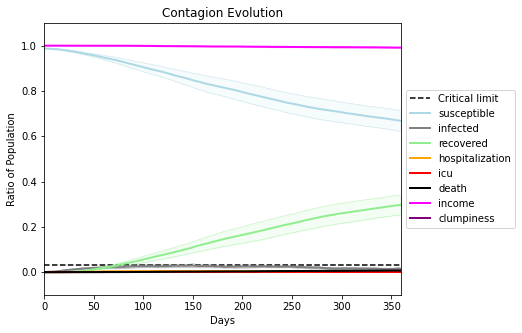

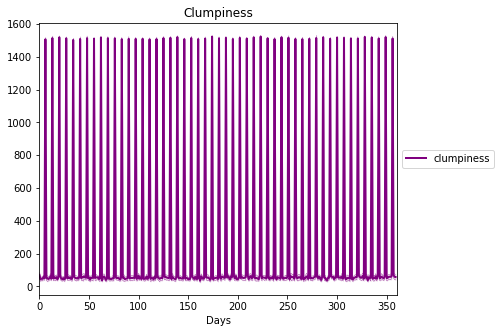

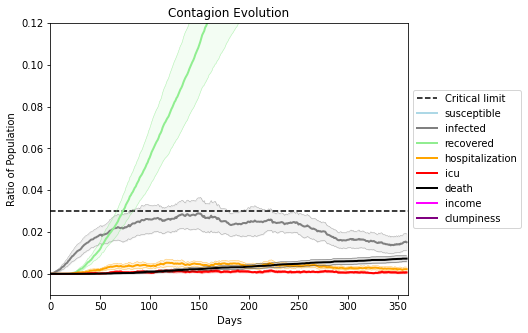

In [19]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.6
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5750, 7324, 1421, 2534, 8650, 4252, 2183, 6470, 3065, 6822, 1607, 2355, 7738, 431, 8990, 356, 574, 4075, 5702, 9567]
Average similarity between family members is 0.2544749448668653 at temperature -0.5
Average similarity between family and home is 0.9998470710405938 at temperature -1
Average similarity between students and their classroom is 0.21171117464044817 at temperature -0.5
Average classroom occupancy is 1.6358024691358024 and number classrooms is 162
Average similarity between workers is 0.15836290351630897 at temperature -0.5
Average office occupancy is 3.354679802955665 and number offices is 203
Average friend similarity for adults: 0.3335572716256114 for kids: 0.20883852554761625
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.2103481919987106
avg restaurant similarity -0.03524565296653455
avg restaurant similarity 0.01625061915700895
avg restaurant similarity 0.07995167822502505
avg restaurant similarity 0.01793425305694488
avg restaurant similarity 0.0012531954709847648
avg restaurant similarity 0.024610097324587153
avg restaurant similarity 0.3209284204516129
avg restaurant similarity 0.07259491863791184
avg restaurant similarity 0.05714062610960863
avg restaurant similarity 0.030334706855847854
avg restaurant similarity -0.07209433244613524
avg restaurant similarity -0.05467826103380457
avg restaurant similarity 0.021606402815177343
avg restaurant similarity 0.28981746989007356
avg restaurant similarity 0.09229627657837328
avg restaurant similarity 0.03130614704790876
avg restaurant similarity 0.1624748526078545
avg restaurant similarity 0.1253791456772903
avg restaurant similarity 0.12613656620921102
avg restaurant similarity 0.18485071868632894
avg restaurant similarity 0.12

avg restaurant similarity 0.026246981915204748
avg restaurant similarity 0.08459101656626922
avg restaurant similarity 0.2212459190372966
avg restaurant similarity -0.049362411055156215
avg restaurant similarity 0.05525205376676803
avg restaurant similarity 0.09485743063953082
avg restaurant similarity -0.03744187556062702
avg restaurant similarity 0.19313393317341992
avg restaurant similarity -0.008523272556467348
avg restaurant similarity -0.024337986049806894
avg restaurant similarity 0.5081512201157197
avg restaurant similarity 0.1851580218041255
avg restaurant similarity 0.09325183456742991
avg restaurant similarity 0.10304660958606268
avg restaurant similarity 0.1424682312276769
avg restaurant similarity 0.27185777854373977
avg restaurant similarity 0.37108230834898964
avg restaurant similarity 0.11374416833470592
avg restaurant similarity -0.010007693528983681
avg restaurant similarity 0.18815447282528558
avg restaurant similarity 0.10742957427373144
avg restaurant similarity 0.

avg restaurant similarity 0.03310324482729767
avg restaurant similarity 0.1602746684387184
Average similarity between family members is 0.2724128686621519 at temperature -0.5
Average similarity between family and home is 0.9998606611364169 at temperature -1
Average similarity between students and their classroom is 0.20623181703483792 at temperature -0.5
Average classroom occupancy is 1.6797752808988764 and number classrooms is 178
Average similarity between workers is 0.15544193370404746 at temperature -0.5
Average office occupancy is 3.190954773869347 and number offices is 199
Average friend similarity for adults: 0.31907698922947814 for kids: 0.2199147635542715
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated

avg restaurant similarity 0.22561209223437503
avg restaurant similarity 0.22280789861754313
avg restaurant similarity 0.25653675141999827
avg restaurant similarity 0.0325651210137233
avg restaurant similarity 0.2614666968910189
avg restaurant similarity -0.0005837850795848638
avg restaurant similarity 0.17939674671656985
avg restaurant similarity 0.06212792832877212
avg restaurant similarity -0.06394516131566069
avg restaurant similarity 0.028716762890208417
avg restaurant similarity 0.1319089579170381
avg restaurant similarity 0.014613695842269434
avg restaurant similarity -0.03218246516304978
avg restaurant similarity -5.705625920473847e-05
avg restaurant similarity 0.13718510401538592
avg restaurant similarity -0.014648685813680097
avg restaurant similarity 0.2572173196893778
avg restaurant similarity -0.19207709482439864
avg restaurant similarity 0.13731575891167808
avg restaurant similarity -0.01218757275049402
avg restaurant similarity 0.019889019491914517
avg restaurant similari

avg restaurant similarity 0.14825858613265622
avg restaurant similarity -0.13384226166905036
avg restaurant similarity 0.07850535448028942
avg restaurant similarity 0.008494313663141802
avg restaurant similarity 0.45133418845781625
avg restaurant similarity 0.0778330928525697
avg restaurant similarity -0.09964246995122907
avg restaurant similarity 0.09849462448232593
avg restaurant similarity 0.12234880577282035
avg restaurant similarity 0.07144563288062358
avg restaurant similarity 0.04343078149708375
avg restaurant similarity 0.18991659341501121
avg restaurant similarity 0.31193438454771527
avg restaurant similarity 0.17301565969417998
avg restaurant similarity 0.18725531109847898
avg restaurant similarity 0.012460933660328216
avg restaurant similarity 0.1518297813072474
avg restaurant similarity 0.05057427397113958
avg restaurant similarity 0.362138008092509
avg restaurant similarity -0.01031427444612092
avg restaurant similarity 0.09441964396989189
avg restaurant similarity 0.29698

Average similarity between family and home is 0.9998477750671421 at temperature -1
Average similarity between students and their classroom is 0.1887472400494821 at temperature -0.5
Average classroom occupancy is 1.5875706214689265 and number classrooms is 177
Average similarity between workers is 0.179658195739497 at temperature -0.5
Average office occupancy is 3.3134328358208953 and number offices is 201
Average friend similarity for adults: 0.3445042871958324 for kids: 0.2175140637538848
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 peo

avg restaurant similarity 0.031520086495237035
avg restaurant similarity 0.2610894597847134
avg restaurant similarity 0.332950836607033
avg restaurant similarity 0.03723733577102585
avg restaurant similarity 0.170949327748464
avg restaurant similarity 0.03593026337579924
avg restaurant similarity 0.2385366845390349
avg restaurant similarity 0.12170933760595298
avg restaurant similarity 0.06418655495868503
avg restaurant similarity 0.04884411713185131
avg restaurant similarity 0.1852541921414957
avg restaurant similarity 0.11989607063063801
avg restaurant similarity 0.13252529320224135
avg restaurant similarity -0.018988157681539337
avg restaurant similarity 0.11779055722927681
avg restaurant similarity 0.22867144262981987
avg restaurant similarity 0.2086970047801977
avg restaurant similarity 0.20081133960120068
avg restaurant similarity 0.20244812505781623
avg restaurant similarity 0.08396799581272123
avg restaurant similarity -0.011010217050869846
avg restaurant similarity 0.160474034

avg restaurant similarity 0.1386391757731884
avg restaurant similarity 0.3629036570568993
avg restaurant similarity 0.002553023562075712
avg restaurant similarity 0.18912805383608033
avg restaurant similarity 0.22435249602190008
avg restaurant similarity 0.14933507596842335
avg restaurant similarity 0.10173810834999374
avg restaurant similarity 0.12199339596602117
avg restaurant similarity 0.047465251847837314
avg restaurant similarity 0.11247843387679306
avg restaurant similarity 0.09185604539694803
avg restaurant similarity 0.3294346323248999
avg restaurant similarity 0.04551923438805474
avg restaurant similarity 0.07623165651167471
avg restaurant similarity 0.16360277784221763
avg restaurant similarity 0.11998115620612614
avg restaurant similarity -0.01738580356943602
avg restaurant similarity 0.0673846486584483
avg restaurant similarity 0.12958720426605194
avg restaurant similarity 0.16808211286577593
avg restaurant similarity 0.1863474543559911
avg restaurant similarity 0.14579151

Average similarity between family members is 0.24144776499200848 at temperature -0.5
Average similarity between family and home is 0.9998530243823646 at temperature -1
Average similarity between students and their classroom is 0.16353420680286138 at temperature -0.5
Average classroom occupancy is 1.5754189944134078 and number classrooms is 179
Average similarity between workers is 0.1484068940644434 at temperature -0.5
Average office occupancy is 3.288557213930348 and number offices is 201
Average friend similarity for adults: 0.32274898967256305 for kids: 0.21285531561625548
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,

avg restaurant similarity -0.006339418811654605
avg restaurant similarity 0.13887514107136342
avg restaurant similarity 0.08098068473542201
avg restaurant similarity 0.12497471303717542
avg restaurant similarity -0.01914700572164298
avg restaurant similarity -0.12521750965662495
avg restaurant similarity -0.023476899213934324
avg restaurant similarity 0.040725608876302666
avg restaurant similarity 0.19560738754425322
avg restaurant similarity 0.03239317275611653
avg restaurant similarity -0.06996191858275073
avg restaurant similarity 0.1382387993356948
avg restaurant similarity 0.05178858502432694
avg restaurant similarity -0.041626959300464055
avg restaurant similarity -0.014429627448163672
avg restaurant similarity 0.07428688605091147
avg restaurant similarity -0.1188536514753822
avg restaurant similarity 0.02199921148182628
avg restaurant similarity -0.00614202724221639
avg restaurant similarity -0.16764755838783044
avg restaurant similarity -0.004197771080654067
avg restaurant simi

avg restaurant similarity -0.0044871107404244465
avg restaurant similarity -0.0036202668539337033
avg restaurant similarity -0.12315561913476274
avg restaurant similarity -0.007789816498337342
avg restaurant similarity 0.1822773227785259
avg restaurant similarity 0.19110014530677324
avg restaurant similarity 0.02683292143768889
avg restaurant similarity -0.12269394908072428
avg restaurant similarity 0.18567666666496335
avg restaurant similarity 0.0796722268498505
avg restaurant similarity 0.2687948793710919
avg restaurant similarity -0.24407932319476522
avg restaurant similarity -0.054882025430066796
avg restaurant similarity -0.03843882888808262
avg restaurant similarity 0.0890728261442678
avg restaurant similarity -0.0068557385782547645
avg restaurant similarity 0.09886719335114767
avg restaurant similarity 0.0663978758682779
avg restaurant similarity -0.005331383639055949
avg restaurant similarity 0.021410553929910214
avg restaurant similarity 0.09819736057838895
avg restaurant simi

avg restaurant similarity -0.018442247305693934
avg restaurant similarity 0.0009238608914405311
avg restaurant similarity -0.02352445394107231
Average similarity between family members is 0.26380642442702606 at temperature -0.5
Average similarity between family and home is 0.9998536373449286 at temperature -1
Average similarity between students and their classroom is 0.19152907956475335 at temperature -0.5
Average classroom occupancy is 1.688235294117647 and number classrooms is 170
Average similarity between workers is 0.17296396157240812 at temperature -0.5
Average office occupancy is 3.3165829145728645 and number offices is 199
Average friend similarity for adults: 0.3335508645642318 for kids: 0.21755002914083182
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20

avg restaurant similarity 0.16938548829392075
avg restaurant similarity 0.29445565484118386
avg restaurant similarity 0.3403213178239211
avg restaurant similarity 0.1785016257762507
avg restaurant similarity 0.22280413659165532
avg restaurant similarity 0.14337508388870213
avg restaurant similarity 0.4407559134796304
avg restaurant similarity 0.13324460108995087
avg restaurant similarity 0.3430556226989369
avg restaurant similarity 0.10056139058264353
avg restaurant similarity 0.29138154706748703
avg restaurant similarity 0.3245515650944049
avg restaurant similarity 0.22464513566779942
avg restaurant similarity -0.15348722479577948
avg restaurant similarity 0.10164565496606108
avg restaurant similarity 0.1710325569191776
avg restaurant similarity 0.24139802261454507
avg restaurant similarity 0.13703025361552276
avg restaurant similarity 0.15907460045657165
avg restaurant similarity 0.21460036222728734
avg restaurant similarity 0.04896696416464828
avg restaurant similarity 0.04730470151

avg restaurant similarity 0.13993199573346515
avg restaurant similarity 0.1925057120139108
avg restaurant similarity 0.08070082998608434
avg restaurant similarity 0.04123455178494996
avg restaurant similarity 0.5111019669932503
avg restaurant similarity 0.34622779344012916
avg restaurant similarity 0.22777428182519843
avg restaurant similarity 0.3142354802030839
avg restaurant similarity 0.11596052397528737
avg restaurant similarity -0.026512569273979766
avg restaurant similarity 0.2589862231546166
avg restaurant similarity 0.08453451998395142
avg restaurant similarity 0.03814278664706081
avg restaurant similarity 0.04849735394775457
avg restaurant similarity 0.07438380777490973
avg restaurant similarity 0.13224079377300949
avg restaurant similarity 0.25787017612613805
avg restaurant similarity 0.37277284230702673
avg restaurant similarity 0.013920296948281629
avg restaurant similarity 0.3280983345463651
avg restaurant similarity 0.20226815199387385
avg restaurant similarity -0.1234744

avg restaurant similarity 0.11366101518401443
Average similarity between family members is 0.23196350820612271 at temperature -0.5
Average similarity between family and home is 0.9998633640201806 at temperature -1
Average similarity between students and their classroom is 0.15535341533290395 at temperature -0.5
Average classroom occupancy is 1.7777777777777777 and number classrooms is 171
Average similarity between workers is 0.17001435240299392 at temperature -0.5
Average office occupancy is 3.303030303030303 and number offices is 198
Average friend similarity for adults: 0.3249503677990452 for kids: 0.21787856878481807
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 1

avg restaurant similarity 0.21788835577870244
avg restaurant similarity 0.20298041690115856
avg restaurant similarity 0.10660211476732168
avg restaurant similarity 0.16378195778052956
avg restaurant similarity 0.19160711787386056
avg restaurant similarity 0.09530338047620843
avg restaurant similarity -0.07997059391972286
avg restaurant similarity 0.1828878343142609
avg restaurant similarity 0.13822148460335285
avg restaurant similarity -0.004189487945080999
avg restaurant similarity 0.027345567083315838
avg restaurant similarity 0.22222143671909536
avg restaurant similarity 0.214878219468741
avg restaurant similarity 0.16104051270111094
avg restaurant similarity 0.1404288345313175
avg restaurant similarity 0.14151545129670662
avg restaurant similarity 0.005109128984229008
avg restaurant similarity 0.10453630235870603
avg restaurant similarity 0.1948570276811023
avg restaurant similarity -0.02309084580619515
avg restaurant similarity 0.26331179921431785
avg restaurant similarity 0.01493

avg restaurant similarity 0.26382647638638834
avg restaurant similarity 0.09683177857219917
avg restaurant similarity 0.0031756104566706875
avg restaurant similarity 0.36482840200773486
avg restaurant similarity 0.11896152427318518
avg restaurant similarity 0.1512336047851827
avg restaurant similarity -0.029471037177902497
avg restaurant similarity 0.036999426871597914
avg restaurant similarity 0.06745978251400107
avg restaurant similarity 0.16744093427011575
avg restaurant similarity 0.20450353000755486
avg restaurant similarity 0.03187761794433222
avg restaurant similarity 0.5639872379804725
avg restaurant similarity 0.08203418670850489
avg restaurant similarity 0.23412225688441052
avg restaurant similarity -0.1052324319683299
avg restaurant similarity 0.4161672576783614
avg restaurant similarity -0.060527876896314114
avg restaurant similarity -0.010842600148460703
avg restaurant similarity 0.1316230532128919
avg restaurant similarity 0.3524228193242469
avg restaurant similarity 0.11

Average similarity between students and their classroom is 0.18890738332563659 at temperature -0.5
Average classroom occupancy is 1.6256983240223464 and number classrooms is 179
Average similarity between workers is 0.14772386023923176 at temperature -0.5
Average office occupancy is 3.241206030150754 and number offices is 199
Average friend similarity for adults: 0.3301369419638802 for kids: 0.21405581892376874
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated 

avg restaurant similarity 0.09503320056885707
avg restaurant similarity 0.1323533843812624
avg restaurant similarity 0.03946029390409459
avg restaurant similarity 0.15593667001791753
avg restaurant similarity -0.010349604808307362
avg restaurant similarity 0.210236367617258
avg restaurant similarity 0.36685955480796384
avg restaurant similarity 0.03139281993987448
avg restaurant similarity 0.23061293652536866
avg restaurant similarity 0.09691570755891979
avg restaurant similarity 0.050901485099206834
avg restaurant similarity 0.28874589877523493
avg restaurant similarity 0.05604102020156126
avg restaurant similarity 0.1101343300049795
avg restaurant similarity 0.0845021137619729
avg restaurant similarity 0.16501529758193034
avg restaurant similarity 0.1176812434318087
avg restaurant similarity 0.1557487125903118
avg restaurant similarity 0.27762106961968613
avg restaurant similarity 0.00610093820014664
avg restaurant similarity 0.19229882841795862
avg restaurant similarity -0.105880149

avg restaurant similarity 0.19811478022022175
avg restaurant similarity 0.3768369540218125
avg restaurant similarity 0.1547170506601058
avg restaurant similarity 0.15792380509220044
avg restaurant similarity 0.10585806932434429
avg restaurant similarity 0.056490990132089955
avg restaurant similarity 0.12362958345425189
avg restaurant similarity 0.1075343216295439
avg restaurant similarity 0.13564270110624596
avg restaurant similarity 0.13857622138333778
avg restaurant similarity 0.1373794536156452
avg restaurant similarity -0.16965233898584334
avg restaurant similarity 0.1482047047424708
avg restaurant similarity 0.12148850106873064
avg restaurant similarity 0.01170802108740937
avg restaurant similarity -0.027560713343165663
avg restaurant similarity 0.08420344818899522
avg restaurant similarity 0.08720329522985158
avg restaurant similarity 0.2255437561117158
avg restaurant similarity 0.1585048379289054
avg restaurant similarity 0.4639278454385247
avg restaurant similarity 0.1853057616

Average similarity between family and home is 0.9998613974537991 at temperature -1
Average similarity between students and their classroom is 0.1731678908192598 at temperature -0.5
Average classroom occupancy is 1.7027027027027026 and number classrooms is 185
Average similarity between workers is 0.15102634121456088 at temperature -0.5
Average office occupancy is 3.180904522613065 and number offices is 199
Average friend similarity for adults: 0.31090543362377004 for kids: 0.21137619026713972
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 

avg restaurant similarity -0.13149242393218877
avg restaurant similarity -0.027117510418202723
avg restaurant similarity 0.12327419702606973
avg restaurant similarity -0.12026895174988382
avg restaurant similarity 0.1748688237531256
avg restaurant similarity 0.07494478080213274
avg restaurant similarity 0.19156114548531486
avg restaurant similarity -0.20337304079318547
avg restaurant similarity 0.24034846772596058
avg restaurant similarity 0.44097867191234275
avg restaurant similarity -0.21331112154677292
avg restaurant similarity -0.15133137008699188
avg restaurant similarity 0.20987519996287043
avg restaurant similarity 0.10711345091688125
avg restaurant similarity 0.08549409976192839
avg restaurant similarity -0.10347125729999501
avg restaurant similarity 0.20134728907705773
avg restaurant similarity 0.17791011301692033
avg restaurant similarity -0.022681455474547252
avg restaurant similarity 0.10658272684348986
avg restaurant similarity -0.06439434077873608
avg restaurant similarit

avg restaurant similarity -0.12895714001873584
avg restaurant similarity 0.1966117926590639
avg restaurant similarity 0.1439831931180073
avg restaurant similarity 0.2270115660446213
avg restaurant similarity -0.0032097087280177627
avg restaurant similarity 0.30966351102481565
avg restaurant similarity -0.20790188910738383
avg restaurant similarity -0.053401491193365264
avg restaurant similarity -0.01246752755193858
avg restaurant similarity 0.12325440793182789
avg restaurant similarity 0.12003770090095739
avg restaurant similarity 0.09800571532450489
avg restaurant similarity 0.12025347893735756
avg restaurant similarity 0.21172523523685058
avg restaurant similarity -0.14102178531350387
avg restaurant similarity 0.2568174914639363
avg restaurant similarity 0.5393675250134412
avg restaurant similarity 0.116572133555951
avg restaurant similarity -0.09280445793935056
avg restaurant similarity -0.005847954863480116
avg restaurant similarity 0.2742805783798622
avg restaurant similarity 0.23

Average friend similarity for adults: 0.32562108736847895 for kids: 0.20752277161716157
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated

avg restaurant similarity 0.15561681440447928
avg restaurant similarity 0.1474476864515906
avg restaurant similarity 0.0382988479607394
avg restaurant similarity 0.06076306884129966
avg restaurant similarity 0.15226993939924544
avg restaurant similarity 0.08511427476051522
avg restaurant similarity 0.010366143966358505
avg restaurant similarity 0.07819369608796176
avg restaurant similarity 0.06052813733950784
avg restaurant similarity 0.21129042025308387
avg restaurant similarity 0.018304823612846997
avg restaurant similarity 0.1616212191563427
avg restaurant similarity 0.34642851042694184
avg restaurant similarity -0.09914936760146523
avg restaurant similarity 0.2142092973930446
avg restaurant similarity 0.09202668639191024
avg restaurant similarity 0.21773175154987023
avg restaurant similarity 0.008877172740520007
avg restaurant similarity 0.19829450271998392
avg restaurant similarity 0.011759876827312077
avg restaurant similarity 0.058208982003520794
avg restaurant similarity 0.0513

avg restaurant similarity -0.0671360946196079
avg restaurant similarity 0.243323353773413
avg restaurant similarity -0.1171474098419766
avg restaurant similarity -0.07637445435020926
avg restaurant similarity -0.007128240866900837
avg restaurant similarity 0.2693209029520722
avg restaurant similarity 0.26125073132767407
avg restaurant similarity 0.07609806675697349
avg restaurant similarity 0.2597676669297534
avg restaurant similarity -0.07686002907939588
avg restaurant similarity 0.04852397089843536
avg restaurant similarity 0.107056226972728
avg restaurant similarity 0.1829555738427299
avg restaurant similarity 0.10862784311641338
avg restaurant similarity 0.07717087145034111
avg restaurant similarity -0.02130047051856325
avg restaurant similarity 0.17029328366561414
avg restaurant similarity 0.17278003319277496
avg restaurant similarity -0.16734466514508742
avg restaurant similarity -0.024706022791800054
avg restaurant similarity 0.10036287994573807
avg restaurant similarity 0.05583

Average similarity between workers is 0.1614857865382974 at temperature -0.5
Average office occupancy is 3.161764705882353 and number offices is 204
Average friend similarity for adults: 0.3367297904158861 for kids: 0.21416430556437605
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.17768123169395802
avg restaurant similarity 0.06450858077096396
avg restaurant similarity 0.17635854639433404
avg restaurant similarity 0.2053492921206693
avg restaurant similarity 0.23757657099645235
avg restaurant similarity 0.18291867863853561
avg restaurant similarity 0.012193163497461258
avg restaurant similarity 0.22021358827193432
avg restaurant similarity 0.1833455265846088
avg restaurant similarity 0.13982781979583755
avg restaurant similarity 0.09441249828721328
avg restaurant similarity 0.21115202970560248
avg restaurant similarity 0.02296655792293423
avg restaurant similarity 0.14701958947502905
avg restaurant similarity 0.10346140000337525
avg restaurant similarity 0.16671775838625943
avg restaurant similarity -0.007931220127651344
avg restaurant similarity 0.10710082026424471
avg restaurant similarity 0.14155850509867715
avg restaurant similarity 0.1860922640278513
avg restaurant similarity 0.0555601574940495
avg restaurant similarity 0.2693788

avg restaurant similarity 0.1056498710317489
avg restaurant similarity 0.16193554227423082
avg restaurant similarity 0.08452423626420176
avg restaurant similarity 0.06253879702427487
avg restaurant similarity 0.22791118522595655
avg restaurant similarity 0.16766957424764128
avg restaurant similarity 0.14128489447681725
avg restaurant similarity -0.024681480762757002
avg restaurant similarity 0.10044857211387812
avg restaurant similarity 0.11535553327085593
avg restaurant similarity 0.14751146887242705
avg restaurant similarity 0.08190875435577877
avg restaurant similarity 0.11052072408391361
avg restaurant similarity 0.16735678599646495
avg restaurant similarity 0.18963759196979146
avg restaurant similarity -0.020911183243322612
avg restaurant similarity 0.05507664875323502
avg restaurant similarity 0.049971515946602985
avg restaurant similarity -0.01998066334915415
avg restaurant similarity 0.0463566198548484
avg restaurant similarity 0.12734028497444086
avg restaurant similarity 0.02

avg restaurant similarity 0.09040277069727957
avg restaurant similarity -0.02067195795231093
Average similarity between family members is 0.2782635767497008 at temperature -0.5
Average similarity between family and home is 0.9998516411605268 at temperature -1
Average similarity between students and their classroom is 0.1655262108734233 at temperature -0.5
Average classroom occupancy is 1.5333333333333334 and number classrooms is 180
Average similarity between workers is 0.17010897365336033 at temperature -0.5
Average office occupancy is 3.3434343434343434 and number offices is 198
Average friend similarity for adults: 0.3392851063956092 for kids: 0.21728642909093268
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.34339831133638327
avg restaurant similarity 0.21993314303630673
avg restaurant similarity -0.019708744790234784
avg restaurant similarity 0.0700162539203736
avg restaurant similarity 0.1991780752089335
avg restaurant similarity 0.14578715084212246
avg restaurant similarity 0.1869574784004857
avg restaurant similarity 0.23972055449959706
avg restaurant similarity 0.22707126270277905
avg restaurant similarity 0.21650004598419692
avg restaurant similarity 0.32901702834737834
avg restaurant similarity 0.1672121906636349
avg restaurant similarity 0.3379884388198272
avg restaurant similarity 0.13701015264929103
avg restaurant similarity -0.05137726912874607
avg restaurant similarity 0.19615694716958337
avg restaurant similarity 0.41682092216119127
avg restaurant similarity -0.01574605117122749
avg restaurant similarity 0.05822099341604907
avg restaurant similarity 0.3976403798074224
avg restaurant similarity 0.00795756661596916
avg restaurant similarity 0.15502137

avg restaurant similarity 0.21401276749194093
avg restaurant similarity 0.09964368191596765
avg restaurant similarity 0.010025179180715002
avg restaurant similarity 0.41524284055806815
avg restaurant similarity 0.2626107865242453
avg restaurant similarity 0.09686842247011065
avg restaurant similarity 0.09918882576574632
avg restaurant similarity 0.23442957981494994
avg restaurant similarity 0.12097875096588001
avg restaurant similarity 0.1262364555617504
avg restaurant similarity 0.03687123800556257
avg restaurant similarity 0.038062619646210785
avg restaurant similarity 0.07987799707781305
avg restaurant similarity 0.20371199443929697
avg restaurant similarity 0.013256030802789753
avg restaurant similarity 0.07625276442052717
avg restaurant similarity 0.4709596584639196
avg restaurant similarity 0.09934521468820753
avg restaurant similarity 0.254228838055304
avg restaurant similarity 0.1969098742011555
avg restaurant similarity 0.3918995953225431
avg restaurant similarity 0.0865125796

Average similarity between workers is 0.17205166618640913 at temperature -0.5
Average office occupancy is 3.267326732673267 and number offices is 202
Average friend similarity for adults: 0.3334166906023064 for kids: 0.22403683148502393
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 21 people.
Total of 21 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 1

avg restaurant similarity 0.1705681883983013
avg restaurant similarity -0.07472887516941935
avg restaurant similarity 0.2747610343525811
avg restaurant similarity -0.052715888832011136
avg restaurant similarity -0.03904092027251028
avg restaurant similarity 0.05622329288939189
avg restaurant similarity -0.029661786582274034
avg restaurant similarity 0.0683160608040788
avg restaurant similarity 0.33264832950089923
avg restaurant similarity 0.0057679200131211935
avg restaurant similarity 0.06918667590158008
avg restaurant similarity 0.19890530842252882
avg restaurant similarity 0.42167771744564886
avg restaurant similarity 0.09428071938136566
avg restaurant similarity 0.2283343176479414
avg restaurant similarity 0.25923694216523174
avg restaurant similarity 0.22314291299184377
avg restaurant similarity 0.1380058269574127
avg restaurant similarity 0.052588024585691014
avg restaurant similarity 0.08398378102379918
avg restaurant similarity 0.016322621729019625
avg restaurant similarity 0.2

avg restaurant similarity 0.2230081621962774
avg restaurant similarity 0.52015076177023
avg restaurant similarity 0.20773835096287588
avg restaurant similarity 0.1406312943112574
avg restaurant similarity 0.05300301866474941
avg restaurant similarity 0.12243459030703605
avg restaurant similarity -0.0439708496230664
avg restaurant similarity -0.0738745170206237
avg restaurant similarity 0.32210963679566734
avg restaurant similarity 0.030938428954261164
avg restaurant similarity 0.22457951807954635
avg restaurant similarity 0.06972739022725104
avg restaurant similarity -0.11191747694630812
avg restaurant similarity 0.3413105222102871
avg restaurant similarity 0.140389887181573
avg restaurant similarity 0.09842292207754402
avg restaurant similarity 0.31805394147444593
avg restaurant similarity -0.2740211984566158
avg restaurant similarity 0.20693388329773674
avg restaurant similarity 0.0252170814574329
avg restaurant similarity 0.04016047923536603
avg restaurant similarity 0.1276182173018

Average similarity between family and home is 0.9998530083768495 at temperature -1
Average similarity between students and their classroom is 0.18154634226538405 at temperature -0.5
Average classroom occupancy is 1.4829545454545454 and number classrooms is 176
Average similarity between workers is 0.15537907492699773 at temperature -0.5
Average office occupancy is 3.383084577114428 and number offices is 201
Average friend similarity for adults: 0.33325951613900223 for kids: 0.22078730736235092
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5

avg restaurant similarity 0.12695018865335828
avg restaurant similarity -0.10020478996415698
avg restaurant similarity 0.056189741618638135
avg restaurant similarity 0.16566242879035872
avg restaurant similarity 0.14855698360743871
avg restaurant similarity 0.13986203063072783
avg restaurant similarity 0.03442362648615798
avg restaurant similarity 0.16809617067187999
avg restaurant similarity 0.1308505760671155
avg restaurant similarity -0.17767330972832612
avg restaurant similarity 0.04325876026816429
avg restaurant similarity -0.010249985092464567
avg restaurant similarity 0.14284568671201223
avg restaurant similarity 0.13400504755958323
avg restaurant similarity 0.13107034586493368
avg restaurant similarity 0.17005082632411814
avg restaurant similarity 0.11564090603027224
avg restaurant similarity 0.22371145829191147
avg restaurant similarity 0.21172210141081024
avg restaurant similarity 0.02005439667555549
avg restaurant similarity -0.026242148611668018
avg restaurant similarity 0.

avg restaurant similarity 0.0565672056955961
avg restaurant similarity 0.17013214832354215
avg restaurant similarity -0.0013516576515667973
avg restaurant similarity -0.038660845020479576
avg restaurant similarity -0.010516396462645372
avg restaurant similarity 0.1523797812801823
avg restaurant similarity 0.20581503139815552
avg restaurant similarity 0.21545698094479995
avg restaurant similarity 0.04052464441067541
avg restaurant similarity 0.27363838523274137
avg restaurant similarity 0.3821953958506617
avg restaurant similarity 0.01717956459531889
avg restaurant similarity 0.13160377936289924
avg restaurant similarity 0.14829368802530585
avg restaurant similarity 0.09388369666778228
avg restaurant similarity -0.004356196829206904
avg restaurant similarity 0.21960539550318295
avg restaurant similarity 0.23048776583250144
avg restaurant similarity -0.10353013992182813
avg restaurant similarity 0.2453563130172329
avg restaurant similarity -0.06939379433465581
avg restaurant similarity 0

Average similarity between family members is 0.2679430410462095 at temperature -0.5
Average similarity between family and home is 0.9998555973097957 at temperature -1
Average similarity between students and their classroom is 0.15411328493413512 at temperature -0.5
Average classroom occupancy is 1.670731707317073 and number classrooms is 164
Average similarity between workers is 0.17236955261135653 at temperature -0.5
Average office occupancy is 3.2598039215686274 and number offices is 204
Average friend similarity for adults: 0.3375647876702554 for kids: 0.22576838772932883
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) 

avg restaurant similarity 0.011318114500667156
avg restaurant similarity 0.20759726734980907
avg restaurant similarity -0.04503356206962899
avg restaurant similarity 0.005350814986931421
avg restaurant similarity 0.06269281493365084
avg restaurant similarity 0.09099188699277538
avg restaurant similarity 0.19086667356359174
avg restaurant similarity 0.18551325946754976
avg restaurant similarity 0.22823215180935386
avg restaurant similarity 0.3912381250905401
avg restaurant similarity 0.16574286146893616
avg restaurant similarity 0.22245716995438555
avg restaurant similarity 0.024087086695339613
avg restaurant similarity 0.2662985486015319
avg restaurant similarity 0.057803705788967326
avg restaurant similarity 0.3507235453927182
avg restaurant similarity 0.0742740302319613
avg restaurant similarity 0.12359977251358374
avg restaurant similarity 0.0603593294533262
avg restaurant similarity 0.12479940879376411
avg restaurant similarity -0.06080439519306396
avg restaurant similarity 0.05826

avg restaurant similarity 0.16159200496694665
avg restaurant similarity 0.17643417565336317
avg restaurant similarity 0.18935309008515178
avg restaurant similarity 0.11907239900056435
avg restaurant similarity 0.09457701679399533
avg restaurant similarity 0.13895515557751564
avg restaurant similarity -0.03651739744332741
avg restaurant similarity 0.2933030096620634
avg restaurant similarity 0.14798757553316594
avg restaurant similarity 0.23769929676694304
avg restaurant similarity 0.11184118064757513
avg restaurant similarity -0.044208651202032656
avg restaurant similarity 0.20206577783599255
avg restaurant similarity 0.21115229077008774
avg restaurant similarity 0.17609360373786476
avg restaurant similarity 0.08939850208775361
avg restaurant similarity 0.12372690600208341
avg restaurant similarity 0.01892968829100935
avg restaurant similarity -0.2002722306506407
avg restaurant similarity 0.19063493458443814
avg restaurant similarity 0.239058348024155
avg restaurant similarity 0.053712

Average similarity between students and their classroom is 0.12359870009334772 at temperature -0.5
Average classroom occupancy is 1.6571428571428573 and number classrooms is 175
Average similarity between workers is 0.12982606395019836 at temperature -0.5
Average office occupancy is 3.2587064676616917 and number offices is 201
Average friend similarity for adults: 0.3310827946725183 for kids: 0.20662855211308254
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated

avg restaurant similarity 0.014265523706483185
avg restaurant similarity 0.3204015888494529
avg restaurant similarity 0.06419044813793322
avg restaurant similarity 0.1016343371104476
avg restaurant similarity -0.08752427598684248
avg restaurant similarity 0.14425293762346456
avg restaurant similarity 0.21155212270394824
avg restaurant similarity 0.12023340087656403
avg restaurant similarity 0.3414535148492568
avg restaurant similarity 0.1371146494693492
avg restaurant similarity 0.03596549910694608
avg restaurant similarity 0.28161896354527455
avg restaurant similarity 0.004429466141006526
avg restaurant similarity -0.26699192234907093
avg restaurant similarity 0.1660476794601921
avg restaurant similarity 0.14220135714244508
avg restaurant similarity 0.012278931746784837
avg restaurant similarity 0.006377619359908104
avg restaurant similarity 0.3329190630446349
avg restaurant similarity -0.05066327966800123
avg restaurant similarity -0.009499806095837178
avg restaurant similarity 0.196

avg restaurant similarity 0.023006771762920736
avg restaurant similarity 0.09372189988715203
avg restaurant similarity 0.22944264022769567
avg restaurant similarity 0.4268423089069103
avg restaurant similarity 0.029905157931908722
avg restaurant similarity 0.014416420893165681
avg restaurant similarity 0.06643204161721833
avg restaurant similarity 0.05135975339675243
avg restaurant similarity 0.0205108122134685
avg restaurant similarity 0.02796981184328394
avg restaurant similarity 0.2734041548497865
avg restaurant similarity 0.11659687410761613
avg restaurant similarity 0.16754098629659864
avg restaurant similarity 0.05663372758097129
avg restaurant similarity 0.38802633196969366
avg restaurant similarity 0.08150167088601364
avg restaurant similarity 0.1445219506759558
avg restaurant similarity 0.12262055862920446
avg restaurant similarity 0.09375250180490695
avg restaurant similarity 0.11137936441297455
avg restaurant similarity 0.07974741202599943
avg restaurant similarity 0.2627771

avg restaurant similarity -0.019369652453889784
Average similarity between family members is 0.24749818226852574 at temperature -0.5
Average similarity between family and home is 0.9998575801443128 at temperature -1
Average similarity between students and their classroom is 0.16442989957681414 at temperature -0.5
Average classroom occupancy is 1.5842696629213484 and number classrooms is 178
Average similarity between workers is 0.16887983281987168 at temperature -0.5
Average office occupancy is 3.200980392156863 and number offices is 204
Average friend similarity for adults: 0.32281546377389386 for kids: 0.2065942461005987
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.06024000086815992
avg restaurant similarity 0.14350405714232545
avg restaurant similarity 0.01874107087706902
avg restaurant similarity 0.028311815562933374
avg restaurant similarity 0.14007026556220625
avg restaurant similarity 0.1070029749123483
avg restaurant similarity 0.09615969783132768
avg restaurant similarity -0.019806664829032174
avg restaurant similarity -0.10059505665413848
avg restaurant similarity 0.269494030173306
avg restaurant similarity 0.01679267531119295
avg restaurant similarity 0.017956134418617327
avg restaurant similarity -0.1912154879715009
avg restaurant similarity 0.21996504332231073
avg restaurant similarity 0.28543449182501174
avg restaurant similarity 0.15019551726514177
avg restaurant similarity 0.2572564551056767
avg restaurant similarity 0.13008814919470282
avg restaurant similarity 0.10525116138294759
avg restaurant similarity -0.060867211896415085
avg restaurant similarity 0.3145550399208648
avg restaurant similarity 0.1264

avg restaurant similarity 0.2668920885959533
avg restaurant similarity 0.10414696420581637
avg restaurant similarity 0.06496801383675323
avg restaurant similarity 0.045043467865596966
avg restaurant similarity -0.04210748666480816
avg restaurant similarity 0.3003050734650112
avg restaurant similarity -0.04765236559210293
avg restaurant similarity 0.09131077273005396
avg restaurant similarity 0.3189855861467934
avg restaurant similarity 0.007098516019110344
avg restaurant similarity 0.04674930636898328
avg restaurant similarity 0.03525160691660739
avg restaurant similarity 0.058854147610976563
avg restaurant similarity 0.01665429385694167
avg restaurant similarity 0.07045523786419085
avg restaurant similarity 0.24749901578684916
avg restaurant similarity 0.11065233590683253
avg restaurant similarity 0.18136923960699214
avg restaurant similarity 0.17983493478703838
avg restaurant similarity 0.0472428290108127
avg restaurant similarity 0.15552211800650756
avg restaurant similarity 0.10090

avg restaurant similarity 0.15609200040640758
avg restaurant similarity 0.2631958473423364
Average similarity between family members is 0.24635627836511143 at temperature -0.5
Average similarity between family and home is 0.9998471321978359 at temperature -1
Average similarity between students and their classroom is 0.17125085189993966 at temperature -0.5
Average classroom occupancy is 1.6162790697674418 and number classrooms is 172
Average similarity between workers is 0.1506945510759269 at temperature -0.5
Average office occupancy is 3.2634146341463413 and number offices is 205
Average friend similarity for adults: 0.32180287339882074 for kids: 0.2046593478877718
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocate

avg restaurant similarity 0.034514953579870174
avg restaurant similarity -0.029265698997615663
avg restaurant similarity -0.0655290634265854
avg restaurant similarity -0.10779257449653601
avg restaurant similarity 0.07039487031036928
avg restaurant similarity 0.09166727317229344
avg restaurant similarity 0.1465622937873991
avg restaurant similarity 0.04420999124217595
avg restaurant similarity -0.12153684871584369
avg restaurant similarity 0.14200474297347235
avg restaurant similarity 0.1690601663412199
avg restaurant similarity 0.14811945505894433
avg restaurant similarity 0.07805444977737537
avg restaurant similarity 0.07774210021183019
avg restaurant similarity 0.005688045869790944
avg restaurant similarity -0.021546790493467312
avg restaurant similarity 0.09363330349271172
avg restaurant similarity 0.05560663204432
avg restaurant similarity 0.11210034356245706
avg restaurant similarity 0.18751101203681966
avg restaurant similarity -0.011801870737014025
avg restaurant similarity 0.0

avg restaurant similarity 0.023563757681968944
avg restaurant similarity 0.036902852112245206
avg restaurant similarity -0.03617311976312837
avg restaurant similarity 0.20385380226958366
avg restaurant similarity -0.057432816040609014
avg restaurant similarity 0.42651815284409317
avg restaurant similarity 0.14288818886175914
avg restaurant similarity 0.0961632316905955
avg restaurant similarity 0.007915940470844167
avg restaurant similarity -0.0797937005492799
avg restaurant similarity 0.03483544390587456
avg restaurant similarity -0.016050655325709377
avg restaurant similarity 0.05707900278621741
avg restaurant similarity -0.013585467284101387
avg restaurant similarity 0.1500275289068317
avg restaurant similarity 0.013529836196713354
avg restaurant similarity 0.19889618058593847
avg restaurant similarity 0.07919483127845779
avg restaurant similarity -0.03136965620067573
avg restaurant similarity 0.007190493831397022
avg restaurant similarity 0.2829994041440538
avg restaurant similarit

avg restaurant similarity -0.03015054183356548
avg restaurant similarity 0.08987635089590565
avg restaurant similarity 0.1561777059197635
avg restaurant similarity -0.09744756746147643
avg restaurant similarity 0.05563646123558702
avg restaurant similarity 0.1675107880640991
Average similarity between family members is 0.2561925914249185 at temperature -0.5
Average similarity between family and home is 0.9998444210897112 at temperature -1
Average similarity between students and their classroom is 0.1867282462280582 at temperature -0.5
Average classroom occupancy is 1.4944444444444445 and number classrooms is 180
Average similarity between workers is 0.12807271362781805 at temperature -0.5
Average office occupancy is 3.323529411764706 and number offices is 204
Average friend similarity for adults: 0.3280873492028407 for kids: 0.2218810326576158
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a 

avg restaurant similarity -0.058145496155880855
avg restaurant similarity -0.15730369445001516
avg restaurant similarity -0.1248865901962068
avg restaurant similarity -0.06759149512018417
avg restaurant similarity 0.3405876728501919
avg restaurant similarity 0.047963753408385094
avg restaurant similarity 0.1994993193589047
avg restaurant similarity -0.15515606002936258
avg restaurant similarity 0.1308977759287192
avg restaurant similarity 0.22353291602929481
avg restaurant similarity 0.001694806550501952
avg restaurant similarity -0.07428695460590908
avg restaurant similarity 0.12336383834528201
avg restaurant similarity 0.24398411594648714
avg restaurant similarity -0.07919785321969892
avg restaurant similarity 0.027006807272235325
avg restaurant similarity 0.1308797372132991
avg restaurant similarity -0.09505902386813549
avg restaurant similarity 0.16175441084622674
avg restaurant similarity 0.49212943145641896
avg restaurant similarity -0.05752240817827355
avg restaurant similarity 

avg restaurant similarity -0.026071088151791613
avg restaurant similarity 0.2339768083738047
avg restaurant similarity 0.15841605152937843
avg restaurant similarity 0.04717803537965652
avg restaurant similarity 0.2221410001808452
avg restaurant similarity -0.012831029408972405
avg restaurant similarity 0.19174486040345556
avg restaurant similarity 0.12337148213399828
avg restaurant similarity 0.22310550370793653
avg restaurant similarity 0.19512102883898444
avg restaurant similarity 0.3837844093842751
avg restaurant similarity -0.1545557731084699
avg restaurant similarity 0.06917550885364343
avg restaurant similarity -0.039187091058621636
avg restaurant similarity 0.10128934117632885
avg restaurant similarity 0.2515540215586372
avg restaurant similarity -0.0628650799765123
avg restaurant similarity -0.2707451298389725
avg restaurant similarity 0.27488360647988674
avg restaurant similarity 0.07162431527052365
avg restaurant similarity 0.08792228036868292
avg restaurant similarity 0.1641

Average friend similarity for adults: 0.3280301748061354 for kids: 0.21633694635617276
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 21 people.
Total of 21 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocate

avg restaurant similarity -0.03500238333343133
avg restaurant similarity -0.09029075889299695
avg restaurant similarity 0.14147400091429221
avg restaurant similarity 0.06667723327524666
avg restaurant similarity 0.16126267971151403
avg restaurant similarity -0.0031335425918431283
avg restaurant similarity 0.10486947238196173
avg restaurant similarity -0.08355368039971295
avg restaurant similarity -0.075378543242714
avg restaurant similarity -0.024884313354594734
avg restaurant similarity 0.17953735365424245
avg restaurant similarity -0.0645006389401906
avg restaurant similarity 0.05893228902648242
avg restaurant similarity 0.022092355249258743
avg restaurant similarity 0.14344686565762255
avg restaurant similarity -0.006239751008221897
avg restaurant similarity 0.22927563451252891
avg restaurant similarity 0.20036687931724728
avg restaurant similarity 0.021022897269902474
avg restaurant similarity 0.17622727111869232
avg restaurant similarity -0.15797740953100936
avg restaurant similar

avg restaurant similarity 0.3595587867665569
avg restaurant similarity 0.2380016980026399
avg restaurant similarity 0.1050625880353474
avg restaurant similarity 0.11953230813287326
avg restaurant similarity 0.06770208226659255
avg restaurant similarity -0.03501252945627495
avg restaurant similarity -0.15462735617325485
avg restaurant similarity 0.024063125513028194
avg restaurant similarity -0.055786934507931714
avg restaurant similarity 0.16229586044025543
avg restaurant similarity 0.12395057187261722
avg restaurant similarity 0.08883988708763371
avg restaurant similarity 0.16303196553239263
avg restaurant similarity 0.15725588515448968
avg restaurant similarity 0.0735471073197621
avg restaurant similarity -0.013617262338835236
avg restaurant similarity 0.09626961091256343
avg restaurant similarity 0.21801941344573755
avg restaurant similarity 0.1491672302759219
avg restaurant similarity -0.01979653460518098
avg restaurant similarity 0.14666139764714825
avg restaurant similarity 0.046

avg restaurant similarity 0.0108868907142193
Average similarity between family members is 0.25773120853620823 at temperature -0.5
Average similarity between family and home is 0.9998533177551507 at temperature -1
Average similarity between students and their classroom is 0.15577616904686534 at temperature -0.5
Average classroom occupancy is 1.5317919075144508 and number classrooms is 173
Average similarity between workers is 0.14753070795585216 at temperature -0.5
Average office occupancy is 3.3497536945812807 and number offices is 203
Average friend similarity for adults: 0.3328503827823671 for kids: 0.20173949469224736
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 pe

avg restaurant similarity 0.006552759958414908
avg restaurant similarity 0.11115368999242024
avg restaurant similarity 0.17321039407101807
avg restaurant similarity -0.054735583680529686
avg restaurant similarity 0.05377931784695603
avg restaurant similarity 0.18736925634206328
avg restaurant similarity 0.02720538098744191
avg restaurant similarity 0.0010197666389334848
avg restaurant similarity 0.23695292312975727
avg restaurant similarity 0.04418124647944217
avg restaurant similarity -0.22456610039632985
avg restaurant similarity 0.0251125701259832
avg restaurant similarity -0.08756520209000533
avg restaurant similarity 0.3241092917052119
avg restaurant similarity 0.18540457875649782
avg restaurant similarity -0.16277769759630445
avg restaurant similarity 0.11626231442551498
avg restaurant similarity -0.055417995170357046
avg restaurant similarity 0.09785561115325787
avg restaurant similarity -0.04956786233441541
avg restaurant similarity 0.0014990712376646807
avg restaurant similari

avg restaurant similarity 0.10597461160046617
avg restaurant similarity 0.08992633923050708
avg restaurant similarity 0.1709111425560628
avg restaurant similarity 0.10582652574524194
avg restaurant similarity 0.22603368222282053
avg restaurant similarity 0.09480562569117258
avg restaurant similarity -0.0038630077793503775
avg restaurant similarity 0.03448270693298927
avg restaurant similarity 0.16420522563369988
avg restaurant similarity 0.051593029804321566
avg restaurant similarity -0.09893383773960922
avg restaurant similarity 0.08998295288253577
avg restaurant similarity 0.031148703219955033
avg restaurant similarity 0.2437763071217024
avg restaurant similarity -0.06082596863535352
avg restaurant similarity 0.047075140870368445
avg restaurant similarity 0.2228569730174641
avg restaurant similarity 0.15985906366719543
avg restaurant similarity 0.0541551826207311
avg restaurant similarity -0.05609670355442922
avg restaurant similarity -0.10093268940998934
avg restaurant similarity 0.

(<function dict.items>, <function dict.items>, <function dict.items>)

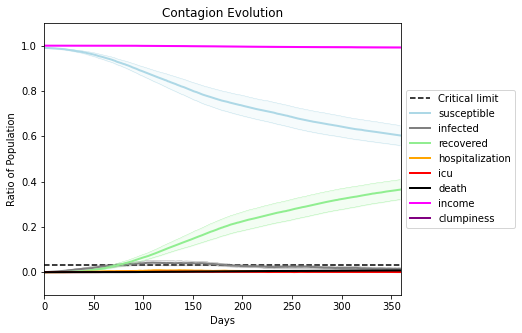

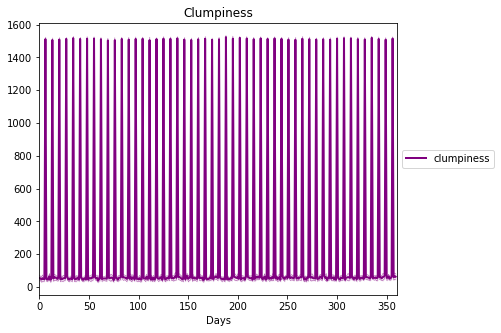

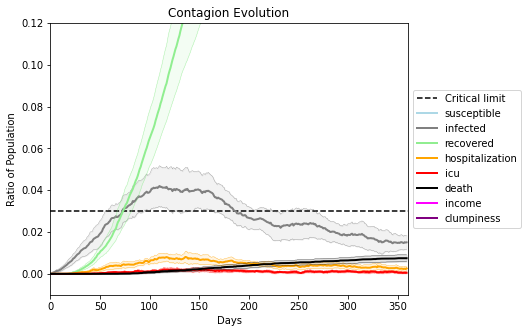

In [20]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.5
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3172, 1800, 175, 344, 3430, 8614, 4308, 7496, 6731, 910, 225, 950, 5510, 2492, 3583, 2177, 7767, 7002, 4726, 5939]
Average similarity between family members is 0.21917428692663748 at temperature -0.4
Average similarity between family and home is 0.9998542530716916 at temperature -1
Average similarity between students and their classroom is 0.1838393843688072 at temperature -0.4
Average classroom occupancy is 1.6424242424242423 and number classrooms is 165
Average similarity between workers is 0.1729016372570667 at temperature -0.4
Average office occupancy is 3.4271356783919598 and number offices is 199
Average friend similarity for adults: 0.2873211305787023 for kids: 0.2220302844751533
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homog

avg restaurant similarity 0.18610122722181405
avg restaurant similarity -0.04461577775684275
avg restaurant similarity -0.01767249136977369
avg restaurant similarity 0.13857506387038424
avg restaurant similarity 0.014407154232635902
avg restaurant similarity 0.226831415602123
avg restaurant similarity -0.019559295298609086
avg restaurant similarity 0.01942663659648411
avg restaurant similarity -0.11196791841016732
avg restaurant similarity 0.006200734992955759
avg restaurant similarity 0.1507221773322006
avg restaurant similarity 0.07848151899849751
avg restaurant similarity -0.007748708431223134
avg restaurant similarity 0.2693422130885696
avg restaurant similarity 0.23647498207319362
avg restaurant similarity -0.12078961978437446
avg restaurant similarity -0.2253743294007611
avg restaurant similarity -0.004732479947880258
avg restaurant similarity 0.17686876191727222
avg restaurant similarity 0.09784003050239687
avg restaurant similarity 0.005106413006345246
avg restaurant similarity

avg restaurant similarity 0.24066402288382271
avg restaurant similarity 0.07540816432230361
avg restaurant similarity -0.09682522029213994
avg restaurant similarity 0.423100028083756
avg restaurant similarity 0.2181855046971741
avg restaurant similarity -0.05371104521576217
avg restaurant similarity -0.02075942869392883
avg restaurant similarity 0.27443296524542665
avg restaurant similarity 0.45932093968555376
avg restaurant similarity -0.12905292205497648
avg restaurant similarity 0.10442295144207246
avg restaurant similarity -0.21757207741967408
avg restaurant similarity 0.09936454069347277
avg restaurant similarity -0.24728728176427017
avg restaurant similarity -0.05515492671668949
avg restaurant similarity 0.10426532338661143
avg restaurant similarity 0.011937227009758869
avg restaurant similarity -0.027655452779208133
avg restaurant similarity -0.17763128707188514
avg restaurant similarity 0.07893573469865374
avg restaurant similarity 0.020574912990221406
avg restaurant similarity

avg restaurant similarity 0.5330457623799721
avg restaurant similarity 0.01301931991434852
avg restaurant similarity 0.20085718342532743
avg restaurant similarity 0.16038596207475075
avg restaurant similarity -0.020861574294821453
avg restaurant similarity 0.26989924394558146
avg restaurant similarity 0.03468879039389832
avg restaurant similarity 0.1418237251613862
avg restaurant similarity -0.13582961305857538
avg restaurant similarity 0.06626085040741211
avg restaurant similarity 0.12388774821323574
avg restaurant similarity 0.18264149808346916
avg restaurant similarity 0.13873025592867605
avg restaurant similarity 0.1655561999857536
avg restaurant similarity 0.09520714150912984
avg restaurant similarity -0.07964577700066472
avg restaurant similarity -0.05935188457503521
avg restaurant similarity 0.047541301985683584
avg restaurant similarity 0.05510624971757584
avg restaurant similarity 0.16081835473476938
avg restaurant similarity 0.14038997228500166
avg restaurant similarity 0.085

avg restaurant similarity 0.11803523368003963
avg restaurant similarity 0.07749794696572886
avg restaurant similarity 0.15924265261957393
avg restaurant similarity 0.09146439407773901
avg restaurant similarity -0.05274254081383643
avg restaurant similarity 0.17543654566723602
avg restaurant similarity 0.10026374625083029
avg restaurant similarity 0.46919513227391507
avg restaurant similarity 0.18017378004049084
avg restaurant similarity 0.12431858411467514
avg restaurant similarity 0.0890215564376964
avg restaurant similarity -0.1446163486773674
avg restaurant similarity 0.14942272440982146
avg restaurant similarity 0.0844327300691746
avg restaurant similarity 0.12154151785478007
avg restaurant similarity -0.05500387568911113
avg restaurant similarity 0.09018948248859437
avg restaurant similarity 0.15743202173296225
avg restaurant similarity 0.13176849220698789
avg restaurant similarity 0.12536640105974878
avg restaurant similarity 0.12292322041097277
avg restaurant similarity 0.066774

avg restaurant similarity -0.020341150543631357
avg restaurant similarity 0.17957247225962839
avg restaurant similarity -0.2179579138660418
Average similarity between family members is 0.2156309947361384 at temperature -0.4
Average similarity between family and home is 0.9998514199685361 at temperature -1
Average similarity between students and their classroom is 0.16105614042796582 at temperature -0.4
Average classroom occupancy is 1.6243386243386244 and number classrooms is 189
Average similarity between workers is 0.1565702893086356 at temperature -0.4
Average office occupancy is 3.2797927461139897 and number offices is 193
Average friend similarity for adults: 0.28038843598333335 for kids: 0.22115644962585282
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 unit

avg restaurant similarity 0.1358828078510681
avg restaurant similarity -0.07908604241265418
avg restaurant similarity 0.16600661043601772
avg restaurant similarity 0.08753108786894323
avg restaurant similarity 0.10772881818077067
avg restaurant similarity -0.0595022307340887
avg restaurant similarity -0.06246471687698233
avg restaurant similarity 0.014659707260309
avg restaurant similarity 0.11012344424924882
avg restaurant similarity 0.02400279819978116
avg restaurant similarity 0.14167354303599974
avg restaurant similarity 0.0364624068515149
avg restaurant similarity -0.032663227893784154
avg restaurant similarity 0.08325248544066687
avg restaurant similarity 0.04457986173602434
avg restaurant similarity 0.06485956688153047
avg restaurant similarity -0.03223414428073071
avg restaurant similarity 0.06985758724090842
avg restaurant similarity 0.1748090779773513
avg restaurant similarity -0.077812716178207
avg restaurant similarity -0.1494576412210229
avg restaurant similarity 0.0031595

avg restaurant similarity 0.015490663062040888
avg restaurant similarity 0.08307235161022701
avg restaurant similarity -0.10189650873248919
avg restaurant similarity 0.01683346349540114
avg restaurant similarity -0.1528931254721871
avg restaurant similarity 0.08449417358391399
avg restaurant similarity -0.08242562896578079
avg restaurant similarity -0.21834442948619764
avg restaurant similarity 0.12801116005846935
avg restaurant similarity 0.009626585555905306
avg restaurant similarity -0.12203377269215794
avg restaurant similarity 0.07614459372752502
avg restaurant similarity -0.10609264153047646
avg restaurant similarity -0.04795369265922125
avg restaurant similarity 0.08230092717883751
avg restaurant similarity 0.07755000366994082
avg restaurant similarity 0.1149165609424626
avg restaurant similarity 0.09565056679166337
avg restaurant similarity 0.16213197649639371
avg restaurant similarity 0.04253509731989735
avg restaurant similarity 0.3531360228120331
avg restaurant similarity -0

Average similarity between family members is 0.225290311025167 at temperature -0.4
Average similarity between family and home is 0.9998545389001972 at temperature -1
Average similarity between students and their classroom is 0.15630510564622646 at temperature -0.4
Average classroom occupancy is 1.6951219512195121 and number classrooms is 164
Average similarity between workers is 0.16311488087073828 at temperature -0.4
Average office occupancy is 3.263681592039801 and number offices is 201
Average friend similarity for adults: 0.2897748899503659 for kids: 0.19696875426029423
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0)

avg restaurant similarity 0.14202692389421312
avg restaurant similarity 0.23266808764262736
avg restaurant similarity 0.03429116946818445
avg restaurant similarity 0.18996168604589003
avg restaurant similarity 0.03513209600750038
avg restaurant similarity 0.20795550047237388
avg restaurant similarity 0.0789682558278741
avg restaurant similarity 0.12630526667577327
avg restaurant similarity 0.24848974948856606
avg restaurant similarity 0.258334707724071
avg restaurant similarity 0.08434272186575903
avg restaurant similarity 0.3349611110185821
avg restaurant similarity -0.0702042545125464
avg restaurant similarity 0.05998534878517909
avg restaurant similarity 0.11510231467327178
avg restaurant similarity 0.24246089562015183
avg restaurant similarity 0.2944670899260098
avg restaurant similarity 0.14967268842952589
avg restaurant similarity 0.20413304260709833
avg restaurant similarity 0.33243627701986567
avg restaurant similarity -0.009481399380327438
avg restaurant similarity 0.197261382

avg restaurant similarity -0.023302177920930072
avg restaurant similarity 0.11222871975042886
avg restaurant similarity -0.11029610522577288
avg restaurant similarity 0.05345698718469852
avg restaurant similarity -0.11870824614269489
avg restaurant similarity 0.02512664271067156
avg restaurant similarity -0.03792576959113684
avg restaurant similarity 0.16427514959315562
avg restaurant similarity 0.2840570469214405
avg restaurant similarity 0.07748157081500154
avg restaurant similarity 0.2482553254498015
avg restaurant similarity 0.046092523103529015
avg restaurant similarity 0.21557739727192307
avg restaurant similarity 0.1531439781949056
avg restaurant similarity -0.048792512997227554
avg restaurant similarity 0.2351632774167333
avg restaurant similarity 0.17018151207282176
avg restaurant similarity 0.022750110004280483
avg restaurant similarity 0.27646265074948306
avg restaurant similarity 0.12974479783516296
avg restaurant similarity 0.09466810900641758
avg restaurant similarity 0.2

avg restaurant similarity 0.25652618720603115
avg restaurant similarity 0.01479584882081883
Average similarity between family members is 0.2149509725316223 at temperature -0.4
Average similarity between family and home is 0.9998554317861518 at temperature -1
Average similarity between students and their classroom is 0.18555940419916284 at temperature -0.4
Average classroom occupancy is 1.6111111111111112 and number classrooms is 198
Average similarity between workers is 0.14911510753185403 at temperature -0.4
Average office occupancy is 3.123762376237624 and number offices is 202
Average friend similarity for adults: 0.27529628595909367 for kids: 0.20218968068162924
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated

avg restaurant similarity 0.011994687155612386
avg restaurant similarity 0.10481298075176762
avg restaurant similarity 0.26188581395464894
avg restaurant similarity 0.0785707644453171
avg restaurant similarity 0.03728971114947927
avg restaurant similarity 0.15891233981836853
avg restaurant similarity 0.11886606417156201
avg restaurant similarity 0.14805201742950083
avg restaurant similarity 0.1375112913571543
avg restaurant similarity 0.06210094974939238
avg restaurant similarity 0.045837199066800546
avg restaurant similarity 0.16419576613387432
avg restaurant similarity 0.24122424920800992
avg restaurant similarity -0.015102501035842599
avg restaurant similarity -0.3399524456155111
avg restaurant similarity 0.0027940596080111126
avg restaurant similarity 0.14380564569175133
avg restaurant similarity 0.13077736678401736
avg restaurant similarity 0.17076930269762325
avg restaurant similarity 0.0700864643924931
avg restaurant similarity 0.05369136121926058
avg restaurant similarity 0.185

avg restaurant similarity 0.12630169036167765
avg restaurant similarity 0.21579425185420467
avg restaurant similarity 0.21550475069498318
avg restaurant similarity 0.2950614277830698
avg restaurant similarity 0.08504264487638111
avg restaurant similarity -0.03420521442075333
avg restaurant similarity 0.3646627798579014
avg restaurant similarity 0.10593790458602112
avg restaurant similarity -0.16955550710889397
avg restaurant similarity 0.15669318910743282
avg restaurant similarity 0.0554845578243894
avg restaurant similarity 0.23467193004555523
avg restaurant similarity 0.20870157054518038
avg restaurant similarity -0.007087321464563419
avg restaurant similarity 0.008977841671381104
avg restaurant similarity 0.15229368700556592
avg restaurant similarity 0.33695301886692874
avg restaurant similarity 0.10555511903227803
avg restaurant similarity -0.046687203692941326
avg restaurant similarity 0.36111251328445343
avg restaurant similarity 0.08860039636147993
avg restaurant similarity 0.00

Average similarity between family members is 0.21529434937791198 at temperature -0.4
Average similarity between family and home is 0.9998602576975835 at temperature -1
Average similarity between students and their classroom is 0.17462876584730935 at temperature -0.4
Average classroom occupancy is 1.6206896551724137 and number classrooms is 174
Average similarity between workers is 0.1482085484795867 at temperature -0.4
Average office occupancy is 3.3435897435897437 and number offices is 195
Average friend similarity for adults: 0.28144801156594923 for kids: 0.23344882488853771
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2

avg restaurant similarity 0.19198878077224024
avg restaurant similarity 0.233519860869751
avg restaurant similarity 0.08144749626222782
avg restaurant similarity 0.1306939352251965
avg restaurant similarity 0.04413186083311108
avg restaurant similarity 0.3239706052492658
avg restaurant similarity 0.14657541217193715
avg restaurant similarity 0.07708914667898797
avg restaurant similarity -0.1248417049574786
avg restaurant similarity 0.05954491916436625
avg restaurant similarity 0.1660238422342369
avg restaurant similarity 0.2879196003730871
avg restaurant similarity -0.0964070131397009
avg restaurant similarity 0.10118827955762652
avg restaurant similarity 0.02101954202969529
avg restaurant similarity 0.09465686260506653
avg restaurant similarity -0.02091677949161345
avg restaurant similarity -0.05628744201328775
avg restaurant similarity 0.031180909302079573
avg restaurant similarity 0.2873714467981245
avg restaurant similarity 0.1328912866909189
avg restaurant similarity -0.1441170112

avg restaurant similarity -0.01877357998663614
avg restaurant similarity 0.0501182408165592
avg restaurant similarity 0.07507792531803083
avg restaurant similarity 0.13935916298134374
avg restaurant similarity 0.12843442145055867
avg restaurant similarity 0.026404163470569262
avg restaurant similarity 0.1295739376893227
avg restaurant similarity 0.2447770026711582
avg restaurant similarity 0.04441197043635535
avg restaurant similarity -0.032962655167090134
avg restaurant similarity -0.05819200716563265
avg restaurant similarity 0.10694546193281931
avg restaurant similarity -0.004264475314665922
avg restaurant similarity 0.08330298525671129
avg restaurant similarity -0.05468312655110887
avg restaurant similarity -0.3267866017105365
avg restaurant similarity -0.023132775090835986
avg restaurant similarity -0.03087776035469647
avg restaurant similarity 0.013572500409137192
avg restaurant similarity 0.6947149950924889
avg restaurant similarity 0.3371044340321606
avg restaurant similarity 0

Average similarity between workers is 0.16436169232711675 at temperature -0.4
Average office occupancy is 3.3415841584158414 and number offices is 202
Average friend similarity for adults: 0.2909901310771885 for kids: 0.21439271731304682
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 

avg restaurant similarity -0.05814194976491444
avg restaurant similarity 0.15029655529591773
avg restaurant similarity 0.1260495497271175
avg restaurant similarity 0.045251482729027515
avg restaurant similarity -0.06089664441956602
avg restaurant similarity 0.03990719655072122
avg restaurant similarity -0.004105719620845961
avg restaurant similarity 0.2152836945274373
avg restaurant similarity -0.13575416170112514
avg restaurant similarity -0.03016439328033796
avg restaurant similarity 0.1189604922578914
avg restaurant similarity 0.16654673724932142
avg restaurant similarity -0.022835612835871884
avg restaurant similarity 0.12527915051562574
avg restaurant similarity 0.029017888211790226
avg restaurant similarity 0.09614563785703528
avg restaurant similarity 0.1683294104838684
avg restaurant similarity -0.039970542696359815
avg restaurant similarity -0.03269597432786157
avg restaurant similarity -0.015978120015663663
avg restaurant similarity 0.13888228381990605
avg restaurant similari

avg restaurant similarity -0.15023216352067756
avg restaurant similarity -0.010076609917801781
avg restaurant similarity -0.041881233369111426
avg restaurant similarity 0.14826847900005022
avg restaurant similarity 0.1369088252037482
avg restaurant similarity 0.20415492840276314
avg restaurant similarity -0.038095745998659454
avg restaurant similarity -0.005334089859078012
avg restaurant similarity 0.05802268055573616
avg restaurant similarity 0.23993451764887838
avg restaurant similarity 0.09966254682251446
avg restaurant similarity 0.008496082659641965
avg restaurant similarity 0.06154429194691052
avg restaurant similarity 0.058957160157546776
avg restaurant similarity 0.07658909752138689
avg restaurant similarity 0.3232883285944248
avg restaurant similarity 0.18697790117170732
avg restaurant similarity -0.19103805000863472
avg restaurant similarity 0.03607110911040773
avg restaurant similarity 0.036779647000897864
avg restaurant similarity -0.04811688510018059
avg restaurant similar

avg restaurant similarity 0.1126797328899345
avg restaurant similarity 0.2233629761918161
Average similarity between family members is 0.20784443608888825 at temperature -0.4
Average similarity between family and home is 0.9998523606516164 at temperature -1
Average similarity between students and their classroom is 0.16920479196827812 at temperature -0.4
Average classroom occupancy is 1.5517241379310345 and number classrooms is 174
Average similarity between workers is 0.15039564810286749 at temperature -0.4
Average office occupancy is 3.3137254901960786 and number offices is 204
Average friend similarity for adults: 0.28354558003602687 for kids: 0.20895924639962615
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.051219672836535564
avg restaurant similarity 0.03751432657877465
avg restaurant similarity 0.0580164460609876
avg restaurant similarity 0.016270681960543758
avg restaurant similarity 0.03809401755822233
avg restaurant similarity 0.2176341785995589
avg restaurant similarity 0.10891512143632805
avg restaurant similarity 0.037374559833403695
avg restaurant similarity 0.11997055685998272
avg restaurant similarity -0.0029130120576447665
avg restaurant similarity -0.00016522157789054803
avg restaurant similarity 0.03159708981152253
avg restaurant similarity -0.012442036176583456
avg restaurant similarity 0.1904165370570226
avg restaurant similarity 0.11867561591434893
avg restaurant similarity 0.07201836788065692
avg restaurant similarity 0.1489916195174495
avg restaurant similarity 0.16949630418831804
avg restaurant similarity 0.05458742923347613
avg restaurant similarity 0.14697814016818023
avg restaurant similarity 0.17828699016360794
avg restaurant similarity 

avg restaurant similarity 0.21294852547574
avg restaurant similarity 0.02606761374196013
avg restaurant similarity 0.0727269046416962
avg restaurant similarity 0.1063687168757332
avg restaurant similarity 0.13311117455894347
avg restaurant similarity 0.09486063378201745
avg restaurant similarity 0.26297038427915576
avg restaurant similarity 0.19714387507994235
avg restaurant similarity -0.012813533556374457
avg restaurant similarity 0.043660299096772215
avg restaurant similarity 0.2181934295155517
avg restaurant similarity 0.3212061608158671
avg restaurant similarity 0.08519135757006988
avg restaurant similarity 0.2192779750616671
avg restaurant similarity 0.09512695800039421
avg restaurant similarity 0.0662764066420526
avg restaurant similarity 0.03442391573540474
avg restaurant similarity -0.04069168483796918
avg restaurant similarity 0.20625739454063954
avg restaurant similarity 0.02263373104505889
avg restaurant similarity 0.053795754686330445
avg restaurant similarity 0.0920010325

avg restaurant similarity 0.23843411639542902
avg restaurant similarity 0.1165205696895007
avg restaurant similarity 0.23575121285704057
Average similarity between family members is 0.21666804967649567 at temperature -0.4
Average similarity between family and home is 0.9998494757945001 at temperature -1
Average similarity between students and their classroom is 0.1698743351039275 at temperature -0.4
Average classroom occupancy is 1.6327683615819208 and number classrooms is 177
Average similarity between workers is 0.13709962270973097 at temperature -0.4
Average office occupancy is 3.3451776649746194 and number offices is 197
Average friend similarity for adults: 0.2735121625327746 for kids: 0.2105907074358456
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity -0.05170343516869815
avg restaurant similarity 0.15812216584762093
avg restaurant similarity 0.07020202790562215
avg restaurant similarity 0.4739906246240413
avg restaurant similarity 0.17121917652117166
avg restaurant similarity 0.2254361104383409
avg restaurant similarity 0.136202005230018
avg restaurant similarity 0.0929969648973248
avg restaurant similarity 0.013112749285301137
avg restaurant similarity 0.6719404148146578
avg restaurant similarity 0.037212134579185555
avg restaurant similarity 0.06514304574454817
avg restaurant similarity -0.03602245129905887
avg restaurant similarity -0.23918482439619268
avg restaurant similarity 0.2622341783082342
avg restaurant similarity 0.17294939659288697
avg restaurant similarity 0.10679977826651355
avg restaurant similarity -0.4651473333983923
avg restaurant similarity 0.10048719792705516
avg restaurant similarity 0.2495580138519985
avg restaurant similarity 0.2424694019841359
avg restaurant similarity 0.1890080679

avg restaurant similarity 0.08439208756408652
avg restaurant similarity 0.15696432488877518
avg restaurant similarity -0.17224883835828303
avg restaurant similarity 0.016744349072266934
avg restaurant similarity 0.27442147476899875
avg restaurant similarity 0.2119434786409981
avg restaurant similarity 0.27757443012786437
avg restaurant similarity 0.2482251718479552
avg restaurant similarity 0.09088460119880283
avg restaurant similarity 0.21615629471934344
avg restaurant similarity 0.23252495614935959
avg restaurant similarity -0.019748681550477955
avg restaurant similarity -0.011474783152593678
avg restaurant similarity 0.2703198254576158
avg restaurant similarity 0.29317214824042936
avg restaurant similarity 0.02965919002869305
avg restaurant similarity -0.047920309086296735
avg restaurant similarity 0.0936607962497539
avg restaurant similarity -0.4651473333983923
avg restaurant similarity 0.04155649942707628
avg restaurant similarity 0.16129715440721362
avg restaurant similarity 0.10

Average friend similarity for adults: 0.27263063607572213 for kids: 0.19963119905140878
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 22 people.
Total of 22 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocat

avg restaurant similarity 0.1347127359170762
avg restaurant similarity 0.02088452539116759
avg restaurant similarity -0.07878313596466605
avg restaurant similarity -0.0024518340233687604
avg restaurant similarity 0.033685525120195
avg restaurant similarity 0.10731571907477479
avg restaurant similarity 0.3623437482647983
avg restaurant similarity 0.1559861735119293
avg restaurant similarity 0.15584588344061834
avg restaurant similarity 0.056309126898811776
avg restaurant similarity 0.16007503178364116
avg restaurant similarity 0.12254427524866061
avg restaurant similarity -0.04489027238415433
avg restaurant similarity 0.12075241694840888
avg restaurant similarity 0.18669568961526076
avg restaurant similarity 0.0986188311149199
avg restaurant similarity 0.08357068721716113
avg restaurant similarity 0.05285924241536257
avg restaurant similarity 0.05232987765128808
avg restaurant similarity 0.05050465146070551
avg restaurant similarity -0.1340658776352042
avg restaurant similarity 0.179604

avg restaurant similarity 0.07779484157868435
avg restaurant similarity 0.12186758737225067
avg restaurant similarity 0.18462262703849627
avg restaurant similarity 0.19791997443817239
avg restaurant similarity 0.029634347263148144
avg restaurant similarity 0.061115763364177476
avg restaurant similarity 0.11226149162585186
avg restaurant similarity -0.08101141320723891
avg restaurant similarity 0.06932087525046643
avg restaurant similarity 0.09239052792157845
avg restaurant similarity -0.09343448639274213
avg restaurant similarity -0.059598298343045426
avg restaurant similarity 0.09239593218940893
avg restaurant similarity 0.001194809035612347
avg restaurant similarity 0.12155663353255183
avg restaurant similarity -0.13400842431711138
avg restaurant similarity 0.0086528675706899
avg restaurant similarity 0.09123599543156273
avg restaurant similarity 0.09415860758868408
avg restaurant similarity 0.11835992378672279
avg restaurant similarity 0.21694943474077502
avg restaurant similarity 0

avg restaurant similarity 0.062243864880828795
avg restaurant similarity 0.04864965903496872
avg restaurant similarity 0.2765417580507563
avg restaurant similarity 0.046743835199248
Average similarity between family members is 0.21756032948124615 at temperature -0.4
Average similarity between family and home is 0.9998593199393718 at temperature -1
Average similarity between students and their classroom is 0.17806643539483757 at temperature -0.4
Average classroom occupancy is 1.644808743169399 and number classrooms is 183
Average similarity between workers is 0.1511586766317754 at temperature -0.4
Average office occupancy is 3.2323232323232323 and number offices is 198
Average friend similarity for adults: 0.2806668821514057 for kids: 0.21823905551233738
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity -0.08944207513020878
avg restaurant similarity 0.2324000733517484
avg restaurant similarity 0.10431765172614842
avg restaurant similarity -0.06695461828532137
avg restaurant similarity -0.02432967985334116
avg restaurant similarity 0.10815354113049773
avg restaurant similarity 0.25297337336806003
avg restaurant similarity -0.19442369270795434
avg restaurant similarity 0.011722341008462719
avg restaurant similarity 0.215378135779547
avg restaurant similarity 0.10437226797188202
avg restaurant similarity -0.046873083428595023
avg restaurant similarity -0.04572050968487279
avg restaurant similarity 0.10417677189635986
avg restaurant similarity 0.1349099813518074
avg restaurant similarity 0.2659279358225099
avg restaurant similarity 0.28126273044596023
avg restaurant similarity 0.1112852607893588
avg restaurant similarity 0.14119490138322244
avg restaurant similarity 0.03417655788906057
avg restaurant similarity 0.02069552134643574
avg restaurant similarity 0.1418

avg restaurant similarity 0.1113940646335497
avg restaurant similarity 0.09953499400125361
avg restaurant similarity 0.24287928548919588
avg restaurant similarity 0.2259449006370377
avg restaurant similarity 0.14703766895790457
avg restaurant similarity -0.016381745561635047
avg restaurant similarity 0.24921076064165734
avg restaurant similarity 0.058020687836404315
avg restaurant similarity 0.0077854199292433784
avg restaurant similarity 0.24189551871915324
avg restaurant similarity 0.0213926150577105
avg restaurant similarity 0.0586814974915582
avg restaurant similarity 0.16409149139376827
avg restaurant similarity -0.08511708603491037
avg restaurant similarity 0.005387572829993319
avg restaurant similarity 0.23889779903809433
avg restaurant similarity 0.2064157834278249
avg restaurant similarity 0.14575106689549355
avg restaurant similarity 0.24873230788810508
avg restaurant similarity 0.13688810150153227
avg restaurant similarity 0.17417843028150023
avg restaurant similarity 0.3850

Average friend similarity for adults: 0.28755448540677303 for kids: 0.21736937912638024
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 alloc

avg restaurant similarity -0.06144218689044836
avg restaurant similarity 0.13720477285516422
avg restaurant similarity 0.15060396544106536
avg restaurant similarity -0.051657001034581235
avg restaurant similarity 0.18878783832429313
avg restaurant similarity 0.09545100785354112
avg restaurant similarity -0.03184505664793765
avg restaurant similarity 0.22389938068064547
avg restaurant similarity 0.12732389684617698
avg restaurant similarity -0.02581870200831322
avg restaurant similarity 0.00792944406208671
avg restaurant similarity 0.08202869643912955
avg restaurant similarity 0.22013964385301102
avg restaurant similarity -0.05852082739553746
avg restaurant similarity 0.09526563854572005
avg restaurant similarity -0.08549943329943388
avg restaurant similarity 0.11550061830517713
avg restaurant similarity 0.0927565112495597
avg restaurant similarity -0.11427675046088298
avg restaurant similarity 0.0018196690948830904
avg restaurant similarity 0.3179922052949599
avg restaurant similarity 

avg restaurant similarity 0.18230564940328592
avg restaurant similarity 0.046104311111437424
avg restaurant similarity -0.01871594451735354
avg restaurant similarity 0.19864701744512
avg restaurant similarity 0.18799339486493016
avg restaurant similarity 0.0752381133157077
avg restaurant similarity -0.22989697252884478
avg restaurant similarity 0.01528329458745993
avg restaurant similarity 0.014446947180957301
avg restaurant similarity -0.043843033457026725
avg restaurant similarity -0.12363186237072567
avg restaurant similarity 0.18202966084243377
avg restaurant similarity -0.08319570985509865
avg restaurant similarity 0.06456360726234014
avg restaurant similarity 0.13368228832232668
avg restaurant similarity 0.1195791102112473
avg restaurant similarity 0.040546261185842085
avg restaurant similarity -0.2094012161578231
avg restaurant similarity 0.037662973988958834
avg restaurant similarity 0.22607145599490938
avg restaurant similarity 0.21482976638086634
avg restaurant similarity 0.0

avg restaurant similarity 0.27695837782995336
avg restaurant similarity 0.24647496341238545
Average similarity between family members is 0.23149955521083201 at temperature -0.4
Average similarity between family and home is 0.9998519926833715 at temperature -1
Average similarity between students and their classroom is 0.18117940173791885 at temperature -0.4
Average classroom occupancy is 1.5706521739130435 and number classrooms is 184
Average similarity between workers is 0.1540126850997932 at temperature -0.4
Average office occupancy is 3.2139303482587063 and number offices is 201
Average friend similarity for adults: 0.27839010356559807 for kids: 0.21320071720576916
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocate

avg restaurant similarity 0.1968693254921334
avg restaurant similarity 0.6006755995349127
avg restaurant similarity 0.06783859133403171
avg restaurant similarity -0.0021378104806000133
avg restaurant similarity 0.22096886757114384
avg restaurant similarity -0.02460242694650932
avg restaurant similarity 0.188671986483269
avg restaurant similarity 0.2897284362338771
avg restaurant similarity 0.14864829906429447
avg restaurant similarity 0.18486205651577184
avg restaurant similarity 0.12830083889384744
avg restaurant similarity 0.24537233715611725
avg restaurant similarity -0.02111658293769357
avg restaurant similarity 0.16827421155250408
avg restaurant similarity 0.17566421392675702
avg restaurant similarity 0.10162502276670457
avg restaurant similarity 0.14851657224967013
avg restaurant similarity 0.3456992855215017
avg restaurant similarity -0.016086481324566883
avg restaurant similarity 0.2729848925554724
avg restaurant similarity 0.24994331391401212
avg restaurant similarity 0.186508

avg restaurant similarity 0.3968712364940382
avg restaurant similarity 0.019235960290759795
avg restaurant similarity 0.3124230623783764
avg restaurant similarity 0.031396329789646314
avg restaurant similarity 0.1618029062594549
avg restaurant similarity 0.13719339601093866
avg restaurant similarity 0.2609844526357808
avg restaurant similarity -0.01582522067372517
avg restaurant similarity -0.10618723259614138
avg restaurant similarity 0.24821052523036888
avg restaurant similarity -0.2141271175799446
avg restaurant similarity 0.1558321906306777
avg restaurant similarity 0.15933455565523053
avg restaurant similarity 0.1359068577244811
avg restaurant similarity 0.09182867659141762
avg restaurant similarity 0.11324809153178535
avg restaurant similarity 0.03911336297777827
avg restaurant similarity 0.029294365561325655
avg restaurant similarity 0.11142805481457929
avg restaurant similarity 0.045725895196453925
avg restaurant similarity 0.043216883130332555
avg restaurant similarity 0.17754

Average similarity between workers is 0.15285958638628447 at temperature -0.4
Average office occupancy is 3.200980392156863 and number offices is 204
Average friend similarity for adults: 0.27962998403329187 for kids: 0.2109166099387634
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.18553755516608322
avg restaurant similarity 0.03768569537525966
avg restaurant similarity -0.03262695197671487
avg restaurant similarity -0.013957324101913218
avg restaurant similarity 0.020511444020337482
avg restaurant similarity 0.21768694976610622
avg restaurant similarity -0.011702532707692523
avg restaurant similarity 0.05108528187533884
avg restaurant similarity 0.1784060126407355
avg restaurant similarity -0.1433736010357737
avg restaurant similarity 0.187977872651065
avg restaurant similarity 0.2815598173393043
avg restaurant similarity -0.07076608974800161
avg restaurant similarity 0.19100676889235446
avg restaurant similarity 0.010380921297589218
avg restaurant similarity -0.13616240697786325
avg restaurant similarity 0.040805945285194496
avg restaurant similarity 0.0010929652435472577
avg restaurant similarity -0.1639582754433757
avg restaurant similarity 0.1483669624512241
avg restaurant similarity 0.043330455596670724
avg restaurant similarity 

avg restaurant similarity 0.17086860065567416
avg restaurant similarity -0.028185979118096442
avg restaurant similarity -0.09096618096342768
avg restaurant similarity 0.08237340896399668
avg restaurant similarity -0.05086401812273757
avg restaurant similarity 0.12778519866810073
avg restaurant similarity 0.10414428113595703
avg restaurant similarity 0.24262968602977758
avg restaurant similarity 0.0367061113549268
avg restaurant similarity 0.07283111871497479
avg restaurant similarity 0.238365840173347
avg restaurant similarity 0.11461074335758921
avg restaurant similarity 0.18093775039317328
avg restaurant similarity 0.12148284965517345
avg restaurant similarity 0.025611799225237344
avg restaurant similarity 0.18564584517823535
avg restaurant similarity 0.14087633672595268
avg restaurant similarity 0.10025779124517141
avg restaurant similarity -0.11901170234070606
avg restaurant similarity 0.3045834636112271
avg restaurant similarity 0.12109781435014921
avg restaurant similarity 0.3211

Average similarity between family and home is 0.9998582964519307 at temperature -1
Average similarity between students and their classroom is 0.14255013347709142 at temperature -0.4
Average classroom occupancy is 1.6395348837209303 and number classrooms is 172
Average similarity between workers is 0.12968177244493378 at temperature -0.4
Average office occupancy is 3.3181818181818183 and number offices is 198
Average friend similarity for adults: 0.27217022670699 for kids: 0.20748759324668214
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5

avg restaurant similarity 0.05711219150659082
avg restaurant similarity 0.1266347609154392
avg restaurant similarity -0.00934757464262657
avg restaurant similarity 0.12427357178353533
avg restaurant similarity -0.08306071333855647
avg restaurant similarity -0.0885103441695554
avg restaurant similarity 0.00550447319501413
avg restaurant similarity 0.06540030944872285
avg restaurant similarity 0.18282606729820497
avg restaurant similarity 0.022746341171008527
avg restaurant similarity 0.16631836055729063
avg restaurant similarity 0.05343833299078531
avg restaurant similarity 0.151444243330743
avg restaurant similarity 0.04430669813002961
avg restaurant similarity -0.1668860836628376
avg restaurant similarity 0.18138130920268367
avg restaurant similarity 0.3229634212594203
avg restaurant similarity -0.037369782927766354
avg restaurant similarity 0.41150996877330603
avg restaurant similarity 0.19624845055248133
avg restaurant similarity 0.21145095489669455
avg restaurant similarity -0.0391

avg restaurant similarity 0.3132963555801369
avg restaurant similarity 0.07727681535108642
avg restaurant similarity 0.012069019816556267
avg restaurant similarity 0.0858714144352494
avg restaurant similarity -0.008187691748875592
avg restaurant similarity 0.10827105996542127
avg restaurant similarity 0.32499423388809157
avg restaurant similarity -0.08687366659227232
avg restaurant similarity 0.16479947994976707
avg restaurant similarity 0.05633970750664707
avg restaurant similarity -0.016127344620792492
avg restaurant similarity 0.20599940316985635
avg restaurant similarity 0.21056548841248496
avg restaurant similarity -0.03056701469288235
avg restaurant similarity 0.08067797234311753
avg restaurant similarity -0.24697550553897687
avg restaurant similarity -0.06643088540264905
avg restaurant similarity 0.020895303542758314
avg restaurant similarity -0.19721902528104907
avg restaurant similarity -0.10618033836862346
avg restaurant similarity 0.06624329103082716
avg restaurant similarit

avg restaurant similarity 0.05601047993063371
avg restaurant similarity 0.03328265145361848
avg restaurant similarity 0.09378573500552473
avg restaurant similarity 0.14392815170595766
avg restaurant similarity 0.3873404873344196
Average similarity between family members is 0.2051728009749851 at temperature -0.4
Average similarity between family and home is 0.9998605261122062 at temperature -1
Average similarity between students and their classroom is 0.1621043264853978 at temperature -0.4
Average classroom occupancy is 1.5852272727272727 and number classrooms is 176
Average similarity between workers is 0.14353584668565322 at temperature -0.4
Average office occupancy is 3.269607843137255 and number offices is 204
Average friend similarity for adults: 0.28289340480315806 for kids: 0.2208557059212582
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocat

avg restaurant similarity 0.21574214305831918
avg restaurant similarity 0.0668293358818733
avg restaurant similarity 0.10629867546367278
avg restaurant similarity 0.11705377960925278
avg restaurant similarity 0.14240560425544432
avg restaurant similarity 0.02306007673387652
avg restaurant similarity 0.04878260149315383
avg restaurant similarity 0.0713218966679927
avg restaurant similarity 0.04216623972678951
avg restaurant similarity 0.293600304771185
avg restaurant similarity -0.0750707391114957
avg restaurant similarity 0.2721556903204522
avg restaurant similarity 0.19558213935706695
avg restaurant similarity 0.2218859337403117
avg restaurant similarity 0.14531263681915166
avg restaurant similarity 0.14261167540922257
avg restaurant similarity 0.0767331199590932
avg restaurant similarity 0.08887607658592063
avg restaurant similarity 0.004785337414275121
avg restaurant similarity 0.11832191937723414
avg restaurant similarity 0.1902745074155943
avg restaurant similarity 0.1392466068535

avg restaurant similarity 0.1042036213773975
avg restaurant similarity 0.08272956567641924
avg restaurant similarity 0.05572461462620228
avg restaurant similarity 0.11304026775948177
avg restaurant similarity 0.10351852683936305
avg restaurant similarity 0.21547698672522847
avg restaurant similarity 0.013571626139584816
avg restaurant similarity 0.25405400035690406
avg restaurant similarity 0.18913593708774243
avg restaurant similarity 0.14665303601009727
avg restaurant similarity 0.11969090876861739
avg restaurant similarity 0.48078847619332005
avg restaurant similarity 0.1413640745682098
avg restaurant similarity -0.08356106600522566
avg restaurant similarity 0.15988705677917392
avg restaurant similarity 0.05502475448789706
avg restaurant similarity 0.08236451846882466
avg restaurant similarity 0.19038014527713787
avg restaurant similarity 0.19521822963266963
avg restaurant similarity 0.12408897878818065
avg restaurant similarity 0.15187546301049218
avg restaurant similarity 0.092809

avg restaurant similarity 0.13139576923779545
avg restaurant similarity 0.13794072303621474
Average similarity between family members is 0.2269049115399265 at temperature -0.4
Average similarity between family and home is 0.9998536934412365 at temperature -1
Average similarity between students and their classroom is 0.19013015797182342 at temperature -0.4
Average classroom occupancy is 1.5675675675675675 and number classrooms is 185
Average similarity between workers is 0.12180835677794276 at temperature -0.4
Average office occupancy is 3.3045685279187818 and number offices is 197
Average friend similarity for adults: 0.2776839551425317 for kids: 0.21168795201057883
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated

avg restaurant similarity -0.10863822458092924
avg restaurant similarity 0.15345639447638876
avg restaurant similarity 0.11077556622059148
avg restaurant similarity 0.38983355310464485
avg restaurant similarity -0.12877169035369507
avg restaurant similarity 0.0555929150498406
avg restaurant similarity -0.20502058082484348
avg restaurant similarity 0.12876193101017053
avg restaurant similarity 0.16142217062297348
avg restaurant similarity 0.01375469291395615
avg restaurant similarity 0.04664461550052745
avg restaurant similarity 0.0936848009609127
avg restaurant similarity -0.07385346927242639
avg restaurant similarity -0.4077869924359051
avg restaurant similarity -0.022513220753114634
avg restaurant similarity 0.07039505278313092
avg restaurant similarity -0.1278267213860855
avg restaurant similarity -0.0704292497291585
avg restaurant similarity -0.01777508868279874
avg restaurant similarity 0.3618554556840464
avg restaurant similarity -0.008179402337075498
avg restaurant similarity 0.

avg restaurant similarity -0.15138999646090706
avg restaurant similarity -0.014285961092539462
avg restaurant similarity 0.4707248016886067
avg restaurant similarity 0.4156460599429727
avg restaurant similarity 0.44682301953920356
avg restaurant similarity 0.22721352596006275
avg restaurant similarity 0.0839384592961186
avg restaurant similarity 0.08348774284454426
avg restaurant similarity -0.14303733262943188
avg restaurant similarity -0.0420174895782345
avg restaurant similarity 0.18318597463256667
avg restaurant similarity -0.037337861305618475
avg restaurant similarity -0.00011100097067789123
avg restaurant similarity -0.041050741811947004
avg restaurant similarity 0.08811346750150957
avg restaurant similarity 0.10342820562251226
avg restaurant similarity -0.03091310060786621
avg restaurant similarity -0.004134995792137719
avg restaurant similarity -0.459395426173443
avg restaurant similarity 0.10606360592836443
avg restaurant similarity 0.11408885002593634
avg restaurant similari

avg restaurant similarity 0.2516016364801358
avg restaurant similarity 0.38760160493659307
avg restaurant similarity 0.2081725317439669
avg restaurant similarity -0.019931875053964283
avg restaurant similarity 0.008515211035250748
avg restaurant similarity 0.19908863073962588
avg restaurant similarity 0.16478864813108157
avg restaurant similarity 0.15786739883266832
avg restaurant similarity -0.010742562395350373
avg restaurant similarity -0.21131301206458022
avg restaurant similarity 0.24161080372480723
avg restaurant similarity 0.14517121172982797
avg restaurant similarity 0.3462731441742355
avg restaurant similarity 0.13958855086886662
avg restaurant similarity 0.19917558800059537
avg restaurant similarity 0.03009677768503922
avg restaurant similarity 0.15206446496096243
avg restaurant similarity 0.12195548554597722
avg restaurant similarity 0.15734470937980025
avg restaurant similarity -0.04538073885743341
avg restaurant similarity 0.08410489968856714
avg restaurant similarity 0.05

avg restaurant similarity -0.04250518583902317
avg restaurant similarity 0.047065010380645936
avg restaurant similarity 0.09957904533011734
avg restaurant similarity 0.06791936689426334
avg restaurant similarity 0.09623950222157139
avg restaurant similarity 0.3043796598644741
avg restaurant similarity 0.09122426521059142
avg restaurant similarity 0.0216724946059185
avg restaurant similarity 0.008466403458842947
avg restaurant similarity 0.0005854449409476547
avg restaurant similarity -0.14957732475014085
avg restaurant similarity 0.11582431795553472
avg restaurant similarity 0.3087028877839807
avg restaurant similarity 0.09800639679267266
avg restaurant similarity 0.18708469138925116
avg restaurant similarity -0.23106580262295937
avg restaurant similarity 0.09472855872928929
avg restaurant similarity 0.2081023219526156
avg restaurant similarity 0.1491886844992475
avg restaurant similarity 0.009177417315345675
avg restaurant similarity 0.21036731555278523
avg restaurant similarity 0.056

avg restaurant similarity 0.02729528023821043
avg restaurant similarity -0.05845228868446806
Average similarity between family members is 0.21980870806433922 at temperature -0.4
Average similarity between family and home is 0.9998458122761508 at temperature -1
Average similarity between students and their classroom is 0.13886428209270843 at temperature -0.4
Average classroom occupancy is 1.5856353591160222 and number classrooms is 181
Average similarity between workers is 0.14027308306571343 at temperature -0.4
Average office occupancy is 3.2587064676616917 and number offices is 201
Average friend similarity for adults: 0.27836531551997257 for kids: 0.21664833950279258
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allo

avg restaurant similarity -0.053306007329682305
avg restaurant similarity 0.22044740078196418
avg restaurant similarity 0.11007755050952837
avg restaurant similarity 0.09891590308653803
avg restaurant similarity 0.010144957963441384
avg restaurant similarity -0.06938738195738033
avg restaurant similarity 0.0901987648991343
avg restaurant similarity 0.05642117194899965
avg restaurant similarity 0.06430012762650836
avg restaurant similarity 0.1892706501600275
avg restaurant similarity 0.25228346743732283
avg restaurant similarity 0.08912428537757981
avg restaurant similarity -0.09158061339574475
avg restaurant similarity 0.09787959648129585
avg restaurant similarity 0.13367072203215877
avg restaurant similarity -0.04136392776481876
avg restaurant similarity 0.0752229419226189
avg restaurant similarity 0.1800292789802973
avg restaurant similarity -0.17371138326351251
avg restaurant similarity -0.0788355056230609
avg restaurant similarity 0.09495782316361578
avg restaurant similarity -0.03

avg restaurant similarity 0.19030989323776684
avg restaurant similarity 0.44926230070151674
avg restaurant similarity 0.17637796097511818
avg restaurant similarity 0.02774994140388949
avg restaurant similarity 0.03141174171818635
avg restaurant similarity 0.07847235278276916
avg restaurant similarity 0.12185491873788079
avg restaurant similarity 0.06910789168332258
avg restaurant similarity 0.11227038818765118
avg restaurant similarity 0.15124639771972387
avg restaurant similarity 0.0137779279833157
avg restaurant similarity -0.10959034210029962
avg restaurant similarity -0.008704453227701619
avg restaurant similarity 0.13258658272290194
avg restaurant similarity 0.13700393468806463
avg restaurant similarity 0.027264376464186932
avg restaurant similarity -0.02600066791293691
avg restaurant similarity -0.012728393121079758
avg restaurant similarity 0.1958051895427757
avg restaurant similarity 0.23396980099832254
avg restaurant similarity -0.07125385046598401
avg restaurant similarity 0.

avg restaurant similarity 0.20869814528911243
avg restaurant similarity 0.08611369105308164
avg restaurant similarity 0.17144337397168288
Average similarity between family members is 0.23435486588863624 at temperature -0.4
Average similarity between family and home is 0.999860300302689 at temperature -1
Average similarity between students and their classroom is 0.17976813131561895 at temperature -0.4
Average classroom occupancy is 1.5635359116022098 and number classrooms is 181
Average similarity between workers is 0.15726772982436343 at temperature -0.4
Average office occupancy is 3.3383838383838382 and number offices is 198
Average friend similarity for adults: 0.28432528943787655 for kids: 0.2251756251902084
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.1693553107605476
avg restaurant similarity 0.06869541786070739
avg restaurant similarity 0.28181895479767294
avg restaurant similarity 0.15841119897269942
avg restaurant similarity -0.037796254931504875
avg restaurant similarity 0.12086074277813331
avg restaurant similarity -0.07622200257815862
avg restaurant similarity 0.15200731284820104
avg restaurant similarity 0.10543502978554384
avg restaurant similarity 0.23893955584401994
avg restaurant similarity 0.15782248334087143
avg restaurant similarity 0.16216467395193884
avg restaurant similarity 0.0712498553168189
avg restaurant similarity 0.2690003397844892
avg restaurant similarity 0.05434502617849596
avg restaurant similarity 0.1433073181517574
avg restaurant similarity 0.2190473944753532
avg restaurant similarity 0.10971266898359723
avg restaurant similarity 0.29190571011133715
avg restaurant similarity 0.3693210877125548
avg restaurant similarity 0.14353968591585453
avg restaurant similarity 0.256894742

avg restaurant similarity 0.12479431362638896
avg restaurant similarity 0.13900503688755722
avg restaurant similarity 0.13129238256052794
avg restaurant similarity 0.02202866632448676
avg restaurant similarity -0.07494349264838235
avg restaurant similarity 0.24721404934482386
avg restaurant similarity 0.22496469654855064
avg restaurant similarity 0.36630593100025316
avg restaurant similarity 0.19725892763184413
avg restaurant similarity 0.44072193559437817
avg restaurant similarity 0.4747332311000957
avg restaurant similarity 0.1262903036559196
avg restaurant similarity 0.3994986059339515
avg restaurant similarity 0.26313006035196523
avg restaurant similarity 0.05538262962782056
avg restaurant similarity 0.23971718894671618
avg restaurant similarity 0.12497390410637066
avg restaurant similarity 0.5503929990629193
avg restaurant similarity 0.0009542684538003665
avg restaurant similarity 0.0907565782964171
avg restaurant similarity 0.24082955420514915
avg restaurant similarity 0.05803933

(<function dict.items>, <function dict.items>, <function dict.items>)

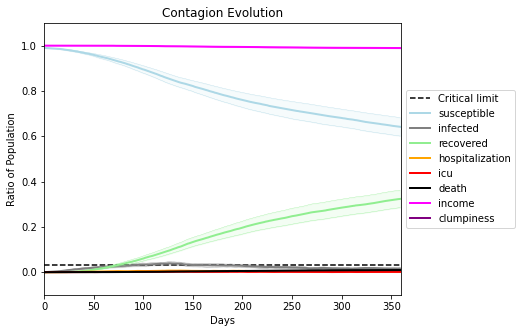

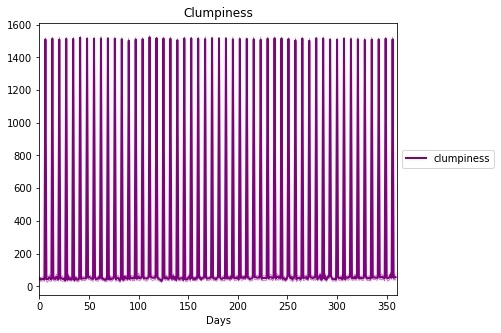

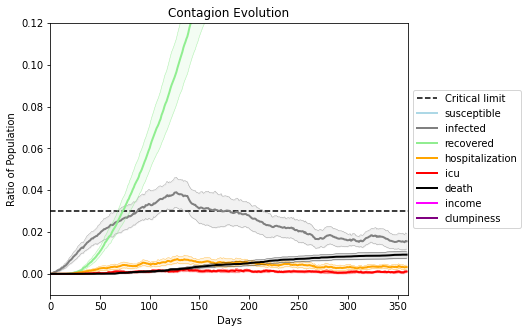

In [21]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.4
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7680, 4450, 3593, 6032, 3415, 7155, 7171, 3650, 5158, 6331, 4768, 8088, 6914, 1999, 9565, 147, 2638, 7025, 4567, 2522]
Average similarity between family members is 0.1865610888402738 at temperature -0.3
Average similarity between family and home is 0.9998585294868292 at temperature -1
Average similarity between students and their classroom is 0.15527645409507104 at temperature -0.3
Average classroom occupancy is 1.546448087431694 and number classrooms is 183
Average similarity between workers is 0.1638132738008951 at temperature -0.3
Average office occupancy is 3.3118811881188117 and number offices is 202
Average friend similarity for adults: 0.24879347728005338 for kids: 0.22457784386633653
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.11804613935540059
avg restaurant similarity 0.12584423211907697
avg restaurant similarity 0.2033162226583294
avg restaurant similarity -0.0253055323005963
avg restaurant similarity 0.26727935470017505
avg restaurant similarity 0.018606861639219263
avg restaurant similarity -0.02469284048809824
avg restaurant similarity 0.09447495211654285
avg restaurant similarity 0.013742772847615266
avg restaurant similarity 0.3058155078526514
avg restaurant similarity 0.15505378424572858
avg restaurant similarity 0.10300248932533608
avg restaurant similarity 0.0222860105905798
avg restaurant similarity 0.2874769983865856
avg restaurant similarity 0.07455316833521602
avg restaurant similarity 0.005543839835404757
avg restaurant similarity 0.21967380219175056
avg restaurant similarity 0.4759663171159447
avg restaurant similarity 0.08293158102856459
avg restaurant similarity 0.2685139984159922
avg restaurant similarity 0.07656723677797056
avg restaurant similarity 0.20855223

avg restaurant similarity 0.12442993811855461
avg restaurant similarity 0.0126780826362939
avg restaurant similarity -0.06524192377731307
avg restaurant similarity -1.7865772069970466e-06
avg restaurant similarity 0.6149193172341635
avg restaurant similarity 0.24311779901215075
avg restaurant similarity 0.09690354036487177
avg restaurant similarity 0.34342044583501613
avg restaurant similarity 0.16698080678862964
avg restaurant similarity 0.01433620203724218
avg restaurant similarity 0.20084359269623783
avg restaurant similarity 0.03815150587952569
avg restaurant similarity 0.1693824389639234
avg restaurant similarity 0.08941092304639071
avg restaurant similarity 0.0238033802349948
avg restaurant similarity 0.05665288841614554
avg restaurant similarity 0.06532841238259185
avg restaurant similarity 0.11202532839840694
avg restaurant similarity 0.0980967291862767
avg restaurant similarity 0.1874572222908244
avg restaurant similarity 0.19789769108649402
avg restaurant similarity 0.2519655

avg restaurant similarity 0.11000028380646684
avg restaurant similarity 0.0037354947413355695
avg restaurant similarity 0.05709317308008297
avg restaurant similarity 0.0642200647531571
avg restaurant similarity -0.05888004033176403
avg restaurant similarity 0.12723381539626544
avg restaurant similarity 0.03894430836917804
avg restaurant similarity 0.09987569510361234
avg restaurant similarity 0.18818322779142993
avg restaurant similarity 0.12035298121828415
avg restaurant similarity 0.1864099308357856
avg restaurant similarity 0.1029696942600598
avg restaurant similarity 0.1876658221224119
avg restaurant similarity 0.2028509283968287
avg restaurant similarity 0.23307195933488578
avg restaurant similarity 0.025422863591955842
avg restaurant similarity 0.11913461664473235
avg restaurant similarity -0.03484969053541564
avg restaurant similarity 0.1427566363600311
avg restaurant similarity 0.08978917170185022
avg restaurant similarity 0.1803516691670178
avg restaurant similarity 0.06529383

avg restaurant similarity 0.03778655430712257
avg restaurant similarity 0.20594593629562954
avg restaurant similarity 0.22673544658499256
avg restaurant similarity 0.1970456427390988
avg restaurant similarity 0.007736274743095839
avg restaurant similarity -0.01068009801498928
avg restaurant similarity -0.028382462131346122
avg restaurant similarity 0.09981856472967555
avg restaurant similarity -0.016471771554506947
avg restaurant similarity -0.007426021045883955
avg restaurant similarity -0.04433288221572436
avg restaurant similarity 0.09701551730662004
avg restaurant similarity -0.03088916129885315
avg restaurant similarity -0.03979108058652369
avg restaurant similarity 0.014762294366874052
avg restaurant similarity 0.2250107669669743
avg restaurant similarity 0.19810261019981262
avg restaurant similarity 0.05600009992684744
avg restaurant similarity -0.024460761609599282
avg restaurant similarity 0.25496309683996116
avg restaurant similarity 0.044069942251955214
avg restaurant simila

Average similarity between family members is 0.20956352816382193 at temperature -0.3
Average similarity between family and home is 0.9998461432917725 at temperature -1
Average similarity between students and their classroom is 0.16504758846891057 at temperature -0.3
Average classroom occupancy is 1.5699481865284974 and number classrooms is 193
Average similarity between workers is 0.16175485199711434 at temperature -0.3
Average office occupancy is 3.3010204081632653 and number offices is 196
Average friend similarity for adults: 0.23660271224715948 for kids: 0.22108787171354188
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home

avg restaurant similarity 0.010427283446673586
avg restaurant similarity 0.11853938363856328
avg restaurant similarity 0.05051446994402603
avg restaurant similarity 0.07565702712274062
avg restaurant similarity 0.11493400611760397
avg restaurant similarity 0.08767429117769296
avg restaurant similarity 0.12533693754557357
avg restaurant similarity 0.36952607002113935
avg restaurant similarity 0.014776603125113296
avg restaurant similarity 0.008867690061013298
avg restaurant similarity 0.07129306081049695
avg restaurant similarity 0.11588896363065881
avg restaurant similarity 0.2014029433077807
avg restaurant similarity -0.012160762275509593
avg restaurant similarity 0.23651111140589773
avg restaurant similarity 0.17119624859903923
avg restaurant similarity 0.03576704176102517
avg restaurant similarity 0.08136282512491372
avg restaurant similarity 0.20788705022901116
avg restaurant similarity 0.07214480128670947
avg restaurant similarity 0.10859536424672983
avg restaurant similarity 0.06

avg restaurant similarity 0.1976465400174967
avg restaurant similarity 0.1861049640486052
avg restaurant similarity 0.12002763521534308
avg restaurant similarity -0.05901378289482532
avg restaurant similarity 0.17045249722045644
avg restaurant similarity 0.076339697516479
avg restaurant similarity 0.027957066484384452
avg restaurant similarity 0.19562680835081253
avg restaurant similarity 0.15587209417096837
avg restaurant similarity 0.1509497136757297
avg restaurant similarity -0.03463741679214382
avg restaurant similarity 0.25654423231021356
avg restaurant similarity 0.2376775134864132
avg restaurant similarity 0.06614259443417093
avg restaurant similarity 0.16029173897116206
avg restaurant similarity 0.10389901831874257
avg restaurant similarity 0.18934074933538295
avg restaurant similarity 0.14327382606411143
avg restaurant similarity 0.300905508699711
avg restaurant similarity 0.10971078270547578
avg restaurant similarity 0.11981398908200178
avg restaurant similarity 0.03303356615

avg restaurant similarity 0.2274005329371112
Average similarity between family members is 0.2125116719493771 at temperature -0.3
Average similarity between family and home is 0.9998597448169837 at temperature -1
Average similarity between students and their classroom is 0.17770981903083063 at temperature -0.3
Average classroom occupancy is 1.6458333333333333 and number classrooms is 192
Average similarity between workers is 0.17688162075121555 at temperature -0.3
Average office occupancy is 3.12 and number offices is 200
Average friend similarity for adults: 0.23848909230446777 for kids: 0.21971630604900672
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people alloc

avg restaurant similarity 0.08116020194026036
avg restaurant similarity 0.17170964193406418
avg restaurant similarity 0.10192421714985848
avg restaurant similarity 0.11528344265911111
avg restaurant similarity 0.18087544494147995
avg restaurant similarity 0.25274776183573194
avg restaurant similarity 0.20211161559000945
avg restaurant similarity 0.1926695944528948
avg restaurant similarity 0.16122102559497514
avg restaurant similarity 0.15281692947290942
avg restaurant similarity 0.20157766564935625
avg restaurant similarity 0.1572722431072374
avg restaurant similarity -0.02776909829603365
avg restaurant similarity 0.17276688605921636
avg restaurant similarity 0.11276051142403615
avg restaurant similarity 0.1658113102674988
avg restaurant similarity 0.14764979988674362
avg restaurant similarity 0.15643675492956793
avg restaurant similarity 0.2774136151030476
avg restaurant similarity 0.06342244885538056
avg restaurant similarity 0.141870529851175
avg restaurant similarity 0.18366190089

avg restaurant similarity 0.17169022202625758
avg restaurant similarity 0.061633362650064416
avg restaurant similarity 0.16890817095968574
avg restaurant similarity 0.1611039765356706
avg restaurant similarity 0.20144360657773597
avg restaurant similarity 0.3063429768265639
avg restaurant similarity 0.3239036587996577
avg restaurant similarity 0.16317080147987328
avg restaurant similarity 0.30572459846573247
avg restaurant similarity 0.15486374006218526
avg restaurant similarity -0.059198743011958696
avg restaurant similarity 0.19889853713341638
avg restaurant similarity 0.20307197666331592
avg restaurant similarity 0.21950788858827042
avg restaurant similarity 0.15327802107027388
avg restaurant similarity 0.1296649015583706
avg restaurant similarity 0.10921685076774736
avg restaurant similarity 0.12605904798146222
avg restaurant similarity 0.06732588502325686
avg restaurant similarity 0.07222555011812795
avg restaurant similarity 0.10349220758491263
avg restaurant similarity 0.1121035

avg restaurant similarity 0.14894348027196444
avg restaurant similarity 0.15080273218469037
Average similarity between family members is 0.1954255059521941 at temperature -0.3
Average similarity between family and home is 0.9998509734835896 at temperature -1
Average similarity between students and their classroom is 0.1493759089286792 at temperature -0.3
Average classroom occupancy is 1.5280898876404494 and number classrooms is 178
Average similarity between workers is 0.17736292901390519 at temperature -0.3
Average office occupancy is 3.3399014778325125 and number offices is 203
Average friend similarity for adults: 0.24333808584809263 for kids: 0.20966555637439796
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.17634589156731506
avg restaurant similarity -0.02407849580164237
avg restaurant similarity 0.07327966759053142
avg restaurant similarity 0.13504867865825695
avg restaurant similarity 0.07886603882905811
avg restaurant similarity 0.14453756818641816
avg restaurant similarity 0.05525868389317542
avg restaurant similarity 0.12253362394628252
avg restaurant similarity 0.044295574639908054
avg restaurant similarity 0.050195026513719515
avg restaurant similarity 0.16564757646575784
avg restaurant similarity 0.12048251328996788
avg restaurant similarity -0.018758755687845127
avg restaurant similarity 0.01045341677650811
avg restaurant similarity 0.2518384397153655
avg restaurant similarity 0.0926264680176724
avg restaurant similarity 0.17344884129163313
avg restaurant similarity 0.06473203183242346
avg restaurant similarity 0.04028115981102068
avg restaurant similarity 0.26388204051815056
avg restaurant similarity -0.015396826262233033
avg restaurant similarity 0.2

avg restaurant similarity -0.06523437988457984
avg restaurant similarity -0.020662534022202708
avg restaurant similarity -0.10954095250939212
avg restaurant similarity -0.00841448898475084
avg restaurant similarity -0.015288583307246296
avg restaurant similarity 0.25833664157077846
avg restaurant similarity 0.11954100058589391
avg restaurant similarity 0.025107311608048483
avg restaurant similarity 0.05398373059304908
avg restaurant similarity -0.06339123848070358
avg restaurant similarity -0.04564487590075627
avg restaurant similarity 0.18457794607363198
avg restaurant similarity 0.011786966807794355
avg restaurant similarity 0.07528182337499628
avg restaurant similarity 0.19416648586457536
avg restaurant similarity 0.2790858415242211
avg restaurant similarity 0.09392122850594942
avg restaurant similarity 0.1774152866272677
avg restaurant similarity 0.2403054987480297
avg restaurant similarity -0.02784637442336046
avg restaurant similarity 0.10800285185883499
avg restaurant similarity

avg restaurant similarity 0.08098160290304854
Average similarity between family members is 0.20405775853456087 at temperature -0.3
Average similarity between family and home is 0.9998516341611898 at temperature -1
Average similarity between students and their classroom is 0.15953498458540807 at temperature -0.3
Average classroom occupancy is 1.6174863387978142 and number classrooms is 183
Average similarity between workers is 0.1420889624604422 at temperature -0.3
Average office occupancy is 3.1633663366336635 and number offices is 202
Average friend similarity for adults: 0.24000759312395398 for kids: 0.21284001357338836
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.04689778511713234
avg restaurant similarity 0.40321248318389197
avg restaurant similarity 0.15646774429101093
avg restaurant similarity 0.08193848845357803
avg restaurant similarity -0.14784475983298007
avg restaurant similarity 0.009769842631543254
avg restaurant similarity 0.0604696038764187
avg restaurant similarity 0.2087375689763193
avg restaurant similarity 0.1104818775893554
avg restaurant similarity 0.045968126983669234
avg restaurant similarity 0.044896452947678155
avg restaurant similarity 0.46986769202186934
avg restaurant similarity 0.11144824053740773
avg restaurant similarity 0.19885455103702665
avg restaurant similarity 0.047890661925750776
avg restaurant similarity 0.007236056212654377
avg restaurant similarity 0.16703978756360366
avg restaurant similarity 0.1504002258298109
avg restaurant similarity 0.16865704908729312
avg restaurant similarity -0.01537959553164173
avg restaurant similarity 0.3650153980222184
avg restaurant similarity 0.1674

avg restaurant similarity 0.2772348648143832
avg restaurant similarity 0.19965867583422486
avg restaurant similarity 0.08398726202314695
avg restaurant similarity 0.07800016417326516
avg restaurant similarity 0.18213910107116468
avg restaurant similarity -0.02655485864015003
avg restaurant similarity 0.050146107714242084
avg restaurant similarity -0.12702877734477266
avg restaurant similarity -0.032348785687937205
avg restaurant similarity 0.23615775552386667
avg restaurant similarity -0.09988464829880328
avg restaurant similarity 0.07891582337428545
avg restaurant similarity 0.1334986094093916
avg restaurant similarity 0.19627017629306742
avg restaurant similarity 0.07709994347749317
avg restaurant similarity 0.279156174385634
avg restaurant similarity 0.1339564978440543
avg restaurant similarity 0.1686270845459841
avg restaurant similarity 0.07087929846645954
avg restaurant similarity 0.16066226731700128
avg restaurant similarity 0.22747285069251177
avg restaurant similarity 0.513074

Average similarity between workers is 0.14211386390110312 at temperature -0.3
Average office occupancy is 3.3233830845771144 and number offices is 201
Average friend similarity for adults: 0.24463128676431944 for kids: 0.20780161070012013
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.21250585160855828
avg restaurant similarity 0.07032570076889477
avg restaurant similarity 0.07130853659685378
avg restaurant similarity 0.02295234503009316
avg restaurant similarity 0.05437489992645423
avg restaurant similarity 0.11736313020364064
avg restaurant similarity -0.0844194315432556
avg restaurant similarity 0.16922770972481774
avg restaurant similarity 0.057426298408461585
avg restaurant similarity 0.1068525943590555
avg restaurant similarity 0.06340955977440071
avg restaurant similarity 0.03599737902656688
avg restaurant similarity 0.08963408978169662
avg restaurant similarity -0.0009995356724387973
avg restaurant similarity 0.1581952398358377
avg restaurant similarity -0.11842553496907805
avg restaurant similarity -0.17425314119472762
avg restaurant similarity 0.16944565408613774
avg restaurant similarity 0.04762909295453545
avg restaurant similarity 0.05905575210550209
avg restaurant similarity 0.07638467314905345
avg restaurant similarity -0.1

avg restaurant similarity 0.05610972595005155
avg restaurant similarity -0.007670936022569781
avg restaurant similarity 0.03434893155344958
avg restaurant similarity -0.012025356403741106
avg restaurant similarity 0.14432230961446665
avg restaurant similarity 0.12488827819347548
avg restaurant similarity 0.26889803481778346
avg restaurant similarity -0.01702105524516816
avg restaurant similarity -0.0786884480935607
avg restaurant similarity 0.15925450172405703
avg restaurant similarity 0.26401598731629455
avg restaurant similarity 0.15381479164614498
avg restaurant similarity 0.23181679829328625
avg restaurant similarity 0.24257712917048777
avg restaurant similarity -0.002635259550543424
avg restaurant similarity 0.22181837694889078
avg restaurant similarity -0.0006095417331820363
avg restaurant similarity -0.07092827014943494
avg restaurant similarity 0.21524092150432192
avg restaurant similarity -0.06350918000474805
avg restaurant similarity -0.20399597598576888
avg restaurant simila

avg restaurant similarity 0.027973946348440058
avg restaurant similarity -0.006194916241064857
avg restaurant similarity -0.002607763626277135
avg restaurant similarity -0.04819285938491733
avg restaurant similarity 0.07707120271623234
avg restaurant similarity 0.1428227094504841
Average similarity between family members is 0.1948771070638793 at temperature -0.3
Average similarity between family and home is 0.999862941948228 at temperature -1
Average similarity between students and their classroom is 0.1531295032441539 at temperature -0.3
Average classroom occupancy is 1.698224852071006 and number classrooms is 169
Average similarity between workers is 0.15926294224691126 at temperature -0.3
Average office occupancy is 3.27363184079602 and number offices is 201
Average friend similarity for adults: 0.25491603063060764 for kids: 0.21099216797129336
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units wit

avg restaurant similarity 0.1573183084473043
avg restaurant similarity -0.1412076812789712
avg restaurant similarity 0.00832866945050698
avg restaurant similarity 0.06399680519483791
avg restaurant similarity 0.20140991060049887
avg restaurant similarity -0.008957694794306371
avg restaurant similarity 0.22678879965313445
avg restaurant similarity 0.1435903678310424
avg restaurant similarity 0.29565566029669993
avg restaurant similarity 0.1200114805240625
avg restaurant similarity 0.1468179058803561
avg restaurant similarity 0.09635543327930332
avg restaurant similarity 0.030954549290896867
avg restaurant similarity -0.04128470481552793
avg restaurant similarity -0.0691836682371439
avg restaurant similarity -0.28624947653680366
avg restaurant similarity 0.11870197484561083
avg restaurant similarity 0.12260007974531546
avg restaurant similarity 0.09574102194968837
avg restaurant similarity 0.30315483129567217
avg restaurant similarity 0.03827849703933868
avg restaurant similarity 0.04209

avg restaurant similarity -0.09214135356720576
avg restaurant similarity -0.01407599121248149
avg restaurant similarity 0.19382564105024067
avg restaurant similarity 0.28331465536136613
avg restaurant similarity 0.26152213102309785
avg restaurant similarity -0.019274743757240063
avg restaurant similarity 0.3494331679096104
avg restaurant similarity -0.12707621912507325
avg restaurant similarity 0.17571639664273542
avg restaurant similarity -0.034608978404260964
avg restaurant similarity 0.10503339034859724
avg restaurant similarity 0.30961723352757986
avg restaurant similarity 0.09964850419078901
avg restaurant similarity -0.2145233805267032
avg restaurant similarity 0.13317836675503741
avg restaurant similarity 0.028225819415494093
avg restaurant similarity 0.1842656221536226
avg restaurant similarity -0.1424299304035236
avg restaurant similarity 0.41923540245096785
avg restaurant similarity 3.8682426308445095e-05
avg restaurant similarity 0.02054373810238767
avg restaurant similarity

Average similarity between workers is 0.13932638574686665 at temperature -0.3
Average office occupancy is 3.1717171717171717 and number offices is 198
Average friend similarity for adults: 0.22429580628588064 for kids: 0.20862358947580345
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 1

avg restaurant similarity 0.23327986806257855
avg restaurant similarity -0.13440582762297765
avg restaurant similarity 0.14670326886884286
avg restaurant similarity 0.11817219058507596
avg restaurant similarity 0.0174364360131186
avg restaurant similarity 0.0167357983068462
avg restaurant similarity 0.1135090593589569
avg restaurant similarity 0.13899987930489685
avg restaurant similarity -0.006723904631964019
avg restaurant similarity 0.07329115684694978
avg restaurant similarity 0.1482529540210441
avg restaurant similarity 0.0866942123685546
avg restaurant similarity 0.2184128020182241
avg restaurant similarity 0.14658145972278452
avg restaurant similarity -0.012920810381538902
avg restaurant similarity 0.11670584617604728
avg restaurant similarity 0.2569914324514983
avg restaurant similarity 0.11194298347894449
avg restaurant similarity 0.1530079573465292
avg restaurant similarity 0.21119199298693342
avg restaurant similarity 0.0527174472351545
avg restaurant similarity 0.1459647254

avg restaurant similarity 0.15116436271306555
avg restaurant similarity 0.047749345315506134
avg restaurant similarity 0.09840686292453192
avg restaurant similarity 0.1444659404856456
avg restaurant similarity 0.07644300249867823
avg restaurant similarity 0.0325393541881535
avg restaurant similarity 0.21212352275334193
avg restaurant similarity 0.12196969442991566
avg restaurant similarity 0.2079428946311972
avg restaurant similarity 0.08248986735972351
avg restaurant similarity 0.1997423996121463
avg restaurant similarity 0.0496502559577424
avg restaurant similarity 0.1618593178330145
avg restaurant similarity 0.1192473959881233
avg restaurant similarity -0.015474541746887524
avg restaurant similarity 0.2692485588092936
avg restaurant similarity -0.1877589144483136
avg restaurant similarity -0.003735226367203713
avg restaurant similarity 0.2811125858318114
avg restaurant similarity 0.1046255873805229
avg restaurant similarity 0.09053396797156603
avg restaurant similarity 0.16551480487

Average similarity between family and home is 0.9998566835162896 at temperature -1
Average similarity between students and their classroom is 0.13908220523582715 at temperature -0.3
Average classroom occupancy is 1.6032608695652173 and number classrooms is 184
Average similarity between workers is 0.14221349801986885 at temperature -0.3
Average office occupancy is 3.314720812182741 and number offices is 197
Average friend similarity for adults: 0.24181143582454906 for kids: 0.21161249264786483
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for

avg restaurant similarity 0.03886077554194244
avg restaurant similarity 0.0783730772075692
avg restaurant similarity 0.02553256633797351
avg restaurant similarity -0.2114221015050967
avg restaurant similarity 0.17044604713481515
avg restaurant similarity 0.2327290380391779
avg restaurant similarity -0.06328206240616614
avg restaurant similarity 0.0965273853552572
avg restaurant similarity 0.0463824021905222
avg restaurant similarity 0.10154391086755961
avg restaurant similarity 0.1751528137263177
avg restaurant similarity 0.09062547710123137
avg restaurant similarity 0.23145650464423184
avg restaurant similarity 0.2909309118348829
avg restaurant similarity 0.020293133492690397
avg restaurant similarity -0.0296872867781089
avg restaurant similarity 0.027983998980805936
avg restaurant similarity -0.10094067687587449
avg restaurant similarity 0.007081517573191649
avg restaurant similarity 0.12960499119028973
avg restaurant similarity -0.08653314995191877
avg restaurant similarity 0.041734

avg restaurant similarity 0.15342190473977296
avg restaurant similarity 0.010540517907369732
avg restaurant similarity -0.014616187485747086
avg restaurant similarity 0.005354857689781171
avg restaurant similarity 0.14146553233089504
avg restaurant similarity 0.1383737853173543
avg restaurant similarity 0.045486827278281856
avg restaurant similarity -0.022121631031492506
avg restaurant similarity -0.03152100637914615
avg restaurant similarity 0.04511627358494943
avg restaurant similarity 0.22110300268917069
avg restaurant similarity 0.11788700546591446
avg restaurant similarity 0.19558190226580902
avg restaurant similarity 0.15623901039875032
avg restaurant similarity 0.05776377324839561
avg restaurant similarity 0.22053464308404352
avg restaurant similarity -0.029322285354091215
avg restaurant similarity 0.245727028827771
avg restaurant similarity -0.07378095176907797
avg restaurant similarity 0.06689930213880238
avg restaurant similarity -0.18489723305270084
avg restaurant similarity

avg restaurant similarity 0.14799656278481038
avg restaurant similarity 0.07280416888842886
avg restaurant similarity -0.11572337002740213
avg restaurant similarity 0.059158161118681114
Average similarity between family members is 0.18475717941739517 at temperature -0.3
Average similarity between family and home is 0.9998523790738548 at temperature -1
Average similarity between students and their classroom is 0.1844568720781646 at temperature -0.3
Average classroom occupancy is 1.6736842105263159 and number classrooms is 190
Average similarity between workers is 0.16328987551242746 at temperature -0.3
Average office occupancy is 3.13 and number offices is 200
Average friend similarity for adults: 0.22896050563635512 for kids: 0.20691031200282423
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.05102552784591955
avg restaurant similarity -0.05551686393533685
avg restaurant similarity -0.019068540046532766
avg restaurant similarity 0.043064740841918435
avg restaurant similarity 0.11479406174724135
avg restaurant similarity 0.1857282567753466
avg restaurant similarity 0.16171872737618884
avg restaurant similarity 0.09601875197137048
avg restaurant similarity -0.0815324042346942
avg restaurant similarity -0.25222773506212454
avg restaurant similarity 0.05986552514011612
avg restaurant similarity 0.059822513828450545
avg restaurant similarity 0.17391894052076262
avg restaurant similarity -0.06986419272171612
avg restaurant similarity -0.0035407309639297773
avg restaurant similarity 0.10243298972612745
avg restaurant similarity 0.057544104898921554
avg restaurant similarity 0.011434106715810227
avg restaurant similarity 0.15000549174234534
avg restaurant similarity -0.0039051170708052597
avg restaurant similarity 0.0016991682146241492
avg restaurant sim

avg restaurant similarity -0.044103493641664174
avg restaurant similarity 0.0541136952233731
avg restaurant similarity 0.13578847134216607
avg restaurant similarity -0.005388165858134887
avg restaurant similarity -0.1884065076311451
avg restaurant similarity 0.10779952300730607
avg restaurant similarity -0.09857032601098759
avg restaurant similarity 0.05725696381739018
avg restaurant similarity 0.023189405335157873
avg restaurant similarity 0.015684045671667892
avg restaurant similarity -0.12415061237194484
avg restaurant similarity 0.09998676905773804
avg restaurant similarity 0.056620721567689866
avg restaurant similarity -0.020410061825730113
avg restaurant similarity -0.1681118781375598
avg restaurant similarity 0.12321918844384287
avg restaurant similarity -0.00563745775495813
avg restaurant similarity 0.21838987585476258
avg restaurant similarity 0.15870745385783036
avg restaurant similarity -0.02891600725372307
avg restaurant similarity 0.0036802808290100214
avg restaurant simil

avg restaurant similarity 0.04445256271564313
avg restaurant similarity -0.03989698214462627
avg restaurant similarity 0.017084001687164264
avg restaurant similarity -0.05559636568135425
Average similarity between family members is 0.19694700497380999 at temperature -0.3
Average similarity between family and home is 0.9998501562031641 at temperature -1
Average similarity between students and their classroom is 0.1703126734136367 at temperature -0.3
Average classroom occupancy is 1.4971098265895955 and number classrooms is 173
Average similarity between workers is 0.1451265175260506 at temperature -0.3
Average office occupancy is 3.477386934673367 and number offices is 199
Average friend similarity for adults: 0.2559077088167737 for kids: 0.22269262680605262
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.07379242874409415
avg restaurant similarity 0.5096447434048139
avg restaurant similarity 0.05658203068416795
avg restaurant similarity 0.2902193725753856
avg restaurant similarity 0.1919023199140659
avg restaurant similarity 0.1692316022702128
avg restaurant similarity 0.2654080516039699
avg restaurant similarity 0.2731549211441638
avg restaurant similarity 0.2961922122434629
avg restaurant similarity 0.1163126805586844
avg restaurant similarity 0.3010290909719859
avg restaurant similarity -0.01018642285666604
avg restaurant similarity 0.05677483169965556
avg restaurant similarity 0.01339986638089502
avg restaurant similarity 0.061980470326037776
avg restaurant similarity 0.08399321088953703
avg restaurant similarity 0.3331222387942687
avg restaurant similarity 0.23155182429160528
avg restaurant similarity 0.16571777610502644
avg restaurant similarity 0.09468019738163355
avg restaurant similarity 0.27710118678907764
avg restaurant similarity 0.13312828647387

avg restaurant similarity 0.039649311883904144
avg restaurant similarity 0.1626309879379142
avg restaurant similarity 0.044590294431086364
avg restaurant similarity 0.12512848851143596
avg restaurant similarity 0.3440289605651696
avg restaurant similarity 0.13923923349994033
avg restaurant similarity 0.3742299424726087
avg restaurant similarity 0.06024164559271565
avg restaurant similarity 0.15838472817366192
avg restaurant similarity 0.03422240523531322
avg restaurant similarity 0.2632195611834454
avg restaurant similarity 0.21094779535729394
avg restaurant similarity 0.020449909329072414
avg restaurant similarity -0.18675179908561387
avg restaurant similarity 0.08087994526673677
avg restaurant similarity 0.3342065124961174
avg restaurant similarity 0.3667807077964092
avg restaurant similarity 0.11291353402984215
avg restaurant similarity 0.1974568370740288
avg restaurant similarity 0.032163465821203996
avg restaurant similarity 0.06301102103237807
avg restaurant similarity 0.08246742

avg restaurant similarity 0.12646180401034385
avg restaurant similarity 0.09655559486169392
avg restaurant similarity -0.15295105720061758
avg restaurant similarity 0.1274991213400277
avg restaurant similarity 0.12237035579176729
avg restaurant similarity -0.10131510461428415
avg restaurant similarity 0.12052978198515794
avg restaurant similarity 0.09592950785860734
avg restaurant similarity 0.03779160616588336
avg restaurant similarity -0.08246631117145427
avg restaurant similarity 0.03933981966935273
avg restaurant similarity 0.06781557465371417
avg restaurant similarity 0.030423873863547193
avg restaurant similarity 0.12502282658079647
avg restaurant similarity -0.07611650323675934
avg restaurant similarity -0.06739822637017
avg restaurant similarity 0.08597598658932903
avg restaurant similarity 0.033643528125104606
avg restaurant similarity -0.0646919577684891
avg restaurant similarity 0.011956575073335154
avg restaurant similarity 0.15714808038194059
avg restaurant similarity -0.0

avg restaurant similarity 0.2448146756918479
avg restaurant similarity 0.10158480070113493
avg restaurant similarity 0.08796414089866711
avg restaurant similarity -0.06707376314372691
avg restaurant similarity -0.1069420507245498
avg restaurant similarity 0.1925576855091255
avg restaurant similarity 0.030116480351203477
avg restaurant similarity -0.19353749498974543
avg restaurant similarity 0.17012816443885562
avg restaurant similarity -0.09869288275834551
avg restaurant similarity 0.05183031687441801
avg restaurant similarity 0.1376936024556299
avg restaurant similarity 0.08582880943659811
avg restaurant similarity 0.3797422536511469
avg restaurant similarity 0.30713028136743425
avg restaurant similarity -0.053780243655929795
avg restaurant similarity 0.38126587956916297
avg restaurant similarity 0.15255367733519937
avg restaurant similarity 0.05686816191052013
avg restaurant similarity 0.24898829357408614
avg restaurant similarity -0.11201524598770059
avg restaurant similarity 0.211

Average similarity between workers is 0.14447131200230015 at temperature -0.3
Average office occupancy is 3.392156862745098 and number offices is 204
Average friend similarity for adults: 0.24511423856486403 for kids: 0.21603701031661965
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity -0.14488987618474586
avg restaurant similarity 0.1263206618621396
avg restaurant similarity 0.11709778640612246
avg restaurant similarity 0.1694776322958942
avg restaurant similarity 0.0026905443031793484
avg restaurant similarity -0.02027642720593488
avg restaurant similarity -0.0022521723079998424
avg restaurant similarity -0.10850055737615519
avg restaurant similarity 0.13476237245357522
avg restaurant similarity -0.06696831781210968
avg restaurant similarity 0.16185137033988212
avg restaurant similarity 0.07909270039064066
avg restaurant similarity 0.07175217405232989
avg restaurant similarity 0.0200957275324923
avg restaurant similarity 0.05312781582083643
avg restaurant similarity 0.33936939377474534
avg restaurant similarity 0.18404300223512657
avg restaurant similarity -0.03633018921197518
avg restaurant similarity 0.18301849033146483
avg restaurant similarity 0.009809219470421342
avg restaurant similarity 0.09196555703815411
avg restaurant similarity 

avg restaurant similarity -0.1362609559096967
avg restaurant similarity -0.0031601663525515607
avg restaurant similarity 0.04290388737868451
avg restaurant similarity 0.06209809624459445
avg restaurant similarity 0.07179144659784979
avg restaurant similarity 0.09066299504308474
avg restaurant similarity 0.0014347150407175511
avg restaurant similarity 0.05389829545456305
avg restaurant similarity 0.15266356926481342
avg restaurant similarity 0.12861281279379158
avg restaurant similarity 0.1559899492900627
avg restaurant similarity -0.15773474853332078
avg restaurant similarity -0.13562541263067407
avg restaurant similarity 0.12390017597936666
avg restaurant similarity -0.07917416570513403
avg restaurant similarity 0.13725707046582566
avg restaurant similarity 0.23041768630098705
avg restaurant similarity -0.05135718017848788
avg restaurant similarity 0.15889350833247678
avg restaurant similarity 0.16553815024576726
avg restaurant similarity 0.022210252032625097
avg restaurant similarity

avg restaurant similarity 0.0750973340876015
Average similarity between family members is 0.18664251047068633 at temperature -0.3
Average similarity between family and home is 0.9998586182691126 at temperature -1
Average similarity between students and their classroom is 0.18569149470977656 at temperature -0.3
Average classroom occupancy is 1.7052023121387283 and number classrooms is 173
Average similarity between workers is 0.13588631000572424 at temperature -0.3
Average office occupancy is 3.235 and number offices is 200
Average friend similarity for adults: 0.24604349984793847 for kids: 0.20495161253813932
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 14 people.
Total of 14 people all

avg restaurant similarity 0.018170571091462445
avg restaurant similarity 0.31059885662983217
avg restaurant similarity 0.10440421507597963
avg restaurant similarity 0.009833550196527692
avg restaurant similarity 0.21370347136284837
avg restaurant similarity 0.2101699552513348
avg restaurant similarity -0.18651264317920113
avg restaurant similarity 0.16579749948248085
avg restaurant similarity -0.061515558697089745
avg restaurant similarity 0.19170561584086562
avg restaurant similarity -0.05794121862649281
avg restaurant similarity 0.11230098649853497
avg restaurant similarity -0.06300416796295524
avg restaurant similarity 0.22156032095876846
avg restaurant similarity 0.05637141464818729
avg restaurant similarity -0.011275705103037492
avg restaurant similarity 0.046758949381900915
avg restaurant similarity 0.20079020096304342
avg restaurant similarity 0.06528109270047662
avg restaurant similarity 0.026414289686463976
avg restaurant similarity 0.012052812764655873
avg restaurant similari

avg restaurant similarity 0.10293904424663743
avg restaurant similarity -0.013184931268490064
avg restaurant similarity -0.14234629523671016
avg restaurant similarity 0.1739185933559167
avg restaurant similarity 0.06424602086062843
avg restaurant similarity 0.2047313752814048
avg restaurant similarity 0.29268997700103266
avg restaurant similarity -0.12963494697065908
avg restaurant similarity 0.3862329691771742
avg restaurant similarity -0.09409592121243887
avg restaurant similarity -0.01884415872980514
avg restaurant similarity 0.22819544675549522
avg restaurant similarity 0.04412423930004292
avg restaurant similarity 0.06823977566900746
avg restaurant similarity 0.20451424251288708
avg restaurant similarity -0.03190614024222394
avg restaurant similarity -0.07301597197640015
avg restaurant similarity 0.21383518615413571
avg restaurant similarity 0.17262329410132557
avg restaurant similarity 0.03601276486834928
avg restaurant similarity 0.18500038026016918
avg restaurant similarity 0.2

avg restaurant similarity 0.0837779936307814
avg restaurant similarity 0.009164358896355283
Average similarity between family members is 0.19456597879371562 at temperature -0.3
Average similarity between family and home is 0.9998551543008493 at temperature -1
Average similarity between students and their classroom is 0.14768363204052598 at temperature -0.3
Average classroom occupancy is 1.564516129032258 and number classrooms is 186
Average similarity between workers is 0.1469539786069232 at temperature -0.3
Average office occupancy is 3.297029702970297 and number offices is 202
Average friend similarity for adults: 0.24160201892480965 for kids: 0.19903853051399864
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated 

avg restaurant similarity 0.07486814819878025
avg restaurant similarity 0.16576018928304215
avg restaurant similarity -0.003906370313901164
avg restaurant similarity 0.24405673012813145
avg restaurant similarity 0.1895499853527368
avg restaurant similarity 0.04695490014774481
avg restaurant similarity 0.21042006410506142
avg restaurant similarity -0.028933280501761992
avg restaurant similarity 0.1510374997803692
avg restaurant similarity 0.2086401070234699
avg restaurant similarity -0.09780118455919802
avg restaurant similarity 0.049617513264627086
avg restaurant similarity 0.14202359488509642
avg restaurant similarity 0.29853975925096404
avg restaurant similarity 0.026888619576025855
avg restaurant similarity 0.13439721801018314
avg restaurant similarity 0.043144876227796856
avg restaurant similarity -0.10025601617900663
avg restaurant similarity 0.16345891513831984
avg restaurant similarity 0.14996624572576708
avg restaurant similarity 0.27123443740075787
avg restaurant similarity 0.

avg restaurant similarity -0.05604311310434654
avg restaurant similarity 0.17333333787348876
avg restaurant similarity 0.2203391168325337
avg restaurant similarity 0.2094693374567501
avg restaurant similarity 0.11335139332853182
avg restaurant similarity 0.20616761689152252
avg restaurant similarity 0.0763394993184511
avg restaurant similarity 0.16864651240333295
avg restaurant similarity -0.20850691474945357
avg restaurant similarity 0.10385429329919449
avg restaurant similarity 0.1773727509705009
avg restaurant similarity 0.03373203065668012
avg restaurant similarity 0.036705630652521276
avg restaurant similarity 0.05711336933087636
avg restaurant similarity 0.0916309118310191
avg restaurant similarity 0.13181252642755492
avg restaurant similarity -0.07816184315224879
avg restaurant similarity -0.07924612909907744
avg restaurant similarity -0.07528081399652858
avg restaurant similarity -0.01241674418268671
avg restaurant similarity -0.042742315973280536
avg restaurant similarity -0.0

avg restaurant similarity 0.19795817747584474
Average similarity between family members is 0.204712716359655 at temperature -0.3
Average similarity between family and home is 0.9998517903455699 at temperature -1
Average similarity between students and their classroom is 0.17706585510271372 at temperature -0.3
Average classroom occupancy is 1.6010928961748634 and number classrooms is 183
Average similarity between workers is 0.18712705803464336 at temperature -0.3
Average office occupancy is 3.2613065326633164 and number offices is 199
Average friend similarity for adults: 0.24715634142365617 for kids: 0.21455141918548973
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.037897381072589
avg restaurant similarity 0.11189666888252191
avg restaurant similarity 0.09612779068863374
avg restaurant similarity -0.041586969219732976
avg restaurant similarity 0.09490291937071772
avg restaurant similarity 0.16971006604614533
avg restaurant similarity -0.034678320540810395
avg restaurant similarity -0.01897889237330839
avg restaurant similarity 0.4404609698454308
avg restaurant similarity 0.09352798432597624
avg restaurant similarity 0.20568701416962418
avg restaurant similarity -0.020718775659092477
avg restaurant similarity 0.28769312956188503
avg restaurant similarity 0.1050835306341508
avg restaurant similarity 0.14053768050617785
avg restaurant similarity 0.3641795638304379
avg restaurant similarity 0.02762199859411061
avg restaurant similarity 0.1709011493794349
avg restaurant similarity 0.06302759123741068
avg restaurant similarity 0.07387727060780912
avg restaurant similarity 0.30711718083768846
avg restaurant similarity 0.16082

avg restaurant similarity 0.04254863292074512
avg restaurant similarity 0.24549405084656864
avg restaurant similarity 0.09785640533299854
avg restaurant similarity 0.17614276025270167
avg restaurant similarity 0.2427928384877091
avg restaurant similarity -0.021051719792058086
avg restaurant similarity -0.03142036904379094
avg restaurant similarity 0.16092804395645624
avg restaurant similarity 0.10523450049221703
avg restaurant similarity -0.09790930709022065
avg restaurant similarity 0.011626223834437704
avg restaurant similarity 0.3670873130536407
avg restaurant similarity -0.06180532273479943
avg restaurant similarity -0.05738056962127755
avg restaurant similarity 0.1008037351400534
avg restaurant similarity 0.2968342165008923
avg restaurant similarity 0.10695581635644236
avg restaurant similarity -0.3077817073505372
avg restaurant similarity 0.11109277704576874
avg restaurant similarity 0.42598970207083364
avg restaurant similarity 0.0810439818786247
avg restaurant similarity 0.0374

Average similarity between family and home is 0.9998502038781387 at temperature -1
Average similarity between students and their classroom is 0.18659393714061007 at temperature -0.3
Average classroom occupancy is 1.6885245901639345 and number classrooms is 183
Average similarity between workers is 0.1639930598193557 at temperature -0.3
Average office occupancy is 3.16 and number offices is 200
Average friend similarity for adults: 0.24752249029471202 for kids: 0.22778068941255375
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 

avg restaurant similarity 0.07390519251889241
avg restaurant similarity 0.14175916801920213
avg restaurant similarity 0.14620634623854686
avg restaurant similarity -0.23123229154152372
avg restaurant similarity 0.052756437014801295
avg restaurant similarity 0.32397507465767017
avg restaurant similarity -0.02288371843075411
avg restaurant similarity 0.41666331152469893
avg restaurant similarity 0.16674658954111665
avg restaurant similarity 0.12119743178495457
avg restaurant similarity 0.05587810980692957
avg restaurant similarity -0.03074382472702312
avg restaurant similarity 0.11730580591053537
avg restaurant similarity 0.33157432297352607
avg restaurant similarity 0.24423917338217058
avg restaurant similarity -0.03936236246972082
avg restaurant similarity 0.06900585445712613
avg restaurant similarity -0.10053465074803525
avg restaurant similarity 0.054683748303494685
avg restaurant similarity -0.210098556175936
avg restaurant similarity -0.16317656604512062
avg restaurant similarity 0

avg restaurant similarity 0.19328133816079981
avg restaurant similarity 0.08098850600722493
avg restaurant similarity -0.018459727320358797
avg restaurant similarity 0.053895976174947534
avg restaurant similarity 0.4060296016878382
avg restaurant similarity 0.037992318296834755
avg restaurant similarity 0.09746433732688532
avg restaurant similarity 0.0755357653063579
avg restaurant similarity 0.22323950859487884
avg restaurant similarity -0.19145324170232314
avg restaurant similarity 0.07899836567485774
avg restaurant similarity 0.3385515209377901
avg restaurant similarity 0.0977038281826973
avg restaurant similarity 0.08115673566931683
avg restaurant similarity 0.12615300635054583
avg restaurant similarity 0.17602396373523024
avg restaurant similarity 0.02050413515827411
avg restaurant similarity -0.1316808488158169
avg restaurant similarity -0.008362643742419528
avg restaurant similarity -0.04726356969860235
avg restaurant similarity -0.0005416075098527359
avg restaurant similarity 0

Average similarity between family and home is 0.9998556918342735 at temperature -1
Average similarity between students and their classroom is 0.16645824265284426 at temperature -0.3
Average classroom occupancy is 1.5384615384615385 and number classrooms is 182
Average similarity between workers is 0.15405020230604563 at temperature -0.3
Average office occupancy is 3.208955223880597 and number offices is 201
Average friend similarity for adults: 0.23720659842539613 for kids: 0.1973564027792249
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 

avg restaurant similarity 0.20873693816711691
avg restaurant similarity 0.1774030076392346
avg restaurant similarity 0.22539831860660223
avg restaurant similarity 0.2422217158265992
avg restaurant similarity 0.29198369087853926
avg restaurant similarity 0.21756318956533402
avg restaurant similarity -0.038532599822288405
avg restaurant similarity -0.06728949072452022
avg restaurant similarity 0.1881490227802293
avg restaurant similarity -0.11613492839635825
avg restaurant similarity 0.03827473994935614
avg restaurant similarity 0.2872980740419507
avg restaurant similarity 0.19165712529970547
avg restaurant similarity -0.10229630745036183
avg restaurant similarity 0.236205255075877
avg restaurant similarity 0.18567470252684248
avg restaurant similarity 0.05531816283443215
avg restaurant similarity -0.022064630786932035
avg restaurant similarity 0.07124686882147681
avg restaurant similarity 0.1090432831316952
avg restaurant similarity 0.00635343402203849
avg restaurant similarity 0.094454

avg restaurant similarity -0.014988745641164175
avg restaurant similarity 0.02360860427535215
avg restaurant similarity 0.4896074085014565
avg restaurant similarity 0.33635605117160355
avg restaurant similarity -0.0017178751276672177
avg restaurant similarity -0.2171472934636629
avg restaurant similarity -0.10990873736036438
avg restaurant similarity 0.022661014159701478
avg restaurant similarity -0.0018443864944594117
avg restaurant similarity 0.1419205664023831
avg restaurant similarity 0.20355837958008777
avg restaurant similarity 0.17336658098860247
avg restaurant similarity 0.1277244781032964
avg restaurant similarity 0.06624605775634877
avg restaurant similarity 0.10311891167325267
avg restaurant similarity -0.00935413237011872
avg restaurant similarity 0.4342712856121104
avg restaurant similarity 0.17324184809188495
avg restaurant similarity 0.10406959722659082
avg restaurant similarity -0.19685996462314526
avg restaurant similarity 0.2090104622603569
avg restaurant similarity -

Average similarity between students and their classroom is 0.15483626148133045 at temperature -0.3
Average classroom occupancy is 1.6483516483516483 and number classrooms is 182
Average similarity between workers is 0.15213037387601502 at temperature -0.3
Average office occupancy is 3.23 and number offices is 200
Average friend similarity for adults: 0.23099610930283654 for kids: 0.2228317446961005
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this distric

avg restaurant similarity 0.3357350301638383
avg restaurant similarity 0.13761962633234104
avg restaurant similarity 0.3050665787080921
avg restaurant similarity 0.018914060481275564
avg restaurant similarity 0.04721423537281116
avg restaurant similarity 0.014288534300894155
avg restaurant similarity 0.23896362739853044
avg restaurant similarity 0.31284412158690655
avg restaurant similarity 0.03155321026008383
avg restaurant similarity 0.032400974550561214
avg restaurant similarity 0.19746540188693074
avg restaurant similarity 0.18256490196010952
avg restaurant similarity -0.125931174095701
avg restaurant similarity 0.0802244759884014
avg restaurant similarity 0.29380483901464616
avg restaurant similarity 0.10228528080662147
avg restaurant similarity 0.11682047317514267
avg restaurant similarity 0.26593167393856637
avg restaurant similarity -0.016011646865179894
avg restaurant similarity 0.17901473575096832
avg restaurant similarity 0.06745789915775592
avg restaurant similarity 0.22241

avg restaurant similarity 0.14236127396557782
avg restaurant similarity -0.045028336549209395
avg restaurant similarity 0.1933193974847655
avg restaurant similarity 0.22801224030798986
avg restaurant similarity 0.12125377608099891
avg restaurant similarity 0.0792839025032882
avg restaurant similarity 0.08183552276319603
avg restaurant similarity 0.1186041301405349
avg restaurant similarity 0.033939448550739215
avg restaurant similarity 0.17667667357813968
avg restaurant similarity 0.23233837954526845
avg restaurant similarity 0.17945279117605306
avg restaurant similarity -0.02198299056504123
avg restaurant similarity 0.19309498973713876
avg restaurant similarity 0.11925606685801857
avg restaurant similarity 0.0073734238263710675
avg restaurant similarity 0.04104260487786575
avg restaurant similarity -0.01703742899843003
avg restaurant similarity 0.21605795768926458
avg restaurant similarity -0.05806532378142533
avg restaurant similarity 0.06737113993249828
avg restaurant similarity 0.1

avg restaurant similarity 0.21729980222660558
using average of time series:
stats on susceptible:
data: [0.8909527777777779, 0.8419805555555555, 0.9001277777777776, 0.8441755378132623, 0.8170305555555555, 0.7439282939282938, 0.8169972222222222, 0.8213611111111111, 0.7554277777777776, 0.8641749999999999, 0.8464361111111111, 0.678225, 0.830919080919081, 0.7388916666666666, 0.8271861111111111, 0.8477050727050727, 0.8063194444444444, 0.7856777777777778, 0.7670722222222223, 0.7820944444444444]
min:
0.678225
max:
0.9001277777777776
std:
0.053151087170215904
mean:
0.810334177046063
median:
0.8191958333333333
95% confidence interval for the mean:
(0.7848124786983495,0.8358558753937766)
using average of time series:
stats on infected:
data: [0.014586111111111114, 0.018058333333333336, 0.013291666666666667, 0.02094976713240187, 0.023041666666666665, 0.03309745809745809, 0.02233333333333333, 0.019125, 0.03049722222222222, 0.013252777777777778, 0.015600000000000004, 0.03598055555555556, 0.02116772

(<function dict.items>, <function dict.items>, <function dict.items>)

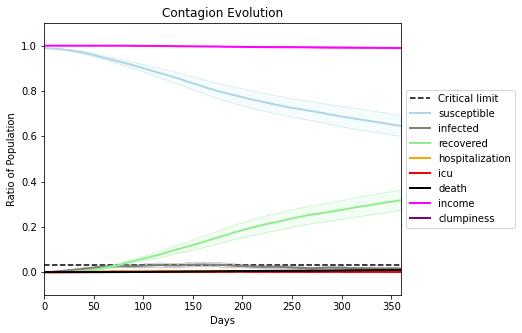

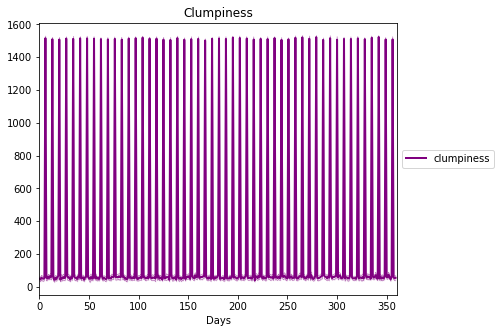

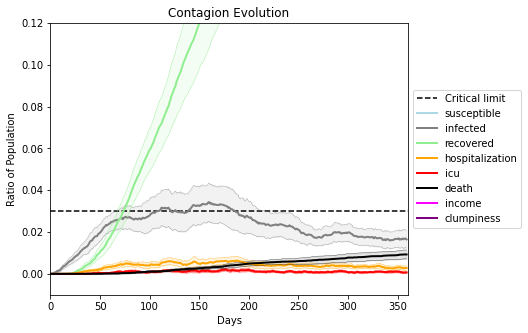

In [22]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.3
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3651, 737, 4051, 4473, 9564, 2010, 3232, 2600, 837, 3202, 741, 6491, 8347, 2774, 3439, 4269, 139, 4950, 1623, 2747]
Average similarity between family members is 0.16760024752150837 at temperature -0.2
Average similarity between family and home is 0.999858564161028 at temperature -1
Average similarity between students and their classroom is 0.17599966238171552 at temperature -0.2
Average classroom occupancy is 1.542857142857143 and number classrooms is 175
Average similarity between workers is 0.16732398768688322 at temperature -0.2
Average office occupancy is 3.375 and number offices is 200
Average friend similarity for adults: 0.20961677042034604 for kids: 0.2085964877750822
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBui

avg restaurant similarity 0.009787054105664578
avg restaurant similarity -0.014620005554356285
avg restaurant similarity 0.12544282232661594
avg restaurant similarity 0.20304382510750354
avg restaurant similarity 0.06705824433967919
avg restaurant similarity 0.2397144632980358
avg restaurant similarity 0.40000864524694674
avg restaurant similarity 0.07097696512282031
avg restaurant similarity 0.23679138644928538
avg restaurant similarity -0.035050095102026835
avg restaurant similarity 0.08575970526811753
avg restaurant similarity 0.12380971420777186
avg restaurant similarity 0.035491619672853386
avg restaurant similarity -0.050920044836603784
avg restaurant similarity 0.21037196044506137
avg restaurant similarity 0.023008120387011288
avg restaurant similarity 0.35879556844393834
avg restaurant similarity 0.010436861129456148
avg restaurant similarity 0.054720228768034056
avg restaurant similarity 0.016299069745347037
avg restaurant similarity 0.11922162855234582
avg restaurant similari

avg restaurant similarity -0.06042790622220873
avg restaurant similarity 0.31871446372745166
avg restaurant similarity 0.08351670268277236
avg restaurant similarity -0.08505585052162803
avg restaurant similarity 0.1042896752623598
avg restaurant similarity 0.04449724039676928
avg restaurant similarity 0.07102707459640081
avg restaurant similarity 0.27258314658085253
avg restaurant similarity 0.12355881907911699
avg restaurant similarity 0.5455916686336488
avg restaurant similarity 0.0030469520134716543
avg restaurant similarity -0.1055570604532233
avg restaurant similarity 0.11375577269184037
avg restaurant similarity -0.055024233586527894
avg restaurant similarity 0.025992687703750378
avg restaurant similarity -0.028067455739393246
avg restaurant similarity 0.04329251156901451
avg restaurant similarity 0.061813820162678154
avg restaurant similarity -0.0459783455168765
avg restaurant similarity 0.007937072043003963
avg restaurant similarity 0.08421137748330716
avg restaurant similarity

Average similarity between family and home is 0.9998473282461076 at temperature -1
Average similarity between students and their classroom is 0.15223294685672625 at temperature -0.2
Average classroom occupancy is 1.6779661016949152 and number classrooms is 177
Average similarity between workers is 0.13108957883015962 at temperature -0.2
Average office occupancy is 3.257575757575758 and number offices is 198
Average friend similarity for adults: 0.19924286130473576 for kids: 0.2084659402171881
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 

avg restaurant similarity 0.07972703035635727
avg restaurant similarity -0.14029543677720774
avg restaurant similarity -0.06733726679123779
avg restaurant similarity 0.09354032671941705
avg restaurant similarity -0.004011751413811243
avg restaurant similarity 0.12455815577155592
avg restaurant similarity 0.24647072029060316
avg restaurant similarity -0.05206227715911101
avg restaurant similarity -0.057069021660023506
avg restaurant similarity -0.09478902090471937
avg restaurant similarity 0.04432238249095186
avg restaurant similarity 0.18401410942600485
avg restaurant similarity 0.05287186523362556
avg restaurant similarity -0.06290664276373728
avg restaurant similarity 0.034704829939784944
avg restaurant similarity 0.056377142706342184
avg restaurant similarity 0.21934696588562172
avg restaurant similarity -0.0348719736678107
avg restaurant similarity -0.08368128710549476
avg restaurant similarity 0.19098465906285214
avg restaurant similarity 0.27121080892632227
avg restaurant similar

avg restaurant similarity -0.02503400251944357
avg restaurant similarity 0.243264018910339
avg restaurant similarity 0.23078536397575317
avg restaurant similarity 0.07444429729348076
avg restaurant similarity 0.11296496558264886
avg restaurant similarity 0.1480862301192222
avg restaurant similarity 0.09834560790262648
avg restaurant similarity 0.11283629997561065
avg restaurant similarity 0.11732557875864842
avg restaurant similarity -0.06938830624723108
avg restaurant similarity 0.13141568019188068
avg restaurant similarity 0.026746324089557492
avg restaurant similarity -0.2252414165309955
avg restaurant similarity 0.00023192886340346144
avg restaurant similarity 0.01294758875521589
avg restaurant similarity 0.024199476700798292
avg restaurant similarity 0.07413928221743599
avg restaurant similarity 0.1033965455779661
avg restaurant similarity 0.3876608957879024
avg restaurant similarity -0.0676110922034306
avg restaurant similarity -0.028843052142558005
avg restaurant similarity 0.07

Average similarity between workers is 0.15052526464427393 at temperature -0.2
Average office occupancy is 3.207070707070707 and number offices is 198
Average friend similarity for adults: 0.21307420329399987 for kids: 0.2058354508196142
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.04701052522218563
avg restaurant similarity 0.42436959132988755
avg restaurant similarity 0.4418608482564685
avg restaurant similarity 0.13709977738673346
avg restaurant similarity 0.2590100248391747
avg restaurant similarity 0.04509851850415405
avg restaurant similarity 0.19960015588216357
avg restaurant similarity 0.1920231942908907
avg restaurant similarity 0.21918557243710654
avg restaurant similarity 0.024349379602631754
avg restaurant similarity 0.16148521559465998
avg restaurant similarity 0.16689524192525013
avg restaurant similarity 0.13454375197539087
avg restaurant similarity 0.2333234535978653
avg restaurant similarity 0.3349021498862207
avg restaurant similarity 0.17786184401180555
avg restaurant similarity 0.37060974489544884
avg restaurant similarity 0.19382360675206667
avg restaurant similarity 0.2866427741286729
avg restaurant similarity 0.2023806490388883
avg restaurant similarity 0.7357634209595387
avg restaurant similarity -0.231428561384

avg restaurant similarity 0.18427645218376523
avg restaurant similarity 0.13084442758981646
avg restaurant similarity 0.040725115859023914
avg restaurant similarity 0.11310946323746077
avg restaurant similarity 0.30099089441526633
avg restaurant similarity 0.13134993337883755
avg restaurant similarity 0.12546161821111465
avg restaurant similarity 0.14508678136003939
avg restaurant similarity 0.20166379171324608
avg restaurant similarity 0.15977364046044842
avg restaurant similarity -0.15878933788512206
avg restaurant similarity 0.10255210483700221
avg restaurant similarity 0.057096636204643926
avg restaurant similarity 0.23422073274994215
avg restaurant similarity 0.10362785554086397
avg restaurant similarity 0.049025048759431686
avg restaurant similarity 0.20636893352236513
avg restaurant similarity 0.07803056917081932
avg restaurant similarity 0.17409906117443696
avg restaurant similarity 0.09669844969898318
avg restaurant similarity 0.2448607759016185
avg restaurant similarity 0.249

Average friend similarity for adults: 0.20209991542206823 for kids: 0.20353994883999513
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated

avg restaurant similarity 0.242348239542077
avg restaurant similarity 0.3467328817570603
avg restaurant similarity 0.1373070971123647
avg restaurant similarity -0.1877553182229607
avg restaurant similarity 0.10112870799105131
avg restaurant similarity 0.008155440962676293
avg restaurant similarity 0.21883296201100927
avg restaurant similarity 0.21357243502444462
avg restaurant similarity 0.34935640065388485
avg restaurant similarity -0.01932891998705932
avg restaurant similarity 0.08179221430911521
avg restaurant similarity 0.06297572083833211
avg restaurant similarity 0.39423739330581714
avg restaurant similarity -0.021163290590013484
avg restaurant similarity 0.1865133138761055
avg restaurant similarity -0.028698821743965583
avg restaurant similarity 0.09556838944256696
avg restaurant similarity -0.010225522927162622
avg restaurant similarity 0.1845185214037496
avg restaurant similarity 0.2452194238976573
avg restaurant similarity 0.3230611614146268
avg restaurant similarity 0.098228

avg restaurant similarity 0.16292674212899985
avg restaurant similarity 0.1949449406320025
avg restaurant similarity -0.008717696045480956
avg restaurant similarity 0.2044244739586591
avg restaurant similarity 0.08500659006861265
avg restaurant similarity -0.23735909723652043
avg restaurant similarity 0.13919898125977287
avg restaurant similarity 0.13462654294944904
avg restaurant similarity 0.2697227155802682
avg restaurant similarity 0.0318828213779091
avg restaurant similarity 0.08314928583944853
avg restaurant similarity 0.2273590548383927
avg restaurant similarity -0.006259779430489665
avg restaurant similarity -0.09704534035374351
avg restaurant similarity 0.06562200849031755
avg restaurant similarity 0.4288615137233193
avg restaurant similarity 0.27191499716842416
avg restaurant similarity 0.24832611766227755
avg restaurant similarity 0.14607934088608363
avg restaurant similarity 0.21914020776393595
avg restaurant similarity 0.16830376756802193
avg restaurant similarity 0.219595

Average similarity between workers is 0.1566351967544124 at temperature -0.2
Average office occupancy is 3.1758793969849246 and number offices is 199
Average friend similarity for adults: 0.21150236709306247 for kids: 0.2116786983833605
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 

avg restaurant similarity 0.11976798108242301
avg restaurant similarity -0.008179385142390229
avg restaurant similarity 0.027705414867720216
avg restaurant similarity 0.22542226428605586
avg restaurant similarity 0.08231538871774606
avg restaurant similarity 0.26458701312599775
avg restaurant similarity -0.00015289843615128861
avg restaurant similarity 0.0067962656233485075
avg restaurant similarity 0.2174726526810383
avg restaurant similarity 0.12499513186925473
avg restaurant similarity 0.3399895745503117
avg restaurant similarity 0.1379678704452885
avg restaurant similarity 0.15223403394880244
avg restaurant similarity 0.1171914276938143
avg restaurant similarity 0.14278298278337195
avg restaurant similarity 0.17703920274247056
avg restaurant similarity -0.07102901014177358
avg restaurant similarity 0.07992159225783947
avg restaurant similarity 0.023752422355717027
avg restaurant similarity 0.2958511523388157
avg restaurant similarity 0.2189789631866419
avg restaurant similarity 0.0

avg restaurant similarity 0.039699617333659815
avg restaurant similarity 0.014443412730378214
avg restaurant similarity 0.2720119369572552
avg restaurant similarity 0.13855151006108574
avg restaurant similarity 0.5540129359350201
avg restaurant similarity -0.12455082013016132
avg restaurant similarity 0.2899384712970031
avg restaurant similarity 0.21961980924415866
avg restaurant similarity 0.08833816467933076
avg restaurant similarity 0.20373774864435373
avg restaurant similarity 0.11897116431555088
avg restaurant similarity 0.011855683866254641
avg restaurant similarity 0.31315909401542585
avg restaurant similarity 0.19593694452140356
avg restaurant similarity 0.10934562002911541
avg restaurant similarity 0.5229726257505907
avg restaurant similarity 0.25178736109604405
avg restaurant similarity 0.18557618460389316
avg restaurant similarity 0.09403475807422132
avg restaurant similarity 0.16771281009973724
avg restaurant similarity 0.200675150818985
avg restaurant similarity 0.13390375

Average similarity between students and their classroom is 0.16758599304560556 at temperature -0.2
Average classroom occupancy is 1.5934065934065933 and number classrooms is 182
Average similarity between workers is 0.17842154707198735 at temperature -0.2
Average office occupancy is 3.227722772277228 and number offices is 202
Average friend similarity for adults: 0.21536131521529836 for kids: 0.2177633845662002
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in

avg restaurant similarity 0.08417410112066713
avg restaurant similarity 0.022438049697700965
avg restaurant similarity 0.000980658561714939
avg restaurant similarity 0.22953038597761558
avg restaurant similarity -0.07318710137610664
avg restaurant similarity 0.24123793037276844
avg restaurant similarity 0.20017123829347544
avg restaurant similarity -0.032490837184502304
avg restaurant similarity -0.18608478648044804
avg restaurant similarity 0.14980500622350648
avg restaurant similarity 0.3139593821611728
avg restaurant similarity 0.2521233980222561
avg restaurant similarity -0.02933431881093688
avg restaurant similarity 0.2005102386411919
avg restaurant similarity 0.0008358519311370449
avg restaurant similarity 0.23777092288828833
avg restaurant similarity -0.011837639916450371
avg restaurant similarity 0.14940744695946911
avg restaurant similarity 0.3921583068285938
avg restaurant similarity -0.12393299951527892
avg restaurant similarity 0.07980535303212381
avg restaurant similarity 

avg restaurant similarity 0.1464946786314022
avg restaurant similarity 0.2142321561546855
avg restaurant similarity 0.1536498195019841
avg restaurant similarity 0.13025065032522629
avg restaurant similarity 0.08816300797164334
avg restaurant similarity 0.12364188601503553
avg restaurant similarity 0.3023775064916484
avg restaurant similarity 0.19951249197823467
avg restaurant similarity 0.03634597560633081
avg restaurant similarity 0.14499742756942724
avg restaurant similarity 0.2406536135501865
avg restaurant similarity 0.1177317166917166
avg restaurant similarity 0.037163304606556334
avg restaurant similarity -0.026405954155650134
avg restaurant similarity -0.08814575591547505
avg restaurant similarity 0.249210458621988
avg restaurant similarity 0.04023450955587656
avg restaurant similarity 0.0491992463981443
avg restaurant similarity 0.17848261547138544
avg restaurant similarity -0.0650077178691635
avg restaurant similarity 0.1497394287486352
avg restaurant similarity 0.016569438318

Average similarity between family and home is 0.9998527661054392 at temperature -1
Average similarity between students and their classroom is 0.1714664830838978 at temperature -0.2
Average classroom occupancy is 1.6914285714285715 and number classrooms is 175
Average similarity between workers is 0.15355384135228772 at temperature -0.2
Average office occupancy is 3.291457286432161 and number offices is 199
Average friend similarity for adults: 0.2158533701029007 for kids: 0.2155673536260498
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 peop

avg restaurant similarity -0.028494538247070933
avg restaurant similarity 0.02520163035158235
avg restaurant similarity 0.048944435557095926
avg restaurant similarity 0.11672658093774407
avg restaurant similarity 0.06509178648796092
avg restaurant similarity 0.03850915124262102
avg restaurant similarity 0.20307479272623738
avg restaurant similarity 0.21164697270326202
avg restaurant similarity 0.10376822878245325
avg restaurant similarity 0.0002592191080870332
avg restaurant similarity 0.1793888330209846
avg restaurant similarity 0.0661609005090427
avg restaurant similarity 0.04145566798754204
avg restaurant similarity 0.07235566349421513
avg restaurant similarity -0.017978795805329142
avg restaurant similarity 0.05227301505988973
avg restaurant similarity 0.1315702860453773
avg restaurant similarity 0.19510433043649175
avg restaurant similarity 0.021336688333979986
avg restaurant similarity 0.1014959047673225
avg restaurant similarity 0.01481547506686584
avg restaurant similarity 0.42

avg restaurant similarity 0.22051809386119042
avg restaurant similarity 0.1462143317585092
avg restaurant similarity 0.15497139640935215
avg restaurant similarity 0.12978829500336586
avg restaurant similarity 0.20836444551960903
avg restaurant similarity 0.07943772793054651
avg restaurant similarity -0.008187627158454055
avg restaurant similarity 0.13743162436423706
avg restaurant similarity 0.16190662623425328
avg restaurant similarity 0.09391452073108528
avg restaurant similarity 0.10955033478601414
avg restaurant similarity 0.14511701594574036
avg restaurant similarity 0.3014928232367168
avg restaurant similarity 0.005615459958614832
avg restaurant similarity 0.11385969905801616
avg restaurant similarity -0.09012138558666392
avg restaurant similarity 0.057589704242197254
avg restaurant similarity 0.07197035755094701
avg restaurant similarity 0.07514935589257982
avg restaurant similarity 0.193742770725476
avg restaurant similarity 0.20620104411940798
avg restaurant similarity 0.06839

avg restaurant similarity -0.007441087030800978
Average similarity between family members is 0.1744732809427459 at temperature -0.2
Average similarity between family and home is 0.999856127942135 at temperature -1
Average similarity between students and their classroom is 0.1694787195710561 at temperature -0.2
Average classroom occupancy is 1.5698924731182795 and number classrooms is 186
Average similarity between workers is 0.15603534567767394 at temperature -0.2
Average office occupancy is 3.269607843137255 and number offices is 204
Average friend similarity for adults: 0.2037435758789603 for kids: 0.2180991416189054
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.09610993731661552
avg restaurant similarity 0.05460191972316098
avg restaurant similarity 0.03904536459078969
avg restaurant similarity 0.13896882813628994
avg restaurant similarity 0.21238046240611594
avg restaurant similarity 0.012277385183720306
avg restaurant similarity 0.1982509759720525
avg restaurant similarity 0.0031153471800696164
avg restaurant similarity 0.039467021072086904
avg restaurant similarity 0.129978784137728
avg restaurant similarity -0.0053658373274146015
avg restaurant similarity 0.11300231370834982
avg restaurant similarity 0.05904581278557815
avg restaurant similarity 0.2301927612517305
avg restaurant similarity 0.17260871976126008
avg restaurant similarity 0.23211795448994083
avg restaurant similarity -0.008142622495365459
avg restaurant similarity 0.07937024433218234
avg restaurant similarity 0.06872925192029168
avg restaurant similarity 0.13316688157445097
avg restaurant similarity 0.18895022818616836
avg restaurant similarity -0.

avg restaurant similarity 0.5786550223470626
avg restaurant similarity -0.09845557222676628
avg restaurant similarity 0.05882374221364355
avg restaurant similarity 0.28800639751522406
avg restaurant similarity -0.03730282767313677
avg restaurant similarity 0.045775255382031435
avg restaurant similarity 0.09729646876631916
avg restaurant similarity -0.03747030685090513
avg restaurant similarity 0.050902224840684455
avg restaurant similarity 0.11485306228650038
avg restaurant similarity 0.068069239542518
avg restaurant similarity 0.08623877659709667
avg restaurant similarity 0.11846822117344284
avg restaurant similarity 0.0673917703701407
avg restaurant similarity 0.2016340835504837
avg restaurant similarity 0.15985313528831507
avg restaurant similarity 0.16576183256837657
avg restaurant similarity 0.08717516034090188
avg restaurant similarity 0.23823166913041346
avg restaurant similarity 0.027988690287324463
avg restaurant similarity 0.30888116668241566
avg restaurant similarity 0.09009

avg restaurant similarity -0.03723301916747486
avg restaurant similarity 0.0015986530725233493
Average similarity between family members is 0.17769224907291847 at temperature -0.2
Average similarity between family and home is 0.9998538603954636 at temperature -1
Average similarity between students and their classroom is 0.1574907353329192 at temperature -0.2
Average classroom occupancy is 1.6206896551724137 and number classrooms is 174
Average similarity between workers is 0.15727313254499284 at temperature -0.2
Average office occupancy is 3.3004926108374386 and number offices is 203
Average friend similarity for adults: 0.21701701750663263 for kids: 0.20780942745214925
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 all

avg restaurant similarity -0.029150063831432156
avg restaurant similarity 0.08583125898390856
avg restaurant similarity 0.14989602643549027
avg restaurant similarity -0.020296637903751705
avg restaurant similarity 0.2151417123260474
avg restaurant similarity -0.07298077061060534
avg restaurant similarity 0.24980219481150598
avg restaurant similarity -0.08635301928075607
avg restaurant similarity -0.014359647128204032
avg restaurant similarity -0.06328659662900199
avg restaurant similarity 0.2009495257436656
avg restaurant similarity 0.07480208453201387
avg restaurant similarity -0.039731599366250196
avg restaurant similarity 0.10560797750386673
avg restaurant similarity 0.125647606903759
avg restaurant similarity 0.04615938285271142
avg restaurant similarity -0.03659159498476998
avg restaurant similarity 0.11160319042943571
avg restaurant similarity 0.26826476484861794
avg restaurant similarity 0.04637264825540883
avg restaurant similarity 0.29871169144976156
avg restaurant similarity 

avg restaurant similarity 0.016655947706811104
avg restaurant similarity 0.3939275168807937
avg restaurant similarity 0.13716421896638684
avg restaurant similarity 0.18639574458682587
avg restaurant similarity 0.07641520683533169
avg restaurant similarity -0.026676730719155373
avg restaurant similarity 0.14894903602590223
avg restaurant similarity 0.11050229308486006
avg restaurant similarity -0.0025797982253094797
avg restaurant similarity 0.1932355050653104
avg restaurant similarity 0.05906155986951315
avg restaurant similarity 0.19005966339798058
avg restaurant similarity 0.0256437601708542
avg restaurant similarity 0.08797938674429366
avg restaurant similarity 0.15801778582610734
avg restaurant similarity 0.03435168903106343
avg restaurant similarity 0.09104947796889372
avg restaurant similarity 0.05628197387851653
avg restaurant similarity 0.025405623545833755
avg restaurant similarity 0.361103090679042
avg restaurant similarity 0.20808332479265831
avg restaurant similarity 0.0544

avg restaurant similarity 0.02940738384066058
avg restaurant similarity -0.011117488456004914
avg restaurant similarity -0.11468635060522848
Average similarity between family members is 0.17663586355030442 at temperature -0.2
Average similarity between family and home is 0.9998478986173854 at temperature -1
Average similarity between students and their classroom is 0.18902422656082557 at temperature -0.2
Average classroom occupancy is 1.627027027027027 and number classrooms is 185
Average similarity between workers is 0.17217532298326577 at temperature -0.2
Average office occupancy is 3.12807881773399 and number offices is 203
Average friend similarity for adults: 0.21385763966077992 for kids: 0.21915407289822786
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 unit

avg restaurant similarity 0.0553469878882881
avg restaurant similarity 0.09558144110939909
avg restaurant similarity 0.09649190368231983
avg restaurant similarity -0.05227602457056358
avg restaurant similarity -0.04654041093327338
avg restaurant similarity 0.027453278651579562
avg restaurant similarity 0.13102878156040026
avg restaurant similarity 0.0693570409791824
avg restaurant similarity 0.07049153730464672
avg restaurant similarity -0.10591759979199314
avg restaurant similarity -0.033795788198129964
avg restaurant similarity 0.09720072034375328
avg restaurant similarity 0.02394504791853367
avg restaurant similarity 0.02778322585967492
avg restaurant similarity 0.10719882413569008
avg restaurant similarity -0.005828079663572555
avg restaurant similarity 0.01898643938411078
avg restaurant similarity -0.16084087923556356
avg restaurant similarity -0.010941173439844482
avg restaurant similarity 0.06122480617564122
avg restaurant similarity 0.06347880354130563
avg restaurant similarity

avg restaurant similarity -0.09056653558255022
avg restaurant similarity 0.02949541089197899
avg restaurant similarity 0.1302008992837557
avg restaurant similarity 0.06919622092195171
avg restaurant similarity 0.08036713709257261
avg restaurant similarity 0.2225620299076163
avg restaurant similarity -0.030134310431774083
avg restaurant similarity -0.0048168199218126045
avg restaurant similarity -0.01418454123133058
avg restaurant similarity 0.16127884313069574
avg restaurant similarity 0.13557209141911247
avg restaurant similarity 0.0560785655234512
avg restaurant similarity 0.06418193578748443
avg restaurant similarity -0.04779723531062148
avg restaurant similarity 0.09437422403028112
avg restaurant similarity 0.19767800817101933
avg restaurant similarity -0.025418155595141156
avg restaurant similarity -0.10166831238300877
avg restaurant similarity 0.02169142334654568
avg restaurant similarity 0.15843889536334665
avg restaurant similarity 0.018278803548346205
avg restaurant similarity

avg restaurant similarity 0.10366080199016219
avg restaurant similarity 0.07638132759981589
avg restaurant similarity 0.008723358225972049
avg restaurant similarity 0.07943123877878246
avg restaurant similarity -0.051918863496736634
Average similarity between family members is 0.16824794473602817 at temperature -0.2
Average similarity between family and home is 0.999843044469908 at temperature -1
Average similarity between students and their classroom is 0.1725854760235172 at temperature -0.2
Average classroom occupancy is 1.6333333333333333 and number classrooms is 180
Average similarity between workers is 0.16928284251695164 at temperature -0.2
Average office occupancy is 3.1666666666666665 and number offices is 204
Average friend similarity for adults: 0.2054725128646204 for kids: 0.20256796680103586
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allo

avg restaurant similarity 0.2570038143379434
avg restaurant similarity 0.019527803199553995
avg restaurant similarity 0.1532125980570705
avg restaurant similarity 0.1014813286973505
avg restaurant similarity 0.25246119584841525
avg restaurant similarity 0.2684336966791263
avg restaurant similarity -0.15039520301592874
avg restaurant similarity 0.1143572875815803
avg restaurant similarity 0.06914504214234345
avg restaurant similarity 0.2776342542096796
avg restaurant similarity 0.17956623680572942
avg restaurant similarity 0.24362933989992877
avg restaurant similarity 0.07603437125494447
avg restaurant similarity 0.11218489865887192
avg restaurant similarity 0.16571928662548982
avg restaurant similarity -0.19759725444295484
avg restaurant similarity 0.17153234300901193
avg restaurant similarity 0.011840060835914766
avg restaurant similarity -0.11115575624129898
avg restaurant similarity 0.05641964014345598
avg restaurant similarity 0.08428884492998398
avg restaurant similarity -0.058334

avg restaurant similarity 0.15975234312730122
avg restaurant similarity 0.01772137511235175
avg restaurant similarity 0.03217367914747227
avg restaurant similarity 0.08349995563954668
avg restaurant similarity -0.00024991674930113436
avg restaurant similarity 0.07125504497852483
avg restaurant similarity 0.18857077766051822
avg restaurant similarity 0.1723261494630075
avg restaurant similarity -0.03412328106388955
avg restaurant similarity 0.13679688541403512
avg restaurant similarity -0.006396914785919981
avg restaurant similarity 0.08109026607464999
avg restaurant similarity 0.24949419717269092
avg restaurant similarity -0.06423488776581637
avg restaurant similarity 0.001582538182141559
avg restaurant similarity 0.10573984390193429
avg restaurant similarity 0.033878539931095734
avg restaurant similarity 0.03963102060353171
avg restaurant similarity 0.2034219090044962
avg restaurant similarity 0.31593142328007323
avg restaurant similarity -0.12990712074989147
avg restaurant similarity

Average similarity between students and their classroom is 0.16497870174382892 at temperature -0.2
Average classroom occupancy is 1.6256983240223464 and number classrooms is 179
Average similarity between workers is 0.15261341965624894 at temperature -0.2
Average office occupancy is 3.200980392156863 and number offices is 204
Average friend similarity for adults: 0.21706742118913225 for kids: 0.2060966894838085
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated 

avg restaurant similarity 0.06563759641776122
avg restaurant similarity 0.16130381880870923
avg restaurant similarity 0.05097057182155571
avg restaurant similarity -0.011838523948551592
avg restaurant similarity -0.03744557322165611
avg restaurant similarity 0.08843416549483801
avg restaurant similarity -0.09757378635141849
avg restaurant similarity 0.01834216466838552
avg restaurant similarity 0.02655564364406006
avg restaurant similarity 0.017187185405195555
avg restaurant similarity 0.007487062232093861
avg restaurant similarity 0.19594036887697622
avg restaurant similarity -0.0629556785347888
avg restaurant similarity -0.05010025494471236
avg restaurant similarity -0.09083442014198839
avg restaurant similarity -0.015537428938481689
avg restaurant similarity 0.02968258223072548
avg restaurant similarity -0.40750308920497474
avg restaurant similarity 0.24037007561493573
avg restaurant similarity 0.08207858224678663
avg restaurant similarity 0.01973370090170505
avg restaurant similari

avg restaurant similarity 0.0690927281060165
avg restaurant similarity 0.06844543547823483
avg restaurant similarity 0.18664143095922187
avg restaurant similarity 0.06819220045341899
avg restaurant similarity 0.10144675054411227
avg restaurant similarity 0.02471963837076502
avg restaurant similarity 0.2176104197548175
avg restaurant similarity -0.07555728319881416
avg restaurant similarity -0.1457338078351752
avg restaurant similarity 0.03844237452548689
avg restaurant similarity 0.06805797165491718
avg restaurant similarity 0.14033496579101726
avg restaurant similarity 0.18462082628648466
avg restaurant similarity 0.30711166811086005
avg restaurant similarity 0.02128432225862036
avg restaurant similarity 0.08079497837054629
avg restaurant similarity 0.06379909101195055
avg restaurant similarity 0.14904447155035422
avg restaurant similarity -0.08853738856613352
avg restaurant similarity 0.14326638960709426
avg restaurant similarity 0.16066057062251393
avg restaurant similarity 0.164588

avg restaurant similarity 0.022867755392693825
avg restaurant similarity 0.09958958881105956
avg restaurant similarity -0.08035071845022974
avg restaurant similarity -0.004178655691341472
Average similarity between family members is 0.1765075668633827 at temperature -0.2
Average similarity between family and home is 0.9998530796384332 at temperature -1
Average similarity between students and their classroom is 0.17923376300749758 at temperature -0.2
Average classroom occupancy is 1.6666666666666667 and number classrooms is 183
Average similarity between workers is 0.16373120199867028 at temperature -0.2
Average office occupancy is 3.180487804878049 and number offices is 205
Average friend similarity for adults: 0.2094109280010214 for kids: 0.2044832012231175
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.012938959328060473
avg restaurant similarity 0.1731174404978657
avg restaurant similarity 0.06112132597731326
avg restaurant similarity 0.06087736115020296
avg restaurant similarity 0.06128543085688668
avg restaurant similarity 0.12464407147817891
avg restaurant similarity 0.14160386808508768
avg restaurant similarity 0.08754053112134587
avg restaurant similarity 0.1414434705598485
avg restaurant similarity 0.009024769839397567
avg restaurant similarity 0.12072407200156136
avg restaurant similarity 0.2680429887549179
avg restaurant similarity 0.2245616976445644
avg restaurant similarity 0.1201951028745873
avg restaurant similarity 0.552284843537953
avg restaurant similarity -0.019509003329020867
avg restaurant similarity -0.2284242195507942
avg restaurant similarity -0.017991628188583964
avg restaurant similarity 0.27572911069334605
avg restaurant similarity 0.11689700274252468
avg restaurant similarity -0.194498435187363
avg restaurant similarity -0.0277747

avg restaurant similarity -0.10428623933419408
avg restaurant similarity 0.1625725263138017
avg restaurant similarity 0.059094220427704805
avg restaurant similarity 0.13974674288463895
avg restaurant similarity 0.11162773380550298
avg restaurant similarity 0.06681548025017403
avg restaurant similarity -0.06372544829290819
avg restaurant similarity 0.01994833397952271
avg restaurant similarity 0.17998760443253364
avg restaurant similarity -0.022098450867746543
avg restaurant similarity 0.11079488163719066
avg restaurant similarity 0.22225856483603687
avg restaurant similarity -0.01531356228737157
avg restaurant similarity 0.062411038191095496
avg restaurant similarity 0.09720129818351582
avg restaurant similarity -0.10221694365011844
avg restaurant similarity -0.038498025780614904
avg restaurant similarity 0.06384358063354945
avg restaurant similarity 0.04316147960911013
avg restaurant similarity 0.10901316603199689
avg restaurant similarity -0.07254633896521444
avg restaurant similarit

avg restaurant similarity -0.016921027039693788
avg restaurant similarity 0.20025642791457704
avg restaurant similarity 0.10219164772872769
Average similarity between family members is 0.1965950374939682 at temperature -0.2
Average similarity between family and home is 0.9998540386529444 at temperature -1
Average similarity between students and their classroom is 0.17642364653254544 at temperature -0.2
Average classroom occupancy is 1.5856353591160222 and number classrooms is 181
Average similarity between workers is 0.15640623129336786 at temperature -0.2
Average office occupancy is 3.298507462686567 and number offices is 201
Average friend similarity for adults: 0.22315794151250848 for kids: 0.2158569997780354
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 uni

avg restaurant similarity 0.25449754433920874
avg restaurant similarity 0.22074296973623705
avg restaurant similarity 0.06867178249819264
avg restaurant similarity 0.14057459291851107
avg restaurant similarity -0.09248530346307018
avg restaurant similarity -0.022806471808842904
avg restaurant similarity 0.05115598936573133
avg restaurant similarity 0.0033394327473576725
avg restaurant similarity 0.11475889083303077
avg restaurant similarity 0.10747450764418073
avg restaurant similarity 0.1038289676162247
avg restaurant similarity -0.20435644177370207
avg restaurant similarity 0.19546530761274789
avg restaurant similarity 0.34930483621055736
avg restaurant similarity 0.04957843121427086
avg restaurant similarity 0.15452325198648306
avg restaurant similarity 0.12354632950957854
avg restaurant similarity -0.0010642682069309378
avg restaurant similarity 0.1558639016894187
avg restaurant similarity 0.10345977849073174
avg restaurant similarity 0.16890501841644134
avg restaurant similarity -

avg restaurant similarity -0.17498165721287223
avg restaurant similarity 0.07599679144104213
avg restaurant similarity 0.5156990611869376
avg restaurant similarity 0.24349954917337355
avg restaurant similarity -0.031000530707340566
avg restaurant similarity -0.12975333013763696
avg restaurant similarity -0.039815045873261866
avg restaurant similarity 0.14263503565563837
avg restaurant similarity 0.10773032312774744
avg restaurant similarity 0.05506945731576165
avg restaurant similarity 0.026708497478074467
avg restaurant similarity 0.23856374801145241
avg restaurant similarity -0.05780607611872245
avg restaurant similarity -0.07132355450193431
avg restaurant similarity -0.24621599143505385
avg restaurant similarity -0.0614426702440279
avg restaurant similarity 0.05829267780910652
avg restaurant similarity -0.06757766922801843
avg restaurant similarity 0.20189936725990265
avg restaurant similarity 0.09218061417022427
avg restaurant similarity 0.2869083714626861
avg restaurant similarity

avg restaurant similarity 0.09475303033587965
avg restaurant similarity 0.32780596232793413
avg restaurant similarity -0.02517119639456848
Average similarity between family members is 0.18003248571098204 at temperature -0.2
Average similarity between family and home is 0.9998621503622426 at temperature -1
Average similarity between students and their classroom is 0.18341806601999452 at temperature -0.2
Average classroom occupancy is 1.576271186440678 and number classrooms is 177
Average similarity between workers is 0.14715472204048474 at temperature -0.2
Average office occupancy is 3.3267326732673266 and number offices is 202
Average friend similarity for adults: 0.2097753945633139 for kids: 0.2026208418158504
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity -0.17784790244159765
avg restaurant similarity -0.023225884581636602
avg restaurant similarity 0.06545839201332959
avg restaurant similarity -0.09988854799791536
avg restaurant similarity 0.07651944175478795
avg restaurant similarity 0.06910866280640908
avg restaurant similarity 0.20228031681184164
avg restaurant similarity 0.0048363365485524015
avg restaurant similarity 0.3176787677538157
avg restaurant similarity 0.054267078154809814
avg restaurant similarity -0.009649535650928914
avg restaurant similarity -0.005906600813838701
avg restaurant similarity 0.04175219561655628
avg restaurant similarity 0.24299827636774804
avg restaurant similarity 0.12947547479944513
avg restaurant similarity 0.030777200192363414
avg restaurant similarity 0.14311353474848792
avg restaurant similarity -0.05021915425565321
avg restaurant similarity 0.004321567737684513
avg restaurant similarity -0.13179117047064365
avg restaurant similarity 0.2690912969374491
avg restaurant simila

avg restaurant similarity 0.31838190237991687
avg restaurant similarity 0.15479547817601697
avg restaurant similarity -0.270449660288183
avg restaurant similarity -0.027678473134044874
avg restaurant similarity -0.009564417364252762
avg restaurant similarity 0.03985808397511259
avg restaurant similarity 0.23294654110983729
avg restaurant similarity 0.4201488158481422
avg restaurant similarity 0.05239139646006398
avg restaurant similarity 0.2975876165425785
avg restaurant similarity 0.22680876847355363
avg restaurant similarity 0.05571748170135666
avg restaurant similarity -0.08769302718608372
avg restaurant similarity 0.20271741907592458
avg restaurant similarity 0.25447445164719207
avg restaurant similarity 0.10055789488757244
avg restaurant similarity 0.13193602283522235
avg restaurant similarity 0.11037833027263264
avg restaurant similarity 0.02288589070724173
avg restaurant similarity 0.029177179624010462
avg restaurant similarity 0.24089851615083663
avg restaurant similarity 0.127

Average similarity between family and home is 0.9998507527004755 at temperature -1
Average similarity between students and their classroom is 0.18382269278333235 at temperature -0.2
Average classroom occupancy is 1.5977011494252873 and number classrooms is 174
Average similarity between workers is 0.14586330556433477 at temperature -0.2
Average office occupancy is 3.25 and number offices is 204
Average friend similarity for adults: 0.20549694078042283 for kids: 0.21806892899022196
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 a

avg restaurant similarity 0.04438168661982588
avg restaurant similarity 0.06692061705038005
avg restaurant similarity 0.10654763257508909
avg restaurant similarity 0.13616211584938412
avg restaurant similarity 0.17174209487400188
avg restaurant similarity 0.17209602228494617
avg restaurant similarity 0.12131142639155439
avg restaurant similarity 0.03601162809516936
avg restaurant similarity 0.17693184329000136
avg restaurant similarity -0.039965674054508744
avg restaurant similarity 0.24151621288586975
avg restaurant similarity -0.05210062377373775
avg restaurant similarity 0.030653554406336412
avg restaurant similarity -0.003877910445588843
avg restaurant similarity 0.17013942062284204
avg restaurant similarity 0.11260558978915722
avg restaurant similarity -0.04632156340829682
avg restaurant similarity 0.09138337555182895
avg restaurant similarity 0.11203074207049718
avg restaurant similarity 0.18128760412354297
avg restaurant similarity -0.0312759066929318
avg restaurant similarity 0

avg restaurant similarity 0.06398961120333169
avg restaurant similarity 0.29490541344292015
avg restaurant similarity 0.28521402356239733
avg restaurant similarity 0.100095585385209
avg restaurant similarity 0.09440013659210199
avg restaurant similarity 0.1810042275351305
avg restaurant similarity 0.2791076238765209
avg restaurant similarity 0.09851436586681064
avg restaurant similarity 0.1478960875753814
avg restaurant similarity 0.27522227910049485
avg restaurant similarity 0.10335203861676089
avg restaurant similarity 0.030621646837071203
avg restaurant similarity 0.006707932859050285
avg restaurant similarity -0.08269545906855418
avg restaurant similarity 0.17923648638784553
avg restaurant similarity 0.20540957323909026
avg restaurant similarity 0.06785687183965089
avg restaurant similarity 0.19520444995616548
avg restaurant similarity 0.03091878315892521
avg restaurant similarity 0.12327246510997457
avg restaurant similarity 0.06809699929270809
avg restaurant similarity 0.07729568

avg restaurant similarity 0.050356498486689785
avg restaurant similarity 0.012791657345787914
avg restaurant similarity 0.060875143090053874
avg restaurant similarity -0.004081682901102009
Average similarity between family members is 0.1740552952120118 at temperature -0.2
Average similarity between family and home is 0.9998605549776283 at temperature -1
Average similarity between students and their classroom is 0.13769405707105684 at temperature -0.2
Average classroom occupancy is 1.5614035087719298 and number classrooms is 171
Average similarity between workers is 0.15212053627103778 at temperature -0.2
Average office occupancy is 3.2941176470588234 and number offices is 204
Average friend similarity for adults: 0.2089007298237402 for kids: 0.2132551730971903
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.043328454444403613
avg restaurant similarity 0.21733295682381013
avg restaurant similarity 0.09605374145772408
avg restaurant similarity -0.00424278808768673
avg restaurant similarity 0.2733927707530101
avg restaurant similarity 0.34558820021186093
avg restaurant similarity -0.019561750192549108
avg restaurant similarity 0.3294630202846424
avg restaurant similarity 0.03840066561147705
avg restaurant similarity 0.12389407017512344
avg restaurant similarity 0.07395731794616027
avg restaurant similarity 0.06681842973745446
avg restaurant similarity 0.13758411626476655
avg restaurant similarity 0.12564209550973315
avg restaurant similarity 0.12407599721107547
avg restaurant similarity 0.30424860730703046
avg restaurant similarity 0.10684155876199539
avg restaurant similarity 0.2136412614512629
avg restaurant similarity 0.12972354532058172
avg restaurant similarity -0.06418971341369309
avg restaurant similarity 0.10261782381302299
avg restaurant similarity 0.0459

avg restaurant similarity 0.3258238462434341
avg restaurant similarity 0.11320092650278772
avg restaurant similarity 0.18352327050368195
avg restaurant similarity 0.11679097588549534
avg restaurant similarity 0.1190064952408701
avg restaurant similarity -0.06753472612918447
avg restaurant similarity 0.15296540872733902
avg restaurant similarity -0.05682817880708121
avg restaurant similarity 0.23883919854957192
avg restaurant similarity 0.038499433075963284
avg restaurant similarity -0.14577156618164644
avg restaurant similarity -0.0005478434492571932
avg restaurant similarity 0.023999347298070035
avg restaurant similarity 0.23200658515916162
avg restaurant similarity 0.04662278708428091
avg restaurant similarity 0.3345496327112952
avg restaurant similarity -0.14325917705214247
avg restaurant similarity 0.0610840506740826
avg restaurant similarity 0.03681464064259225
avg restaurant similarity 0.042368991805393025
avg restaurant similarity 0.051248623793212024
avg restaurant similarity 0

avg restaurant similarity 0.02976490880104105
avg restaurant similarity 0.006808903925492966
Average similarity between family members is 0.17558117993452324 at temperature -0.2
Average similarity between family and home is 0.999845285524867 at temperature -1
Average similarity between students and their classroom is 0.1712627761397231 at temperature -0.2
Average classroom occupancy is 1.6728395061728396 and number classrooms is 162
Average similarity between workers is 0.16223751106856552 at temperature -0.2
Average office occupancy is 3.31 and number offices is 200
Average friend similarity for adults: 0.20860850788881768 for kids: 0.20784216414671197
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with

avg restaurant similarity 0.20691211693751502
avg restaurant similarity 0.07641529994604046
avg restaurant similarity 0.1399805119500098
avg restaurant similarity 0.08412544784562843
avg restaurant similarity 0.1446074136402078
avg restaurant similarity 0.3334934304777144
avg restaurant similarity -0.020905040242971285
avg restaurant similarity 0.07395298089776982
avg restaurant similarity 0.03724284407839324
avg restaurant similarity 0.0017136138585798109
avg restaurant similarity 0.015356889873316055
avg restaurant similarity 0.0007613370661055732
avg restaurant similarity 0.14285623698870623
avg restaurant similarity -0.15508532122066898
avg restaurant similarity 0.027113013570895586
avg restaurant similarity 0.08196160627359562
avg restaurant similarity 0.11258019189008399
avg restaurant similarity 0.24518615199969482
avg restaurant similarity 0.10729476870178105
avg restaurant similarity -0.03421238930508346
avg restaurant similarity 0.3033004373670407
avg restaurant similarity 0.

avg restaurant similarity 0.0937845311711673
avg restaurant similarity -0.009843314958745164
avg restaurant similarity 0.21637978416471845
avg restaurant similarity 0.05935313605279744
avg restaurant similarity 0.18638465466676812
avg restaurant similarity 0.07418091484597393
avg restaurant similarity -0.29323023493292544
avg restaurant similarity -0.023178924404997955
avg restaurant similarity 0.20067236907677308
avg restaurant similarity 0.10169924182524522
avg restaurant similarity 0.10609676984509406
avg restaurant similarity 0.2055766953127761
avg restaurant similarity 0.09953964310627689
avg restaurant similarity 0.07155921637844558
avg restaurant similarity 0.06952541083412979
avg restaurant similarity 0.22102376444399519
avg restaurant similarity 0.0074951882559296835
avg restaurant similarity 0.17650246084420193
avg restaurant similarity 0.009415556237224093
avg restaurant similarity 0.06457864733452397
avg restaurant similarity -0.0005058143640231852
avg restaurant similarity

avg restaurant similarity 0.12622785462884287
avg restaurant similarity 0.17549388456232778
avg restaurant similarity 0.28867430219170925
avg restaurant similarity 0.061649386260144386
Average similarity between family members is 0.1594408551222338 at temperature -0.2
Average similarity between family and home is 0.9998570674576291 at temperature -1
Average similarity between students and their classroom is 0.16663564245231 at temperature -0.2
Average classroom occupancy is 1.691891891891892 and number classrooms is 185
Average similarity between workers is 0.1800246112073692 at temperature -0.2
Average office occupancy is 3.241025641025641 and number offices is 195
Average friend similarity for adults: 0.2116969561398967 for kids: 0.21599645555112015
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1

avg restaurant similarity 0.0744527168907021
avg restaurant similarity -0.03699984077839113
avg restaurant similarity 0.15796980715667439
avg restaurant similarity 0.02106671685426947
avg restaurant similarity 0.16480835997021964
avg restaurant similarity 0.024100297264903637
avg restaurant similarity 0.035753183496649014
avg restaurant similarity -0.008467081685552416
avg restaurant similarity -0.22516947000875195
avg restaurant similarity -0.019191177366565244
avg restaurant similarity 0.026344462994040106
avg restaurant similarity 0.26496518681424097
avg restaurant similarity 0.026260926992559382
avg restaurant similarity 0.05968167361578618
avg restaurant similarity 0.1824302113256483
avg restaurant similarity 0.16209229731247807
avg restaurant similarity 0.11431708299875858
avg restaurant similarity 0.00980663732293551
avg restaurant similarity 0.07634175677385276
avg restaurant similarity 0.03980225705990433
avg restaurant similarity -0.06478135312449772
avg restaurant similarity

avg restaurant similarity 0.04729938960683193
avg restaurant similarity 0.15290867071743844
avg restaurant similarity 0.1344556498161886
avg restaurant similarity 0.09666988570194689
avg restaurant similarity 0.08925667545595038
avg restaurant similarity 0.09181084589486418
avg restaurant similarity 0.04700174401686865
avg restaurant similarity -0.1264253614677941
avg restaurant similarity 0.2662952628426697
avg restaurant similarity -0.11412089416310284
avg restaurant similarity 0.01393964214143878
avg restaurant similarity 0.05037832579624033
avg restaurant similarity 0.07712642401510718
avg restaurant similarity 0.18283981911709005
avg restaurant similarity 0.2184980554899541
avg restaurant similarity 0.16672181955421192
avg restaurant similarity -0.09894616391852956
avg restaurant similarity -0.13980296850031873
avg restaurant similarity 0.12699945161533036
avg restaurant similarity 0.06409122740048492
avg restaurant similarity 0.12051545712181262
avg restaurant similarity -0.08596

Average similarity between family members is 0.1632640348328906 at temperature -0.2
Average similarity between family and home is 0.9998602658063379 at temperature -1
Average similarity between students and their classroom is 0.1596616209028829 at temperature -0.2
Average classroom occupancy is 1.7329192546583851 and number classrooms is 161
Average similarity between workers is 0.18090593259828022 at temperature -0.2
Average office occupancy is 3.2634146341463413 and number offices is 205
Average friend similarity for adults: 0.21487335649200026 for kids: 0.20138606961264613
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,

avg restaurant similarity 0.22077844841863906
avg restaurant similarity 0.15011897304803842
avg restaurant similarity 0.2613470387455605
avg restaurant similarity -0.058903607227085306
avg restaurant similarity 0.04610057743077858
avg restaurant similarity -0.10468405371568505
avg restaurant similarity 0.035742976487333884
avg restaurant similarity 0.07192253285279808
avg restaurant similarity -0.015612057995726238
avg restaurant similarity 0.2685052408524195
avg restaurant similarity 0.010581182648280747
avg restaurant similarity -0.0698080090297834
avg restaurant similarity 0.06896811754116493
avg restaurant similarity 0.17653376851649938
avg restaurant similarity 0.14910184503561827
avg restaurant similarity 0.010147000611544957
avg restaurant similarity -0.033549593780733536
avg restaurant similarity -0.06886157078937313
avg restaurant similarity 0.04956825131160014
avg restaurant similarity 0.0987050268368529
avg restaurant similarity -0.07562854890389636
avg restaurant similarity

avg restaurant similarity 0.059103586032335
avg restaurant similarity 0.10745602258701296
avg restaurant similarity -0.01015203935462794
avg restaurant similarity -0.11540103144476083
avg restaurant similarity -0.032413044783638635
avg restaurant similarity 0.02365240093583615
avg restaurant similarity 0.03076663528617739
avg restaurant similarity -0.06452513309003308
avg restaurant similarity -0.0018421213318319289
avg restaurant similarity 0.17008966714593776
avg restaurant similarity 0.026733051138674482
avg restaurant similarity 0.0880277816686476
avg restaurant similarity 0.03487390717465498
avg restaurant similarity 0.18932717095418763
avg restaurant similarity -0.052024638924591526
avg restaurant similarity 0.08626353263862058
avg restaurant similarity 0.327040787951678
avg restaurant similarity 0.06202032754159271
avg restaurant similarity 0.028067217705427267
avg restaurant similarity 0.16141074938797584
avg restaurant similarity -0.030102330548502282
avg restaurant similarity

avg restaurant similarity 0.13619873637763616
avg restaurant similarity 0.06219184858308262
using average of time series:
stats on susceptible:
data: [0.7285527777777777, 0.7942361111111111, 0.8565361111111112, 0.787288888888889, 0.7735694444444445, 0.7761694444444445, 0.8885201818585051, 0.7410361111111112, 0.8545593295593296, 0.6987303171434909, 0.788575, 0.8329194444444444, 0.8469472222222223, 0.8082944444444444, 0.8590527777777778, 0.9093888888888889, 0.8247527777777777, 0.814988888888889, 0.7627472222222222, 0.7554805555555556]
min:
0.6987303171434909
max:
0.9093888888888889
std:
0.05335294548904134
mean:
0.8051172969836218
median:
0.8012652777777778
95% confidence interval for the mean:
(0.7794986717921442,0.8307359221750994)
using average of time series:
stats on infected:
data: [0.032150000000000005, 0.02449166666666667, 0.01852222222222222, 0.02241944444444445, 0.029686111111111115, 0.026783333333333333, 0.01260534486582391, 0.02645555555555556, 0.017893217893217895, 0.0322854

0.006996503496503497
95% confidence interval for the mean:
(0.00534219078222309,0.008655313509891982)
using peak of time series:
stats on income:
data: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
min:
1.0
max:
1.0
std:
0.0
mean:
1.0
median:
1.0
95% confidence interval for the mean:
(1.0,1.0)
using peak of time series:
stats on clumpiness:
data: [1549.0, 1542.0, 1527.0, 1537.0, 1539.0, 1536.0, 1531.0, 1554.0, 1539.0, 1552.0, 1536.0, 1535.0, 1532.91, 1552.0, 1552.0, 1534.0, 1544.0, 1523.0, 1539.0, 1525.0]
min:
1523.0
max:
1554.0
std:
9.016730823862936
mean:
1538.9455
median:
1538.0
95% confidence interval for the mean:
(1534.6159124709209,1543.2750875290792)


(<function dict.items>, <function dict.items>, <function dict.items>)

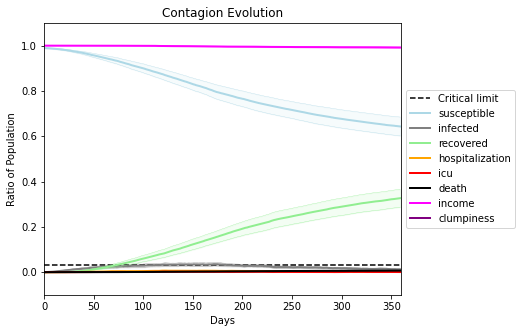

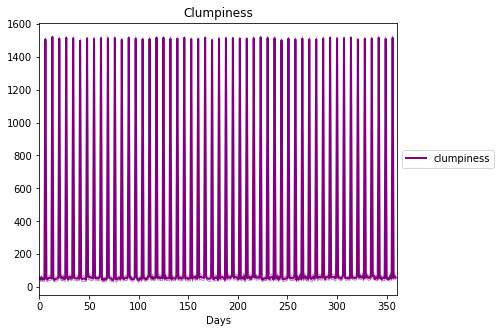

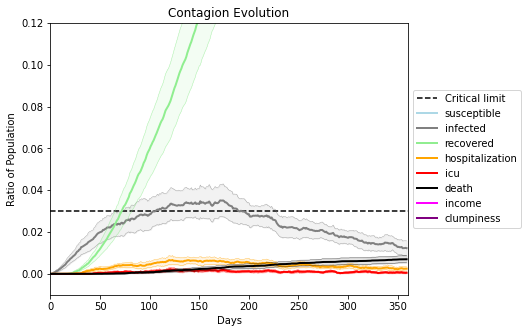

In [23]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.2
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2940, 9838, 6396, 3325, 6360, 5394, 4521, 4992, 1126, 9012, 8292, 1299, 6306, 8541, 945, 2443, 5881, 214, 9240, 8330]
Average similarity between family members is 0.15385476961129413 at temperature -0.1
Average similarity between family and home is 0.9998468537208635 at temperature -1
Average similarity between students and their classroom is 0.1555257924874941 at temperature -0.1
Average classroom occupancy is 1.6705882352941177 and number classrooms is 170
Average similarity between workers is 0.1500036806573399 at temperature -0.1
Average office occupancy is 3.2475247524752477 and number offices is 202
Average friend similarity for adults: 0.21088788499357966 for kids: 0.21508447568165698
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.03180531392009065
avg restaurant similarity 0.021887319749239086
avg restaurant similarity -0.024052594178211317
avg restaurant similarity 0.02262471911675254
avg restaurant similarity 0.1663000412025
avg restaurant similarity 0.08393499246882202
avg restaurant similarity 0.03300514888183796
avg restaurant similarity -0.05647892529460106
avg restaurant similarity 0.05704079838172929
avg restaurant similarity -0.07185695539649568
avg restaurant similarity 0.1498204712457109
avg restaurant similarity -0.163508103673183
avg restaurant similarity -0.13176102532171582
avg restaurant similarity 0.22219739001727784
avg restaurant similarity -0.053350050098353065
avg restaurant similarity 0.16850388284332216
avg restaurant similarity 0.09597777986556154
avg restaurant similarity 0.17633304899986918
avg restaurant similarity 0.0653755688564872
avg restaurant similarity 0.3232262534317755
avg restaurant similarity -0.17866744091792386
avg restaurant similarity 0.12459

avg restaurant similarity -0.04855356177459766
avg restaurant similarity 0.20734015981917214
avg restaurant similarity 0.15720123354542348
avg restaurant similarity 0.13497273800579998
avg restaurant similarity 0.1383836616371227
avg restaurant similarity 0.043284402464679385
avg restaurant similarity 0.0988174299440044
avg restaurant similarity -0.08748484968961792
avg restaurant similarity -0.04902185931406604
avg restaurant similarity -0.1076316681191745
avg restaurant similarity -0.06277034293519113
avg restaurant similarity -0.1536947928401275
avg restaurant similarity -0.06950744592579038
avg restaurant similarity -0.20547411847985278
avg restaurant similarity 0.09630040698862254
avg restaurant similarity 0.016034321727611305
avg restaurant similarity 0.09898930208695364
avg restaurant similarity 0.010630314362058357
avg restaurant similarity -0.09749188564271745
avg restaurant similarity -0.15472711000299366
avg restaurant similarity -0.1182098123554517
avg restaurant similarity

avg restaurant similarity -0.018024222435475995
avg restaurant similarity 0.000659385077170456
avg restaurant similarity 0.018719700288465563
avg restaurant similarity 0.1287425454541
avg restaurant similarity 0.00587887686958014
avg restaurant similarity -0.09964123250075521
Average similarity between family members is 0.1527941838080953 at temperature -0.1
Average similarity between family and home is 0.999859346195624 at temperature -1
Average similarity between students and their classroom is 0.1827659240451974 at temperature -0.1
Average classroom occupancy is 1.5628415300546448 and number classrooms is 183
Average similarity between workers is 0.15761005218420374 at temperature -0.1
Average office occupancy is 3.21 and number offices is 200
Average friend similarity for adults: 0.20972889063047687 for kids: 0.21722196303469793
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 

avg restaurant similarity 0.12402479181847025
avg restaurant similarity 0.11134844054337861
avg restaurant similarity 0.04838599760160828
avg restaurant similarity 0.05740345511079716
avg restaurant similarity -0.2616880392731068
avg restaurant similarity 0.1846513419919651
avg restaurant similarity -0.16183018566132182
avg restaurant similarity 0.16160950204577004
avg restaurant similarity -0.06394916660374414
avg restaurant similarity 0.12424383101206901
avg restaurant similarity 0.12331490561100827
avg restaurant similarity 0.21135567279455847
avg restaurant similarity 0.07979795491741469
avg restaurant similarity -0.07718102093013454
avg restaurant similarity 0.253630137466557
avg restaurant similarity 0.03968244875497224
avg restaurant similarity 0.04507947469862831
avg restaurant similarity 0.09026229768433533
avg restaurant similarity 0.11098052994968695
avg restaurant similarity 0.20921784444701452
avg restaurant similarity 0.17048892670368598
avg restaurant similarity -0.14243

avg restaurant similarity 0.012355216271828805
avg restaurant similarity 0.15328710775776896
avg restaurant similarity 0.11514223064076462
avg restaurant similarity 0.03739729559883314
avg restaurant similarity 0.006959615912262312
avg restaurant similarity 0.21651731768057894
avg restaurant similarity 0.07229721415201502
avg restaurant similarity 0.08593670485661248
avg restaurant similarity 0.010083463145058216
avg restaurant similarity 0.23374898509621703
avg restaurant similarity 0.2972380638219129
avg restaurant similarity 0.2238056601664751
avg restaurant similarity 0.005417343193939286
avg restaurant similarity -0.12616154124062526
avg restaurant similarity -0.062015619209043096
avg restaurant similarity 0.07027433752696627
avg restaurant similarity -0.07418146266937774
avg restaurant similarity -0.037492069053721516
avg restaurant similarity 0.1381479915433712
avg restaurant similarity -0.040675895870287346
avg restaurant similarity 0.09456511146794924
avg restaurant similarity

avg restaurant similarity 0.46496369688351324
avg restaurant similarity 0.032141971106797805
avg restaurant similarity -0.09030200053339836
avg restaurant similarity 0.25914745453484483
avg restaurant similarity 0.07015219191853783
Average similarity between family members is 0.14424823819186813 at temperature -0.1
Average similarity between family and home is 0.9998582952358663 at temperature -1
Average similarity between students and their classroom is 0.14549617995153996 at temperature -0.1
Average classroom occupancy is 1.615819209039548 and number classrooms is 177
Average similarity between workers is 0.14526912115576368 at temperature -0.1
Average office occupancy is 3.34 and number offices is 200
Average friend similarity for adults: 0.20641349242224305 for kids: 0.21080689712174044
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 19 people.
Total of 19 people allocated in th

avg restaurant similarity -0.08069176755826311
avg restaurant similarity 0.1132128121689833
avg restaurant similarity 0.1757426109049182
avg restaurant similarity 0.02074065513878867
avg restaurant similarity 0.07051242539229541
avg restaurant similarity 0.16693959171843728
avg restaurant similarity 0.1398246553748778
avg restaurant similarity 0.011244035077907047
avg restaurant similarity 0.20309297301464557
avg restaurant similarity -0.11298468712048781
avg restaurant similarity 0.0004891393288483648
avg restaurant similarity 0.06287150867713606
avg restaurant similarity 0.07850586343598687
avg restaurant similarity 0.06203057135220295
avg restaurant similarity 0.14166711914591476
avg restaurant similarity -0.08570306491043155
avg restaurant similarity 0.1313915376846545
avg restaurant similarity 0.07000301630358499
avg restaurant similarity 0.19471476679389027
avg restaurant similarity 0.015581307434892696
avg restaurant similarity 0.1446785155342231
avg restaurant similarity 0.2296

avg restaurant similarity 0.19493820883907192
avg restaurant similarity 0.13282558759502466
avg restaurant similarity 0.11932296969437017
avg restaurant similarity 0.26696409507627145
avg restaurant similarity -0.04159466714993212
avg restaurant similarity 0.22228096962475813
avg restaurant similarity 0.24355336929466126
avg restaurant similarity -0.006400473520897239
avg restaurant similarity 0.13081985484011685
avg restaurant similarity 0.19612616135447156
avg restaurant similarity 0.05639252073706215
avg restaurant similarity 0.10410791350384106
avg restaurant similarity 0.341708868146737
avg restaurant similarity 0.20767592424946146
avg restaurant similarity 0.10409234637772025
avg restaurant similarity 0.1557258053452842
avg restaurant similarity 0.12023872438090832
avg restaurant similarity 0.03290695056496458
avg restaurant similarity 0.04415573762171887
avg restaurant similarity -0.002362189314329305
avg restaurant similarity 0.11303754381328394
avg restaurant similarity -0.018

Average similarity between family and home is 0.9998483666927498 at temperature -1
Average similarity between students and their classroom is 0.22367468156626064 at temperature -0.1
Average classroom occupancy is 1.5642458100558658 and number classrooms is 179
Average similarity between workers is 0.14304548439048836 at temperature -0.1
Average office occupancy is 3.3535353535353534 and number offices is 198
Average friend similarity for adults: 0.20600512695033485 for kids: 0.2323043007787352
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 p

avg restaurant similarity 0.0593570001465737
avg restaurant similarity -0.0016289227050860925
avg restaurant similarity 0.05825910240123688
avg restaurant similarity 0.2449836034587518
avg restaurant similarity 0.12225188478737609
avg restaurant similarity 0.07203409896743487
avg restaurant similarity 0.05650162397826376
avg restaurant similarity 0.32564182593289576
avg restaurant similarity 0.13629002299560974
avg restaurant similarity 0.04292501119106257
avg restaurant similarity 0.09174474142547456
avg restaurant similarity 0.10222145391096804
avg restaurant similarity 0.05868803709338108
avg restaurant similarity 0.07047321826133855
avg restaurant similarity 0.10914699487331989
avg restaurant similarity -0.06676823088808448
avg restaurant similarity -0.19437150440346773
avg restaurant similarity 0.1598647472742781
avg restaurant similarity 0.057586580622198236
avg restaurant similarity -0.08441039383297069
avg restaurant similarity 0.07986541156512335
avg restaurant similarity 0.16

avg restaurant similarity 0.23070869728633958
avg restaurant similarity 0.02151976367654123
avg restaurant similarity 0.1276206881308038
avg restaurant similarity -0.013372719344962774
avg restaurant similarity -0.07000932657602972
avg restaurant similarity 0.014059265366909404
avg restaurant similarity 0.24093746740258692
avg restaurant similarity 0.05158636076497083
avg restaurant similarity 0.04939896293745905
avg restaurant similarity 0.1175202215169319
avg restaurant similarity 0.1285052334866578
avg restaurant similarity 0.03507664485101403
avg restaurant similarity 0.22853899714579287
avg restaurant similarity -0.08876486660250356
avg restaurant similarity 0.04032841550082026
avg restaurant similarity 0.15845419596393778
avg restaurant similarity 0.13092037263416495
avg restaurant similarity 0.029853293679723333
avg restaurant similarity 0.06060695967743952
avg restaurant similarity 0.009957748119973566
avg restaurant similarity -0.542928639055311
avg restaurant similarity 0.168

avg restaurant similarity -0.10265415934473175
avg restaurant similarity 0.18279130973258984
avg restaurant similarity 0.15172546677685045
avg restaurant similarity 0.16423946977297912
Average similarity between family members is 0.15882588414860646 at temperature -0.1
Average similarity between family and home is 0.9998625768306939 at temperature -1
Average similarity between students and their classroom is 0.20708379959024273 at temperature -0.1
Average classroom occupancy is 1.631578947368421 and number classrooms is 171
Average similarity between workers is 0.17169804146827686 at temperature -0.1
Average office occupancy is 3.3469387755102042 and number offices is 196
Average friend similarity for adults: 0.20692154309614158 for kids: 0.2132165383903078
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.04022898776810862
avg restaurant similarity 0.139677661007999
avg restaurant similarity 0.49605123797155226
avg restaurant similarity 0.06764533189653435
avg restaurant similarity 0.09792919535905534
avg restaurant similarity 0.1722878901092666
avg restaurant similarity -0.10769045219759836
avg restaurant similarity 0.12852532084141818
avg restaurant similarity 0.14623601080409265
avg restaurant similarity 0.2529431096297229
avg restaurant similarity -0.0005675003048025914
avg restaurant similarity -0.1032616978001705
avg restaurant similarity 0.034019919267495244
avg restaurant similarity 0.008300525858874943
avg restaurant similarity 0.1448587976674105
avg restaurant similarity 0.12379921225826593
avg restaurant similarity 0.047123583040879144
avg restaurant similarity -0.020848310872093986
avg restaurant similarity -0.021527167285995012
avg restaurant similarity 0.2268302617228888
avg restaurant similarity 0.08579911805939562
avg restaurant similarity 0.0

avg restaurant similarity -0.06269845375269506
avg restaurant similarity 0.12079000843812818
avg restaurant similarity 0.32997603086243665
avg restaurant similarity 0.013190399915976272
avg restaurant similarity 0.14211933333377355
avg restaurant similarity 0.19353411470462806
avg restaurant similarity 0.1287239801331189
avg restaurant similarity 0.15009587938805122
avg restaurant similarity -0.06609763342282428
avg restaurant similarity 0.0339858771996357
avg restaurant similarity 0.269235272763194
avg restaurant similarity 0.08520536100945968
avg restaurant similarity -0.034696081075442094
avg restaurant similarity 0.22604646465065564
avg restaurant similarity 0.17692806195338817
avg restaurant similarity 0.17333030344336017
avg restaurant similarity 0.08812640962885611
avg restaurant similarity -0.002341675626571098
avg restaurant similarity 0.10454156140787611
avg restaurant similarity 0.08081223176850816
avg restaurant similarity 0.42332446784620736
avg restaurant similarity 0.177

Average similarity between family members is 0.19970617190695084 at temperature -0.1
Average similarity between family and home is 0.999859615234378 at temperature -1
Average similarity between students and their classroom is 0.16429093641860093 at temperature -0.1
Average classroom occupancy is 1.4886363636363635 and number classrooms is 176
Average similarity between workers is 0.16742033611058013 at temperature -0.1
Average office occupancy is 3.45 and number offices is 200
Average friend similarity for adults: 0.21716365581427563 for kids: 0.21172075990011363
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2,0) district w

avg restaurant similarity -0.08471136708244495
avg restaurant similarity 0.0862494391547655
avg restaurant similarity 0.04530429690702656
avg restaurant similarity 0.31752188860017355
avg restaurant similarity 0.30511275400878696
avg restaurant similarity 0.04235279229657807
avg restaurant similarity 0.1289650691757834
avg restaurant similarity 0.1476886008765749
avg restaurant similarity 0.14751588993388348
avg restaurant similarity -0.12311260081450111
avg restaurant similarity 0.22121372491393387
avg restaurant similarity 0.04837171026919047
avg restaurant similarity 0.030692420990105967
avg restaurant similarity 0.1379073814927237
avg restaurant similarity -0.05758390859405119
avg restaurant similarity 0.09936152692526402
avg restaurant similarity -0.09043565852762692
avg restaurant similarity -0.08613111133386712
avg restaurant similarity 0.3807438527732494
avg restaurant similarity 0.06851529636054353
avg restaurant similarity -0.0077833430727585135
avg restaurant similarity -0.1

avg restaurant similarity 0.15319157573167624
avg restaurant similarity 0.4436827478965492
avg restaurant similarity 0.07362583001403449
avg restaurant similarity 0.016140264505296476
avg restaurant similarity 0.18307686244856344
avg restaurant similarity 0.12870035591064202
avg restaurant similarity 0.16334667484451115
avg restaurant similarity 0.30424635400425465
avg restaurant similarity 0.15465896360980944
avg restaurant similarity 0.33514041614099005
avg restaurant similarity 0.1907580795067149
avg restaurant similarity 0.10285667927143637
avg restaurant similarity 0.11934375378067807
avg restaurant similarity 0.07735255035064643
avg restaurant similarity 0.221682522942634
avg restaurant similarity -0.03005650554184651
avg restaurant similarity 0.07647250964593366
avg restaurant similarity 0.09538859103713143
avg restaurant similarity 0.25572780820768115
avg restaurant similarity 0.048683525201472906
avg restaurant similarity 0.3415788148250837
avg restaurant similarity -0.0459055

Average similarity between students and their classroom is 0.16545054696961123 at temperature -0.1
Average classroom occupancy is 1.65 and number classrooms is 180
Average similarity between workers is 0.1834617876909856 at temperature -0.1
Average office occupancy is 3.227722772277228 and number offices is 202
Average friend similarity for adults: 0.208126843454785 for kids: 0.2192094043092798
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 


avg restaurant similarity 0.13924469578541207
avg restaurant similarity 0.06325030326053067
avg restaurant similarity -0.05412754671641899
avg restaurant similarity 0.12752495890273224
avg restaurant similarity 0.14215963306353105
avg restaurant similarity 0.2896704291914163
avg restaurant similarity 0.14439916400589164
avg restaurant similarity 0.08687019364709395
avg restaurant similarity 0.14884732334585685
avg restaurant similarity 0.1664324854192175
avg restaurant similarity -0.031908063014559215
avg restaurant similarity -0.12346479969034042
avg restaurant similarity 0.21850442602917441
avg restaurant similarity -0.08176512484106659
avg restaurant similarity 0.04488181651451122
avg restaurant similarity -0.11852446111078016
avg restaurant similarity 0.21633697784221942
avg restaurant similarity 0.10226672054578725
avg restaurant similarity 0.13570199971031047
avg restaurant similarity 0.06310026829280578
avg restaurant similarity 0.22096492241595225
avg restaurant similarity 0.05

avg restaurant similarity -0.007573180749831605
avg restaurant similarity 0.06457188575593832
avg restaurant similarity 0.09890023064121538
avg restaurant similarity -0.1430196359910951
avg restaurant similarity 0.3249951469434261
avg restaurant similarity 0.2822556286192558
avg restaurant similarity 0.20109346876608153
avg restaurant similarity 0.06661033956871346
avg restaurant similarity 0.3963458977386511
avg restaurant similarity 0.02928783843287443
avg restaurant similarity 0.2533547888016996
avg restaurant similarity 0.0866907884705149
avg restaurant similarity 0.1511149829862281
avg restaurant similarity 0.2630274473547565
avg restaurant similarity -0.03790014574836288
avg restaurant similarity 0.10363981988761933
avg restaurant similarity 0.09164772894273608
avg restaurant similarity 0.2866711594359066
avg restaurant similarity 0.16047732064451967
avg restaurant similarity 0.0808521816907078
avg restaurant similarity 0.003846291144314532
avg restaurant similarity 0.19119010433

Average similarity between workers is 0.15423526676324895 at temperature -0.1
Average office occupancy is 3.198019801980198 and number offices is 202
Average friend similarity for adults: 0.20628492475174104 for kids: 0.21922057640673315
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 22 people.
Total of 22 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 1 people.
Total of

avg restaurant similarity -0.09242216947552301
avg restaurant similarity 0.2420391718075702
avg restaurant similarity 0.06617821663883645
avg restaurant similarity 0.09311627463936623
avg restaurant similarity 0.11161646950743655
avg restaurant similarity 0.1939043856828969
avg restaurant similarity 0.042803926928373995
avg restaurant similarity 0.1559475667457256
avg restaurant similarity 0.1218308431318905
avg restaurant similarity 0.12477841385358554
avg restaurant similarity 0.09165824149539878
avg restaurant similarity 0.09993761680574019
avg restaurant similarity 0.1214370921992383
avg restaurant similarity 0.11513376581546791
avg restaurant similarity -0.042690882779803686
avg restaurant similarity 0.03240002605813762
avg restaurant similarity 0.03547464216041297
avg restaurant similarity 0.10572321189471076
avg restaurant similarity 0.08810823164525028
avg restaurant similarity 0.09030999323675513
avg restaurant similarity 0.036635595496994314
avg restaurant similarity 0.011742

avg restaurant similarity -0.060419074270850893
avg restaurant similarity -0.07116111460769492
avg restaurant similarity 0.12044076932450141
avg restaurant similarity 0.17270352198010577
avg restaurant similarity -0.010937476640287894
avg restaurant similarity 0.08843269893003122
avg restaurant similarity 0.3737742301069898
avg restaurant similarity 0.1358611559097877
avg restaurant similarity 0.29761587599374834
avg restaurant similarity 0.24480379357800205
avg restaurant similarity -0.03843107090887722
avg restaurant similarity 0.03839625810976973
avg restaurant similarity 0.1739448011011478
avg restaurant similarity 0.16463664932617128
avg restaurant similarity 0.05989780710165761
avg restaurant similarity 0.2057354864017727
avg restaurant similarity 0.35974101614923776
avg restaurant similarity 0.18323160626464496
avg restaurant similarity -0.05251346242424036
avg restaurant similarity 0.058387712802509935
avg restaurant similarity -0.04308592918781933
avg restaurant similarity 0.2

avg restaurant similarity -0.01818667465913687
avg restaurant similarity 0.024314757866956666
Average similarity between family members is 0.17955948503956126 at temperature -0.1
Average similarity between family and home is 0.9998566343434611 at temperature -1
Average similarity between students and their classroom is 0.17224301748085757 at temperature -0.1
Average classroom occupancy is 1.644808743169399 and number classrooms is 183
Average similarity between workers is 0.15329921608110456 at temperature -0.1
Average office occupancy is 3.24 and number offices is 200
Average friend similarity for adults: 0.21449202990263463 for kids: 0.21471392307759873
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with

avg restaurant similarity 0.029067042503072855
avg restaurant similarity 0.19108515493435912
avg restaurant similarity 0.0895566097182767
avg restaurant similarity 0.34590423980696033
avg restaurant similarity 0.12146355493066621
avg restaurant similarity 0.04508616017739622
avg restaurant similarity -0.04101411668928253
avg restaurant similarity 0.1481271343291839
avg restaurant similarity 0.05250905134570721
avg restaurant similarity 0.13506080255355096
avg restaurant similarity -0.017335973792059436
avg restaurant similarity 0.08609005516982732
avg restaurant similarity -0.15563474386028567
avg restaurant similarity -0.06949619018935448
avg restaurant similarity 0.1107498888335678
avg restaurant similarity 0.01623252119405165
avg restaurant similarity 0.1144640840482239
avg restaurant similarity 0.1423751752281897
avg restaurant similarity 0.11547778261119399
avg restaurant similarity -0.01900216991926609
avg restaurant similarity 0.1427287198255846
avg restaurant similarity 0.01588

avg restaurant similarity 0.14399118452798443
avg restaurant similarity 0.18620541332963275
avg restaurant similarity 0.02044810402718436
avg restaurant similarity -0.002552559293250902
avg restaurant similarity 0.0481688891150556
avg restaurant similarity -0.15758563808248321
avg restaurant similarity 0.032115019293175444
avg restaurant similarity 0.1529231177357085
avg restaurant similarity 0.23094951647317422
avg restaurant similarity 0.018212484355775826
avg restaurant similarity 0.234222219457918
avg restaurant similarity 0.08327161111340803
avg restaurant similarity 0.11154099561365846
avg restaurant similarity 0.01633361705437746
avg restaurant similarity 0.10337351306253999
avg restaurant similarity 0.12956331851757158
avg restaurant similarity 0.14047158860651476
avg restaurant similarity -0.04482319333852109
avg restaurant similarity -0.050378132876880886
avg restaurant similarity 0.1953468154259036
avg restaurant similarity 0.30089968301460673
avg restaurant similarity 0.093

avg restaurant similarity 0.016859402368471672
Average similarity between family members is 0.159088343696987 at temperature -0.1
Average similarity between family and home is 0.999860027070447 at temperature -1
Average similarity between students and their classroom is 0.17785203018151993 at temperature -0.1
Average classroom occupancy is 1.5 and number classrooms is 174
Average similarity between workers is 0.1620095551560768 at temperature -0.1
Average office occupancy is 3.427860696517413 and number offices is 201
Average friend similarity for adults: 0.20469836329047555 for kids: 0.22083773073605195
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocate

avg restaurant similarity 0.12567232709630993
avg restaurant similarity 0.18240666897849192
avg restaurant similarity 0.17362729682472203
avg restaurant similarity 0.163422418447851
avg restaurant similarity 0.3753677278703861
avg restaurant similarity 0.30007134998194496
avg restaurant similarity 0.08240454066549378
avg restaurant similarity 0.06002591243421945
avg restaurant similarity -0.12969325246720503
avg restaurant similarity 0.24251307689073587
avg restaurant similarity -0.15614039972294677
avg restaurant similarity 0.04683923845341454
avg restaurant similarity -0.025229467197818937
avg restaurant similarity -0.02342443959049996
avg restaurant similarity 0.34578405619110064
avg restaurant similarity 0.07622252062792395
avg restaurant similarity 0.09271304723200269
avg restaurant similarity 0.061164325428504876
avg restaurant similarity 0.1730081831271141
avg restaurant similarity 0.3631392458020176
avg restaurant similarity 0.2931669375635857
avg restaurant similarity 0.266741

avg restaurant similarity 0.32269493101334573
avg restaurant similarity 0.18264850293846432
avg restaurant similarity 0.14561789910773046
avg restaurant similarity 0.1037037077446132
avg restaurant similarity 0.12691511538233993
avg restaurant similarity 0.24070343551870424
avg restaurant similarity 0.2309806274767141
avg restaurant similarity 0.2559114281078706
avg restaurant similarity -0.1478612022587799
avg restaurant similarity 0.1977569027720243
avg restaurant similarity 0.1397948932156605
avg restaurant similarity 0.0031394051318286015
avg restaurant similarity 0.17586131481681203
avg restaurant similarity 0.011146549371358628
avg restaurant similarity 0.13956279176386552
avg restaurant similarity 0.14922260100076215
avg restaurant similarity 0.17969209537916744
avg restaurant similarity -0.06534507222454661
avg restaurant similarity 0.31406740474900613
avg restaurant similarity -0.09774489533490542
avg restaurant similarity 0.2073452589784582
avg restaurant similarity -0.007851

avg restaurant similarity 0.2014862651090342
avg restaurant similarity 0.059947259740367215
avg restaurant similarity 0.03299140793056479
avg restaurant similarity 0.019193695622804128
avg restaurant similarity -0.16823456139561252
avg restaurant similarity 0.015576395462449941
avg restaurant similarity 0.03519014663322597
avg restaurant similarity -0.07256259205135032
avg restaurant similarity -0.03898909950959251
avg restaurant similarity -0.08867708870595689
avg restaurant similarity -0.06474198774883747
avg restaurant similarity 0.13878653957367862
avg restaurant similarity 0.08958565596311828
avg restaurant similarity 0.10665376024226492
avg restaurant similarity 0.03492353725367293
avg restaurant similarity 0.03281303119380221
avg restaurant similarity 0.08268472837000529
avg restaurant similarity -0.03640411760149923
avg restaurant similarity 0.11576780511131125
avg restaurant similarity 0.2250645286091399
avg restaurant similarity 0.03800550008185319
avg restaurant similarity -

avg restaurant similarity -0.14584971715982442
avg restaurant similarity 0.1762886907450303
avg restaurant similarity -0.10366571398581852
avg restaurant similarity 0.13519962032575658
avg restaurant similarity 0.029249588900773546
avg restaurant similarity 0.04916750777052395
avg restaurant similarity 0.09155908495873073
avg restaurant similarity -0.006327020072100953
avg restaurant similarity -0.038862701538268235
avg restaurant similarity 0.050629895900553355
avg restaurant similarity 0.17569849903582302
avg restaurant similarity 0.2441798588962818
avg restaurant similarity -0.039395024335966845
avg restaurant similarity 0.17848009433106668
avg restaurant similarity 0.08302246426486931
avg restaurant similarity 0.1888845066055573
avg restaurant similarity 0.03215039366053756
avg restaurant similarity -0.004364995889231935
avg restaurant similarity -0.2897964206071101
avg restaurant similarity 0.25799290493148924
avg restaurant similarity -0.018479353543073906
avg restaurant similari

Average similarity between workers is 0.14927182153642782 at temperature -0.1
Average office occupancy is 3.34 and number offices is 200
Average friend similarity for adults: 0.20664646512010185 for kids: 0.19776952136526205
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people all

avg restaurant similarity 0.05039544865973151
avg restaurant similarity 0.04257174853797761
avg restaurant similarity 0.29172417004339507
avg restaurant similarity -0.033999845348639514
avg restaurant similarity 0.015974490327462062
avg restaurant similarity 0.13355798026731142
avg restaurant similarity 0.1922585436217985
avg restaurant similarity 0.23322462289080792
avg restaurant similarity 0.09001015120290395
avg restaurant similarity 0.010822715200396271
avg restaurant similarity 0.03015370497814902
avg restaurant similarity 0.14124458420963898
avg restaurant similarity 0.07193440701406292
avg restaurant similarity 0.13510811287561303
avg restaurant similarity 0.04138202754489605
avg restaurant similarity -0.014978633734836922
avg restaurant similarity 0.08150743299531088
avg restaurant similarity -0.09962445591325576
avg restaurant similarity -0.13469589051631173
avg restaurant similarity -0.0053657787550450515
avg restaurant similarity -0.02484370718162115
avg restaurant similari

avg restaurant similarity 0.08863645146083897
avg restaurant similarity -0.043115057170172805
avg restaurant similarity -0.09172442654433358
avg restaurant similarity 0.02818992644970858
avg restaurant similarity 0.12996282202363976
avg restaurant similarity 0.09810833530601326
avg restaurant similarity 0.043583200175291145
avg restaurant similarity 0.25084615754700773
avg restaurant similarity 0.02419030519556769
avg restaurant similarity 0.19304529434714554
avg restaurant similarity 0.003245140206208154
avg restaurant similarity 0.1367694128818553
avg restaurant similarity 0.06931578731225525
avg restaurant similarity -0.010739230728406352
avg restaurant similarity 0.12877950084494488
avg restaurant similarity 0.23653651582018745
avg restaurant similarity -0.19319440488376735
avg restaurant similarity -0.1427586878035591
avg restaurant similarity 0.018996774377299328
avg restaurant similarity 0.03802089637148244
avg restaurant similarity -0.006259580358332119
avg restaurant similarit

Average similarity between students and their classroom is 0.1598975897013819 at temperature -0.1
Average classroom occupancy is 1.5824175824175823 and number classrooms is 182
Average similarity between workers is 0.1553681655007731 at temperature -0.1
Average office occupancy is 3.301507537688442 and number offices is 199
Average friend similarity for adults: 0.21333729661078057 for kids: 0.2264106044945689
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in t

avg restaurant similarity 0.061170442533129206
avg restaurant similarity 0.032578548236205956
avg restaurant similarity 0.14740014600565854
avg restaurant similarity -0.12499990900809838
avg restaurant similarity 0.30882520959446313
avg restaurant similarity 0.11593859043824264
avg restaurant similarity -0.31655096890913637
avg restaurant similarity 0.14381034211202695
avg restaurant similarity 0.15093623287664534
avg restaurant similarity 0.39022132981685986
avg restaurant similarity 0.1173425456227116
avg restaurant similarity -0.08524503154690072
avg restaurant similarity 0.11953972638664895
avg restaurant similarity 0.2460342637524222
avg restaurant similarity 0.09751510092567568
avg restaurant similarity 0.17116744532447398
avg restaurant similarity 0.07233242737448582
avg restaurant similarity 0.18290538304808796
avg restaurant similarity 0.26816239195923935
avg restaurant similarity 0.07203164254186345
avg restaurant similarity -0.014399336754079381
avg restaurant similarity 0.0

avg restaurant similarity -0.04268253426869836
avg restaurant similarity 0.1446561995448281
avg restaurant similarity -0.11608504804756524
avg restaurant similarity 0.05353713695676257
avg restaurant similarity 0.24987518237133166
avg restaurant similarity -0.03540720003761108
avg restaurant similarity 0.15410440787796809
avg restaurant similarity -0.07318777933882327
avg restaurant similarity -0.144927041108933
avg restaurant similarity 0.16724584675534185
avg restaurant similarity 0.24356212476549885
avg restaurant similarity 0.1325862704889716
avg restaurant similarity 0.04645285527180302
avg restaurant similarity 0.23510777522524645
avg restaurant similarity 0.08022476374257058
avg restaurant similarity 0.1481361126333634
avg restaurant similarity -0.08643780281018117
avg restaurant similarity 0.24554509035380906
avg restaurant similarity 0.17116744532447398
avg restaurant similarity 0.04814426406399777
avg restaurant similarity 0.12309712855785017
avg restaurant similarity 0.16297

avg restaurant similarity 0.03284127228079861
avg restaurant similarity 0.09869089041522275
avg restaurant similarity -0.05970481400558145
avg restaurant similarity 0.061973758064717215
avg restaurant similarity 0.049200582096959884
avg restaurant similarity 0.1574594861139869
avg restaurant similarity 0.0484911970461464
avg restaurant similarity 0.20369868159959661
avg restaurant similarity 0.11676460507355628
avg restaurant similarity -0.008989049032004131
avg restaurant similarity 0.13819871785520463
avg restaurant similarity 0.3012223377204901
avg restaurant similarity 0.21522550493310721
avg restaurant similarity 0.19736556321876844
avg restaurant similarity 0.12020565950248208
avg restaurant similarity -0.0572083538211927
avg restaurant similarity 0.432146203606212
avg restaurant similarity 0.04816431417208489
avg restaurant similarity -0.17348612746376946
avg restaurant similarity 0.2328455490935252
avg restaurant similarity 0.25091099087788465
avg restaurant similarity 0.179894

avg restaurant similarity 0.08061910768759946
avg restaurant similarity 0.016706407040650857
avg restaurant similarity 0.11809364932495833
avg restaurant similarity -0.04850790019836009
avg restaurant similarity -0.10881259375112577
avg restaurant similarity -0.07596092493849209
avg restaurant similarity 0.11693552037849403
avg restaurant similarity 0.1890537903489514
avg restaurant similarity 0.05828584963095214
avg restaurant similarity 0.14426002904540022
avg restaurant similarity 0.29349421430538347
avg restaurant similarity 0.24856567925829257
avg restaurant similarity 0.04999516204691235
avg restaurant similarity 0.028293449273569877
avg restaurant similarity 0.22456063950501431
avg restaurant similarity 0.07417011254671275
avg restaurant similarity 0.10684549744839002
avg restaurant similarity 0.052200204418838596
avg restaurant similarity -0.1681797408061958
avg restaurant similarity 0.08149231373638517
avg restaurant similarity 0.15272168752646662
avg restaurant similarity 0.2

Average similarity between students and their classroom is 0.19125121840708947 at temperature -0.1
Average classroom occupancy is 1.5789473684210527 and number classrooms is 190
Average similarity between workers is 0.1686634232945679 at temperature -0.1
Average office occupancy is 3.206896551724138 and number offices is 203
Average friend similarity for adults: 0.20555912134875823 for kids: 0.2204492238113899
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated i

avg restaurant similarity -0.025713477373159207
avg restaurant similarity 0.021082744760262402
avg restaurant similarity 0.23138495862624306
avg restaurant similarity 0.1866412369027416
avg restaurant similarity 0.12192318316266618
avg restaurant similarity 0.06208891154601227
avg restaurant similarity 0.054665906272103236
avg restaurant similarity -0.06831136441430045
avg restaurant similarity 0.0298010671514842
avg restaurant similarity 0.09189285320694074
avg restaurant similarity 0.09474513798071126
avg restaurant similarity -0.006288996026258167
avg restaurant similarity 0.15641292421788122
avg restaurant similarity 0.11206531309906322
avg restaurant similarity 0.13043374873011357
avg restaurant similarity -0.03333930235346785
avg restaurant similarity 0.03168814659207445
avg restaurant similarity 0.1963091658049781
avg restaurant similarity 0.11557356154943088
avg restaurant similarity 0.29716728184965047
avg restaurant similarity 0.0943690180018577
avg restaurant similarity 0.13

avg restaurant similarity 0.15082549714293556
avg restaurant similarity 0.09117094167604375
avg restaurant similarity 0.02214194342084501
avg restaurant similarity 0.027571706283351413
avg restaurant similarity 0.023930398081985774
avg restaurant similarity 0.16238323158835874
avg restaurant similarity -0.15724683203982168
avg restaurant similarity 0.055124770566899364
avg restaurant similarity 0.20940177531648396
avg restaurant similarity 0.2748003470422416
avg restaurant similarity 0.258819387715401
avg restaurant similarity 0.20202923001711667
avg restaurant similarity -0.002513329004119424
avg restaurant similarity 0.1541898204367062
avg restaurant similarity 0.061239435834718255
avg restaurant similarity 0.0385286771234338
avg restaurant similarity -0.11211770227050014
avg restaurant similarity 0.10247577344204134
avg restaurant similarity 0.2916826051290478
avg restaurant similarity 0.31917565903941875
avg restaurant similarity 0.11057164278353955
avg restaurant similarity 0.0899

avg restaurant similarity -0.1747969516570106
avg restaurant similarity -0.08428798332629282
avg restaurant similarity 0.265540463227719
Average similarity between family members is 0.16855472408144448 at temperature -0.1
Average similarity between family and home is 0.9998600374163295 at temperature -1
Average similarity between students and their classroom is 0.17678917781715703 at temperature -0.1
Average classroom occupancy is 1.5480225988700564 and number classrooms is 177
Average similarity between workers is 0.18604119922625303 at temperature -0.1
Average office occupancy is 3.2572815533980584 and number offices is 206
Average friend similarity for adults: 0.2180240092268305 for kids: 0.2171454673286354
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 23 people.
Total of 23 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.2948587355981837
avg restaurant similarity 0.25320768257693477
avg restaurant similarity 0.26835098149673503
avg restaurant similarity -0.0809357154587361
avg restaurant similarity 0.18431855319967852
avg restaurant similarity 0.059762567367448234
avg restaurant similarity -0.002912139917928991
avg restaurant similarity 0.12267695120541307
avg restaurant similarity 0.18443773244995484
avg restaurant similarity 0.07710432016617831
avg restaurant similarity 0.1725607170281392
avg restaurant similarity 0.3750198424282491
avg restaurant similarity 0.1709404097468142
avg restaurant similarity 0.17972794209870202
avg restaurant similarity 0.24066157830508464
avg restaurant similarity 0.28131411129241424
avg restaurant similarity 0.12221440885679327
avg restaurant similarity 0.16510224739314192
avg restaurant similarity -0.3596267525437061
avg restaurant similarity 0.13827143467338565
avg restaurant similarity 0.06946140359677803
avg restaurant similarity 0.1376670

avg restaurant similarity 0.1831297805331956
avg restaurant similarity -0.05300389599961007
avg restaurant similarity 0.1941734788591487
avg restaurant similarity 0.10027219096246387
avg restaurant similarity 0.344045015772097
avg restaurant similarity -0.0351822805726447
avg restaurant similarity 0.01918625520574309
avg restaurant similarity 0.49751928433884507
avg restaurant similarity 0.25426257940207403
avg restaurant similarity 0.12204980308650965
avg restaurant similarity -0.1333415886625347
avg restaurant similarity -0.07409209892250916
avg restaurant similarity 0.038583202535743544
avg restaurant similarity -0.0516210020124371
avg restaurant similarity -0.0463972964164244
avg restaurant similarity 0.1015086454227705
avg restaurant similarity 0.12650667590654346
avg restaurant similarity 0.15990609905709594
avg restaurant similarity -0.1567365512233646
avg restaurant similarity 0.05071845748388508
avg restaurant similarity 0.2249026912231977
avg restaurant similarity -0.08260965

Average similarity between students and their classroom is 0.1550822136793308 at temperature -0.1
Average classroom occupancy is 1.6111111111111112 and number classrooms is 180
Average similarity between workers is 0.17603117639980662 at temperature -0.1
Average office occupancy is 3.242574257425743 and number offices is 202
Average friend similarity for adults: 0.20561770672330834 for kids: 0.2109139710629724
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in 

avg restaurant similarity 0.16168427637188587
avg restaurant similarity 0.2565752662047538
avg restaurant similarity 0.3033463611649131
avg restaurant similarity 0.05888464393948709
avg restaurant similarity 0.16758217663064087
avg restaurant similarity 0.0632909920536849
avg restaurant similarity 0.11218106848020623
avg restaurant similarity 0.12473082628908284
avg restaurant similarity 0.1621301018116556
avg restaurant similarity 0.18756904236814154
avg restaurant similarity 0.18514232204072595
avg restaurant similarity 0.09570490049767741
avg restaurant similarity 0.08282353328466663
avg restaurant similarity 0.0681097038713087
avg restaurant similarity 0.0412073241431738
avg restaurant similarity 0.2777711501073947
avg restaurant similarity 0.5112880989329673
avg restaurant similarity 0.05308832769987202
avg restaurant similarity 0.1038974195386726
avg restaurant similarity 0.13045083604344776
avg restaurant similarity 0.04705078110932859
avg restaurant similarity 0.081591579803249

avg restaurant similarity 0.040457754303275736
avg restaurant similarity 0.20359728153159165
avg restaurant similarity 0.12482367023542275
avg restaurant similarity 0.18431563397396517
avg restaurant similarity 0.16887543135265576
avg restaurant similarity -0.01407105119300082
avg restaurant similarity 0.04400065513983577
avg restaurant similarity 0.2132058077144331
avg restaurant similarity -0.010764829468856789
avg restaurant similarity 0.42646972063365335
avg restaurant similarity 0.01171493506318711
avg restaurant similarity 0.22041474807935507
avg restaurant similarity -0.09790747450757799
avg restaurant similarity 0.031644566512220036
avg restaurant similarity 0.21022348722713896
avg restaurant similarity -0.05616360599802638
avg restaurant similarity 0.16942318541167478
avg restaurant similarity -0.059987435893365325
avg restaurant similarity 0.047314569038846704
avg restaurant similarity 0.010513283741061327
avg restaurant similarity 0.02242877623864381
avg restaurant similarit

avg restaurant similarity 0.10412132677062913
avg restaurant similarity 0.12811686185265972
Average similarity between family members is 0.17080605311211378 at temperature -0.1
Average similarity between family and home is 0.9998494224065108 at temperature -1
Average similarity between students and their classroom is 0.1638009569644035 at temperature -0.1
Average classroom occupancy is 1.595505617977528 and number classrooms is 178
Average similarity between workers is 0.15523993504291897 at temperature -0.1
Average office occupancy is 3.2941176470588234 and number offices is 204
Average friend similarity for adults: 0.2145750833479525 for kids: 0.20802286228175806
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocate

avg restaurant similarity 0.160326623345679
avg restaurant similarity -0.1091204207097783
avg restaurant similarity 0.08020930894694439
avg restaurant similarity 0.14762370018665347
avg restaurant similarity 0.16204218044081578
avg restaurant similarity 0.028827807111004373
avg restaurant similarity 0.07982668883976869
avg restaurant similarity 0.16585363393323002
avg restaurant similarity 0.016449009209523635
avg restaurant similarity 0.08647866431778475
avg restaurant similarity 0.15239482471311294
avg restaurant similarity -0.0733852966506558
avg restaurant similarity 0.26633509737643807
avg restaurant similarity 0.08573236438745407
avg restaurant similarity 0.04245940709867912
avg restaurant similarity 0.07332338572853833
avg restaurant similarity 0.05373504806935817
avg restaurant similarity 0.35279735821318137
avg restaurant similarity 0.14981356350873634
avg restaurant similarity 0.14487583093585202
avg restaurant similarity 0.23243297333065463
avg restaurant similarity 0.113946

avg restaurant similarity 0.35023777266481954
avg restaurant similarity 0.21366196757594627
avg restaurant similarity -0.029357483230003985
avg restaurant similarity 0.09819945256069093
avg restaurant similarity 0.13179924101693277
avg restaurant similarity 0.31406590975469567
avg restaurant similarity -0.0543334257071026
avg restaurant similarity 0.002386568946326519
avg restaurant similarity 0.1060069588389372
avg restaurant similarity -0.0033030034678905103
avg restaurant similarity 0.17939595381289097
avg restaurant similarity 0.027697634660555557
avg restaurant similarity 0.0108103961204306
avg restaurant similarity 0.11362482913241315
avg restaurant similarity 0.13740918686259213
avg restaurant similarity 0.14035296492136376
avg restaurant similarity 0.039825735252057556
avg restaurant similarity -0.04331568119501608
avg restaurant similarity 0.30285053137988577
avg restaurant similarity -0.018104692272072224
avg restaurant similarity -0.18370644244861475
avg restaurant similarit

avg restaurant similarity 0.2098138008225409
Average similarity between family members is 0.13060192974580115 at temperature -0.1
Average similarity between family and home is 0.9998615410591595 at temperature -1
Average similarity between students and their classroom is 0.1683931381389238 at temperature -0.1
Average classroom occupancy is 1.6022727272727273 and number classrooms is 176
Average similarity between workers is 0.1387794966302994 at temperature -0.1
Average office occupancy is 3.38659793814433 and number offices is 194
Average friend similarity for adults: 0.20592812062418875 for kids: 0.20716813684100147
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peo

avg restaurant similarity 0.1690206262577022
avg restaurant similarity -0.10890550706059891
avg restaurant similarity -0.0016706021159018974
avg restaurant similarity -0.09422439072400349
avg restaurant similarity 0.18930665604103247
avg restaurant similarity -0.13027858037782344
avg restaurant similarity -0.1767708106624419
avg restaurant similarity 0.05001509680131159
avg restaurant similarity -0.04282713139152489
avg restaurant similarity -0.005614356877192514
avg restaurant similarity 0.20527973868527988
avg restaurant similarity 0.06702498075696453
avg restaurant similarity 0.05015216656281081
avg restaurant similarity 0.06503849681884055
avg restaurant similarity 0.39253419900646025
avg restaurant similarity 0.04918533366727757
avg restaurant similarity 0.011632056963293643
avg restaurant similarity -0.05410274962556697
avg restaurant similarity 0.07519711303920122
avg restaurant similarity -0.0842559209187597
avg restaurant similarity 0.15622226571803569
avg restaurant similarit

avg restaurant similarity 0.05492047788915755
avg restaurant similarity -0.005466618762491063
avg restaurant similarity -0.09852447086002808
avg restaurant similarity -0.11774639386545957
avg restaurant similarity 0.15737448852211583
avg restaurant similarity 0.04451989855013776
avg restaurant similarity -0.23394006323056815
avg restaurant similarity 0.13643290680027445
avg restaurant similarity -0.05636163775515439
avg restaurant similarity 0.0199300916602537
avg restaurant similarity -0.050235962471791545
avg restaurant similarity -0.3120729549110757
avg restaurant similarity 0.10863058232669366
avg restaurant similarity -0.007699854481193424
avg restaurant similarity 0.11308694351794527
avg restaurant similarity -0.07046526152356214
avg restaurant similarity 0.024977135536402753
avg restaurant similarity -0.12395947247961514
avg restaurant similarity 0.06440781567906015
avg restaurant similarity -0.3652123091124937
avg restaurant similarity 0.021146086117329096
avg restaurant simila

Average similarity between family members is 0.1669342352173321 at temperature -0.1
Average similarity between family and home is 0.9998622470917788 at temperature -1
Average similarity between students and their classroom is 0.12943180189165646 at temperature -0.1
Average classroom occupancy is 1.6174863387978142 and number classrooms is 183
Average similarity between workers is 0.14530703304365686 at temperature -0.1
Average office occupancy is 3.323232323232323 and number offices is 198
Average friend similarity for adults: 0.20661636133748743 for kids: 0.2042187584838938
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) 

avg restaurant similarity 0.2497050148974959
avg restaurant similarity -0.0035188586230847163
avg restaurant similarity 0.143824567086731
avg restaurant similarity 0.07190707491656809
avg restaurant similarity 0.5371789944001031
avg restaurant similarity 0.33665810615138364
avg restaurant similarity 0.111601370640049
avg restaurant similarity 0.14590344694223445
avg restaurant similarity 0.1293245162561099
avg restaurant similarity -0.017029638775199397
avg restaurant similarity 0.0454633121421632
avg restaurant similarity 0.18737891045691274
avg restaurant similarity -0.015434947255075817
avg restaurant similarity 0.29930245190954125
avg restaurant similarity -0.10642279480219677
avg restaurant similarity 0.051170742676745457
avg restaurant similarity 0.14130719526229002
avg restaurant similarity 0.10454403854656065
avg restaurant similarity 0.05464671252535262
avg restaurant similarity 0.056370614603493165
avg restaurant similarity -0.07339874423596249
avg restaurant similarity -0.18

avg restaurant similarity 0.3048524833085911
avg restaurant similarity 0.10231247918628195
avg restaurant similarity -0.16979861510335711
avg restaurant similarity -0.12229351619505469
avg restaurant similarity 0.14658763957042212
avg restaurant similarity 0.033570012279675696
avg restaurant similarity 0.07531309576354411
avg restaurant similarity 0.2146486192519113
avg restaurant similarity 0.08626293447493018
avg restaurant similarity 0.0438508230569105
avg restaurant similarity 0.14655325878696956
avg restaurant similarity -0.04400181342823204
avg restaurant similarity 0.015427176832861362
avg restaurant similarity 0.02970080884774541
avg restaurant similarity -0.008984245367879654
avg restaurant similarity 0.146638341696972
avg restaurant similarity 0.037224722121737434
avg restaurant similarity 0.11799612935409629
avg restaurant similarity 0.1281198415319621
avg restaurant similarity 0.2267307795523285
avg restaurant similarity -0.06886110507897816
avg restaurant similarity 0.2087

avg restaurant similarity 0.13915462900289768
using average of time series:
stats on susceptible:
data: [0.8373833333333333, 0.8355750000000001, 0.801775, 0.8277223331115547, 0.7095222222222222, 0.8305305555555557, 0.8043305555555554, 0.8966277777777778, 0.7236722222222222, 0.691725, 0.8147158397158397, 0.7170305555555555, 0.8313722222222222, 0.766087269904635, 0.7880666666666667, 0.7395507920682397, 0.8828060828060827, 0.8734055555555555, 0.7059972222222222, 0.8642381902860946]
min:
0.691725
max:
0.8966277777777778
std:
0.06226168822909107
mean:
0.7971067198390667
median:
0.8095231976356976
95% confidence interval for the mean:
(0.7672103600428237,0.8270030796353096)
using average of time series:
stats on infected:
data: [0.01567222222222222, 0.018422222222222225, 0.022983333333333335, 0.017966844089598585, 0.03238055555555556, 0.020936111111111114, 0.02657777777777778, 0.014680555555555556, 0.028202777777777778, 0.030955555555555563, 0.020784770784770784, 0.03171666666666667, 0.02110

(<function dict.items>, <function dict.items>, <function dict.items>)

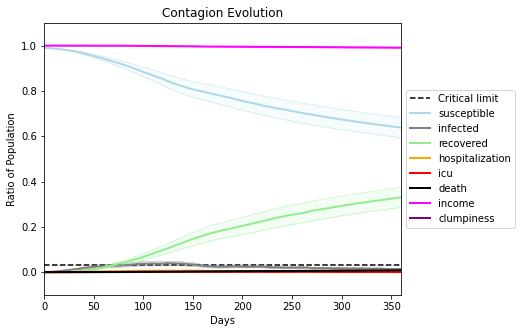

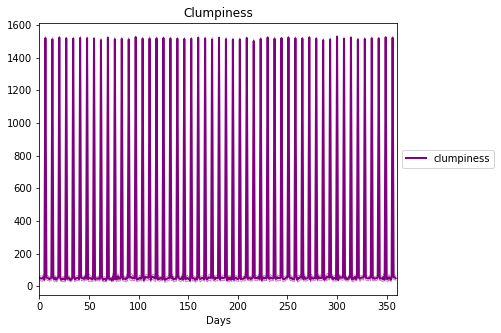

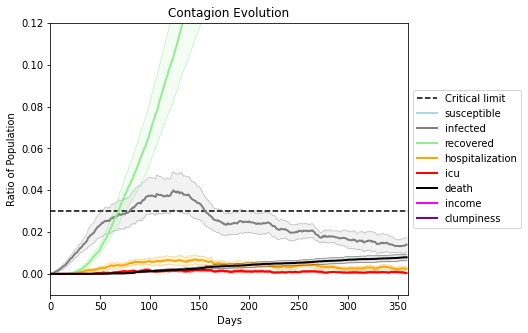

In [24]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[726, 9914, 9377, 525, 1448, 4325, 3852, 5731, 5892, 352, 1400, 4638, 3588, 1198, 1774, 4915, 7048, 5387, 188, 2499]
Average similarity between family members is 0.15227377019878954 at temperature 0
Average similarity between family and home is 0.9998515429363599 at temperature -1
Average similarity between students and their classroom is 0.1559046626405722 at temperature 0
Average classroom occupancy is 1.6335403726708075 and number classrooms is 161
Average similarity between workers is 0.1451266764328312 at temperature 0
Average office occupancy is 3.2857142857142856 and number offices is 203
Average friend similarity for adults: 0.20951463431059078 for kids: 0.20699418089249688
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneo

avg restaurant similarity 0.13081686336837953
avg restaurant similarity -0.3160112866480685
avg restaurant similarity 0.0010594734026235174
avg restaurant similarity -0.07977342721128222
avg restaurant similarity 0.13194285641904993
avg restaurant similarity 0.1204567426844849
avg restaurant similarity -0.01917802197586035
avg restaurant similarity -0.01854260194271647
avg restaurant similarity 0.10946573450694998
avg restaurant similarity 0.15324412698471554
avg restaurant similarity 0.4869743182710765
avg restaurant similarity 0.37745641312423994
avg restaurant similarity 0.021330926007146547
avg restaurant similarity 0.25206918984645216
avg restaurant similarity 0.04753989397163508
avg restaurant similarity 0.25328238935291847
avg restaurant similarity 0.07044195620401154
avg restaurant similarity 0.10216208117843299
avg restaurant similarity -0.10751677420906157
avg restaurant similarity 0.00825842749484532
avg restaurant similarity 0.11330870332568677
avg restaurant similarity 0.1

avg restaurant similarity 0.22351616554370848
avg restaurant similarity 0.242311117069012
avg restaurant similarity 0.06013579686806184
avg restaurant similarity 0.10306944304790186
avg restaurant similarity -0.19000017701369593
avg restaurant similarity -0.21274800632860186
avg restaurant similarity -0.04247781279518793
avg restaurant similarity 0.06280385081547736
avg restaurant similarity 0.007518378963158777
avg restaurant similarity 0.086778656997507
avg restaurant similarity 0.15650462700482298
avg restaurant similarity 0.16201500456541626
avg restaurant similarity 0.04258132036215591
avg restaurant similarity 0.3203202577009904
avg restaurant similarity -0.06139249170013644
avg restaurant similarity 0.25067776342939485
avg restaurant similarity 0.12418953842349414
avg restaurant similarity 0.12811821790147318
avg restaurant similarity 0.17629518838991887
avg restaurant similarity 0.17820783452674424
avg restaurant similarity 0.10135061418940211
avg restaurant similarity 0.031487

avg restaurant similarity -0.01416459192062506
avg restaurant similarity -0.08542339777165339
avg restaurant similarity 0.23120701908157917
avg restaurant similarity 0.048977795132463864
avg restaurant similarity 0.1434245486887774
avg restaurant similarity 0.23175454108918725
avg restaurant similarity 0.5200465215441856
avg restaurant similarity 0.008419251461378575
avg restaurant similarity 0.14489256007658383
avg restaurant similarity 0.01808048565910474
avg restaurant similarity 0.0530692787539715
avg restaurant similarity 0.25099238065445173
avg restaurant similarity 0.293100303323893
avg restaurant similarity 0.11591195504359479
avg restaurant similarity 0.07407503937811713
avg restaurant similarity 0.020708061625587332
avg restaurant similarity 0.19881364623841788
avg restaurant similarity 0.1008448988699492
avg restaurant similarity 0.13192052010821853
avg restaurant similarity 0.15781556727427265
avg restaurant similarity 0.014826518346374128
avg restaurant similarity 0.167738

avg restaurant similarity 0.10164199421310406
avg restaurant similarity 0.16937849668231866
avg restaurant similarity 0.08026831903638254
avg restaurant similarity 0.07942793811883782
avg restaurant similarity 0.1745352985987477
avg restaurant similarity 0.10539244578667142
avg restaurant similarity 0.03319811361272424
avg restaurant similarity 0.04225359015394258
avg restaurant similarity -0.06870272618855915
avg restaurant similarity -0.10732693436472392
avg restaurant similarity 0.08521971497990259
avg restaurant similarity -0.06371489467598099
avg restaurant similarity -0.16457140042049434
avg restaurant similarity 0.12192585150854036
avg restaurant similarity -0.13599788262605433
avg restaurant similarity 0.1922073508651909
avg restaurant similarity 0.198142228846514
avg restaurant similarity 0.21905334071508295
avg restaurant similarity 0.012368625140919246
avg restaurant similarity 0.05757230944865261
avg restaurant similarity 0.17377446008539654
avg restaurant similarity 0.0974

avg restaurant similarity 0.057725692434437925
avg restaurant similarity 0.17691685102931498
avg restaurant similarity 0.1836778443024159
Average similarity between family members is 0.14667940891631673 at temperature 0
Average similarity between family and home is 0.9998663083753265 at temperature -1
Average similarity between students and their classroom is 0.13870729742149368 at temperature 0
Average classroom occupancy is 1.625 and number classrooms is 176
Average similarity between workers is 0.16348739033341525 at temperature 0
Average office occupancy is 3.3316582914572863 and number offices is 199
Average friend similarity for adults: 0.21595235697194332 for kids: 0.21155500020285684
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacit

avg restaurant similarity 0.12143808263257438
avg restaurant similarity -0.13877352511188235
avg restaurant similarity 0.05362397116356942
avg restaurant similarity 0.044296640619374814
avg restaurant similarity 0.10292045954497585
avg restaurant similarity 0.06897740542413545
avg restaurant similarity -0.04804174174970967
avg restaurant similarity 0.04410298371135034
avg restaurant similarity 0.04117816774084265
avg restaurant similarity 0.08453785650706797
avg restaurant similarity -0.05411572086504754
avg restaurant similarity -0.06893953861139192
avg restaurant similarity 0.024801721432332637
avg restaurant similarity -0.004846364011665069
avg restaurant similarity 0.03689462679321272
avg restaurant similarity 0.3358328961165523
avg restaurant similarity 0.13212821015342774
avg restaurant similarity 0.1175528013102785
avg restaurant similarity 0.019348944888259525
avg restaurant similarity 0.15333849952413256
avg restaurant similarity 0.06048132844848594
avg restaurant similarity 0

avg restaurant similarity -0.023247343877043802
avg restaurant similarity -0.05242764438337693
avg restaurant similarity 0.03629031590856782
avg restaurant similarity 0.13482286831762377
avg restaurant similarity 0.25117596889800187
avg restaurant similarity -0.06340644886389733
avg restaurant similarity -0.06967701010480899
avg restaurant similarity -0.005974522348112457
avg restaurant similarity -0.035548656836124716
avg restaurant similarity 0.05234758622831323
avg restaurant similarity 0.325780311836439
avg restaurant similarity 0.10504080412563768
avg restaurant similarity -0.08805842025480527
avg restaurant similarity 0.05430622895737736
avg restaurant similarity 0.14219835284096663
avg restaurant similarity -0.12051998330561427
avg restaurant similarity 0.0026601937886377804
avg restaurant similarity 0.05786733794904244
avg restaurant similarity 0.012972203286274972
avg restaurant similarity 0.1822480501721817
avg restaurant similarity 0.10359427781924453
avg restaurant similari

avg restaurant similarity 0.11764053525759939
Average similarity between family members is 0.17532539804886568 at temperature 0
Average similarity between family and home is 0.9998601641323634 at temperature -1
Average similarity between students and their classroom is 0.17313956978731732 at temperature 0
Average classroom occupancy is 1.5411764705882354 and number classrooms is 170
Average similarity between workers is 0.16189809590086615 at temperature 0
Average office occupancy is 3.398009950248756 and number offices is 201
Average friend similarity for adults: 0.2216876012015682 for kids: 0.2301369696356969
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people a

avg restaurant similarity 0.047325433986416504
avg restaurant similarity 0.13758039693100949
avg restaurant similarity 0.09584741109671593
avg restaurant similarity 0.052170603224261466
avg restaurant similarity 0.04785667603555919
avg restaurant similarity 0.1788965047620436
avg restaurant similarity 0.08007941399003092
avg restaurant similarity 0.022751484501177907
avg restaurant similarity 0.32838253112322024
avg restaurant similarity 0.11375962183368608
avg restaurant similarity 0.08313163629314618
avg restaurant similarity 0.06378456716850049
avg restaurant similarity 0.1123669663495969
avg restaurant similarity 0.067717441404206
avg restaurant similarity 0.1303392945609412
avg restaurant similarity 0.2247871421026031
avg restaurant similarity 0.12177155855370632
avg restaurant similarity 0.2586804390429679
avg restaurant similarity 0.17421088643562943
avg restaurant similarity 0.2494512638427599
avg restaurant similarity 0.1431863660985657
avg restaurant similarity 0.044017767963

avg restaurant similarity 0.013386429346846807
avg restaurant similarity 0.009569258149864647
avg restaurant similarity 0.09804801751665732
avg restaurant similarity 0.15469860372947233
avg restaurant similarity 0.15984974801524846
avg restaurant similarity 0.03371558373443957
avg restaurant similarity 0.2184193290967743
avg restaurant similarity 0.19662442303208205
avg restaurant similarity 0.025974839305327735
avg restaurant similarity 0.10903806779064287
avg restaurant similarity 0.059894735793412125
avg restaurant similarity 0.037618387408252636
avg restaurant similarity 0.32028800691932563
avg restaurant similarity 0.36173537820896007
avg restaurant similarity 0.3248858679463399
avg restaurant similarity 0.1161628715926469
avg restaurant similarity 0.2071742517620757
avg restaurant similarity 0.3824517536558939
avg restaurant similarity 0.1469880844458789
avg restaurant similarity 0.16400343284346033
avg restaurant similarity 0.14493161703228913
avg restaurant similarity 0.2127962

avg restaurant similarity 0.1305011670864173
avg restaurant similarity 0.04146163064702353
avg restaurant similarity -0.24731500576659743
Average similarity between family members is 0.16367343737454335 at temperature 0
Average similarity between family and home is 0.9998537955497758 at temperature -1
Average similarity between students and their classroom is 0.1669551256983458 at temperature 0
Average classroom occupancy is 1.6145833333333333 and number classrooms is 192
Average similarity between workers is 0.15241867474439866 at temperature 0
Average office occupancy is 3.2081218274111674 and number offices is 197
Average friend similarity for adults: 0.2151289515029976 for kids: 0.21321631726089774
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each wit

avg restaurant similarity 0.06718062486381982
avg restaurant similarity -0.023549967531471865
avg restaurant similarity 0.03454504324313616
avg restaurant similarity 0.14422422044983044
avg restaurant similarity 0.2373034504356817
avg restaurant similarity -0.019462231653188975
avg restaurant similarity 0.009483534120310689
avg restaurant similarity 0.3155594927887505
avg restaurant similarity 0.10943380463817888
avg restaurant similarity 0.19703875712067848
avg restaurant similarity 0.2344143733924854
avg restaurant similarity 0.14217194552593218
avg restaurant similarity 0.5125838418979338
avg restaurant similarity -0.059292465689951834
avg restaurant similarity 0.07502911458398352
avg restaurant similarity 0.1402429541267363
avg restaurant similarity -0.013904395114853854
avg restaurant similarity 0.15009650321874263
avg restaurant similarity 0.05525202748293524
avg restaurant similarity -0.036386069719042374
avg restaurant similarity 0.15243283822204812
avg restaurant similarity 0.

avg restaurant similarity 0.23446953858786393
avg restaurant similarity 0.5041283677136253
avg restaurant similarity -0.0047258232456747025
avg restaurant similarity 0.015768717077262486
avg restaurant similarity -0.11552092656122923
avg restaurant similarity 0.686408846082044
avg restaurant similarity 0.20167810631045252
avg restaurant similarity -0.032971600873041865
avg restaurant similarity 0.06633157449388218
avg restaurant similarity 0.12795049853979967
avg restaurant similarity 0.017855787149125904
avg restaurant similarity 0.37933525268821455
avg restaurant similarity 0.09535068286348208
avg restaurant similarity 0.050877075719562175
avg restaurant similarity 0.04003026084438748
avg restaurant similarity 0.16400807705163808
avg restaurant similarity 0.11311388246906039
avg restaurant similarity -0.09342733029728606
avg restaurant similarity 0.04691123515118502
avg restaurant similarity 0.09423091519444304
avg restaurant similarity 0.12230167074450646
avg restaurant similarity 0

Average similarity between workers is 0.17071985003822043 at temperature 0
Average office occupancy is 3.1853658536585368 and number offices is 205
Average friend similarity for adults: 0.21778369783121132 for kids: 0.22903751932248115
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 peopl

avg restaurant similarity 0.11109001553841093
avg restaurant similarity 0.047919121299681976
avg restaurant similarity 0.15607678445658119
avg restaurant similarity 0.13666329470550348
avg restaurant similarity 0.2755668600629895
avg restaurant similarity 0.1938357776279949
avg restaurant similarity 0.06361159960218915
avg restaurant similarity 0.21034242148345184
avg restaurant similarity -0.1620411118502881
avg restaurant similarity 0.12942988346135517
avg restaurant similarity 0.11884378709215433
avg restaurant similarity 0.08391378184956359
avg restaurant similarity 0.2341916542363956
avg restaurant similarity -0.05967236294780157
avg restaurant similarity 0.08631429019771876
avg restaurant similarity 0.3222082227646772
avg restaurant similarity 0.19901397453285802
avg restaurant similarity 0.2255368453228117
avg restaurant similarity 0.1308818082529588
avg restaurant similarity -0.0657167297007193
avg restaurant similarity 0.12763789233288245
avg restaurant similarity 0.0171538114

avg restaurant similarity -0.06180383466091396
avg restaurant similarity 0.244060532562599
avg restaurant similarity 0.037595441776518
avg restaurant similarity -0.04270482466762608
avg restaurant similarity 0.3051423581799706
avg restaurant similarity 0.13465768332942712
avg restaurant similarity 0.27699384656883963
avg restaurant similarity 0.40753887302947256
avg restaurant similarity 0.047941491648613256
avg restaurant similarity 0.030303209200933445
avg restaurant similarity 0.2678783794906738
avg restaurant similarity -0.06069682268316859
avg restaurant similarity 0.04706573786544371
avg restaurant similarity 0.09989798243338253
avg restaurant similarity 0.11746604223361544
avg restaurant similarity 0.137668423307024
avg restaurant similarity -0.1259470850403105
avg restaurant similarity 0.4376872068187551
avg restaurant similarity 0.028404857763911728
avg restaurant similarity -0.004451193951774046
avg restaurant similarity 0.3577277780430234
avg restaurant similarity 0.03119575

Average similarity between family and home is 0.9998589698980379 at temperature -1
Average similarity between students and their classroom is 0.18235502936759834 at temperature 0
Average classroom occupancy is 1.492063492063492 and number classrooms is 189
Average similarity between workers is 0.14536320321726556 at temperature 0
Average office occupancy is 3.3383838383838382 and number offices is 198
Average friend similarity for adults: 0.20953929831064375 for kids: 0.21207662462199958
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.

avg restaurant similarity 0.1291020560383127
avg restaurant similarity 0.07401213606507626
avg restaurant similarity 0.044049359523998834
avg restaurant similarity 0.012935672220126558
avg restaurant similarity 0.07797148022097429
avg restaurant similarity 0.21047410590866622
avg restaurant similarity 0.003241913483159575
avg restaurant similarity -0.015854371957165662
avg restaurant similarity 0.027062616771623714
avg restaurant similarity 0.06787968019733516
avg restaurant similarity 0.14305760716572105
avg restaurant similarity 0.1077804430196491
avg restaurant similarity -0.035497175584327224
avg restaurant similarity 0.2124361594208806
avg restaurant similarity 0.04108475911239931
avg restaurant similarity 0.06161976957070336
avg restaurant similarity 0.07006578415503024
avg restaurant similarity -0.031517327655936456
avg restaurant similarity 0.14413068847278293
avg restaurant similarity -0.045187048890450957
avg restaurant similarity 0.12104787329621801
avg restaurant similarity

avg restaurant similarity 0.04912075462648646
avg restaurant similarity 0.14778707085064213
avg restaurant similarity 0.19249469719398823
avg restaurant similarity -0.13646711220801938
avg restaurant similarity 0.01797550342829026
avg restaurant similarity 0.0002604072857316231
avg restaurant similarity 0.024719797400763615
avg restaurant similarity 0.11067179587210016
avg restaurant similarity -0.2334923498034946
avg restaurant similarity 0.06728757012841773
avg restaurant similarity 0.1143134849331723
avg restaurant similarity 0.24246640687827878
avg restaurant similarity 0.04128406879251265
avg restaurant similarity -0.14215413984891265
avg restaurant similarity 0.033684848217243366
avg restaurant similarity 0.16288738093078697
avg restaurant similarity 0.12830924634999394
avg restaurant similarity -0.021701110957984743
avg restaurant similarity 0.08492947370718867
avg restaurant similarity 0.1449846159148783
avg restaurant similarity 0.15682265312892846
avg restaurant similarity 0.

avg restaurant similarity 0.0697643543381556
avg restaurant similarity 0.08047026171576976
avg restaurant similarity -0.059466347901277465
avg restaurant similarity -0.05426030193520734
avg restaurant similarity 0.07399767336975464
Average similarity between family members is 0.14804739877025475 at temperature 0
Average similarity between family and home is 0.9998564590033092 at temperature -1
Average similarity between students and their classroom is 0.19430473973544796 at temperature 0
Average classroom occupancy is 1.5935828877005347 and number classrooms is 187
Average similarity between workers is 0.13879777921929362 at temperature 0
Average office occupancy is 3.222772277227723 and number offices is 202
Average friend similarity for adults: 0.20372352856976514 for kids: 0.20204225526585837
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in

avg restaurant similarity 0.1402097337266569
avg restaurant similarity -0.004916860558902043
avg restaurant similarity 0.07977735458407166
avg restaurant similarity 0.0747468521196994
avg restaurant similarity -0.019542024746928927
avg restaurant similarity -0.03317484671852215
avg restaurant similarity 0.20557810376878058
avg restaurant similarity 0.044844911428472474
avg restaurant similarity 0.1738289504970019
avg restaurant similarity 0.12942078655223901
avg restaurant similarity 0.10864559518884509
avg restaurant similarity 0.16877926486955494
avg restaurant similarity 0.1239800230908379
avg restaurant similarity 0.01609911196172789
avg restaurant similarity 0.17585438850833274
avg restaurant similarity 0.1042480233091812
avg restaurant similarity -0.013344392565982174
avg restaurant similarity 0.17634372284438912
avg restaurant similarity 0.040190031296542215
avg restaurant similarity -0.0034621892591441654
avg restaurant similarity 0.12979421449168327
avg restaurant similarity -

avg restaurant similarity 0.0733371748408676
avg restaurant similarity 0.23019829115470733
avg restaurant similarity 0.42759023974346816
avg restaurant similarity 0.11254158238060344
avg restaurant similarity -0.06806672126107242
avg restaurant similarity 0.06404461039252
avg restaurant similarity 0.2591252437339608
avg restaurant similarity 0.07282029647951394
avg restaurant similarity -0.10016316143242542
avg restaurant similarity -0.05961656698545837
avg restaurant similarity 0.028741372701273672
avg restaurant similarity 0.14563240063837252
avg restaurant similarity 0.06374709867511041
avg restaurant similarity 0.011926669392875162
avg restaurant similarity -0.07187102981174266
avg restaurant similarity 0.09238468456909213
avg restaurant similarity 0.1864624618458616
avg restaurant similarity 0.1603629192127422
avg restaurant similarity 0.11152158747737873
avg restaurant similarity 0.16042297161049965
avg restaurant similarity 0.2289807049768772
avg restaurant similarity 0.11057940

Average similarity between family and home is 0.9998575312905489 at temperature -1
Average similarity between students and their classroom is 0.13596514802673157 at temperature 0
Average classroom occupancy is 1.7584269662921348 and number classrooms is 178
Average similarity between workers is 0.1562831144101755 at temperature 0
Average office occupancy is 3.1782178217821784 and number offices is 202
Average friend similarity for adults: 0.20677744360191508 for kids: 0.21349597210892107
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.

avg restaurant similarity 0.16034937075216177
avg restaurant similarity -0.10264524670263565
avg restaurant similarity 0.04190060702084429
avg restaurant similarity 0.09119072043134407
avg restaurant similarity 0.09628051804448082
avg restaurant similarity 0.2098158199148271
avg restaurant similarity 0.039055311689760765
avg restaurant similarity -0.05003834660643857
avg restaurant similarity 0.1079098568170093
avg restaurant similarity -0.07478004375931402
avg restaurant similarity 0.14456449097325075
avg restaurant similarity 0.04385209308429444
avg restaurant similarity 0.012495503188234492
avg restaurant similarity 0.1507130478162228
avg restaurant similarity -0.07189181230479146
avg restaurant similarity 0.0059225988187982526
avg restaurant similarity 0.04394972967395347
avg restaurant similarity 0.04093552744333561
avg restaurant similarity -0.0714727985524758
avg restaurant similarity -0.17662021412474382
avg restaurant similarity 0.3110046938496735
avg restaurant similarity -0.

avg restaurant similarity 0.15259050448376663
avg restaurant similarity 0.11737727202248112
avg restaurant similarity 0.1931423744231898
avg restaurant similarity -0.013071672278069022
avg restaurant similarity 0.040230760931875005
avg restaurant similarity -0.07933999220840525
avg restaurant similarity -0.08792354792803905
avg restaurant similarity 0.19870468150354365
avg restaurant similarity -0.023673176798484893
avg restaurant similarity -0.022080273767266137
avg restaurant similarity -0.0011036171765081925
avg restaurant similarity 0.06516386842295697
avg restaurant similarity -0.012247232326983794
avg restaurant similarity 0.4853999858474463
avg restaurant similarity 0.0020545827808923687
avg restaurant similarity 0.30036140233845243
avg restaurant similarity 0.07215880307818132
avg restaurant similarity 0.05290821369197272
avg restaurant similarity -0.10800936746381239
avg restaurant similarity 0.03143077282911877
avg restaurant similarity 0.26240865496652765
avg restaurant simi

Average similarity between workers is 0.18069388659713703 at temperature 0
Average office occupancy is 3.354679802955665 and number offices is 203
Average friend similarity for adults: 0.21187940459982124 for kids: 0.20675097080434846
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 peop

avg restaurant similarity 0.10870002898201994
avg restaurant similarity 0.08409688365977559
avg restaurant similarity 0.1546689701826442
avg restaurant similarity 0.25241001374657357
avg restaurant similarity 0.22165963026078506
avg restaurant similarity 0.11469660061059388
avg restaurant similarity 0.0013500881120006153
avg restaurant similarity 0.061203510279334926
avg restaurant similarity 0.2095613011323054
avg restaurant similarity -0.02076799974542226
avg restaurant similarity 0.44324954387706045
avg restaurant similarity 0.01912053057188517
avg restaurant similarity 0.2023197849411915
avg restaurant similarity 0.14720576301229815
avg restaurant similarity 0.0007899199596123355
avg restaurant similarity 0.20478809688674074
avg restaurant similarity 0.11053782072364485
avg restaurant similarity 0.14276617349327048
avg restaurant similarity 0.19587807403333302
avg restaurant similarity 0.03254846034651564
avg restaurant similarity 0.3505023157340766
avg restaurant similarity 0.2507

avg restaurant similarity 0.13400287250131984
avg restaurant similarity -0.058390220782034895
avg restaurant similarity 0.21739559493803512
avg restaurant similarity 0.07253524837799105
avg restaurant similarity 0.15409931066512797
avg restaurant similarity 0.008283684450804166
avg restaurant similarity 0.22763355272280436
avg restaurant similarity -0.06733518042027423
avg restaurant similarity 0.06127884755755369
avg restaurant similarity 0.08488930856849618
avg restaurant similarity -0.007687996264360216
avg restaurant similarity 0.2888635576319871
avg restaurant similarity 0.13637405080366616
avg restaurant similarity 0.11398530562369556
avg restaurant similarity 0.03599719659655203
avg restaurant similarity 0.19217388405058475
avg restaurant similarity 0.10895228767178884
avg restaurant similarity 0.2669906666625159
avg restaurant similarity 0.1800086962031033
avg restaurant similarity 0.12054652729609901
avg restaurant similarity 0.10821261443806209
avg restaurant similarity 0.052

Average similarity between family members is 0.1635864886089741 at temperature 0
Average similarity between family and home is 0.9998602533285356 at temperature -1
Average similarity between students and their classroom is 0.148780256438258 at temperature 0
Average classroom occupancy is 1.6483516483516483 and number classrooms is 182
Average similarity between workers is 0.14596438479526067 at temperature 0
Average office occupancy is 3.205 and number offices is 200
Average friend similarity for adults: 0.21498101242252401 for kids: 0.23226201805923102
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buil

avg restaurant similarity 0.11479882058977386
avg restaurant similarity 0.113001233273533
avg restaurant similarity -0.04466711782370286
avg restaurant similarity 0.061424925135395506
avg restaurant similarity 0.06359215430676833
avg restaurant similarity 0.0012628307530162474
avg restaurant similarity 0.03164192198354725
avg restaurant similarity 0.05559847764494545
avg restaurant similarity -0.0263615831613683
avg restaurant similarity -0.11235059064607751
avg restaurant similarity -0.0022625518797229766
avg restaurant similarity 0.05485475918896813
avg restaurant similarity -0.03144592099969829
avg restaurant similarity 0.022191574919662012
avg restaurant similarity 0.15061958758968652
avg restaurant similarity 0.12618747501151328
avg restaurant similarity 0.11702406604552104
avg restaurant similarity 0.22310222654239248
avg restaurant similarity 0.03316985636334958
avg restaurant similarity 0.11109930807125669
avg restaurant similarity 0.18852987972029264
avg restaurant similarity 

avg restaurant similarity 0.2120491592930789
avg restaurant similarity 0.21414385852238849
avg restaurant similarity 0.0663823772900552
avg restaurant similarity 0.1516298918596587
avg restaurant similarity 0.005208870244672386
avg restaurant similarity 0.1347161535261566
avg restaurant similarity -0.0609551588269595
avg restaurant similarity 0.14823076604443824
avg restaurant similarity 0.06368652622468475
avg restaurant similarity 0.2616780170799805
avg restaurant similarity 0.14883423061354287
avg restaurant similarity 0.15912426131624935
avg restaurant similarity 0.0038509205164776045
avg restaurant similarity 0.19027133745174438
avg restaurant similarity 0.02462012914524601
avg restaurant similarity -0.09322146198822069
avg restaurant similarity 0.06399093849699009
avg restaurant similarity 0.11170990934144932
avg restaurant similarity 0.05970305676797708
avg restaurant similarity 0.19772869594819137
avg restaurant similarity 0.1651755808728267
avg restaurant similarity 0.01384678

avg restaurant similarity 0.01246333865149019
avg restaurant similarity 0.05349246808188912
avg restaurant similarity -0.09291873482277638
avg restaurant similarity 0.20020471324444694
avg restaurant similarity 0.172686532619611
Average similarity between family members is 0.1583125792154478 at temperature 0
Average similarity between family and home is 0.9998385620185168 at temperature -1
Average similarity between students and their classroom is 0.1342651102628995 at temperature 0
Average classroom occupancy is 1.575268817204301 and number classrooms is 186
Average similarity between workers is 0.14542701201544725 at temperature 0
Average office occupancy is 3.3197969543147208 and number offices is 197
Average friend similarity for adults: 0.21565894417810236 for kids: 0.21314085725316698
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in th

avg restaurant similarity 0.1627264297477762
avg restaurant similarity 0.1673332913312709
avg restaurant similarity 0.17766337828766784
avg restaurant similarity 0.11392742445897378
avg restaurant similarity 0.36772219166400577
avg restaurant similarity 0.12590338229133796
avg restaurant similarity 0.08221197062263352
avg restaurant similarity 0.07722477942571712
avg restaurant similarity 0.1378820196282007
avg restaurant similarity -0.1147841175273228
avg restaurant similarity 0.31879666712489263
avg restaurant similarity 0.10367071573173299
avg restaurant similarity 0.23457293206826818
avg restaurant similarity 0.0478158910245455
avg restaurant similarity 0.10196490404630901
avg restaurant similarity 0.18785075930858505
avg restaurant similarity 0.1563621843602147
avg restaurant similarity 0.1348502397188481
avg restaurant similarity 0.27919051888948043
avg restaurant similarity 0.17551649074088121
avg restaurant similarity 0.02916505697024765
avg restaurant similarity 0.224295135784

avg restaurant similarity 0.24451424683879341
avg restaurant similarity -0.08820635736834553
avg restaurant similarity 0.026636284181096953
avg restaurant similarity 0.20814798718284502
avg restaurant similarity 0.1243986332823061
avg restaurant similarity 0.010100755724702102
avg restaurant similarity 0.17255394294267615
avg restaurant similarity -0.009529318171063542
avg restaurant similarity 0.0925314873730693
avg restaurant similarity 0.2566843550180327
avg restaurant similarity 0.008694897997238951
avg restaurant similarity 0.11144313746116345
avg restaurant similarity 0.07146132300554028
avg restaurant similarity 0.10221758030693368
avg restaurant similarity 0.11706116364992973
avg restaurant similarity 0.23928415345098017
avg restaurant similarity 0.13388169024748986
avg restaurant similarity -0.0016484679799792558
avg restaurant similarity 0.231390944042322
avg restaurant similarity 0.04135858706751466
avg restaurant similarity 0.17839441496745678
avg restaurant similarity 0.24

avg restaurant similarity 0.07026719020620728
Average similarity between family members is 0.16275814776671635 at temperature 0
Average similarity between family and home is 0.9998575411119591 at temperature -1
Average similarity between students and their classroom is 0.1623629414677312 at temperature 0
Average classroom occupancy is 1.6058823529411765 and number classrooms is 170
Average similarity between workers is 0.1627265597627171 at temperature 0
Average office occupancy is 3.20873786407767 and number offices is 206
Average friend similarity for adults: 0.2082847382391194 for kids: 0.20464185559548165
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people all

avg restaurant similarity 0.05401234508442172
avg restaurant similarity 0.14496998645769849
avg restaurant similarity 0.025085512795920657
avg restaurant similarity 0.004883114502534957
avg restaurant similarity -0.010637248635947885
avg restaurant similarity 0.006900796765490377
avg restaurant similarity -0.14712549638718278
avg restaurant similarity 0.036785930505180364
avg restaurant similarity 0.06737404189417213
avg restaurant similarity 0.0492925518240807
avg restaurant similarity -0.05166491454786132
avg restaurant similarity -0.007162237204396443
avg restaurant similarity 0.1722231311754322
avg restaurant similarity 0.09422404278357266
avg restaurant similarity 0.1004073476287098
avg restaurant similarity 0.07462667942420778
avg restaurant similarity 0.058309504528658754
avg restaurant similarity 0.10048378261825895
avg restaurant similarity 0.015523572475416015
avg restaurant similarity 0.16327684426202685
avg restaurant similarity -0.024319413320978058
avg restaurant similari

avg restaurant similarity 0.056301293531000475
avg restaurant similarity 0.15198885037833093
avg restaurant similarity 0.13933199311305333
avg restaurant similarity 0.12643141109682723
avg restaurant similarity 0.1488048659269648
avg restaurant similarity -0.053723432717762976
avg restaurant similarity 0.2419088293851073
avg restaurant similarity 0.014400308129980112
avg restaurant similarity -0.06912987056047755
avg restaurant similarity 0.02124786645713137
avg restaurant similarity 0.11146566499285752
avg restaurant similarity 0.08730966995169587
avg restaurant similarity -0.022511848227404024
avg restaurant similarity -0.023065661599241716
avg restaurant similarity 0.016070831415250106
avg restaurant similarity -0.043261786123417224
avg restaurant similarity -0.04376035036899298
avg restaurant similarity 0.10492466138536344
avg restaurant similarity 0.1343264561487613
avg restaurant similarity -0.054944366526697964
avg restaurant similarity 0.11527623506586093
avg restaurant similar

avg restaurant similarity -0.0795834913927968
avg restaurant similarity 0.13019715213843203
avg restaurant similarity 0.13985348516840782
avg restaurant similarity -0.0882094803082193
avg restaurant similarity -0.019931654171180077
avg restaurant similarity 0.16794228826460236
Average similarity between family members is 0.14545704195171114 at temperature 0
Average similarity between family and home is 0.9998648779817364 at temperature -1
Average similarity between students and their classroom is 0.1626017234046912 at temperature 0
Average classroom occupancy is 1.6149425287356323 and number classrooms is 174
Average similarity between workers is 0.1340409472301793 at temperature 0
Average office occupancy is 3.3009708737864076 and number offices is 206
Average friend similarity for adults: 0.2228503048805543 for kids: 0.20903921550720242
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total

avg restaurant similarity -0.0885196725883176
avg restaurant similarity 0.13681867072961723
avg restaurant similarity 0.07515714845064
avg restaurant similarity 0.055382599429344335
avg restaurant similarity 0.0009030032576112547
avg restaurant similarity 0.13017021790260055
avg restaurant similarity 0.11279625628223765
avg restaurant similarity 0.2076023928236707
avg restaurant similarity 0.2030124041623246
avg restaurant similarity -0.07614051555977755
avg restaurant similarity -0.06141699074281678
avg restaurant similarity 0.15514243694103078
avg restaurant similarity 0.2989303735639308
avg restaurant similarity -0.11045262671035407
avg restaurant similarity 0.2578934924388441
avg restaurant similarity 0.059626334470015425
avg restaurant similarity 0.0009664438248661103
avg restaurant similarity 0.17178836636370948
avg restaurant similarity 0.38141241636094203
avg restaurant similarity 0.1999884716384768
avg restaurant similarity 0.1797020935438639
avg restaurant similarity 0.252097

avg restaurant similarity 0.09625006250404064
avg restaurant similarity 0.14049350816979614
avg restaurant similarity 0.0054886492919274275
avg restaurant similarity 0.2931296800089137
avg restaurant similarity 0.2583518992391604
avg restaurant similarity -0.06362782470097915
avg restaurant similarity 0.010746502456821563
avg restaurant similarity 0.1864108223886175
avg restaurant similarity -0.13614416501071308
avg restaurant similarity -0.01923042903012767
avg restaurant similarity 0.3674203342282685
avg restaurant similarity -0.13310384343364873
avg restaurant similarity -0.049162418371983714
avg restaurant similarity 0.2952517131019
avg restaurant similarity 0.0657964959557654
avg restaurant similarity 0.13216009188786698
avg restaurant similarity 0.17457057223012942
avg restaurant similarity -0.04004220458138957
avg restaurant similarity -0.03273766196486024
avg restaurant similarity -0.02466995058251001
avg restaurant similarity 0.33626817902528655
avg restaurant similarity 0.225

avg restaurant similarity 0.411729701372396
Average similarity between family members is 0.13485500943692438 at temperature 0
Average similarity between family and home is 0.9998669468465593 at temperature -1
Average similarity between students and their classroom is 0.1454140481312102 at temperature 0
Average classroom occupancy is 1.6363636363636365 and number classrooms is 187
Average similarity between workers is 0.16569946452918724 at temperature 0
Average office occupancy is 3.2256410256410257 and number offices is 195
Average friend similarity for adults: 0.2106655019302031 for kids: 0.21231630742589147
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allo

avg restaurant similarity 0.12756466861223453
avg restaurant similarity -0.04661416225248321
avg restaurant similarity -0.11290524159218353
avg restaurant similarity 0.09863580473174531
avg restaurant similarity -0.07497712508195543
avg restaurant similarity 0.0694761109534806
avg restaurant similarity 0.07028171604609129
avg restaurant similarity 0.16791527615624777
avg restaurant similarity 0.09385208026988215
avg restaurant similarity 0.1695817151863428
avg restaurant similarity 0.18529904801978636
avg restaurant similarity 0.11196883424889409
avg restaurant similarity 0.09966917466339824
avg restaurant similarity 0.1036683109397944
avg restaurant similarity -0.27640025730380247
avg restaurant similarity 0.0224597903062009
avg restaurant similarity 0.09075111636712525
avg restaurant similarity 0.025048600288252676
avg restaurant similarity 0.15686768330417536
avg restaurant similarity 0.16297303228750218
avg restaurant similarity 0.19769739366480474
avg restaurant similarity -0.0352

avg restaurant similarity 0.3899271191318813
avg restaurant similarity 0.2532398253462246
avg restaurant similarity 0.3209239551592626
avg restaurant similarity 0.18078141828076558
avg restaurant similarity 0.11122531234102868
avg restaurant similarity 0.1467333676413562
avg restaurant similarity 0.20068445868559887
avg restaurant similarity 0.38577130446762375
avg restaurant similarity -0.29564060650329094
avg restaurant similarity 0.1671129985902515
avg restaurant similarity 0.15572242589402704
avg restaurant similarity -0.03297388553097467
avg restaurant similarity 0.09417083011275548
avg restaurant similarity 0.16181690907254745
avg restaurant similarity 0.15358910658152486
avg restaurant similarity 0.15891367928581931
avg restaurant similarity -0.21244361552041893
avg restaurant similarity -0.04206822961774555
avg restaurant similarity 0.006557598455313923
avg restaurant similarity -0.1364352467442739
avg restaurant similarity 0.00659407985076218
avg restaurant similarity -0.11032

Average similarity between workers is 0.1418454517944652 at temperature 0
Average office occupancy is 3.2758620689655173 and number offices is 203
Average friend similarity for adults: 0.2094665809453625 for kids: 0.20608670159353812
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people 

avg restaurant similarity 0.11544536539336296
avg restaurant similarity 0.09119366122718159
avg restaurant similarity -0.07147386147931027
avg restaurant similarity 0.1891017682384131
avg restaurant similarity 0.14056315932227817
avg restaurant similarity 0.05143853164782066
avg restaurant similarity 0.19580568407644572
avg restaurant similarity -0.00034852735743274535
avg restaurant similarity 0.10763800003430511
avg restaurant similarity 0.215846566863396
avg restaurant similarity 0.10421799516144388
avg restaurant similarity 0.056145078149272255
avg restaurant similarity 0.07648508161596762
avg restaurant similarity 0.06565404049934621
avg restaurant similarity 0.014323575593860313
avg restaurant similarity 0.23115027374251246
avg restaurant similarity 0.10536115491870755
avg restaurant similarity 0.04480340802719622
avg restaurant similarity -0.030444405740249987
avg restaurant similarity 0.1151877063836275
avg restaurant similarity 0.0299620171432039
avg restaurant similarity 0.07

avg restaurant similarity 0.03333180117369331
avg restaurant similarity 0.0780842680552711
avg restaurant similarity 0.11306988117593002
avg restaurant similarity 0.1242034171173527
avg restaurant similarity 0.08789346933661504
avg restaurant similarity 0.3756551543331771
avg restaurant similarity 0.042216491706740536
avg restaurant similarity 0.07400088796591094
avg restaurant similarity 0.035527801758618145
avg restaurant similarity 0.21586220837351483
avg restaurant similarity 0.11370817378455665
avg restaurant similarity 0.11961658200636531
avg restaurant similarity -0.03778446430382415
avg restaurant similarity 0.11169217403189476
avg restaurant similarity 0.16269700130739603
avg restaurant similarity 0.12689331095173406
avg restaurant similarity 0.19618934113139344
avg restaurant similarity 0.08014394569107791
avg restaurant similarity 0.1807485660488461
avg restaurant similarity -0.27412494791404013
avg restaurant similarity 0.04547810478355807
avg restaurant similarity 0.064909

avg restaurant similarity 0.004913717218799303
avg restaurant similarity 0.13707743539770006
avg restaurant similarity 0.24508061194791017
Average similarity between family members is 0.1717492427215684 at temperature 0
Average similarity between family and home is 0.999853147828016 at temperature -1
Average similarity between students and their classroom is 0.1609921786169633 at temperature 0
Average classroom occupancy is 1.5815217391304348 and number classrooms is 184
Average similarity between workers is 0.12876130799542101 at temperature 0
Average office occupancy is 3.2686567164179103 and number offices is 201
Average friend similarity for adults: 0.20554577261392787 for kids: 0.20902618841319082
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each w

avg restaurant similarity 0.05057759348203647
avg restaurant similarity 0.12774048899632298
avg restaurant similarity 0.08801828249878939
avg restaurant similarity 0.13668014714631863
avg restaurant similarity 0.1470878412663186
avg restaurant similarity 0.11705042198167508
avg restaurant similarity 0.0854555813405509
avg restaurant similarity -0.026930724727643518
avg restaurant similarity 0.09874666706838524
avg restaurant similarity 0.02093880335801874
avg restaurant similarity 0.1993223074258411
avg restaurant similarity 0.09768379284270827
avg restaurant similarity 0.19127273010708423
avg restaurant similarity 0.07411959207415895
avg restaurant similarity -0.06626709074571192
avg restaurant similarity 0.3928095324718533
avg restaurant similarity 0.1371807654296443
avg restaurant similarity 0.00048392349788278316
avg restaurant similarity 0.09826389802709908
avg restaurant similarity 0.13357433797240284
avg restaurant similarity -0.05459436269380405
avg restaurant similarity 0.0280

avg restaurant similarity 0.07222205755678478
avg restaurant similarity 0.08566232331853832
avg restaurant similarity 0.027763383731449594
avg restaurant similarity 0.1865190079100321
avg restaurant similarity 0.24103106963984436
avg restaurant similarity 0.008224920019467691
avg restaurant similarity 0.08754567196356533
avg restaurant similarity -0.02581355904675866
avg restaurant similarity 0.13397982903469266
avg restaurant similarity -0.149794509515606
avg restaurant similarity 0.19962671603485155
avg restaurant similarity -0.058601796507008475
avg restaurant similarity 0.06786282302597572
avg restaurant similarity 0.19891711041549848
avg restaurant similarity 0.04492880580302562
avg restaurant similarity 0.12972400407098328
avg restaurant similarity 0.13169081575138056
avg restaurant similarity 0.23943992985300086
avg restaurant similarity -0.03522336716053211
avg restaurant similarity 0.09566547222449157
avg restaurant similarity 0.24789295299179048
avg restaurant similarity 0.06

avg restaurant similarity 0.08418483885632291
Average similarity between family members is 0.17405239652641602 at temperature 0
Average similarity between family and home is 0.9998482763405057 at temperature -1
Average similarity between students and their classroom is 0.173565372332037 at temperature 0
Average classroom occupancy is 1.694915254237288 and number classrooms is 177
Average similarity between workers is 0.16384838133202997 at temperature 0
Average office occupancy is 3.1724137931034484 and number offices is 203
Average friend similarity for adults: 0.21466888773501583 for kids: 0.22106171214504616
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people a

avg restaurant similarity 0.06489739892650782
avg restaurant similarity -0.09509456662422466
avg restaurant similarity 0.3308989263922465
avg restaurant similarity 0.007776091381251682
avg restaurant similarity -0.011087892162530857
avg restaurant similarity 0.04801964443603648
avg restaurant similarity 0.18195911358079875
avg restaurant similarity 0.013799885031945514
avg restaurant similarity -0.010270009883016254
avg restaurant similarity 0.12501190857815503
avg restaurant similarity 0.11752685723190627
avg restaurant similarity -0.11913077014339116
avg restaurant similarity -0.08443056404139332
avg restaurant similarity 0.05851851015001671
avg restaurant similarity 0.10002976059952613
avg restaurant similarity -0.03518503317794075
avg restaurant similarity 0.060659544783199806
avg restaurant similarity 0.1517809627530064
avg restaurant similarity 0.23870286423769638
avg restaurant similarity 0.27077361178536774
avg restaurant similarity 0.057362581263658306
avg restaurant similarit

avg restaurant similarity 0.08206946414949229
avg restaurant similarity 0.18571990956779957
avg restaurant similarity 0.18517159408758713
avg restaurant similarity 0.18272986388917264
avg restaurant similarity -0.011398536473408124
avg restaurant similarity 0.12899104106862588
avg restaurant similarity 0.10974763753571988
avg restaurant similarity 0.15980301917902973
avg restaurant similarity 0.161122706644302
avg restaurant similarity 0.06500640406777866
avg restaurant similarity 0.06645464837468273
avg restaurant similarity 0.4234345066727315
avg restaurant similarity 0.04908800254395046
avg restaurant similarity -0.050261090380949586
avg restaurant similarity 0.006358970803510594
avg restaurant similarity -0.09186864129506003
avg restaurant similarity 0.12792099588995573
avg restaurant similarity 0.3549378382768053
avg restaurant similarity 0.0555506375931349
avg restaurant similarity 0.009263456128165048
avg restaurant similarity 0.2815927575048201
avg restaurant similarity 0.02087

Average friend similarity for adults: 0.21612606065268364 for kids: 0.21828356051112416
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity -0.06074161164178914
avg restaurant similarity 0.1382806180423952
avg restaurant similarity 0.28055842230239403
avg restaurant similarity 0.05372475782417073
avg restaurant similarity -0.020495488942859682
avg restaurant similarity 0.22137040029402033
avg restaurant similarity 0.4709492950967409
avg restaurant similarity 0.29568881440647893
avg restaurant similarity 0.1322180475923668
avg restaurant similarity 0.22717363051962003
avg restaurant similarity 0.07274044602547679
avg restaurant similarity -0.05350185464633705
avg restaurant similarity 0.0831110989727359
avg restaurant similarity 0.0771755050727613
avg restaurant similarity 0.06746345573940515
avg restaurant similarity -0.07656523484756023
avg restaurant similarity 0.07861741319748389
avg restaurant similarity 0.11076255074267068
avg restaurant similarity 0.08933916041429711
avg restaurant similarity 0.07504475353665772
avg restaurant similarity 0.042814461500072176
avg restaurant similarity -0.0211

avg restaurant similarity 0.206455094264703
avg restaurant similarity -0.0841584026254773
avg restaurant similarity -0.14390806427493316
avg restaurant similarity 0.12976938387790224
avg restaurant similarity 0.08661205928704777
avg restaurant similarity -0.0031944281185556783
avg restaurant similarity -0.13508938480097596
avg restaurant similarity 0.031897266915400985
avg restaurant similarity 0.09409755489144975
avg restaurant similarity -0.1004087811481515
avg restaurant similarity 0.2296871105406738
avg restaurant similarity 0.08577503029001474
avg restaurant similarity 0.03360557358114968
avg restaurant similarity 0.23693023723639567
avg restaurant similarity 0.15668618260265837
avg restaurant similarity -0.07344783912306657
avg restaurant similarity -0.010488572553404206
avg restaurant similarity 0.19163556354819053
avg restaurant similarity 0.14222455657935598
avg restaurant similarity 0.21363402131403803
avg restaurant similarity 0.04114057711303709
avg restaurant similarity 0.

Average similarity between workers is 0.17563264388766178 at temperature 0
Average office occupancy is 3.212121212121212 and number offices is 198
Average friend similarity for adults: 0.20616377848674158 for kids: 0.21058644031352086
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 pe

avg restaurant similarity 0.1546151771252728
avg restaurant similarity -0.11071386399940174
avg restaurant similarity 0.11355168557461312
avg restaurant similarity 0.2424335275660296
avg restaurant similarity 0.0012449519313155516
avg restaurant similarity -0.17201128311612934
avg restaurant similarity 0.10737913455482456
avg restaurant similarity 0.11696149872209868
avg restaurant similarity 0.1350610300295843
avg restaurant similarity 0.04894658530481408
avg restaurant similarity 0.059446326975521414
avg restaurant similarity 0.19533263440865473
avg restaurant similarity 0.05346085862817931
avg restaurant similarity 0.16300219817536377
avg restaurant similarity 0.16149291509633845
avg restaurant similarity 0.19584905875032785
avg restaurant similarity 0.10506638103538085
avg restaurant similarity -0.0008483220355076203
avg restaurant similarity 0.25429029283116233
avg restaurant similarity 0.32503340752981563
avg restaurant similarity -0.018801263479134134
avg restaurant similarity -

avg restaurant similarity 0.2622068707366652
avg restaurant similarity 0.012598274807875216
avg restaurant similarity -0.15394896505432756
avg restaurant similarity 0.05118979957592739
avg restaurant similarity 0.22622960120603022
avg restaurant similarity -0.0012191111075389013
avg restaurant similarity 0.006235582324281111
avg restaurant similarity -0.20932162653467395
avg restaurant similarity 0.07366613015370777
avg restaurant similarity 0.2319999606417555
avg restaurant similarity 0.19649745060406318
avg restaurant similarity 0.09038986308169238
avg restaurant similarity 0.02727319876079048
avg restaurant similarity 0.08794437896235242
avg restaurant similarity -0.051119489714127594
avg restaurant similarity -0.04163480222747579
avg restaurant similarity 0.14701468297958387
avg restaurant similarity -0.07538804432537048
avg restaurant similarity 0.0424300007438301
avg restaurant similarity 0.2593385359776453
avg restaurant similarity -0.025554455699153267
avg restaurant similarity

avg restaurant similarity -0.0020515698333720966
avg restaurant similarity -0.03583435962665404
avg restaurant similarity 0.008140545310472341
avg restaurant similarity 0.07520714087584233
using average of time series:
stats on susceptible:
data: [0.8883361111111112, 0.8631944444444445, 0.6973222222222222, 0.7707277777777778, 0.8340520590520591, 0.8271944444444443, 0.7532388888888889, 0.7695111111111111, 0.757872682872683, 0.8181888888888889, 0.8690638888888891, 0.8702916666666666, 0.8216111111111111, 0.7788499999999999, 0.6291403041403041, 0.7982222222222223, 0.8781305555555557, 0.7126722222222223, 0.8811972222222222, 0.816975]
min:
0.6291403041403041
max:
0.8883361111111112
std:
0.06733724895192841
mean:
0.8017896411921412
median:
0.8175819444444444
95% confidence interval for the mean:
(0.769456135956165,0.8341231464281175)
using average of time series:
stats on infected:
data: [0.016166666666666666, 0.01563611111111111, 0.03419444444444445, 0.025986111111111113, 0.02052114552114552

(<function dict.items>, <function dict.items>, <function dict.items>)

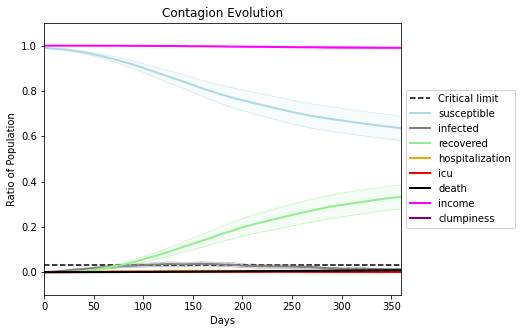

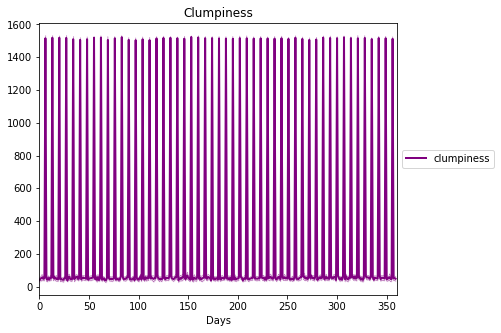

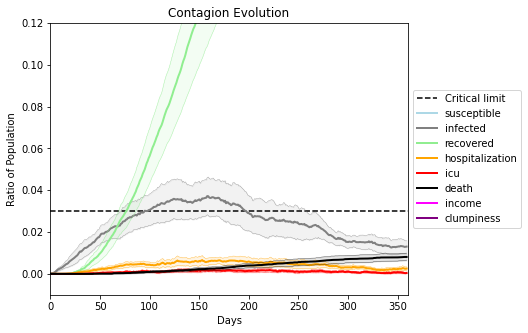

In [25]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7328, 5809, 7204, 4970, 1205, 5596, 9892, 2880, 5686, 6835, 9671, 5396, 2187, 8027, 600, 6301, 7650, 5546, 74, 4344]
Average similarity between family members is 0.10896385894429723 at temperature 0.33
Average similarity between family and home is 0.9998477920852139 at temperature -1
Average similarity between students and their classroom is 0.10489377064451469 at temperature 0.33
Average classroom occupancy is 1.6342857142857143 and number classrooms is 175
Average similarity between workers is 0.11450842210007013 at temperature 0.33
Average office occupancy is 3.345 and number offices is 200
Average friend similarity for adults: 0.17918294842233415 for kids: 0.1819238245091651
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneous

avg restaurant similarity -0.023665201778362673
avg restaurant similarity 0.19499438554044166
avg restaurant similarity 0.05442009958151179
avg restaurant similarity 0.03868050724047278
avg restaurant similarity 0.013606482853549378
avg restaurant similarity 0.06495626734472498
avg restaurant similarity 0.08220160552777707
avg restaurant similarity 0.21684912923072777
avg restaurant similarity 0.11405821262022545
avg restaurant similarity -0.024147573531055094
avg restaurant similarity 0.2392817554591565
avg restaurant similarity 0.13273090246888644
avg restaurant similarity 0.2500253164824137
avg restaurant similarity 0.1525967386970636
avg restaurant similarity 0.17876155767375876
avg restaurant similarity 0.08774601892842072
avg restaurant similarity 0.2082931430869637
avg restaurant similarity 0.03788186302221058
avg restaurant similarity 0.04161907001880483
avg restaurant similarity 0.09622874619937953
avg restaurant similarity 0.32435724187335785
avg restaurant similarity 0.22669

avg restaurant similarity -0.059019554073369195
avg restaurant similarity 0.04432560193914366
avg restaurant similarity -0.03129782821333352
avg restaurant similarity -0.06028753592118904
avg restaurant similarity 0.13120405243016625
avg restaurant similarity 0.1506244776197775
avg restaurant similarity 0.21461064796233764
avg restaurant similarity 0.1274046896307733
avg restaurant similarity 0.3808408677060944
avg restaurant similarity 0.18198658107482163
avg restaurant similarity 0.2911038713571321
avg restaurant similarity 0.15679747084349605
avg restaurant similarity -0.4981476979530251
avg restaurant similarity 0.20720999542665625
avg restaurant similarity 0.06864494026047052
avg restaurant similarity 0.10948085485631778
avg restaurant similarity -0.004929420929886802
avg restaurant similarity 0.1681801906586504
avg restaurant similarity 0.13778939746356175
avg restaurant similarity 0.34075531741797344
avg restaurant similarity 0.08585342743210984
avg restaurant similarity 0.22903

Average similarity between family members is 0.09445414281529073 at temperature 0.33
Average similarity between family and home is 0.9998541079177008 at temperature -1
Average similarity between students and their classroom is 0.14694023242165338 at temperature 0.33
Average classroom occupancy is 1.5524861878453038 and number classrooms is 181
Average similarity between workers is 0.09752526446150386 at temperature 0.33
Average office occupancy is 3.272277227722772 and number offices is 202
Average friend similarity for adults: 0.17678978932408526 for kids: 0.17455359917871538
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home 

avg restaurant similarity 0.1118939359561988
avg restaurant similarity -0.06659584034458992
avg restaurant similarity -0.14164004224250662
avg restaurant similarity -0.1475761109811557
avg restaurant similarity 0.09769499209113333
avg restaurant similarity 0.0395643029933921
avg restaurant similarity -0.046253031667108
avg restaurant similarity 0.047966534079260534
avg restaurant similarity 0.17249006801708636
avg restaurant similarity 0.33215303422492837
avg restaurant similarity 0.08669413352864999
avg restaurant similarity -0.04123032742736146
avg restaurant similarity -0.446753508226127
avg restaurant similarity -0.05941968411968919
avg restaurant similarity 0.018955367669856366
avg restaurant similarity 0.042764449237124545
avg restaurant similarity 0.07807083183442344
avg restaurant similarity 0.1770524612041432
avg restaurant similarity 0.00674423697420881
avg restaurant similarity -0.027701907284378484
avg restaurant similarity 0.11622074991860566
avg restaurant similarity -0.1

avg restaurant similarity 0.19169883914663255
avg restaurant similarity 0.2530090932519444
avg restaurant similarity 0.16190628484857228
avg restaurant similarity 0.12419060942077924
avg restaurant similarity 0.08081988372112141
avg restaurant similarity 0.12016106788374176
avg restaurant similarity 0.028937984433254165
avg restaurant similarity -0.10268019458065937
avg restaurant similarity -0.09527152782824526
avg restaurant similarity 0.007684346691550356
avg restaurant similarity -0.09838347429651936
avg restaurant similarity -0.0016861171624883372
avg restaurant similarity 0.033356849256154106
avg restaurant similarity 0.13852302480765993
avg restaurant similarity 0.08161777698403651
avg restaurant similarity 0.3496747089054681
avg restaurant similarity 0.509137172261096
avg restaurant similarity 0.14699543519102254
avg restaurant similarity 0.03141360496672459
avg restaurant similarity -0.014017427569962663
avg restaurant similarity 0.3750123886039688
avg restaurant similarity -0

Average similarity between students and their classroom is 0.12623349176483248 at temperature 0.33
Average classroom occupancy is 1.5614035087719298 and number classrooms is 171
Average similarity between workers is 0.07889511899690636 at temperature 0.33
Average office occupancy is 3.37 and number offices is 200
Average friend similarity for adults: 0.1622577627932637 for kids: 0.1587104835387033
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this distri

avg restaurant similarity 0.16935360710963787
avg restaurant similarity 0.11256822085674574
avg restaurant similarity -0.0647046116402504
avg restaurant similarity -0.04995852414080507
avg restaurant similarity 0.056737365350606916
avg restaurant similarity 0.09343563710455884
avg restaurant similarity 0.19139072397320392
avg restaurant similarity -0.024583101152216246
avg restaurant similarity 0.01461417101706211
avg restaurant similarity -0.02561439314354421
avg restaurant similarity 0.09448952463100993
avg restaurant similarity 0.0214687170305423
avg restaurant similarity -0.06811086148077311
avg restaurant similarity -0.02815756834653906
avg restaurant similarity 0.12202550480365404
avg restaurant similarity 0.10002338448371381
avg restaurant similarity 0.016025838466279748
avg restaurant similarity 0.24070643985746498
avg restaurant similarity 0.022372186026444234
avg restaurant similarity -0.08147923661620607
avg restaurant similarity 0.14676329405167704
avg restaurant similarity

avg restaurant similarity 0.1627714931664566
avg restaurant similarity 0.1967107973127774
avg restaurant similarity 0.21290051749800842
avg restaurant similarity 0.06507391925501399
avg restaurant similarity -0.016173591076497663
avg restaurant similarity 0.2110267930213123
avg restaurant similarity -0.13796500009194487
avg restaurant similarity 0.06014413065162001
avg restaurant similarity 0.0801645472928486
avg restaurant similarity 0.06595178334926206
avg restaurant similarity -0.006191015328867844
avg restaurant similarity -0.06801436447403886
avg restaurant similarity 0.21884115623502637
avg restaurant similarity 0.05083653971629428
avg restaurant similarity 0.1197323163691263
avg restaurant similarity 0.09007978074832629
avg restaurant similarity -0.0684426945047806
avg restaurant similarity -0.002264100595217774
avg restaurant similarity 0.0666459788656727
avg restaurant similarity 0.12596783700453043
avg restaurant similarity 0.22682240026457562
avg restaurant similarity 0.0905

avg restaurant similarity 0.03406281916789879
avg restaurant similarity -0.047681917266160063
avg restaurant similarity 0.1621482635319415
avg restaurant similarity 0.1241935597113577
Average similarity between family members is 0.09728911231579464 at temperature 0.33
Average similarity between family and home is 0.999861760727557 at temperature -1
Average similarity between students and their classroom is 0.06876547957812533 at temperature 0.33
Average classroom occupancy is 1.5343915343915344 and number classrooms is 189
Average similarity between workers is 0.0873906008197944 at temperature 0.33
Average office occupancy is 3.228855721393035 and number offices is 201
Average friend similarity for adults: 0.16692609889503868 for kids: 0.18297975363744004
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.03872651864562948
avg restaurant similarity 0.18800427942880552
avg restaurant similarity 0.2408117535689084
avg restaurant similarity -0.07157160853208819
avg restaurant similarity 0.1066242158043325
avg restaurant similarity 0.13016124128818166
avg restaurant similarity 0.05637249431616694
avg restaurant similarity 0.04475725805251355
avg restaurant similarity 0.03919119580398104
avg restaurant similarity 0.0039058001836313966
avg restaurant similarity 0.0962406604673372
avg restaurant similarity -0.06344495078393926
avg restaurant similarity 0.03735420963271324
avg restaurant similarity 0.0564433616149422
avg restaurant similarity 0.07563269122867615
avg restaurant similarity 0.023923479251893958
avg restaurant similarity 0.08565914142093328
avg restaurant similarity 0.010187827233672451
avg restaurant similarity 0.04947820885071289
avg restaurant similarity 0.03938365622959891
avg restaurant similarity 0.11041140948924574
avg restaurant similarity 0.0153

avg restaurant similarity 0.16947417894257744
avg restaurant similarity 0.147973476885122
avg restaurant similarity -0.025396328885210245
avg restaurant similarity -0.013888693162686734
avg restaurant similarity -0.015578421114427286
avg restaurant similarity 0.04943482714296286
avg restaurant similarity 0.27394309319739174
avg restaurant similarity 0.23119069275848741
avg restaurant similarity -0.03359675549428701
avg restaurant similarity 0.0015663311601177713
avg restaurant similarity 0.08956159750649258
avg restaurant similarity 0.11996265389632575
avg restaurant similarity 0.11693724606703405
avg restaurant similarity 0.13944523438212303
avg restaurant similarity 0.21916844083327738
avg restaurant similarity 0.03787512505600685
avg restaurant similarity -0.06048969905778102
avg restaurant similarity 0.17693591781369644
avg restaurant similarity 0.10521383403398452
avg restaurant similarity -0.06175241713385058
avg restaurant similarity 0.07442314086596535
avg restaurant similarity

avg restaurant similarity 0.08027225475802015
avg restaurant similarity 0.10074828860342544
avg restaurant similarity 0.09562624311743169
avg restaurant similarity 0.020410558329434697
avg restaurant similarity -0.08400613735947716
avg restaurant similarity -0.0021085072758236815
Average similarity between family members is 0.11845631788526126 at temperature 0.33
Average similarity between family and home is 0.9998501678376497 at temperature -1
Average similarity between students and their classroom is 0.13642437289109796 at temperature 0.33
Average classroom occupancy is 1.601123595505618 and number classrooms is 178
Average similarity between workers is 0.10765642871639755 at temperature 0.33
Average office occupancy is 3.3604060913705585 and number offices is 197
Average friend similarity for adults: 0.16835051095000386 for kids: 0.18750448566278305
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated unit

avg restaurant similarity 0.21699995437021222
avg restaurant similarity 0.10449558322346346
avg restaurant similarity 0.14831349864369886
avg restaurant similarity 0.005001700296546119
avg restaurant similarity 0.1269260029219754
avg restaurant similarity 0.21839016518077678
avg restaurant similarity 0.14919181342235893
avg restaurant similarity 0.3195251012442194
avg restaurant similarity -0.05693994821724827
avg restaurant similarity 0.1648799706198759
avg restaurant similarity 0.1140852469543047
avg restaurant similarity -0.2615866315500023
avg restaurant similarity -0.09626291658133984
avg restaurant similarity 0.005554305503005697
avg restaurant similarity 0.08358057218718784
avg restaurant similarity 0.1346232599362629
avg restaurant similarity 0.05653997569677495
avg restaurant similarity 0.011254999323045045
avg restaurant similarity 0.19285350536738624
avg restaurant similarity 0.05627352164667008
avg restaurant similarity 0.14415539538258063
avg restaurant similarity 0.036710

avg restaurant similarity 0.048264383150533066
avg restaurant similarity 0.07969380376742642
avg restaurant similarity 0.06616818822911037
avg restaurant similarity -0.15599858680527862
avg restaurant similarity 0.10666316660265611
avg restaurant similarity -0.008710743506673304
avg restaurant similarity 0.13627574447824212
avg restaurant similarity 0.3002444441816665
avg restaurant similarity 0.0412986374001519
avg restaurant similarity -0.41332817478292155
avg restaurant similarity 0.2646750015051328
avg restaurant similarity -0.050454981157868915
avg restaurant similarity 0.2073605415514565
avg restaurant similarity 0.1750553984423023
avg restaurant similarity 0.21317007820614317
avg restaurant similarity 0.09645892358430731
avg restaurant similarity 0.07751123292655668
avg restaurant similarity -0.3040554582664738
avg restaurant similarity 0.0016499559388339963
avg restaurant similarity 0.17701191250234022
avg restaurant similarity 0.05442525877625167
avg restaurant similarity 0.21

Average similarity between family members is 0.12178260501247996 at temperature 0.33
Average similarity between family and home is 0.9998502665559474 at temperature -1
Average similarity between students and their classroom is 0.15001073676193408 at temperature 0.33
Average classroom occupancy is 1.7329545454545454 and number classrooms is 176
Average similarity between workers is 0.08323016992973152 at temperature 0.33
Average office occupancy is 3.2777777777777777 and number offices is 198
Average friend similarity for adults: 0.16541397231078506 for kids: 0.1661729416579277
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2

avg restaurant similarity -0.006926429348360533
avg restaurant similarity 0.29126214131013445
avg restaurant similarity -0.1664924063702659
avg restaurant similarity -0.2531487021050845
avg restaurant similarity -0.035179238659507
avg restaurant similarity 0.03228670039930924
avg restaurant similarity 0.028382747049858485
avg restaurant similarity 0.015334440403726295
avg restaurant similarity 0.03695029969281758
avg restaurant similarity 0.08667484454095335
avg restaurant similarity -0.15694277096434106
avg restaurant similarity -0.28795332788271183
avg restaurant similarity 0.05753963644205938
avg restaurant similarity 0.009869021494855227
avg restaurant similarity 0.1578473672262861
avg restaurant similarity 0.14378638076552994
avg restaurant similarity 0.08042335467646951
avg restaurant similarity 0.054003881592797585
avg restaurant similarity 0.14294355059892203
avg restaurant similarity 0.03839032837375026
avg restaurant similarity -0.07331388712705665
avg restaurant similarity -

avg restaurant similarity 0.0547243152987179
avg restaurant similarity 0.4722861850141259
avg restaurant similarity 0.018295084739696776
avg restaurant similarity 0.2655691466268756
avg restaurant similarity 0.16437720561751012
avg restaurant similarity -0.02009027158677513
avg restaurant similarity 0.13600818111714172
avg restaurant similarity 0.2952747850244774
avg restaurant similarity 0.05934005655804506
avg restaurant similarity 0.07968314145663438
avg restaurant similarity 0.13447115879535876
avg restaurant similarity -0.02382385569373122
avg restaurant similarity 0.0081208404799945
avg restaurant similarity 0.5815115703666428
avg restaurant similarity 0.052470840643532614
avg restaurant similarity 0.2470865397306702
avg restaurant similarity -0.016094777042661098
avg restaurant similarity 0.3267954380051228
avg restaurant similarity -0.010714809478525312
avg restaurant similarity 0.003599809592357159
avg restaurant similarity 0.14250584155238685
avg restaurant similarity 0.22183

avg restaurant similarity 0.1712594211337039
Average similarity between family members is 0.10933957272431442 at temperature 0.33
Average similarity between family and home is 0.9998536583489384 at temperature -1
Average similarity between students and their classroom is 0.1145204053307649 at temperature 0.33
Average classroom occupancy is 1.625 and number classrooms is 184
Average similarity between workers is 0.09722358936789648 at temperature 0.33
Average office occupancy is 3.2388059701492535 and number offices is 201
Average friend similarity for adults: 0.16786525278461964 for kids: 0.16902351302962015
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people alloca

avg restaurant similarity -0.0957502850233731
avg restaurant similarity -0.06346551456245275
avg restaurant similarity -0.020736680197071627
avg restaurant similarity 0.025523598774782597
avg restaurant similarity -0.028076129149685342
avg restaurant similarity 0.17115025155903138
avg restaurant similarity -0.049256469846544186
avg restaurant similarity -0.048712146903663996
avg restaurant similarity 0.23942700931464608
avg restaurant similarity 0.009163057474777643
avg restaurant similarity 0.024621986118865846
avg restaurant similarity -0.026880602580044752
avg restaurant similarity 0.14042627605565866
avg restaurant similarity 0.030237509894405084
avg restaurant similarity -0.014650313164946138
avg restaurant similarity 0.013112917047937064
avg restaurant similarity 0.1564895761178342
avg restaurant similarity -0.022055068696890043
avg restaurant similarity -0.017906306420040954
avg restaurant similarity 0.055261369437750396
avg restaurant similarity 0.15128158930187574
avg restaura

avg restaurant similarity 0.12109507045821083
avg restaurant similarity 0.4586278121373498
avg restaurant similarity 0.07779922379080599
avg restaurant similarity -0.14171800009631172
avg restaurant similarity -0.2177811212471973
avg restaurant similarity 0.1313488031910021
avg restaurant similarity 0.11342540838582173
avg restaurant similarity 0.15676899835663013
avg restaurant similarity 0.04897088764283175
avg restaurant similarity 0.036231488062127844
avg restaurant similarity -0.021937248115748036
avg restaurant similarity -0.03954788855061286
avg restaurant similarity 0.01580223960364237
avg restaurant similarity 0.27025225636033134
avg restaurant similarity 0.07334588279775285
avg restaurant similarity 0.005123816845896916
avg restaurant similarity 0.2785464933904752
avg restaurant similarity -0.3475021078254334
avg restaurant similarity 0.07142851028395422
avg restaurant similarity -0.22888023394844814
avg restaurant similarity 0.326910176589475
avg restaurant similarity -0.116

Average similarity between family and home is 0.9998505440445623 at temperature -1
Average similarity between students and their classroom is 0.1185264677014869 at temperature 0.33
Average classroom occupancy is 1.564516129032258 and number classrooms is 186
Average similarity between workers is 0.10731250408957617 at temperature 0.33
Average office occupancy is 3.31 and number offices is 200
Average friend similarity for adults: 0.16549419522995978 for kids: 0.16292450450910204
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 all

avg restaurant similarity 0.009323439405314216
avg restaurant similarity -0.009826030341179718
avg restaurant similarity 0.1686934323761485
avg restaurant similarity -0.11028230192997789
avg restaurant similarity -0.0627739846513692
avg restaurant similarity 0.0333608983853819
avg restaurant similarity 0.1488331762940967
avg restaurant similarity 0.011945362241762356
avg restaurant similarity 0.022896141450678115
avg restaurant similarity 0.02426160719606471
avg restaurant similarity 0.009994344719991832
avg restaurant similarity 0.012088337553087691
avg restaurant similarity -0.12454256739042883
avg restaurant similarity -0.12103109385838828
avg restaurant similarity -0.01476491765976877
avg restaurant similarity 0.11667584206917629
avg restaurant similarity -0.006376083751796833
avg restaurant similarity 0.0334695189811256
avg restaurant similarity 0.08066473277894082
avg restaurant similarity 0.2739206873280044
avg restaurant similarity -0.03043906300016878
avg restaurant similarity

avg restaurant similarity 0.11674246491464446
avg restaurant similarity -0.0034499837286837594
avg restaurant similarity -0.2492359302747897
avg restaurant similarity 0.09027562785385766
avg restaurant similarity 0.1609527635621838
avg restaurant similarity 0.19436396025849004
avg restaurant similarity 0.021396406753117506
avg restaurant similarity 0.006393643107198477
avg restaurant similarity 0.14864172712667015
avg restaurant similarity -0.03475493398233502
avg restaurant similarity 0.11158694487768323
avg restaurant similarity -0.25593041121689786
avg restaurant similarity -0.056412125814636276
avg restaurant similarity 0.1386181746942619
avg restaurant similarity -0.0009467165672008004
avg restaurant similarity -0.06332226963413928
avg restaurant similarity -0.05445531672315174
avg restaurant similarity -0.11014970961728093
avg restaurant similarity -0.01738472395843852
avg restaurant similarity -0.05582193231774381
avg restaurant similarity -0.004295223900889675
avg restaurant si

Average friend similarity for adults: 0.16319187018005207 for kids: 0.16481065793407462
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 alloc

avg restaurant similarity 0.08073167234420028
avg restaurant similarity 0.130436960141403
avg restaurant similarity 0.04212994892872486
avg restaurant similarity 0.06042748658872905
avg restaurant similarity -0.03686751239448866
avg restaurant similarity 0.04752640837317681
avg restaurant similarity 0.1476916650598911
avg restaurant similarity 0.2074735488213825
avg restaurant similarity 0.08185332695935879
avg restaurant similarity -0.07088571595379195
avg restaurant similarity 0.08892468057830996
avg restaurant similarity 0.14495351166746206
avg restaurant similarity 0.08581157280672273
avg restaurant similarity 0.10395926414551945
avg restaurant similarity 0.07028952427849332
avg restaurant similarity 0.00888368673981828
avg restaurant similarity 0.05855436957106362
avg restaurant similarity -0.17572803228196834
avg restaurant similarity -0.00019512682367223784
avg restaurant similarity -0.0737068123612495
avg restaurant similarity 0.05085939994399077
avg restaurant similarity 0.165

avg restaurant similarity 0.2841047278526834
avg restaurant similarity 0.21305687520131236
avg restaurant similarity 0.14643569280283478
avg restaurant similarity 0.14858028682215593
avg restaurant similarity 0.11695131058817083
avg restaurant similarity -0.024517683905937865
avg restaurant similarity 0.02389843702445225
avg restaurant similarity 0.011248356356813006
avg restaurant similarity 0.20035109968441284
avg restaurant similarity -0.09687081760303551
avg restaurant similarity -0.09469483034500542
avg restaurant similarity 0.1866155544562518
avg restaurant similarity 0.05721972255153626
avg restaurant similarity 0.03287482204258968
avg restaurant similarity 0.07598730132732226
avg restaurant similarity 0.11009001304442305
avg restaurant similarity 0.195052127857501
avg restaurant similarity 0.010717929826850941
avg restaurant similarity 0.17187541099837567
avg restaurant similarity 0.18471182587630766
avg restaurant similarity -0.04336699571601192
avg restaurant similarity 0.232

avg restaurant similarity 0.16568686290256054
avg restaurant similarity 0.12293478785334985
avg restaurant similarity 0.09806612138648331
avg restaurant similarity 0.1466454534930732
Average similarity between family members is 0.0952485087080862 at temperature 0.33
Average similarity between family and home is 0.9998556239314271 at temperature -1
Average similarity between students and their classroom is 0.12245193128193063 at temperature 0.33
Average classroom occupancy is 1.5555555555555556 and number classrooms is 180
Average similarity between workers is 0.07990023273206484 at temperature 0.33
Average office occupancy is 3.38265306122449 and number offices is 196
Average friend similarity for adults: 0.15855166404643065 for kids: 0.17882985584457028
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.17072222833201625
avg restaurant similarity 0.00790870993961804
avg restaurant similarity 0.28213002560935013
avg restaurant similarity 0.34925166639011596
avg restaurant similarity -0.05996019454509561
avg restaurant similarity 0.25167178413978836
avg restaurant similarity 0.15226706323124128
avg restaurant similarity 0.1365926889070362
avg restaurant similarity 0.07959324071323112
avg restaurant similarity -0.2555670245224729
avg restaurant similarity 0.10673108427053542
avg restaurant similarity 0.19418984212323354
avg restaurant similarity 0.06962325031002219
avg restaurant similarity -0.1702717839643637
avg restaurant similarity 0.08044226442979698
avg restaurant similarity 0.05529132798645669
avg restaurant similarity -0.002597237246030018
avg restaurant similarity -0.042074700368158774
avg restaurant similarity 0.04655482144978196
avg restaurant similarity -0.10075875046020755
avg restaurant similarity 0.03459108490099694
avg restaurant similarity -0.

avg restaurant similarity 0.22835977522283554
avg restaurant similarity -0.03978332587911255
avg restaurant similarity -0.053855389829707466
avg restaurant similarity 0.033912540713560146
avg restaurant similarity -0.023679628368168434
avg restaurant similarity 0.1083477509734726
avg restaurant similarity 0.1373470697647488
avg restaurant similarity 0.21086181146759192
avg restaurant similarity 0.3721289138015411
avg restaurant similarity 0.28358701160349303
avg restaurant similarity 0.1903578115595528
avg restaurant similarity 0.12921634866835532
avg restaurant similarity 0.18763788732904077
avg restaurant similarity -0.06522113184415787
avg restaurant similarity 0.14277152685894792
avg restaurant similarity -0.1056797634136106
avg restaurant similarity 0.5042510060603895
avg restaurant similarity 0.11215317963784668
avg restaurant similarity 0.026685156693062945
avg restaurant similarity -0.12262699016389741
avg restaurant similarity -0.03169664117818819
avg restaurant similarity -0.

Average similarity between students and their classroom is 0.11987631656907247 at temperature 0.33
Average classroom occupancy is 1.5691489361702127 and number classrooms is 188
Average similarity between workers is 0.12399356948815111 at temperature 0.33
Average office occupancy is 3.2588832487309647 and number offices is 197
Average friend similarity for adults: 0.17137149721632547 for kids: 0.17953704365733653
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated 

avg restaurant similarity 0.1760457641385216
avg restaurant similarity 0.13876928725312954
avg restaurant similarity -0.0800088286384952
avg restaurant similarity 0.2041021690425107
avg restaurant similarity 0.13524569760414776
avg restaurant similarity 0.00944991062584805
avg restaurant similarity -0.07451590869798937
avg restaurant similarity 0.033812169611995416
avg restaurant similarity 0.19618754098420269
avg restaurant similarity 0.19107240583904142
avg restaurant similarity 0.17787828090732039
avg restaurant similarity 0.011883740911394535
avg restaurant similarity 0.08052746255618089
avg restaurant similarity 0.23804755219453075
avg restaurant similarity 0.10729740512679856
avg restaurant similarity 0.18273102079916023
avg restaurant similarity -0.2908726604423578
avg restaurant similarity 0.047348267275548264
avg restaurant similarity 0.018595450967200097
avg restaurant similarity -0.04649490112928512
avg restaurant similarity 0.11821612538580191
avg restaurant similarity -0.0

avg restaurant similarity 0.1529126127857989
avg restaurant similarity 0.08835496632669619
avg restaurant similarity 0.16569636546104388
avg restaurant similarity 0.08109301181020236
avg restaurant similarity 0.04046711075679238
avg restaurant similarity -0.1724823612648861
avg restaurant similarity -0.11262205134167991
avg restaurant similarity 0.06439783160240885
avg restaurant similarity 0.08718232531194015
avg restaurant similarity 0.13980214796002086
avg restaurant similarity 0.015962825218634034
avg restaurant similarity 0.06622372969432473
avg restaurant similarity 0.08065286345103398
avg restaurant similarity 0.10142600677226676
avg restaurant similarity -0.00126141268484169
avg restaurant similarity 0.055312348523207364
avg restaurant similarity -0.048810487519550035
avg restaurant similarity 0.2607721254020575
avg restaurant similarity 0.09532204171418321
avg restaurant similarity 0.07208884783916635
avg restaurant similarity 0.2519889109676911
avg restaurant similarity -0.18

avg restaurant similarity 0.04090940221634076
avg restaurant similarity 0.01967210577912165
Average similarity between family members is 0.10862876406375468 at temperature 0.33
Average similarity between family and home is 0.9998566315638574 at temperature -1
Average similarity between students and their classroom is 0.09288188217676593 at temperature 0.33
Average classroom occupancy is 1.6724137931034482 and number classrooms is 174
Average similarity between workers is 0.09359920166195493 at temperature 0.33
Average office occupancy is 3.3096446700507616 and number offices is 197
Average friend similarity for adults: 0.16604049684199879 for kids: 0.18305654170273647
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocat

avg restaurant similarity 0.18022633779504355
avg restaurant similarity 0.044050862637714544
avg restaurant similarity 0.07477178165818153
avg restaurant similarity 0.2167074477104397
avg restaurant similarity 0.10864352303705715
avg restaurant similarity 0.05853015600643971
avg restaurant similarity 0.18159453934640454
avg restaurant similarity 0.39429483549579725
avg restaurant similarity 0.16289681055034347
avg restaurant similarity 0.08176099172324741
avg restaurant similarity -0.00577787576463004
avg restaurant similarity 0.1458661824296538
avg restaurant similarity 0.26057386882908723
avg restaurant similarity 0.11165424190599701
avg restaurant similarity -0.04331725321411779
avg restaurant similarity 0.05670716319454235
avg restaurant similarity 0.09271265594251522
avg restaurant similarity 0.12244773581383406
avg restaurant similarity 0.257882022261979
avg restaurant similarity 0.18316504160707597
avg restaurant similarity 0.04497300204150201
avg restaurant similarity -0.081460

avg restaurant similarity 0.20768442514174285
avg restaurant similarity 0.14267969696558688
avg restaurant similarity 0.10084374510711283
avg restaurant similarity 0.15334240957960293
avg restaurant similarity 0.0025977978495815915
avg restaurant similarity 0.020116247223241592
avg restaurant similarity -0.40096830898308855
avg restaurant similarity 0.1253617509178151
avg restaurant similarity -0.09462082813434289
avg restaurant similarity 0.16627742883121613
avg restaurant similarity 0.20914699468317446
avg restaurant similarity 0.07264431597936709
avg restaurant similarity 0.03670159536151849
avg restaurant similarity 0.36301161128788845
avg restaurant similarity 0.20282176270901522
avg restaurant similarity 0.22315708368713288
avg restaurant similarity -0.03160723459261465
avg restaurant similarity 0.06333928875382587
avg restaurant similarity 0.23239366267695583
avg restaurant similarity -0.11917075183405265
avg restaurant similarity 0.016868551144256737
avg restaurant similarity 0

avg restaurant similarity -0.054847978852018996
avg restaurant similarity 0.08123848084753216
avg restaurant similarity 0.1334775265827321
Average similarity between family members is 0.07760396449474545 at temperature 0.33
Average similarity between family and home is 0.9998418755670152 at temperature -1
Average similarity between students and their classroom is 0.1439167979384959 at temperature 0.33
Average classroom occupancy is 1.572139303482587 and number classrooms is 201
Average similarity between workers is 0.09921148088652317 at temperature 0.33
Average office occupancy is 3.207070707070707 and number offices is 198
Average friend similarity for adults: 0.17188593201015723 for kids: 0.1775053781211827
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.07438646350302569
avg restaurant similarity 0.02759616801281995
avg restaurant similarity 0.28569969705444853
avg restaurant similarity 0.050282383395142315
avg restaurant similarity 0.22722200076885268
avg restaurant similarity -0.01973830628033555
avg restaurant similarity 0.029259172843204655
avg restaurant similarity 0.0939076243621923
avg restaurant similarity 0.0583199257562109
avg restaurant similarity 0.2773132754179072
avg restaurant similarity 0.008421195199114662
avg restaurant similarity 0.2583597638806442
avg restaurant similarity -0.014261646885595248
avg restaurant similarity 0.09045226550844228
avg restaurant similarity -0.039144304032383496
avg restaurant similarity 0.06450871486264098
avg restaurant similarity 0.16883215129017065
avg restaurant similarity 0.1715955931378207
avg restaurant similarity -0.006240352950316762
avg restaurant similarity 0.028511795809315548
avg restaurant similarity 0.027713626723930435
avg restaurant similarity -

avg restaurant similarity 0.0005333326977567214
avg restaurant similarity -0.08091160134962012
avg restaurant similarity 0.13519717624570549
avg restaurant similarity 0.078720721095411
avg restaurant similarity 0.04306200165887823
avg restaurant similarity 0.12004703589973995
avg restaurant similarity 0.048572280285405056
avg restaurant similarity 0.19207891792088697
avg restaurant similarity -0.01402538345356158
avg restaurant similarity -0.06275815199269903
avg restaurant similarity -0.0971390562839405
avg restaurant similarity 0.2898112376562957
avg restaurant similarity 0.227326849768991
avg restaurant similarity 0.18962454066630727
avg restaurant similarity 0.19005761465743146
avg restaurant similarity -0.08650684657608035
avg restaurant similarity 0.14070569602344515
avg restaurant similarity 0.1486455838230459
avg restaurant similarity 0.013829499396967085
avg restaurant similarity 0.14661188662051905
avg restaurant similarity 0.057583249620865806
avg restaurant similarity 0.245

avg restaurant similarity 0.18869561080879482
avg restaurant similarity 0.081159828174562
avg restaurant similarity 0.05445355704349858
avg restaurant similarity 0.12552916341111267
Average similarity between family members is 0.11737427323582834 at temperature 0.33
Average similarity between family and home is 0.9998470142455286 at temperature -1
Average similarity between students and their classroom is 0.09886305461382196 at temperature 0.33
Average classroom occupancy is 1.565934065934066 and number classrooms is 182
Average similarity between workers is 0.10416986148864023 at temperature 0.33
Average office occupancy is 3.3217821782178216 and number offices is 202
Average friend similarity for adults: 0.16754892467526958 for kids: 0.16794081741276265
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.05235288019678294
avg restaurant similarity 0.034134705689316445
avg restaurant similarity 0.15880446217408647
avg restaurant similarity 0.14784523899400523
avg restaurant similarity 0.15168894005771857
avg restaurant similarity -0.2443175610857643
avg restaurant similarity 0.19197599766952855
avg restaurant similarity 0.15432050013940016
avg restaurant similarity 0.04105679361323461
avg restaurant similarity 0.15147089782260023
avg restaurant similarity 0.22566852214812794
avg restaurant similarity 0.024971659882133904
avg restaurant similarity 0.12156434180797654
avg restaurant similarity 0.10554106038352007
avg restaurant similarity 0.14544924067498172
avg restaurant similarity 0.06804808499292579
avg restaurant similarity 0.08774311615546272
avg restaurant similarity 0.13069067294048453
avg restaurant similarity 0.32776871592101614
avg restaurant similarity 0.12649611410270503
avg restaurant similarity -0.05703594835437596
avg restaurant similarity 0.000

avg restaurant similarity 0.1595830983186655
avg restaurant similarity -0.4473868676368882
avg restaurant similarity -0.061594310800898014
avg restaurant similarity 0.06895074177467089
avg restaurant similarity 0.03489678878034999
avg restaurant similarity 0.17132063436215916
avg restaurant similarity 0.24345495275643214
avg restaurant similarity 0.16598923255603568
avg restaurant similarity -0.05625517185465084
avg restaurant similarity 0.08040707347164841
avg restaurant similarity 0.23793724078590892
avg restaurant similarity 0.20802797392575256
avg restaurant similarity 0.10673927559579126
avg restaurant similarity 0.31359166715417286
avg restaurant similarity 0.17147273264155716
avg restaurant similarity -0.046999894991694394
avg restaurant similarity 0.1830823302452224
avg restaurant similarity 0.06503834865517857
avg restaurant similarity 0.2246836039699477
avg restaurant similarity 0.28392967030997057
avg restaurant similarity -0.07090177831261216
avg restaurant similarity 0.157

avg restaurant similarity -0.09059325579993206
avg restaurant similarity 0.28096506495651463
Average similarity between family members is 0.09224642194317506 at temperature 0.33
Average similarity between family and home is 0.999862620221223 at temperature -1
Average similarity between students and their classroom is 0.09522517371928968 at temperature 0.33
Average classroom occupancy is 1.6779661016949152 and number classrooms is 177
Average similarity between workers is 0.10052043687876194 at temperature 0.33
Average office occupancy is 3.208955223880597 and number offices is 201
Average friend similarity for adults: 0.16593539343140482 for kids: 0.1664382602173562
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity -0.1103330117648671
avg restaurant similarity 0.027409952169295634
avg restaurant similarity 0.21274325214441706
avg restaurant similarity 0.032687507442840935
avg restaurant similarity -0.0488257687133624
avg restaurant similarity 0.017999173286047426
avg restaurant similarity -0.022338121145438962
avg restaurant similarity 0.142101819651415
avg restaurant similarity -0.04763970678300784
avg restaurant similarity 0.005729475038576104
avg restaurant similarity 0.14791196142597304
avg restaurant similarity 0.08432322676656462
avg restaurant similarity 0.06616400342639477
avg restaurant similarity -0.01080399521274475
avg restaurant similarity 0.011111634160105651
avg restaurant similarity 0.14856084376354567
avg restaurant similarity 0.1552738542322727
avg restaurant similarity 0.09022869037172243
avg restaurant similarity 0.06855614381662185
avg restaurant similarity -0.08057714976924306
avg restaurant similarity -0.07799156526438542
avg restaurant similarity 

avg restaurant similarity 0.2770266839426838
avg restaurant similarity 0.011630918801141369
avg restaurant similarity 0.06513959228454823
avg restaurant similarity 0.05128520575863896
avg restaurant similarity -0.10080045771518194
avg restaurant similarity 0.03210202257572809
avg restaurant similarity 0.05468054832535747
avg restaurant similarity 0.10424610179455403
avg restaurant similarity -0.06927625942186927
avg restaurant similarity 0.12623738282418365
avg restaurant similarity 0.1718438027647504
avg restaurant similarity 0.020516237743655328
avg restaurant similarity -0.05646821591626513
avg restaurant similarity 0.12537680508322072
avg restaurant similarity 0.046860423194103676
avg restaurant similarity 0.0490988676221861
avg restaurant similarity 0.08836421387299229
avg restaurant similarity 0.08635785059669374
avg restaurant similarity -0.0184744795881823
avg restaurant similarity 0.0194426018207596
avg restaurant similarity -0.07269133375847403
avg restaurant similarity 0.093

avg restaurant similarity -0.015658587842436976
avg restaurant similarity 0.12254427899744445
avg restaurant similarity -0.12577710048145294
avg restaurant similarity -0.04105487971316844
avg restaurant similarity -0.026545616189480155
avg restaurant similarity 0.005903137673488966
Average similarity between family members is 0.113285693162767 at temperature 0.33
Average similarity between family and home is 0.9998616506610718 at temperature -1
Average similarity between students and their classroom is 0.13510517890111157 at temperature 0.33
Average classroom occupancy is 1.5942857142857143 and number classrooms is 175
Average similarity between workers is 0.10522364110338711 at temperature 0.33
Average office occupancy is 3.2794117647058822 and number offices is 204
Average friend similarity for adults: 0.16367446716260664 for kids: 0.1658833142564784
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated unit

avg restaurant similarity 0.3046441419067368
avg restaurant similarity 0.19198477378807058
avg restaurant similarity 0.0034474437685837523
avg restaurant similarity 0.050407340481321006
avg restaurant similarity -0.024275178669026926
avg restaurant similarity 0.1476521829718568
avg restaurant similarity -0.022507068003418135
avg restaurant similarity 0.01289851504556708
avg restaurant similarity -0.15912979722172996
avg restaurant similarity -0.027596136369946376
avg restaurant similarity 0.09285810816704843
avg restaurant similarity -0.03841273902806407
avg restaurant similarity -0.1707041126301065
avg restaurant similarity 0.06562640268601534
avg restaurant similarity -0.015593430989619794
avg restaurant similarity -0.0511146667940375
avg restaurant similarity 0.31951523587036673
avg restaurant similarity -0.1647894260126831
avg restaurant similarity -0.04918027688599973
avg restaurant similarity 0.087510147096215
avg restaurant similarity -0.06118740446663055
avg restaurant similari

avg restaurant similarity -0.032005105084979855
avg restaurant similarity 0.034571447476018126
avg restaurant similarity -0.025730547990315614
avg restaurant similarity -0.01495257150207952
avg restaurant similarity -0.06037403131382488
avg restaurant similarity -0.09719623343120132
avg restaurant similarity -0.044957291023224565
avg restaurant similarity -0.0018821268671963542
avg restaurant similarity -0.03396791019443139
avg restaurant similarity -0.08330005473925442
avg restaurant similarity -0.01014084699036199
avg restaurant similarity -0.085522602529072
avg restaurant similarity 0.13434718457515057
avg restaurant similarity -0.08093109907770804
avg restaurant similarity -0.07999146367436805
avg restaurant similarity 0.0671390542641601
avg restaurant similarity 0.048438571216259024
avg restaurant similarity -0.07480511184592031
avg restaurant similarity 0.03916114582613063
avg restaurant similarity -0.00884796012280755
avg restaurant similarity -0.008753520123382569
avg restauran

avg restaurant similarity 0.016499499150103278
avg restaurant similarity 0.09907395847965435
avg restaurant similarity -0.08612275965566552
avg restaurant similarity 0.2097667323668639
avg restaurant similarity 0.04213702275539733
Average similarity between family members is 0.11897865523882602 at temperature 0.33
Average similarity between family and home is 0.9998643369304909 at temperature -1
Average similarity between students and their classroom is 0.13685902943858938 at temperature 0.33
Average classroom occupancy is 1.6271186440677967 and number classrooms is 177
Average similarity between workers is 0.10295512974849455 at temperature 0.33
Average office occupancy is 3.245 and number offices is 200
Average friend similarity for adults: 0.16012039746693377 for kids: 0.1743932535274703
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 22 people.
Total of 22 people allocated in th

avg restaurant similarity 0.19494889161882334
avg restaurant similarity 0.012712640649947288
avg restaurant similarity 0.7192981158738585
avg restaurant similarity -0.011865591361776971
avg restaurant similarity -0.08287380374151729
avg restaurant similarity 0.06090545588512809
avg restaurant similarity 0.27731006881639675
avg restaurant similarity 0.21666619079082886
avg restaurant similarity 0.16406302605738446
avg restaurant similarity 0.010213923080508329
avg restaurant similarity 0.050133645855764124
avg restaurant similarity 0.20096222093363286
avg restaurant similarity -0.2009374585608979
avg restaurant similarity 0.4884493910337135
avg restaurant similarity 0.14297442405449654
avg restaurant similarity 0.04224467708994825
avg restaurant similarity 0.19276718716385535
avg restaurant similarity 0.07323072536896486
avg restaurant similarity 0.6867164378061292
avg restaurant similarity 0.03895666567026068
avg restaurant similarity 0.1272791077486709
avg restaurant similarity 0.1353

avg restaurant similarity 0.11735173974975373
avg restaurant similarity -0.026016660589284018
avg restaurant similarity 0.06780590336489312
avg restaurant similarity 0.12415639879941189
avg restaurant similarity 0.14367421881661255
avg restaurant similarity 0.07692228816364287
avg restaurant similarity 0.0012187690122850703
avg restaurant similarity -0.027366140808809197
avg restaurant similarity 0.041313579677495584
avg restaurant similarity 0.05205564170850702
avg restaurant similarity -0.08959758953644031
avg restaurant similarity 0.07052244086346424
avg restaurant similarity 0.05237322330893657
avg restaurant similarity 0.016962362204720798
avg restaurant similarity 0.4233003670301705
avg restaurant similarity -0.13065208228695008
avg restaurant similarity -0.06339464991825976
avg restaurant similarity -0.04908304061379436
avg restaurant similarity 0.166462944270308
avg restaurant similarity 0.03488463169813123
avg restaurant similarity 0.21231235180613292
avg restaurant similarity

Average similarity between students and their classroom is 0.1445866780328668 at temperature 0.33
Average classroom occupancy is 1.625 and number classrooms is 184
Average similarity between workers is 0.139655255908081 at temperature 0.33
Average office occupancy is 3.2167487684729066 and number offices is 203
Average friend similarity for adults: 0.1763976391336984 for kids: 0.16673458290331536
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.

avg restaurant similarity -0.07314621151630092
avg restaurant similarity 0.07948846576320485
avg restaurant similarity 0.31927791320230964
avg restaurant similarity 0.0750387152651737
avg restaurant similarity 0.08865797167465107
avg restaurant similarity 0.09836284787285027
avg restaurant similarity 0.2638790245356704
avg restaurant similarity 0.13632222672950162
avg restaurant similarity -0.03294249174661918
avg restaurant similarity -0.04782469691918399
avg restaurant similarity 0.1544611944684434
avg restaurant similarity 0.03997515029651396
avg restaurant similarity -0.011635768407691269
avg restaurant similarity -0.09528425966906613
avg restaurant similarity 0.1847509243320405
avg restaurant similarity -0.012891420312028277
avg restaurant similarity 0.057838469353456545
avg restaurant similarity 0.07457597411492099
avg restaurant similarity 0.09484896305381382
avg restaurant similarity 0.02158246760703547
avg restaurant similarity 0.1630967673741083
avg restaurant similarity 0.17

avg restaurant similarity 0.0236731987239518
avg restaurant similarity -0.0220780485162519
avg restaurant similarity 0.0012119670708488396
avg restaurant similarity 0.18564527943255185
avg restaurant similarity 0.10258590079166537
avg restaurant similarity 0.2523121100453978
avg restaurant similarity 0.4229178913690362
avg restaurant similarity 0.3601247425267064
avg restaurant similarity -0.0788429824403874
avg restaurant similarity 0.03050769285760812
avg restaurant similarity 0.04277018439478501
avg restaurant similarity 0.13907395128511169
avg restaurant similarity -0.0420972120800403
avg restaurant similarity -0.015432204870406311
avg restaurant similarity 0.10638635056988073
avg restaurant similarity -0.007162158431034446
avg restaurant similarity -0.077817336054341
avg restaurant similarity 0.05365262595685258
avg restaurant similarity 0.06092509738814475
avg restaurant similarity 0.04771570635264346
avg restaurant similarity 0.17806617799209448
avg restaurant similarity 0.17144

avg restaurant similarity -0.00707844509127994
avg restaurant similarity 0.07750080781426368
avg restaurant similarity 0.07515731168540282
avg restaurant similarity 0.1557210050781536
Average similarity between family members is 0.0992541941354827 at temperature 0.33
Average similarity between family and home is 0.999862859360886 at temperature -1
Average similarity between students and their classroom is 0.1508572314563965 at temperature 0.33
Average classroom occupancy is 1.6120218579234973 and number classrooms is 183
Average similarity between workers is 0.1046400444177122 at temperature 0.33
Average office occupancy is 3.2686567164179103 and number offices is 201
Average friend similarity for adults: 0.16389642314678188 for kids: 0.1719227092691199
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.0867125118625451
avg restaurant similarity 0.1081336616453052
avg restaurant similarity -0.16741248081316268
avg restaurant similarity 0.27411956093416345
avg restaurant similarity 0.10021774953864045
avg restaurant similarity 0.12072166987751612
avg restaurant similarity 0.2519019678802104
avg restaurant similarity -0.2143334059279376
avg restaurant similarity -0.0262076878423545
avg restaurant similarity -0.000427251734180308
avg restaurant similarity 0.09509957266435058
avg restaurant similarity 0.1549032996608702
avg restaurant similarity 0.11570969187179496
avg restaurant similarity -0.1511422401179676
avg restaurant similarity -0.012570623511057694
avg restaurant similarity -0.09512613097592064
avg restaurant similarity -0.0030300520555426222
avg restaurant similarity 0.14847031647043604
avg restaurant similarity 0.09008071712646602
avg restaurant similarity -0.02513138959906155
avg restaurant similarity -0.08625725338899079
avg restaurant similarity 0

avg restaurant similarity -0.055227449688885176
avg restaurant similarity 0.13037964826418588
avg restaurant similarity 0.2121272648673061
avg restaurant similarity -0.0462110932786142
avg restaurant similarity 0.055929472144308726
avg restaurant similarity -0.03320420788357951
avg restaurant similarity -0.13320607791675998
avg restaurant similarity 0.13705688202870533
avg restaurant similarity 0.1612832256800455
avg restaurant similarity 0.2029912848564866
avg restaurant similarity 0.0786571548738378
avg restaurant similarity -0.36506899713280827
avg restaurant similarity 0.11182995764654649
avg restaurant similarity 0.11527713399269923
avg restaurant similarity -0.16813510139278323
avg restaurant similarity -0.0005385887899388986
avg restaurant similarity 0.11741106475620522
avg restaurant similarity 0.1726230498328664
avg restaurant similarity -0.05459527865298769
avg restaurant similarity 0.2419429875754012
avg restaurant similarity 0.019264252070478168
avg restaurant similarity -0

Average similarity between family and home is 0.9998369088949777 at temperature -1
Average similarity between students and their classroom is 0.07592625302899166 at temperature 0.33
Average classroom occupancy is 1.7100591715976332 and number classrooms is 169
Average similarity between workers is 0.0805577343276395 at temperature 0.33
Average office occupancy is 3.3299492385786804 and number offices is 197
Average friend similarity for adults: 0.1550789912246447 for kids: 0.17028724394159098
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 pe

avg restaurant similarity 0.01959364163355693
avg restaurant similarity 0.1697531557370324
avg restaurant similarity 0.18841942573449824
avg restaurant similarity 0.1481276788407231
avg restaurant similarity 0.055455582947532826
avg restaurant similarity -0.15669397684971004
avg restaurant similarity 0.003929209723915513
avg restaurant similarity -0.03866830868044858
avg restaurant similarity 0.10467875136480963
avg restaurant similarity -0.11654095946531871
avg restaurant similarity -0.16354077203094872
avg restaurant similarity 0.09559654256371107
avg restaurant similarity 0.22578328415798765
avg restaurant similarity 0.021693723756816198
avg restaurant similarity 0.00896577757502521
avg restaurant similarity 0.13312677178962012
avg restaurant similarity 0.11835413761751849
avg restaurant similarity 0.1375372687574212
avg restaurant similarity 0.002752218865177036
avg restaurant similarity 0.19543721216531124
avg restaurant similarity 0.13551877410510418
avg restaurant similarity 0.1

avg restaurant similarity 0.06399484723199264
avg restaurant similarity 0.05934490717956102
avg restaurant similarity 0.09000193442626239
avg restaurant similarity 0.04459963489307129
avg restaurant similarity -0.0701232310434676
avg restaurant similarity 0.07021895888129366
avg restaurant similarity 0.03354087423369875
avg restaurant similarity -0.07010697004152475
avg restaurant similarity -0.0026092084146339817
avg restaurant similarity 0.05354559507551037
avg restaurant similarity 0.2112518424420923
avg restaurant similarity -0.07403313548336604
avg restaurant similarity 0.22830282923338327
avg restaurant similarity -0.04066751116808563
avg restaurant similarity 0.09338951326467922
avg restaurant similarity 0.13649340502338764
avg restaurant similarity 0.04085405686595332
avg restaurant similarity -0.039780024778464214
avg restaurant similarity -0.029219552182508397
avg restaurant similarity 0.05312691941341847
avg restaurant similarity -0.035511802396017964
avg restaurant similari

avg restaurant similarity -0.07993068831470082
avg restaurant similarity 0.19270603637203745
avg restaurant similarity 0.07308640390630905
avg restaurant similarity 0.06511436455267929
using average of time series:
stats on susceptible:
data: [0.6968833333333333, 0.7449111111111111, 0.854836111111111, 0.8357861111111112, 0.7320333333333334, 0.792711111111111, 0.7671499999999999, 0.8528718459495354, 0.7005277777777776, 0.8685916666666667, 0.85695, 0.8410166666666667, 0.8963194444444443, 0.8172238855622089, 0.87635, 0.7279555555555555, 0.6556305555555555, 0.7144611111111112, 0.8309527777777779, 0.7720002220002219]
min:
0.6556305555555555
max:
0.8963194444444443
std:
0.06897992132529843
mean:
0.7917581310089317
median:
0.8049674983366599
95% confidence interval for the mean:
(0.7586358594272546,0.8248804025906087)
using average of time series:
stats on infected:
data: [0.03265555555555556, 0.03229444444444444, 0.015561111111111112, 0.023963888888888892, 0.03085833333333334, 0.023363888888

mean:
0.005298703488541742
median:
0.005
95% confidence interval for the mean:
(0.004537455240972897,0.006059951736110587)
using peak of time series:
stats on death:
data: [0.008, 0.019, 0.004, 0.009, 0.005, 0.007, 0.008, 0.0049800796812749, 0.016, 0.006, 0.007, 0.007, 0.005, 0.006986027944111776, 0.006, 0.009, 0.008, 0.012, 0.004, 0.011988011988011988]
min:
0.004
max:
0.019
std:
0.0038030944281088066
mean:
0.008197705980669935
median:
0.007
95% confidence interval for the mean:
(0.006371564053013316,0.010023847908326555)
using peak of time series:
stats on income:
data: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
min:
1.0
max:
1.0
std:
0.0
mean:
1.0
median:
1.0
95% confidence interval for the mean:
(1.0,1.0)
using peak of time series:
stats on clumpiness:
data: [1546.0, 1545.0, 1549.0, 1551.0, 1537.0, 1528.0, 1537.0, 1555.0, 1540.0, 1540.0, 1542.0, 1529.0, 1549.0, 1553.0, 1538.0, 1543.0, 1538.0, 1548.0, 1542.0, 1530.0]
min:
1528

(<function dict.items>, <function dict.items>, <function dict.items>)

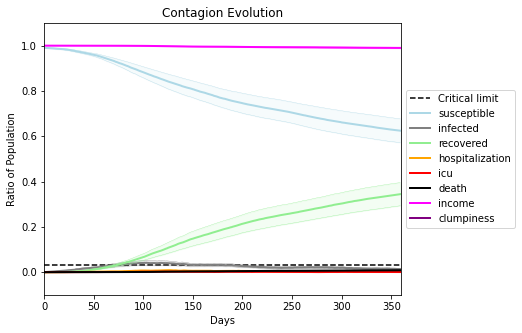

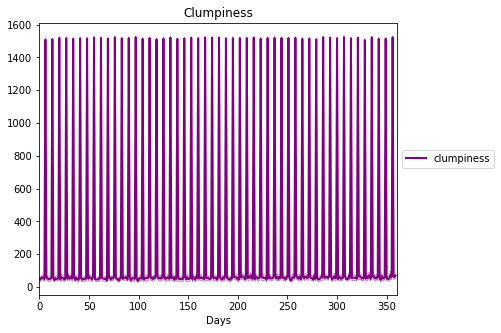

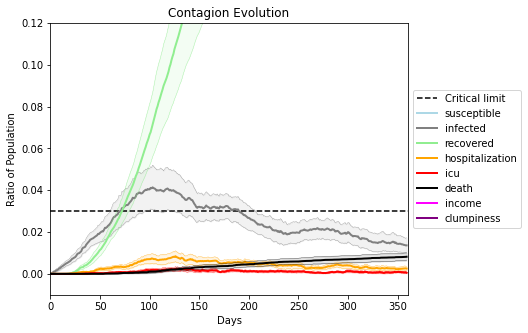

In [26]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.33
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9191, 4643, 7944, 2134, 5719, 5553, 5832, 8843, 5079, 3010, 3710, 7463, 5471, 2253, 1098, 4691, 3754, 6100, 5398, 3528]
Average similarity between family members is 0.044998341700169614 at temperature 0.66
Average similarity between family and home is 0.9998497936227998 at temperature -1
Average similarity between students and their classroom is 0.05573132498890461 at temperature 0.66
Average classroom occupancy is 1.588235294117647 and number classrooms is 170
Average similarity between workers is 0.04267680574205309 at temperature 0.66
Average office occupancy is 3.2801932367149758 and number offices is 207
Average friend similarity for adults: 0.12693667434479836 for kids: 0.12468524223874579
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.23305540314620826
avg restaurant similarity -0.013270396043976068
avg restaurant similarity -0.0431231321662937
avg restaurant similarity -0.006363444136143952
avg restaurant similarity 0.0724056259308368
avg restaurant similarity 0.05515180152423143
avg restaurant similarity 0.10421817680165431
avg restaurant similarity 0.005816951638545009
avg restaurant similarity 0.027150958999041144
avg restaurant similarity 0.6109864118475898
avg restaurant similarity -0.1990469321737329
avg restaurant similarity -0.1617743457333219
avg restaurant similarity 0.19255211812602044
avg restaurant similarity 0.04791775689905081
avg restaurant similarity -0.12967837599813925
avg restaurant similarity 0.05698265774190139
avg restaurant similarity -0.12213137421632991
avg restaurant similarity 0.10691811208800396
avg restaurant similarity -0.021609239275858793
avg restaurant similarity 0.04862120907463749
avg restaurant similarity 0.2712445825219841
avg restaurant similarity -

avg restaurant similarity 0.06999979485815193
avg restaurant similarity 0.006486511229360165
avg restaurant similarity 0.23354145597202586
avg restaurant similarity 0.037303407133813804
avg restaurant similarity -0.1105311430247703
avg restaurant similarity -0.1385282231548254
avg restaurant similarity -0.04112613574515647
avg restaurant similarity -0.015428094139825349
avg restaurant similarity -0.0830048303437167
avg restaurant similarity -0.012318673146100901
avg restaurant similarity -0.13205584251387256
avg restaurant similarity 0.2145728893668624
avg restaurant similarity -0.13999004506341567
avg restaurant similarity 0.0671311301125954
avg restaurant similarity -0.10325880233805054
avg restaurant similarity 0.0024976141727078966
avg restaurant similarity -0.0529929128575744
avg restaurant similarity -0.037277446139880335
avg restaurant similarity 0.005931141309836449
avg restaurant similarity -0.1458853187588431
avg restaurant similarity 0.07451476632737998
avg restaurant simila

avg restaurant similarity 0.08829091510399316
avg restaurant similarity -0.11608297268274351
avg restaurant similarity 0.3790293858945546
avg restaurant similarity -0.006814564862621145
avg restaurant similarity -0.05610352956891899
avg restaurant similarity 0.11495318451803684
Average similarity between family members is 0.06162929638546317 at temperature 0.66
Average similarity between family and home is 0.9998485044632608 at temperature -1
Average similarity between students and their classroom is 0.05600064362471038 at temperature 0.66
Average classroom occupancy is 1.6574585635359116 and number classrooms is 181
Average similarity between workers is 0.0834394698554736 at temperature 0.66
Average office occupancy is 3.27363184079602 and number offices is 201
Average friend similarity for adults: 0.1269640407522052 for kids: 0.13158053351904003
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units wit

avg restaurant similarity -0.019032797483528617
avg restaurant similarity -0.12408165895956647
avg restaurant similarity 0.4134482439189114
avg restaurant similarity -0.21461559539589714
avg restaurant similarity -0.1368945188574958
avg restaurant similarity -0.08109015551722318
avg restaurant similarity 0.0045853970836454774
avg restaurant similarity 0.03152422509185739
avg restaurant similarity 0.025062414318114828
avg restaurant similarity 0.08969086920934684
avg restaurant similarity -0.06367473395855958
avg restaurant similarity -0.037644175082917584
avg restaurant similarity -0.10523179653843304
avg restaurant similarity 0.03291132423652033
avg restaurant similarity -0.019012598936816845
avg restaurant similarity -0.05897041443323594
avg restaurant similarity 0.1841536076472136
avg restaurant similarity -0.008455992177734989
avg restaurant similarity -0.22775737693604936
avg restaurant similarity -0.17345202140694033
avg restaurant similarity 0.02940117165465644
avg restaurant si

avg restaurant similarity -0.23101831071813458
avg restaurant similarity -0.043924965786607706
avg restaurant similarity -0.07793513051307983
avg restaurant similarity -0.12677667822634084
avg restaurant similarity 0.07279730110922338
avg restaurant similarity 0.084150279479438
avg restaurant similarity 0.1391097393354216
avg restaurant similarity -0.012509326981329739
avg restaurant similarity 0.05265972761945239
avg restaurant similarity 0.006264686647245162
avg restaurant similarity 0.032690862421231565
avg restaurant similarity -0.03496047333657307
avg restaurant similarity 0.015378847647071472
avg restaurant similarity -0.05833604961408176
avg restaurant similarity -0.002026090891949043
avg restaurant similarity -0.13709705237602413
avg restaurant similarity 0.0025506637342449234
avg restaurant similarity 0.24341714413408547
avg restaurant similarity 0.08301366261777465
avg restaurant similarity 0.3081988323925336
avg restaurant similarity 0.028755206400560722
avg restaurant simil

avg restaurant similarity 0.13783162152708484
Average similarity between family members is 0.0630852873255422 at temperature 0.66
Average similarity between family and home is 0.999851787317226 at temperature -1
Average similarity between students and their classroom is 0.08124038768606864 at temperature 0.66
Average classroom occupancy is 1.5449438202247192 and number classrooms is 178
Average similarity between workers is 0.06308931053194938 at temperature 0.66
Average office occupancy is 3.2878048780487803 and number offices is 205
Average friend similarity for adults: 0.13204494243205359 for kids: 0.1334097282061058
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peo

avg restaurant similarity 0.13905509575108074
avg restaurant similarity 0.24713496105998298
avg restaurant similarity 0.11940062532149541
avg restaurant similarity 0.11110055427665158
avg restaurant similarity -0.06803534429137897
avg restaurant similarity 0.15827764413182863
avg restaurant similarity 0.0006701604811245346
avg restaurant similarity 0.022166858902011484
avg restaurant similarity -0.27710226528734777
avg restaurant similarity 0.15031146009176602
avg restaurant similarity 0.16074161790567798
avg restaurant similarity 0.014218410732729007
avg restaurant similarity 0.016009939024809905
avg restaurant similarity 0.19824048084830112
avg restaurant similarity 0.042955803244594595
avg restaurant similarity 0.06079537861052435
avg restaurant similarity 0.1402294463359475
avg restaurant similarity 0.03735135884582078
avg restaurant similarity 0.019468073672750406
avg restaurant similarity 0.014174831883843475
avg restaurant similarity 0.06953933774094778
avg restaurant similarity

avg restaurant similarity 0.04570350952155963
avg restaurant similarity -0.030519063867944177
avg restaurant similarity 0.0021633735034285646
avg restaurant similarity 0.17417078886712314
avg restaurant similarity -0.058513803020180145
avg restaurant similarity 0.1372544874423028
avg restaurant similarity 0.055564190188180755
avg restaurant similarity 0.0650519432189672
avg restaurant similarity 0.026306230988183188
avg restaurant similarity 0.3583708589356354
avg restaurant similarity -0.006648782053466324
avg restaurant similarity 0.045304386808039325
avg restaurant similarity 0.08113209652921484
avg restaurant similarity -0.1633247096787322
avg restaurant similarity 0.2129079240424903
avg restaurant similarity 0.5354815977420422
avg restaurant similarity 0.08417537905755168
avg restaurant similarity 0.1311054978548491
avg restaurant similarity 0.023188351918155065
avg restaurant similarity 0.23863410383304817
avg restaurant similarity 0.14727183356949347
avg restaurant similarity -0

avg restaurant similarity 0.051923906273798566
Average similarity between family members is 0.03378489490284852 at temperature 0.66
Average similarity between family and home is 0.999866683587622 at temperature -1
Average similarity between students and their classroom is 0.047330794825201424 at temperature 0.66
Average classroom occupancy is 1.6408839779005524 and number classrooms is 181
Average similarity between workers is 0.07463449213662991 at temperature 0.66
Average office occupancy is 3.1683168316831685 and number offices is 202
Average friend similarity for adults: 0.12353372453734363 for kids: 0.13342313408165232
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total o

avg restaurant similarity 0.10566855071336526
avg restaurant similarity 0.018224942321763648
avg restaurant similarity -0.013651387775796617
avg restaurant similarity -0.02275209833155135
avg restaurant similarity 0.12326720968799881
avg restaurant similarity 0.06377747491496184
avg restaurant similarity 0.062282208708168654
avg restaurant similarity 0.1021650953009749
avg restaurant similarity -0.015859836518318
avg restaurant similarity 0.3093045106792625
avg restaurant similarity 0.011854707945247154
avg restaurant similarity 0.03807872477769348
avg restaurant similarity 0.029711187170043712
avg restaurant similarity 0.0753147234924284
avg restaurant similarity 0.03568507678344023
avg restaurant similarity -0.016728402391716135
avg restaurant similarity -0.15986277275164779
avg restaurant similarity -0.15106258745499168
avg restaurant similarity 0.17305174730285458
avg restaurant similarity -0.03868975529034567
avg restaurant similarity 0.20788776591225935
avg restaurant similarity 

avg restaurant similarity -0.04411811301149506
avg restaurant similarity 0.10014860536248313
avg restaurant similarity -0.07960905763616014
avg restaurant similarity 0.09026451560184053
avg restaurant similarity -0.010775965297165305
avg restaurant similarity 0.04549427847501652
avg restaurant similarity 0.10950645156351993
avg restaurant similarity 0.10997412979418164
avg restaurant similarity 0.08100636501775042
avg restaurant similarity -0.08122457885204389
avg restaurant similarity -0.03735386995021498
avg restaurant similarity 0.1978376764179595
avg restaurant similarity 0.13643192581095068
avg restaurant similarity 0.052325679343047465
avg restaurant similarity 0.059918111867420354
avg restaurant similarity 0.14071224147651243
avg restaurant similarity -0.12954020040196296
avg restaurant similarity -0.0835912268149815
avg restaurant similarity 0.07391294535575808
avg restaurant similarity 0.002921244770674984
avg restaurant similarity 0.06382834864091813
avg restaurant similarity

avg restaurant similarity -0.006404895583349378
avg restaurant similarity 0.06155625502078781
Average similarity between family members is 0.04919870682574658 at temperature 0.66
Average similarity between family and home is 0.9998465830887936 at temperature -1
Average similarity between students and their classroom is 0.04187520239638502 at temperature 0.66
Average classroom occupancy is 1.664804469273743 and number classrooms is 179
Average similarity between workers is 0.08119300522145947 at temperature 0.66
Average office occupancy is 3.199004975124378 and number offices is 201
Average friend similarity for adults: 0.1293173929637817 for kids: 0.1398381112227951
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated

avg restaurant similarity 0.05600301884111997
avg restaurant similarity 0.04038679607558709
avg restaurant similarity -0.09861601409919865
avg restaurant similarity -0.0051972819076176
avg restaurant similarity 0.004951217511828812
avg restaurant similarity -0.06329718514892159
avg restaurant similarity -0.06561599364659375
avg restaurant similarity 0.09319874844790234
avg restaurant similarity -0.11484524495614325
avg restaurant similarity -0.021153852931869943
avg restaurant similarity -0.09737956593194697
avg restaurant similarity 0.22994444689034696
avg restaurant similarity -0.1267116151359702
avg restaurant similarity 0.36946836051569615
avg restaurant similarity -0.10666659273448663
avg restaurant similarity -0.05328249162795835
avg restaurant similarity -0.07023233173471843
avg restaurant similarity -0.04361849803564106
avg restaurant similarity 0.19750314743649494
avg restaurant similarity 0.05319004252643196
avg restaurant similarity 0.1012116653711448
avg restaurant similari

avg restaurant similarity 0.06154430701173326
avg restaurant similarity -0.002814363576089209
avg restaurant similarity 0.07074480911180749
avg restaurant similarity 0.18684135289127338
avg restaurant similarity 0.051781559255589915
avg restaurant similarity 0.029291488821806655
avg restaurant similarity -0.03557402222869787
avg restaurant similarity 0.14088718222945096
avg restaurant similarity -0.09389252472509611
avg restaurant similarity -0.0509307132773967
avg restaurant similarity -0.0008801581264075391
avg restaurant similarity 0.02680147558187824
avg restaurant similarity -0.19468090169693394
avg restaurant similarity 0.033589785821874524
avg restaurant similarity -0.018414121934606655
avg restaurant similarity 0.07941995949583532
avg restaurant similarity 0.08492032786860008
avg restaurant similarity -0.012531630597661677
avg restaurant similarity 0.03500506942449458
avg restaurant similarity -0.03634173159036018
avg restaurant similarity -0.06404048760117098
avg restaurant si

avg restaurant similarity 0.1522404827185979
avg restaurant similarity 0.15034522229587116
avg restaurant similarity -0.13753414947455497
avg restaurant similarity -0.04748210008464237
avg restaurant similarity -0.05311005727379578
Average similarity between family members is 0.05879010175004879 at temperature 0.66
Average similarity between family and home is 0.9998638630903783 at temperature -1
Average similarity between students and their classroom is 0.05199274650146542 at temperature 0.66
Average classroom occupancy is 1.6184971098265897 and number classrooms is 173
Average similarity between workers is 0.08178693014882296 at temperature 0.66
Average office occupancy is 3.264705882352941 and number offices is 204
Average friend similarity for adults: 0.12359236042671283 for kids: 0.1235957928638067
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allo

avg restaurant similarity 0.007876196121407553
avg restaurant similarity -0.01961164307763319
avg restaurant similarity -0.08698197536638032
avg restaurant similarity 0.01635163631380362
avg restaurant similarity 0.06051685816133805
avg restaurant similarity -0.10384590319646542
avg restaurant similarity 0.07795603671746058
avg restaurant similarity 0.24697803263799745
avg restaurant similarity 0.0561456425360206
avg restaurant similarity 0.14408476069348605
avg restaurant similarity -0.027017811633034516
avg restaurant similarity -0.1054965804656493
avg restaurant similarity -0.037839955445646285
avg restaurant similarity -0.08773371527841314
avg restaurant similarity 0.07049565678078945
avg restaurant similarity -0.17825272837788317
avg restaurant similarity 0.07167022583779971
avg restaurant similarity -0.3258660354553006
avg restaurant similarity 0.08490867528955721
avg restaurant similarity 0.05928442114914121
avg restaurant similarity 0.11029673882069103
avg restaurant similarity

avg restaurant similarity 0.09079839438996182
avg restaurant similarity 0.057271650685447234
avg restaurant similarity -0.09401077799208903
avg restaurant similarity 0.37693026587175915
avg restaurant similarity 0.0682175804164715
avg restaurant similarity 0.049024627424128456
avg restaurant similarity 0.16812556286362113
avg restaurant similarity -0.026526613868394822
avg restaurant similarity 0.3661959883358435
avg restaurant similarity 0.023160143634668662
avg restaurant similarity -0.06866314004022003
avg restaurant similarity -0.017603440846132874
avg restaurant similarity 0.025639272310865338
avg restaurant similarity 0.0990675963818407
avg restaurant similarity 0.17327389262980844
avg restaurant similarity 0.1762215459221829
avg restaurant similarity 0.23632302933835714
avg restaurant similarity -0.05779975716630107
avg restaurant similarity 0.006083992211936173
avg restaurant similarity 0.12254683137066831
avg restaurant similarity 0.06839106761643524
avg restaurant similarity 

avg restaurant similarity 0.14111037470302049
avg restaurant similarity 0.09374830028304743
Average similarity between family members is 0.040026847270389736 at temperature 0.66
Average similarity between family and home is 0.999860065989636 at temperature -1
Average similarity between students and their classroom is 0.0721276066971101 at temperature 0.66
Average classroom occupancy is 1.5795454545454546 and number classrooms is 176
Average similarity between workers is 0.05153732837377433 at temperature 0.66
Average office occupancy is 3.355 and number offices is 200
Average friend similarity for adults: 0.11447956676138195 for kids: 0.11258032664746141
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units wit

avg restaurant similarity -0.154202376792401
avg restaurant similarity -0.01485610616165352
avg restaurant similarity 0.08583433874779627
avg restaurant similarity 0.12153598462342773
avg restaurant similarity 0.023930683446864952
avg restaurant similarity 0.07354308743891519
avg restaurant similarity 0.1709125606136363
avg restaurant similarity 0.16274849098297348
avg restaurant similarity 0.16235692561488196
avg restaurant similarity -0.02156932349757862
avg restaurant similarity 0.003598872033585197
avg restaurant similarity 0.03972089632621385
avg restaurant similarity 0.05097662913528721
avg restaurant similarity -0.065755639624118
avg restaurant similarity 0.11285680858776267
avg restaurant similarity 0.0900964012731472
avg restaurant similarity 0.01019194275666315
avg restaurant similarity -0.023568537438856105
avg restaurant similarity 0.02486022622223997
avg restaurant similarity 0.1294296202736304
avg restaurant similarity 0.05895706241272692
avg restaurant similarity 0.13866

avg restaurant similarity 0.08556910625502269
avg restaurant similarity -0.03489837128009849
avg restaurant similarity 0.053081390369367105
avg restaurant similarity -0.020472777347559493
avg restaurant similarity 0.06870989926775871
avg restaurant similarity -0.11274201541536323
avg restaurant similarity 0.06566090703972129
avg restaurant similarity -0.08011571189082556
avg restaurant similarity 0.05054752661346338
avg restaurant similarity 0.052708912293306674
avg restaurant similarity 0.03245131813977919
avg restaurant similarity -0.06746795987897782
avg restaurant similarity 0.23548245113772073
avg restaurant similarity 0.36476607560109725
avg restaurant similarity -0.0709909329314278
avg restaurant similarity 0.17883786806338398
avg restaurant similarity -0.005009921932587751
avg restaurant similarity 0.3046818528961585
avg restaurant similarity 0.3970578465835904
avg restaurant similarity 0.0804628988247418
avg restaurant similarity 0.05085695144347434
avg restaurant similarity -

avg restaurant similarity -0.037436417853947114
Average similarity between family members is 0.0434154119770513 at temperature 0.66
Average similarity between family and home is 0.9998492666905163 at temperature -1
Average similarity between students and their classroom is 0.025099649181418087 at temperature 0.66
Average classroom occupancy is 1.627906976744186 and number classrooms is 172
Average similarity between workers is 0.05214005696594657 at temperature 0.66
Average office occupancy is 3.2807881773399017 and number offices is 203
Average friend similarity for adults: 0.12271745700055624 for kids: 0.13546333499993915
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total o

avg restaurant similarity 0.07091251020849625
avg restaurant similarity 0.17707261208933964
avg restaurant similarity 0.016537305629754095
avg restaurant similarity -0.0653794728087364
avg restaurant similarity 0.19449224804643223
avg restaurant similarity 0.06333732049916202
avg restaurant similarity 0.03181191293755722
avg restaurant similarity 0.12617739816692128
avg restaurant similarity -0.10385733617279534
avg restaurant similarity 0.05608041805584665
avg restaurant similarity -0.04519465080301107
avg restaurant similarity -0.0006276481186438476
avg restaurant similarity 0.05337554017238436
avg restaurant similarity -0.00740217438555414
avg restaurant similarity -0.103203549584655
avg restaurant similarity 0.011519868690102401
avg restaurant similarity 0.161186174245896
avg restaurant similarity -0.042885364626365226
avg restaurant similarity 0.12013831846069145
avg restaurant similarity 0.002649235055818829
avg restaurant similarity 0.1678201105851007
avg restaurant similarity 0

avg restaurant similarity 0.11406078251279274
avg restaurant similarity 0.21586243925083837
avg restaurant similarity 0.14802253510718869
avg restaurant similarity 0.1985996737589746
avg restaurant similarity 0.06495873167589004
avg restaurant similarity 0.14544119555161567
avg restaurant similarity 0.12870014851599967
avg restaurant similarity -0.05609117013020472
avg restaurant similarity 0.22072419370633006
avg restaurant similarity -0.019630522322595136
avg restaurant similarity 0.0025991041417166827
avg restaurant similarity -0.0921182995055041
avg restaurant similarity 0.09094624539907492
avg restaurant similarity 0.19467536896469168
avg restaurant similarity 0.13114994736997906
avg restaurant similarity 0.14874832948850758
avg restaurant similarity 0.09217646804833265
avg restaurant similarity 0.09636979694886265
avg restaurant similarity 0.29744891300734644
avg restaurant similarity 0.09665310031809281
avg restaurant similarity -0.011049298495559627
avg restaurant similarity 0.

Average similarity between workers is 0.06820539951356168 at temperature 0.66
Average office occupancy is 3.3618090452261304 and number offices is 199
Average friend similarity for adults: 0.12779726066919775 for kids: 0.13477035738800824
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 

avg restaurant similarity 0.19521431690542576
avg restaurant similarity 0.1386690348406228
avg restaurant similarity 0.06931242503343864
avg restaurant similarity 0.13534636782509438
avg restaurant similarity 0.04507709032391197
avg restaurant similarity 0.1992983492790562
avg restaurant similarity 0.10333090286363784
avg restaurant similarity -0.19903608545558374
avg restaurant similarity 0.04337551311415286
avg restaurant similarity 0.15566978262335784
avg restaurant similarity 0.14442438363946802
avg restaurant similarity 0.3026001935764965
avg restaurant similarity 0.09519256802370692
avg restaurant similarity 0.13370142328277257
avg restaurant similarity 0.2137163545969254
avg restaurant similarity -0.12716967886211
avg restaurant similarity 0.02821184088876072
avg restaurant similarity -0.07106752333481453
avg restaurant similarity -0.026720601630342698
avg restaurant similarity 0.3260279356250502
avg restaurant similarity 0.04707697234362367
avg restaurant similarity 0.058621217

avg restaurant similarity 0.22363182771208065
avg restaurant similarity 0.045897107658348466
avg restaurant similarity -0.06158185405292699
avg restaurant similarity 0.11170686665056868
avg restaurant similarity 0.08717585593487545
avg restaurant similarity 0.08657863092019102
avg restaurant similarity 0.1069052043258116
avg restaurant similarity 0.06663874215115541
avg restaurant similarity 0.0324185584416585
avg restaurant similarity 0.10788498667514994
avg restaurant similarity 0.058388048188665144
avg restaurant similarity -0.019548762018530414
avg restaurant similarity 0.058719933777818485
avg restaurant similarity -0.04813102369038219
avg restaurant similarity -0.10262933606749813
avg restaurant similarity 0.10718029613480777
avg restaurant similarity 0.19676481159162215
avg restaurant similarity 0.06445520863867406
avg restaurant similarity 0.05905120327679829
avg restaurant similarity 0.0008129546481922782
avg restaurant similarity 0.07077632614094859
avg restaurant similarity 

avg restaurant similarity 0.02076467930728711
avg restaurant similarity 0.12923429491992025
avg restaurant similarity 0.01894067686993357
avg restaurant similarity 0.16520051492304855
avg restaurant similarity 0.006536829635870193
avg restaurant similarity 0.1841586827228927
Average similarity between family members is 0.05745824110931883 at temperature 0.66
Average similarity between family and home is 0.9998517532750096 at temperature -1
Average similarity between students and their classroom is 0.10200652896608368 at temperature 0.66
Average classroom occupancy is 1.6411764705882352 and number classrooms is 170
Average similarity between workers is 0.06363328553739336 at temperature 0.66
Average office occupancy is 3.345 and number offices is 200
Average friend similarity for adults: 0.13780797915651133 for kids: 0.12007205456311826
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of

avg restaurant similarity 0.019753883110579525
avg restaurant similarity -0.11104452872227424
avg restaurant similarity 0.01805147603140427
avg restaurant similarity 0.12389480717539231
avg restaurant similarity -0.14347629202904363
avg restaurant similarity 0.09458472822070763
avg restaurant similarity 0.05823482919624556
avg restaurant similarity 0.15974065438075807
avg restaurant similarity 0.016536926061679225
avg restaurant similarity 0.0208065674710425
avg restaurant similarity 0.20435359455898763
avg restaurant similarity -0.0681709785968611
avg restaurant similarity -0.2205019234144016
avg restaurant similarity 0.16853499846806427
avg restaurant similarity -0.026679061999733966
avg restaurant similarity -0.0011261514714906533
avg restaurant similarity -0.021638753308740644
avg restaurant similarity -0.0001893522463617727
avg restaurant similarity 0.29130678249543446
avg restaurant similarity 0.34503950227854263
avg restaurant similarity -0.029865287112897144
avg restaurant simi

avg restaurant similarity 0.0782620397264665
avg restaurant similarity 0.0206864154324089
avg restaurant similarity 0.07574260169668995
avg restaurant similarity 0.2916323457173151
avg restaurant similarity -0.14444052731276938
avg restaurant similarity 0.024426700623808886
avg restaurant similarity -0.04495558214009935
avg restaurant similarity 0.1545611855697992
avg restaurant similarity -0.0645467386720742
avg restaurant similarity -0.08970118514140539
avg restaurant similarity 0.15080533161255422
avg restaurant similarity 0.20482752678936086
avg restaurant similarity -0.5118546665674131
avg restaurant similarity 0.3597731522594617
avg restaurant similarity -0.004173876308007825
avg restaurant similarity 0.11299892314645901
avg restaurant similarity 0.34157927692417983
avg restaurant similarity -0.13421456629294493
avg restaurant similarity 0.05561063719057206
avg restaurant similarity -0.20695586577073158
avg restaurant similarity -0.1455782385395688
avg restaurant similarity -0.15

Average similarity between workers is 0.06062954482458762 at temperature 0.66
Average office occupancy is 3.251231527093596 and number offices is 203
Average friend similarity for adults: 0.13240714343831037 for kids: 0.12921529656522762
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.021354964925282223
avg restaurant similarity 0.16439835958501725
avg restaurant similarity 0.13694263994600173
avg restaurant similarity -0.07078752383107473
avg restaurant similarity 0.04381580034592253
avg restaurant similarity -0.10262747043524678
avg restaurant similarity 0.0021863678394178263
avg restaurant similarity -0.010214033722725873
avg restaurant similarity 0.03970783721201196
avg restaurant similarity -0.11308464861278543
avg restaurant similarity 0.10179124093665669
avg restaurant similarity -0.0657147426879906
avg restaurant similarity -0.0861441449818263
avg restaurant similarity -0.024748128859703275
avg restaurant similarity 0.04775165061903369
avg restaurant similarity -0.025206614060809845
avg restaurant similarity -0.26004135108534066
avg restaurant similarity -0.20434377445103857
avg restaurant similarity -0.056364076403364945
avg restaurant similarity -0.02600493724104846
avg restaurant similarity -0.03454345483596831
avg restaurant s

avg restaurant similarity 0.4213461123136989
avg restaurant similarity 0.051347140049422674
avg restaurant similarity -0.08127355375027863
avg restaurant similarity -0.12381650147826456
avg restaurant similarity -0.23275919228694308
avg restaurant similarity -0.10255429501643383
avg restaurant similarity -0.07331299728406866
avg restaurant similarity 0.0462693486711009
avg restaurant similarity 0.20589088899289534
avg restaurant similarity -0.3030350266667077
avg restaurant similarity 0.048385020261528244
avg restaurant similarity -0.013302148212364237
avg restaurant similarity 0.18088378596877017
avg restaurant similarity 0.041656657338932604
avg restaurant similarity 0.0029247945703939297
avg restaurant similarity -0.051214109056110076
avg restaurant similarity -0.12993370300492296
avg restaurant similarity -0.01754953541744023
avg restaurant similarity -0.006657277902594766
avg restaurant similarity -0.02032897574159762
avg restaurant similarity 0.04300268766633206
avg restaurant si

avg restaurant similarity 0.10858828933472091
avg restaurant similarity -0.25885857228618897
avg restaurant similarity -0.1381063257858799
avg restaurant similarity 0.053353200015920275
avg restaurant similarity -0.017115986317218706
Average similarity between family members is 0.04712061375139664 at temperature 0.66
Average similarity between family and home is 0.9998605905152393 at temperature -1
Average similarity between students and their classroom is 0.07757630757391276 at temperature 0.66
Average classroom occupancy is 1.6868131868131868 and number classrooms is 182
Average similarity between workers is 0.04288128293890441 at temperature 0.66
Average office occupancy is 3.25 and number offices is 200
Average friend similarity for adults: 0.12600003884541316 for kids: 0.1246318441392323
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in 

avg restaurant similarity 0.03843780738789261
avg restaurant similarity 0.07531240071916588
avg restaurant similarity 0.17740324603837268
avg restaurant similarity 0.23122387098204364
avg restaurant similarity 0.0772083217422385
avg restaurant similarity 0.14523185986837578
avg restaurant similarity -0.0265496004834782
avg restaurant similarity 0.020559081332031236
avg restaurant similarity 0.15604955558477526
avg restaurant similarity 0.2342772563585498
avg restaurant similarity 0.10063525108148738
avg restaurant similarity 0.11902685289068696
avg restaurant similarity 0.2913829641580998
avg restaurant similarity 0.057163356771952716
avg restaurant similarity 0.20496425561093165
avg restaurant similarity 0.04662540497203771
avg restaurant similarity 0.2097437765102792
avg restaurant similarity 0.03144627343419692
avg restaurant similarity -0.027359319774301918
avg restaurant similarity -0.06346920757777436
avg restaurant similarity 0.1179797228637434
avg restaurant similarity 0.106968

avg restaurant similarity 0.08788941310269804
avg restaurant similarity -0.13278349906542422
avg restaurant similarity 0.21526231976650867
avg restaurant similarity 0.2346247888853014
avg restaurant similarity 0.18007827155615277
avg restaurant similarity -0.10858732908857188
avg restaurant similarity 0.2294150640919249
avg restaurant similarity 0.11864398816436673
avg restaurant similarity 0.11239835030914382
avg restaurant similarity 0.03364049173954123
avg restaurant similarity 0.12226772528329871
avg restaurant similarity 0.1317746963301429
avg restaurant similarity -0.007143056888932004
avg restaurant similarity -0.06871442220515668
avg restaurant similarity 0.05249081405725318
avg restaurant similarity 0.1251541340775934
avg restaurant similarity 0.1720298902040283
avg restaurant similarity 0.14207749599540662
avg restaurant similarity 0.1041669537973121
avg restaurant similarity 0.16555563270785595
avg restaurant similarity 0.060125852590306346
avg restaurant similarity 0.040185

Average similarity between family members is 0.04295596236617534 at temperature 0.66
Average similarity between family and home is 0.9998571858017585 at temperature -1
Average similarity between students and their classroom is 0.10335546123339578 at temperature 0.66
Average classroom occupancy is 1.5384615384615385 and number classrooms is 182
Average similarity between workers is 0.07064838637078506 at temperature 0.66
Average office occupancy is 3.243781094527363 and number offices is 201
Average friend similarity for adults: 0.12779010717837236 for kids: 0.13198056283572526
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0

avg restaurant similarity 0.39669754202344737
avg restaurant similarity 0.047564272873652336
avg restaurant similarity 0.3143302331776442
avg restaurant similarity 0.09960995296879059
avg restaurant similarity 0.10637191352375643
avg restaurant similarity 0.02831257652755171
avg restaurant similarity 0.2070291923459946
avg restaurant similarity 0.029328215007406136
avg restaurant similarity -0.00850158596501814
avg restaurant similarity -0.07984245684605681
avg restaurant similarity 0.2621262279600876
avg restaurant similarity -0.042055354462288835
avg restaurant similarity -0.04560653856274089
avg restaurant similarity 0.2560365510830904
avg restaurant similarity 0.10132645297532342
avg restaurant similarity 0.21654385548159832
avg restaurant similarity 0.21447934356729503
avg restaurant similarity 0.12358423866079563
avg restaurant similarity 0.16108250301480453
avg restaurant similarity 0.10927908534863416
avg restaurant similarity -0.023362212413193764
avg restaurant similarity 0.2

avg restaurant similarity 0.07783172119578831
avg restaurant similarity -0.07560883366312937
avg restaurant similarity 0.06524648014687061
avg restaurant similarity -0.1620624264830583
avg restaurant similarity -0.05206354852737186
avg restaurant similarity 0.04249438164441848
avg restaurant similarity -0.2624674163845924
avg restaurant similarity -0.05415124931777573
avg restaurant similarity 0.011443731520862336
avg restaurant similarity 0.13869815868345828
avg restaurant similarity 0.07303928870990171
avg restaurant similarity 0.274782997924047
avg restaurant similarity 0.24609540993696977
avg restaurant similarity -0.24217395906312572
avg restaurant similarity 0.0937635535273542
avg restaurant similarity 0.06288383770563027
avg restaurant similarity 0.18143546561472096
avg restaurant similarity -0.07828421958631311
avg restaurant similarity 0.10730787336196002
avg restaurant similarity 0.05175679774512189
avg restaurant similarity 0.10215635582468618
avg restaurant similarity 0.077

Average similarity between workers is 0.07005856232560577 at temperature 0.66
Average office occupancy is 3.295918367346939 and number offices is 196
Average friend similarity for adults: 0.1254155165638244 for kids: 0.13027871782728753
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 pe

avg restaurant similarity 0.05652235373059596
avg restaurant similarity 0.0033761252617375004
avg restaurant similarity 0.4659451988053407
avg restaurant similarity -0.07331557119036176
avg restaurant similarity 0.08525463174057712
avg restaurant similarity 0.18001643297330494
avg restaurant similarity -0.1826145950071335
avg restaurant similarity -0.043336842987738516
avg restaurant similarity 0.08005796221621615
avg restaurant similarity -0.02346754513460867
avg restaurant similarity 0.2383986061018202
avg restaurant similarity 0.08017929650642829
avg restaurant similarity 0.13120539145878082
avg restaurant similarity -0.022503330301096885
avg restaurant similarity 0.06848006519414207
avg restaurant similarity 0.08887785645998114
avg restaurant similarity -0.061445663412838164
avg restaurant similarity 0.07722803292317307
avg restaurant similarity -0.0804255965516436
avg restaurant similarity 0.03930796415377511
avg restaurant similarity 0.07992103671847633
avg restaurant similarity 

avg restaurant similarity 0.2575831610582451
avg restaurant similarity 0.19624387297418486
avg restaurant similarity 0.10392426797149597
avg restaurant similarity 0.2517827117215329
avg restaurant similarity 0.040127453543701924
avg restaurant similarity 0.15406918264988262
avg restaurant similarity -0.2090073949743942
avg restaurant similarity 0.04154917098737588
avg restaurant similarity 0.14358277920668872
avg restaurant similarity 0.14019326572897578
avg restaurant similarity 0.1886212718734753
avg restaurant similarity 0.09924183932271745
avg restaurant similarity -0.12253525517087471
avg restaurant similarity 0.04787199347336158
avg restaurant similarity 0.042283478087314086
avg restaurant similarity -0.3593455223677572
avg restaurant similarity 0.15655049771454582
avg restaurant similarity 0.0640840949031255
avg restaurant similarity 0.08323512786690751
avg restaurant similarity -0.09324037542815165
avg restaurant similarity 0.19476936511067605
avg restaurant similarity 0.019462

Average similarity between students and their classroom is 0.06483573050266418 at temperature 0.66
Average classroom occupancy is 1.5449735449735449 and number classrooms is 189
Average similarity between workers is 0.08726575095362986 at temperature 0.66
Average office occupancy is 3.1921182266009853 and number offices is 203
Average friend similarity for adults: 0.13485292962477693 for kids: 0.12878132115002472
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated 

avg restaurant similarity -0.08077610252411431
avg restaurant similarity 0.03300421471482508
avg restaurant similarity 0.08842509130060416
avg restaurant similarity 0.16328895849785777
avg restaurant similarity 0.1575730381265395
avg restaurant similarity 0.14081230357112923
avg restaurant similarity 0.1842823507008056
avg restaurant similarity 0.11909307562024826
avg restaurant similarity 0.01961232813441946
avg restaurant similarity 0.11584298685202159
avg restaurant similarity -0.06740124050322643
avg restaurant similarity 0.1489402906235202
avg restaurant similarity 0.04052498459502601
avg restaurant similarity 0.028865073619710958
avg restaurant similarity 0.19014723178066595
avg restaurant similarity -0.02199835980225676
avg restaurant similarity 0.026330111007503154
avg restaurant similarity -0.007126110003437977
avg restaurant similarity 0.04916602469004584
avg restaurant similarity 0.06376342492378685
avg restaurant similarity 0.1513752462528021
avg restaurant similarity 0.173

avg restaurant similarity -0.03432440811799743
avg restaurant similarity 0.11149500805774523
avg restaurant similarity 0.08697594891160075
avg restaurant similarity 0.00019170805574874862
avg restaurant similarity -0.09415020854995353
avg restaurant similarity 0.14100180716073688
avg restaurant similarity 0.09737036596115713
avg restaurant similarity -0.02081286109085269
avg restaurant similarity -0.1564291851837121
avg restaurant similarity 0.15538165420278857
avg restaurant similarity -0.09806436814553326
avg restaurant similarity 0.02814798716992555
avg restaurant similarity -0.07728646670345557
avg restaurant similarity -0.07963724420608181
avg restaurant similarity 0.16626836693394825
avg restaurant similarity -0.025063895359398174
avg restaurant similarity -0.019325372314184658
avg restaurant similarity -0.027624798480919723
avg restaurant similarity 0.11240470849246036
avg restaurant similarity 0.04416615301801603
avg restaurant similarity 0.008194295440700819
avg restaurant sim

avg restaurant similarity 0.010547663632774354
avg restaurant similarity 0.09511763373912971
avg restaurant similarity -0.06879824398765734
avg restaurant similarity -0.0824249185977182
avg restaurant similarity 0.1822108768859727
Average similarity between family members is 0.05840872257767713 at temperature 0.66
Average similarity between family and home is 0.9998581077475247 at temperature -1
Average similarity between students and their classroom is 0.06836711283044417 at temperature 0.66
Average classroom occupancy is 1.6 and number classrooms is 180
Average similarity between workers is 0.06570993695884038 at temperature 0.66
Average office occupancy is 3.3045685279187818 and number offices is 197
Average friend similarity for adults: 0.1360647684108197 for kids: 0.1453293100124618
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this 

avg restaurant similarity -0.028914635931310585
avg restaurant similarity 0.05386976078058069
avg restaurant similarity -0.12193561734163148
avg restaurant similarity 0.05749875305093441
avg restaurant similarity -0.14169717369568416
avg restaurant similarity 0.15039859313244872
avg restaurant similarity -0.14714631041878573
avg restaurant similarity -0.25496137900876154
avg restaurant similarity -0.03111814833559729
avg restaurant similarity -0.21516029829383734
avg restaurant similarity -0.28862129714127366
avg restaurant similarity -0.15255782644558924
avg restaurant similarity 0.11564568964624175
avg restaurant similarity 0.0988889438881155
avg restaurant similarity 0.12278140236629391
avg restaurant similarity 0.09286347727047735
avg restaurant similarity -0.020230774017474588
avg restaurant similarity 0.07213153852258697
avg restaurant similarity 0.05520436686513217
avg restaurant similarity -0.0605970814748382
avg restaurant similarity 0.3132333413730396
avg restaurant similarit

avg restaurant similarity 0.11421654417694518
avg restaurant similarity -0.072491089972478
avg restaurant similarity -0.2667313426486884
avg restaurant similarity 0.0683261015058699
avg restaurant similarity 0.019534831594005583
avg restaurant similarity 0.13574377066266133
avg restaurant similarity -0.34115415101612895
avg restaurant similarity 0.26725903226280245
avg restaurant similarity 0.005506767211187466
avg restaurant similarity 0.019204885281456058
avg restaurant similarity -0.0032296149853792977
avg restaurant similarity 0.1490741259786392
avg restaurant similarity 0.11093474035820766
avg restaurant similarity -0.13744885261884113
avg restaurant similarity -0.04230878096858335
avg restaurant similarity 0.1591066614023291
avg restaurant similarity 0.3414699777836106
avg restaurant similarity 0.14536643795606888
avg restaurant similarity 0.03998649186286899
avg restaurant similarity -0.08134136750117914
avg restaurant similarity -0.015965169725722
avg restaurant similarity 0.10

Average friend similarity for adults: 0.12417631633889953 for kids: 0.1343783733673998
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocate

avg restaurant similarity 0.1942988776366948
avg restaurant similarity 0.024488988591942817
avg restaurant similarity -0.08916336451004614
avg restaurant similarity -0.24484483466193802
avg restaurant similarity 0.18208540699964965
avg restaurant similarity -0.06950719078719171
avg restaurant similarity -0.14186363172524305
avg restaurant similarity 0.07827735560409946
avg restaurant similarity -0.03954222809523003
avg restaurant similarity -0.21817506956112764
avg restaurant similarity 0.08217849076259096
avg restaurant similarity -0.07432690687372591
avg restaurant similarity 0.11674733609765106
avg restaurant similarity 0.08220036270105108
avg restaurant similarity 0.06659704214106382
avg restaurant similarity -0.12863081010910712
avg restaurant similarity -0.07706063087868056
avg restaurant similarity 0.07250652053282268
avg restaurant similarity -0.031641257695935884
avg restaurant similarity -0.0074980625273272095
avg restaurant similarity 0.029188503727548307
avg restaurant simi

avg restaurant similarity 0.2685277585552227
avg restaurant similarity 0.4716538503929804
avg restaurant similarity -0.03790820990776858
avg restaurant similarity 0.024042977225279625
avg restaurant similarity -0.307343188174918
avg restaurant similarity -0.05704814905087176
avg restaurant similarity 0.253710010418597
avg restaurant similarity 0.30405326696510737
avg restaurant similarity 0.2566674050286198
avg restaurant similarity -0.03806773430125525
avg restaurant similarity -0.03625293063408061
avg restaurant similarity -0.0003861821243329455
avg restaurant similarity 0.0012620244674008598
avg restaurant similarity -0.09239362487678265
avg restaurant similarity -0.10333851295005715
avg restaurant similarity -0.0371223370440634
avg restaurant similarity -0.08115655603294601
avg restaurant similarity 0.419186612166388
avg restaurant similarity 0.03894622279830313
avg restaurant similarity 0.10199202012071457
avg restaurant similarity 0.23797898199207745
avg restaurant similarity -0.

avg restaurant similarity -0.025290631167588933
avg restaurant similarity 0.12757124789100588
avg restaurant similarity 0.005003140199669589
avg restaurant similarity 0.058844202270452256
avg restaurant similarity 0.22011636963890843
avg restaurant similarity -0.02435387909822667
avg restaurant similarity 0.11528817822385727
avg restaurant similarity 0.048947420502157356
avg restaurant similarity -0.020271424924707543
avg restaurant similarity 0.14297738407328175
avg restaurant similarity 0.029637022282011313
avg restaurant similarity -0.005229267885333566
avg restaurant similarity -0.002381129294149395
avg restaurant similarity 0.07487427987427403
avg restaurant similarity -0.018052505395071416
avg restaurant similarity -0.1259876818997872
avg restaurant similarity 0.1073360749560287
avg restaurant similarity 0.13043441306751416
avg restaurant similarity -0.06627772812102217
avg restaurant similarity -0.03876100299511033
avg restaurant similarity 0.15521406539953175
avg restaurant sim

avg restaurant similarity 0.12282773060959486
avg restaurant similarity 0.15169422923867762
avg restaurant similarity -0.08442352706030841
avg restaurant similarity -0.0072188000751189476
avg restaurant similarity 0.07860902044852852
avg restaurant similarity 0.02857600249201648
avg restaurant similarity -0.06050771935693208
avg restaurant similarity 0.1412129644505151
avg restaurant similarity -0.08170783771842505
avg restaurant similarity 0.12097462928847216
avg restaurant similarity 0.009520697665177635
avg restaurant similarity 0.020283995893786266
avg restaurant similarity -0.030558277481386946
avg restaurant similarity -0.07452379125046814
avg restaurant similarity 0.0007960022730499667
avg restaurant similarity 0.08317644420482684
avg restaurant similarity 0.03313571851071013
avg restaurant similarity 0.05009750622510256
avg restaurant similarity -0.04499025203824011
avg restaurant similarity 0.22555635839059626
avg restaurant similarity 0.05153776144575328
avg restaurant simila

avg restaurant similarity 0.09603957860176135
avg restaurant similarity 0.18518556879814185
avg restaurant similarity 0.16904387058787634
avg restaurant similarity 0.1146653088621707
avg restaurant similarity 0.14082947177282532
Average similarity between family members is 0.07186871225192516 at temperature 0.66
Average similarity between family and home is 0.9998434274450706 at temperature -1
Average similarity between students and their classroom is 0.09270807493487755 at temperature 0.66
Average classroom occupancy is 1.5403726708074534 and number classrooms is 161
Average similarity between workers is 0.07540356993374335 at temperature 0.66
Average office occupancy is 3.4166666666666665 and number offices is 204
Average friend similarity for adults: 0.12940256402354433 for kids: 0.1333251450579087
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people alloca

avg restaurant similarity -0.027992976168110417
avg restaurant similarity -0.11174623627493008
avg restaurant similarity -0.03302120466835487
avg restaurant similarity 0.044555400767029976
avg restaurant similarity -0.17156095820699094
avg restaurant similarity -0.044394167991392015
avg restaurant similarity -0.18907550013334712
avg restaurant similarity -0.07291866046477329
avg restaurant similarity 0.04027087908096236
avg restaurant similarity -0.10301387091485924
avg restaurant similarity -0.09283866785497637
avg restaurant similarity 0.002870395395398436
avg restaurant similarity -0.14967531598456668
avg restaurant similarity 0.06350167716773947
avg restaurant similarity 0.09592661938918999
avg restaurant similarity 0.12710420566496036
avg restaurant similarity 0.13330553422670235
avg restaurant similarity -0.04003495173415743
avg restaurant similarity 0.16086773221439335
avg restaurant similarity -0.2560754123998908
avg restaurant similarity 0.06180672060123356
avg restaurant simi

avg restaurant similarity -0.014388312357861213
avg restaurant similarity 0.2203511703017212
avg restaurant similarity -0.014171454922798468
avg restaurant similarity 0.10576982304127508
avg restaurant similarity 0.07694975486781234
avg restaurant similarity -0.06427922449058138
avg restaurant similarity 0.01757289934305125
avg restaurant similarity -0.14610088182983644
avg restaurant similarity -0.13278544934320713
avg restaurant similarity -0.22691594321261402
avg restaurant similarity -0.1297368829307644
avg restaurant similarity 0.08583945426627636
avg restaurant similarity 0.06758517934054657
avg restaurant similarity 0.10730968972867763
avg restaurant similarity -0.242458006700662
avg restaurant similarity 0.1107792413677267
avg restaurant similarity -0.014443835056600518
avg restaurant similarity -0.03754920810647419
avg restaurant similarity 0.010384296794930624
avg restaurant similarity -0.2704295504625389
avg restaurant similarity 0.1969159427130695
avg restaurant similarity 

avg restaurant similarity -0.11739441102114316
avg restaurant similarity 0.04998944189075161
avg restaurant similarity 0.13155456955611872
avg restaurant similarity 0.06521725661569895
avg restaurant similarity 0.03678547257432649
avg restaurant similarity -0.07416166381928212
avg restaurant similarity 0.006473368003845563
Average similarity between family members is 0.04875447990429151 at temperature 0.66
Average similarity between family and home is 0.9998539425180388 at temperature -1
Average similarity between students and their classroom is 0.07233364975635073 at temperature 0.66
Average classroom occupancy is 1.6455026455026456 and number classrooms is 189
Average similarity between workers is 0.08190642388828716 at temperature 0.66
Average office occupancy is 3.212121212121212 and number offices is 198
Average friend similarity for adults: 0.1295176099417095 for kids: 0.13326358785284045
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each wi

avg restaurant similarity 0.10063055596539836
avg restaurant similarity 0.13280971281330903
avg restaurant similarity -0.13520765097494206
avg restaurant similarity -0.057806020282297754
avg restaurant similarity -0.020654338670250252
avg restaurant similarity 0.032835764622841074
avg restaurant similarity 0.0018007450142288254
avg restaurant similarity 0.11904049413416207
avg restaurant similarity -0.013167288514787037
avg restaurant similarity 0.12238549839124535
avg restaurant similarity -0.02265628563304021
avg restaurant similarity 0.2647551990121107
avg restaurant similarity 0.11410220843134455
avg restaurant similarity 0.046552003487859116
avg restaurant similarity -0.006849031983030582
avg restaurant similarity -0.09337447769119214
avg restaurant similarity 0.06369879534254312
avg restaurant similarity -0.06343141143791864
avg restaurant similarity -0.0281613930210195
avg restaurant similarity 0.04873496280359555
avg restaurant similarity -0.04739360218766329
avg restaurant sim

avg restaurant similarity 0.26374934544538337
avg restaurant similarity 0.11186048330946703
avg restaurant similarity -0.01174711600073973
avg restaurant similarity 0.17685803375817735
avg restaurant similarity -0.027760823656213223
avg restaurant similarity 0.44367411126901607
avg restaurant similarity 0.04605219059700293
avg restaurant similarity 0.1542612397710349
avg restaurant similarity 0.020590017286213447
avg restaurant similarity -0.12962117959325475
avg restaurant similarity 0.03533516374076936
avg restaurant similarity -0.052635653869386914
avg restaurant similarity 0.2200350669455873
avg restaurant similarity -0.02568726161168937
avg restaurant similarity -0.03591214104830362
avg restaurant similarity 0.03720369673196257
avg restaurant similarity 0.18000398292168404
avg restaurant similarity -0.04062063133329247
avg restaurant similarity 0.005685507889989431
avg restaurant similarity -0.05102368904221956
avg restaurant similarity 0.005680735064297203
avg restaurant similari

avg restaurant similarity -0.04273073484475677
using average of time series:
stats on susceptible:
data: [0.8863583333333334, 0.787675, 0.7627111111111111, 0.7690472222222221, 0.9030472222222221, 0.7818416666666665, 0.7468916666666666, 0.7470833333333333, 0.8291430791430792, 0.7494722222222222, 0.8673527777777779, 0.8470006646726486, 0.7497666666666667, 0.7223666666666667, 0.8780969030969031, 0.7705833333333334, 0.6937916666666666, 0.8010972222222221, 0.8155416666666667, 0.7653415391439343]
min:
0.6937916666666666
max:
0.9030472222222221
std:
0.05662285746050226
mean:
0.7937104981917171
median:
0.7762125
95% confidence interval for the mean:
(0.7665217507054322,0.8208992456780021)
using average of time series:
stats on infected:
data: [0.014822222222222223, 0.024719444444444447, 0.026519444444444443, 0.02778055555555556, 0.01118888888888889, 0.027086111111111113, 0.031, 0.025691666666666668, 0.01916139416139416, 0.02849166666666666, 0.017480555555555555, 0.016913149440567186, 0.0253638

(<function dict.items>, <function dict.items>, <function dict.items>)

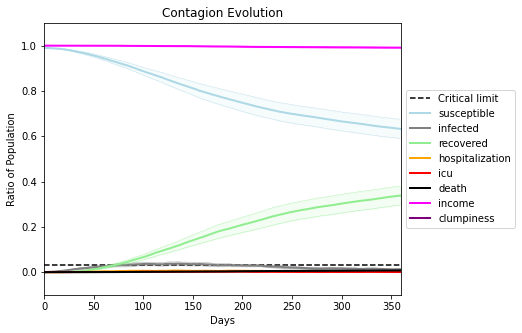

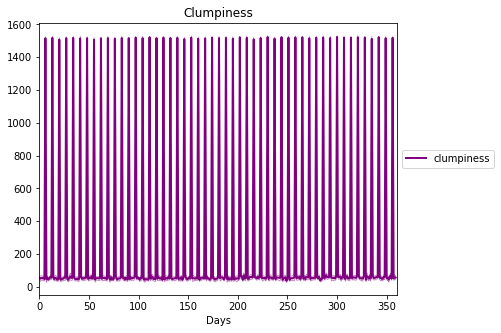

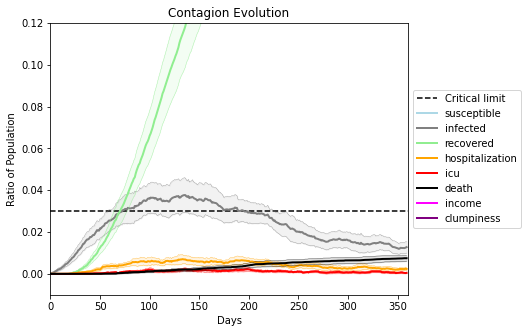

In [27]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.66
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5645, 3349, 1559, 6556, 4617, 1295, 1196, 5778, 5412, 8307, 8318, 9683, 4147, 6036, 6005, 2993, 8133, 8592, 4375, 3405]
Average similarity between family members is 0.010051479114043934 at temperature 1
Average similarity between family and home is 0.999859889212737 at temperature -1
Average similarity between students and their classroom is 0.02681752191007702 at temperature 1
Average classroom occupancy is 1.6284153005464481 and number classrooms is 183
Average similarity between workers is 0.02215356334309346 at temperature 1
Average office occupancy is 3.225 and number offices is 200
Average friend similarity for adults: 0.0873698470417613 for kids: 0.09364054226136283
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding

avg restaurant similarity 0.03454916199248244
avg restaurant similarity 0.07523064625385921
avg restaurant similarity -0.08552981983670979
avg restaurant similarity 0.0370121991564286
avg restaurant similarity 0.2851511215176932
avg restaurant similarity 0.07811950240294616
avg restaurant similarity 0.1260520154844992
avg restaurant similarity 0.01146090608369293
avg restaurant similarity -0.3317332682402165
avg restaurant similarity 0.050415965698746554
avg restaurant similarity -0.0631870739874938
avg restaurant similarity -0.05119720820417786
avg restaurant similarity -0.0589427355716012
avg restaurant similarity 0.05863765595640502
avg restaurant similarity 0.08881784635785224
avg restaurant similarity -0.07940640208607605
avg restaurant similarity -0.030949925560952433
avg restaurant similarity -0.033470483850551964
avg restaurant similarity 0.02731061005162452
avg restaurant similarity 0.10451969651088966
avg restaurant similarity 0.15543192411977425
avg restaurant similarity -0.

avg restaurant similarity 0.0388151175216986
avg restaurant similarity 0.05330821397056805
avg restaurant similarity 0.12293879881455358
avg restaurant similarity -0.09863974397012874
avg restaurant similarity -0.2014985269050523
avg restaurant similarity -0.0210183396803491
avg restaurant similarity -0.05871284716468604
avg restaurant similarity 0.017494099670965303
avg restaurant similarity 0.045548570412848044
avg restaurant similarity -0.08452497284676694
avg restaurant similarity -0.09108776897435078
avg restaurant similarity 0.1660254076078069
avg restaurant similarity -0.25426800564063917
avg restaurant similarity 0.014273306870912269
avg restaurant similarity 0.025333322099026438
avg restaurant similarity 0.019491807120005335
avg restaurant similarity 0.1419261310197518
avg restaurant similarity -0.11492597989222685
avg restaurant similarity 0.0886640046775205
avg restaurant similarity -0.07562748559341784
avg restaurant similarity -0.09894878743971906
avg restaurant similarity

avg restaurant similarity -0.018172915955032336
Average similarity between family members is -0.0018919196715862139 at temperature 1
Average similarity between family and home is 0.999846467947902 at temperature -1
Average similarity between students and their classroom is 0.03351503900462173 at temperature 1
Average classroom occupancy is 1.6596858638743455 and number classrooms is 191
Average similarity between workers is 0.019635012532561575 at temperature 1
Average office occupancy is 3.2256410256410257 and number offices is 195
Average friend similarity for adults: 0.083431703698289 for kids: 0.10108775380462263
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 peop

avg restaurant similarity 0.1441571778454462
avg restaurant similarity -0.10193116035310403
avg restaurant similarity -0.030650867652348274
avg restaurant similarity -0.2720797169017673
avg restaurant similarity 0.3106512287068483
avg restaurant similarity 0.2687969233551603
avg restaurant similarity -0.042026781596309896
avg restaurant similarity 0.020477648380585817
avg restaurant similarity 0.05583720297048565
avg restaurant similarity 0.006384110883211774
avg restaurant similarity 0.06645106788256122
avg restaurant similarity 0.13443964934047245
avg restaurant similarity 0.0779686379187189
avg restaurant similarity 0.07877126518518215
avg restaurant similarity -0.09924431516141945
avg restaurant similarity -0.0029014907429562864
avg restaurant similarity -0.0153583055884524
avg restaurant similarity 0.004810700887102691
avg restaurant similarity 0.180539607096833
avg restaurant similarity 0.17229964493959654
avg restaurant similarity 0.0038110100049755626
avg restaurant similarity 

avg restaurant similarity -0.25260154379420424
avg restaurant similarity -0.18821338134839066
avg restaurant similarity -0.035416529731518175
avg restaurant similarity -0.04442912146773687
avg restaurant similarity 0.034544576255781424
avg restaurant similarity -0.014240036096447969
avg restaurant similarity -0.08307381759407563
avg restaurant similarity -0.07896061107175589
avg restaurant similarity 0.15904662153144372
avg restaurant similarity -0.013261798586025596
avg restaurant similarity -0.26758206474460344
avg restaurant similarity 0.021414016397007476
avg restaurant similarity 0.05379780411902737
avg restaurant similarity -0.04467862644768871
avg restaurant similarity -0.021003717396391824
avg restaurant similarity 0.3819955937038817
avg restaurant similarity 0.0336985916911337
avg restaurant similarity -0.060613764496185676
avg restaurant similarity -0.15239109570638074
avg restaurant similarity 0.14605207562089123
avg restaurant similarity 0.11467552558630664
avg restaurant s

Average similarity between workers is 0.0011806673409331114 at temperature 1
Average office occupancy is 3.200980392156863 and number offices is 204
Average friend similarity for adults: 0.07499770932052238 for kids: 0.07969900260415867
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 peop

avg restaurant similarity -0.0862047505580793
avg restaurant similarity 0.0031503466124515682
avg restaurant similarity 0.1446638084495288
avg restaurant similarity 0.251988867950067
avg restaurant similarity -0.09669165708140595
avg restaurant similarity 0.03166537786428872
avg restaurant similarity -0.15507359525880343
avg restaurant similarity 0.06472594541165003
avg restaurant similarity 0.16040937419138462
avg restaurant similarity 0.14119658087581402
avg restaurant similarity 0.19201976507060098
avg restaurant similarity -0.20175038138980875
avg restaurant similarity -0.01237115997810854
avg restaurant similarity -0.032453964833911025
avg restaurant similarity 0.055782899222799776
avg restaurant similarity 0.0034085146005964906
avg restaurant similarity 0.12323282405489944
avg restaurant similarity 0.061336362275968885
avg restaurant similarity 0.08976319577492402
avg restaurant similarity 0.017064767534992753
avg restaurant similarity 0.011450529735869103
avg restaurant similari

avg restaurant similarity 0.0867083040740607
avg restaurant similarity 0.1472366248780309
avg restaurant similarity -0.18757103819492985
avg restaurant similarity 0.3242999394649878
avg restaurant similarity -0.1550395870304449
avg restaurant similarity 0.09823491414796193
avg restaurant similarity -0.03156652918224146
avg restaurant similarity 0.07913625536413404
avg restaurant similarity -0.16817695731932458
avg restaurant similarity 0.01740450450593195
avg restaurant similarity 0.03788892065242291
avg restaurant similarity 0.06641358283870027
avg restaurant similarity 0.10893304373463931
avg restaurant similarity -0.08568526555181434
avg restaurant similarity 0.11918870702723802
avg restaurant similarity -0.048996873727005695
avg restaurant similarity -0.016540411711702643
avg restaurant similarity 0.26129652731545533
avg restaurant similarity 0.03652553353406532
avg restaurant similarity -0.15521159838152213
avg restaurant similarity 0.26003878848721756
avg restaurant similarity -0

avg restaurant similarity -0.1033709348314867
avg restaurant similarity 0.015276537472661724
avg restaurant similarity 0.1238892674984065
avg restaurant similarity 0.07634464513646379
Average similarity between family members is -0.008794466275916568 at temperature 1
Average similarity between family and home is 0.9998449471018241 at temperature -1
Average similarity between students and their classroom is 0.007991610446778373 at temperature 1
Average classroom occupancy is 1.543956043956044 and number classrooms is 182
Average similarity between workers is -0.002310059066729016 at temperature 1
Average office occupancy is 3.38659793814433 and number offices is 194
Average friend similarity for adults: 0.0839855181103492 for kids: 0.08717279391765403
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 

avg restaurant similarity 0.05231625621606492
avg restaurant similarity -0.09119731233432725
avg restaurant similarity 0.03788243642477805
avg restaurant similarity 0.03746829954293104
avg restaurant similarity -0.0719653922839682
avg restaurant similarity 0.14993249940347597
avg restaurant similarity 0.010954113259138204
avg restaurant similarity 0.020813903015966372
avg restaurant similarity -0.27899470915207625
avg restaurant similarity -0.024697875445463383
avg restaurant similarity 0.046234815009445956
avg restaurant similarity -0.09140910645252238
avg restaurant similarity 0.01749463601413212
avg restaurant similarity -0.005173495984659413
avg restaurant similarity -0.07496300054851356
avg restaurant similarity 0.012842790713053555
avg restaurant similarity -0.01807451164120493
avg restaurant similarity -0.06739091388666765
avg restaurant similarity 0.012704368966278847
avg restaurant similarity 0.02602907042868283
avg restaurant similarity -0.09096549634533788
avg restaurant sim

avg restaurant similarity 0.014355351951664022
avg restaurant similarity 0.14563712119626254
avg restaurant similarity 0.1424437168651988
avg restaurant similarity 0.01903673919731008
avg restaurant similarity 0.1691311124996074
avg restaurant similarity -0.26052314818140077
avg restaurant similarity -0.0836759275832139
avg restaurant similarity -0.27298259146937337
avg restaurant similarity -0.24865675719712832
avg restaurant similarity 0.3994971392735136
avg restaurant similarity 0.13752259647158943
avg restaurant similarity -0.19318231962345936
avg restaurant similarity -0.07717601232459853
avg restaurant similarity 0.13672167481536862
avg restaurant similarity -0.07632983539482592
avg restaurant similarity -0.36539498539109
avg restaurant similarity -0.053498901860643475
avg restaurant similarity -0.05903953894158509
avg restaurant similarity 0.004973882230490905
avg restaurant similarity -0.09730186513095325
avg restaurant similarity -0.12902170904481794
avg restaurant similarity 

Average similarity between family and home is 0.9998481754574065 at temperature -1
Average similarity between students and their classroom is 0.026384861853250723 at temperature 1
Average classroom occupancy is 1.5837837837837838 and number classrooms is 185
Average similarity between workers is 0.03239141555173687 at temperature 1
Average office occupancy is 3.2587064676616917 and number offices is 201
Average friend similarity for adults: 0.08680226257986315 for kids: 0.09905699936993081
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 p

avg restaurant similarity -0.04018094135775658
avg restaurant similarity 0.1599837975954067
avg restaurant similarity -0.057982233456582176
avg restaurant similarity -0.04502953096854186
avg restaurant similarity 0.32392421335233834
avg restaurant similarity -0.18038504744277334
avg restaurant similarity 0.07765984121868023
avg restaurant similarity -0.11397881970063148
avg restaurant similarity 0.3705086185499984
avg restaurant similarity 0.012259457424865323
avg restaurant similarity 0.12273940747934313
avg restaurant similarity 0.012658091273534098
avg restaurant similarity -0.0012896257573310104
avg restaurant similarity 0.030691729810140473
avg restaurant similarity 0.04292874178281509
avg restaurant similarity -0.12257631187289647
avg restaurant similarity 0.1346088110042176
avg restaurant similarity 0.11588564159732945
avg restaurant similarity 0.5129659081773615
avg restaurant similarity -0.03210185510511821
avg restaurant similarity 0.10265330202227069
avg restaurant similarit

avg restaurant similarity 0.07913424681561314
avg restaurant similarity 0.25255246851102664
avg restaurant similarity -0.017439681087956765
avg restaurant similarity 0.030631004420211123
avg restaurant similarity -0.057832280877899586
avg restaurant similarity 0.11516399524193599
avg restaurant similarity 0.08779237815555181
avg restaurant similarity 0.21230834194141843
avg restaurant similarity 0.05953265144973642
avg restaurant similarity 0.19381214040189598
avg restaurant similarity 0.09824804287452621
avg restaurant similarity 0.07591559689735138
avg restaurant similarity 0.05455807718936746
avg restaurant similarity 0.0898290852015707
avg restaurant similarity 0.1660598462709475
avg restaurant similarity -0.016241580514191008
avg restaurant similarity 0.10127214815569596
avg restaurant similarity 0.10167885574283742
avg restaurant similarity 0.0745861332242188
avg restaurant similarity 0.4788975222663904
avg restaurant similarity 0.05455668680374389
avg restaurant similarity 0.070

Average similarity between workers is -0.020163643145248072 at temperature 1
Average office occupancy is 3.3217821782178216 and number offices is 202
Average friend similarity for adults: 0.08522757567762 for kids: 0.07650971377503349
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 peop

avg restaurant similarity -0.04317521224974529
avg restaurant similarity -0.08014452896969812
avg restaurant similarity 0.01282594749352429
avg restaurant similarity 0.025315599222852054
avg restaurant similarity -0.012285636982882524
avg restaurant similarity 0.086664535187118
avg restaurant similarity -0.052397919248169215
avg restaurant similarity -0.05212853646259473
avg restaurant similarity 0.03263024529079438
avg restaurant similarity 0.016165416204966154
avg restaurant similarity -0.04514135027229018
avg restaurant similarity -0.163297717604786
avg restaurant similarity -0.08068073366288175
avg restaurant similarity 0.13786737609108807
avg restaurant similarity 0.06302233868729037
avg restaurant similarity 0.10983649521715838
avg restaurant similarity 0.0593570596320813
avg restaurant similarity -0.09538559748354582
avg restaurant similarity 0.06976202684481285
avg restaurant similarity 0.09405463627313633
avg restaurant similarity 0.01982386948118285
avg restaurant similarity 

avg restaurant similarity -0.19136061117939224
avg restaurant similarity 0.1207792411262782
avg restaurant similarity 0.11565462739724555
avg restaurant similarity 0.039744480138595495
avg restaurant similarity -0.07391029603214946
avg restaurant similarity -0.10884671835010497
avg restaurant similarity 0.1330905188436157
avg restaurant similarity -0.10157778782712291
avg restaurant similarity 0.10738697445897408
avg restaurant similarity -0.1373505207264575
avg restaurant similarity -0.20395057693726173
avg restaurant similarity 0.04620776090195689
avg restaurant similarity 0.16292155786286414
avg restaurant similarity -0.004821103012625258
avg restaurant similarity 0.09321243505176599
avg restaurant similarity -0.07888696924337053
avg restaurant similarity 0.022540401738453997
avg restaurant similarity -0.24467565667526467
avg restaurant similarity -0.05621551716447525
avg restaurant similarity 0.09068748587881921
avg restaurant similarity -0.3977997256196759
avg restaurant similarit

avg restaurant similarity -0.09126839667408625
avg restaurant similarity 0.10441289008507715
avg restaurant similarity -0.04848139578509417
avg restaurant similarity -0.06449785871322478
avg restaurant similarity 0.10183016077805275
avg restaurant similarity -0.1416878272832217
avg restaurant similarity 0.016204583494636937
Average similarity between family members is 0.020517061941570675 at temperature 1
Average similarity between family and home is 0.999856326185182 at temperature -1
Average similarity between students and their classroom is 0.02015415291296737 at temperature 1
Average classroom occupancy is 1.558011049723757 and number classrooms is 181
Average similarity between workers is 0.023136944588473804 at temperature 1
Average office occupancy is 3.269607843137255 and number offices is 204
Average friend similarity for adults: 0.07958714517969777 for kids: 0.09270021292363773
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capa

avg restaurant similarity -0.09686053588300901
avg restaurant similarity 0.23766285166438433
avg restaurant similarity 0.03128070297279085
avg restaurant similarity -0.12044080027624167
avg restaurant similarity 0.33286780262272925
avg restaurant similarity 0.29213141281087857
avg restaurant similarity 0.049832678530105576
avg restaurant similarity 0.2443649301597616
avg restaurant similarity -0.0166462925317331
avg restaurant similarity 0.14099002203414668
avg restaurant similarity -0.009378528859165467
avg restaurant similarity -0.05228949306249112
avg restaurant similarity -0.0963082140249308
avg restaurant similarity 0.025679564099907737
avg restaurant similarity 0.11919683220214401
avg restaurant similarity -0.12254029884224993
avg restaurant similarity 0.18448216963217515
avg restaurant similarity 0.06349879649978309
avg restaurant similarity 0.0004057247947913373
avg restaurant similarity -0.17348378287154753
avg restaurant similarity 0.01183012882041278
avg restaurant similarit

avg restaurant similarity 0.1482360165203823
avg restaurant similarity 0.12763004649037685
avg restaurant similarity 0.13187726637839553
avg restaurant similarity -0.030049790621342262
avg restaurant similarity -0.006460568975462009
avg restaurant similarity -0.005171599184656392
avg restaurant similarity 0.21481205887776905
avg restaurant similarity 0.22338862427785636
avg restaurant similarity -0.06271130858116271
avg restaurant similarity 0.11234868779678091
avg restaurant similarity -0.04001428838515613
avg restaurant similarity 0.19113240116694302
avg restaurant similarity -0.10173706579304179
avg restaurant similarity -0.018465493354272604
avg restaurant similarity -0.03005348638801041
avg restaurant similarity 0.00030686330877123725
avg restaurant similarity 0.10612230755746166
avg restaurant similarity 0.19770336591988893
avg restaurant similarity -0.39124104505162904
avg restaurant similarity 0.021590306929498402
avg restaurant similarity 0.14004557310824792
avg restaurant sim

avg restaurant similarity 0.17152763152670994
avg restaurant similarity 0.1001370570334643
avg restaurant similarity -0.05432733229522092
avg restaurant similarity -0.18657626912081643
Average similarity between family members is 0.013466018377435149 at temperature 1
Average similarity between family and home is 0.9998514562149158 at temperature -1
Average similarity between students and their classroom is 0.008598557469596025 at temperature 1
Average classroom occupancy is 1.7300613496932515 and number classrooms is 163
Average similarity between workers is 0.019083149689730756 at temperature 1
Average office occupancy is 3.366336633663366 and number offices is 202
Average friend similarity for adults: 0.08000786894087397 for kids: 0.08433181339636685
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 

avg restaurant similarity -0.18629815901391486
avg restaurant similarity -0.038289501409311276
avg restaurant similarity -0.13019323305236818
avg restaurant similarity -0.3961609931013449
avg restaurant similarity -0.045284558505522675
avg restaurant similarity -0.025436009935102755
avg restaurant similarity -0.1324047050653562
avg restaurant similarity -0.052896463698374585
avg restaurant similarity 0.41788179300809103
avg restaurant similarity -0.003122454071296403
avg restaurant similarity -0.2772607879423384
avg restaurant similarity 0.07138831908775417
avg restaurant similarity 0.10976197542492502
avg restaurant similarity -0.2002186278189031
avg restaurant similarity -0.02891449200237383
avg restaurant similarity -0.13840765701016208
avg restaurant similarity -0.0006999815904911236
avg restaurant similarity 0.18024551832519564
avg restaurant similarity -0.016084205069176266
avg restaurant similarity -0.19796383157298375
avg restaurant similarity -0.07455291440071908
avg restauran

avg restaurant similarity -0.046107371520691415
avg restaurant similarity -0.050950561347128775
avg restaurant similarity 0.06255036733571107
avg restaurant similarity 0.21934193472893235
avg restaurant similarity -0.10420458450498411
avg restaurant similarity 0.10933194108640283
avg restaurant similarity -0.03633586059005769
avg restaurant similarity 0.03547936722499393
avg restaurant similarity -0.012123737897412636
avg restaurant similarity 0.12290901649464922
avg restaurant similarity -0.18333460984841168
avg restaurant similarity -0.386237380600049
avg restaurant similarity 0.16800931903756477
avg restaurant similarity -0.24710927302600835
avg restaurant similarity 0.07728430460250989
avg restaurant similarity -0.03362442361131217
avg restaurant similarity -0.07964374425101627
avg restaurant similarity 0.030196702640950587
avg restaurant similarity -0.27774330922610047
avg restaurant similarity 0.0013028111227394632
avg restaurant similarity 0.032511008292784284
avg restaurant sim

avg restaurant similarity 0.060244587505191426
avg restaurant similarity 0.04605145161122739
avg restaurant similarity -0.20880251670924138
avg restaurant similarity -0.07411016438871545
avg restaurant similarity -0.04047989729671935
Average similarity between family members is -0.0039611119683857585 at temperature 1
Average similarity between family and home is 0.9998518824889299 at temperature -1
Average similarity between students and their classroom is 0.02459137306236878 at temperature 1
Average classroom occupancy is 1.56 and number classrooms is 175
Average similarity between workers is 0.03413273946538789 at temperature 1
Average office occupancy is 3.3401015228426396 and number offices is 197
Average friend similarity for adults: 0.08796191128452926 for kids: 0.1019643917201075
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this dis

avg restaurant similarity -0.01396414017072124
avg restaurant similarity -0.015467690993107911
avg restaurant similarity 0.031838133361739115
avg restaurant similarity 0.028114745326510995
avg restaurant similarity -0.4083610264439366
avg restaurant similarity 0.01147693537388778
avg restaurant similarity 0.15521387853014984
avg restaurant similarity -0.030503127051175437
avg restaurant similarity 0.10037095519315509
avg restaurant similarity 0.05320331775785843
avg restaurant similarity -0.03870162786528592
avg restaurant similarity 0.21817924943251277
avg restaurant similarity 0.08576628178598884
avg restaurant similarity 0.0069026518722200446
avg restaurant similarity -0.05101861379140259
avg restaurant similarity 0.08105264770941044
avg restaurant similarity -0.0060401128372286755
avg restaurant similarity 0.11797500542365072
avg restaurant similarity 0.06413281401148836
avg restaurant similarity 0.11735734466507697
avg restaurant similarity 0.044445461480284186
avg restaurant simi

avg restaurant similarity 0.01856797485627498
avg restaurant similarity 0.10600412981010952
avg restaurant similarity 0.10176969587206021
avg restaurant similarity 0.008643394861872156
avg restaurant similarity 0.07626885084578588
avg restaurant similarity -0.09126708379923672
avg restaurant similarity -0.1432651609601812
avg restaurant similarity -0.04137648427342942
avg restaurant similarity 0.08860237849275962
avg restaurant similarity 0.09978886187507952
avg restaurant similarity 0.08684099041157944
avg restaurant similarity 0.06413281401148836
avg restaurant similarity -0.023601001352797007
avg restaurant similarity -0.07966360010360826
avg restaurant similarity -0.037849623409751086
avg restaurant similarity -0.11906176415234586
avg restaurant similarity 0.04232834470306658
avg restaurant similarity -0.03221879145447633
avg restaurant similarity 0.03094398102040653
avg restaurant similarity 0.13480093194723305
avg restaurant similarity -0.08672907225134023
avg restaurant similari

avg restaurant similarity 0.058885611033669044
avg restaurant similarity -0.0969136235849853
Average similarity between family members is 0.03250460881217457 at temperature 1
Average similarity between family and home is 0.9998504208728999 at temperature -1
Average similarity between students and their classroom is 0.0378989019387426 at temperature 1
Average classroom occupancy is 1.5433526011560694 and number classrooms is 173
Average similarity between workers is 0.020786722658287682 at temperature 1
Average office occupancy is 3.404040404040404 and number offices is 198
Average friend similarity for adults: 0.08248963738745045 for kids: 0.08998884064670683
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units 

avg restaurant similarity -0.01145314461015512
avg restaurant similarity -0.16019005964683414
avg restaurant similarity -0.008884148011012465
avg restaurant similarity -0.21576593732587349
avg restaurant similarity 0.022640002190051942
avg restaurant similarity -0.12491199673288213
avg restaurant similarity -0.0038673620983813053
avg restaurant similarity -0.07093824156468098
avg restaurant similarity 0.047199695239806626
avg restaurant similarity 0.11091964294687898
avg restaurant similarity -0.015767321615557047
avg restaurant similarity 0.09942293865633976
avg restaurant similarity 0.039776040586308285
avg restaurant similarity -0.3245526997469716
avg restaurant similarity -0.05775802771443239
avg restaurant similarity -0.18171898703165143
avg restaurant similarity -0.03738704271046408
avg restaurant similarity 0.29580655620677176
avg restaurant similarity -0.0674163969121932
avg restaurant similarity -0.22537221688949766
avg restaurant similarity -0.004109934914301019
avg restauran

avg restaurant similarity 0.07329940596122952
avg restaurant similarity 0.01312591723041974
avg restaurant similarity 0.10488680190290514
avg restaurant similarity -0.08945465048751546
avg restaurant similarity 0.04950631827931578
avg restaurant similarity -0.011514283323503441
avg restaurant similarity -0.11316169779425768
avg restaurant similarity -0.2606760332067535
avg restaurant similarity -0.0022421094400671524
avg restaurant similarity 0.07837268251036372
avg restaurant similarity -0.05951048561245016
avg restaurant similarity -0.010968341497838853
avg restaurant similarity 0.002174880601955011
avg restaurant similarity -0.000554035280270343
avg restaurant similarity 0.2394226908107328
avg restaurant similarity 0.0008037152450572391
avg restaurant similarity 0.06939417685580286
avg restaurant similarity -0.09315839339197335
avg restaurant similarity 0.01201307681911402
avg restaurant similarity -0.0925282799680304
avg restaurant similarity 0.004882809932178063
avg restaurant sim

avg restaurant similarity 0.027379275725951113
avg restaurant similarity -0.010142047784735415
avg restaurant similarity -0.09844027372938137
avg restaurant similarity 0.020482413235355403
Average similarity between family members is 0.018013155812603567 at temperature 1
Average similarity between family and home is 0.9998484441306713 at temperature -1
Average similarity between students and their classroom is 0.03587454322297924 at temperature 1
Average classroom occupancy is 1.7116564417177915 and number classrooms is 163
Average similarity between workers is 0.005812075420442097 at temperature 1
Average office occupancy is 3.3165829145728645 and number offices is 199
Average friend similarity for adults: 0.08288877856743847 for kids: 0.08699351397936454
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.16122462076540148
avg restaurant similarity 0.07601132501069016
avg restaurant similarity 0.04175617925949448
avg restaurant similarity 0.1418346596224042
avg restaurant similarity -0.0761070605867442
avg restaurant similarity 0.023932530347576912
avg restaurant similarity 0.10704216640092537
avg restaurant similarity 0.10832064979280903
avg restaurant similarity 0.13578660553298613
avg restaurant similarity 0.03210335499182068
avg restaurant similarity -0.09947748339091374
avg restaurant similarity 0.0661926202910586
avg restaurant similarity 0.01962578319307044
avg restaurant similarity 0.031238594277955736
avg restaurant similarity -0.10074100770964248
avg restaurant similarity -0.005231210183083672
avg restaurant similarity 0.07956738409792913
avg restaurant similarity 0.13700305297664472
avg restaurant similarity -0.038375444166693605
avg restaurant similarity 0.03505421580110961
avg restaurant similarity -0.15352648541116617
avg restaurant similarity 0

avg restaurant similarity 0.01655225620758401
avg restaurant similarity -0.08510367760611312
avg restaurant similarity -0.04754269136202486
avg restaurant similarity 0.06270573800121461
avg restaurant similarity 0.19805937979392463
avg restaurant similarity -0.02902837443966795
avg restaurant similarity -0.016510481429443464
avg restaurant similarity -0.3669553862482947
avg restaurant similarity 0.026113881809813437
avg restaurant similarity -0.21388745978530974
avg restaurant similarity -0.034073560685949536
avg restaurant similarity 0.11109241566574893
avg restaurant similarity -0.04557126236689717
avg restaurant similarity -0.070759872677365
avg restaurant similarity 0.018708703648726534
avg restaurant similarity -0.026528169557888132
avg restaurant similarity -0.047688546124372615
avg restaurant similarity -0.05114193502586317
avg restaurant similarity 0.09578344970154339
avg restaurant similarity -0.03034090113263711
avg restaurant similarity 0.006196425916088463
avg restaurant si

avg restaurant similarity -0.0791560963011366
avg restaurant similarity -0.09295024030738934
avg restaurant similarity -0.23614526834116054
avg restaurant similarity -0.03936044879216745
avg restaurant similarity 0.059740534416355885
avg restaurant similarity 0.2092801097437693
Average similarity between family members is -0.0145432936580099 at temperature 1
Average similarity between family and home is 0.9998505252183739 at temperature -1
Average similarity between students and their classroom is -0.020210033416871213 at temperature 1
Average classroom occupancy is 1.6577540106951871 and number classrooms is 187
Average similarity between workers is -0.00948945205476341 at temperature 1
Average office occupancy is 3.317948717948718 and number offices is 195
Average friend similarity for adults: 0.07325186263821307 for kids: 0.08424983344031285
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a

avg restaurant similarity -0.02191397654628971
avg restaurant similarity 0.01911083018661794
avg restaurant similarity 0.09561371740793527
avg restaurant similarity 0.03207023777928212
avg restaurant similarity -0.08198816065585687
avg restaurant similarity 0.016799165418267245
avg restaurant similarity 0.08361882667068492
avg restaurant similarity -0.043439598878693295
avg restaurant similarity 0.05025210499207775
avg restaurant similarity 0.07709241689095181
avg restaurant similarity 0.09595622329267517
avg restaurant similarity 0.051399892226780694
avg restaurant similarity 0.00029506124903400793
avg restaurant similarity 0.049385489045304896
avg restaurant similarity -0.16342371841709302
avg restaurant similarity -0.09140322584937777
avg restaurant similarity -0.02897694925796299
avg restaurant similarity -0.07171036106061757
avg restaurant similarity -0.01149801453936318
avg restaurant similarity 0.05971713394170186
avg restaurant similarity -0.06719784403654297
avg restaurant sim

avg restaurant similarity -0.03899237418683092
avg restaurant similarity -0.16507548196744745
avg restaurant similarity 0.06362487170250496
avg restaurant similarity -0.2146588648641431
avg restaurant similarity 0.11238540295884732
avg restaurant similarity -0.12195443134113275
avg restaurant similarity -0.06295552504606598
avg restaurant similarity 0.005487043214532102
avg restaurant similarity 0.0023221816232721717
avg restaurant similarity -0.10179044004468953
avg restaurant similarity -0.09191535543863763
avg restaurant similarity 0.04220523032336095
avg restaurant similarity 0.16555469804504902
avg restaurant similarity -0.031805585635310774
avg restaurant similarity 0.027791248053663897
avg restaurant similarity -0.08002920390394867
avg restaurant similarity 0.35068189253986004
avg restaurant similarity -0.08405142699173461
avg restaurant similarity 0.039238796510091004
avg restaurant similarity 0.0325734860014957
avg restaurant similarity 0.07333373150107743
avg restaurant simil

avg restaurant similarity -0.11517852945998469
avg restaurant similarity -0.05380766844640377
avg restaurant similarity 0.029552423500662398
avg restaurant similarity -0.030966476955237035
avg restaurant similarity -0.06936261176920142
avg restaurant similarity 0.008601796971006506
avg restaurant similarity 0.03238439902135573
avg restaurant similarity -0.07965908544614098
Average similarity between family members is 0.008312042069209637 at temperature 1
Average similarity between family and home is 0.9998553542529274 at temperature -1
Average similarity between students and their classroom is 0.030317080546764113 at temperature 1
Average classroom occupancy is 1.6312849162011174 and number classrooms is 179
Average similarity between workers is 0.016440604637080823 at temperature 1
Average office occupancy is 3.2955665024630543 and number offices is 203
Average friend similarity for adults: 0.09198569576992884 for kids: 0.10736165531696451
home_districts
[
Home (0,0) district with 1 B

avg restaurant similarity 0.11872676394337087
avg restaurant similarity 0.08403657920566461
avg restaurant similarity 0.09324850369606048
avg restaurant similarity -0.07828059681638819
avg restaurant similarity 0.06692292235460426
avg restaurant similarity 0.17389972767897657
avg restaurant similarity 0.046675075834602134
avg restaurant similarity 0.12620778182668607
avg restaurant similarity 0.15437150073460665
avg restaurant similarity -0.008666398072054477
avg restaurant similarity 0.13935695084133465
avg restaurant similarity 0.032053444708423286
avg restaurant similarity -0.070159890112138
avg restaurant similarity 0.1303542215236747
avg restaurant similarity 0.0868421149942461
avg restaurant similarity -0.00857807518012581
avg restaurant similarity 0.09087863648456046
avg restaurant similarity -0.1388740952021796
avg restaurant similarity 0.10531142043392072
avg restaurant similarity 0.11471721241566216
avg restaurant similarity -0.04484942565821262
avg restaurant similarity 0.08

avg restaurant similarity -0.03884124779281807
avg restaurant similarity 0.19425052087301076
avg restaurant similarity -0.010197301912866082
avg restaurant similarity 0.12893245897524064
avg restaurant similarity 0.05944191167532515
avg restaurant similarity 0.3378396829789518
avg restaurant similarity -0.28573561401795533
avg restaurant similarity 0.26611713711075274
avg restaurant similarity 0.3378398530890039
avg restaurant similarity -0.17137262986708376
avg restaurant similarity 0.10075575498060049
avg restaurant similarity 0.3342729097872044
avg restaurant similarity -0.012275625921830471
avg restaurant similarity 0.3444592309461362
avg restaurant similarity -0.045353628884693326
avg restaurant similarity 0.23838394024750337
avg restaurant similarity -0.04010347479462171
avg restaurant similarity -0.03616761391573163
avg restaurant similarity 0.08974299350593672
avg restaurant similarity -0.005170030721253753
avg restaurant similarity 0.0691598179544757
avg restaurant similarity 

Average similarity between students and their classroom is -0.010471988367511422 at temperature 1
Average classroom occupancy is 1.719298245614035 and number classrooms is 171
Average similarity between workers is 0.020863660737936784 at temperature 1
Average office occupancy is 3.2118226600985222 and number offices is 203
Average friend similarity for adults: 0.0890630233351093 for kids: 0.0772810705644516
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in thi

avg restaurant similarity 0.13005800858224464
avg restaurant similarity -0.10193596009728566
avg restaurant similarity -0.15362242575355078
avg restaurant similarity -0.007770966005695819
avg restaurant similarity -0.052062573056358384
avg restaurant similarity -0.048479059420102076
avg restaurant similarity 0.017755389068457965
avg restaurant similarity -0.23053629853401642
avg restaurant similarity -0.1789670132134783
avg restaurant similarity -0.05279573481514781
avg restaurant similarity 0.14745084042332918
avg restaurant similarity 0.11582928564092924
avg restaurant similarity 0.05483018345212836
avg restaurant similarity -0.029143836103121556
avg restaurant similarity 0.01019677250500751
avg restaurant similarity -0.05453074171259957
avg restaurant similarity -0.021661606389481676
avg restaurant similarity -0.0013117733765152207
avg restaurant similarity -0.16692243298626022
avg restaurant similarity -0.01867736846543289
avg restaurant similarity 0.05781433833745595
avg restauran

avg restaurant similarity -0.2870567165604926
avg restaurant similarity -0.1070788392792886
avg restaurant similarity 0.0420750904640713
avg restaurant similarity -0.07469194657427579
avg restaurant similarity 0.04437334365322833
avg restaurant similarity 0.0968641059631017
avg restaurant similarity -0.049418241358152155
avg restaurant similarity 0.05002793598589791
avg restaurant similarity 0.1178411836711976
avg restaurant similarity -0.21816130391208455
avg restaurant similarity -0.028170597040880523
avg restaurant similarity -0.27817527108198037
avg restaurant similarity 0.048045527943185645
avg restaurant similarity 0.19766224713132413
avg restaurant similarity 0.12600990916706362
avg restaurant similarity 0.15821562930799601
avg restaurant similarity -0.006249398367975478
avg restaurant similarity -0.1144558837537355
avg restaurant similarity 0.008243410132629437
avg restaurant similarity -0.17319153341218435
avg restaurant similarity -0.13982668543691745
avg restaurant similarit

avg restaurant similarity -0.010296571513446087
avg restaurant similarity -0.03273220500954524
avg restaurant similarity 0.03996173642286852
avg restaurant similarity -0.008919387134719176
avg restaurant similarity -0.031526193438110396
avg restaurant similarity -0.06789028457576556
avg restaurant similarity -0.09818791882612007
Average similarity between family members is -0.0025539828478609184 at temperature 1
Average similarity between family and home is 0.9998585623198025 at temperature -1
Average similarity between students and their classroom is 0.016085645333605784 at temperature 1
Average classroom occupancy is 1.6032608695652173 and number classrooms is 184
Average similarity between workers is 0.020429663074196885 at temperature 1
Average office occupancy is 3.255 and number offices is 200
Average friend similarity for adults: 0.0780377030439404 for kids: 0.08883506624746937
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacit

avg restaurant similarity -0.007834827018813922
avg restaurant similarity 0.1541984569238949
avg restaurant similarity -0.0872178948212446
avg restaurant similarity 0.15743769606663915
avg restaurant similarity -0.09956589529093368
avg restaurant similarity 0.0008345779567167077
avg restaurant similarity -0.04970097131583957
avg restaurant similarity 0.1122616983563829
avg restaurant similarity -0.12395750222394089
avg restaurant similarity -0.005186389692286532
avg restaurant similarity -0.12810563552575663
avg restaurant similarity -0.0797460006591544
avg restaurant similarity -0.00476913240979309
avg restaurant similarity 0.007266381218865
avg restaurant similarity 0.22061026892088004
avg restaurant similarity -0.05391324628444048
avg restaurant similarity -0.04899259805816459
avg restaurant similarity 0.020179705090937545
avg restaurant similarity 0.1080007695710029
avg restaurant similarity 0.031276068510510346
avg restaurant similarity 0.029299332913356096
avg restaurant similari

avg restaurant similarity -0.07155596815572227
avg restaurant similarity -0.27934831792325066
avg restaurant similarity -0.03494437475070307
avg restaurant similarity 0.007066088407347487
avg restaurant similarity -0.10901239159411982
avg restaurant similarity 0.1062199327255343
avg restaurant similarity 0.03468590359898661
avg restaurant similarity 0.05531104762607718
avg restaurant similarity -0.1060963766676742
avg restaurant similarity 0.016347089249333112
avg restaurant similarity -0.02712315339821748
avg restaurant similarity 0.16606839672925272
avg restaurant similarity -0.0594868054391523
avg restaurant similarity -0.02388816072998625
avg restaurant similarity -0.15388429769984616
avg restaurant similarity 0.18312778837640184
avg restaurant similarity -0.08443104345475944
avg restaurant similarity -0.019383786580571622
avg restaurant similarity -0.04093719572956008
avg restaurant similarity -0.04904978854056889
avg restaurant similarity 0.13747424206406292
avg restaurant simila

avg restaurant similarity -0.058294176952563295
avg restaurant similarity 0.05080834748937276
avg restaurant similarity -0.045424805487362406
avg restaurant similarity -0.1547657989106539
avg restaurant similarity 0.16747385793453107
Average similarity between family members is 0.020852915599937953 at temperature 1
Average similarity between family and home is 0.9998576414709057 at temperature -1
Average similarity between students and their classroom is -0.003378884089231926 at temperature 1
Average classroom occupancy is 1.5380434782608696 and number classrooms is 184
Average similarity between workers is -0.0006918339286840106 at temperature 1
Average office occupancy is 3.255 and number offices is 200
Average friend similarity for adults: 0.08601006209748957 for kids: 0.09063416004609184
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in thi

avg restaurant similarity -0.15584979112959874
avg restaurant similarity 0.022216094531188134
avg restaurant similarity -0.012384688865286177
avg restaurant similarity -0.005572112584675631
avg restaurant similarity 0.13969639373294387
avg restaurant similarity 0.0692246700416894
avg restaurant similarity -0.017135231102226173
avg restaurant similarity -0.04383594098585559
avg restaurant similarity -0.09391495488883297
avg restaurant similarity 0.10488129047055801
avg restaurant similarity -0.17278929109841468
avg restaurant similarity -0.08008850191814866
avg restaurant similarity -0.043869242764627815
avg restaurant similarity -0.07260852533887245
avg restaurant similarity 0.09037785101718603
avg restaurant similarity -0.07686226512092523
avg restaurant similarity -0.07986574474611219
avg restaurant similarity -0.014000244170533646
avg restaurant similarity 0.0007992180513076781
avg restaurant similarity -0.04940858108322461
avg restaurant similarity 0.06557871328689194
avg restauran

avg restaurant similarity -0.011715904192455023
avg restaurant similarity 0.0826241568946807
avg restaurant similarity -0.06035192310330342
avg restaurant similarity -0.10199469791768585
avg restaurant similarity -0.17415105435500475
avg restaurant similarity 0.09362679126462183
avg restaurant similarity 0.2455709434947696
avg restaurant similarity -0.004070143973721711
avg restaurant similarity 0.05019853534168746
avg restaurant similarity -0.006287132190195313
avg restaurant similarity -0.013799556835407808
avg restaurant similarity 0.019227972731091336
avg restaurant similarity -0.054664947001196354
avg restaurant similarity 0.013810064613263442
avg restaurant similarity -0.007087131384702752
avg restaurant similarity 0.09740927811599648
avg restaurant similarity 0.07156358355226448
avg restaurant similarity 0.014705224811115365
avg restaurant similarity -0.0600201805791913
avg restaurant similarity 0.03715048857788255
avg restaurant similarity 0.15045745548379483
avg restaurant sim

avg restaurant similarity -0.0294103148707812
avg restaurant similarity -0.026878501091225426
Average similarity between family members is 0.010555833505608809 at temperature 1
Average similarity between family and home is 0.9998507405569054 at temperature -1
Average similarity between students and their classroom is 0.03430022385746201 at temperature 1
Average classroom occupancy is 1.5268817204301075 and number classrooms is 186
Average similarity between workers is 0.008892067644157491 at temperature 1
Average office occupancy is 3.202970297029703 and number offices is 202
Average friend similarity for adults: 0.08676389328060449 for kids: 0.09425145627987848
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated u

avg restaurant similarity -0.03206073900051185
avg restaurant similarity 0.0033803544917713744
avg restaurant similarity 0.01699815228785898
avg restaurant similarity 0.0828268015928664
avg restaurant similarity 0.19908001330878067
avg restaurant similarity -0.08947014700010036
avg restaurant similarity 0.04254381863395494
avg restaurant similarity -0.05714841732345444
avg restaurant similarity -0.05725578915503445
avg restaurant similarity 0.047632771664746866
avg restaurant similarity -0.05483704198730991
avg restaurant similarity -0.05271833371644741
avg restaurant similarity 0.047272359111150776
avg restaurant similarity -0.025958625421370726
avg restaurant similarity -0.13952025458891262
avg restaurant similarity 0.04996144433634698
avg restaurant similarity 0.06091648487821216
avg restaurant similarity 0.06789403849665583
avg restaurant similarity 0.0754692649287629
avg restaurant similarity -0.00916342514751688
avg restaurant similarity -0.04426365862036342
avg restaurant simila

avg restaurant similarity -0.1713927443623477
avg restaurant similarity 0.1216245847400362
avg restaurant similarity 0.04766710354360923
avg restaurant similarity 0.007037943542183426
avg restaurant similarity -0.021017129415720134
avg restaurant similarity -0.09504251693136419
avg restaurant similarity 0.3117631096668139
avg restaurant similarity 0.12749022696545592
avg restaurant similarity 0.2205451512926828
avg restaurant similarity 0.10937333509958794
avg restaurant similarity -0.014803510559731234
avg restaurant similarity 0.08287300585635109
avg restaurant similarity -0.09507515204660234
avg restaurant similarity -0.009516250182011132
avg restaurant similarity 0.05481288236289968
avg restaurant similarity 0.14930645504346257
avg restaurant similarity 0.12389064980065566
avg restaurant similarity -0.1288804807709312
avg restaurant similarity -0.06304783282787868
avg restaurant similarity -0.06827402109715944
avg restaurant similarity -0.0470883188744269
avg restaurant similarity 

avg restaurant similarity 0.1656963605824108
avg restaurant similarity 0.1738446737664648
avg restaurant similarity 0.028644784814752428
avg restaurant similarity 0.03032764572009287
Average similarity between family members is 0.034576545361591535 at temperature 1
Average similarity between family and home is 0.9998546538903261 at temperature -1
Average similarity between students and their classroom is 0.035825268139277854 at temperature 1
Average classroom occupancy is 1.553191489361702 and number classrooms is 188
Average similarity between workers is 0.012265007428797287 at temperature 1
Average office occupancy is 3.23 and number offices is 200
Average friend similarity for adults: 0.08154267698582378 for kids: 0.10046748588482615
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity 0.003970536841021512
avg restaurant similarity -0.04936125486312061
avg restaurant similarity -0.010344525979173496
avg restaurant similarity 0.052028283617080076
avg restaurant similarity 0.046902157056715146
avg restaurant similarity 0.004703622878305131
avg restaurant similarity 0.017279438857443475
avg restaurant similarity -0.08337527723939146
avg restaurant similarity 0.0025104611844959206
avg restaurant similarity -0.015158993800304717
avg restaurant similarity 0.15583891458926055
avg restaurant similarity -0.05948203730185583
avg restaurant similarity -0.042059699951438656
avg restaurant similarity -0.07596685001546614
avg restaurant similarity 0.09199815778718075
avg restaurant similarity -0.12374301542992533
avg restaurant similarity -0.05443429160397073
avg restaurant similarity -0.06077255154835375
avg restaurant similarity 0.04064437597419878
avg restaurant similarity -0.05670429181255045
avg restaurant similarity -0.04200916865398795
avg restaura

avg restaurant similarity -0.12112183648181493
avg restaurant similarity 0.08713438494540755
avg restaurant similarity -0.07740870521481866
avg restaurant similarity 0.037592243504222085
avg restaurant similarity -0.19155748569891962
avg restaurant similarity -0.021801250022143157
avg restaurant similarity -0.13192225508881375
avg restaurant similarity -0.10336540113138318
avg restaurant similarity 0.11664243318729334
avg restaurant similarity -0.05381811172071101
avg restaurant similarity -0.2176611046219767
avg restaurant similarity -0.05645695053142125
avg restaurant similarity -0.05198955965666453
avg restaurant similarity -0.1812751990874781
avg restaurant similarity 0.014840477517441903
avg restaurant similarity 0.06567721933439594
avg restaurant similarity 0.05695954993850256
avg restaurant similarity -0.1207720703592641
avg restaurant similarity -0.04533744595024987
avg restaurant similarity 0.034637258033541445
avg restaurant similarity 0.01895532044071316
avg restaurant simil

avg restaurant similarity -0.11031971725418736
avg restaurant similarity -0.04065229364291562
avg restaurant similarity -0.08201186654611736
avg restaurant similarity -0.0856671389550617
avg restaurant similarity 0.031789227813772435
avg restaurant similarity 0.10661237514471941
avg restaurant similarity -0.0652523554360887
Average similarity between family members is 0.014205060849300262 at temperature 1
Average similarity between family and home is 0.9998608393733579 at temperature -1
Average similarity between students and their classroom is -0.026953479703697804 at temperature 1
Average classroom occupancy is 1.5116279069767442 and number classrooms is 172
Average similarity between workers is 0.0013642771132151754 at temperature 1
Average office occupancy is 3.346341463414634 and number offices is 205
Average friend similarity for adults: 0.08386610220930933 for kids: 0.0814423457991485
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with 

avg restaurant similarity 0.08236629948474149
avg restaurant similarity 0.004702722365854506
avg restaurant similarity 0.059546633682764846
avg restaurant similarity 0.013214556190533175
avg restaurant similarity -0.10023806431954004
avg restaurant similarity -0.11678683676495742
avg restaurant similarity 0.09208422963910146
avg restaurant similarity 0.06302732667498752
avg restaurant similarity 0.0672610079059529
avg restaurant similarity -0.13780724265546865
avg restaurant similarity 0.09814679518181005
avg restaurant similarity 0.04230732375361512
avg restaurant similarity 0.09869636169274368
avg restaurant similarity 0.021833806962041666
avg restaurant similarity 0.40495820150304457
avg restaurant similarity -0.04298606176298723
avg restaurant similarity -0.001812161816775966
avg restaurant similarity -0.028732181684253434
avg restaurant similarity 0.014313572883918515
avg restaurant similarity 0.010659463960437581
avg restaurant similarity 0.06746680135249601
avg restaurant simila

avg restaurant similarity -0.11257360696604311
avg restaurant similarity -0.053042693125645184
avg restaurant similarity -0.07260166392283014
avg restaurant similarity -0.03129637488526243
avg restaurant similarity 0.2759321321084196
avg restaurant similarity 0.09956364038292054
avg restaurant similarity -0.13431690651905456
avg restaurant similarity 0.17196053549522572
avg restaurant similarity 0.14583705358398014
avg restaurant similarity 0.12964384976998944
avg restaurant similarity 0.17576233772266162
avg restaurant similarity 0.16942087006553921
avg restaurant similarity 0.07734139064888856
avg restaurant similarity -0.029241692159533324
avg restaurant similarity -0.04414040687193825
avg restaurant similarity -0.023946423471155703
avg restaurant similarity 0.06084692608629657
avg restaurant similarity 0.010552193836209688
avg restaurant similarity 0.002773053556666072
avg restaurant similarity -0.11438009785729146
avg restaurant similarity 0.19590218315188837
avg restaurant simila

avg restaurant similarity -0.0844497045387009
Average similarity between family members is 0.028226308498706786 at temperature 1
Average similarity between family and home is 0.9998577209110195 at temperature -1
Average similarity between students and their classroom is -0.0038556582225105366 at temperature 1
Average classroom occupancy is 1.6046511627906976 and number classrooms is 172
Average similarity between workers is 0.010171256598833507 at temperature 1
Average office occupancy is 3.287128712871287 and number offices is 202
Average friend similarity for adults: 0.08841221331354811 for kids: 0.09475240130281168
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 p

avg restaurant similarity -0.030532756263484524
avg restaurant similarity -0.26343210151787
avg restaurant similarity -0.05625044882283696
avg restaurant similarity 0.01204543874023961
avg restaurant similarity -0.2394218884531556
avg restaurant similarity -0.05680596684968177
avg restaurant similarity -0.041640709281569356
avg restaurant similarity 0.2029357526218004
avg restaurant similarity -0.1817142978127677
avg restaurant similarity 0.06154240180075614
avg restaurant similarity -0.1609495213721652
avg restaurant similarity -0.04090434707355758
avg restaurant similarity -0.07436905196667831
avg restaurant similarity 0.09889369203632
avg restaurant similarity -0.08154250027869964
avg restaurant similarity 0.09275711546221672
avg restaurant similarity -0.00744212552269495
avg restaurant similarity -0.0830708282040184
avg restaurant similarity 0.15506743557657185
avg restaurant similarity -0.11276660950542396
avg restaurant similarity -0.08755648300775477
avg restaurant similarity 0.

avg restaurant similarity -0.016763181186337784
avg restaurant similarity -0.012420854576773721
avg restaurant similarity 0.05506785584394196
avg restaurant similarity -0.013407242753492938
avg restaurant similarity 0.09182534241422666
avg restaurant similarity -0.028395865972516116
avg restaurant similarity 0.030035820360529382
avg restaurant similarity 0.0736743519975909
avg restaurant similarity 0.15093910197661248
avg restaurant similarity -0.11492059787963536
avg restaurant similarity 0.2567744900319221
avg restaurant similarity 0.06623667172260393
avg restaurant similarity 0.056153350799203625
avg restaurant similarity 0.004748444430489531
avg restaurant similarity -0.048648991652048834
avg restaurant similarity 0.07403294524677284
avg restaurant similarity 0.019807372240584327
avg restaurant similarity -0.03534660516229171
avg restaurant similarity 0.06476331940962751
avg restaurant similarity 0.08367962295069072
avg restaurant similarity 0.005467282849162011
avg restaurant simi

avg restaurant similarity 0.11703014710089926
avg restaurant similarity -0.058021107894265095
avg restaurant similarity -0.05183257201608648
avg restaurant similarity -0.09370536371109502
avg restaurant similarity -0.003978217948881271
avg restaurant similarity -0.24374805514558492
avg restaurant similarity 0.09229406893401636
avg restaurant similarity -0.07078314866031823
using average of time series:
stats on susceptible:
data: [0.7714194444444444, 0.7686638888888889, 0.7816666666666666, 0.8583166666666667, 0.7374777777777778, 0.7581555555555555, 0.8225166666666667, 0.7143149623727314, 0.8728972222222222, 0.8477333333333332, 0.744388888888889, 0.7557930196598189, 0.660088888888889, 0.8002250000000001, 0.8223277777777778, 0.7757825507825508, 0.8332638888888889, 0.7882611111111111, 0.6478333333333333, 0.8580944444444444]
min:
0.6478333333333333
max:
0.8728972222222222
std:
0.06036078499456138
mean:
0.7809610544185328
median:
0.7787246087246087
95% confidence interval for the mean:
(0.7

(<function dict.items>, <function dict.items>, <function dict.items>)

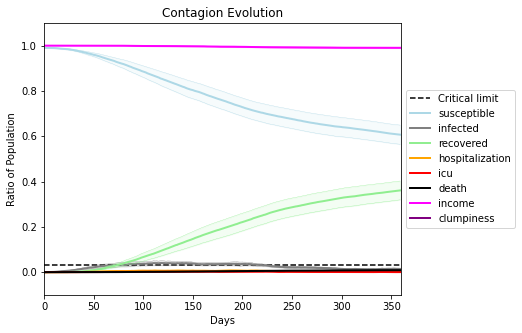

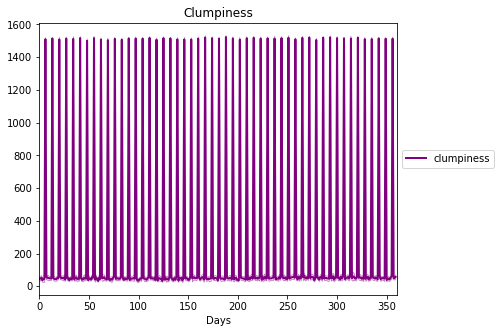

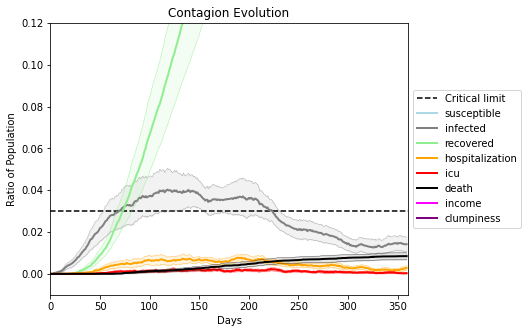

In [28]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)